In [3]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from sklearn import datasets
import torchvision
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import math
import torch.nn.functional as F
import torchvision.transforms as transforms
import itertools
import random
from torch.nn.utils.rnn import pad_sequence
import wandb
import pandas as pd
import gc
from opacus import PrivacyEngine
from opacus.layers import DPLSTM
import time
from sklearn import metrics
import xgboost
from scipy import stats
from pathlib import Path
import datetime
import csv
import optuna

In [2]:
wandb.login()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: nilm (use `wandb login --relogin` to force relogin)


True

In [3]:
torch.cuda.is_available()

True

In [4]:
gc.collect()
torch.cuda.empty_cache()

In [5]:
torch.__version__

'1.7.1'

In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [7]:
def get_home_ids(df):
    return df['dataid'].unique()

In [8]:
def load_all_houses_with_device(path, appliance):
        
    df = pd.read_csv(path, usecols = ['dataid', 'grid', 'solar', 'solar2', str(appliance)])
    
    size = len(df.dataid)
    dataids = get_home_ids(df)
    
    columns = {'dataid':df.dataid,
               'grid':df.grid,
               'solar':df.solar,
               'solar2':df.solar2,
                str(appliance):df[str(appliance)]}
    
    df = pd.DataFrame(columns)
    
    df['net_power'] = df.fillna(0).grid + df.fillna(0).solar + df.fillna(0).solar2
    df = df.fillna(0)
    df['net_power'] = np.clip(df['net_power']*1000, a_min = 0, a_max = None)
    df[str(appliance)] = np.clip(df[str(appliance)]*1000, a_min = 0, a_max = None)
    df['appliance_power'] = df[str(appliance)]
    df = df.drop(columns = ['grid', 'solar', 'solar2', str(appliance)])
    df['appliance_power'] = df['appliance_power'].values.astype('float32')
    df['net_power'] = df['net_power'].values.astype('float32')
    
    for house in dataids:
        house_of_interest = df.loc[df['dataid'] == house]
        if max(house_of_interest['appliance_power']) - min(house_of_interest['appliance_power']) < 60:
            df = df[df['dataid'] != house]
    
    remove = []
    
    if appliance == "air1":
        df['appliance_power'][df['appliance_power'] > 5000] = 0
        remove = [1249, 7365, 8849]
        
    if appliance == 'clotheswasher1':
        df['appliance_power'][df['appliance_power'] > 1300] = 0
        remove = [6240]
        
    if appliance == 'drye1':
        remove = [3000, 3840, 3976, 4550, 6526, 9004, 9053, 183]
        
    if appliance == 'furnace1':
        df['appliance_power'][df['appliance_power'] > 1000] = 0
        remove = [6703, 3403, 7365, 2126, 10089]
        
    if appliance == 'oven1':
        df['appliance_power'][df['appliance_power'] > 5000] = 0
        remove = [792]
        
    if appliance == 'range1':
        df['appliance_power'][df['appliance_power'] > 8000] = 0
        remove = [7367]
        
    if appliance == 'dishwasher1':
        df['appliance_power'][df['appliance_power'] > 1500] = 0
        remove = [8849, 6240, 7367]
        
    if appliance == 'freezer1':
        remove = [9973, 7159]
        
    if appliance == 'heater1':
        remove = [2561]
        
    if appliance == 'waterheater1':
        df['appliance_power'][df['appliance_power'] > 6000] = 0
        remove = [10983, 9973, 8627, 2096]
        
    if appliance == 'waterheater2':
        df['appliance_power'][df['appliance_power'] > 5000] = 0
        remove = [8627]
        
    if appliance == 'wellpump1':
        df['appliance_power'][df['appliance_power'] > 1600] = 0
        remove = [10983]
    
    if appliance == 'clotheswasher_dryg1':
        df['appliance_power'][df['appliance_power'] > 800] = 0
        
    if appliance == 'refrigerator1':
        df['appliance_power'][df['appliance_power'] > 600] = 0
        remove = [9973, 142, 145, 1417, 2561, 2786, 5367, 6594, 9053, 984, 11878, 526, 6564, 7935]
    
    if remove:
        for house in remove:
            df = df[df['dataid'] != house]
    return df

In [9]:
def normalize_x(x_sequence):
    std = np.std(x_sequence)
    x_sequence = (x_sequence - np.mean(x_sequence))/std    
    return x_sequence

In [10]:
def normalize_y(y_sequence):
    y_sequence = np.log(np.add(y_sequence, 1))
    return (y_sequence - np.min(y_sequence))/(np.max(y_sequence) - np.min(y_sequence))

In [11]:
def create_activations(path, appliance, window_length, buildings):
    data = load_all_houses_with_device(path, appliance)
    
    data = [data.loc[data['dataid'] == i] for i in buildings]
    
    data = pd.concat(data)
    
    data_size = len(data)
    remainder = data_size % window_length
    
    y_data = data['appliance_power'].values
    x_data = data['net_power'].values
    
    if remainder != 0:
        y_data = np.append(y_data, np.zeros(window_length - remainder))
        x_data = np.append(x_data, np.zeros(window_length - remainder))
    
    y_data = np.reshape(y_data, (-1, window_length))
    x_data = np.reshape(x_data, (-1, window_length))
    
    data_size = len(y_data)
    
    y_data = y_data[0:data_size-1]
    x_data = x_data[0:data_size-1]
    
    #for i in range(len(x_data)):
    x_data = normalize_x(x_data)
    
    nan_tracker = []
    
    for i in range(len(y_data)):
        if max(y_data[i]) - min(y_data[i]) == 0:
            nan_tracker.append(i)
        elif max(y_data[i]) - min(y_data[i]) < 30:
            nan_tracker.append(i)
        
    y_data = [elem for i, elem in enumerate(y_data) if i not in nan_tracker]
    x_data = [elem for i, elem in enumerate(x_data) if i not in nan_tracker]
    
    #for i in range(len(y_data)):
    y_data = normalize_y(y_data)
    
    return np.array(x_data, dtype = np.float32), np.array(y_data, dtype = np.float32)

In [12]:
#column 2 is air1, NN is trained for air conditioner
#column 5 is washing machine
class PecanStreetDataset_train(Dataset):
    
    def __init__(self, path, appliance, window_length, buildings):
        
        self.x, self.y = create_activations(
            path,
            appliance,
            window_length,
            buildings)
        
        self.n_samples = self.x.shape[0]
                
        self.x = torch.from_numpy(self.x)
        
        self.y = torch.from_numpy(self.y)
        
    def __getitem__(self, index):
        return self.x[index], self.y[index]
    
    def __len__(self):
        return self.n_samples

In [13]:
class PecanStreetDataset_test(Dataset):
    
    def __init__(self, path, appliance, window_length, buildings):
        
        self.x, self.y = create_activations(
            path,
            appliance,
            window_length,
            buildings)

        self.n_samples = self.x.shape[0]
        
        #self.x = self.x[int(0.5*self.n_samples):]
        #self.y = self.y[int(0.5*self.n_samples):]
        
        self.x, self.y = zip(*random.sample(list(zip(self.x, self.y)), int(0.5*self.n_samples)))
        
        self.x = np.array(self.x, dtype = np.float32)
        self.y = np.array(self.y, dtype = np.float32)

        self.n_samples = self.x.shape[0]

        self.x = torch.from_numpy(self.x)
        
        self.y = torch.from_numpy(self.y)
        
    def __getitem__(self, index):
        return self.x[index], self.y[index]
    
    def __len__(self):
        return self.n_samples

In [14]:
class PecanStreetDataset_val(Dataset):
    
    def __init__(self, path, appliance, window_length, buildings):

        self.x, self.y = create_activations(
            path,
            appliance,
            window_length,
            buildings)

        self.n_samples = self.x.shape[0]
        
        #self.x = self.x[0:int(0.5*self.n_samples)]
        #self.y = self.y[0:int(0.5*self.n_samples)]
        
        self.x, self.y = zip(*random.sample(list(zip(self.x, self.y)), int(0.5*self.n_samples)))
        
        self.x = np.array(self.x, dtype = np.float32)
        self.y = np.array(self.y, dtype = np.float32)
        
        self.n_samples = self.x.shape[0]
        
        self.x = torch.from_numpy(self.x)
        
        self.y = torch.from_numpy(self.y)
        
    def __getitem__(self, index):
        return self.x[index], self.y[index]
    
    def __len__(self):
        return self.n_samples

In [15]:
class LSTM(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, hidden_size_1, hidden_size_2, fc1, fc2):
        super(LSTM, self).__init__()
        
        self.conv1 = nn.Conv1d(in_channels, out_channels, kernel_size, padding=int((kernel_size-1)/2))
        #self.conv2 = nn.Conv1d(out_channels, out_channels_2, kernel_size, padding=int((kernel_size-1)/2))
        
        self.lstm1 = nn.LSTM(out_channels, hidden_size_1, num_layers = 2, batch_first = True, dropout = 0, bidirectional = True)
        self.lstm2 = nn.LSTM(2*hidden_size_1, hidden_size_2, num_layers = 2, batch_first = True, dropout = 0, bidirectional = True)
        
        self.linear1 = nn.Linear(2*hidden_size_2, fc1)
        self.linear2 = nn.Linear(fc1, fc2)
        self.linear3 = nn.Linear(fc2, in_channels)
        
        self.sigmoid = nn.Sigmoid()
        
        #self.maxpool = nn.MaxPool1d(kernel_size = kernel_size_2, stride = 1, padding = int((kernel_size_2-1)/2))
        
        self.dropout = nn.Dropout(p=0.5)
        
    def forward(self, x):
        #print("shape0: ", x.shape)
        out = x.unsqueeze(dim=1) #This unsqueeze is needed to create the correct shape for conv1 layer
        out = self.conv1(out)
        out = self.sigmoid(out)
        out = self.dropout(out)
        #out = self.maxpool(out)
        #print("shape2: ", out.shape)
        #out = self.relu(out)
        #out = self.sigmoid(out)
        #out = self.maxpool(out)
        #out = self.conv2(out)
        #out = self.relu(out)
        #out = self.dropout(out)
        #print("shape3: ", out.shape)
        #out, _ = self.lstm1(out)
        out = out.transpose(1, 2).contiguous()
        #print("shape3: ", out.shape)
        out, _ = self.lstm1(out)
        out, _ = self.lstm2(out)
        out = self.sigmoid(out)
        out = self.dropout(out)
        out = self.linear1(out)
        out = self.sigmoid(out)
        out = self.dropout(out)
        out = self.linear2(out)
        out = self.sigmoid(out)
        out = self.dropout(out)
        out = self.linear3(out)
        #out = self.sigmoid(out)
        #print("shape4: ", out.shape)
        out = out.squeeze()
        #print("shape5: ", out.shape)
        return out

In [16]:
config = dict(
    epochs = 750,
    batch_size = 100,
    learning_rate = 0.0004,
    in_channels = 1,
    out_channels = 16,
    kernel_size = 7,
    hidden_size_1 = 32,
    hidden_size_2 = 200,
    fc1 = 200,
    fc2 = 100)
#origial: 600, 4, .0008, 1, 16, 7, 32, 100, 128, 64
#trial1# 600, 4, 0.0008, 1, 16, 7, 32, 400, 400, 200

In [17]:
def model_pipeline(hyperparameters, train_months, test_month, path, appliance, window_length, train_buildings, test_buildings):
    with wandb.init(project = "Drye1_single_houses", config = hyperparameters):
        wandb.run.name = "Test1706normalize_over_dataset_hs1:32_hs2:200_fc1:200_fc2:100_1200epochs100batch_StepLR.0004_step50_gamma0.9_3dropout_weightdecay.00005_kern:7_outchan:16_4sigmoid_0maxpool_Trainbldgs:"+str(train_buildings)
        config = wandb.config
        results = {}
        #ids = get_house_ids_of_interest(path, appliance)
        #ids = [792, 950, 1417, 3488, 3517, 4414, 6594]
        #ids = [792]
        
        #lengths = [85320, 132480, 132480, 132480, 132480, 132480, 132480]
        
        model, criterion, optimizer = make_model(config)
        
        print(model)
        
        wandb.watch(model, criterion, log = "all", log_freq = 10)
    
        example_ct = 0
        batch_ct = 0
        all_epochs = 0
        #all step_size=30 tests had gamma=0.5
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size = 50, gamma = 0.9, verbose=True)
        #scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr = 0.0001, max_lr = 0.002, cycle_momentum=False, verbose=True)
            
        validation_loader, test_loader = make_test_val_data(config, test_month, appliance, window_length, test_buildings)
            
        #for i in range(len(ids)):
        time_log = time.time()
        train_loader = make_train_data(config, train_months, appliance, window_length, train_buildings)
        model, example_ct, batch_ct, all_epochs = train(
            model,
            train_loader,
            validation_loader,
            criterion,
            optimizer,
            config,
            example_ct,
            batch_ct,
            all_epochs,
            scheduler)
                
            #total_loss += per_house_total_loss
            #total_val_loss += per_house_val_loss
            #total_training_r2 += training_r2
                
        print("Time to train on one home: ", time.time() - time_log)
            
        #train_log(total_loss / len(ids), total_val_loss / len(ids), all_epochs, r)
        
        results = test(model, test_loader, criterion)
        
    return model, results

In [18]:
def make_train_data(config, train_data, appliance, window_length, train_buildings):
    
    root_path = r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ithaca_Real_2019\1min_real_"

    train_dataset = PecanStreetDataset_train(str(root_path)+str(train_data)+"2019.csv", appliance, window_length, train_buildings)
    
    train_loader = DataLoader(dataset = train_dataset,
                                batch_size = config.batch_size,
                                shuffle = True,
                                num_workers = 0)
    
    return train_loader

In [19]:
def make_test_val_data(config, test_data, appliance, window_length, test_buildings):
    
    root_path = r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ithaca_Real_2019\1min_real_"
    
    validation_dataset = PecanStreetDataset_val(str(root_path)+str(test_data)+"2019.csv", appliance, window_length, test_buildings)
    test_dataset = PecanStreetDataset_test(str(root_path)+str(test_data)+"2019.csv", appliance, window_length, test_buildings)
    
    validation_loader = DataLoader(dataset = validation_dataset,
                                  batch_size = config.batch_size,
                                  shuffle = False,
                                  num_workers = 0)
    
    test_loader = DataLoader(dataset = test_dataset,
                            batch_size = config.batch_size,
                            shuffle = False,
                            num_workers = 0)
    
    return validation_loader, test_loader

In [20]:
def make_model(config):
    
    model = LSTM(
        config.in_channels,
        config.out_channels,
        config.kernel_size,
        config.hidden_size_1,
        config.hidden_size_2,
        config.fc1,
        config.fc2).to(device)
    
    criterion = nn.MSELoss()
    
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr = config.learning_rate,
        weight_decay = 0.00005)
    
    return model, criterion, optimizer

In [21]:
def precision(prediction, true):
    numerator = np.sum([min(l) for l in zip(prediction, true)])
    return numerator / np.sum(prediction)

In [22]:
def recall(prediction, true):
    numerator = np.sum([min(l) for l in zip(prediction, true)])
    return numerator / np.sum(true)

In [23]:
def f1_score(precision, recall):
    return 2*(precision*recall)/(precision+recall)

In [39]:
def train(model, loader, validation_loader, criterion, optimizer, config, example_ct, batch_ct, all_epochs, scheduler):#, privacy_engine):
    home_total_loss = 0.0
    total_validation_loss = 0.0
    the_last_loss = 100
    patience = 10
    trigger_times = 0
    #total_home_r2 = 0.0
    for epoch in (range(config.epochs)):
        model.train()
        epoch_total_loss = 0.0
        epoch_predictions = []
        epoch_true_vals = []
        epoch_r2 = 0.0
        epoch_precision = 0.0
        epoch_recall = 0.0
        epoch_abs_diff = 0.0
        epoch_squ_diff = 0.0
        epoch_true_sum = 0.0
        batch_number = 0
        all_epochs += 1
        for _, (features, labels) in enumerate(loader):
            train_predictions, train_true_vals, loss = train_batch(features, labels, model, optimizer, criterion)
            epoch_total_loss += float(loss.item())
            epoch_predictions.append(train_predictions)
            epoch_true_vals.append(train_true_vals)
            example_ct += len(features)
            batch_ct += 1
            batch_number += 1
            #scheduler.step()
        
        scheduler.step()
        
        #validation process
        model.eval()
        with torch.no_grad():
            validation_total_loss = 0.0
            val_predictions = []
            val_true_vals = []
            val_r2 = 0.0
            val_precision = 0.0
            val_recall = 0.0
            val_abs_diff = 0.0
            val_squ_diff = 0.0
            val_true_sum = 0.0
            val_batch = 0
        
        val_preds = []
        val_true = []
        for features, labels in validation_loader:
            features, labels = features.to(device), labels.to(device)

            outputs = model(features)
            loss = criterion(outputs, labels)

            validation_total_loss += float(loss.item())
            
            val_preds.append(outputs.cpu().detach().numpy())
            val_true.append(labels.cpu().detach().numpy())
            
            val_batch += 1
            del features, labels
        
        home_total_loss += epoch_total_loss / batch_number
        total_validation_loss += validation_total_loss / val_batch
        epoch_predictions = [item for sublist in epoch_predictions for item in sublist]
        epoch_true_vals = [item for sublist in epoch_true_vals for item in sublist]
        all_val_preds = [item for sublist in val_preds for item in sublist]
        all_val_true_vals = [item for sublist in val_true for item in sublist]
        
        train_tracker = 0
        for i in range(len(epoch_predictions)):
            if len(epoch_true_vals[i]) != 1 and len(epoch_predictions[i]) != 1:
                for j in range(len(epoch_predictions[i])):
                    if len(epoch_true_vals[i][j].shape) != 0 and len(epoch_predictions[i][j].shape) != 0:
                        epoch_true_vals[i][j] = np.exp(epoch_true_vals[i][j]) - 1
                        epoch_predictions[i][j] = np.exp(epoch_predictions[i][j]) - 1
                        epoch_r2 += metrics.r2_score(epoch_true_vals[i][j], epoch_predictions[i][j])
                        epoch_precision += precision(epoch_predictions[i][j], epoch_true_vals[i][j])
                        epoch_recall += recall(epoch_predictions[i][j], epoch_true_vals[i][j])
                        epoch_abs_diff += np.sum(abs(np.subtract(epoch_true_vals[i][j], epoch_predictions[i][j])))
                        epoch_squ_diff += np.sum(np.square(np.subtract(epoch_true_vals[i][j], epoch_predictions[i][j])))
                        epoch_true_sum += np.sum(epoch_true_vals[i][j])
                        train_tracker += 1

        val_tracker = 0
        for i in range(len(all_val_preds)):
            if len(all_val_true_vals[i]) > 1 and len(all_val_preds[i]) > 1:
                all_val_true_vals[i] = np.exp(all_val_true_vals[i]) - 1
                all_val_preds[i] = np.exp(all_val_preds[i]) - 1
                val_r2 += metrics.r2_score(all_val_true_vals[i], all_val_preds[i])
                val_precision += precision(all_val_preds[i], all_val_true_vals[i])
                val_recall += recall(all_val_preds[i], all_val_true_vals[i])
                val_abs_diff += np.sum(abs(np.subtract(all_val_true_vals[i], all_val_preds[i])))
                val_squ_diff += np.sum(np.square(np.subtract(all_val_true_vals[i], all_val_preds[i])))
                val_true_sum += np.sum(all_val_true_vals[i])
                val_tracker += 1
        
        total_precision = epoch_precision/train_tracker
        total_recall = epoch_recall/train_tracker
        
        total_val_precision = val_precision/val_tracker
        total_val_recall = val_recall/val_tracker
        
        wandb.log({
            'Training_MSE': epoch_total_loss / batch_number,
            'Validation_MSE': validation_total_loss / val_batch,
            'Training_R2': epoch_r2 / train_tracker,
            'Validation_R2': val_r2 / val_tracker,
            'Training_F1': f1_score(total_precision, total_recall),
            'Validation_F1': f1_score(total_val_precision, total_val_recall),
            'Training_NEP':epoch_abs_diff / epoch_true_sum,
            'Validation_NEP':val_abs_diff / val_true_sum,
            'Training_NDE':epoch_squ_diff / epoch_true_sum,
            'Validation_NDE':val_squ_diff / val_true_sum,
            'Training_MAE':epoch_abs_diff / train_tracker,
            'Validation_MAE':val_abs_diff / val_tracker},
            step = all_epochs)
        
        # Early stopping
        #current_loss = validation_total_loss/val_batch
        #if current_loss > the_last_loss:
        #    trigger_times += 1
        #    print('trigger times:', trigger_times)

        #    if trigger_times >= patience:
        #        print('Early stopping!\nStart to test process.')
        #        print(f"Loss after " + str(example_ct).zfill(5) + f" batches: {epoch_total_loss / batch_number:.4f}")
        #        return model, example_ct, batch_ct, all_epochs

        #else:
        #    print('trigger times: 0')
        #    trigger_times = 0

        #the_last_loss = current_loss
        
        print(f"Loss after " + str(example_ct).zfill(5) + f" batches: {epoch_total_loss / batch_number:.4f}")

        #train_log(epoch_total_loss / batch_number,
        #        validation_total_loss / val_batch,
        #        example_ct,
        #        all_epochs)
        
    return model, example_ct, batch_ct, all_epochs

In [25]:
def train_batch(features, labels, model, optimizer, criterion):
    train_predictions = []
    train_true_vals = []
    
    features = features.to(device)
    labels = labels.to(device)
    
    outputs = model(features)
    loss = criterion(outputs, labels)
    
    train_predictions.append(outputs.cpu().detach().numpy())
    train_true_vals.append(labels.cpu().detach().numpy())
    
    optimizer.zero_grad()
    loss.backward()
    
    optimizer.step()
    del features, labels
    
    return train_predictions, train_true_vals, loss

In [26]:
def train_log(loss, val_loss, example_ct, epoch):
    loss = float(loss)
    val_loss = float(val_loss)
    
    wandb.log({
        "Rounds_on_all_homes": epoch,
        "All_Homes_Training_MSE": loss,
        "All_Homes_Validation_MSE": val_loss})
        #"All_Homes_Training_R2": training_r2})
              #step = example_ct)
    print(f"Loss after " + str(example_ct).zfill(5) + f" total epochs: {loss:.4f}")

In [27]:
def test(model, test_loader, criterion):#, privacy_engine):
    model.eval()
    with torch.no_grad():
        total_loss = 0.0
        total_steps = 0
        r_squared = 0.0
        local_precision = 0.0
        local_recall = 0.0
        abs_diff = 0.0
        squ_diff = 0.0
        true_sum = 0.0
        predictions = []
        true_vals = []
        for features, labels in test_loader:
            features, labels = features.to(device), labels.to(device)
            prediction = model(features)
            loss = criterion(prediction, labels)
            total_loss += float(loss.item())
            total_steps += 1
            #r_squared += float(metrics.r2_score(labels.cpu().detach().numpy(), prediction.cpu().detach().numpy()))
            predictions.append(prediction.cpu().detach().numpy())
            true_vals.append(labels.cpu().detach().numpy())
            del features, labels
        
        tracker = 0
        for i in range(len(predictions)):
            if len(true_vals[i]) != 1 and len(predictions[i]) != 1:
                for j in range(len(predictions[i])):
                    if len(true_vals[i][j].shape) != 0 and len(predictions[i][j].shape) != 0:
                        r_squared += metrics.r2_score(true_vals[i][j], predictions[i][j])
                        local_precision += precision(predictions[i][j], true_vals[i][j])
                        local_recall += recall(predictions[i][j], true_vals[i][j])
                        abs_diff += np.sum(abs(np.subtract(true_vals[i][j], predictions[i][j])))
                        squ_diff += np.sum(np.square(np.subtract(true_vals[i][j], predictions[i][j])))
                        true_sum += np.sum(true_vals[i][j])
                        tracker += 1
        
        total_precision = local_precision/tracker
        total_recall = local_recall/tracker
        
        wandb.log({
            'Test_MSE': total_loss / total_steps,
            'Test_R2_Value': r_squared / tracker,
            'Test_F1_Score':f1_score(total_precision, total_recall),
            'Test_NEP':abs_diff/true_sum,
            'Test_NDE':squ_diff/true_sum,
            'Test_MAE':abs_diff/tracker})
   # if privacy_engine:
        #epsilon, best_alpha = privacy_engine.get_privacy_spent()
        #print("Testing epsilon: ", epsilon)
        #print("Testing alpha: ", best_alpha)
        
    wandb.save("model_final.h5")
    
    results = [total_loss/total_steps, r_squared/tracker, f1_score(total_precision, total_recall), abs_diff/true_sum, squ_diff/true_sum, abs_diff/tracker]
    
    return results

In [ ]:
def objective(trial):
    params = {
        "num_layers": trial.suggest_int("num_layer", 1, 7),
        "hidden_size": trial.suggest_int("hidden_size", 16, 2048),
        "dropout": trial.suggest_uniform("dropout", 0.1, 0.7),
        "learning_rate": trial.suggest_loguniform("learning_rate", 1e-6, 1e-3)
    }
    all_losses = []
    for 

In [28]:
#get_house_ids_of_interest(path, 'air1')

In [29]:
path = r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ithaca_Real_2019\1min_real_may_june_july2019.csv"

In [30]:
#test_lengths = [100, 200, 250, 300, 350, 400, 450, 500, 550, 600]
test_lengths = [100]

In [31]:
homes = load_all_houses_with_device(path, 'drye1')

In [32]:
drye1_homes = homes['dataid'].loc[homes['dataid'] != 1706].unique()

In [33]:
drye1_homes

array([  145,   518,   558,   690,   914,   950,  1222,  1240,  1417,
        2318,  2358,  2448,  3488,  3996,  4283,  4414,  5587,  5982,
        5997,  6069,  6178,  6594,  6672,  6703,  6706,  6907,  7069,
        7159,  8162,  8327,  9002,  9290,   984,  3403,  4735,  5192,
        6126,  6868,  8849,  2602,  6564,  7935, 10089, 10182, 10983],
      dtype=int64)

In [42]:
random_homes = random.sample(list(drye1_homes), 1)

In [43]:
random_homes

[1417]

In [34]:
final_results = {}
#random_homes_lists = []
#random_homes_tup = ()
for j in drye1_homes:
    for i in range(10):
    #random_homes_tup = random_homes_tup + (i,)
    #random_homes_lists.append(i)
    #random_homes = random.sample(list(drye1_homes), i+1)
    #print(random_homes)
        model, per_house_result = model_pipeline(
        config,
        'may_june_july',
        'may_june_july',
        path,
        'drye1',
        100,
        [j],
        [1706])
        result = {j:per_house_result}
        final_results.update(result)
        #random_homes_lists.append(random_homes)

C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\IPython\html.py:12: ShimWarning: The `IPython.html` package has been deprecated since IPython 4.0. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  warn("The `IPython.html` package has been deprecated since IPython 4.0. "
wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.2481
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.2219
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00231 batches: 0.2128
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00308 batches: 0.2118
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06006 batches: 0.0790
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06083 batches: 0.0756
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06160 batches: 0.0710
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06237 batches: 0.0684
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06314 batches: 0.0662
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06391 batches: 0.0625
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06468 batches: 0.0623
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06545 batches: 0.0593
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06622 batches: 0.0588
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06699 batches: 0.0551


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12320 batches: 0.0319
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12397 batches: 0.0307
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12474 batches: 0.0304
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12551 batches: 0.0312
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12628 batches: 0.0313
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12705 batches: 0.0295
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12782 batches: 0.0307
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12859 batches: 0.0318
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12936 batches: 0.0299
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13013 batches: 0.0298


trigger times: 0
Loss after 18634 batches: 0.0263
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18711 batches: 0.0241
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18788 batches: 0.0255
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18865 batches: 0.0246
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18942 batches: 0.0253
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19019 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19096 batches: 0.0251
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19173 batches: 0.0278
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 19250 batches: 0.0253
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 19327 batches: 0.0282
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.40519
Test_MAE,23.97229
Test_MSE,0.1093
Test_NDE,0.45316
Test_NEP,0.9939
Test_R2_Value,-1.5463
Training_F1,0.79231
Training_MAE,19.04626
Training_MSE,0.02455
Training_NDE,0.17699
Training_NEP,0.36159


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▃▃▃▃▄▅▆▇▆▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,███▇▇▇▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.2896
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.2472
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00231 batches: 0.2319
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00308 batches: 0.2228
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.50851
Test_MAE,39.15812
Test_MSE,0.16723
Test_NDE,0.40052
Test_NEP,0.93783
Test_R2_Value,-1.97202
Training_F1,0.42992
Training_MAE,58.79088
Training_MSE,0.19298
Training_NDE,1.026
Training_NEP,1.11613


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇███████▇▇▇▇▇▇▇▇▇▇▇▇▇███
Training_MAE,▃▂▃▄▆▇███▇▅▅▃▃▂▂▁▂▁▁▁▁▂▂▂▂▃
Training_MSE,█▅▄▃▃▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Training_NDE,█▅▅▄▅▅▆▆▆▅▄▄▃▃▂▃▂▃▂▂▂▂▂▁▁▁▁
Training_NEP,▃▂▃▄▆▇███▇▅▅▃▃▂▂▁▂▁▁▁▁▂▂▂▂▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.2594
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.2363
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00231 batches: 0.2302
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00308 batches: 0.2338
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06006 batches: 0.0652
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06083 batches: 0.0630
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06160 batches: 0.0589
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06237 batches: 0.0581
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06314 batches: 0.0575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06391 batches: 0.0525
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06468 batches: 0.0526
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06545 batches: 0.0526
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06622 batches: 0.0514
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06699 batches: 0.0483


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12320 batches: 0.0283
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12397 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12474 batches: 0.0294
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12551 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12628 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12705 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12782 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12859 batches: 0.0292
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12936 batches: 0.0290
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13013 batches: 0.0272


Test_F1_Score,0.48004
Test_MAE,18.69318
Test_MSE,0.06897
Test_NDE,0.30818
Test_NEP,0.83526
Test_R2_Value,-1.08585
Training_F1,0.78953
Training_MAE,18.89396
Training_MSE,0.02335
Training_NDE,0.16427
Training_NEP,0.3587


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▂▃▂▃▃▃▃▄▄▅▆▆▇▇▇▇▇▇▇▇▇▇▇██████████████
Training_MAE,▇█▇▇▇▆▆▆▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▅▅▅▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▇▇▆▆▆▆▅▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▆▆▆▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.3739
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.3175
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.2786
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00308 batches: 0.2505
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06006 batches: 0.1318
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06083 batches: 0.1316
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06160 batches: 0.1269
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06237 batches: 0.1246
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06314 batches: 0.1232
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06391 batches: 0.1212
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06468 batches: 0.1188
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06545 batches: 0.1123
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06622 batches: 0.1105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06699 batches: 0.1077
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 1
Loss after 12320 batches: 0.0416
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12397 batches: 0.0418
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12474 batches: 0.0423
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12551 batches: 0.0399
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12628 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12705 batches: 0.0398
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12782 batches: 0.0401
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12859 batches: 0.0392
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12936 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13013 batches: 0.0406
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 1
Loss after 18634 batches: 0.0305
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18711 batches: 0.0305
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18788 batches: 0.0305
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 18865 batches: 0.0306
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18942 batches: 0.0309
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 19019 batches: 0.0304
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19096 batches: 0.0298
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19173 batches: 0.0287
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 19250 batches: 0.0297
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 19327 batches: 0.0302
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.52039
Test_MAE,25.63408
Test_MSE,0.12584
Test_NDE,0.42028
Test_NEP,0.85612
Test_R2_Value,-1.93137
Training_F1,0.77326
Training_MAE,20.43311
Training_MSE,0.02718
Training_NDE,0.18352
Training_NEP,0.38792


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▂▃▃▃▃▄▄▄▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇█████████████
Training_MAE,▇█▇▆▇▇▆▆▆▅▅▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▇▇▆▆▆▆▅▅▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▆▇▇▆▆▆▅▅▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.3748
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.3129
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.2706
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00308 batches: 0.2472
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06006 batches: 0.1387
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06083 batches: 0.1355
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06160 batches: 0.1344
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06237 batches: 0.1323
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06314 batches: 0.1290
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06391 batches: 0.1271
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06468 batches: 0.1225
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06545 batches: 0.1233
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06622 batches: 0.1208
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06699 batches: 0.1158
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 12320 batches: 0.0424
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12397 batches: 0.0416
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12474 batches: 0.0395
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12551 batches: 0.0409
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12628 batches: 0.0393
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 12705 batches: 0.0390
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 12782 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 12859 batches: 0.0390
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12936 batches: 0.0407
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13013 batches: 0.0413
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 3
Loss after 18711 batches: 0.0308
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18788 batches: 0.0301
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18865 batches: 0.0297
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18942 batches: 0.0302
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 19019 batches: 0.0306
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19096 batches: 0.0290
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 19173 batches: 0.0291
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 19250 batches: 0.0286
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 19327 batches: 0.0296
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 19404 batches: 0.0307
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 25025 batches: 0.0286
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25102 batches: 0.0271
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 25179 batches: 0.0269
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 25256 batches: 0.0270
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 25333 batches: 0.0261
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 25410 batches: 0.0263
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 25487 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 25564 batches: 0.0271
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25641 batches: 0.0256
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25718 batches: 0.0265
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 31339 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31416 batches: 0.0235
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31493 batches: 0.0238
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 31570 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 31647 batches: 0.0231
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31724 batches: 0.0221
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31801 batches: 0.0239
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31878 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 31955 batches: 0.0240
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 32032 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37730 batches: 0.0220
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37807 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37884 batches: 0.0215
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37961 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 38038 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 38115 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 38192 batches: 0.0217
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 38269 batches: 0.0213
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 38346 batches: 0.0216
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 38423 batches: 0.0209


Test_F1_Score,0.45241
Test_MAE,24.76171
Test_MSE,0.1232
Test_NDE,0.36441
Test_NEP,0.73242
Test_R2_Value,-2.43832
Training_F1,0.79507
Training_MAE,18.26257
Training_MSE,0.02161
Training_NDE,0.15762
Training_NEP,0.34671


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▃▄▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇█▇█████████████████
Training_MAE,██▇▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.3997
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.3408
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.2911
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00308 batches: 0.2565
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4647
Test_MAE,41.60303
Test_MSE,0.18979
Test_NDE,0.4457
Test_NEP,0.977
Test_R2_Value,-2.48184
Training_F1,0.41372
Training_MAE,58.70746
Training_MSE,0.20035
Training_NDE,1.05579
Training_NEP,1.11454


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇███████████████▇▇▇▇▇▇▇███████
Training_MAE,▆▄▂▂▃▃▄▆▇███▇▆▆▄▄▄▃▂▂▂▂▁▁▂▁▁▁▁▁▁▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▃▃▃▄▄▅▅▅▄▄▄▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,▆▄▂▂▃▃▄▆▇███▇▆▆▄▄▄▃▂▂▂▂▁▁▂▁▁▁▁▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.7809
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.6527
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.5492
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00308 batches: 0.4594
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.45274
Test_MAE,38.74296
Test_MSE,0.16424
Test_NDE,0.49434
Test_NEP,1.1661
Test_R2_Value,-4.99817
Training_F1,0.40009
Training_MAE,58.37084
Training_MSE,0.20627
Training_NDE,1.08094
Training_NEP,1.10815


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇█████████████████████████████████████
Training_MAE,█▇▅▄▃▂▂▂▂▃▃▄▅▅▅▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▃▂▂▂▂▃▃▄▅▅▅▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.2291
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00154 batches: 0.2227
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.2170
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00308 batches: 0.2176
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 3
Loss after 05929 batches: 0.0439
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 06006 batches: 0.0427
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06083 batches: 0.0400
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06160 batches: 0.0411
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06237 batches: 0.0402
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06314 batches: 0.0396
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06391 batches: 0.0395
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06468 batches: 0.0401
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06545 batches: 0.0408
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06622 batches: 0.0371
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12320 batches: 0.0256
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12397 batches: 0.0261
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12474 batches: 0.0249
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12551 batches: 0.0250
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 12628 batches: 0.0250
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 12705 batches: 0.0259
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 12782 batches: 0.0263
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 12859 batches: 0.0246
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12936 batches: 0.0263
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13013 batches: 0.0248


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18634 batches: 0.0210
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18711 batches: 0.0216
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18788 batches: 0.0214
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18865 batches: 0.0209
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18942 batches: 0.0211
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19019 batches: 0.0205
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19096 batches: 0.0207
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 19173 batches: 0.0212
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 19250 batches: 0.0212
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 19327 batches: 0.0214


trigger times: 0
Loss after 24948 batches: 0.0206
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25025 batches: 0.0195
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25102 batches: 0.0187
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 25179 batches: 0.0195
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 25256 batches: 0.0193
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 25333 batches: 0.0203
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 25410 batches: 0.0196
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 25487 batches: 0.0189
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25564 batches: 0.0189
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25641 batches: 0.0190
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 1
Loss after 31262 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 31339 batches: 0.0178
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31416 batches: 0.0179
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31493 batches: 0.0193
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 31570 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 31647 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 31724 batches: 0.0181
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 31801 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 31878 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31955 batches: 0.0186
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 37653 batches: 0.0173
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37730 batches: 0.0175
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37807 batches: 0.0163
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 37884 batches: 0.0180
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 37961 batches: 0.0173
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 38038 batches: 0.0180
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 38115 batches: 0.0167
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 38192 batches: 0.0170
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 38269 batches: 0.0172
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 38346 batches: 0.0174
Adjusting learning rate of group 0 to 1.5497e-04.


Test_F1_Score,0.49651
Test_MAE,27.97593
Test_MSE,0.13593
Test_NDE,0.38445
Test_NEP,0.79126
Test_R2_Value,-4.31855
Training_F1,0.83107
Training_MAE,15.73917
Training_MSE,0.01713
Training_NDE,0.12861
Training_NEP,0.2988


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▅▆▇▇▇▇▇▇▇▇▇▇▇██▇███████████████████
Training_MAE,█▇▇▇▆▄▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▄▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.2959
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.2577
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.2366
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00308 batches: 0.2292
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44576
Test_MAE,38.23168
Test_MSE,0.16343
Test_NDE,0.43664
Test_NEP,1.02142
Test_R2_Value,-2.7103
Training_F1,0.42644
Training_MAE,55.76578
Training_MSE,0.18117
Training_NDE,0.97898
Training_NEP,1.0587


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇████████▇▇▇▇▇▇▇▇▇▇▇▇███████████████
Training_MAE,▄▃▃▄▅▆▇█▇▇▆▅▄▃▃▂▂▂▂▂▂▁▂▂▃▂▃▃▃▃▃▃▃▂▂▂▁▁▁▁
Training_MSE,█▆▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▅▅▅▆▆▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁
Training_NEP,▄▃▃▄▅▆▇█▇▇▆▅▄▃▃▂▂▂▂▂▂▁▂▂▃▂▃▃▃▃▃▃▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00077 batches: 0.5957
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00154 batches: 0.4949
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00231 batches: 0.4144
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00308 batches: 0.3515
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06006 batches: 0.1758
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06083 batches: 0.1723
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06160 batches: 0.1763
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06237 batches: 0.1706
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06314 batches: 0.1705
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06391 batches: 0.1671
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06468 batches: 0.1634
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06545 batches: 0.1670
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06622 batches: 0.1651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06699 batches: 0.1643
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 12320 batches: 0.0588
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12397 batches: 0.0568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12474 batches: 0.0558
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12551 batches: 0.0576
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12628 batches: 0.0567
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12705 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12782 batches: 0.0541
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12859 batches: 0.0556
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12936 batches: 0.0556
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13013 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.43726
Test_MAE,23.1535
Test_MSE,0.09894
Test_NDE,0.33343
Test_NEP,0.78025
Test_R2_Value,0.06652
Training_F1,0.70178
Training_MAE,25.44582
Training_MSE,0.04234
Training_NDE,0.2582
Training_NEP,0.48308


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████████
Training_MAE,█▆██▆▆▆▆▆▆▆▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇▇▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆██▆▆▆▆▆▆▆▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2741
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00220 batches: 0.2245
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00330 batches: 0.2428
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2516
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0858
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0654
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0663
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0640
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0663
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0684
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0684
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09570 batches: 0.0633


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17600 batches: 0.0404
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17710 batches: 0.0427
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0435
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0467
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0430
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18150 batches: 0.0464
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18260 batches: 0.0411
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18370 batches: 0.0445
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18480 batches: 0.0436
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 18590 batches: 0.0478


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0466
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0436
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26840 batches: 0.0404
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26950 batches: 0.0403
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27060 batches: 0.0426
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27170 batches: 0.0392
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 27280 batches: 0.0434
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 27390 batches: 0.0512
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0342
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0439


Test_F1_Score,0.60809
Test_MAE,24.78177
Test_MSE,0.10818
Test_NDE,0.27178
Test_NEP,0.62259
Test_R2_Value,-0.38292
Training_F1,0.76006
Training_MAE,22.7388
Training_MSE,0.04117
Training_NDE,0.17623
Training_NEP,0.37013


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▂▃▄▄▃▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇▇██▇█████▇██
Training_MAE,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2406
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2402
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2203
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2206
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08580 batches: 0.0757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0616
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0632
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0647
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09130 batches: 0.0519
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09240 batches: 0.0691
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0647
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09570 batches: 0.0567


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17600 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17930 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18040 batches: 0.0498
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18150 batches: 0.0590
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0570
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0432
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0490
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18590 batches: 0.0520


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26620 batches: 0.0395
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0369
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0435
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0329
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27060 batches: 0.0408
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27170 batches: 0.0361
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27280 batches: 0.0369
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0356
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0350
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0368


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0460
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35750 batches: 0.0580
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35860 batches: 0.0394
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35970 batches: 0.0477
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 36080 batches: 0.0415
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0454
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0479
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0471
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0396
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0434


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44660 batches: 0.0309
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44770 batches: 0.0372
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44880 batches: 0.0314
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44990 batches: 0.0389
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45100 batches: 0.0285
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45210 batches: 0.0347
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 45320 batches: 0.0319
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45430 batches: 0.0316
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0362
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0351


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 53680 batches: 0.0271
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 53790 batches: 0.0305
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 53900 batches: 0.0328
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0367
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54120 batches: 0.0325
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54230 batches: 0.0416
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54340 batches: 0.0334
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54450 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54560 batches: 0.0322
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54670 batches: 0.0273


Test_F1_Score,0.50334
Test_MAE,34.42759
Test_MSE,0.20739
Test_NDE,0.50897
Test_NEP,0.84493
Test_R2_Value,-0.17984
Training_F1,0.77139
Training_MAE,20.44209
Training_MSE,0.03238
Training_NDE,0.15478
Training_NEP,0.33274


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▃▅▅▆▆▇▆▆▇▇▇▇▇▇▇▇▇█▇██▇▇█████████████
Training_MAE,██▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.6628
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.4630
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.3653
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2698
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41953
Test_MAE,43.08264
Test_MSE,0.19495
Test_NDE,0.72805
Test_NEP,1.60895
Test_R2_Value,-5.50062
Training_F1,0.48633
Training_MAE,63.08363
Training_MSE,0.21796
Training_NDE,0.91975
Training_NEP,1.02683


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇██████████████████████████
Training_MAE,█▅▃▂▂▂▃▄▄▄▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂
Training_MSE,█▅▃▂▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▂▂▂▃▄▄▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▅▃▂▂▂▃▄▄▄▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2440
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00220 batches: 0.2492
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00330 batches: 0.2313
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00440 batches: 0.2241
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08580 batches: 0.0625
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08690 batches: 0.0621
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08800 batches: 0.0623
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08910 batches: 0.0744
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0550
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0588
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0542
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0506
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0664
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0577


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17600 batches: 0.0525
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 17710 batches: 0.0514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0476
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0481
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0526
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0545
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0432
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0537
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0449
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18590 batches: 0.0510


Test_F1_Score,0.4071
Test_MAE,19.95302
Test_MSE,0.08925
Test_NDE,0.40496
Test_NEP,0.90534
Test_R2_Value,-2.85932
Training_F1,0.69969
Training_MAE,25.0698
Training_MSE,0.05182
Training_NDE,0.21608
Training_NEP,0.40807


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▂▃▃▃▄▄▅▇▆▆▆▇▇▇▇▇▇▇█▇▇▇███████████████
Training_MAE,██▇▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▄▄▃▂▂▂▂▂▁▂▂▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁▁
Training_NDE,█▇▇▆▆▅▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.3690
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2859
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2498
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00440 batches: 0.2514
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1005
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0796
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0827
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08910 batches: 0.0805
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0839
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0735
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0740
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0848
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09460 batches: 0.0744
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09570 batches: 0.0749


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0462
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0524
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17820 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0488
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18040 batches: 0.0513
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18150 batches: 0.0646
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18260 batches: 0.0518
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18480 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0563


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26620 batches: 0.0408
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26730 batches: 0.0481
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 26840 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 26950 batches: 0.0408
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0357
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27170 batches: 0.0341
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0402
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27390 batches: 0.0387
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0469
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0445


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35640 batches: 0.0373
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35750 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35860 batches: 0.0350
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35970 batches: 0.0339
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0397
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36190 batches: 0.0310
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36300 batches: 0.0360
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0466
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0512
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0381


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44660 batches: 0.0440
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44770 batches: 0.0393
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44880 batches: 0.0443
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44990 batches: 0.0434
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45100 batches: 0.0442
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45210 batches: 0.0337
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0348
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45430 batches: 0.0306
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45540 batches: 0.0412
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0357


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53680 batches: 0.0458
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53790 batches: 0.0361
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53900 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54120 batches: 0.0353
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54230 batches: 0.0272
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54340 batches: 0.0283
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 54450 batches: 0.0305
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54560 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54670 batches: 0.0381


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62700 batches: 0.0360
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62810 batches: 0.0290
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62920 batches: 0.0355
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63030 batches: 0.0350
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 63140 batches: 0.0299
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 63250 batches: 0.0391
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 63360 batches: 0.0288
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 63470 batches: 0.0348
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63580 batches: 0.0311
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 63690 batches: 0.0414


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 71720 batches: 0.0380
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 71830 batches: 0.0325
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 71940 batches: 0.0324
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 72050 batches: 0.0360
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 72160 batches: 0.0393
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 72270 batches: 0.0344
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 72380 batches: 0.0392
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 72490 batches: 0.0331
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 72600 batches: 0.0443
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 72710 batches: 0.0319


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 80740 batches: 0.0284
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 80850 batches: 0.0311
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 80960 batches: 0.0271
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 81070 batches: 0.0273
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 81180 batches: 0.0413
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 81290 batches: 0.0364
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 81400 batches: 0.0373
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 81510 batches: 0.0337
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 81620 batches: 0.0298
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 81730 batches: 0.0266


Test_F1_Score,0.73345
Test_MAE,18.02463
Test_MSE,0.07025
Test_NDE,0.17108
Test_NEP,0.43896
Test_R2_Value,0.24096
Training_F1,0.78334
Training_MAE,20.64256
Training_MSE,0.02813
Training_NDE,0.14974
Training_NEP,0.336


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▃▄▄▅▅▅▆▆▆▇▇▇▇█▇▇▇█▇▇█████████████████
Training_MAE,█▇▇▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.5998
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.3835
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.3048
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2480
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1343
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1380
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.1332
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.1287
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.1270
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.1326
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.1233
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.1270
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09460 batches: 0.1185
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.1233


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0506
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17820 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17930 batches: 0.0467
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18040 batches: 0.0503
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0473
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0501
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0487


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0436
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26730 batches: 0.0515
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26840 batches: 0.0412
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26950 batches: 0.0400
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0546
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0404
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27280 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27390 batches: 0.0565
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 27500 batches: 0.0491
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 27610 batches: 0.0508


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35640 batches: 0.0422
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35750 batches: 0.0340
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35860 batches: 0.0440
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35970 batches: 0.0378
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 36080 batches: 0.0337
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 36190 batches: 0.0388
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 36300 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0362
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36520 batches: 0.0426
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36630 batches: 0.0352


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44660 batches: 0.0396
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44770 batches: 0.0370
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44880 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44990 batches: 0.0301
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45100 batches: 0.0343
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 45210 batches: 0.0388
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0326
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45430 batches: 0.0363
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 45540 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45650 batches: 0.0357


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53680 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53790 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 53900 batches: 0.0353
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54010 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 54120 batches: 0.0337
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 54230 batches: 0.0322
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 54340 batches: 0.0377
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 54450 batches: 0.0367
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 54560 batches: 0.0346
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 9
Loss after 54670 batches: 0.0380


Test_F1_Score,0.47806
Test_MAE,33.61723
Test_MSE,0.17825
Test_NDE,0.57985
Test_NEP,1.09356
Test_R2_Value,-0.61779
Training_F1,0.75612
Training_MAE,22.95559
Training_MSE,0.03427
Training_NDE,0.17591
Training_NEP,0.37365


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▃▃▄▄▃▅▆▆▆▆▇▇▇▇██▇▇████████████████████
Training_MAE,██▇▇▇▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.3511
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2795
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2399
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2715
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0750
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0815
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0745
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08910 batches: 0.0686
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09020 batches: 0.0709
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 09130 batches: 0.0701
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0751
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0689
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0711


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17600 batches: 0.0503
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17710 batches: 0.0569
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0529
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0428
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0593
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18260 batches: 0.0483
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18370 batches: 0.0524
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18480 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0454


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 26620 batches: 0.0367
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 26730 batches: 0.0409
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0447
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0419
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0399
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27170 batches: 0.0375
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27280 batches: 0.0476
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27390 batches: 0.0422
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 27500 batches: 0.0401
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0365


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35640 batches: 0.0423
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35750 batches: 0.0403
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35860 batches: 0.0351
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35970 batches: 0.0359
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 36080 batches: 0.0313
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 36190 batches: 0.0337
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 36300 batches: 0.0390
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 36410 batches: 0.0358
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 36520 batches: 0.0359
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 10
Early stopping!
Start to test pr

Test_F1_Score,0.70296
Test_MAE,22.36226
Test_MSE,0.10638
Test_NDE,0.25199
Test_NEP,0.52971
Test_R2_Value,-5.62095
Training_F1,0.75746
Training_MAE,22.93542
Training_MSE,0.03501
Training_NDE,0.17768
Training_NEP,0.37333


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▃▃▄▅▅▅▆▆▆▇▇▇▆▇▇▇▇▇█▇████████▇██████
Training_MAE,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▆▅▅▄▃▃▂▂▂▂▁▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▆▅▅▄▃▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.5375
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.3751
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2668
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2302
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1204
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1052
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0918
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0979
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0915
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09130 batches: 0.0947
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09240 batches: 0.0895
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09350 batches: 0.0942
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0963
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0836


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0519
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0702
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17930 batches: 0.0584
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18040 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18150 batches: 0.0585
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0578
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18370 batches: 0.0587
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18480 batches: 0.0483
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18590 batches: 0.0573


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0539
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26730 batches: 0.0515
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26840 batches: 0.0535
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26950 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27060 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 27170 batches: 0.0436
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 27280 batches: 0.0381
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 27390 batches: 0.0454
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0455
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0454


Test_F1_Score,0.30438
Test_MAE,23.63146
Test_MSE,0.11394
Test_NDE,0.72903
Test_NEP,1.51206
Test_R2_Value,-3.95496
Training_F1,0.72627
Training_MAE,25.36879
Training_MSE,0.04134
Training_NDE,0.21039
Training_NEP,0.41293


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▂▃▃▄▃▄▄▅▄▅▅▅▅▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇█▇▇██████
Training_MAE,▇█▇▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,▇█▇▇▆▆▆▅▅▄▄▃▃▃▂▃▂▂▂▂▂▂▂▁▁▂▂▂▁▁▁▂▁▁▁▂▁▁▁▁
Training_NDE,▇█▆▆▆▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2913
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2491
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2367
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2459
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08580 batches: 0.0687
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08690 batches: 0.0696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0794
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0693
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0659
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0674
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09240 batches: 0.0649
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09350 batches: 0.0724
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09460 batches: 0.0784
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0629


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17600 batches: 0.0475
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0461
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0431
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0460
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18260 batches: 0.0410
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18370 batches: 0.0560
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18480 batches: 0.0596
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0404


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0537
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26730 batches: 0.0480
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26840 batches: 0.0414
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26950 batches: 0.0437
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27060 batches: 0.0533
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 27170 batches: 0.0527
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0624
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27390 batches: 0.0489
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27500 batches: 0.0525
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 27610 batches: 0.0475


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0396
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0473
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35860 batches: 0.0392
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35970 batches: 0.0384
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 36080 batches: 0.0389
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 36190 batches: 0.0484
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0407
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0430
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0461


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44660 batches: 0.0310
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44770 batches: 0.0389
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44880 batches: 0.0362
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44990 batches: 0.0433
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45100 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45210 batches: 0.0444
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0338
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45430 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0399
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0389


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 53680 batches: 0.0349
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 53790 batches: 0.0311
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 53900 batches: 0.0380
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 54010 batches: 0.0385
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54120 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54230 batches: 0.0365
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54340 batches: 0.0394
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54450 batches: 0.0401
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 54560 batches: 0.0354
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 54670 batches: 0.0376


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 62700 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 62810 batches: 0.0357
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 62920 batches: 0.0371
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 63030 batches: 0.0373
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 63140 batches: 0.0322
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 63250 batches: 0.0281
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 63360 batches: 0.0336
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 63470 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 63580 batches: 0.0343
Time to train on one home:  297.71646189689636


Test_F1_Score,0.5116
Test_MAE,21.51235
Test_MSE,0.09729
Test_NDE,0.28076
Test_NEP,0.62082
Test_R2_Value,-0.49653
Training_F1,0.76585
Training_MAE,22.26169
Training_MSE,0.03426
Training_NDE,0.17347
Training_NEP,0.36236


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▃▄▅▆▆▆▆▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇██▇████████████
Training_MAE,██▇▅▄▃▃▃▂▂▂▂▂▂▂▂▁▃▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▁▁▂▂▂▁▁▁▂▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▃▂▂▂▂▂▂▂▁▂▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▅▄▃▃▃▂▂▂▂▂▂▂▂▁▃▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.4470
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.3836
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2907
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2439
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08580 batches: 0.0960
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0902
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08910 batches: 0.0955
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.1044
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.1038
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0943
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0865
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0923


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0608
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0505
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0563
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17930 batches: 0.0494
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18040 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18150 batches: 0.0465
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18260 batches: 0.0568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0571
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0446
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18590 batches: 0.0488


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0501
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0582
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0444
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0497
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27060 batches: 0.0550
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27170 batches: 0.0468
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27280 batches: 0.0432
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27390 batches: 0.0417
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 27500 batches: 0.0563
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 27610 batches: 0.0439


Test_F1_Score,0.59462
Test_MAE,27.74102
Test_MSE,0.13251
Test_NDE,0.33336
Test_NEP,0.6979
Test_R2_Value,-0.46914
Training_F1,0.72051
Training_MAE,25.77887
Training_MSE,0.04174
Training_NDE,0.21942
Training_NEP,0.41961


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇███████████████████
Training_MAE,▇█▆▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▅▄▄▄▄▄▃▃▃▂▂▂▁▂▁▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▂▁▁
Training_NDE,██▆▅▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▆▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.4432
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00066 batches: 0.3822
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.3167
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2926
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02607 batches: 0.1653
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02640 batches: 0.1698
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02673 batches: 0.1642
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02706 batches: 0.1628
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02739 batches: 0.1612
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02772 batches: 0.1590
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02805 batches: 0.1594
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02838 batches: 0.1575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.1489
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02904 batches: 0.1539


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05346 batches: 0.0564
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05379 batches: 0.0541
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05412 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05445 batches: 0.0507
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05478 batches: 0.0506
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05511 batches: 0.0516
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05544 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05577 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05610 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05643 batches: 0.0531


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08052 batches: 0.0411
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08085 batches: 0.0363
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08118 batches: 0.0404
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08151 batches: 0.0384
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 08184 batches: 0.0429
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 08217 batches: 0.0378
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 08250 batches: 0.0365
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 08283 batches: 0.0371
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 08316 batches: 0.0366
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 08349 batches: 0.0391


Test_F1_Score,0.32919
Test_MAE,30.50455
Test_MSE,0.17358
Test_NDE,0.63354
Test_NEP,1.1134
Test_R2_Value,-4.53256
Training_F1,0.77897
Training_MAE,21.75036
Training_MSE,0.03054
Training_NDE,0.20328
Training_NEP,0.40334


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▃▃▄▄▄▄▄▄▄▅▅▅▆▆▇▇▇▇▇▇▇▇▇███████████████
Training_MAE,▇█▇▆▇▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▆▅▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▆▇▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.3528
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00066 batches: 0.3123
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2704
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2530
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.42269
Test_MAE,38.90092
Test_MSE,0.16922
Test_NDE,0.49002
Test_NEP,1.12649
Test_R2_Value,-0.31934
Training_F1,0.40061
Training_MAE,58.62116
Training_MSE,0.19937
Training_NDE,1.04231
Training_NEP,1.08708


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇█████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇███████████▇
Training_MAE,▄▃▂▃▅▅▇▇███▇▅▃▃▃▂▂▂▂▂▁▂▂▂▂▂▃▃▃▂▂▃▃▂▂▂▁▁▁
Training_MSE,█▆▄▄▄▃▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▅▄▆▅▇▇▇▇█▆▅▃▄▄▃▃▄▃▄▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁
Training_NEP,▄▃▂▃▅▅▇▇███▇▅▃▃▃▂▂▂▂▂▁▂▂▂▂▂▃▃▃▂▂▃▃▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.2380
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00066 batches: 0.2371
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2271
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2271
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 02574 batches: 0.0556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02607 batches: 0.0541
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02640 batches: 0.0562
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02673 batches: 0.0552
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02706 batches: 0.0497
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02739 batches: 0.0516
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02772 batches: 0.0538
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02805 batches: 0.0517
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02838 batches: 0.0460
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.0523


trigger times: 7
Loss after 05280 batches: 0.0279
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 05313 batches: 0.0286
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05346 batches: 0.0289
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05379 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05412 batches: 0.0287
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05445 batches: 0.0305
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05478 batches: 0.0273
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05511 batches: 0.0293
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05544 batches: 0.0287
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05577 batches: 0.0288
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08052 batches: 0.0222
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08085 batches: 0.0220
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 08118 batches: 0.0222
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 08151 batches: 0.0236
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08184 batches: 0.0233
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08217 batches: 0.0222
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 08250 batches: 0.0214
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 08283 batches: 0.0213
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 08316 batches: 0.0212
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08349 batches: 0.0228


Test_F1_Score,0.52502
Test_MAE,17.92195
Test_MSE,0.07831
Test_NDE,0.31648
Test_NEP,0.72425
Test_R2_Value,-0.28918
Training_F1,0.82339
Training_MAE,17.40282
Training_MSE,0.02208
Training_NDE,0.15694
Training_NEP,0.32272


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▂▂▂▃▄▄▆▇▆▇▇▇▇▇▇▇▇▇█▇███████████████
Training_MAE,██▇▇▇▇▇▇▆▅▅▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▆▅▄▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▆▅▅▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.3951
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00066 batches: 0.3368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2972
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2652
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02607 batches: 0.1568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02640 batches: 0.1505
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02673 batches: 0.1508
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02706 batches: 0.1472
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02739 batches: 0.1480
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02772 batches: 0.1443
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02805 batches: 0.1400
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02838 batches: 0.1386
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.1364
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02904 batches: 0.1332


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05346 batches: 0.0531
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05379 batches: 0.0531
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05412 batches: 0.0481
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05445 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05478 batches: 0.0460
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05511 batches: 0.0494
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05544 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05577 batches: 0.0466
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05610 batches: 0.0497
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05643 batches: 0.0482


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08052 batches: 0.0356
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08085 batches: 0.0342
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08118 batches: 0.0346
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 08151 batches: 0.0337
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 08184 batches: 0.0377
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 08217 batches: 0.0371
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 08250 batches: 0.0355
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08283 batches: 0.0364
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 08316 batches: 0.0438
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08349 batches: 0.0395


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10791 batches: 0.0304
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10824 batches: 0.0304
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 10857 batches: 0.0297
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 10890 batches: 0.0292
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 10923 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 10956 batches: 0.0304
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 10989 batches: 0.0286
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 11022 batches: 0.0280
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 11055 batches: 0.0290
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 11088 batches: 0.0291


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13497 batches: 0.0239
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 13530 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13563 batches: 0.0288
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13596 batches: 0.0241
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13629 batches: 0.0254
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13662 batches: 0.0239
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13695 batches: 0.0229
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13728 batches: 0.0254
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13761 batches: 0.0253
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13794 batches: 0.0260


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 16236 batches: 0.0211
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 16269 batches: 0.0210
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16302 batches: 0.0205
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16335 batches: 0.0213
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16368 batches: 0.0234
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16401 batches: 0.0217
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 16434 batches: 0.0217
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 16467 batches: 0.0216
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 3
Loss after 16500 batches: 0.0213
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 16533 batches: 0.0220


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 18942 batches: 0.0203
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 18975 batches: 0.0220
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 19008 batches: 0.0215
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 19041 batches: 0.0198
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 19074 batches: 0.0205
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 19107 batches: 0.0197
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 19140 batches: 0.0199
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19173 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19206 batches: 0.0192
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19239 batches: 0.0200


Test_F1_Score,0.30036
Test_MAE,23.67388
Test_MSE,0.1219
Test_NDE,0.47863
Test_NEP,0.92953
Test_R2_Value,-3.09922
Training_F1,0.82523
Training_MAE,16.94215
Training_MSE,0.01899
Training_NDE,0.14137
Training_NEP,0.31418


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▁▂▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇█▇▇████████████
Training_MAE,█▇▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.2604
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00066 batches: 0.2425
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00099 batches: 0.2369
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00132 batches: 0.2437
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02607 batches: 0.0881
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02640 batches: 0.0816
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02673 batches: 0.0787
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02706 batches: 0.0774
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02739 batches: 0.0758
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02772 batches: 0.0742
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02805 batches: 0.0715
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02838 batches: 0.0727
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.0661
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02904 batches: 0.0654


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05346 batches: 0.0335
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05379 batches: 0.0350
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05412 batches: 0.0347
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05445 batches: 0.0368
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05478 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 05511 batches: 0.0352
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05544 batches: 0.0380
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05577 batches: 0.0366
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05610 batches: 0.0388
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05643 batches: 0.0384


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 08052 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 08085 batches: 0.0326
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 08118 batches: 0.0314
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 08151 batches: 0.0341
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 08184 batches: 0.0293
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 08217 batches: 0.0296
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08250 batches: 0.0306
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08283 batches: 0.0316
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08316 batches: 0.0309
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08349 batches: 0.0302


Test_F1_Score,0.38025
Test_MAE,20.45294
Test_MSE,0.08673
Test_NDE,0.44922
Test_NEP,1.05941
Test_R2_Value,-1.17045
Training_F1,0.79925
Training_MAE,19.59897
Training_MSE,0.0284
Training_NDE,0.18889
Training_NEP,0.36345


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▁▂▂▂▂▃▄▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████
Training_MAE,██▇▇▇▇▆▆▆▅▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▅▅▄▄▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▆▆▆▅▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.2636
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00066 batches: 0.2495
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2416
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2432
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02607 batches: 0.0750
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02640 batches: 0.0739
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02673 batches: 0.0718
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02706 batches: 0.0715
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02739 batches: 0.0685
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02772 batches: 0.0720
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02805 batches: 0.0661
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02838 batches: 0.0636
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.0607
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02904 batches: 0.0590


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05346 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05379 batches: 0.0381
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05412 batches: 0.0366
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05445 batches: 0.0368
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05478 batches: 0.0365
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 05511 batches: 0.0379
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05544 batches: 0.0394
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05577 batches: 0.0389
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05610 batches: 0.0355
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05643 batches: 0.0361


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 08052 batches: 0.0299
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 08085 batches: 0.0296
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08118 batches: 0.0315
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08151 batches: 0.0287
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08184 batches: 0.0321
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08217 batches: 0.0327
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08250 batches: 0.0295
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 08283 batches: 0.0294
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 08316 batches: 0.0280
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 08349 batches: 0.0304


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 10791 batches: 0.0268
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 10824 batches: 0.0259
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 10857 batches: 0.0244
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 10890 batches: 0.0254
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 10923 batches: 0.0253
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 10956 batches: 0.0255
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10989 batches: 0.0247
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 11022 batches: 0.0245
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 11055 batches: 0.0246
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 11088 batches: 0.0249


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13497 batches: 0.0246
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13530 batches: 0.0234
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13563 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13596 batches: 0.0208
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13629 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13662 batches: 0.0213
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13695 batches: 0.0219
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13728 batches: 0.0215
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13761 batches: 0.0222
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13794 batches: 0.0222


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 16203 batches: 0.0209
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16236 batches: 0.0194
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 16269 batches: 0.0210
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 16302 batches: 0.0197
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 16335 batches: 0.0207
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 16368 batches: 0.0207
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16401 batches: 0.0197
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16434 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16467 batches: 0.0218
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 16500 batches: 0.0191


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 18942 batches: 0.0188
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 18975 batches: 0.0218
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19008 batches: 0.0219
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19041 batches: 0.0207
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19074 batches: 0.0200
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19107 batches: 0.0199
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 19140 batches: 0.0184
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 19173 batches: 0.0192
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 19206 batches: 0.0224
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 19239 batches: 0.0197


Test_F1_Score,0.53498
Test_MAE,24.352
Test_MSE,0.12829
Test_NDE,0.3223
Test_NEP,0.61179
Test_R2_Value,-1.35792
Training_F1,0.83715
Training_MAE,15.77011
Training_MSE,0.01767
Training_NDE,0.13231
Training_NEP,0.29244


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▄▆▆▆▇▆▇▇▇▇▇▇▇▇██████████████████████
Training_MAE,█▇▇▆▅▃▂▂▂▂▂▂▂▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▄▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▅▃▂▂▂▂▂▂▂▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.3920
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00066 batches: 0.3319
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00099 batches: 0.2881
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00132 batches: 0.2639
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35087
Test_MAE,37.96325
Test_MSE,0.15131
Test_NDE,0.71907
Test_NEP,1.80414
Test_R2_Value,-6.1893
Training_F1,0.39748
Training_MAE,62.24435
Training_MSE,0.22384
Training_NDE,1.14303
Training_NEP,1.15427


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇███████████▇▇▇▇▇▇▇▇▇▇▇▇▇██
Training_MAE,▄▃▂▂▃▆▆█████▆▅▄▃▃▂▂▂▂▂▁▂▁▁▂▂▂▂▂▂
Training_MSE,█▆▄▃▂▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▃▅▅▆▇▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▂
Training_NEP,▄▃▂▂▃▆▆█████▆▅▄▃▃▂▂▂▂▂▁▂▁▁▂▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.2407
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00066 batches: 0.2402
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2322
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00132 batches: 0.2338
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02607 batches: 0.0560
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02640 batches: 0.0537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02673 batches: 0.0542
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02706 batches: 0.0516
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02739 batches: 0.0521
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02772 batches: 0.0485
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02805 batches: 0.0492
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02838 batches: 0.0550
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.0526
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02904 batches: 0.0488


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05346 batches: 0.0327
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05379 batches: 0.0324
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05412 batches: 0.0307
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05445 batches: 0.0308
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05478 batches: 0.0320
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05511 batches: 0.0290
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05544 batches: 0.0309
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 05577 batches: 0.0342
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 05610 batches: 0.0294
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05643 batches: 0.0285


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08052 batches: 0.0251
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08085 batches: 0.0257
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08118 batches: 0.0257
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 08151 batches: 0.0278
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 08184 batches: 0.0269
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 08217 batches: 0.0235
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 08250 batches: 0.0248
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 08283 batches: 0.0236
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 08316 batches: 0.0249
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 08349 batches: 0.0240


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10791 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10824 batches: 0.0302
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10857 batches: 0.0275
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10890 batches: 0.0262
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10923 batches: 0.0269
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 10956 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 10989 batches: 0.0283
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 11022 batches: 0.0271
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 11055 batches: 0.0272
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 11088 batches: 0.0257


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 13497 batches: 0.0217
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13530 batches: 0.0193
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13563 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13596 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13629 batches: 0.0214
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13662 batches: 0.0196
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13695 batches: 0.0216
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 13728 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 13761 batches: 0.0211
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 13794 batches: 0.0196


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16236 batches: 0.0188
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 16269 batches: 0.0179
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 16302 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 16335 batches: 0.0188
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 16368 batches: 0.0197
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 16401 batches: 0.0181
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 16434 batches: 0.0187
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 16467 batches: 0.0202
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 7
Loss after 16500 batches: 0.0180
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 16533 batches: 0.0195


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 18942 batches: 0.0186
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 18975 batches: 0.0193
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 19008 batches: 0.0173
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 19041 batches: 0.0190
Time to train on one home:  166.25858640670776


Test_F1_Score,0.49956
Test_MAE,19.67033
Test_MSE,0.08096
Test_NDE,0.31251
Test_NEP,0.75929
Test_R2_Value,-0.17183
Training_F1,0.84028
Training_MAE,15.7638
Training_MSE,0.01898
Training_NDE,0.13554
Training_NEP,0.29233


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▄▆▆▆▇▇▇▇▇▇▇▇▇▇████▇█████████████████
Training_MAE,██▇▇▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▄▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.4439
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00066 batches: 0.3828
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.3298
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2681
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.51537
Test_MAE,40.58775
Test_MSE,0.17998
Test_NDE,0.39526
Test_NEP,0.89138
Test_R2_Value,-1.55606
Training_F1,0.42967
Training_MAE,60.15301
Training_MSE,0.19884
Training_NDE,1.03571
Training_NEP,1.11548


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇████████████████▇▇▇▇▇▇▇▇▇████████
Training_MAE,▆▄▃▁▂▃▃▆▆▇████▇▆▅▅▃▂▂▂▂▁▂▁▁▁▁▁▂▁▁▂▁▂▂▂▂
Training_MSE,█▆▅▃▃▂▂▂▂▂▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▃▂▄▄▄▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁
Training_NEP,▆▄▃▁▂▃▃▆▆▇████▇▆▅▅▃▂▂▂▂▁▂▁▁▁▁▁▂▁▁▂▁▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00033 batches: 0.2449
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00066 batches: 0.2352
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00099 batches: 0.2417
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00132 batches: 0.2431
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02607 batches: 0.0694
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02640 batches: 0.0752
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02673 batches: 0.0794
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02706 batches: 0.0670
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02739 batches: 0.0665
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02772 batches: 0.0638
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02805 batches: 0.0580
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02838 batches: 0.0631
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02871 batches: 0.0596
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02904 batches: 0.0661


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05346 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05379 batches: 0.0356
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05412 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05445 batches: 0.0381
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05478 batches: 0.0346
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05511 batches: 0.0355
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05544 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05577 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05610 batches: 0.0333
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05643 batches: 0.0370


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08052 batches: 0.0301
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08085 batches: 0.0306
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 08118 batches: 0.0319
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 08151 batches: 0.0342
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 08184 batches: 0.0310
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 08217 batches: 0.0301
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 08250 batches: 0.0271
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 08283 batches: 0.0290
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08316 batches: 0.0297
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08349 batches: 0.0293


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10791 batches: 0.0247
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10824 batches: 0.0273
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10857 batches: 0.0254
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10890 batches: 0.0242
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 10923 batches: 0.0274
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 10956 batches: 0.0247
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 10989 batches: 0.0260
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 11022 batches: 0.0268
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 11055 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 11088 batches: 0.0319


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 13497 batches: 0.0228
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13530 batches: 0.0241
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13563 batches: 0.0230
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13596 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13629 batches: 0.0231
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13662 batches: 0.0244
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13695 batches: 0.0227
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 13728 batches: 0.0216
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 13761 batches: 0.0251
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 13794 batches: 0.0220


Test_F1_Score,0.63997
Test_MAE,26.19092
Test_MSE,0.13727
Test_NDE,0.31057
Test_NEP,0.59255
Test_R2_Value,-3.1305
Training_F1,0.827
Training_MAE,17.28439
Training_MSE,0.02179
Training_NDE,0.15828
Training_NEP,0.32052


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇████████████
Training_MAE,█▇▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▄▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.4606
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.3936
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.3304
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2866
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03239 batches: 0.1602
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03280 batches: 0.1568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03321 batches: 0.1568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03362 batches: 0.1581
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03403 batches: 0.1511
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.1526
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03485 batches: 0.1522
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.1511
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03567 batches: 0.1490
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03608 batches: 0.1495


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06642 batches: 0.0455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06683 batches: 0.0525
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06724 batches: 0.0468
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06765 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 06806 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 06847 batches: 0.0460
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0468
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06929 batches: 0.0465
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06970 batches: 0.0458
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07011 batches: 0.0467


Test_F1_Score,0.36855
Test_MAE,27.57446
Test_MSE,0.1579
Test_NDE,0.4149
Test_NEP,0.72458
Test_R2_Value,-2.71519
Training_F1,0.6301
Training_MAE,21.49856
Training_MSE,0.037
Training_NDE,0.2745
Training_NEP,0.57369


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅██▇▇▇▇▇▇▇▇▇▇██████████████████████████
Training_MAE,▇▆█▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▅▅▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇▆█▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.4894
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.4077
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.3412
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2885
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.29851
Test_MAE,39.45543
Test_MSE,0.22393
Test_NDE,0.56198
Test_NEP,0.99019
Test_R2_Value,-3.69209
Training_F1,0.0016
Training_MAE,52.13378
Training_MSE,0.22239
Training_NDE,1.45292
Training_NEP,1.3912


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,▆▄▃▂▁▂▃▄▅▆▇▇█▇▆▆▆▄▄▄▂▂▂▂▁▁
Training_MSE,█▆▄▃▂▂▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▃▃▄▄▅▄▃▃▃▂▂▂▁▁▁▁▁▁
Training_NEP,▆▄▃▂▁▂▃▄▅▆▇▇█▇▆▆▆▄▄▄▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.4011
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.3249
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.2833
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2541
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.32565
Test_MAE,36.57632
Test_MSE,0.18166
Test_NDE,0.55682
Test_NEP,1.12111
Test_R2_Value,-0.21508
Training_F1,0.20978
Training_MAE,49.89016
Training_MSE,0.18509
Training_NDE,1.28921
Training_NEP,1.33133


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▆▇████████████████████████████████████
Training_MAE,▅▃▃▂▃▄▆▇██▇▇▅▅▄▃▂▂▂▂▂▂▁▂▂▂▂▂▃▃▃▃▃▃▂▂▂▂▁▁
Training_MSE,█▆▄▃▃▂▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▄▃▄▅▆▆▅▅▃▃▃▃▂▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
Training_NEP,▅▃▃▂▃▄▆▇██▇▇▅▅▄▃▂▂▂▂▂▂▁▂▂▂▂▂▃▃▃▃▃▃▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.4539
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.3935
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.3344
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2816
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03239 batches: 0.1646
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03280 batches: 0.1568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03321 batches: 0.1598
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03362 batches: 0.1631
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03403 batches: 0.1588
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.1605
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03485 batches: 0.1590
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.1563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03567 batches: 0.1558
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03608 batches: 0.1557


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06642 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06683 batches: 0.0491
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06724 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06765 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06806 batches: 0.0455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06847 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06888 batches: 0.0497
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06929 batches: 0.0480
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06970 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07011 batches: 0.0490


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10045 batches: 0.0319
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10086 batches: 0.0340
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 10127 batches: 0.0326
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 10168 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 10209 batches: 0.0318
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 10250 batches: 0.0302
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10291 batches: 0.0325
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10332 batches: 0.0329
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10373 batches: 0.0299
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10414 batches: 0.0314


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13448 batches: 0.0262
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 13489 batches: 0.0261
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 13530 batches: 0.0258
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 13571 batches: 0.0271
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13612 batches: 0.0270
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13653 batches: 0.0274
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 13694 batches: 0.0263
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13735 batches: 0.0267
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 13776 batches: 0.0267
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13817 batches: 0.0274


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 16810 batches: 0.0242
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 16851 batches: 0.0239
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 16892 batches: 0.0245
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 16933 batches: 0.0228
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 16974 batches: 0.0248
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17015 batches: 0.0226
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17056 batches: 0.0235
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17097 batches: 0.0239
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17138 batches: 0.0232
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17179 batches: 0.0227


Test_F1_Score,0.25896
Test_MAE,32.24097
Test_MSE,0.22624
Test_NDE,0.59214
Test_NEP,0.84385
Test_R2_Value,-3.83501
Training_F1,0.71964
Training_MAE,16.73838
Training_MSE,0.02234
Training_NDE,0.19325
Training_NEP,0.44667


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▆▆▆▆▇▇▇▇▇▇▇█▇█████████████████████████
Training_MAE,▆█▆▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▅▅▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▆▆▅▅▄▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.2339
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00082 batches: 0.2250
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.2246
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2261
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03239 batches: 0.0486
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03280 batches: 0.0444
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03321 batches: 0.0423
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03362 batches: 0.0419
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03403 batches: 0.0437
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.0411
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03485 batches: 0.0422
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03526 batches: 0.0393
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03567 batches: 0.0387
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03608 batches: 0.0395


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06642 batches: 0.0198
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06683 batches: 0.0202
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06724 batches: 0.0206
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06765 batches: 0.0207
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06806 batches: 0.0201
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06847 batches: 0.0218
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0218
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06929 batches: 0.0206
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06970 batches: 0.0205
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07011 batches: 0.0208


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10004 batches: 0.0185
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10045 batches: 0.0179
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10086 batches: 0.0181
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10127 batches: 0.0180
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10168 batches: 0.0168
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10209 batches: 0.0178
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 10250 batches: 0.0195
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 10291 batches: 0.0178
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10332 batches: 0.0189
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10373 batches: 0.0175


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13407 batches: 0.0163
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13448 batches: 0.0168
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13489 batches: 0.0164
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13530 batches: 0.0163
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 13571 batches: 0.0166
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13612 batches: 0.0171
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13653 batches: 0.0164
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13694 batches: 0.0164
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13735 batches: 0.0163
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13776 batches: 0.0179


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 16769 batches: 0.0174
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 16810 batches: 0.0163
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 16851 batches: 0.0165
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 16892 batches: 0.0155
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 16933 batches: 0.0163
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 16974 batches: 0.0163
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17015 batches: 0.0164
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17056 batches: 0.0160
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17097 batches: 0.0152
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 17138 batches: 0.0170


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20172 batches: 0.0156
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20213 batches: 0.0155
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 20254 batches: 0.0154
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 20295 batches: 0.0152
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 20336 batches: 0.0154
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 20377 batches: 0.0146
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20418 batches: 0.0152
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20459 batches: 0.0150
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 1
Loss after 20500 batches: 0.0162
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 2
Loss after 20541 batches: 0.0147


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23575 batches: 0.0153
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23616 batches: 0.0163
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23657 batches: 0.0158
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23698 batches: 0.0156
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23739 batches: 0.0155
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 23780 batches: 0.0161
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 23821 batches: 0.0162
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 23862 batches: 0.0151
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23903 batches: 0.0161
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 23944 batches: 0.0161


Test_F1_Score,0.40797
Test_MAE,31.58656
Test_MSE,0.224
Test_NDE,0.65779
Test_NEP,0.92757
Test_R2_Value,-5.05998
Training_F1,0.78456
Training_MAE,13.43133
Training_MSE,0.01614
Training_NDE,0.13635
Training_NEP,0.35842


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▄▅▆▇▇▇▇▇█▇██████████████████████████
Training_MAE,█▇▇▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.2647
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.2402
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.2334
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00164 batches: 0.2434
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03239 batches: 0.1031
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03280 batches: 0.0986
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03321 batches: 0.0946
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03362 batches: 0.0913
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03403 batches: 0.0906
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.0869
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03485 batches: 0.0839
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03526 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03567 batches: 0.0751
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03608 batches: 0.0718


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06642 batches: 0.0294
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06683 batches: 0.0283
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06724 batches: 0.0271
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06765 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06806 batches: 0.0286
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06847 batches: 0.0289
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0275
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06929 batches: 0.0282
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06970 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07011 batches: 0.0267


Test_F1_Score,0.17031
Test_MAE,25.24315
Test_MSE,0.16852
Test_NDE,0.65303
Test_NEP,0.97819
Test_R2_Value,-0.53641
Training_F1,0.70975
Training_MAE,17.86882
Training_MSE,0.02714
Training_NDE,0.24965
Training_NEP,0.47683


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▄▃▄▄▄▄▄▄▅▅▆▆▇▇▇▇▇▇▇▇██▇█████████████
Training_MAE,██▇▇▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▅▅▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,███▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.3259
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.2799
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.2409
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2250
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3593
Test_MAE,39.80535
Test_MSE,0.20554
Test_NDE,0.51709
Test_NEP,1.00142
Test_R2_Value,-2.97783
Training_F1,0.2141
Training_MAE,49.11248
Training_MSE,0.18131
Training_NDE,1.27462
Training_NEP,1.31057


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇████████████▇▇▇▇▇▇▇▇████████████████
Training_MAE,▄▃▂▃▄▆▇███▇▇▆▄▄▃▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▂▃▂▂▁▁
Training_MSE,█▆▄▃▃▃▄▄▄▄▃▃▃▂▂▂▂▂▂▃▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▃▄▆▆▅▅▅▅▄▃▃▃▃▃▃▃▂▃▃▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,▄▃▂▃▄▆▇███▇▇▆▄▄▃▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▂▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.2387
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.2337
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00123 batches: 0.2296
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.2246
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03239 batches: 0.0498
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03280 batches: 0.0472
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03321 batches: 0.0452
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03362 batches: 0.0445
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03403 batches: 0.0478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.0454
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03485 batches: 0.0444
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03526 batches: 0.0421
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03567 batches: 0.0446
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03608 batches: 0.0469


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06601 batches: 0.0249
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06642 batches: 0.0244
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 06683 batches: 0.0244
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06724 batches: 0.0226
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06765 batches: 0.0240
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06806 batches: 0.0232
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06847 batches: 0.0239
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06888 batches: 0.0248
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06929 batches: 0.0246
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06970 batches: 0.0243


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10004 batches: 0.0229
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10045 batches: 0.0231
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10086 batches: 0.0208
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 10127 batches: 0.0236
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 10168 batches: 0.0226
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10209 batches: 0.0196
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10250 batches: 0.0192
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10291 batches: 0.0195
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 10332 batches: 0.0211
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10373 batches: 0.0202


Test_F1_Score,0.40722
Test_MAE,24.48215
Test_MSE,0.15781
Test_NDE,0.43536
Test_NEP,0.6754
Test_R2_Value,-3.26696
Training_F1,0.75979
Training_MAE,14.49959
Training_MSE,0.01837
Training_NDE,0.16668
Training_NEP,0.38692


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▃▃▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇██████████████████
Training_MAE,█▇▇▇▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.3002
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.2762
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.2434
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00164 batches: 0.2420
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.40543
Test_MAE,41.32973
Test_MSE,0.22879
Test_NDE,0.54068
Test_NEP,0.97669
Test_R2_Value,-4.19144
Training_F1,0.19307
Training_MAE,50.08597
Training_MSE,0.18991
Training_NDE,1.30956
Training_NEP,1.33655


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇███████▇▇▇▆▆▆▆▆▇▇▇▇▇█████████████
Training_MAE,▃▄▄▅▆███▇▆▅▄▄▃▃▃▃▃▃▃▂▃▃▄▃▃▄▄▃▃▂▂▂▂▁▁▁
Training_MSE,█▇▄▄▅▅▅▅▅▄▄▃▃▃▄▃▄▃▃▃▂▃▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▆▇███▇▆▅▄▄▄▅▄▄▄▄▄▂▃▃▃▂▂▃▃▂▁▁▂▁▁▁▁▁
Training_NEP,▃▄▄▅▆███▇▆▅▄▄▃▃▃▃▃▃▃▂▃▃▄▃▃▄▄▃▃▂▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00041 batches: 0.5068
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00082 batches: 0.4133
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00123 batches: 0.3556
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00164 batches: 0.3023
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.31194
Test_MAE,30.15761
Test_MSE,0.1512
Test_NDE,0.59204
Test_NEP,1.18082
Test_R2_Value,-0.80721
Training_F1,0.00988
Training_MAE,51.19031
Training_MSE,0.22067
Training_NDE,1.43991
Training_NEP,1.36602


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,▇▅▃▂▂▂▃▄▅▆▇██▇█▇▆▅▄▄▃▂▂▂▁▁▁▁
Training_MSE,█▆▄▃▂▂▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▂▂▂▂▃▃▄▄▄▃▄▃▃▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,▇▅▃▂▂▂▃▄▅▆▇██▇█▇▆▅▄▄▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.6453
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.4662
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00429 batches: 0.3301
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00572 batches: 0.2670
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11154 batches: 0.1230
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11297 batches: 0.1204
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.1158
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11583 batches: 0.1176
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11726 batches: 0.1150
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.1096
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12012 batches: 0.1043
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.1050
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12298 batches: 0.1069
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12441 batches: 0.1025


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 22880 batches: 0.0605
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23023 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23166 batches: 0.0593
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23309 batches: 0.0657
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23452 batches: 0.0679
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23595 batches: 0.0697
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23881 batches: 0.0610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 24024 batches: 0.0637
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 24167 batches: 0.0598


Test_F1_Score,0.63316
Test_MAE,23.75453
Test_MSE,0.1101
Test_NDE,0.2598
Test_NEP,0.56051
Test_R2_Value,-0.92312
Training_F1,0.7148
Training_MAE,27.71601
Training_MSE,0.05213
Training_NDE,0.27801
Training_NEP,0.47406


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▆▅▆▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇███▇█████████████
Training_MAE,██▇▆▇▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▇▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.3739
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.2800
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00429 batches: 0.2521
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00572 batches: 0.2567
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11154 batches: 0.0896
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11297 batches: 0.0823
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11440 batches: 0.0792
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 11583 batches: 0.0819
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 11726 batches: 0.0753
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 11869 batches: 0.0794
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12012 batches: 0.0788
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12155 batches: 0.0805
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12298 batches: 0.0746
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12441 batches: 0.0810


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 22880 batches: 0.0557
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23023 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23166 batches: 0.0566
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 23309 batches: 0.0549
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23452 batches: 0.0546
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23595 batches: 0.0491
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23881 batches: 0.0496
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 24024 batches: 0.0508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 24167 batches: 0.0469


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34606 batches: 0.0408
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 34749 batches: 0.0433
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34892 batches: 0.0434
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35035 batches: 0.0428
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35178 batches: 0.0433
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35321 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35464 batches: 0.0391
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35607 batches: 0.0419
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35750 batches: 0.0448
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35893 batches: 0.0448


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46332 batches: 0.0407
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0362
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46761 batches: 0.0370
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46904 batches: 0.0375
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 47047 batches: 0.0361
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 47190 batches: 0.0391
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 47333 batches: 0.0360
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47476 batches: 0.0371
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47619 batches: 0.0363


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 58058 batches: 0.0321
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58201 batches: 0.0345
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58344 batches: 0.0351
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58487 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58630 batches: 0.0329
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58773 batches: 0.0335
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 58916 batches: 0.0334
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 59059 batches: 0.0354
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 59202 batches: 0.0325
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 59345 batches: 0.0324


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69784 batches: 0.0329
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69927 batches: 0.0300
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70070 batches: 0.0301
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70213 batches: 0.0298
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70356 batches: 0.0313
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70499 batches: 0.0297
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 70642 batches: 0.0285
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 70785 batches: 0.0297
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 70928 batches: 0.0291
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 71071 batches: 0.0298


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 81510 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 81653 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 81796 batches: 0.0292
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81939 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82082 batches: 0.0274
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82225 batches: 0.0279
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82368 batches: 0.0288
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82511 batches: 0.0292
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82654 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82797 batches: 0.0278


Test_F1_Score,0.64763
Test_MAE,29.64814
Test_MSE,0.1668
Test_NDE,0.43297
Test_NEP,0.76959
Test_R2_Value,-7.78033
Training_F1,0.78426
Training_MAE,20.58523
Training_MSE,0.03004
Training_NDE,0.18064
Training_NEP,0.35209


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▃▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,█▇▇▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 1.5545
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 1.1659
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00429 batches: 0.8755
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00572 batches: 0.6374
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11154 batches: 0.1930
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11297 batches: 0.1921
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.1900
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11583 batches: 0.1848
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11726 batches: 0.1879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.1852
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12012 batches: 0.1833
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.1837
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12298 batches: 0.1806
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12441 batches: 0.1779


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 22880 batches: 0.1288
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23023 batches: 0.1260
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23166 batches: 0.1232
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23309 batches: 0.1267
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23452 batches: 0.1185
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23595 batches: 0.1192
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.1200
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23881 batches: 0.1177
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 24024 batches: 0.1148
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 24167 batches: 0.1151


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34606 batches: 0.0724
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34749 batches: 0.0737
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 34892 batches: 0.0732
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35035 batches: 0.0729
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35178 batches: 0.0785
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35321 batches: 0.0835
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35464 batches: 0.0763
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0759
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35750 batches: 0.0761
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 35893 batches: 0.0796


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46332 batches: 0.0651
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0636
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0650
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 46761 batches: 0.0606
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 46904 batches: 0.0648
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 47047 batches: 0.0658
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 47190 batches: 0.0645
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 47333 batches: 0.0625
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47476 batches: 0.0682
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47619 batches: 0.0598


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 58058 batches: 0.0530
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58201 batches: 0.0514
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58344 batches: 0.0541
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58487 batches: 0.0532
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58630 batches: 0.0517
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58773 batches: 0.0523
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58916 batches: 0.0548
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 59059 batches: 0.0534
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 59202 batches: 0.0526
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 59345 batches: 0.0515


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 69784 batches: 0.0497
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69927 batches: 0.0487
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70070 batches: 0.0509
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70213 batches: 0.0490
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70356 batches: 0.0473
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70499 batches: 0.0483
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70642 batches: 0.0511
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70785 batches: 0.0473
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70928 batches: 0.0470
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 71071 batches: 0.0468


Test_F1_Score,0.66541
Test_MAE,25.08934
Test_MSE,0.11968
Test_NDE,0.292
Test_NEP,0.61215
Test_R2_Value,-0.90365
Training_F1,0.72332
Training_MAE,25.91104
Training_MSE,0.04241
Training_NDE,0.25103
Training_NEP,0.44319


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▂▂▂▃▃▃▄▄▄▅▅▆▆▆▆▆▆▇▆▆▇▇▇▇▇▇█▇▇▇███████
Training_MAE,▇█▇▆▆▆▆▆▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,▇█▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▆▆▆▆▆▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.4277
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.3053
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00429 batches: 0.2557
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00572 batches: 0.2628
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11154 batches: 0.0883
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11297 batches: 0.0880
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.0901
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11583 batches: 0.0941
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11726 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.0946
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12012 batches: 0.0883
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.0907
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12298 batches: 0.0863
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12441 batches: 0.0884


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 22880 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 23023 batches: 0.0728
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23166 batches: 0.0772
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23309 batches: 0.0682
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23452 batches: 0.0648
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23595 batches: 0.0723
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0640
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23881 batches: 0.0676
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24024 batches: 0.0647
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24167 batches: 0.0626


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34606 batches: 0.0517
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34749 batches: 0.0582
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 34892 batches: 0.0509
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35035 batches: 0.0483
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 35178 batches: 0.0494
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 35321 batches: 0.0490
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35464 batches: 0.0501
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0486
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35750 batches: 0.0473
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 35893 batches: 0.0473


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46332 batches: 0.0373
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0356
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0382
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 46761 batches: 0.0443
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 46904 batches: 0.0369
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 47047 batches: 0.0399
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47190 batches: 0.0399
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47333 batches: 0.0403
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47476 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47619 batches: 0.0409


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58058 batches: 0.0354
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58201 batches: 0.0344
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58344 batches: 0.0358
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 58487 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58630 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58773 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58916 batches: 0.0361
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 59059 batches: 0.0359
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 59202 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 59345 batches: 0.0349


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69784 batches: 0.0315
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69927 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70070 batches: 0.0326
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 70213 batches: 0.0320
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 70356 batches: 0.0332
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 70499 batches: 0.0308
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 70642 batches: 0.0319
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 70785 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70928 batches: 0.0317
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 71071 batches: 0.0319


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 81510 batches: 0.0293
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 81653 batches: 0.0295
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 81796 batches: 0.0305
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81939 batches: 0.0294
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82082 batches: 0.0299
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82225 batches: 0.0307
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82368 batches: 0.0288
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82511 batches: 0.0307
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82654 batches: 0.0288
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 82797 batches: 0.0304


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 93236 batches: 0.0276
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93379 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93522 batches: 0.0277
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93665 batches: 0.0276
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 93808 batches: 0.0271
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93951 batches: 0.0280
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94094 batches: 0.0286
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94237 batches: 0.0274
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94380 batches: 0.0289
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94523 batches: 0.0276


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 104962 batches: 0.0273
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105105 batches: 0.0264
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105248 batches: 0.0273
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105391 batches: 0.0274
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 105534 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 105677 batches: 0.0257
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 105820 batches: 0.0269
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105963 batches: 0.0284
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 106106 batches: 0.0266
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 106249 batche

Test_F1_Score,0.70853
Test_MAE,16.90979
Test_MSE,0.06312
Test_NDE,0.19814
Test_NEP,0.53081
Test_R2_Value,0.54996
Training_F1,0.7941
Training_MAE,19.99281
Training_MSE,0.02768
Training_NDE,0.16818
Training_NEP,0.34196


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▅▅▆▆▆▆▇▇▇▆▇▇▇▇▇▇▇▇▇██▇█▇▇███████████
Training_MAE,█▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.2567
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.2510
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00429 batches: 0.2434
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00572 batches: 0.2373
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11154 batches: 0.0722
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11297 batches: 0.0766
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11440 batches: 0.0733
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11583 batches: 0.0706
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11726 batches: 0.0606
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.0668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12012 batches: 0.0703
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.0702
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12298 batches: 0.0662
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12441 batches: 0.0673


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 22880 batches: 0.0585
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23023 batches: 0.0513
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23166 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 23309 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 23452 batches: 0.0520
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 23595 batches: 0.0512
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0570
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23881 batches: 0.0481
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 24024 batches: 0.0512
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24167 batches: 0.0536


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 34606 batches: 0.0444
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 34749 batches: 0.0443
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 34892 batches: 0.0437
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35035 batches: 0.0438
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35178 batches: 0.0446
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35321 batches: 0.0428
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35464 batches: 0.0450
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0442
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35750 batches: 0.0422
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35893 batches: 0.0435


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46332 batches: 0.0348
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0357
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0344
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 46761 batches: 0.0355
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 46904 batches: 0.0400
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 47047 batches: 0.0342
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 47190 batches: 0.0380
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47333 batches: 0.0370
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47476 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 47619 batches: 0.0384


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 58058 batches: 0.0348
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 58201 batches: 0.0362
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 58344 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 58487 batches: 0.0363
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58630 batches: 0.0342
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58773 batches: 0.0336
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58916 batches: 0.0320
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 59059 batches: 0.0323
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 59202 batches: 0.0319
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 59345 batches: 0.0312


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69784 batches: 0.0328
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69927 batches: 0.0321
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70070 batches: 0.0318
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70213 batches: 0.0325
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 70356 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 70499 batches: 0.0328
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 70642 batches: 0.0332
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70785 batches: 0.0299
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70928 batches: 0.0346
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 71071 batches: 0.0320


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81510 batches: 0.0305
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81653 batches: 0.0303
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 81796 batches: 0.0304
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81939 batches: 0.0291
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82082 batches: 0.0289
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82225 batches: 0.0274
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 82368 batches: 0.0286
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 82511 batches: 0.0289
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 82654 batches: 0.0321
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 82797 batches: 0.0285


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 93236 batches: 0.0273
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93379 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93522 batches: 0.0281
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93665 batches: 0.0270
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93808 batches: 0.0295
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 93951 batches: 0.0300
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 94094 batches: 0.0281
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 94237 batches: 0.0271
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94380 batches: 0.0274
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94523 batches: 0.0281


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 104962 batches: 0.0264
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105105 batches: 0.0254
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105248 batches: 0.0251
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105391 batches: 0.0256
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 105534 batches: 0.0254
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105677 batches: 0.0279
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105820 batches: 0.0251
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105963 batches: 0.0261
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 106106 batches: 0.0253
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 106249 batche

Test_F1_Score,0.6623
Test_MAE,27.9656
Test_MSE,0.1542
Test_NDE,0.36439
Test_NEP,0.66087
Test_R2_Value,-6.77696
Training_F1,0.80107
Training_MAE,18.6944
Training_MSE,0.02517
Training_NDE,0.15206
Training_NEP,0.31975


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇██▇█▇██████████████
Training_MAE,█▇▆▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.7738
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.5617
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00429 batches: 0.4019
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00572 batches: 0.2968
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11154 batches: 0.1343
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11297 batches: 0.1284
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.1271
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11583 batches: 0.1210
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11726 batches: 0.1239
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.1206
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12012 batches: 0.1213
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.1157
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12298 batches: 0.1142
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12441 batches: 0.1155


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 22880 batches: 0.0624
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23023 batches: 0.0608
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23166 batches: 0.0653
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23309 batches: 0.0678
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 23452 batches: 0.0600
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 23595 batches: 0.0651
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0607
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23881 batches: 0.0632
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24024 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 24167 batches: 0.0612


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34606 batches: 0.0497
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34749 batches: 0.0474
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34892 batches: 0.0514
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35035 batches: 0.0503
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35178 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35321 batches: 0.0480
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35464 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0488
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35750 batches: 0.0463
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 35893 batches: 0.0469


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46332 batches: 0.0430
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0433
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0441
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 46761 batches: 0.0402
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 46904 batches: 0.0424
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 47047 batches: 0.0422
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 47190 batches: 0.0423
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47333 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47476 batches: 0.0410
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47619 batches: 0.0398


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 58058 batches: 0.0342
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 58201 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58344 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58487 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 58630 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58773 batches: 0.0365
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58916 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 59059 batches: 0.0368
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 59202 batches: 0.0376
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 59345 batches: 0.0360


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 69784 batches: 0.0328
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 69927 batches: 0.0319
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 70070 batches: 0.0331
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70213 batches: 0.0330
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70356 batches: 0.0318
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70499 batches: 0.0325
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70642 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 70785 batches: 0.0320
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 70928 batches: 0.0320
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 71071 batches: 0.0320


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 81510 batches: 0.0293
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 81653 batches: 0.0289
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81796 batches: 0.0299
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81939 batches: 0.0300
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82082 batches: 0.0299
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 82225 batches: 0.0303
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 82368 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 82511 batches: 0.0307
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82654 batches: 0.0300
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82797 batches: 0.0302


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 93236 batches: 0.0287
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 93379 batches: 0.0291
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 93522 batches: 0.0308
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93665 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 93808 batches: 0.0317
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93951 batches: 0.0291
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 94094 batches: 0.0294
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 94237 batches: 0.0297
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94380 batches: 0.0282
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94523 batches: 0.0280


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 104962 batches: 0.0278
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105105 batches: 0.0277
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105248 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105391 batches: 0.0296
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 105534 batches: 0.0256
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105677 batches: 0.0267
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105820 batches: 0.0278
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105963 batches: 0.0283
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 106106 batches: 0.0271
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 106249 batche

Test_F1_Score,0.45905
Test_MAE,23.967
Test_MSE,0.1236
Test_NDE,0.46132
Test_NEP,0.89451
Test_R2_Value,-1.15908
Training_F1,0.77897
Training_MAE,20.70271
Training_MSE,0.02816
Training_NDE,0.17736
Training_NEP,0.3541


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▂▃▄▅▆▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇███████████████
Training_MAE,█▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.3205
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00286 batches: 0.2571
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00429 batches: 0.2473
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00572 batches: 0.2620
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11154 batches: 0.0871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11297 batches: 0.0852
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.0800
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11583 batches: 0.0778
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11726 batches: 0.0813
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.0788
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12012 batches: 0.0757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.0750
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12298 batches: 0.0737
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12441 batches: 0.0748


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 22880 batches: 0.0554
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23023 batches: 0.0529
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23166 batches: 0.0557
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 23309 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 23452 batches: 0.0560
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23595 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0497
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23881 batches: 0.0520
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 24024 batches: 0.0523
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24167 batches: 0.0570


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 34606 batches: 0.0433
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 34749 batches: 0.0478
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34892 batches: 0.0480
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35035 batches: 0.0456
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35178 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 35321 batches: 0.0454
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35464 batches: 0.0448
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0448
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35750 batches: 0.0431
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 35893 batches: 0.0426


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 46332 batches: 0.0374
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0377
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 46761 batches: 0.0386
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46904 batches: 0.0419
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 47047 batches: 0.0395
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 47190 batches: 0.0391
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47333 batches: 0.0393
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47476 batches: 0.0371
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47619 batches: 0.0392


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 58058 batches: 0.0338
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58201 batches: 0.0353
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58344 batches: 0.0346
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58487 batches: 0.0338
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58630 batches: 0.0343
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58773 batches: 0.0326
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58916 batches: 0.0338
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 59059 batches: 0.0337
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 59202 batches: 0.0396
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 59345 batches: 0.0416


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69784 batches: 0.0305
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69927 batches: 0.0335
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70070 batches: 0.0305
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 70213 batches: 0.0307
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 70356 batches: 0.0322
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 70499 batches: 0.0306
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 70642 batches: 0.0309
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 70785 batches: 0.0301
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 70928 batches: 0.0304
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 71071 batches: 0.0310


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 81510 batches: 0.0301
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 81653 batches: 0.0276
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 81796 batches: 0.0291
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 81939 batches: 0.0298
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 82082 batches: 0.0281
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 82225 batches: 0.0298
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82368 batches: 0.0306
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82511 batches: 0.0292
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82654 batches: 0.0282
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82797 batches: 0.0290


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93236 batches: 0.0297
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93379 batches: 0.0292
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 93522 batches: 0.0316
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 93665 batches: 0.0320
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 93808 batches: 0.0284
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93951 batches: 0.0280
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94094 batches: 0.0286
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94237 batches: 0.0283
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 94380 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 94523 batches: 0.0277


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 104962 batches: 0.0265
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105105 batches: 0.0267
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105248 batches: 0.0266
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 105391 batches: 0.0281
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 105534 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 105677 batches: 0.0282
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105820 batches: 0.0290
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105963 batches: 0.0268
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 106106 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 106249 batche

Test_F1_Score,0.48276
Test_MAE,28.71085
Test_MSE,0.1569
Test_NDE,0.64775
Test_NEP,1.18533
Test_R2_Value,-6.57016
Training_F1,0.79698
Training_MAE,19.32888
Training_MSE,0.02621
Training_NDE,0.16252
Training_NEP,0.3306


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇████████████████
Training_MAE,█▇▇▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.7678
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.5536
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00429 batches: 0.3936
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00572 batches: 0.3002
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.46009
Test_MAE,39.44989
Test_MSE,0.16549
Test_NDE,0.53464
Test_NEP,1.2745
Test_R2_Value,-5.77876
Training_F1,0.44075
Training_MAE,63.19875
Training_MSE,0.2166
Training_NDE,1.00021
Training_NEP,1.08096


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇██████████████████████████
Training_MAE,█▅▃▂▁▂▃▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▂
Training_MSE,█▅▃▂▁▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▂▂▃▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▅▃▂▁▂▃▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.2624
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.2537
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00429 batches: 0.2455
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00572 batches: 0.2423
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11154 batches: 0.0657
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11297 batches: 0.0720
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.0659
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11583 batches: 0.0679
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11726 batches: 0.0719
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11869 batches: 0.0668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12012 batches: 0.0644
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.0642
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12298 batches: 0.0678
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12441 batches: 0.0642


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 22880 batches: 0.0505
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 23023 batches: 0.0482
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 23166 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23309 batches: 0.0537
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23452 batches: 0.0488
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23595 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 23738 batches: 0.0574
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 23881 batches: 0.0553
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24024 batches: 0.0585
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24167 batches: 0.0510


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34606 batches: 0.0400
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34749 batches: 0.0398
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34892 batches: 0.0376
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35035 batches: 0.0419
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 35178 batches: 0.0399
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 35321 batches: 0.0435
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 35464 batches: 0.0399
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0402
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 35750 batches: 0.0416
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 35893 batches: 0.0403


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46332 batches: 0.0527
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0509
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0524
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 46761 batches: 0.0527
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 46904 batches: 0.0548
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 47047 batches: 0.0535
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 47190 batches: 0.0459
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 47333 batches: 0.0473
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 47476 batches: 0.0444
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 47619 batches: 0.0426


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58058 batches: 0.0378
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58201 batches: 0.0374
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58344 batches: 0.0369
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58487 batches: 0.0390
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 58630 batches: 0.0365
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 58773 batches: 0.0369
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 58916 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 59059 batches: 0.0380
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 59202 batches: 0.0381
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 59345 batches: 0.0386


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69784 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 69927 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70070 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70213 batches: 0.0330
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70356 batches: 0.0352
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70499 batches: 0.0351
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 70642 batches: 0.0354
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70785 batches: 0.0357
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 70928 batches: 0.0363
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 71071 batches: 0.0318


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 81510 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81653 batches: 0.0328
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81796 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 81939 batches: 0.0334
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 82082 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82225 batches: 0.0331
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82368 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82511 batches: 0.0311
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82654 batches: 0.0292
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 82797 batches: 0.0314


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93236 batches: 0.0330
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 93379 batches: 0.0341
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 93522 batches: 0.0343
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 93665 batches: 0.0320
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93808 batches: 0.0380
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 93951 batches: 0.0338
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94094 batches: 0.0323
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94237 batches: 0.0314
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 94380 batches: 0.0357
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 94523 batches: 0.0317


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 104962 batches: 0.0300
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 105105 batches: 0.0275
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 105248 batches: 0.0294
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 105391 batches: 0.0287
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 105534 batches: 0.0290
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 105677 batches: 0.0300
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 105820 batches: 0.0284
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 105963 batches: 0.0292
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 106106 batches: 0.0298
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 106249 batche

Test_F1_Score,0.60644
Test_MAE,24.49824
Test_MSE,0.1211
Test_NDE,0.2922
Test_NEP,0.59113
Test_R2_Value,-2.30903
Training_F1,0.78593
Training_MAE,19.66698
Training_MSE,0.02941
Training_NDE,0.1751
Training_NEP,0.33639


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▄▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,█▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00143 batches: 0.4471
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00286 batches: 0.3207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00429 batches: 0.2640
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00572 batches: 0.2588
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11154 batches: 0.0983
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11297 batches: 0.0957
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11440 batches: 0.0943
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11583 batches: 0.0907
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11726 batches: 0.0847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11869 batches: 0.0868
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12012 batches: 0.0893
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12155 batches: 0.0893
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12298 batches: 0.0862
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12441 batches: 0.0901


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 22880 batches: 0.0573
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 23023 batches: 0.0620
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 23166 batches: 0.0630
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23309 batches: 0.0587
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23452 batches: 0.0573
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23595 batches: 0.0608
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 23738 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 23881 batches: 0.0573
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 24024 batches: 0.0585
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 24167 batches: 0.0563


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 34606 batches: 0.0467
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34749 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 34892 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35035 batches: 0.0441
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35178 batches: 0.0441
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 35321 batches: 0.0478
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35464 batches: 0.0451
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 35607 batches: 0.0456
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 35750 batches: 0.0460
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 35893 batches: 0.0455


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 46332 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46475 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46618 batches: 0.0380
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46761 batches: 0.0383
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 46904 batches: 0.0417
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 47047 batches: 0.0380
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47190 batches: 0.0385
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 47333 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 47476 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 47619 batches: 0.0374


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 58058 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 58201 batches: 0.0372
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58344 batches: 0.0369
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58487 batches: 0.0361
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58630 batches: 0.0347
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 58773 batches: 0.0370
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 58916 batches: 0.0368
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 59059 batches: 0.0354
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 59202 batches: 0.0349
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 59345 batches: 0.0368


Test_F1_Score,0.53074
Test_MAE,22.86779
Test_MSE,0.1103
Test_NDE,0.42143
Test_NEP,0.87373
Test_R2_Value,-0.05593
Training_F1,0.76512
Training_MAE,22.51597
Training_MSE,0.03474
Training_NDE,0.21068
Training_NEP,0.38512


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▃▄▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇█▇█████████████
Training_MAE,█▇▇▇▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.7206
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.5977
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00075 batches: 0.5110
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.4125
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.442
Test_MAE,37.71408
Test_MSE,0.16879
Test_NDE,0.47391
Test_NEP,1.05892
Test_R2_Value,-4.46422
Training_F1,0.26167
Training_MAE,56.29622
Training_MSE,0.20769
Training_NDE,1.16004
Training_NEP,1.26169


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄█▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▆▃▂▂▂▃▄▅▅▆▅▅▄▃▂▂▂▁▁▁▁▁▁▁▁▂▁▂▂▂▂▂▁▁▂▂▂▁▁
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▂▂▃▃▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▃▂▂▂▃▄▅▅▆▅▅▄▃▂▂▂▁▁▁▁▁▁▁▁▂▁▂▂▂▂▂▁▁▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.2483
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2320
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00075 batches: 0.2350
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00100 batches: 0.2301
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4181
Test_MAE,39.86096
Test_MSE,0.19085
Test_NDE,0.5304
Test_NEP,1.1078
Test_R2_Value,-4.30245
Training_F1,0.32573
Training_MAE,53.43089
Training_MSE,0.16145
Training_NDE,0.97039
Training_NEP,1.19747


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅███▇▆▆▆▆▇▇███▇█▇▇▇████████████████████
Training_MAE,▄▅██▇▅▄▃▃▃▄▄▃▃▃▃▃▂▂▁▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇██▆▆▅▅▅▅▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
Training_NEP,▄▅██▇▅▄▃▃▃▄▄▃▃▃▃▃▂▂▁▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.3507
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2939
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00075 batches: 0.2808
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2503
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01950 batches: 0.1740
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01975 batches: 0.1791
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02000 batches: 0.1772
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02025 batches: 0.1715
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02050 batches: 0.1747
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02075 batches: 0.1699
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02100 batches: 0.1771
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02125 batches: 0.1772
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02150 batches: 0.1773
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02175 batches: 0.1726


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04000 batches: 0.1610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04025 batches: 0.1599
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04050 batches: 0.1584
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04075 batches: 0.1615
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04100 batches: 0.1609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04125 batches: 0.1600
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04150 batches: 0.1593
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04175 batches: 0.1582
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04200 batches: 0.1584
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04225 batches: 0.1575


trigger times: 0
Loss after 06050 batches: 0.1488
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06075 batches: 0.1485
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06100 batches: 0.1505
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06125 batches: 0.1480
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06150 batches: 0.1471
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06175 batches: 0.1491
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06200 batches: 0.1465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06225 batches: 0.1465
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 06250 batches: 0.1465
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 06275 batches: 0.1459
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 2
Loss after 08100 batches: 0.1199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 08125 batches: 0.1194
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 08150 batches: 0.1199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 08175 batches: 0.1219
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 08200 batches: 0.1190
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 08225 batches: 0.1196
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 08250 batches: 0.1199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 08275 batches: 0.1181
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 08300 batches: 0.1178
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 08325 batches: 0.1237
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 10175 batches: 0.0916
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 10200 batches: 0.1064
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 10225 batches: 0.0963
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 10250 batches: 0.0992
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 10275 batches: 0.0980
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 10300 batches: 0.1016
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 10325 batches: 0.0957
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 10350 batches: 0.0980
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 10375 batches: 0.1004
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 10400 batches: 0.0992


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 12250 batches: 0.0689
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 9
Loss after 12275 batches: 0.0646
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 12300 batches: 0.0707
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 12325 batches: 0.0644
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 12350 batches: 0.0597
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 12375 batches: 0.0633
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 12400 batches: 0.0648
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 12425 batches: 0.0748
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 12450 batches: 0.0711
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 12475 batches: 0.0709


Test_F1_Score,0.33583
Test_MAE,32.22026
Test_MSE,0.19356
Test_NDE,0.69652
Test_NEP,1.15941
Test_R2_Value,-0.80518
Training_F1,0.58582
Training_MAE,27.53952
Training_MSE,0.06205
Training_NDE,0.4077
Training_NEP,0.6172


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▄▄▄▅▄▅▅▅▄▆▆▇▇▇▇▇█▇█
Training_MAE,█▆▆▆▆▆▆▅▅▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▂▁▁
Training_MSE,█▆▆▅▅▅▅▅▄▅▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁▂▁▁
Training_NDE,█▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,█▆▆▆▆▆▆▅▅▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.2564
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00050 batches: 0.2325
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00075 batches: 0.2343
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00100 batches: 0.2398
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37233
Test_MAE,35.42504
Test_MSE,0.1481
Test_NDE,0.5583
Test_NEP,1.33543
Test_R2_Value,-4.39276
Training_F1,0.3228
Training_MAE,53.62941
Training_MSE,0.1689
Training_NDE,1.00171
Training_NEP,1.20192


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▆▅▂▁▃▄▆▆▇▇▆▆▅▅▅▅▅▆▆▆▇▇▇▇▆▆▆▇▆▆▆▆▆▆▇▇▆▆▇
Training_MAE,█▅▄▃▃▃▃▄▃▄▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▁▂▁▂▁▂▁▁▁
Training_MSE,█▆▆▆▇▆▅▅▄▄▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▁▁▁
Training_NDE,█▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▁▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁
Training_NEP,█▅▄▃▃▃▃▄▃▄▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▁▂▁▂▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.2677
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2437
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00075 batches: 0.2360
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00100 batches: 0.2335
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39252
Test_MAE,34.00446
Test_MSE,0.13618
Test_NDE,0.50818
Test_NEP,1.26894
Test_R2_Value,-1.99565
Training_F1,0.30972
Training_MAE,54.07229
Training_MSE,0.17105
Training_NDE,1.01354
Training_NEP,1.21185


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▇▄▃▁▃▄▆▆▇▆▆▅▅▅▅▅▅▅▆▆▆▇▆▆▆▆▆▆▆▆▆▆▆▆▆▇▆▆▆
Training_MAE,█▆▃▂▂▂▃▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▆▃▂▂▂▃▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.2805
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2562
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00075 batches: 0.2544
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00100 batches: 0.2614
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.31145
Test_MAE,36.85698
Test_MSE,0.16632
Test_NDE,0.63548
Test_NEP,1.40823
Test_R2_Value,-0.50394
Training_F1,0.31094
Training_MAE,54.04297
Training_MSE,0.18
Training_NDE,1.04729
Training_NEP,1.21119


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▁▅▆██▆▅▅▄▄▃▄▃▄▆▆▇▆▇▇▇▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇
Training_MAE,▄▅▆▇█▆▆▅▅▄▃▃▂▄▃▄▅▄▄▃▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▁▁
Training_MSE,█▆▆▇▆▅▅▅▅▅▄▅▄▅▄▄▄▃▄▃▂▃▃▃▃▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁
Training_NDE,▇▆▇██▆▆▅▆▅▄▄▃▅▄▄▅▄▄▃▂▃▃▃▃▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁
Training_NEP,▄▅▆▇█▆▆▅▅▄▃▃▂▄▃▄▅▄▄▃▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.4179
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.3494
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00075 batches: 0.3024
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2637
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33784
Test_MAE,36.82888
Test_MSE,0.16658
Test_NDE,0.5754
Test_NEP,1.27212
Test_R2_Value,-0.56894
Training_F1,0.27585
Training_MAE,55.76079
Training_MSE,0.20187
Training_NDE,1.13521
Training_NEP,1.24969


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▆▇▇████████████▇▇▇█▇▇█████████████████
Training_MAE,▅▃▃▂▃▅▆▆█▇▇▆▄▄▄▃▃▂▂▂▂▂▁▂▂▁▂▂▂▃▂▂▂▃▃▂▂▂▂▁
Training_MSE,█▆▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▄▄▅▅▇▆▅▅▃▃▃▃▂▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▂▁▁▁▁▁
Training_NEP,▅▃▃▂▃▅▆▆█▇▇▆▄▄▄▃▃▂▂▂▂▂▁▂▂▁▂▂▂▃▂▂▂▃▃▂▂▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.5182
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.4203
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00075 batches: 0.3613
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.3005
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01975 batches: 0.1879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02000 batches: 0.1917
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02025 batches: 0.1884
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02050 batches: 0.1928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02075 batches: 0.1829
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02100 batches: 0.1880
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02125 batches: 0.1883
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02150 batches: 0.1779
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02175 batches: 0.1850
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02200 batches: 0.1819
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04075 batches: 0.1530
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04100 batches: 0.1481
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04125 batches: 0.1533
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04150 batches: 0.1491
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04175 batches: 0.1540
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04200 batches: 0.1553
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04225 batches: 0.1552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04250 batches: 0.1547
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04275 batches: 0.1510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04300 batches: 0.1512


Test_F1_Score,0.3755
Test_MAE,36.69784
Test_MSE,0.15591
Test_NDE,0.61967
Test_NEP,1.45862
Test_R2_Value,-0.37258
Training_F1,0.36314
Training_MAE,45.52426
Training_MSE,0.13229
Training_NDE,0.81204
Training_NEP,1.02027


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁███▇▇██████████████████████████████████
Training_MAE,▆▆█▆▄▄▅▅▅▄▄▄▄▄▄▃▃▄▃▃▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▁▁▁▁▁
Training_MSE,█▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▇▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,▆▆█▆▄▄▅▅▅▄▄▄▄▄▄▃▃▄▃▃▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.3968
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.3299
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00075 batches: 0.2927
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2653
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.29765
Test_MAE,37.41417
Test_MSE,0.15731
Test_NDE,0.73316
Test_NEP,1.74373
Test_R2_Value,-0.92264
Training_F1,0.30455
Training_MAE,57.50743
Training_MSE,0.20773
Training_NDE,1.15299
Training_NEP,1.28883


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇███████████████▇▇▇▇▇▇▇▇▇██████
Training_MAE,▅▃▂▂▂▄▅▆▇▇██▇▆▅▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▃▄▅▅▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
Training_NEP,▅▃▂▂▂▄▅▆▇▇██▇▆▅▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00025 batches: 0.2873
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2612
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00075 batches: 0.2421
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00100 batches: 0.2227
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.40562
Test_MAE,37.29196
Test_MSE,0.15517
Test_NDE,0.50167
Test_NEP,1.20565
Test_R2_Value,-0.10633
Training_F1,0.31794
Training_MAE,56.14891
Training_MSE,0.19417
Training_NDE,1.0928
Training_NEP,1.25839


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▆▇█████████▇▇▇▇▇▇▇▇▇▇▇▇███
Training_MAE,▂▂▂▃▅▆██▇▆▆▄▄▃▂▂▁▁▂▂▁▁▁▁▂▂▂▂
Training_MSE,█▆▅▃▃▃▅▄▄▃▃▃▃▂▂▃▂▂▃▃▂▂▂▁▂▂▁▁
Training_NDE,█▆▅▄▄▄▇▆▅▅▄▃▃▃▂▃▂▃▃▃▃▂▂▂▂▂▁▁
Training_NEP,▂▂▂▃▅▆██▇▆▆▄▄▃▂▂▁▁▂▂▁▁▁▁▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.4294
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.3245
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00375 batches: 0.2591
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00500 batches: 0.2626
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.1105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.1123
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.1034
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10125 batches: 0.1119
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10250 batches: 0.1079
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10375 batches: 0.1050
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10500 batches: 0.1077
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10625 batches: 0.1110
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10750 batches: 0.1048
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.1111


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 20000 batches: 0.0855
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20125 batches: 0.0867
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20250 batches: 0.0886
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20375 batches: 0.0861
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20500 batches: 0.0796
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20625 batches: 0.0822
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20750 batches: 0.0859
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20875 batches: 0.0889
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21000 batches: 0.0870
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21125 batches: 0.0969


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30250 batches: 0.0738
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30375 batches: 0.0780
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 30500 batches: 0.0699
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 30625 batches: 0.0644
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30750 batches: 0.0727
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30875 batches: 0.0670
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31000 batches: 0.0706
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31125 batches: 0.0643
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31250 batches: 0.0705
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 31375 batches: 0.0703


Test_F1_Score,0.61654
Test_MAE,17.67773
Test_MSE,0.07545
Test_NDE,0.23527
Test_NEP,0.55124
Test_R2_Value,-3.29565
Training_F1,0.57406
Training_MAE,28.67453
Training_MSE,0.06696
Training_NDE,0.44163
Training_NEP,0.63547


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▄▃▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇█▇▇██████
Training_MAE,█▇▇▆▆▆▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▂▂▁▁▁▁▁
Training_MSE,█▇▇▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▂▂▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▂▂▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.2426
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00250 batches: 0.2330
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.2332
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00500 batches: 0.2296
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09750 batches: 0.0862
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.0906
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.0841
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10125 batches: 0.0899
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10250 batches: 0.0895
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10375 batches: 0.0872
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10500 batches: 0.0818
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10625 batches: 0.0801
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10750 batches: 0.0861
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.0872


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20000 batches: 0.0689
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20125 batches: 0.0753
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20250 batches: 0.0786
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20375 batches: 0.0682
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20500 batches: 0.0737
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20625 batches: 0.0772
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20750 batches: 0.0697
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20875 batches: 0.0718
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21000 batches: 0.0740
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21125 batches: 0.0645


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30250 batches: 0.0713
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30375 batches: 0.0655
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30500 batches: 0.0740
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30625 batches: 0.0664
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30750 batches: 0.0662
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30875 batches: 0.0653
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 31000 batches: 0.0675
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31125 batches: 0.0664
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 31250 batches: 0.0685
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 31375 batches: 0.0662


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40500 batches: 0.0652
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40625 batches: 0.0620
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 40750 batches: 0.0654
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 40875 batches: 0.0645
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41000 batches: 0.0702
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41125 batches: 0.0705
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41250 batches: 0.0738
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41375 batches: 0.0680
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41500 batches: 0.0602
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41625 batches: 0.0641


Test_F1_Score,0.68983
Test_MAE,29.50572
Test_MSE,0.15681
Test_NDE,0.31392
Test_NEP,0.59069
Test_R2_Value,-1.41067
Training_F1,0.62305
Training_MAE,25.70304
Training_MSE,0.05571
Training_NDE,0.38838
Training_NEP,0.56962


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▄▅▅▅▅▆▆▇▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇█▇▇██▇██▇███▇
Training_MAE,██▇▇▅▃▃▃▃▃▂▂▂▂▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▅▃▃▃▃▃▂▂▂▂▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.6534
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.4604
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.3162
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00500 batches: 0.2747
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.1350
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.1313
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.1335
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10125 batches: 0.1341
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10250 batches: 0.1303
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10375 batches: 0.1305
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10500 batches: 0.1288
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10625 batches: 0.1287
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10750 batches: 0.1240
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.1232


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20000 batches: 0.0955
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20125 batches: 0.0932
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20250 batches: 0.0911
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20375 batches: 0.0979
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20500 batches: 0.0874
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20625 batches: 0.0956
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20750 batches: 0.0996
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20875 batches: 0.0899
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21000 batches: 0.1004
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 21125 batches: 0.1012


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30250 batches: 0.0778
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30375 batches: 0.0820
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30500 batches: 0.0747
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30625 batches: 0.0797
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30750 batches: 0.0806
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30875 batches: 0.0767
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31000 batches: 0.0771
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31125 batches: 0.0821
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 31250 batches: 0.0780
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31375 batches: 0.0729


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 40500 batches: 0.0733
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 40625 batches: 0.0775
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 40750 batches: 0.0682
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40875 batches: 0.0757
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41000 batches: 0.0741
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41125 batches: 0.0759
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 41250 batches: 0.0753
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41375 batches: 0.0665
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41500 batches: 0.0770
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41625 batches: 0.0656


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 50750 batches: 0.0706
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 50875 batches: 0.0743
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51000 batches: 0.0736
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51125 batches: 0.0716
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51250 batches: 0.0691
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 51375 batches: 0.0709
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 51500 batches: 0.0703
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 51625 batches: 0.0774
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 51750 batches: 0.0641
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51875 batches: 0.0728


Test_F1_Score,0.47981
Test_MAE,26.50276
Test_MSE,0.12817
Test_NDE,0.40096
Test_NEP,0.82908
Test_R2_Value,-5.18614
Training_F1,0.58962
Training_MAE,28.85341
Training_MSE,0.0653
Training_NDE,0.42868
Training_NEP,0.63943


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,▇█▇▇▆▆▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁
Training_MSE,█▇▇▆▅▅▄▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁
Training_NDE,██▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▆▆▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.2677
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00250 batches: 0.2627
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.2507
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00500 batches: 0.2417
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.0962
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09875 batches: 0.0915
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.0954
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10125 batches: 0.0908
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10250 batches: 0.0871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10375 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10500 batches: 0.0891
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 10625 batches: 0.0956
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10750 batches: 0.0904
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10875 batches: 0.0944


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20000 batches: 0.0727
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 20125 batches: 0.0881
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 20250 batches: 0.0805
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 20375 batches: 0.0750
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 20500 batches: 0.0841
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 20625 batches: 0.0828
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20750 batches: 0.0759
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20875 batches: 0.0809
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21000 batches: 0.0756
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21125 batches: 0.0744


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30250 batches: 0.0660
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30375 batches: 0.0670
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30500 batches: 0.0636
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30625 batches: 0.0668
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30750 batches: 0.0700
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 30875 batches: 0.0703
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 31000 batches: 0.0652
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31125 batches: 0.0639
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31250 batches: 0.0622
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31375 batches: 0.0630


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40500 batches: 0.0546
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 40625 batches: 0.0510
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 40750 batches: 0.0655
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 40875 batches: 0.0549
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41000 batches: 0.0566
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41125 batches: 0.0558
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41250 batches: 0.0516
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41375 batches: 0.0562
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41500 batches: 0.0533
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41625 batches: 0.0536


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 50750 batches: 0.0463
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 50875 batches: 0.0490
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 51000 batches: 0.0552
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 51125 batches: 0.0528
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 51250 batches: 0.0469
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51375 batches: 0.0510
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51500 batches: 0.0479
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51625 batches: 0.0568
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51750 batches: 0.0521
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51875 batches: 0.0507


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 61000 batches: 0.0468
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61125 batches: 0.0480
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61250 batches: 0.0463
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61375 batches: 0.0418
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61500 batches: 0.0420
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 61625 batches: 0.0441
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61750 batches: 0.0443
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61875 batches: 0.0477
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 62000 batches: 0.0468
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 62125 batches: 0.0495


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 71250 batches: 0.0500
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 71375 batches: 0.0425
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 71500 batches: 0.0455
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 71625 batches: 0.0443
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 71750 batches: 0.0422
Time to train on one home:  275.3329930305481


Test_F1_Score,0.60326
Test_MAE,22.02639
Test_MSE,0.10082
Test_NDE,0.23311
Test_NEP,0.50927
Test_R2_Value,-1.14252
Training_F1,0.66014
Training_MAE,21.96941
Training_MSE,0.04224
Training_NDE,0.30318
Training_NEP,0.48687


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▅▇▇▇▇▇▇▇▇▇███████████
Training_MAE,█▇▇▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▃▃▂▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▃▃▃▂▃▃▂▃▂▂▂▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.5222
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.3503
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.2877
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00500 batches: 0.2657
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 09750 batches: 0.1138
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.1128
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.1170
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10125 batches: 0.1165
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10250 batches: 0.1130
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10375 batches: 0.1128
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10500 batches: 0.1163
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10625 batches: 0.1164
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10750 batches: 0.1177
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.1126


Test_F1_Score,0.6211
Test_MAE,29.84153
Test_MSE,0.12439
Test_NDE,0.31293
Test_NEP,0.75075
Test_R2_Value,-0.93747
Training_F1,0.42077
Training_MAE,39.73548
Training_MSE,0.10233
Training_NDE,0.65222
Training_NEP,0.8806


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁███████████████████████████████████████
Training_MAE,█▆▇█▇▆▆▅▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
Training_MSE,█▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▆▆▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▇█▇▆▆▅▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.2725
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.2536
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.2432
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00500 batches: 0.2501
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.1065
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.1004
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10000 batches: 0.1034
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10125 batches: 0.0898
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10250 batches: 0.0927
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10375 batches: 0.0950
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10500 batches: 0.0969
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10625 batches: 0.0923
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10750 batches: 0.1010
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10875 batches: 0.0955


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20000 batches: 0.0874
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20125 batches: 0.0715
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20250 batches: 0.0724
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 20375 batches: 0.0749
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20500 batches: 0.0672
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20625 batches: 0.0812
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20750 batches: 0.0664
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20875 batches: 0.0740
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 21000 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21125 batches: 0.0818


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30250 batches: 0.0730
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30375 batches: 0.0686
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30500 batches: 0.0679
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30625 batches: 0.0628
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30750 batches: 0.0759
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30875 batches: 0.0724
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 31000 batches: 0.0703
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31125 batches: 0.0685
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31250 batches: 0.0743
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 31375 batches: 0.0751


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40500 batches: 0.0586
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40625 batches: 0.0586
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 40750 batches: 0.0594
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 40875 batches: 0.0629
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41000 batches: 0.0588
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41125 batches: 0.0586
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41250 batches: 0.0565
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41375 batches: 0.0614
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41500 batches: 0.0561
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41625 batches: 0.0578


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 50750 batches: 0.0582
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 50875 batches: 0.0694
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 51000 batches: 0.0621
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 51125 batches: 0.0592
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 51250 batches: 0.0588
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51375 batches: 0.0583
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51500 batches: 0.0695
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51625 batches: 0.0591
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51750 batches: 0.0710
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51875 batches: 0.0594


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61000 batches: 0.0645
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 61125 batches: 0.0666
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 61250 batches: 0.0627
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 61375 batches: 0.0597
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 61500 batches: 0.0631
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 61625 batches: 0.0585
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 61750 batches: 0.0572
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 61875 batches: 0.0635
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 62000 batches: 0.0648
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 62125 batches: 0.0600


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 71250 batches: 0.0552
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 71375 batches: 0.0630
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 71500 batches: 0.0528
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 71625 batches: 0.0547
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 71750 batches: 0.0539
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 71875 batches: 0.0488
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 72000 batches: 0.0536
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 72125 batches: 0.0560
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 72250 batches: 0.0583
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 72375 batches: 0.0526


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 81500 batches: 0.0526
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 81625 batches: 0.0574
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 81750 batches: 0.0556
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 81875 batches: 0.0581
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 82000 batches: 0.0510
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 82125 batches: 0.0521
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 82250 batches: 0.0512
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 82375 batches: 0.0507
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 82500 batches: 0.0548
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 82625 batches: 0.0470


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 91750 batches: 0.0460
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 91875 batches: 0.0454
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92000 batches: 0.0478
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92125 batches: 0.0513
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92250 batches: 0.0516
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92375 batches: 0.0486
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92500 batches: 0.0489
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92625 batches: 0.0513
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 92750 batches: 0.0504
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 92875 batches: 0.0475


Test_F1_Score,0.74948
Test_MAE,24.33666
Test_MSE,0.12545
Test_NDE,0.27178
Test_NEP,0.52723
Test_R2_Value,-1.4522
Training_F1,0.67422
Training_MAE,21.97628
Training_MSE,0.04116
Training_NDE,0.30938
Training_NEP,0.48703


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▅▅▅▆▆▇▆▆▇▇▆▇▇▇▇▇▇█▇▇▇█▇▇▇████████████
Training_MAE,██▇▄▄▄▃▃▃▂▃▃▂▂▃▂▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁
Training_NDE,█▇▆▃▃▃▃▂▂▂▃▂▂▂▂▂▂▁▂▂▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▄▄▄▃▃▃▂▃▃▂▂▃▂▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.2655
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.2530
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00375 batches: 0.2424
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00500 batches: 0.2348
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.0955
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09875 batches: 0.0905
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10000 batches: 0.0867
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10125 batches: 0.0966
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10250 batches: 0.0896
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10375 batches: 0.0937
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10500 batches: 0.0882
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10625 batches: 0.0883
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10750 batches: 0.0907
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10875 batches: 0.0870


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 20000 batches: 0.0678
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20125 batches: 0.0732
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20250 batches: 0.0648
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20375 batches: 0.0663
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20500 batches: 0.0729
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20625 batches: 0.0783
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20750 batches: 0.0760
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20875 batches: 0.0745
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21000 batches: 0.0742
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 21125 batches: 0.0759


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 30250 batches: 0.0605
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30375 batches: 0.0587
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30500 batches: 0.0672
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30625 batches: 0.0620
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30750 batches: 0.0667
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30875 batches: 0.0633
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31000 batches: 0.0616
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31125 batches: 0.0650
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31250 batches: 0.0618
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31375 batches: 0.0634


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 40500 batches: 0.0547
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 40625 batches: 0.0508
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 40750 batches: 0.0539
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40875 batches: 0.0455
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41000 batches: 0.0566
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41125 batches: 0.0556
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41250 batches: 0.0514
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 41375 batches: 0.0496
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 41500 batches: 0.0545
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 41625 batches: 0.0516


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 50750 batches: 0.0545
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 50875 batches: 0.0568
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51000 batches: 0.0527
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51125 batches: 0.0510
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51250 batches: 0.0535
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51375 batches: 0.0515
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 51500 batches: 0.0535
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 51625 batches: 0.0585
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 51750 batches: 0.0490
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 51875 batches: 0.0517


Test_F1_Score,0.65354
Test_MAE,24.93923
Test_MSE,0.13021
Test_NDE,0.32012
Test_NEP,0.61314
Test_R2_Value,-2.27995
Training_F1,0.65741
Training_MAE,22.83097
Training_MSE,0.0494
Training_NDE,0.33119
Training_NEP,0.50597


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▄▄▅▅▆▆▆▆▆▆▆▇▇▆▇▇▇▇▇▇▇█▇▇████▇██▇████
Training_MAE,██▇▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▂▁▁▁▁
Training_MSE,█▇▆▅▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.2609
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00250 batches: 0.2476
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.2464
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00500 batches: 0.2358
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.1014
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.0908
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.1008
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10125 batches: 0.0951
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10250 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10375 batches: 0.0944
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10500 batches: 0.0980
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10625 batches: 0.0996
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10750 batches: 0.0938
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.0918


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20000 batches: 0.0825
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20125 batches: 0.0811
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20250 batches: 0.0797
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20375 batches: 0.0838
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20500 batches: 0.0815
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20625 batches: 0.0747
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20750 batches: 0.0821
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20875 batches: 0.0761
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21000 batches: 0.0719
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21125 batches: 0.0797


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30250 batches: 0.0759
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30375 batches: 0.0780
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30500 batches: 0.0755
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30625 batches: 0.0767
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30750 batches: 0.0739
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30875 batches: 0.0787
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31000 batches: 0.0718
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31125 batches: 0.0758
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 31250 batches: 0.0673
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 31375 batches: 0.0757


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 40500 batches: 0.0643
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 40625 batches: 0.0672
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 40750 batches: 0.0653
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 40875 batches: 0.0629
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 41000 batches: 0.0607
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41125 batches: 0.0628
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41250 batches: 0.0589
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41375 batches: 0.0603
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41500 batches: 0.0605
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41625 batches: 0.0664


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 50750 batches: 0.0510
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 50875 batches: 0.0601
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51000 batches: 0.0561
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 51125 batches: 0.0552
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51250 batches: 0.0614
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51375 batches: 0.0632
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51500 batches: 0.0519
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51625 batches: 0.0523
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51750 batches: 0.0573
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51875 batches: 0.0561


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61000 batches: 0.0526
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 61125 batches: 0.0509
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61250 batches: 0.0518
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61375 batches: 0.0580
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61500 batches: 0.0508
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61625 batches: 0.0621
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61750 batches: 0.0559
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61875 batches: 0.0529
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 62000 batches: 0.0519
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 62125 batches: 0.0562


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 71250 batches: 0.0659
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 71375 batches: 0.0525
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 71500 batches: 0.0586
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 71625 batches: 0.0529
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 71750 batches: 0.0505
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 71875 batches: 0.0621
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 72000 batches: 0.0594
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 72125 batches: 0.0646
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 72250 batches: 0.0519
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 72375 batches: 0.0522


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 81500 batches: 0.0537
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 81625 batches: 0.0468
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 81750 batches: 0.0481
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 81875 batches: 0.0537
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 82000 batches: 0.0488
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 82125 batches: 0.0436
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 82250 batches: 0.0480
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 82375 batches: 0.0485
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 82500 batches: 0.0423
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 82625 batches: 0.0481


Test_F1_Score,0.37775
Test_MAE,23.97626
Test_MSE,0.14877
Test_NDE,0.85884
Test_NEP,1.38417
Test_R2_Value,-3.40018
Training_F1,0.67384
Training_MAE,21.43765
Training_MSE,0.04302
Training_NDE,0.29751
Training_NEP,0.47509


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▄▄▄▅▆▆▆▆▇▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇██▇▇▇█████
Training_MAE,█▇▆▄▄▄▄▃▃▃▃▃▂▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁
Training_MSE,█▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁▂▂▂▁▁▁▁▁
Training_NDE,█▇▅▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▂▂▂▁▁▁▁▁▂▂▂▁▁▁▁▁
Training_NEP,█▇▆▄▄▄▄▃▃▃▃▃▂▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.3907
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.2968
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00375 batches: 0.2516
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00500 batches: 0.2643
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09750 batches: 0.1062
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09875 batches: 0.1093
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10000 batches: 0.1042
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10125 batches: 0.1048
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10250 batches: 0.1089
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10375 batches: 0.1155
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10500 batches: 0.1079
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10625 batches: 0.0992
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10750 batches: 0.0976
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.1038


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 20000 batches: 0.0874
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20125 batches: 0.0901
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20250 batches: 0.0871
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20375 batches: 0.0926
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20500 batches: 0.0864
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20625 batches: 0.0849
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20750 batches: 0.0829
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20875 batches: 0.0864
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21000 batches: 0.0845
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21125 batches: 0.0888


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30250 batches: 0.0761
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30375 batches: 0.0864
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30500 batches: 0.0819
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30625 batches: 0.0814
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30750 batches: 0.0840
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30875 batches: 0.0846
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31000 batches: 0.0778
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31125 batches: 0.0817
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31250 batches: 0.0879
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 31375 batches: 0.0760


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 40500 batches: 0.0706
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 40625 batches: 0.0747
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40750 batches: 0.0752
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40875 batches: 0.0743
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41000 batches: 0.0735
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41125 batches: 0.0720
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41250 batches: 0.0672
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41375 batches: 0.0651
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41500 batches: 0.0658
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 41625 batches: 0.0826


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 50750 batches: 0.0670
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 50875 batches: 0.0646
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51000 batches: 0.0657
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51125 batches: 0.0653
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 51250 batches: 0.0686
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51375 batches: 0.0756
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51500 batches: 0.0848
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 51625 batches: 0.0774
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51750 batches: 0.0706
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51875 batches: 0.0741


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61000 batches: 0.0778
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61125 batches: 0.0632
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61250 batches: 0.0666
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 61375 batches: 0.0666
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61500 batches: 0.0644
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 61625 batches: 0.0645
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 61750 batches: 0.0636
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 61875 batches: 0.0667
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 62000 batches: 0.0649
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 62125 batches: 0.0684


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 71250 batches: 0.0679
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 71375 batches: 0.0568
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 71500 batches: 0.0597
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 71625 batches: 0.0612
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 71750 batches: 0.0622
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 71875 batches: 0.0625
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 72000 batches: 0.0654
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 72125 batches: 0.0662
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 72250 batches: 0.0543
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 72375 batches: 0.0729


Test_F1_Score,0.60883
Test_MAE,22.41846
Test_MSE,0.11177
Test_NDE,0.34361
Test_NEP,0.68923
Test_R2_Value,-2.40727
Training_F1,0.62269
Training_MAE,25.68533
Training_MSE,0.06217
Training_NDE,0.39204
Training_NEP,0.56923


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▄▄▄▅▅▆▆▆▄▆▇▆▇▇▇▇▆▇▇▇█▇███▇▇▇████▇███
Training_MAE,█▇▆▆▄▃▃▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁
Training_MSE,█▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▁▂▂▂▂▂▁▁▁▂▁▁▁
Training_NDE,█▇▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁
Training_NEP,█▇▆▆▄▃▃▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00125 batches: 0.5153
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00250 batches: 0.3781
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00375 batches: 0.2789
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00500 batches: 0.2610
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09750 batches: 0.1225
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09875 batches: 0.1216
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10000 batches: 0.1144
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 10125 batches: 0.1216
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 10250 batches: 0.1095
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10375 batches: 0.1064
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10500 batches: 0.1165
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10625 batches: 0.1111
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10750 batches: 0.1116
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10875 batches: 0.1078


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20000 batches: 0.0969
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 20125 batches: 0.0941
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 20250 batches: 0.0976
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20375 batches: 0.0930
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20500 batches: 0.0970
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20625 batches: 0.0910
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20750 batches: 0.0940
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20875 batches: 0.0969
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21000 batches: 0.0876
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21125 batches: 0.0923


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30250 batches: 0.0852
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30375 batches: 0.0723
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 30500 batches: 0.0819
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 30625 batches: 0.0799
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 30750 batches: 0.0797
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 30875 batches: 0.0727
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31000 batches: 0.0882
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31125 batches: 0.0812
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 31250 batches: 0.0849
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 31375 batches: 0.0837


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40500 batches: 0.0806
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40625 batches: 0.0837
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40750 batches: 0.0793
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 40875 batches: 0.0804
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41000 batches: 0.0758
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41125 batches: 0.0806
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41250 batches: 0.0742
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41375 batches: 0.0858
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41500 batches: 0.0758
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 41625 batches: 0.0761


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 50750 batches: 0.0658
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 50875 batches: 0.0662
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51000 batches: 0.0673
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51125 batches: 0.0711
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51250 batches: 0.0684
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51375 batches: 0.0717
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 51500 batches: 0.0673
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51625 batches: 0.0631
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51750 batches: 0.0691
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 51875 batches: 0.0662


Test_F1_Score,0.65346
Test_MAE,19.88082
Test_MSE,0.08351
Test_NDE,0.20151
Test_NEP,0.47971
Test_R2_Value,-0.87758
Training_F1,0.5791
Training_MAE,28.09019
Training_MSE,0.06332
Training_NDE,0.44179
Training_NEP,0.62252


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▃▃▃▄▄▅▆▅▅▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇▇███████
Training_MAE,███▇▆▅▅▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▂▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▆▅▅▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2579
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.2581
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2595
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00172 batches: 0.2531
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03397 batches: 0.1735
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03440 batches: 0.1708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03483 batches: 0.1731
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.1720
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03569 batches: 0.1731
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.1709
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03655 batches: 0.1708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03698 batches: 0.1728
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03741 batches: 0.1714
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03784 batches: 0.1720


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06966 batches: 0.1610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07009 batches: 0.1609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07052 batches: 0.1598
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07095 batches: 0.1609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07138 batches: 0.1604
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07181 batches: 0.1610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07224 batches: 0.1596
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07267 batches: 0.1604
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07310 batches: 0.1568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07353 batches: 0.1574


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10492 batches: 0.1165
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10535 batches: 0.0988
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10578 batches: 0.1066
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10621 batches: 0.1106
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10664 batches: 0.0995
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10707 batches: 0.1033
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10750 batches: 0.1015
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 10793 batches: 0.1044
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 10836 batches: 0.0993
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 10879 batches: 0.1074


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 14061 batches: 0.0800
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 14104 batches: 0.0834
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 14147 batches: 0.0918
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14190 batches: 0.0863
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14233 batches: 0.0861
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14276 batches: 0.0857
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 14319 batches: 0.0895
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 14362 batches: 0.0865
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 14405 batches: 0.0891
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14448 batches: 0.0954


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17587 batches: 0.0622
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17630 batches: 0.0680
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17673 batches: 0.0711
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17716 batches: 0.0758
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17759 batches: 0.0687
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17802 batches: 0.0668
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17845 batches: 0.0622
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17888 batches: 0.0751
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17931 batches: 0.0703
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17974 batches: 0.0694


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 21113 batches: 0.0723
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 21156 batches: 0.0624
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 21199 batches: 0.0775
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21242 batches: 0.0694
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21285 batches: 0.0603
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 21328 batches: 0.0654
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 21371 batches: 0.0652
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 21414 batches: 0.0644
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 21457 batches: 0.0605
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 5
Loss after 21500 batches: 0.0712


trigger times: 0
Loss after 24639 batches: 0.0617
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24682 batches: 0.0558
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24725 batches: 0.0514
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24768 batches: 0.0525
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24811 batches: 0.0588
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 24854 batches: 0.0621
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 24897 batches: 0.0518
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 24940 batches: 0.0476
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 24983 batches: 0.0520
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 25026 batches: 0.0564
Adjusting learning rate of group 0 to 1.2552e-04.


trigger times: 0
Loss after 28165 batches: 0.0544
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 28208 batches: 0.0518
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 28251 batches: 0.0550
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 28294 batches: 0.0498
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 28337 batches: 0.0552
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 28380 batches: 0.0489
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 28423 batches: 0.0534
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 28466 batches: 0.0473
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 28509 batches: 0.0464
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 28552 batches: 0.0516
Adjusting learning rate of group 0 to 1.0167e-04.


Test_F1_Score,0.43893
Test_MAE,21.49026
Test_MSE,0.11157
Test_NDE,0.38904
Test_NEP,0.74938
Test_R2_Value,-2.2385
Training_F1,0.60706
Training_MAE,24.40401
Training_MSE,0.0524
Training_NDE,0.34099
Training_NEP,0.52557


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▂▂▂▂▂▂▃▄▅▅▆▅▆▆▇▆▇▆▇▇▇▇▇▇▇▇█▇██▆▇▇██
Training_MAE,█▇▇▇▇▇▇▇▇▇▇▆▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁
Training_MSE,█▇▆▆▆▆▆▅▅▅▅▅▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▁▁▁
Training_NDE,█▇▆▆▆▆▆▆▆▆▅▅▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁
Training_NEP,█▇▇▇▇▇▇▇▇▇▇▆▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.4461
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.3776
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.3212
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.2942
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3295
Test_MAE,35.06767
Test_MSE,0.14376
Test_NDE,0.58496
Test_NEP,1.42693
Test_R2_Value,-0.51924
Training_F1,0.25052
Training_MAE,59.39241
Training_MSE,0.22274
Training_NDE,1.22273
Training_NEP,1.27909


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▆█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,▅▃▂▂▃▄▆▇▇█▇▆▅▄▄▃▂▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂▃▂▂▂▂▁▂▂
Training_MSE,█▆▄▃▃▂▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▅▅▅▆▅▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁
Training_NEP,▅▃▂▂▃▄▆▇▇█▇▆▅▄▄▃▂▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂▃▂▂▂▂▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.3499
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.2991
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2714
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.2523
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38174
Test_MAE,36.81721
Test_MSE,0.18256
Test_NDE,0.5373
Test_NEP,1.08361
Test_R2_Value,-4.39687
Training_F1,0.14159
Training_MAE,57.79036
Training_MSE,0.23048
Training_NDE,1.25635
Training_NEP,1.24459


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁
Training_MAE,▃▂▁▂▄▅▆▇██▇▆▅▃▃▃▃▂▁▁▁
Training_MSE,█▅▃▂▂▂▃▃▃▃▃▂▂▁▁▂▁▁▁▁▁
Training_NDE,█▅▄▂▃▃▄▄▅▅▄▃▂▁▁▂▂▁▁▁▁
Training_NEP,▃▂▁▂▄▅▆▇██▇▆▅▃▃▃▃▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.6655
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.5705
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.4813
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.4101
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.43418
Test_MAE,39.46465
Test_MSE,0.18037
Test_NDE,0.51542
Test_NEP,1.12773
Test_R2_Value,-2.43006
Training_F1,0.26209
Training_MAE,60.27811
Training_MSE,0.22686
Training_NDE,1.23779
Training_NEP,1.29817


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▇█▁▄▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅
Training_MAE,█▆▄▃▂▂▂▂▃▄▅▆▆▆▇▆▆▄▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▂▂
Training_MSE,█▆▅▄▃▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▄▄▃▃▂▂▂▂▁▁▁▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▃▄▅▆▆▆▇▆▆▄▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.3664
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.3191
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2747
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.2575
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.22611
Test_MAE,26.54022
Test_MSE,0.08653
Test_NDE,0.73105
Test_NEP,2.24213
Test_R2_Value,-1.50428
Training_F1,0.15033
Training_MAE,60.18605
Training_MSE,0.25318
Training_NDE,1.34254
Training_NEP,1.29618


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▅▇▇█████████▇▇▇▇
Training_MAE,▃▂▂▂▅▆▇███▆▅▄▄▂▂▁▂
Training_MSE,█▅▃▂▃▂▂▃▃▃▂▂▁▂▁▁▁▂
Training_NDE,█▆▃▂▄▄▅▆▅▅▄▃▂▂▁▁▁▂
Training_NEP,▃▂▂▂▅▆▇███▆▅▄▄▂▂▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.9670
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.8326
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.7024
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.5855
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 03354 batches: 0.2224
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03397 batches: 0.2223
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03440 batches: 0.2227
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03483 batches: 0.2238
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.2218
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03569 batches: 0.2256
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.2266
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03655 batches: 0.2267
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03698 batches: 0.2251
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03741 batches: 0.2165
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 06880 batches: 0.1867
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06923 batches: 0.1869
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06966 batches: 0.1819
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07009 batches: 0.1814
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07052 batches: 0.1839
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07095 batches: 0.1826
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07138 batches: 0.1852
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07181 batches: 0.1837
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07224 batches: 0.1813
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 07267 batches: 0.1839
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.39711
Test_MAE,36.80979
Test_MSE,0.15546
Test_NDE,0.52911
Test_NEP,1.25281
Test_R2_Value,-4.30126
Training_F1,0.34984
Training_MAE,53.35465
Training_MSE,0.16379
Training_NDE,0.96578
Training_NEP,1.14906


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▄▄▆▅▄▃▂▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
Training_MSE,█▄▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▃▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▄▄▆▅▄▃▂▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2618
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.2549
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2484
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00172 batches: 0.2552
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.28338
Test_MAE,33.39485
Test_MSE,0.13027
Test_NDE,0.7416
Test_NEP,1.90104
Test_R2_Value,-2.38431
Training_F1,0.30189
Training_MAE,56.54158
Training_MSE,0.17681
Training_NDE,1.04634
Training_NEP,1.21769


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆█▇▇▇▆▆▇▇███▇███▇▇█████████████████████
Training_MAE,▄▆██▅▅▃▄▃▃▃▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▂▂▁▂▁▁▁▁
Training_MSE,█▇▇▇▅▆▅▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇▇█▇▅▆▅▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▄▆██▅▅▃▄▃▃▃▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▂▂▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.4405
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.3663
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.3172
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.2821
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41074
Test_MAE,41.68681
Test_MSE,0.20742
Test_NDE,0.48685
Test_NEP,0.97847
Test_R2_Value,-2.49095
Training_F1,0.26541
Training_MAE,58.74991
Training_MSE,0.2149
Training_NDE,1.19284
Training_NEP,1.26525


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇█████████████████████████████████████
Training_MAE,▅▃▂▁▃▄▅▆██▇▇▆▅▄▄▂▂▂▂▁▁▁▂▂▁▂▂▂▃▂▂▃▃▂▃▂▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▃▃▄▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▅▃▂▁▃▄▅▆██▇▇▆▅▄▄▂▂▂▂▁▁▁▂▂▁▂▂▂▃▂▂▃▃▂▃▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.6340
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.5306
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.4534
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.3724
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39291
Test_MAE,39.00969
Test_MSE,0.17843
Test_NDE,0.55466
Test_NEP,1.21264
Test_R2_Value,-4.77561
Training_F1,0.26876
Training_MAE,59.48084
Training_MSE,0.22069
Training_NDE,1.21371
Training_NEP,1.28099


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂█▁▁▂▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▆▄▂▂▂▄▅▇███▇▆▅▄▂▃▃▁▂▁▁▁▁▂▂▂▂▂▃▂▃▂▂▂▂▂▂▁
Training_MSE,█▆▅▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▃▂▃▄▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▂▂▂▄▅▇███▇▆▅▄▂▃▃▁▂▁▁▁▁▂▂▂▂▂▃▂▃▂▂▂▂▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2609
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00086 batches: 0.2437
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00129 batches: 0.2411
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.2431
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03397 batches: 0.1725
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03440 batches: 0.1717
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03483 batches: 0.1729
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.1735
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03569 batches: 0.1718
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.1699
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03655 batches: 0.1701
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03698 batches: 0.1731
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03741 batches: 0.1717
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03784 batches: 0.1715


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06966 batches: 0.1528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07009 batches: 0.1536
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07052 batches: 0.1525
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07095 batches: 0.1529
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07138 batches: 0.1508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07181 batches: 0.1482
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07224 batches: 0.1495
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07267 batches: 0.1482
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07310 batches: 0.1438
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07353 batches: 0.1409


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10535 batches: 0.0792
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10578 batches: 0.0794
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10621 batches: 0.0885
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10664 batches: 0.0760
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10707 batches: 0.0778
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 10750 batches: 0.0821
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 10793 batches: 0.0781
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 10836 batches: 0.0809
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 10879 batches: 0.0850
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10922 batches: 0.0861


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14061 batches: 0.0728
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 14104 batches: 0.0744
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 14147 batches: 0.0671
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 14190 batches: 0.0633
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 14233 batches: 0.0580
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 14276 batches: 0.0589
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 14319 batches: 0.0640
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14362 batches: 0.0697
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14405 batches: 0.0661
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14448 batches: 0.0607


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17587 batches: 0.0557
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17630 batches: 0.0453
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17673 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17716 batches: 0.0475
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17759 batches: 0.0519
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17802 batches: 0.0578
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17845 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17888 batches: 0.0612
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 17931 batches: 0.0527
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 17974 batches: 0.0513


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21156 batches: 0.0597
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21199 batches: 0.0502
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21242 batches: 0.0582
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21285 batches: 0.0479
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21328 batches: 0.0455
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 21371 batches: 0.0494
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 21414 batches: 0.0565
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 21457 batches: 0.0519
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 3
Loss after 21500 batches: 0.0472
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 21543 batches: 0.0440


Test_F1_Score,0.49618
Test_MAE,24.05136
Test_MSE,0.13978
Test_NDE,0.53367
Test_NEP,0.91823
Test_R2_Value,-0.98344
Training_F1,0.60195
Training_MAE,23.46894
Training_MSE,0.04894
Training_NDE,0.32386
Training_NEP,0.50543


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▃▃▃▃▃▃▃▄▅▅▆▆▇▇▆▇▇▇▇▇▇▇█▇▇█▇█▆▇█████
Training_MAE,███▇▇▇▇▇▇▇▇▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▆▆▆▆▆▅▅▄▄▄▃▂▃▂▂▂▂▂▂▂▂▁▂▂▁▁▂▂▂▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▆▆▆▆▆▅▄▄▄▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁
Training_NEP,███▇▇▇▇▇▇▇▇▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.5579
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00166 batches: 0.4707
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.3985
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.3401
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4632
Test_MAE,40.03507
Test_MSE,0.1773
Test_NDE,0.44605
Test_NEP,1.0072
Test_R2_Value,-1.94978
Training_F1,0.31153
Training_MAE,65.12369
Training_MSE,0.24944
Training_NDE,1.20149
Training_NEP,1.21549


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇██████████████████████████████████
Training_MAE,▇▅▃▂▂▂▃▄▅▇▇███▆▆▅▅▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▂▁▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▃▄▄▄▄▄▃▃▃▃▂▂▁▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁
Training_NEP,▇▅▃▂▂▂▃▄▅▇▇███▆▆▅▅▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▂▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.2721
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00166 batches: 0.2665
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.2676
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.2600
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06474 batches: 0.1041
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06557 batches: 0.1024
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06640 batches: 0.0970
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 06723 batches: 0.0953
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06806 batches: 0.0956
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06889 batches: 0.0944
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.0950
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07055 batches: 0.0897
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07138 batches: 0.0938
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.0916


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13280 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13363 batches: 0.0651
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13446 batches: 0.0619
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13529 batches: 0.0633
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13612 batches: 0.0626
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13695 batches: 0.0606
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13778 batches: 0.0593
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13861 batches: 0.0594
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13944 batches: 0.0594
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14027 batches: 0.0586


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20086 batches: 0.0517
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20169 batches: 0.0529
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20252 batches: 0.0501
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20335 batches: 0.0527
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20418 batches: 0.0566
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 20501 batches: 0.0636
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 20584 batches: 0.0627
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 20667 batches: 0.0623
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20750 batches: 0.0652
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20833 batches: 0.0605


Test_F1_Score,0.69963
Test_MAE,24.28572
Test_MSE,0.11402
Test_NDE,0.22714
Test_NEP,0.48382
Test_R2_Value,-1.27598
Training_F1,0.65196
Training_MAE,23.15176
Training_MSE,0.04262
Training_NDE,0.25519
Training_NEP,0.43211


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▂▂▃▄▅▆▅▄▆▆▆▇▇▇▇▇▇▇▇▇██▇▇▇▇▇█▆███▇▇
Training_MAE,██▇▇▇▇▇▇▇▆▅▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▂▂▂▁▁▁
Training_MSE,██▇▇▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁
Training_NDE,██▇▇▆▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▆▅▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.2931
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00166 batches: 0.2853
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00249 batches: 0.2837
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.2825
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 06474 batches: 0.0886
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 06557 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 06640 batches: 0.0885
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 06723 batches: 0.0887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 06806 batches: 0.0884
Time to train on one home:  63.29432153701782


Test_F1_Score,0.57848
Test_MAE,29.2064
Test_MSE,0.14035
Test_NDE,0.39753
Test_NEP,0.82723
Test_R2_Value,-0.12546
Training_F1,0.48684
Training_MAE,35.42714
Training_MSE,0.0884
Training_NDE,0.47777
Training_NEP,0.66122


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▅▅▅▄▄▅▅▅▅▅▅▅▅▅▆▆▅▆▅▆▆▆▆▆▆▆▆▇▇▇▇██████▇
Training_MAE,▇███▇▇▇▇▇▇▇▇▇▇▆▇▆▆▆▆▆▆▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁▁
Training_MSE,██▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁
Training_NDE,███▇▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁
Training_NEP,▇███▇▇▇▇▇▇▇▇▇▇▆▇▆▆▆▆▆▆▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.4029
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00166 batches: 0.3329
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.2987
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00332 batches: 0.2804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4207
Test_MAE,39.92249
Test_MSE,0.17275
Test_NDE,0.51731
Test_NEP,1.19551
Test_R2_Value,-2.57705
Training_F1,0.3388
Training_MAE,64.5826
Training_MSE,0.23497
Training_NDE,1.14379
Training_NEP,1.20539


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▄▆▇███████████▇▇▇▇▇▇▇▇▇▇▇▇▇██
Training_MAE,▄▂▂▃▃▅▇▇███▇▆▅▄▄▃▂▂▂▂▂▁▂▁▁▂▂▂▂▂
Training_MSE,█▅▄▃▂▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▅▄▄▃▄▅▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
Training_NEP,▄▂▂▃▃▅▇▇███▇▆▅▄▄▃▂▂▂▂▂▁▂▁▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.5878
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00166 batches: 0.4888
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.4140
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.3566
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06474 batches: 0.2055
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06557 batches: 0.2033
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06640 batches: 0.2036
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06723 batches: 0.1979
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06806 batches: 0.1990
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06889 batches: 0.1918
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.1903
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07055 batches: 0.1916
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07138 batches: 0.1887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.1858


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13280 batches: 0.0956
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13363 batches: 0.0953
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13446 batches: 0.0941
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13529 batches: 0.0905
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13612 batches: 0.0942
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13695 batches: 0.0900
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13778 batches: 0.0908
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13861 batches: 0.0913
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13944 batches: 0.0911
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14027 batches: 0.0930


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20086 batches: 0.0784
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20169 batches: 0.0761
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20252 batches: 0.0762
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20335 batches: 0.0759
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20418 batches: 0.0794
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20501 batches: 0.0758
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20584 batches: 0.0766
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20667 batches: 0.0764
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20750 batches: 0.0748
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20833 batches: 0.0747


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 26975 batches: 0.0802
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27058 batches: 0.0715
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27141 batches: 0.0702
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27224 batches: 0.0704
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27307 batches: 0.0682
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 27390 batches: 0.0696
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 27473 batches: 0.0692
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 27556 batches: 0.0709
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 27639 batches: 0.0695
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 27722 batches: 0.0694


Test_F1_Score,0.58013
Test_MAE,27.35416
Test_MSE,0.14276
Test_NDE,0.34209
Test_NEP,0.65545
Test_R2_Value,-2.01259
Training_F1,0.57481
Training_MAE,28.60193
Training_MSE,0.06131
Training_NDE,0.35224
Training_NEP,0.53384


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▄▅▅▅▅▆▆▆▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇██▇████
Training_MAE,▆█▆▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.2802
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00166 batches: 0.2670
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00249 batches: 0.2721
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.2662
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06391 batches: 0.0977
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06474 batches: 0.0976
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06557 batches: 0.0964
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06640 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06723 batches: 0.0939
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06806 batches: 0.0914
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06889 batches: 0.0937
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06972 batches: 0.0879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07055 batches: 0.0876
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07138 batches: 0.0875
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13280 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13363 batches: 0.0505
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13446 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13529 batches: 0.0532
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13612 batches: 0.0517
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13695 batches: 0.0496
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 13778 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13861 batches: 0.0503
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13944 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14027 batches: 0.0490


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20086 batches: 0.0398
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20169 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20252 batches: 0.0360
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20335 batches: 0.0385
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20418 batches: 0.0373
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20501 batches: 0.0369
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20584 batches: 0.0359
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20667 batches: 0.0415
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20750 batches: 0.0363
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 20833 batches: 0.0357


trigger times: 0
Loss after 26892 batches: 0.0547
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 26975 batches: 0.0574
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27058 batches: 0.0551
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27141 batches: 0.0533
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27224 batches: 0.0518
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27307 batches: 0.0498
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27390 batches: 0.0500
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27473 batches: 0.0525
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27556 batches: 0.0506
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27639 batches: 0.0497
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 4
Loss after 33698 batches: 0.0312
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 33781 batches: 0.0321
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 33864 batches: 0.0328
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 33947 batches: 0.0334
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 34030 batches: 0.0311
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 9
Loss after 34113 batches: 0.0311
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 34196 batches: 0.0308
Time to train on one home:  153.03096866607666


Test_F1_Score,0.58018
Test_MAE,18.02108
Test_MSE,0.08747
Test_NDE,0.28455
Test_NEP,0.58622
Test_R2_Value,0.23273
Training_F1,0.6886
Training_MAE,19.66623
Training_MSE,0.03078
Training_NDE,0.19334
Training_NEP,0.36706


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▃▃▅▅▅▆▅▆▆▆▇▇▆▇▆▇█▇██▇███▇▇▇▇███▇███
Training_MAE,█▇▇▇▇▆▆▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▅▅▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▆▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.3164
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00166 batches: 0.2839
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.2620
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.2677
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 3
Loss after 06474 batches: 0.1135
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 06557 batches: 0.1092
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06640 batches: 0.1078
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06723 batches: 0.1049
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06806 batches: 0.1047
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06889 batches: 0.1027
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06972 batches: 0.0989
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07055 batches: 0.0990
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07138 batches: 0.0940
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07221 batches: 0.0977
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 2
Loss after 13280 batches: 0.0684
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13363 batches: 0.0643
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13446 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13529 batches: 0.0644
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13612 batches: 0.0654
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13695 batches: 0.0657
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13778 batches: 0.0631
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13861 batches: 0.0646
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13944 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14027 batches: 0.0677
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 3
Loss after 20086 batches: 0.0518
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20169 batches: 0.0497
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 20252 batches: 0.0464
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20335 batches: 0.0513
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20418 batches: 0.0527
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20501 batches: 0.0457
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20584 batches: 0.0455
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20667 batches: 0.0494
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20750 batches: 0.0479
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20833 batches: 0.0471
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 26892 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 26975 batches: 0.0369
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 27058 batches: 0.0379
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27141 batches: 0.0350
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27224 batches: 0.0369
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27307 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 27390 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 27473 batches: 0.0348
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 27556 batches: 0.0358
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27639 batches: 0.0356
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 33698 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 33781 batches: 0.0366
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 33864 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 33947 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34030 batches: 0.0397
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 34113 batches: 0.0389
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34196 batches: 0.0384
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34279 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 34362 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 34445 batches: 0.0373
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 3
Loss after 40504 batches: 0.0329
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 40587 batches: 0.0327
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 40670 batches: 0.0329
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 40753 batches: 0.0329
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 40836 batches: 0.0329
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 40919 batches: 0.0330
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41002 batches: 0.0322
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41085 batches: 0.0338
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41168 batches: 0.0348
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41251 batches: 0.0333
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 0
Loss after 47310 batches: 0.0307
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 47393 batches: 0.0302
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 47476 batches: 0.0319
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 47559 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 47642 batches: 0.0297
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 47725 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 47808 batches: 0.0296
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 47891 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 47974 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 48057 batches: 0.0304
Adjusting learning rate of group 0 to 1.2552e-04.


Test_F1_Score,0.40428
Test_MAE,20.61785
Test_MSE,0.11752
Test_NDE,0.43819
Test_NEP,0.76877
Test_R2_Value,-0.122
Training_F1,0.69618
Training_MAE,19.3597
Training_MSE,0.02966
Training_NDE,0.18869
Training_NEP,0.36134


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▂▃▄▅▅▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇▇██████████
Training_MAE,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▃▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.9513
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00166 batches: 0.8008
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.6840
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.5810
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.48112
Test_MAE,40.78549
Test_MSE,0.18317
Test_NDE,0.43222
Test_NEP,0.96238
Test_R2_Value,-2.06751
Training_F1,0.32711
Training_MAE,65.95772
Training_MSE,0.24967
Training_NDE,1.21272
Training_NEP,1.23106


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▆█▁▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,█▇▅▃▂▂▁▁▂▃▃▄▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▃▂▁▁▁▁▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▄▃▂▂▂▂▂▃▃▃▃▃▂▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▃▂▂▁▁▂▃▃▄▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.2965
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00166 batches: 0.2806
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00249 batches: 0.2686
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00332 batches: 0.2698
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06474 batches: 0.1123
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06557 batches: 0.1097
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06640 batches: 0.1081
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06723 batches: 0.1048
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06806 batches: 0.1056
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06889 batches: 0.0998
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.0991
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07055 batches: 0.0991
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07138 batches: 0.0967
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07221 batches: 0.0988


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13280 batches: 0.0628
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13363 batches: 0.0605
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13446 batches: 0.0642
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 13529 batches: 0.0601
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 13612 batches: 0.0621
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 13695 batches: 0.0616
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 13778 batches: 0.0658
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13861 batches: 0.0650
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13944 batches: 0.0583
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14027 batches: 0.0612


Test_F1_Score,0.31633
Test_MAE,23.23502
Test_MSE,0.13123
Test_NDE,0.65039
Test_NEP,1.15158
Test_R2_Value,-0.96235
Training_F1,0.61964
Training_MAE,27.94567
Training_MSE,0.05723
Training_NDE,0.33475
Training_NEP,0.52159


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▆▅▆▆▆▆▆▆▇▇▇▇▇▇▇█▇██▇▇█
Training_MAE,██▇▇▇▇▇▇▇▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00083 batches: 0.3957
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00166 batches: 0.3454
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00249 batches: 0.3034
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00332 batches: 0.2702
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06474 batches: 0.1695
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06557 batches: 0.1642
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06640 batches: 0.1612
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06723 batches: 0.1598
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06806 batches: 0.1529
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06889 batches: 0.1532
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.1487
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07055 batches: 0.1484
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07138 batches: 0.1462
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07221 batches: 0.1402


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 13280 batches: 0.0835
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13363 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13446 batches: 0.0808
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13529 batches: 0.0798
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13612 batches: 0.0808
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13695 batches: 0.0805
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13778 batches: 0.0835
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13861 batches: 0.0849
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13944 batches: 0.0780
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14027 batches: 0.0811


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20169 batches: 0.0723
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20252 batches: 0.0736
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20335 batches: 0.0737
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20418 batches: 0.0722
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 20501 batches: 0.0737
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 20584 batches: 0.0728
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 20667 batches: 0.0714
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20750 batches: 0.0719
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 20833 batches: 0.0722
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 20916 batches: 0.0707


trigger times: 0
Loss after 26975 batches: 0.0443
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27058 batches: 0.0445
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27141 batches: 0.0493
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27224 batches: 0.0487
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27307 batches: 0.0465
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 27390 batches: 0.0463
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 27473 batches: 0.0471
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27556 batches: 0.0498
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27639 batches: 0.0457
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27722 batches: 0.0456
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 33864 batches: 0.0551
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 33947 batches: 0.0555
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34030 batches: 0.0545
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 34113 batches: 0.0427
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34196 batches: 0.0431
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34279 batches: 0.0456
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34362 batches: 0.0477
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34445 batches: 0.0433
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34528 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 34611 batches: 0.0412


Test_F1_Score,0.39639
Test_MAE,22.53584
Test_MSE,0.13194
Test_NDE,0.52444
Test_NEP,0.89576
Test_R2_Value,-0.21113
Training_F1,0.6185
Training_MAE,22.8624
Training_MSE,0.03817
Training_NDE,0.23166
Training_NEP,0.42671


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▂▃▃▃▃▄▅▅▅▄▄▅▅▆▅▆▆▅▆▆█▆▆▆▆▆▆▆▆▃▆▆▆▆▆▇▆▆
Training_MAE,▇█▇▇▇▇▆▆▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▅▅▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▅▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▆▆▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.2911
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00178 batches: 0.2623
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00267 batches: 0.2534
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00356 batches: 0.2544
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06942 batches: 0.1434
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07031 batches: 0.1427
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07120 batches: 0.1416
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07209 batches: 0.1408
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07298 batches: 0.1360
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07387 batches: 0.1351
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07476 batches: 0.1328
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07565 batches: 0.1307
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07654 batches: 0.1269
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07743 batches: 0.1256


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14240 batches: 0.0691
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14329 batches: 0.0685
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14418 batches: 0.0695
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14507 batches: 0.0671
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14596 batches: 0.0656
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14685 batches: 0.0668
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14774 batches: 0.0646
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14863 batches: 0.0690
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14952 batches: 0.0658
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 15041 batches: 0.0678


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21538 batches: 0.0555
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21627 batches: 0.0575
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21716 batches: 0.0556
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 21805 batches: 0.0578
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21894 batches: 0.0574
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21983 batches: 0.0550
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22072 batches: 0.0569
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 22161 batches: 0.0588
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 22250 batches: 0.0541
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 22339 batches: 0.0551


Test_F1_Score,0.28993
Test_MAE,17.62448
Test_MSE,0.07389
Test_NDE,0.67382
Test_NEP,1.60714
Test_R2_Value,-1.54534
Training_F1,0.71502
Training_MAE,27.92578
Training_MSE,0.05354
Training_NDE,0.28652
Training_NEP,0.50303


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▂▁▂▂▂▂▂▂▂▃▃▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇████████
Training_MAE,██▇▇▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▆▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▅▅▅▅▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.3399
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.2962
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00267 batches: 0.2678
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00356 batches: 0.2445
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38628
Test_MAE,38.90003
Test_MSE,0.16027
Test_NDE,0.66998
Test_NEP,1.62612
Test_R2_Value,-3.72316
Training_F1,0.41566
Training_MAE,60.17034
Training_MSE,0.20601
Training_NDE,0.93995
Training_NEP,1.08386


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█
Training_MAE,▅▄▃▃▃▆▆▇▇█▇▆▅▅▃▃▂▂▂▂▂▁▁▁▁▁▁▂▁▂▁
Training_MSE,█▆▄▃▃▃▃▃▃▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▄▅▅▅▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁
Training_NEP,▅▄▃▃▃▆▆▇▇█▇▆▅▅▃▃▂▂▂▂▂▁▁▁▁▁▁▂▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.5314
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.4471
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00267 batches: 0.3830
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00356 batches: 0.3296
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38552
Test_MAE,38.23259
Test_MSE,0.17235
Test_NDE,0.503
Test_NEP,1.11581
Test_R2_Value,-2.84927
Training_F1,0.32525
Training_MAE,61.02912
Training_MSE,0.23079
Training_NDE,1.03448
Training_NEP,1.09933


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇▇██████████████████████▇
Training_MAE,█▆▄▃▂▂▂▂▃▄▅▅▆▆▆▆▅▄▄▄▃▂▂▂▂▂▁▁▁▁
Training_MSE,█▆▅▃▂▂▂▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▃▃▃▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▃▄▅▅▆▆▆▆▅▄▄▄▃▂▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.9118
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.7688
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00267 batches: 0.6426
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00356 batches: 0.5393
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.36281
Test_MAE,38.30328
Test_MSE,0.15362
Test_NDE,0.7515
Test_NEP,1.87374
Test_R2_Value,-5.18544
Training_F1,0.40405
Training_MAE,62.93887
Training_MSE,0.2321
Training_NDE,1.05168
Training_NEP,1.13373


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇▇████████████████████████████████████
Training_MAE,█▇▅▄▂▂▁▁▂▃▃▄▅▅▅▄▄▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▄▃▂▂▁▁▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▃▂▂▂▂▂▃▃▄▄▄▄▃▃▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▂▂▁▁▂▃▃▄▅▅▅▄▄▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 1.0301
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.8949
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00267 batches: 0.7401
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00356 batches: 0.6245
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44311
Test_MAE,39.46625
Test_MSE,0.18224
Test_NDE,0.42754
Test_NEP,0.92591
Test_R2_Value,-2.63397
Training_F1,0.30048
Training_MAE,62.40406
Training_MSE,0.2533
Training_NDE,1.11398
Training_NEP,1.1241


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▇▆▅▄▃▂▁▁▁▂▂▃▃▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▃▂▂▁▁▂▂▃▃▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▂▁▁▁▂▂▃▃▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.2548
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.2423
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00267 batches: 0.2425
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00356 batches: 0.2385
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06853 batches: 0.0979
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06942 batches: 0.0954
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07031 batches: 0.0961
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07120 batches: 0.0948
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07209 batches: 0.0910
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07298 batches: 0.0905
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07387 batches: 0.0900
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07476 batches: 0.0855
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 07565 batches: 0.0844
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07654 batches: 0.0886
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14240 batches: 0.0631
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14329 batches: 0.0650
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14418 batches: 0.0602
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14507 batches: 0.0624
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14596 batches: 0.0609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14685 batches: 0.0619
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14774 batches: 0.0630
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14863 batches: 0.0592
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14952 batches: 0.0642
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15041 batches: 0.0615


trigger times: 1
Loss after 21538 batches: 0.0514
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21627 batches: 0.0531
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21716 batches: 0.0549
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21805 batches: 0.0543
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21894 batches: 0.0549
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21983 batches: 0.0561
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 22072 batches: 0.0516
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22161 batches: 0.0578
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22250 batches: 0.0530
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 22339 batches: 0.0516
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 1
Loss after 28836 batches: 0.0510
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28925 batches: 0.0478
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29014 batches: 0.0500
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29103 batches: 0.0473
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29192 batches: 0.0498
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29281 batches: 0.0475
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29370 batches: 0.0473
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29459 batches: 0.0463
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 29548 batches: 0.0461
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29637 batches: 0.0495
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 36134 batches: 0.0463
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36223 batches: 0.0484
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36312 batches: 0.0443
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36401 batches: 0.0467
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 36490 batches: 0.0427
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 36579 batches: 0.0452
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 36668 batches: 0.0476
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36757 batches: 0.0435
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36846 batches: 0.0436
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36935 batches: 0.0440
Adjusting learning rate of group 0 to 1.7219e-04.


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 43521 batches: 0.0478
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 43610 batches: 0.0446
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 43699 batches: 0.0441
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 43788 batches: 0.0431
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43877 batches: 0.0452
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43966 batches: 0.0442
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44055 batches: 0.0457
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44144 batches: 0.0453
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44233 batches: 0.0418
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44322 batches: 0.0423


Test_F1_Score,0.21135
Test_MAE,28.70902
Test_MSE,0.16277
Test_NDE,0.59409
Test_NEP,1.04786
Test_R2_Value,-3.64464
Training_F1,0.75527
Training_MAE,23.58519
Training_MSE,0.03929
Training_NDE,0.2188
Training_NEP,0.42484


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▃▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇███▇██████████████
Training_MAE,█▇▇▇▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.3204
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.2859
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00267 batches: 0.2500
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00356 batches: 0.2478
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06853 batches: 0.1535
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06942 batches: 0.1521
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07031 batches: 0.1488
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07120 batches: 0.1461
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07209 batches: 0.1454
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07298 batches: 0.1421
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07387 batches: 0.1392
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07476 batches: 0.1369
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07565 batches: 0.1363
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07654 batches: 0.1353
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 14151 batches: 0.0793
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14240 batches: 0.0732
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14329 batches: 0.0777
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14418 batches: 0.0768
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14507 batches: 0.0756
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14596 batches: 0.0726
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14685 batches: 0.0729
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14774 batches: 0.0727
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14863 batches: 0.0747
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14952 batches: 0.0734
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 21449 batches: 0.0700
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21538 batches: 0.0662
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21627 batches: 0.0666
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21716 batches: 0.0659
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21805 batches: 0.0693
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21894 batches: 0.0681
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21983 batches: 0.0674
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22072 batches: 0.0665
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22161 batches: 0.0636
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22250 batches: 0.0674
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.66184
Test_MAE,25.98493
Test_MSE,0.10806
Test_NDE,0.24448
Test_NEP,0.58789
Test_R2_Value,-3.44906
Training_F1,0.68181
Training_MAE,30.20606
Training_MSE,0.06277
Training_NDE,0.32523
Training_NEP,0.54411


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▃▁▁▂▂▂▃▃▃▃▃▄▄▅▅▆▇▇▇▇▇▇▇▇▇█▇▇█▇▇███▇████
Training_MAE,▇█▇▇▇▆▆▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▅▅▅▅▄▄▃▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▇▆▆▆▆▅▅▅▅▄▄▃▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▆▆▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.6064
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.5118
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00267 batches: 0.4295
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00356 batches: 0.3695
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06942 batches: 0.1910
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07031 batches: 0.1891
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07120 batches: 0.1887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07209 batches: 0.1871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07298 batches: 0.1847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07387 batches: 0.1858
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07476 batches: 0.1857
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07565 batches: 0.1850
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07654 batches: 0.1826
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07743 batches: 0.1805


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14240 batches: 0.0950
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14329 batches: 0.0958
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14418 batches: 0.0954
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 14507 batches: 0.0975
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 14596 batches: 0.0949
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14685 batches: 0.0951
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14774 batches: 0.0966
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14863 batches: 0.0926
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14952 batches: 0.0930
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15041 batches: 0.0931


trigger times: 0
Loss after 21538 batches: 0.0694
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21627 batches: 0.0677
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21716 batches: 0.0719
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21805 batches: 0.0729
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21894 batches: 0.0718
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21983 batches: 0.0705
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22072 batches: 0.0714
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 22161 batches: 0.0698
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 22250 batches: 0.0694
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 22339 batches: 0.0692
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 28925 batches: 0.0633
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29014 batches: 0.0629
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29103 batches: 0.0606
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29192 batches: 0.0613
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 29281 batches: 0.0613
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 29370 batches: 0.0652
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 29459 batches: 0.0618
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 29548 batches: 0.0581
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 29637 batches: 0.0626
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 29726 batches: 0.0623
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 36312 batches: 0.0550
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36401 batches: 0.0565
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36490 batches: 0.0567
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36579 batches: 0.0544
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36668 batches: 0.0557
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36757 batches: 0.0554
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36846 batches: 0.0579
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 36935 batches: 0.0541
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 37024 batches: 0.0548
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 37113 batches: 0.0543


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 43610 batches: 0.0509
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 43699 batches: 0.0582
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43788 batches: 0.0495
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 43877 batches: 0.0504
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 43966 batches: 0.0517
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 44055 batches: 0.0503
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44144 batches: 0.0528
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44233 batches: 0.0504
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44322 batches: 0.0520
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44411 batches: 0.0499


Test_F1_Score,0.63775
Test_MAE,22.3955
Test_MSE,0.0994
Test_NDE,0.24207
Test_NEP,0.54541
Test_R2_Value,-1.94642
Training_F1,0.7161
Training_MAE,27.06144
Training_MSE,0.05155
Training_NDE,0.27528
Training_NEP,0.48746


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▁▃▂▂▃▃▃▄▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇██████████
Training_MAE,▇█▆▇▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,▇█▇▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▆█▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▆▇▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.2530
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00178 batches: 0.2501
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00267 batches: 0.2475
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00356 batches: 0.2449
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06942 batches: 0.1242
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07031 batches: 0.1232
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07120 batches: 0.1200
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07209 batches: 0.1188
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07298 batches: 0.1142
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07387 batches: 0.1131
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07476 batches: 0.1097
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07565 batches: 0.1065
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07654 batches: 0.1028
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07743 batches: 0.1010


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14240 batches: 0.0643
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14329 batches: 0.0639
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14418 batches: 0.0607
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14507 batches: 0.0614
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14596 batches: 0.0611
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14685 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 14774 batches: 0.0599
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 14863 batches: 0.0620
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 14952 batches: 0.0626
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 15041 batches: 0.0627


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 21538 batches: 0.0555
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21627 batches: 0.0576
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21716 batches: 0.0582
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21805 batches: 0.0561
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21894 batches: 0.0572
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21983 batches: 0.0551
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22072 batches: 0.0563
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22161 batches: 0.0548
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22250 batches: 0.0562
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22339 batches: 0.0557


trigger times: 0
Loss after 28836 batches: 0.0516
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28925 batches: 0.0521
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 29014 batches: 0.0503
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29103 batches: 0.0515
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 29192 batches: 0.0504
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 29281 batches: 0.0541
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29370 batches: 0.0542
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 29459 batches: 0.0521
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 29548 batches: 0.0508
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 29637 batches: 0.0513
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36223 batches: 0.0486
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36312 batches: 0.0496
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36401 batches: 0.0494
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36490 batches: 0.0503
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36579 batches: 0.0513
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36668 batches: 0.0485
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 36757 batches: 0.0471
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 36846 batches: 0.0479
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36935 batches: 0.0499
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 37024 batches: 0.0480


Test_F1_Score,0.35293
Test_MAE,18.0103
Test_MSE,0.08112
Test_NDE,0.42285
Test_NEP,0.9388
Test_R2_Value,-2.25804
Training_F1,0.74682
Training_MAE,24.50454
Training_MSE,0.04256
Training_NDE,0.23541
Training_NEP,0.44141


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▃▄▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇██▇██████████
Training_MAE,██▇▇▇▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00089 batches: 0.3245
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00178 batches: 0.2844
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00267 batches: 0.2555
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00356 batches: 0.2422
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38377
Test_MAE,41.50852
Test_MSE,0.1811
Test_NDE,0.69908
Test_NEP,1.60226
Test_R2_Value,-4.03546
Training_F1,0.42568
Training_MAE,61.00034
Training_MSE,0.21293
Training_NDE,0.96984
Training_NEP,1.09881


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇████████▇▇▇▇▇▆▆▇▇▇▇▇▇▇██
Training_MAE,▅▃▃▃▅▆▇█▇▇▅▄▃▃▃▂▂▂▂▁▁▂▁▁▁▂▂▁
Training_MSE,█▅▄▃▃▃▃▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▄▄▄▅▆▆▆▅▄▃▃▃▃▂▂▂▃▂▂▂▂▁▂▁▁▁
Training_NEP,▅▃▃▃▅▆▇█▇▇▅▄▃▃▃▂▂▂▂▁▁▂▁▁▁▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.5185
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.4278
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.3402
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.2847
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.32041
Test_MAE,35.9978
Test_MSE,0.21234
Test_NDE,0.62807
Test_NEP,1.06476
Test_R2_Value,-4.30296
Training_F1,0.15286
Training_MAE,43.18163
Training_MSE,0.17586
Training_NDE,1.22778
Training_NEP,1.32794


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▆▄▃▂▂▂▃▄▅▆▆▇▇▇▇▇▆▆▄▄▃▃▃▂▂▁▁
Training_MSE,█▆▅▃▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▃▄▅▅▆▅▅▅▅▄▄▃▃▂▂▂▁▂▁▂
Training_NEP,█▆▄▃▂▂▂▃▄▅▆▆▇▇▇▇▇▆▆▄▄▃▃▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.2568
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.2224
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.1914
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.1733
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01232 batches: 0.1083
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01248 batches: 0.1080
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01264 batches: 0.1075
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01280 batches: 0.1091
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01296 batches: 0.1078
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01312 batches: 0.1014
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01328 batches: 0.1046
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01344 batches: 0.1026
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.1040
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01376 batches: 0.1003
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02560 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02576 batches: 0.0516
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02592 batches: 0.0537
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02608 batches: 0.0489
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02624 batches: 0.0458
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02640 batches: 0.0494
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02656 batches: 0.0446
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 02672 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02688 batches: 0.0488
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02704 batches: 0.0482


Test_F1_Score,0.50364
Test_MAE,29.98291
Test_MSE,0.15395
Test_NDE,0.3745
Test_NEP,0.72939
Test_R2_Value,-1.83006
Training_F1,0.65652
Training_MAE,19.00698
Training_MSE,0.03457
Training_NDE,0.31645
Training_NEP,0.58451


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▂▁▄▄▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇█▇███
Training_MAE,█▅▅▅▅▅▄▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▅▅▅▅▅▄▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.1835
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00032 batches: 0.1804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.1811
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.1913
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01232 batches: 0.0925
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01248 batches: 0.0926
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01264 batches: 0.0921
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01280 batches: 0.0887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01296 batches: 0.0895
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01312 batches: 0.0871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01328 batches: 0.0893
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01344 batches: 0.0875
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01360 batches: 0.0878
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01376 batches: 0.0860
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02560 batches: 0.0282
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02576 batches: 0.0279
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02592 batches: 0.0244
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02608 batches: 0.0265
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 02624 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02640 batches: 0.0287
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02656 batches: 0.0276
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02672 batches: 0.0249
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02688 batches: 0.0279
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02704 batches: 0.0229


trigger times: 3
Loss after 03872 batches: 0.0225
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 03888 batches: 0.0189
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 03904 batches: 0.0185
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 03920 batches: 0.0180
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03936 batches: 0.0183
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03952 batches: 0.0209
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03968 batches: 0.0195
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03984 batches: 0.0199
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04000 batches: 0.0200
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04016 batches: 0.0164
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 2
Loss after 05200 batches: 0.0160
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 05216 batches: 0.0177
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 05232 batches: 0.0177
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 05248 batches: 0.0186
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05264 batches: 0.0188
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05280 batches: 0.0153
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05296 batches: 0.0149
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05312 batches: 0.0162
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05328 batches: 0.0151
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05344 batches: 0.0148
Adjusting learning rate of group 0 to 2.1258e-04.


Test_F1_Score,0.51354
Test_MAE,17.72931
Test_MSE,0.0783
Test_NDE,0.34987
Test_NEP,0.79219
Test_R2_Value,-0.79933
Training_F1,0.81151
Training_MAE,11.0225
Training_MSE,0.01353
Training_NDE,0.16392
Training_NEP,0.33897


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▄▄▄▄▄▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,██▇▆▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▄▄▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▅▅▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.2653
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00032 batches: 0.2277
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00048 batches: 0.2021
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00064 batches: 0.1871
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.31916
Test_MAE,32.98505
Test_MSE,0.16721
Test_NDE,0.62444
Test_NEP,1.23185
Test_R2_Value,-0.90283
Training_F1,0.25885
Training_MAE,42.61531
Training_MSE,0.15678
Training_NDE,1.15849
Training_NEP,1.31053


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▇▇▆▄▁▂▁▂▃▄▅▆▇▇▇▇▇▇▇█▇▇▇▆▆▆
Training_MAE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▂▂▂▂▁▂▁▁
Training_MSE,█▆▄▃▄▄▄▄▄▄▃▃▃▃▃▃▂▃▃▂▁▃▁▁▂▂▁
Training_NDE,█▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▂▂▂▂▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.2511
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.2136
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.1809
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00064 batches: 0.1739
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01280 batches: 0.0985
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01296 batches: 0.0947
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01312 batches: 0.1004
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01328 batches: 0.0949
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01344 batches: 0.0965
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.0973
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01376 batches: 0.0937
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01392 batches: 0.0929
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01408 batches: 0.0936
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01424 batches: 0.0910


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02592 batches: 0.0318
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02608 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02624 batches: 0.0350
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02640 batches: 0.0343
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02656 batches: 0.0412
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02672 batches: 0.0352
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02688 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 02704 batches: 0.0376
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02720 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02736 batches: 0.0323


trigger times: 0
Loss after 03920 batches: 0.0259
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03936 batches: 0.0270
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03952 batches: 0.0254
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03968 batches: 0.0231
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03984 batches: 0.0245
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04000 batches: 0.0278
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04016 batches: 0.0221
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04032 batches: 0.0270
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 04048 batches: 0.0215
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 04064 batches: 0.0210
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 05248 batches: 0.0156
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05264 batches: 0.0168
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05280 batches: 0.0194
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 05296 batches: 0.0185
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 05312 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05328 batches: 0.0185
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05344 batches: 0.0218
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05360 batches: 0.0182
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 05376 batches: 0.0170
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05392 batches: 0.0270
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 06560 batches: 0.0212
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 06576 batches: 0.0273
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 06592 batches: 0.0240
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 06608 batches: 0.0176
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 06624 batches: 0.0195
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 06640 batches: 0.0227
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 06656 batches: 0.0189
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 06672 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 06688 batches: 0.0230
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 06704 batches: 0.0257
Adjusting learning rate of group 0 to 1.7219e-04.


Test_F1_Score,0.52111
Test_MAE,22.16968
Test_MSE,0.10312
Test_NDE,0.28756
Test_NEP,0.61822
Test_R2_Value,-2.16729
Training_F1,0.73973
Training_MAE,13.96403
Training_MSE,0.02291
Training_NDE,0.24374
Training_NEP,0.42943


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▃▃▄▄▄▅▅▆▆▆▆▇▆▇▇▇▇▇▇█▇█▇████████████
Training_MAE,██▇▇▇▆▆▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▅▅▅▄▃▂▂▃▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_NEP,██▇▇▇▆▆▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.1827
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00032 batches: 0.1778
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.1845
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.1760
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.2896
Test_MAE,32.44423
Test_MSE,0.14351
Test_NDE,0.58394
Test_NEP,1.32018
Test_R2_Value,-0.32689
Training_F1,0.43414
Training_MAE,35.24244
Training_MSE,0.10407
Training_NDE,0.90351
Training_NEP,1.08379


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▂▁▂▄▄▄▄▄▄▄▄▅▄▅▆▅▆▅▆▆▆▆▇▇▇▇▇█▇▇▇▇█▇▇████
Training_MAE,█▆▆▆▆▆▆▆▅▄▄▄▄▄▄▄▄▃▃▃▂▃▂▃▂▂▂▁▁▂▁▂▂▁▁▂▁▁▁▁
Training_MSE,██▇▇▆▇▆▆▆▅▅▄▄▄▄▃▄▃▄▃▃▃▂▂▂▂▂▂▁▂▂▂▂▁▂▂▁▁▁▁
Training_NDE,█▇▆▇▅▆▅▆▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▂▁▂▂▁▁▁▁
Training_NEP,█▆▆▆▆▆▆▆▅▄▄▄▄▄▄▄▄▃▃▃▂▃▂▃▂▂▂▁▁▂▁▂▂▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.1849
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00032 batches: 0.1773
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00048 batches: 0.1695
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.1761
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01232 batches: 0.0960
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01248 batches: 0.0945
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01264 batches: 0.0953
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01280 batches: 0.0934
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01296 batches: 0.0926
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01312 batches: 0.0943
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01328 batches: 0.0958
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01344 batches: 0.0934
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01360 batches: 0.0941
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01376 batches: 0.0913
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02560 batches: 0.0427
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02576 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02592 batches: 0.0302
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02608 batches: 0.0433
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02624 batches: 0.0317
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02640 batches: 0.0343
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02656 batches: 0.0405
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02672 batches: 0.0356
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02688 batches: 0.0316
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 02704 batches: 0.0354


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 03888 batches: 0.0261
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 03904 batches: 0.0262
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 03920 batches: 0.0206
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 03936 batches: 0.0194
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 03952 batches: 0.0222
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 03968 batches: 0.0215
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03984 batches: 0.0201
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04000 batches: 0.0213
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04016 batches: 0.0221
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04032 batches: 0.0211


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 05200 batches: 0.0186
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 05216 batches: 0.0170
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05232 batches: 0.0259
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05248 batches: 0.0186
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05264 batches: 0.0158
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05280 batches: 0.0210
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05296 batches: 0.0190
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05312 batches: 0.0237
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 05328 batches: 0.0238
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 05344 batches: 0.0175


Test_F1_Score,0.61175
Test_MAE,26.72235
Test_MSE,0.14022
Test_NDE,0.31724
Test_NEP,0.60458
Test_R2_Value,-3.17944
Training_F1,0.75739
Training_MAE,13.36711
Training_MSE,0.01914
Training_NDE,0.21947
Training_NEP,0.41107


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▄▄▄▄▄▄▄▄▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇█▇███████████
Training_MAE,██▇▇▆▆▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▆▆▆▅▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▆▆▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.3207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.2821
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.2392
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.2051
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01248 batches: 0.1210
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01264 batches: 0.1149
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01280 batches: 0.1201
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01296 batches: 0.1168
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01312 batches: 0.1208
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01328 batches: 0.1182
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01344 batches: 0.1190
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.1125
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01376 batches: 0.1095
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01392 batches: 0.1122
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 02560 batches: 0.0612
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02576 batches: 0.0580
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02592 batches: 0.0523
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02608 batches: 0.0615
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02624 batches: 0.0589
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02640 batches: 0.0541
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02656 batches: 0.0561
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02672 batches: 0.0514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02688 batches: 0.0494
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02704 batches: 0.0512
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03888 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03904 batches: 0.0324
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 03920 batches: 0.0291
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 03936 batches: 0.0284
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 03952 batches: 0.0290
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 03968 batches: 0.0298
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 03984 batches: 0.0322
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 04000 batches: 0.0300
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04016 batches: 0.0289
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04032 batches: 0.0303


trigger times: 2
Loss after 05200 batches: 0.0235
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05216 batches: 0.0245
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05232 batches: 0.0227
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 05248 batches: 0.0222
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 05264 batches: 0.0239
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 05280 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 05296 batches: 0.0239
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05312 batches: 0.0262
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05328 batches: 0.0216
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05344 batches: 0.0247
Adjusting learning rate of group 0 to 2.1258e-04.


Test_F1_Score,0.54614
Test_MAE,25.93463
Test_MSE,0.13704
Test_NDE,0.35308
Test_NEP,0.66822
Test_R2_Value,-2.92062
Training_F1,0.72992
Training_MAE,14.96572
Training_MSE,0.01958
Training_NDE,0.19915
Training_NEP,0.46023


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▄▄▅▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇███▇████████
Training_MAE,▆█▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.2283
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.2031
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.1873
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.1873
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37275
Test_MAE,35.51722
Test_MSE,0.17222
Test_NDE,0.53627
Test_NEP,1.10598
Test_R2_Value,-4.05308
Training_F1,0.33552
Training_MAE,39.54244
Training_MSE,0.13659
Training_NDE,1.06464
Training_NEP,1.21603


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇████▇▇▇▆▆▆▆▆▇▇▇█▇████████████
Training_MAE,▅▄▅▆███▇▆▆▅▅▄▄▃▃▃▃▃▃▃▄▄▄▃▄▃▃▂▂▂▂▁▁
Training_MSE,█▆▅▅▅▅▄▅▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁
Training_NDE,▇▆▆▇██▇█▆▆▅▅▄▄▄▃▃▃▃▃▃▃▂▃▂▃▂▂▂▂▂▁▁▁
Training_NEP,▅▄▅▆███▇▆▆▅▅▄▄▃▃▃▃▃▃▃▄▄▄▃▄▃▃▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00016 batches: 0.6216
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.5324
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00048 batches: 0.4141
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.3275
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.28359
Test_MAE,37.09815
Test_MSE,0.21012
Test_NDE,0.58867
Test_NEP,1.03936
Test_R2_Value,-0.3566
Training_F1,0.19717
Training_MAE,43.54422
Training_MSE,0.17006
Training_NDE,1.22188
Training_NEP,1.33909


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅█▁▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,█▇▅▃▂▂▁▁▂▂▃▄▅▅▅▆▅▆▅▄▄▄▃▂▂▁▂▁▁▁
Training_MSE,█▇▅▄▃▂▂▁▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▂▂▂▃▄▄▄▄▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training_NEP,█▇▅▃▂▂▁▁▂▂▃▄▅▅▅▆▅▆▅▄▄▄▃▂▂▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.3241
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00076 batches: 0.3030
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00114 batches: 0.2930
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00152 batches: 0.2995
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03002 batches: 0.0696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03040 batches: 0.0674
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03078 batches: 0.0701
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03116 batches: 0.0648
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 03154 batches: 0.0599
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 03192 batches: 0.0567
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03230 batches: 0.0594
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03268 batches: 0.0559
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03306 batches: 0.0578
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03344 batches: 0.0567


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06156 batches: 0.0320
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06194 batches: 0.0349
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06232 batches: 0.0317
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06270 batches: 0.0351
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06308 batches: 0.0320
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06346 batches: 0.0309
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06384 batches: 0.0323
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06422 batches: 0.0322
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06460 batches: 0.0331
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06498 batches: 0.0316


Test_F1_Score,0.53533
Test_MAE,24.67312
Test_MSE,0.154
Test_NDE,0.3811
Test_NEP,0.61059
Test_R2_Value,-3.44663
Training_F1,0.68451
Training_MAE,21.52537
Training_MSE,0.02898
Training_NDE,0.1812
Training_NEP,0.37021


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▂▂▃▄▃▃▄▄▄▄▅▆▆▆▆▅▂▇▇▇▆▇▇▇▇▇▇▇▇▇█████▇█▇
Training_MAE,▇█▇▇▇▇▇▇▇▆▆▆▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▇▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▆▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▇▇▇▆▆▆▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.3894
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3267
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.2990
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.2818
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03002 batches: 0.1141
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03040 batches: 0.1015
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03078 batches: 0.0983
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.0940
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03154 batches: 0.0900
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03192 batches: 0.0815
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03230 batches: 0.0825
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03268 batches: 0.0765
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03306 batches: 0.0780
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03344 batches: 0.0748


Test_F1_Score,0.34806
Test_MAE,16.33515
Test_MSE,0.09291
Test_NDE,0.50674
Test_NEP,0.89093
Test_R2_Value,-0.15843
Training_F1,0.66227
Training_MAE,26.36812
Training_MSE,0.04312
Training_NDE,0.25557
Training_NEP,0.4535


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▆▆▆▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇████▇█▇█▇███▆
Training_MAE,▇▇██▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_MSE,█▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁
Training_NEP,▇▇██▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.2906
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.2862
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.2738
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00152 batches: 0.2759
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03002 batches: 0.0543
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03040 batches: 0.0543
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.0522
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.0527
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03154 batches: 0.0525
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03192 batches: 0.0534
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03230 batches: 0.0518
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03268 batches: 0.0498
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03306 batches: 0.0478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03344 batches: 0.0478


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06156 batches: 0.0284
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06194 batches: 0.0297
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06232 batches: 0.0290
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06270 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06308 batches: 0.0267
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06346 batches: 0.0282
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06384 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 06422 batches: 0.0288
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06460 batches: 0.0306
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06498 batches: 0.0298


Test_F1_Score,0.35716
Test_MAE,19.25103
Test_MSE,0.11754
Test_NDE,0.52879
Test_NEP,0.86604
Test_R2_Value,-2.53934
Training_F1,0.72072
Training_MAE,19.72379
Training_MSE,0.02595
Training_NDE,0.16061
Training_NEP,0.33923


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▁▇█▆▇▇▇█▇▇█▇▇▇███▇███████
Training_MAE,██▇█▇▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▆▅▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▅▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇█▇▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.5393
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4601
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.3930
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3460
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03002 batches: 0.1914
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03040 batches: 0.1889
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.1854
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.1788
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03154 batches: 0.1830
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03192 batches: 0.1780
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03230 batches: 0.1737
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03268 batches: 0.1744
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03306 batches: 0.1702
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03344 batches: 0.1663


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06156 batches: 0.0501
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06194 batches: 0.0488
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06232 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06270 batches: 0.0482
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06308 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06346 batches: 0.0518
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 06384 batches: 0.0503
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 06422 batches: 0.0478
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06460 batches: 0.0508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06498 batches: 0.0496


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 09272 batches: 0.0393
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 09310 batches: 0.0372
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 09348 batches: 0.0401
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 09386 batches: 0.0370
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 09424 batches: 0.0361
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 09462 batches: 0.0391
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09500 batches: 0.0388
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09538 batches: 0.0367
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09576 batches: 0.0363
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09614 batches: 0.0357


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 12426 batches: 0.0311
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12464 batches: 0.0328
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12502 batches: 0.0300
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12540 batches: 0.0315
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12578 batches: 0.0309
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12616 batches: 0.0292
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 12654 batches: 0.0303
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 12692 batches: 0.0306
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 12730 batches: 0.0306
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 12768 batches: 0.0306


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15542 batches: 0.0277
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15580 batches: 0.0281
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15618 batches: 0.0274
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 15656 batches: 0.0278
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 15694 batches: 0.0262
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 15732 batches: 0.0278
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 15770 batches: 0.0276
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 15808 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 15846 batches: 0.0276
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 15884 batches: 0.0281


Test_F1_Score,0.26326
Test_MAE,23.65621
Test_MSE,0.15042
Test_NDE,0.53623
Test_NEP,0.84332
Test_R2_Value,-2.83052
Training_F1,0.6884
Training_MAE,20.33184
Training_MSE,0.02591
Training_NDE,0.1673
Training_NEP,0.34969


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇▇▇▇▇▇▇▇▇██▇████████▇█████████████▇███
Training_MAE,▇█▇▇▇▆▆▆▅▄▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▅▅▅▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▆▆▆▅▄▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.3719
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.3032
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00152 batches: 0.2851
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03002 batches: 0.1143
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03040 batches: 0.1082
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03078 batches: 0.1020
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03116 batches: 0.0978
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03154 batches: 0.0930
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 03192 batches: 0.0923
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 03230 batches: 0.0845
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 03268 batches: 0.0802
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 03306 batches: 0.0775
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 10
Early stopping!
Start to test pr

Test_F1_Score,0.33636
Test_MAE,22.10104
Test_MSE,0.10585
Test_NDE,0.41559
Test_NEP,0.86777
Test_R2_Value,-1.85268
Training_F1,0.59232
Training_MAE,35.08143
Training_MSE,0.07407
Training_NDE,0.38503
Training_NEP,0.60336


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▆▆▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇███
Training_MAE,▇▇▇██▇▇▇▆▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▁▁
Training_MSE,█▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▁▁▁
Training_NDE,█▇▇██▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▁▁
Training_NEP,▇▇▇██▇▇▇▆▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.2602
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.2523
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00114 batches: 0.2529
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00152 batches: 0.2520
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03002 batches: 0.0369
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03040 batches: 0.0406
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.0384
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.0371
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03154 batches: 0.0424
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03192 batches: 0.0362
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03230 batches: 0.0355
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03268 batches: 0.0370
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03306 batches: 0.0391
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03344 batches: 0.0386


trigger times: 0
Loss after 06118 batches: 0.0251
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06156 batches: 0.0246
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06194 batches: 0.0233
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06232 batches: 0.0262
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06270 batches: 0.0253
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06308 batches: 0.0251
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06346 batches: 0.0255
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06384 batches: 0.0243
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06422 batches: 0.0235
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06460 batches: 0.0252
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09272 batches: 0.0213
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 09310 batches: 0.0205
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 09348 batches: 0.0211
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09386 batches: 0.0201
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09424 batches: 0.0211
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09462 batches: 0.0200
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09500 batches: 0.0207
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09538 batches: 0.0200
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 09576 batches: 0.0200
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 09614 batches: 0.0200


Test_F1_Score,0.47345
Test_MAE,21.97552
Test_MSE,0.13336
Test_NDE,0.41718
Test_NEP,0.68745
Test_R2_Value,-5.43065
Training_F1,0.77193
Training_MAE,16.40934
Training_MSE,0.01786
Training_NDE,0.1236
Training_NEP,0.28222


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▂▃▅▆▃▆▄▇▇▇▇▇▇██▇██▇███████████▇████
Training_MAE,████▇▇▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▅▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.4741
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3996
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.3496
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3172
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03002 batches: 0.1624
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03040 batches: 0.1538
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.1479
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.1510
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03154 batches: 0.1468
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03192 batches: 0.1370
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03230 batches: 0.1385
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03268 batches: 0.1384
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03306 batches: 0.1318
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03344 batches: 0.1237


Test_F1_Score,0.2431
Test_MAE,24.61243
Test_MSE,0.13446
Test_NDE,0.71346
Test_NEP,1.30598
Test_R2_Value,-0.55978
Training_F1,0.58202
Training_MAE,34.67565
Training_MSE,0.07407
Training_NDE,0.3843
Training_NEP,0.59638


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████
Training_MAE,▇▇▇▇█▇▇▇▆▆▆▆▆▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▂▁▁
Training_MSE,█▆▅▅▅▅▅▄▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁
Training_NDE,█▇▆▆▇▆▆▆▅▆▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
Training_NEP,▇▇▇▇█▇▇▇▆▆▆▆▆▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.4983
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4220
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.3709
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3353
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03002 batches: 0.1792
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03040 batches: 0.1703
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.1749
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.1688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03154 batches: 0.1688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03192 batches: 0.1588
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03230 batches: 0.1579
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03268 batches: 0.1552
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03306 batches: 0.1483
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03344 batches: 0.1446


Test_F1_Score,0.34676
Test_MAE,22.57085
Test_MSE,0.14012
Test_NDE,0.43499
Test_NEP,0.70072
Test_R2_Value,-2.13494
Training_F1,0.62182
Training_MAE,28.16002
Training_MSE,0.05036
Training_NDE,0.27015
Training_NEP,0.48432


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇███████████████
Training_MAE,▇▇▇█▇▇▆▆▇▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▂▂▂▁▂▂▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇█▇▆▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇▇▇█▇▇▆▆▇▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▂▂▂▁▂▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.3858
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3285
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.3131
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3037
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02964 batches: 0.1214
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03002 batches: 0.1194
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03040 batches: 0.1127
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.1052
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.1093
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03154 batches: 0.1018
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03192 batches: 0.0961
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03230 batches: 0.0929
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03268 batches: 0.0889
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03306 batches: 0.0850


Test_F1_Score,0.37592
Test_MAE,17.36556
Test_MSE,0.0844
Test_NDE,0.32644
Test_NEP,0.67163
Test_R2_Value,-1.71592
Training_F1,0.61022
Training_MAE,34.11076
Training_MSE,0.07326
Training_NDE,0.3704
Training_NEP,0.58667


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▆▆▅▄▅▅▅▅▆▆▆▆▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇██▇█
Training_MAE,▇▇▇██▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▃▂▁▁▁
Training_MSE,█▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁
Training_NDE,█▇▇█▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▁▁▁
Training_NEP,▇▇▇██▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▃▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.2871
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00076 batches: 0.2828
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00114 batches: 0.2828
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.2852
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03002 batches: 0.0426
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03040 batches: 0.0446
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03078 batches: 0.0417
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03116 batches: 0.0383
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03154 batches: 0.0426
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03192 batches: 0.0422
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03230 batches: 0.0408
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03268 batches: 0.0436
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03306 batches: 0.0381
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03344 batches: 0.0378


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06156 batches: 0.0272
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06194 batches: 0.0288
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06232 batches: 0.0276
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06270 batches: 0.0270
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06308 batches: 0.0280
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06346 batches: 0.0273
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06384 batches: 0.0259
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06422 batches: 0.0252
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06460 batches: 0.0266
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06498 batches: 0.0264


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09272 batches: 0.0219
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09310 batches: 0.0223
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09348 batches: 0.0202
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 09386 batches: 0.0207
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 09424 batches: 0.0211
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 09462 batches: 0.0219
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 09500 batches: 0.0209
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 09538 batches: 0.0208
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 09576 batches: 0.0215
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 09614 batches: 0.0228


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 12426 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 12464 batches: 0.0189
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 12502 batches: 0.0187
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 12540 batches: 0.0193
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12578 batches: 0.0202
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12616 batches: 0.0198
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12654 batches: 0.0190
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 12692 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 12730 batches: 0.0205
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 12768 batches: 0.0198


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 15542 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 15580 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15618 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15656 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15694 batches: 0.0171
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 15732 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 15770 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 15808 batches: 0.0174
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 15846 batches: 0.0178
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 15884 batches: 0.0169


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 18696 batches: 0.0163
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 18734 batches: 0.0166
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 18772 batches: 0.0169
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 18810 batches: 0.0154
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 18848 batches: 0.0163
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 18886 batches: 0.0164
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 18924 batches: 0.0158
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 18962 batches: 0.0166
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 19000 batches: 0.0162
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 19038 batches: 0.0149


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 21812 batches: 0.0150
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 21850 batches: 0.0152
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 21888 batches: 0.0144
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 21926 batches: 0.0158
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 21964 batches: 0.0154
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 22002 batches: 0.0158
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 22040 batches: 0.0153
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 22078 batches: 0.0146
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 22116 batches: 0.0148
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 22154 batches: 0.0159


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 24966 batches: 0.0148
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 25004 batches: 0.0143
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 25042 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 25080 batches: 0.0139
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 25118 batches: 0.0150
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 25156 batches: 0.0145
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 25194 batches: 0.0146
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 25232 batches: 0.0137
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 25270 batches: 0.0141
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 25308 batches: 0.0143


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 28082 batches: 0.0137
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 28120 batches: 0.0144
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 28158 batches: 0.0145
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 28196 batches: 0.0132
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 28234 batches: 0.0147
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 28272 batches: 0.0140
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 28310 batches: 0.0143
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 28348 batches: 0.0142
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 28386 batches: 0.0144
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 28424 batches: 0.0137


Test_F1_Score,0.58933
Test_MAE,22.79532
Test_MSE,0.13655
Test_NDE,0.32815
Test_NEP,0.54781
Test_R2_Value,-2.08234
Training_F1,0.79063
Training_MAE,14.52535
Training_MSE,0.01406
Training_NDE,0.10133
Training_NEP,0.24982


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▆▅▆▆▇▄▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇███████████████
Training_MAE,██▇▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.3526
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2863
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2155
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2448
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0707
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0705
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0677
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0743
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09020 batches: 0.0761
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09130 batches: 0.0607
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09240 batches: 0.0813
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0760
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0639


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17600 batches: 0.0598
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17710 batches: 0.0490
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17820 batches: 0.0440
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0442
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0535
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0569
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0444
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0424
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0438
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0454


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0358
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0458
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26840 batches: 0.0445
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0394
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0377
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27170 batches: 0.0412
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27280 batches: 0.0375
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27390 batches: 0.0402
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 27500 batches: 0.0347
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 27610 batches: 0.0437


Test_F1_Score,0.61016
Test_MAE,23.55644
Test_MSE,0.11436
Test_NDE,0.2919
Test_NEP,0.60127
Test_R2_Value,-1.32779
Training_F1,0.75486
Training_MAE,23.05963
Training_MSE,0.0377
Training_NDE,0.22223
Training_NEP,0.42564


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▁▁▂▂▃▄▄▆▆▆▇▆▇▇▇▇▇▇▇▇▇█▇▇████▇█████████
Training_MAE,██▇▇▇▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▄▃▃▃▂▃▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁
Training_NDE,██▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.3406
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2933
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2385
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00440 batches: 0.2452
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0706
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08690 batches: 0.0730
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08800 batches: 0.0682
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08910 batches: 0.0737
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0753
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0853
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0812
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0603
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09570 batches: 0.0708


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0421
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0411
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17820 batches: 0.0457
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17930 batches: 0.0424
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18040 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0541
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18590 batches: 0.0577


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0492
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26730 batches: 0.0581
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26840 batches: 0.0639
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26950 batches: 0.0523
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27060 batches: 0.0521
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 27170 batches: 0.0631
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0515
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0581
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0399
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0420


Test_F1_Score,0.46475
Test_MAE,28.91887
Test_MSE,0.15204
Test_NDE,0.3567
Test_NEP,0.67846
Test_R2_Value,-1.79341
Training_F1,0.72059
Training_MAE,24.96484
Training_MSE,0.05113
Training_NDE,0.26556
Training_NEP,0.4608


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▂▁▂▁▃▃▄▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇██████▇██████████
Training_MAE,██▇▇▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_MSE,█▇█▆▆▅▅▄▃▃▂▂▂▂▂▁▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_NDE,██▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_NEP,██▇▇▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.6400
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.4249
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2998
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2665
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1108
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1000
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.1072
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0956
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0994
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0994
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0953
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0863
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0898
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0842


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17600 batches: 0.0612
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17710 batches: 0.0686
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17820 batches: 0.0572
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18260 batches: 0.0605
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18370 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18480 batches: 0.0620
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18590 batches: 0.0519


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0538
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26730 batches: 0.0406
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0543
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0550
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0439
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0449
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0493
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27390 batches: 0.0481
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27500 batches: 0.0539
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 27610 batches: 0.0429


Test_F1_Score,0.47306
Test_MAE,30.5332
Test_MSE,0.16771
Test_NDE,0.59986
Test_NEP,1.09211
Test_R2_Value,-4.98124
Training_F1,0.73285
Training_MAE,25.72198
Training_MSE,0.03972
Training_NDE,0.25692
Training_NEP,0.47478


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▃▄▄▄▄▄▄▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇█████▇████████
Training_MAE,▆█▆▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.3283
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2654
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2514
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0780
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0687
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0941
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08910 batches: 0.0690
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0810
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0692
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0686
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09460 batches: 0.0618
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09570 batches: 0.0669


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0462
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0443
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17930 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18040 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18150 batches: 0.0407
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18260 batches: 0.0556
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 18370 batches: 0.0545
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 18480 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0452


Test_F1_Score,0.43229
Test_MAE,22.35144
Test_MSE,0.10434
Test_NDE,0.44974
Test_NEP,0.96343
Test_R2_Value,-3.50769
Training_F1,0.74631
Training_MAE,24.73599
Training_MSE,0.03655
Training_NDE,0.25048
Training_NEP,0.45658


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▁▄▃▃▄▄▄▄▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇███▇████▇███████
Training_MAE,█▆▇▆▆▆▆▅▅▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▂▁▁▁▂▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▅▅▅▄▃▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▇▆▆▆▆▅▅▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 1.1282
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.8562
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.6866
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.4412
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1504
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1667
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.1707
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.1580
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.1604
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09130 batches: 0.1734
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.1628
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.1482
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.1486
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.1504


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17600 batches: 0.0685
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0862
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0848
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0665
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18040 batches: 0.0802
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18150 batches: 0.0643
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0671
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0679
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18590 batches: 0.0683


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26620 batches: 0.0579
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26730 batches: 0.0525
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26840 batches: 0.0569
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0516
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0556
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0583
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0583
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0508
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27610 batches: 0.0513


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0524
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0552
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35970 batches: 0.0612
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36080 batches: 0.0510
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0540
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0412
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0533
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0484
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0416


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44660 batches: 0.0442
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44770 batches: 0.0342
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44880 batches: 0.0363
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44990 batches: 0.0404
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45100 batches: 0.0363
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45210 batches: 0.0390
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 45320 batches: 0.0409
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 45430 batches: 0.0420
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0426
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0372


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53680 batches: 0.0383
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53790 batches: 0.0399
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53900 batches: 0.0392
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0331
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54120 batches: 0.0409
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54230 batches: 0.0325
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54340 batches: 0.0309
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 54450 batches: 0.0392
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54560 batches: 0.0404
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54670 batches: 0.0414


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62700 batches: 0.0417
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62810 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62920 batches: 0.0390
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 63030 batches: 0.0352
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 63140 batches: 0.0288
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 63250 batches: 0.0333
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 63360 batches: 0.0316
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63470 batches: 0.0355
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63580 batches: 0.0364
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63690 batches: 0.0298


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 71720 batches: 0.0327
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 71830 batches: 0.0286
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 71940 batches: 0.0401
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 72050 batches: 0.0365
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 72160 batches: 0.0318
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 72270 batches: 0.0285
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 72380 batches: 0.0311
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 72490 batches: 0.0314
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 72600 batches: 0.0361
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 72710 batches: 0.0335


Test_F1_Score,0.44816
Test_MAE,21.03532
Test_MSE,0.11045
Test_NDE,0.57573
Test_NEP,1.09649
Test_R2_Value,-4.67646
Training_F1,0.77722
Training_MAE,21.69802
Training_MSE,0.03105
Training_NDE,0.19668
Training_NEP,0.4005


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██▇█▇███████████
Training_MAE,█▇▇▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,███▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2473
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2406
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2319
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2372
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08580 batches: 0.0572
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08690 batches: 0.0592
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08800 batches: 0.0524
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0531
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09020 batches: 0.0540
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09130 batches: 0.0602
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0547
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0629
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0539
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0594


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17600 batches: 0.0389
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17710 batches: 0.0395
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0394
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0432
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0411
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0357
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0428
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18480 batches: 0.0479
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18590 batches: 0.0381


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26620 batches: 0.0390
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26730 batches: 0.0418
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0407
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26950 batches: 0.0397
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27060 batches: 0.0396
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0384
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0364
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27390 batches: 0.0324
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27500 batches: 0.0326
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 27610 batches: 0.0344


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35640 batches: 0.0304
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35750 batches: 0.0288
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0362
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0343
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0332
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0310
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0356
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0364
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0349


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44660 batches: 0.0291
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44770 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44880 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44990 batches: 0.0256
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45100 batches: 0.0355
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45210 batches: 0.0329
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0305
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45430 batches: 0.0344
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0444
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0365


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53680 batches: 0.0342
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 53790 batches: 0.0268
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53900 batches: 0.0315
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54010 batches: 0.0274
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54120 batches: 0.0310
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54230 batches: 0.0240
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54340 batches: 0.0314
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54450 batches: 0.0261
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54560 batches: 0.0410
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54670 batches: 0.0322


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 62700 batches: 0.0266
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 62810 batches: 0.0229
Time to train on one home:  278.67249751091003


Test_F1_Score,0.5577
Test_MAE,20.98816
Test_MSE,0.10037
Test_NDE,0.35831
Test_NEP,0.74922
Test_R2_Value,-2.38927
Training_F1,0.79206
Training_MAE,19.52507
Training_MSE,0.0229
Training_NDE,0.16512
Training_NEP,0.36039


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▃▅▅▆▆▆▇▇▇▇▇▇▇▇▆▇▇▇▇███████████████████
Training_MAE,█▇▆▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▂▂▁▁▁▁▁
Training_NDE,█▇▅▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2630
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2417
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2524
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2383
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0672
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0639
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0613
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08910 batches: 0.0634
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09020 batches: 0.0694
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09130 batches: 0.0740
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0543
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0606
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09460 batches: 0.0621
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09570 batches: 0.0502


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17600 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17710 batches: 0.0512
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0542
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0436
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18260 batches: 0.0449
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18370 batches: 0.0531
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18480 batches: 0.0471
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18590 batches: 0.0458


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0531
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0399
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26950 batches: 0.0384
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0484
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0517
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0433
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27390 batches: 0.0462
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27500 batches: 0.0448
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0374


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0531
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0445
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0482
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0390
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0382
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0388
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0566
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0504
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36630 batches: 0.0363


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44660 batches: 0.0434
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44770 batches: 0.0384
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44880 batches: 0.0398
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44990 batches: 0.0366
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 45100 batches: 0.0316
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 45210 batches: 0.0429
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0454
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45430 batches: 0.0353
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0398
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0331


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 53680 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 53790 batches: 0.0318
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53900 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0327
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54120 batches: 0.0346
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54230 batches: 0.0332
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54340 batches: 0.0296
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54450 batches: 0.0314
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54560 batches: 0.0381
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54670 batches: 0.0306


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62700 batches: 0.0307
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 62810 batches: 0.0266
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 62920 batches: 0.0311
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 63030 batches: 0.0284
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 63140 batches: 0.0294
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 63250 batches: 0.0278
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 63360 batches: 0.0284
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63470 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63580 batches: 0.0286
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63690 batches: 0.0321


Test_F1_Score,0.63261
Test_MAE,19.11731
Test_MSE,0.07974
Test_NDE,0.21896
Test_NEP,0.52496
Test_R2_Value,0.20259
Training_F1,0.78975
Training_MAE,20.6098
Training_MSE,0.03289
Training_NDE,0.17706
Training_NEP,0.38042


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▃▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇██▇▇▇████████████████
Training_MAE,█▇▆▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▂▂▂▁▂▁▂▂▂▁▁▁▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▂▂▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2702
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00220 batches: 0.2452
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00330 batches: 0.2405
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2466
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08580 batches: 0.0654
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08690 batches: 0.0716
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08800 batches: 0.0646
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08910 batches: 0.0559
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 09020 batches: 0.0549
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0589
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0574
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0570
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09460 batches: 0.0587
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09570 batches: 0.0613


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17600 batches: 0.0383
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0472
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0475
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18040 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18150 batches: 0.0537
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18260 batches: 0.0464
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0537
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0430


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0412
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0457
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0451
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26950 batches: 0.0388
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27060 batches: 0.0377
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0344
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0406
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0522


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0367
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0326
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35860 batches: 0.0368
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35970 batches: 0.0408
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 36080 batches: 0.0324
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0394
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36300 batches: 0.0407
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36410 batches: 0.0333
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 36520 batches: 0.0322
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 36630 batches: 0.0384


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44660 batches: 0.0349
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44770 batches: 0.0301
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44880 batches: 0.0332
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 44990 batches: 0.0336
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45100 batches: 0.0285
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45210 batches: 0.0376
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 45320 batches: 0.0346
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45430 batches: 0.0298
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45540 batches: 0.0312
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0301


Test_F1_Score,0.63125
Test_MAE,27.47392
Test_MSE,0.14119
Test_NDE,0.34675
Test_NEP,0.67472
Test_R2_Value,-4.444
Training_F1,0.78203
Training_MAE,21.29442
Training_MSE,0.02991
Training_NDE,0.19048
Training_NEP,0.39305


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▃▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇▇██▇█████████████
Training_MAE,█▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▃▃▂▂▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁
Training_NDE,█▇▆▄▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 1.0161
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.7703
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.5231
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.4033
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1434
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1270
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.1298
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.1210
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.1206
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.1227
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.1209
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.1148
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.1126
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.1172


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0729
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0771
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0825
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0683
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0795
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18150 batches: 0.0692
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18260 batches: 0.0680
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18370 batches: 0.0789
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18480 batches: 0.0694
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 18590 batches: 0.0723


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 26620 batches: 0.0544
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0518
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0509
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26950 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27060 batches: 0.0529
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27170 batches: 0.0467
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27280 batches: 0.0690
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0477
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0561
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0515


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0471
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0540
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0514
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35970 batches: 0.0449
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36080 batches: 0.0405
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 36190 batches: 0.0477
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 36300 batches: 0.0460
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 36410 batches: 0.0462
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0412
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0448


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 44660 batches: 0.0489
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 44770 batches: 0.0423
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 44880 batches: 0.0434
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44990 batches: 0.0411
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45100 batches: 0.0399
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45210 batches: 0.0392
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0407
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45430 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 45540 batches: 0.0426
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45650 batches: 0.0385


Test_F1_Score,0.53549
Test_MAE,24.0414
Test_MSE,0.11288
Test_NDE,0.36719
Test_NEP,0.78206
Test_R2_Value,0.05933
Training_F1,0.74648
Training_MAE,23.43242
Training_MSE,0.03577
Training_NDE,0.22237
Training_NEP,0.43252


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▆▆▆▆▇▇▇▇▇▇▇███████████████████████████
Training_MAE,██▇▇▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▄▄▄▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▅▅▄▄▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2375
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2329
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2164
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00440 batches: 0.2208
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0583
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0703
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08910 batches: 0.0650
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0620
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0529
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0587
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0528
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0634
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0579


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0482
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17710 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17820 batches: 0.0481
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0525
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0428
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0457
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0465
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0393
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0460
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18590 batches: 0.0400


Test_F1_Score,0.37428
Test_MAE,22.61537
Test_MSE,0.1133
Test_NDE,0.54393
Test_NEP,1.0857
Test_R2_Value,-0.42054
Training_F1,0.74376
Training_MAE,23.79688
Training_MSE,0.0471
Training_NDE,0.23828
Training_NEP,0.43924


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▂▃▄▆▆▇▆▆▆▆▇▇▇▇▇▇▇▇█████████████████
Training_MAE,██▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▅▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▅▅▄▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2613
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.2317
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00387 batches: 0.2297
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00516 batches: 0.2420
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.1001
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10191 batches: 0.0878
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10320 batches: 0.0887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10449 batches: 0.0871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10578 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10707 batches: 0.0899
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10836 batches: 0.0914
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10965 batches: 0.0878
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11094 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11223 batches: 0.0866


Test_F1_Score,0.56863
Test_MAE,29.62295
Test_MSE,0.15005
Test_NDE,0.38681
Test_NEP,0.76366
Test_R2_Value,-0.28756
Training_F1,0.56872
Training_MAE,30.42876
Training_MSE,0.07046
Training_NDE,0.422
Training_NEP,0.68676


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▁▄▃▄▄▃▄▄▄▄▄▅▅▆▅▇▅▇▆▇▇▆▇▇▆▇▇▇▇█▆█▇▇████
Training_MAE,██▇▇▇▇▇▆▆▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▆▆▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.3896
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.2843
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00387 batches: 0.2307
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00516 batches: 0.2176
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.1269
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10191 batches: 0.1259
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10320 batches: 0.1262
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10449 batches: 0.1226
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10578 batches: 0.1201
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10707 batches: 0.1231
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10836 batches: 0.1169
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10965 batches: 0.1129
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11094 batches: 0.1138
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11223 batches: 0.1129


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 20640 batches: 0.0781
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20769 batches: 0.0831
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20898 batches: 0.0782
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21027 batches: 0.0812
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21156 batches: 0.0696
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21285 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21414 batches: 0.0775
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21543 batches: 0.0747
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 21672 batches: 0.0754
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21801 batches: 0.0742


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0655
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31347 batches: 0.0614
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31476 batches: 0.0684
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31605 batches: 0.0662
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31734 batches: 0.0610
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31863 batches: 0.0660
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31992 batches: 0.0634
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 32121 batches: 0.0598
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 32250 batches: 0.0655
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32379 batches: 0.0623


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 41796 batches: 0.0544
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41925 batches: 0.0597
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42054 batches: 0.0554
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42183 batches: 0.0546
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42312 batches: 0.0510
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42441 batches: 0.0605
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0571
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42699 batches: 0.0558
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42828 batches: 0.0564
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42957 batches: 0.0546


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52374 batches: 0.0519
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52503 batches: 0.0500
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52632 batches: 0.0507
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 52761 batches: 0.0478
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 52890 batches: 0.0489
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53019 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 53148 batches: 0.0446
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53277 batches: 0.0486
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53406 batches: 0.0483
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 53535 batches: 0.0465


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 62952 batches: 0.0471
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 63081 batches: 0.0534
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63210 batches: 0.0544
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63339 batches: 0.0550
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63468 batches: 0.0509
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63597 batches: 0.0536
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63726 batches: 0.0484
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 63855 batches: 0.0486
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 63984 batches: 0.0486
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 64113 batches: 0.0480


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 73530 batches: 0.0416
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 73659 batches: 0.0434
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 73788 batches: 0.0374
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 73917 batches: 0.0398
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74046 batches: 0.0385
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74175 batches: 0.0398
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74304 batches: 0.0384
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 74433 batches: 0.0395
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 74562 batches: 0.0371
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 74691 batches: 0.0426


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84108 batches: 0.0382
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 84237 batches: 0.0336
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84366 batches: 0.0340
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84495 batches: 0.0382
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84624 batches: 0.0355
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 84753 batches: 0.0361
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 84882 batches: 0.0333
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 85011 batches: 0.0338
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 85140 batches: 0.0360
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 85269 batches: 0.0354


Test_F1_Score,0.51274
Test_MAE,32.05585
Test_MSE,0.18178
Test_NDE,0.66456
Test_NEP,1.1719
Test_R2_Value,-0.85904
Training_F1,0.65963
Training_MAE,20.47255
Training_MSE,0.03771
Training_NDE,0.23743
Training_NEP,0.46205


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▁▂▃▃▃▅▅▅▆▆▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇██
Training_MAE,█▇▆▆▆▅▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▆▆▅▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.3854
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.2767
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00387 batches: 0.2308
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00516 batches: 0.2318
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.1003
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10191 batches: 0.1049
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10320 batches: 0.0993
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10449 batches: 0.0975
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10578 batches: 0.0998
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 10707 batches: 0.0944
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 10836 batches: 0.0927
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10965 batches: 0.0963
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11094 batches: 0.0891
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11223 batches: 0.0934


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20640 batches: 0.0658
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20769 batches: 0.0739
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20898 batches: 0.0760
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21027 batches: 0.0718
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21156 batches: 0.0695
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21285 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21414 batches: 0.0764
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21543 batches: 0.0761
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21672 batches: 0.0751
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21801 batches: 0.0747


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0683
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31347 batches: 0.0654
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31476 batches: 0.0699
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31605 batches: 0.0670
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31734 batches: 0.0603
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31863 batches: 0.0626
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31992 batches: 0.0635
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 32121 batches: 0.0616
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 32250 batches: 0.0631
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 32379 batches: 0.0617


Test_F1_Score,0.55305
Test_MAE,23.42995
Test_MSE,0.09778
Test_NDE,0.34209
Test_NEP,0.81968
Test_R2_Value,-0.23219
Training_F1,0.57297
Training_MAE,27.75461
Training_MSE,0.05451
Training_NDE,0.38096
Training_NEP,0.62641


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▃▁▃▃▃▃▄▅▅▅▅▅▆▅▆▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇████
Training_MAE,██▇▇▆▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▂▁▁▁▁▁▁▁
Training_NEP,██▇▇▆▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2706
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.2382
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00387 batches: 0.2324
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00516 batches: 0.2434
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.0917
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10191 batches: 0.0950
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10320 batches: 0.0957
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10449 batches: 0.0889
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10578 batches: 0.0867
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10707 batches: 0.0886
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10836 batches: 0.0902
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10965 batches: 0.0884
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11094 batches: 0.0935
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11223 batches: 0.0867


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20640 batches: 0.0763
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20769 batches: 0.0725
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20898 batches: 0.0742
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21027 batches: 0.0723
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21156 batches: 0.0732
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21285 batches: 0.0706
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21414 batches: 0.0699
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21543 batches: 0.0690
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21672 batches: 0.0763
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21801 batches: 0.0733


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31218 batches: 0.0594
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31347 batches: 0.0659
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31476 batches: 0.0624
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31605 batches: 0.0683
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31734 batches: 0.0735
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31863 batches: 0.0650
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31992 batches: 0.0718
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 32121 batches: 0.0718
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 32250 batches: 0.0674
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32379 batches: 0.0686


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41796 batches: 0.0633
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41925 batches: 0.0652
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42054 batches: 0.0555
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42183 batches: 0.0634
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42312 batches: 0.0579
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42441 batches: 0.0611
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0585
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42699 batches: 0.0517
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42828 batches: 0.0561
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42957 batches: 0.0559


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 52374 batches: 0.0565
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 52503 batches: 0.0571
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 52632 batches: 0.0521
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 52761 batches: 0.0520
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 52890 batches: 0.0464
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 53019 batches: 0.0553
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 53148 batches: 0.0579
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53277 batches: 0.0613
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53406 batches: 0.0539
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53535 batches: 0.0516


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 62952 batches: 0.0508
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 63081 batches: 0.0571
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 63210 batches: 0.0499
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 63339 batches: 0.0557
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63468 batches: 0.0514
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63597 batches: 0.0467
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63726 batches: 0.0547
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63855 batches: 0.0507
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63984 batches: 0.0482
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 64113 batches: 0.0463


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 73530 batches: 0.0454
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73659 batches: 0.0423
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73788 batches: 0.0479
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 73917 batches: 0.0424
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 74046 batches: 0.0420
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 74175 batches: 0.0450
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 74304 batches: 0.0469
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 74433 batches: 0.0507
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 74562 batches: 0.0446
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74691 batches: 0.0454


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84108 batches: 0.0518
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84237 batches: 0.0561
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84366 batches: 0.0536
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 84495 batches: 0.0507
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84624 batches: 0.0533
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84753 batches: 0.0551
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 84882 batches: 0.0464
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 85011 batches: 0.0498
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 85140 batches: 0.0496
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 85269 batches: 0.0471


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 10
Early stopping!
Start to test process.
Loss after 94686 batches: 0.0408
Time to train on one home:  483.92861795425415


Test_F1_Score,0.52333
Test_MAE,20.26375
Test_MSE,0.08951
Test_NDE,0.4597
Test_NEP,1.04065
Test_R2_Value,-0.43853
Training_F1,0.64435
Training_MAE,22.17694
Training_MSE,0.04085
Training_NDE,0.27046
Training_NEP,0.50052


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▄▅▅▆▆▆▆▆▆▇▇▆▇▇▇▇▇▇▇▇▇▇█▇█▇████████████
Training_MAE,█▇▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.8399
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.5897
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00387 batches: 0.4100
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00516 batches: 0.3033
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.1390
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10191 batches: 0.1378
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10320 batches: 0.1408
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10449 batches: 0.1297
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10578 batches: 0.1333
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10707 batches: 0.1323
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10836 batches: 0.1329
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10965 batches: 0.1330
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11094 batches: 0.1257
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11223 batches: 0.1267


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20640 batches: 0.0876
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20769 batches: 0.0906
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20898 batches: 0.0874
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21027 batches: 0.0949
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21156 batches: 0.0912
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21285 batches: 0.0843
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21414 batches: 0.0957
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21543 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21672 batches: 0.0887
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21801 batches: 0.0917


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0774
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31347 batches: 0.0768
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31476 batches: 0.0786
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31605 batches: 0.0728
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31734 batches: 0.0751
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31863 batches: 0.0785
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 31992 batches: 0.0800
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 32121 batches: 0.0727
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32250 batches: 0.0737
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32379 batches: 0.0742


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41796 batches: 0.0720
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41925 batches: 0.0746
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42054 batches: 0.0721
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 42183 batches: 0.0673
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 42312 batches: 0.0665
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 42441 batches: 0.0686
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0675
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42699 batches: 0.0734
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42828 batches: 0.0751
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42957 batches: 0.0739


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 52374 batches: 0.0630
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 52503 batches: 0.0580
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 52632 batches: 0.0573
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52761 batches: 0.0551
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 52890 batches: 0.0601
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 53019 batches: 0.0588
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53148 batches: 0.0627
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53277 batches: 0.0587
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53406 batches: 0.0597
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53535 batches: 0.0598


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 62952 batches: 0.0514
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 63081 batches: 0.0517
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 63210 batches: 0.0572
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63339 batches: 0.0552
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63468 batches: 0.0547
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63597 batches: 0.0583
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63726 batches: 0.0567
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 63855 batches: 0.0516
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 63984 batches: 0.0512
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 64113 batches: 0.0517


Test_F1_Score,0.49853
Test_MAE,22.14045
Test_MSE,0.09607
Test_NDE,0.26085
Test_NEP,0.60113
Test_R2_Value,-0.93766
Training_F1,0.58267
Training_MAE,25.81484
Training_MSE,0.05132
Training_NDE,0.33407
Training_NEP,0.58263


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▁▃▃▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█▇▇▇▇▇▇▇▇█▇███▇████
Training_MAE,█▆▆▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2287
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00258 batches: 0.2204
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00387 batches: 0.2118
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00516 batches: 0.2043
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.0760
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10191 batches: 0.0775
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10320 batches: 0.0826
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10449 batches: 0.0793
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10578 batches: 0.0775
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10707 batches: 0.0834
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10836 batches: 0.0780
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10965 batches: 0.0798
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11094 batches: 0.0788
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11223 batches: 0.0745


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 20640 batches: 0.0677
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20769 batches: 0.0683
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20898 batches: 0.0693
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21027 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21156 batches: 0.0704
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21285 batches: 0.0617
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21414 batches: 0.0647
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21543 batches: 0.0654
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21672 batches: 0.0647
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21801 batches: 0.0640


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0620
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31347 batches: 0.0580
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31476 batches: 0.0543
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31605 batches: 0.0587
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31734 batches: 0.0607
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31863 batches: 0.0546
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31992 batches: 0.0535
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 32121 batches: 0.0587
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32250 batches: 0.0533
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32379 batches: 0.0607


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41796 batches: 0.0496
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41925 batches: 0.0480
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42054 batches: 0.0475
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42183 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42312 batches: 0.0458
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42441 batches: 0.0470
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0491
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42699 batches: 0.0512
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42828 batches: 0.0487
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42957 batches: 0.0470


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 52374 batches: 0.0451
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 52503 batches: 0.0409
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52632 batches: 0.0435
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52761 batches: 0.0485
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52890 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53019 batches: 0.0424
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53148 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 53277 batches: 0.0431
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 53406 batches: 0.0389
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 53535 batches: 0.0409


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 62952 batches: 0.0406
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63081 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63210 batches: 0.0357
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63339 batches: 0.0371
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 63468 batches: 0.0351
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 63597 batches: 0.0374
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 63726 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63855 batches: 0.0353
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63984 batches: 0.0396
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 64113 batches: 0.0367


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73530 batches: 0.0396
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73659 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73788 batches: 0.0413
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 73917 batches: 0.0370
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 74046 batches: 0.0334
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 74175 batches: 0.0348
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74304 batches: 0.0363
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74433 batches: 0.0340
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74562 batches: 0.0390
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74691 batches: 0.0351


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 84108 batches: 0.0294
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 84237 batches: 0.0312
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 84366 batches: 0.0322
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 84495 batches: 0.0332
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84624 batches: 0.0341
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84753 batches: 0.0291
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84882 batches: 0.0331
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 85011 batches: 0.0320
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 85140 batches: 0.0293
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 85269 batches: 0.0298


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 94686 batches: 0.0315
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 94815 batches: 0.0308
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 94944 batches: 0.0316
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 95073 batches: 0.0318
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95202 batches: 0.0320
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95331 batches: 0.0336
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95460 batches: 0.0309
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95589 batches: 0.0311
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95718 batches: 0.0298
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 95847 batches: 0.0363


Test_F1_Score,0.5485
Test_MAE,36.80974
Test_MSE,0.22102
Test_NDE,0.78591
Test_NEP,1.30892
Test_R2_Value,-1.52438
Training_F1,0.67515
Training_MAE,19.62851
Training_MSE,0.03664
Training_NDE,0.2386
Training_NEP,0.443


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▅▅▅▅▆▆▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇▇█▇▇████████
Training_MAE,██▇▄▄▄▃▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▂▁
Training_MSE,█▆▅▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▄▄▄▃▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.4792
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.3391
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00387 batches: 0.2602
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00516 batches: 0.2258
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10062 batches: 0.0985
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10191 batches: 0.1013
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10320 batches: 0.0984
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10449 batches: 0.1081
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10578 batches: 0.1023
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10707 batches: 0.1045
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10836 batches: 0.1039
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10965 batches: 0.0974
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11094 batches: 0.0956
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11223 batches: 0.0970


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20640 batches: 0.0771
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20769 batches: 0.0743
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20898 batches: 0.0736
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21027 batches: 0.0791
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21156 batches: 0.0755
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21285 batches: 0.0783
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21414 batches: 0.0801
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21543 batches: 0.0691
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21672 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21801 batches: 0.0723


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0616
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31347 batches: 0.0605
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31476 batches: 0.0647
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31605 batches: 0.0601
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31734 batches: 0.0622
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31863 batches: 0.0589
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31992 batches: 0.0679
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 32121 batches: 0.0627
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32250 batches: 0.0604
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 32379 batches: 0.0668


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41796 batches: 0.0628
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41925 batches: 0.0572
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42054 batches: 0.0561
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42183 batches: 0.0561
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42312 batches: 0.0547
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42441 batches: 0.0571
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0586
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42699 batches: 0.0560
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42828 batches: 0.0564
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42957 batches: 0.0523


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 52374 batches: 0.0523
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52503 batches: 0.0500
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52632 batches: 0.0501
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52761 batches: 0.0571
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 52890 batches: 0.0629
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 53019 batches: 0.0651
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 53148 batches: 0.0589
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 53277 batches: 0.0588
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53406 batches: 0.0543
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53535 batches: 0.0571


Test_F1_Score,0.51393
Test_MAE,38.08148
Test_MSE,0.22473
Test_NDE,0.85399
Test_NEP,1.44715
Test_R2_Value,-1.03983
Training_F1,0.6123
Training_MAE,23.65904
Training_MSE,0.04634
Training_NDE,0.2896
Training_NEP,0.53397


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▃▄▄▅▅▆▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇████████
Training_MAE,█▇▇▇▆▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁
Training_MSE,██▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2476
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00258 batches: 0.2381
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00387 batches: 0.2371
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00516 batches: 0.2287
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10062 batches: 0.0846
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10191 batches: 0.0944
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10320 batches: 0.0871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10449 batches: 0.0855
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10578 batches: 0.0806
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10707 batches: 0.0859
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10836 batches: 0.0847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10965 batches: 0.0857
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11094 batches: 0.0854
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11223 batches: 0.0856


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20640 batches: 0.0761
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20769 batches: 0.0702
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20898 batches: 0.0677
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21027 batches: 0.0653
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21156 batches: 0.0721
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21285 batches: 0.0683
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 21414 batches: 0.0668
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21543 batches: 0.0762
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21672 batches: 0.0657
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21801 batches: 0.0700


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0829
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31347 batches: 0.0773
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31476 batches: 0.0782
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31605 batches: 0.0863
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31734 batches: 0.0772
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31863 batches: 0.0744
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 31992 batches: 0.0740
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 32121 batches: 0.0750
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 32250 batches: 0.0684
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 32379 batches: 0.0700


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41796 batches: 0.0634
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41925 batches: 0.0645
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42054 batches: 0.0611
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42183 batches: 0.0615
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42312 batches: 0.0634
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42441 batches: 0.0598
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0624
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42699 batches: 0.0655
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42828 batches: 0.0594
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42957 batches: 0.0580


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 52374 batches: 0.0543
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 52503 batches: 0.0565
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52632 batches: 0.0559
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52761 batches: 0.0496
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52890 batches: 0.0568
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53019 batches: 0.0516
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 53148 batches: 0.0552
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 53277 batches: 0.0539
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 53406 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 53535 batches: 0.0507


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 62952 batches: 0.0536
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 63081 batches: 0.0508
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 63210 batches: 0.0550
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 63339 batches: 0.0488
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 63468 batches: 0.0502
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63597 batches: 0.0497
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63726 batches: 0.0472
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63855 batches: 0.0538
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63984 batches: 0.0521
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 64113 batches: 0.0531


Test_F1_Score,0.57435
Test_MAE,31.7876
Test_MSE,0.15936
Test_NDE,0.37423
Test_NEP,0.74649
Test_R2_Value,-1.60096
Training_F1,0.63047
Training_MAE,23.23791
Training_MSE,0.04641
Training_NDE,0.2978
Training_NEP,0.52447


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▃▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇███▇██████▇█████
Training_MAE,█▇▇▇▆▄▃▃▃▃▃▂▃▂▂▂▂▂▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▂▁▂▂▁▁
Training_MSE,█▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▂▂▁▁▁▁
Training_NDE,█▇▆▆▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▂▁▁▂▁▁▁▁▁
Training_NEP,█▇▇▇▆▄▃▃▃▃▃▂▃▂▂▂▂▂▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▂▁▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.4813
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00258 batches: 0.3437
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00387 batches: 0.2687
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00516 batches: 0.2440
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.1206
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10191 batches: 0.1059
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10320 batches: 0.1061
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10449 batches: 0.1066
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10578 batches: 0.1070
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10707 batches: 0.1065
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10836 batches: 0.1097
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10965 batches: 0.1050
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11094 batches: 0.1056
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11223 batches: 0.1027


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 20640 batches: 0.0850
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 20769 batches: 0.0805
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 20898 batches: 0.0793
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21027 batches: 0.0780
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21156 batches: 0.0811
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21285 batches: 0.0805
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21414 batches: 0.0759
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21543 batches: 0.0803
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 21672 batches: 0.0805
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 21801 batches: 0.0846


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31218 batches: 0.0724
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 31347 batches: 0.0647
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31476 batches: 0.0686
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31605 batches: 0.0716
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31734 batches: 0.0685
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31863 batches: 0.0704
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31992 batches: 0.0766
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 32121 batches: 0.0693
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 32250 batches: 0.0792
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 32379 batches: 0.0682


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41796 batches: 0.0638
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 41925 batches: 0.0685
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42054 batches: 0.0690
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42183 batches: 0.0684
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42312 batches: 0.0711
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42441 batches: 0.0812
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42570 batches: 0.0704
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42699 batches: 0.0746
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42828 batches: 0.0810
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42957 batches: 0.0699


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 52374 batches: 0.0608
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 52503 batches: 0.0620
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 52632 batches: 0.0616
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 52761 batches: 0.0591
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 52890 batches: 0.0591
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53019 batches: 0.0573
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 53148 batches: 0.0571
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 53277 batches: 0.0593
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53406 batches: 0.0631
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53535 batches: 0.0622


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 62952 batches: 0.0538
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 63081 batches: 0.0524
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 63210 batches: 0.0505
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 63339 batches: 0.0543
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 63468 batches: 0.0523
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 63597 batches: 0.0535
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 63726 batches: 0.0533
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63855 batches: 0.0573
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 63984 batches: 0.0545
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 64113 batches: 0.0549


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73530 batches: 0.0517
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 73659 batches: 0.0458
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 73788 batches: 0.0503
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 73917 batches: 0.0471
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 74046 batches: 0.0492
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 74175 batches: 0.0529
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 74304 batches: 0.0528
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 74433 batches: 0.0498
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74562 batches: 0.0451
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 74691 batches: 0.0518


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84108 batches: 0.0417
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84237 batches: 0.0435
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 84366 batches: 0.0466
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 84495 batches: 0.0404
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 84624 batches: 0.0439
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84753 batches: 0.0487
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 84882 batches: 0.0475
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 85011 batches: 0.0457
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 85140 batches: 0.0464
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 85269 batches: 0.0473


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 94686 batches: 0.0432
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 94815 batches: 0.0439
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 94944 batches: 0.0411
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 95073 batches: 0.0420
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 95202 batches: 0.0409
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 8
Loss after 95331 batches: 0.0436
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 9
Loss after 95460 batches: 0.0412
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95589 batches: 0.0439
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95718 batches: 0.0379
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 95847 batches: 0.0426


Test_F1_Score,0.63681
Test_MAE,28.41982
Test_MSE,0.13675
Test_NDE,0.30525
Test_NEP,0.63439
Test_R2_Value,-1.26084
Training_F1,0.6316
Training_MAE,22.01821
Training_MSE,0.04075
Training_NDE,0.27025
Training_NEP,0.49694


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▁▃▄▄▄▅▅▅▆▆▆▅▇▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇█████
Training_MAE,█▆▆▅▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2551
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00258 batches: 0.2249
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00387 batches: 0.2269
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00516 batches: 0.2288
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10062 batches: 0.1455
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10191 batches: 0.1440
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10320 batches: 0.1423
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10449 batches: 0.1444
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10578 batches: 0.1407
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10707 batches: 0.1417
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10836 batches: 0.1470
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10965 batches: 0.1427
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11094 batches: 0.1483
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11223 batches: 0.1480


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20640 batches: 0.0849
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20769 batches: 0.0916
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 20898 batches: 0.0824
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21027 batches: 0.0823
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21156 batches: 0.0886
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21285 batches: 0.0785
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21414 batches: 0.0856
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 21543 batches: 0.0839
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 21672 batches: 0.0871
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 21801 batches: 0.0757


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 31218 batches: 0.0633
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 31347 batches: 0.0736
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 31476 batches: 0.0734
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31605 batches: 0.0720
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31734 batches: 0.0682
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31863 batches: 0.0756
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 31992 batches: 0.0672
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 32121 batches: 0.0715
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 32250 batches: 0.0680
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 32379 batches: 0.0716


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 41796 batches: 0.0649
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 41925 batches: 0.0736
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 42054 batches: 0.0677
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42183 batches: 0.0653
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42312 batches: 0.0589
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42441 batches: 0.0590
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42570 batches: 0.0726
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 42699 batches: 0.0669
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 42828 batches: 0.0683
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 42957 batches: 0.0601


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 52374 batches: 0.0672
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 52503 batches: 0.0632
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52632 batches: 0.0620
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52761 batches: 0.0648
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 52890 batches: 0.0588
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53019 batches: 0.0626
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53148 batches: 0.0621
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53277 batches: 0.0605
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53406 batches: 0.0577
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 53535 batches: 0.0703


Test_F1_Score,0.60643
Test_MAE,27.72226
Test_MSE,0.13695
Test_NDE,0.34196
Test_NEP,0.69221
Test_R2_Value,-1.89468
Training_F1,0.61833
Training_MAE,26.21983
Training_MSE,0.05683
Training_NDE,0.34877
Training_NEP,0.59177


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▁▁▁▁▁▂▂▂▃▅▄▅▆▆▆▇▆▇▇▇▇▇▇▇▇████▆▇▇██▇██
Training_MAE,█▇▆▆▆▆▆▆▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▂▁▂▁▁▁▁▁
Training_NDE,█▆▆▅▅▅▅▅▅▅▄▃▃▃▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NEP,█▇▆▆▆▆▆▆▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.2552
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00376 batches: 0.2489
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00564 batches: 0.2428
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00752 batches: 0.2348
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 14664 batches: 0.0276
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 14852 batches: 0.0263
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15040 batches: 0.0265
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15228 batches: 0.0261
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15416 batches: 0.0258
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15604 batches: 0.0260
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15792 batches: 0.0259
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15980 batches: 0.0259
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16168 batches: 0.0253
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16356 batches: 0.0256


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30080 batches: 0.0194
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30268 batches: 0.0198
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30456 batches: 0.0194
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30644 batches: 0.0196
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 30832 batches: 0.0191
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 31020 batches: 0.0192
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 31208 batches: 0.0199
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 31396 batches: 0.0199
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 31584 batches: 0.0194
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31772 batches: 0.0197


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 45496 batches: 0.0165
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 45684 batches: 0.0166
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45872 batches: 0.0167
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46060 batches: 0.0162
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46248 batches: 0.0172
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46436 batches: 0.0169
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46624 batches: 0.0163
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46812 batches: 0.0166
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 47000 batches: 0.0168
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 47188 batches: 0.0171


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60912 batches: 0.0151
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61100 batches: 0.0150
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61288 batches: 0.0154
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61476 batches: 0.0154
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61664 batches: 0.0159
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61852 batches: 0.0156
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62040 batches: 0.0154
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62228 batches: 0.0151
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62416 batches: 0.0153
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62604 batches: 0.0155


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 76516 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76704 batches: 0.0146
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0141
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77080 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77268 batches: 0.0147
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77456 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77644 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77832 batches: 0.0145
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78020 batches: 0.0146


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91744 batches: 0.0140
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 91932 batches: 0.0140
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92120 batches: 0.0140
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92308 batches: 0.0142
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 92496 batches: 0.0142
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92684 batches: 0.0139
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92872 batches: 0.0139
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93060 batches: 0.0141
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 93248 batches: 0.0137
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 93436 batches: 0.0138


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107160 batches: 0.0135
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107348 batches: 0.0134
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107536 batches: 0.0137
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107724 batches: 0.0134
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107912 batches: 0.0135
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108100 batches: 0.0137
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 108288 batches: 0.0136
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 108476 batches: 0.0138
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 108664 batches: 0.0135
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108852 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122576 batches: 0.0140
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122764 batches: 0.0137
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122952 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123140 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123328 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 123516 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 123704 batches: 0.0133
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123892 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 124080 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 124268 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 137992 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 138180 batches: 0.0134
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 138368 batches: 0.0129
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 138556 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 138744 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 138932 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 8
Loss after 139120 batches: 0.0128
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139308 batches: 0.0133
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139496 batches: 0.0131
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139684 batche

Test_F1_Score,0.35499
Test_MAE,32.94957
Test_MSE,0.2072
Test_NDE,0.548
Test_NEP,0.87143
Test_R2_Value,-2.78893
Training_F1,0.84784
Training_MAE,14.77436
Training_MSE,0.01264
Training_NDE,0.07205
Training_NEP,0.22873


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▅▆▆▇▇▇▇▇▇▇▇███████████████████████████
Training_MAE,█▆▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.5250
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00376 batches: 0.3822
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00564 batches: 0.2957
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00752 batches: 0.2612
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14664 batches: 0.0511
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14852 batches: 0.0513
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15040 batches: 0.0489
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15228 batches: 0.0489
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15416 batches: 0.0492
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15604 batches: 0.0485
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15792 batches: 0.0476
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15980 batches: 0.0463
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16168 batches: 0.0457
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16356 batches: 0.0469


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30080 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30268 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30456 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30644 batches: 0.0297
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30832 batches: 0.0295
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31020 batches: 0.0300
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31208 batches: 0.0297
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31396 batches: 0.0288
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31584 batches: 0.0305
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31772 batches: 0.0299


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 45496 batches: 0.0265
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45684 batches: 0.0261
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45872 batches: 0.0253
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46060 batches: 0.0253
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46248 batches: 0.0253
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46436 batches: 0.0253
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46624 batches: 0.0250
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46812 batches: 0.0247
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 47000 batches: 0.0246
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 47188 batches: 0.0250


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60912 batches: 0.0222
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61100 batches: 0.0222
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61288 batches: 0.0218
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61476 batches: 0.0217
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61664 batches: 0.0224
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61852 batches: 0.0222
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62040 batches: 0.0222
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62228 batches: 0.0217
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 62416 batches: 0.0219
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62604 batches: 0.0219


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76516 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76704 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0206
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77080 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77268 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77456 batches: 0.0199
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77644 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77832 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 78020 batches: 0.0201


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91744 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91932 batches: 0.0187
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92120 batches: 0.0199
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 92308 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92496 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92684 batches: 0.0193
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92872 batches: 0.0193
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93060 batches: 0.0191
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93248 batches: 0.0187
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 93436 batches: 0.0192


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107160 batches: 0.0181
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107348 batches: 0.0187
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107536 batches: 0.0184
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107724 batches: 0.0188
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107912 batches: 0.0187
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108100 batches: 0.0183
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108288 batches: 0.0187
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108476 batches: 0.0185
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108664 batches: 0.0189
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108852 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122576 batches: 0.0178
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122764 batches: 0.0178
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122952 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123140 batches: 0.0178
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123328 batches: 0.0182
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 123516 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123704 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123892 batches: 0.0179
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 124080 batches: 0.0178
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 124268 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 137992 batches: 0.0174
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 138180 batches: 0.0174
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 138368 batches: 0.0170
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138556 batches: 0.0173
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138744 batches: 0.0168
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138932 batches: 0.0170
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139120 batches: 0.0175
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139308 batches: 0.0169
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139496 batches: 0.0173
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139684 batche

Test_F1_Score,0.48322
Test_MAE,23.81518
Test_MSE,0.14174
Test_NDE,0.61097
Test_NEP,1.02653
Test_R2_Value,-4.45876
Training_F1,0.82616
Training_MAE,17.20349
Training_MSE,0.01701
Training_NDE,0.10125
Training_NEP,0.26634


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇████████████████
Training_MAE,█▇▆▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.2601
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00376 batches: 0.2468
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00564 batches: 0.2448
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00752 batches: 0.2342
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14664 batches: 0.0255
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14852 batches: 0.0248
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15040 batches: 0.0248
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15228 batches: 0.0251
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15416 batches: 0.0252
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15604 batches: 0.0246
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15792 batches: 0.0248
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15980 batches: 0.0247
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16168 batches: 0.0250
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16356 batches: 0.0246


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30080 batches: 0.0204
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30268 batches: 0.0202
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30456 batches: 0.0202
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30644 batches: 0.0200
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30832 batches: 0.0211
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31020 batches: 0.0199
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31208 batches: 0.0195
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31396 batches: 0.0200
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31584 batches: 0.0192
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31772 batches: 0.0193


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45496 batches: 0.0168
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45684 batches: 0.0171
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45872 batches: 0.0166
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46060 batches: 0.0167
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46248 batches: 0.0170
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46436 batches: 0.0166
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46624 batches: 0.0162
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46812 batches: 0.0163
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 47000 batches: 0.0167
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 47188 batches: 0.0167


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60912 batches: 0.0163
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61100 batches: 0.0159
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61288 batches: 0.0156
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61476 batches: 0.0156
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 61664 batches: 0.0158
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 61852 batches: 0.0158
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 62040 batches: 0.0156
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 62228 batches: 0.0154
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62416 batches: 0.0159
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62604 batches: 0.0154


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 76516 batches: 0.0147
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76704 batches: 0.0146
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0146
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77080 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77268 batches: 0.0147
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77456 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77644 batches: 0.0143
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77832 batches: 0.0142
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78020 batches: 0.0149


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91744 batches: 0.0141
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 91932 batches: 0.0138
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 92120 batches: 0.0138
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 92308 batches: 0.0140
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92496 batches: 0.0142
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92684 batches: 0.0141
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 92872 batches: 0.0142
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 93060 batches: 0.0141
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 93248 batches: 0.0140
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 93436 batches: 0.0141


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107160 batches: 0.0138
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107348 batches: 0.0137
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107536 batches: 0.0135
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107724 batches: 0.0136
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107912 batches: 0.0133
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108100 batches: 0.0135
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108288 batches: 0.0134
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108476 batches: 0.0134
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108664 batches: 0.0136
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108852 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122576 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122764 batches: 0.0128
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122952 batches: 0.0128
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 123140 batches: 0.0130
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 123328 batches: 0.0131
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 123516 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123704 batches: 0.0130
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123892 batches: 0.0132
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 124080 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 124268 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 137992 batches: 0.0128
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138180 batches: 0.0126
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 138368 batches: 0.0128
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138556 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138744 batches: 0.0127
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138932 batches: 0.0129
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139120 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139308 batches: 0.0126
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139496 batches: 0.0130
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 139684 batche

Test_F1_Score,0.47506
Test_MAE,31.70997
Test_MSE,0.19319
Test_NDE,0.52152
Test_NEP,0.85604
Test_R2_Value,-2.69773
Training_F1,0.84829
Training_MAE,14.40644
Training_MSE,0.01267
Training_NDE,0.06841
Training_NEP,0.22304


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▅▇▇▇▇▇▇▇▇▇▇█▇▇████████████████████████
Training_MAE,█▇▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.2605
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00376 batches: 0.2506
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00564 batches: 0.2467
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00752 batches: 0.2400
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.64316
Test_MAE,29.46707
Test_MSE,0.15708
Test_NDE,0.34319
Test_NEP,0.64382
Test_R2_Value,-1.77
Training_F1,0.69131
Training_MAE,26.91738
Training_MSE,0.0425
Training_NDE,0.24075
Training_NEP,0.41673


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▅▅▆▆▇█▇██▇▇▇█
Training_MAE,███████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▅▄▄▃▃▂▂▁▁▁▁▁▁▁
Training_MSE,███▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁
Training_NDE,███▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,███████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▅▄▄▃▃▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.2607
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00376 batches: 0.2512
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00564 batches: 0.2458
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00752 batches: 0.2367
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14664 batches: 0.0271
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14852 batches: 0.0270
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15040 batches: 0.0276
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15228 batches: 0.0266
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15416 batches: 0.0260
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15604 batches: 0.0260
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15792 batches: 0.0252
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15980 batches: 0.0262
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 16168 batches: 0.0266
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16356 batches: 0.0258


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30080 batches: 0.0206
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30268 batches: 0.0199
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30456 batches: 0.0197
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30644 batches: 0.0204
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30832 batches: 0.0200
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31020 batches: 0.0195
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31208 batches: 0.0192
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31396 batches: 0.0197
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31584 batches: 0.0187
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31772 batches: 0.0199


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45496 batches: 0.0185
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45684 batches: 0.0186
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45872 batches: 0.0178
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46060 batches: 0.0182
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46248 batches: 0.0179
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46436 batches: 0.0178
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46624 batches: 0.0185
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46812 batches: 0.0175
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 47000 batches: 0.0181
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 47188 batches: 0.0172


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60912 batches: 0.0167
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61100 batches: 0.0164
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61288 batches: 0.0160
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61476 batches: 0.0166
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61664 batches: 0.0155
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61852 batches: 0.0158
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62040 batches: 0.0155
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62228 batches: 0.0161
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62416 batches: 0.0161
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62604 batches: 0.0162


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0158
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 76516 batches: 0.0154
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76704 batches: 0.0152
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0154
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77080 batches: 0.0150
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77268 batches: 0.0151
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77456 batches: 0.0148
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 77644 batches: 0.0148
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77832 batches: 0.0149
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78020 batches: 0.0155


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91744 batches: 0.0145
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91932 batches: 0.0143
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92120 batches: 0.0141
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 92308 batches: 0.0145
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 92496 batches: 0.0147
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92684 batches: 0.0146
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 92872 batches: 0.0148
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93060 batches: 0.0142
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93248 batches: 0.0143
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93436 batches: 0.0143


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107160 batches: 0.0139
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107348 batches: 0.0135
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107536 batches: 0.0139
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107724 batches: 0.0144
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107912 batches: 0.0139
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108100 batches: 0.0140
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108288 batches: 0.0140
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108476 batches: 0.0143
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108664 batches: 0.0141
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 108852 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 122576 batches: 0.0139
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 122764 batches: 0.0133
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 122952 batches: 0.0141
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 8
Loss after 123140 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123328 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123516 batches: 0.0135
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123704 batches: 0.0137
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123892 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 124080 batches: 0.0136
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 124268 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 137992 batches: 0.0133
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 138180 batches: 0.0135
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 138368 batches: 0.0128
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 138556 batches: 0.0134
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 138744 batches: 0.0132
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138932 batches: 0.0135
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139120 batches: 0.0132
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139308 batches: 0.0131
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139496 batches: 0.0133
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 139684 batche

Test_F1_Score,0.47048
Test_MAE,29.27485
Test_MSE,0.17042
Test_NDE,0.44893
Test_NEP,0.77116
Test_R2_Value,-2.33972
Training_F1,0.84717
Training_MAE,14.79087
Training_MSE,0.01305
Training_NDE,0.0722
Training_NEP,0.22899


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▅▆▇▇▇▇▇▇▇▇▇▇██████████████████████████
Training_MAE,█▆▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.4310
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00376 batches: 0.3250
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00564 batches: 0.2756
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00752 batches: 0.2703
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 14476 batches: 0.0462
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14664 batches: 0.0466
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14852 batches: 0.0456
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15040 batches: 0.0456
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15228 batches: 0.0453
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15416 batches: 0.0433
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15604 batches: 0.0423
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15792 batches: 0.0429
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15980 batches: 0.0429
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16168 batches: 0.0407
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30080 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30268 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30456 batches: 0.0293
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30644 batches: 0.0292
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30832 batches: 0.0286
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31020 batches: 0.0290
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31208 batches: 0.0288
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31396 batches: 0.0283
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 31584 batches: 0.0285
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31772 batches: 0.0291


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45496 batches: 0.0245
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45684 batches: 0.0243
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45872 batches: 0.0239
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46060 batches: 0.0247
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46248 batches: 0.0247
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46436 batches: 0.0252
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46624 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46812 batches: 0.0252
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 47000 batches: 0.0239
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 47188 batches: 0.0252


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60912 batches: 0.0230
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61100 batches: 0.0221
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61288 batches: 0.0217
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61476 batches: 0.0220
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61664 batches: 0.0218
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61852 batches: 0.0219
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62040 batches: 0.0215
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62228 batches: 0.0213
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62416 batches: 0.0209
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62604 batches: 0.0216


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0208
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 76516 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76704 batches: 0.0198
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77080 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77268 batches: 0.0200
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77456 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77644 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77832 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 78020 batches: 0.0199


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91932 batches: 0.0189
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 92120 batches: 0.0188
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 92308 batches: 0.0184
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92496 batches: 0.0186
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 92684 batches: 0.0191
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92872 batches: 0.0189
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93060 batches: 0.0188
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 93248 batches: 0.0183
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 93436 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 93624 batches: 0.0183


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107348 batches: 0.0179
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107536 batches: 0.0180
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107724 batches: 0.0181
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107912 batches: 0.0178
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108100 batches: 0.0175
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108288 batches: 0.0183
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108476 batches: 0.0182
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108664 batches: 0.0180
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108852 batches: 0.0182
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 109040 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122764 batches: 0.0178
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122952 batches: 0.0177
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123140 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123328 batches: 0.0173
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 123516 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 123704 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 123892 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 124080 batches: 0.0168
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 124268 batches: 0.0174
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 124456 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 138180 batches: 0.0163
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 138368 batches: 0.0167
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 138556 batches: 0.0169
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 138744 batches: 0.0166
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138932 batches: 0.0165
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139120 batches: 0.0162
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139308 batches: 0.0165
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 139496 batches: 0.0164
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 139684 batches: 0.0166
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 139872 batche

Test_F1_Score,0.38499
Test_MAE,20.38097
Test_MSE,0.11719
Test_NDE,0.64222
Test_NEP,1.11691
Test_R2_Value,-3.75719
Training_F1,0.82431
Training_MAE,17.11162
Training_MSE,0.01724
Training_NDE,0.10161
Training_NEP,0.26492


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇████████████████████
Training_MAE,█▇▆▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.2823
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00376 batches: 0.2686
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00564 batches: 0.2666
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00752 batches: 0.2601
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.46243
Test_MAE,21.67452
Test_MSE,0.10331
Test_NDE,0.43048
Test_NEP,0.90315
Test_R2_Value,0.04996
Training_F1,0.70234
Training_MAE,25.65519
Training_MSE,0.04056
Training_NDE,0.2032
Training_NEP,0.39719


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇████
Training_MAE,████▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_MSE,███▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.4954
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00376 batches: 0.3596
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00564 batches: 0.2855
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00752 batches: 0.2586
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 3
Loss after 14476 batches: 0.0466
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14664 batches: 0.0467
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14852 batches: 0.0447
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15040 batches: 0.0439
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15228 batches: 0.0442
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15416 batches: 0.0433
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15604 batches: 0.0430
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15792 batches: 0.0429
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15980 batches: 0.0417
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16168 batches: 0.0420
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30080 batches: 0.0284
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30268 batches: 0.0284
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30456 batches: 0.0285
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30644 batches: 0.0276
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30832 batches: 0.0277
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31020 batches: 0.0267
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31208 batches: 0.0273
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31396 batches: 0.0274
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31584 batches: 0.0264
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31772 batches: 0.0269


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 45496 batches: 0.0232
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 45684 batches: 0.0224
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 45872 batches: 0.0231
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 46060 batches: 0.0229
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 46248 batches: 0.0229
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46436 batches: 0.0228
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46624 batches: 0.0226
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46812 batches: 0.0233
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 47000 batches: 0.0228
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 47188 batches: 0.0225


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60912 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61100 batches: 0.0202
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61288 batches: 0.0203
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 61476 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 61664 batches: 0.0207
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 61852 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 62040 batches: 0.0200
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 62228 batches: 0.0196
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62416 batches: 0.0203
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62604 batches: 0.0199


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0182
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 76516 batches: 0.0184
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76704 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77080 batches: 0.0184
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77268 batches: 0.0182
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77456 batches: 0.0177
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77644 batches: 0.0181
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77832 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 78020 batches: 0.0183


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91744 batches: 0.0173
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91932 batches: 0.0171
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 92120 batches: 0.0168
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92308 batches: 0.0172
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92496 batches: 0.0171
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92684 batches: 0.0172
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92872 batches: 0.0171
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 93060 batches: 0.0173
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 93248 batches: 0.0170
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 93436 batches: 0.0168


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107160 batches: 0.0166
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107348 batches: 0.0165
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 107536 batches: 0.0162
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 107724 batches: 0.0162
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 107912 batches: 0.0165
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 108100 batches: 0.0165
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108288 batches: 0.0165
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108476 batches: 0.0160
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108664 batches: 0.0163
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108852 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122576 batches: 0.0157
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122764 batches: 0.0158
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122952 batches: 0.0160
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 123140 batches: 0.0157
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 123328 batches: 0.0158
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 123516 batches: 0.0156
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123704 batches: 0.0156
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123892 batches: 0.0156
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 124080 batches: 0.0164
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 124268 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 137992 batches: 0.0152
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138180 batches: 0.0152
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138368 batches: 0.0152
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138556 batches: 0.0154
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 138744 batches: 0.0154
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 138932 batches: 0.0156
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139120 batches: 0.0153
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 139308 batches: 0.0156
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 139496 batches: 0.0154
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 139684 batche

Test_F1_Score,0.64349
Test_MAE,25.49384
Test_MSE,0.13967
Test_NDE,0.34237
Test_NEP,0.62492
Test_R2_Value,-6.01854
Training_F1,0.83639
Training_MAE,16.2695
Training_MSE,0.01517
Training_NDE,0.08902
Training_NEP,0.25188


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇██████████████████
Training_MAE,█▇▆▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.2707
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00376 batches: 0.2676
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00564 batches: 0.2579
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00752 batches: 0.2521
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38284
Test_MAE,28.98917
Test_MSE,0.17344
Test_NDE,0.65383
Test_NEP,1.09282
Test_R2_Value,-5.37282
Training_F1,0.75555
Training_MAE,22.2165
Training_MSE,0.02907
Training_NDE,0.16849
Training_NEP,0.34395


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▂▂▂▂▃▃▃▃▄▅▅▆▆▆▆▆▇▇▇▇▇█▇███████████
Training_MAE,████▇▇▇▇▇▇▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▇▇▇▇▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00188 batches: 0.5563
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00376 batches: 0.4062
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00564 batches: 0.3075
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00752 batches: 0.2617
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 14476 batches: 0.0495
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14664 batches: 0.0495
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14852 batches: 0.0488
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15040 batches: 0.0474
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15228 batches: 0.0478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15416 batches: 0.0462
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15604 batches: 0.0476
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 15792 batches: 0.0465
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 15980 batches: 0.0459
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 16168 batches: 0.0454
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30080 batches: 0.0311
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30268 batches: 0.0297
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30456 batches: 0.0306
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30644 batches: 0.0295
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30832 batches: 0.0299
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31020 batches: 0.0300
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31208 batches: 0.0302
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31396 batches: 0.0299
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31584 batches: 0.0300
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31772 batches: 0.0298


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45496 batches: 0.0238
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45684 batches: 0.0239
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 45872 batches: 0.0236
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46060 batches: 0.0240
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46248 batches: 0.0238
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46436 batches: 0.0238
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46624 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46812 batches: 0.0238
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 47000 batches: 0.0233
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 47188 batches: 0.0234


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60912 batches: 0.0219
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61100 batches: 0.0220
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61288 batches: 0.0220
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61476 batches: 0.0220
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61664 batches: 0.0216
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61852 batches: 0.0217
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62040 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62228 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62416 batches: 0.0209
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62604 batches: 0.0212


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76328 batches: 0.0194
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76516 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76704 batches: 0.0198
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76892 batches: 0.0199
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 77080 batches: 0.0195
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 77268 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77456 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77644 batches: 0.0198
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 77832 batches: 0.0193
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78020 batches: 0.0194


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91744 batches: 0.0186
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91932 batches: 0.0183
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 92120 batches: 0.0186
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 92308 batches: 0.0185
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 92496 batches: 0.0189
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 92684 batches: 0.0182
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 92872 batches: 0.0189
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93060 batches: 0.0188
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93248 batches: 0.0182
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93436 batches: 0.0185


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107160 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107348 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 107536 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 107724 batches: 0.0171
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107912 batches: 0.0177
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108100 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 108288 batches: 0.0181
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 108476 batches: 0.0179
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 108664 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 108852 batche

Loss after 122388 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 122576 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122764 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122952 batches: 0.0168
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123140 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123328 batches: 0.0174
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 123516 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123704 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 123892 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 124080 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137804 batches: 0.0171
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137992 batches: 0.0165
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 138180 batches: 0.0167
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 138368 batches: 0.0163
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 138556 batches: 0.0170
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 138744 batches: 0.0164
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 138932 batches: 0.0166
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 139120 batches: 0.0166
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 139308 batches: 0.0167
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 139496 batche

Test_F1_Score,0.42767
Test_MAE,23.46602
Test_MSE,0.13755
Test_NDE,0.74607
Test_NEP,1.27275
Test_R2_Value,-4.30298
Training_F1,0.82841
Training_MAE,17.11372
Training_MSE,0.01648
Training_NDE,0.09927
Training_NEP,0.26495


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▄▅▅▆▆▆▇▇▇▇▇▇▇▇███████████████████████
Training_MAE,█▇▆▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2523
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2461
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2255
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2302
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 08470 batches: 0.0713
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0718
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08690 batches: 0.0805
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08800 batches: 0.0611
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08910 batches: 0.0696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0572
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0597
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09350 batches: 0.0573
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09460 batches: 0.0736
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17600 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17710 batches: 0.0587
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17820 batches: 0.0461
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0445
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0471
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0578
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0460
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0470
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18480 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18590 batches: 0.0633


Test_F1_Score,0.64832
Test_MAE,25.22132
Test_MSE,0.12351
Test_NDE,0.2781
Test_NEP,0.5679
Test_R2_Value,-1.32712
Training_F1,0.70336
Training_MAE,25.44974
Training_MSE,0.04521
Training_NDE,0.27874
Training_NEP,0.47683


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▃▂▃▃▅▆▆▆▇▇▇▆▆▆▆▇▇▇█▇▇██▇███████████▇█
Training_MAE,█▇█▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁
Training_MSE,█▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▁▂▁▁▂▂▂▂▂▁▂▁▂▂▁▁▁▁▂▁▁▁▂▁
Training_NDE,█▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁
Training_NEP,█▇█▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.4727
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.3337
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2579
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2402
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 08470 batches: 0.0887
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0820
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0883
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0895
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08910 batches: 0.0894
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09020 batches: 0.0779
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 09130 batches: 0.0882
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 09240 batches: 0.0796
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0895
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0790
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17600 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0645
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0661
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0473
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18040 batches: 0.0575
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18150 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18260 batches: 0.0607
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18370 batches: 0.0568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 18480 batches: 0.0582
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0549


Test_F1_Score,0.34368
Test_MAE,24.72864
Test_MSE,0.13247
Test_NDE,0.58516
Test_NEP,1.09237
Test_R2_Value,-0.58812
Training_F1,0.69129
Training_MAE,26.98147
Training_MSE,0.04509
Training_NDE,0.29323
Training_NEP,0.50553


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇██████████████████
Training_MAE,▇█▇▇▇▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▅▅▅▄▄▄▃▃▂▂▂▂▂▂▁▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2484
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00220 batches: 0.2452
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2317
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2327
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0700
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0769
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0672
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08910 batches: 0.0705
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09020 batches: 0.0736
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0641
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0564
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09460 batches: 0.0736
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09570 batches: 0.0691


Test_F1_Score,0.59484
Test_MAE,27.04117
Test_MSE,0.13161
Test_NDE,0.30891
Test_NEP,0.63471
Test_R2_Value,-1.387
Training_F1,0.682
Training_MAE,29.11063
Training_MSE,0.05827
Training_NDE,0.33501
Training_NEP,0.54542


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▃▄▃▃▄▄▄▄▄▄▄▅▆▆▆▇▇▇▇▇▇█▇██▇▇█▇▇███▇███
Training_MAE,▇█▇▇▇▇▇▇▇▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▇▇▆▆▆▅▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▂▂▂▂▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▇▇▇▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2682
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2560
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2526
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2312
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 08470 batches: 0.0743
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0866
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0783
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0839
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08910 batches: 0.0779
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09020 batches: 0.0604
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 09130 batches: 0.0892
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0677
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0683
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0657
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17930 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18040 batches: 0.0619
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18150 batches: 0.0553
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0506
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0418


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 26620 batches: 0.0393
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0361
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0464
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0391
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27060 batches: 0.0470
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27170 batches: 0.0471
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0360
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0464
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0345
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27610 batches: 0.0357


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35640 batches: 0.0330
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 35750 batches: 0.0377
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0347
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0357
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0354
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0375
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0309
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0341
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0313
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0351


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44660 batches: 0.0314
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44770 batches: 0.0330
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44880 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44990 batches: 0.0371
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45100 batches: 0.0534
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45210 batches: 0.0658
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 45320 batches: 0.0528
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 45430 batches: 0.0574
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0458
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0433


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53680 batches: 0.0314
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53790 batches: 0.0327
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53900 batches: 0.0359
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0346
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54120 batches: 0.0306
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54230 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54340 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54450 batches: 0.0305
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54560 batches: 0.0307
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54670 batches: 0.0353


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 62700 batches: 0.0306
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 62810 batches: 0.0283
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 62920 batches: 0.0261
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 63030 batches: 0.0308
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 63140 batches: 0.0276
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 63250 batches: 0.0311
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63360 batches: 0.0235
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63470 batches: 0.0302
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63580 batches: 0.0275
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63690 batches: 0.0303


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 71720 batches: 0.0282
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 71830 batches: 0.0253
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 8
Loss after 71940 batches: 0.0253
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 9
Loss after 72050 batches: 0.0242
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 72160 batches: 0.0290
Time to train on one home:  1116.6096518039703


Test_F1_Score,0.52782
Test_MAE,30.44925
Test_MSE,0.18277
Test_NDE,0.59091
Test_NEP,0.98443
Test_R2_Value,-0.62793
Training_F1,0.76951
Training_MAE,19.24379
Training_MSE,0.029
Training_NDE,0.16623
Training_NEP,0.36056


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇██████████████
Training_MAE,█▇▆▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.5319
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.4227
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2970
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2255
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 08470 batches: 0.1082
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08580 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08690 batches: 0.0976
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08800 batches: 0.0921
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0841
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09020 batches: 0.0992
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0946
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09240 batches: 0.0815
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09350 batches: 0.0801
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09460 batches: 0.0807
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0589
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0605
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17820 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17930 batches: 0.0609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0520
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0532
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0549
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18370 batches: 0.0511
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18480 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0542


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26620 batches: 0.0619
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26730 batches: 0.0720
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0539
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0486
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0509
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0453
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27280 batches: 0.0541
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0410
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0444
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0431


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35640 batches: 0.0389
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35750 batches: 0.0353
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35860 batches: 0.0405
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0376
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0441
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0392
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36300 batches: 0.0386
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0357
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0479
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0366


Test_F1_Score,0.4767
Test_MAE,21.74575
Test_MSE,0.09654
Test_NDE,0.26165
Test_NEP,0.58939
Test_R2_Value,-1.49625
Training_F1,0.73454
Training_MAE,22.42127
Training_MSE,0.03306
Training_NDE,0.21259
Training_NEP,0.42009


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▂▃▃▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇▇█████▇██████
Training_MAE,███▇▇▆▆▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▅▅▄▄▃▂▃▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▂▂▁▂▂▂▁▁▁▂▁▁▁
Training_NDE,██▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▆▆▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.4401
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.3107
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00330 batches: 0.2593
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00440 batches: 0.2552
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 08470 batches: 0.0955
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0958
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0882
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.0777
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08910 batches: 0.0805
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0760
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0817
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09240 batches: 0.0917
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09350 batches: 0.0872
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0772
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0571
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17710 batches: 0.0616
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17820 batches: 0.0614
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0547
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0668
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0660
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0701
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18370 batches: 0.0585
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18480 batches: 0.0745
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18590 batches: 0.0688


Test_F1_Score,0.51674
Test_MAE,28.40055
Test_MSE,0.14959
Test_NDE,0.36845
Test_NEP,0.69955
Test_R2_Value,-1.48564
Training_F1,0.6669
Training_MAE,27.85046
Training_MSE,0.06184
Training_NDE,0.30624
Training_NEP,0.52181


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇▇█▇█████████▇███
Training_MAE,▇█▇▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NEP,▇█▇▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.4350
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.3351
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2643
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2425
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.0957
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0976
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0925
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.1070
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.0863
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09130 batches: 0.0905
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.0879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.0948
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0812
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09570 batches: 0.0903


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17600 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17710 batches: 0.0605
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17820 batches: 0.0546
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17930 batches: 0.0701
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0495
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0493
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0604
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18480 batches: 0.0637
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18590 batches: 0.0559


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0430
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26730 batches: 0.0424
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26840 batches: 0.0468
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0438
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0521
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27170 batches: 0.0487
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27280 batches: 0.0536
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27390 batches: 0.0468
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 27500 batches: 0.0531
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 27610 batches: 0.0442


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0416
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0385
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0506
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0381
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36080 batches: 0.0416
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36190 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 36300 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 36410 batches: 0.0397
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 36520 batches: 0.0368
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 36630 batches: 0.0435


Test_F1_Score,0.36259
Test_MAE,26.21082
Test_MSE,0.15058
Test_NDE,0.55737
Test_NEP,0.97018
Test_R2_Value,-3.80172
Training_F1,0.73073
Training_MAE,23.90371
Training_MSE,0.03458
Training_NDE,0.24278
Training_NEP,0.44787


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▁▂▃▄▅▅▅▅▆▆▆▇▆▇▇▇▆▇▆▇▇▇▇██▇██████████
Training_MAE,███▇▇▇▆▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▂▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▆▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.3695
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.2993
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2594
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00440 batches: 0.2507
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1571
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1686
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.1722
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.1712
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.1657
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.1603
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.1572
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.1599
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.1564
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.1558


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17600 batches: 0.0556
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17710 batches: 0.0617
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0599
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0716
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18040 batches: 0.0564
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0557
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18260 batches: 0.0565
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18370 batches: 0.0512
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0772
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0593


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0547
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0462
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0616
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0601
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0530
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27170 batches: 0.0627
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 27280 batches: 0.0576
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27390 batches: 0.0493
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 27500 batches: 0.0424
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0532


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0476
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0509
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35860 batches: 0.0460
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0585
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0518
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0486
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0495
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0420


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44660 batches: 0.0362
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44770 batches: 0.0371
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44880 batches: 0.0486
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 44990 batches: 0.0444
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 45100 batches: 0.0418
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 45210 batches: 0.0465
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 45320 batches: 0.0495
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45430 batches: 0.0440
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0485
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0449


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 53680 batches: 0.0410
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 53790 batches: 0.0411
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 53900 batches: 0.0344
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0374
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54120 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54230 batches: 0.0539
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54340 batches: 0.0557
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54450 batches: 0.0406
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54560 batches: 0.0378
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54670 batches: 0.0391


Test_F1_Score,0.65458
Test_MAE,20.7872
Test_MSE,0.09379
Test_NDE,0.2299
Test_NEP,0.50954
Test_R2_Value,-2.16792
Training_F1,0.7525
Training_MAE,22.66724
Training_MSE,0.0401
Training_NDE,0.22278
Training_NEP,0.4247


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▃▃▂▃▃▄▅▆▆▆▆▆▇▆▇▇▇▇█▇▇▇▇▇█▇▇███████████
Training_MAE,█▇▇▆▆▆▆▅▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▆▆▆▆▅▄▂▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▅▄▃▂▂▂▂▂▂▂▁▂▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▆▅▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.2467
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00220 batches: 0.2333
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.2393
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2222
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08580 batches: 0.0649
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.0616
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08800 batches: 0.0686
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.0721
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09020 batches: 0.0669
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.0823
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09240 batches: 0.0747
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09350 batches: 0.0604
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.0910
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.0683


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17600 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17710 batches: 0.0456
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0484
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18040 batches: 0.0465
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18150 batches: 0.0480
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18260 batches: 0.0541
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18370 batches: 0.0501
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18480 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18590 batches: 0.0675


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26620 batches: 0.0467
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26730 batches: 0.0396
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26840 batches: 0.0384
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26950 batches: 0.0427
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27060 batches: 0.0448
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27170 batches: 0.0379
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27280 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27390 batches: 0.0378
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27500 batches: 0.0390
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27610 batches: 0.0417


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0456
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35750 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35860 batches: 0.0388
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35970 batches: 0.0428
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36080 batches: 0.0338
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0384
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36300 batches: 0.0379
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36410 batches: 0.0349
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 36520 batches: 0.0359
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 36630 batches: 0.0348


Test_F1_Score,0.68014
Test_MAE,28.33484
Test_MSE,0.15946
Test_NDE,0.33244
Test_NEP,0.59072
Test_R2_Value,-1.33965
Training_F1,0.72538
Training_MAE,22.03046
Training_MSE,0.03755
Training_NDE,0.21916
Training_NEP,0.41277


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▄▅▆▅▆▆▆▇▇▇▇▇▇▇██▇▇▇▇▇██████████████
Training_MAE,██▇▇▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁
Training_MSE,█▇▆▆▆▄▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▂▁▂▁▁▂▁▁▂▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▃▃▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00110 batches: 0.6405
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00220 batches: 0.4607
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00330 batches: 0.3107
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00440 batches: 0.2754
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08580 batches: 0.1267
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08690 batches: 0.1357
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08800 batches: 0.1299
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08910 batches: 0.1234
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09020 batches: 0.1298
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09130 batches: 0.1170
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09240 batches: 0.1123
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09350 batches: 0.1172
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09460 batches: 0.1048
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09570 batches: 0.1116


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17600 batches: 0.0861
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17710 batches: 0.0777
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17820 batches: 0.0768
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17930 batches: 0.0706
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18040 batches: 0.0816
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18150 batches: 0.0714
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18260 batches: 0.0680
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18370 batches: 0.0819
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18480 batches: 0.0624
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18590 batches: 0.0748


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26620 batches: 0.0624
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26730 batches: 0.0606
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26840 batches: 0.0638
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26950 batches: 0.0539
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27060 batches: 0.0497
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27170 batches: 0.0543
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 27280 batches: 0.0746
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 27390 batches: 0.0551
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27500 batches: 0.0590
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27610 batches: 0.0552


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35640 batches: 0.0478
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35750 batches: 0.0435
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35860 batches: 0.0442
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0531
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36080 batches: 0.0453
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36190 batches: 0.0522
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36300 batches: 0.0506
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36410 batches: 0.0481
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36520 batches: 0.0474
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36630 batches: 0.0482


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44660 batches: 0.0414
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44770 batches: 0.0439
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44880 batches: 0.0428
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44990 batches: 0.0475
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45100 batches: 0.0492
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 45210 batches: 0.0500
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45320 batches: 0.0500
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45430 batches: 0.0454
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45540 batches: 0.0404
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45650 batches: 0.0423


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53680 batches: 0.0395
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53790 batches: 0.0463
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53900 batches: 0.0408
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54010 batches: 0.0377
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54120 batches: 0.0421
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54230 batches: 0.0543
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54340 batches: 0.0421
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 54450 batches: 0.0470
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54560 batches: 0.0372
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54670 batches: 0.0364


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62700 batches: 0.0428
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 62810 batches: 0.0403
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 62920 batches: 0.0396
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 63030 batches: 0.0369
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 63140 batches: 0.0402
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 63250 batches: 0.0404
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 63360 batches: 0.0361
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 63470 batches: 0.0354
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 63580 batches: 0.0321
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63690 batches: 0.0353


Test_F1_Score,0.38019
Test_MAE,17.83758
Test_MSE,0.07999
Test_NDE,0.30205
Test_NEP,0.67357
Test_R2_Value,-2.63424
Training_F1,0.72017
Training_MAE,23.43285
Training_MSE,0.03941
Training_NDE,0.24166
Training_NEP,0.43904


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▂▃▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇██▇▇████████████
Training_MAE,█▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NDE,█▆▅▅▄▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.5462
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.4616
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.3939
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.3425
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06552 batches: 0.1879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06636 batches: 0.1861
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06720 batches: 0.1891
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06804 batches: 0.1837
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06888 batches: 0.1830
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.1835
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07056 batches: 0.1840
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07140 batches: 0.1810
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07224 batches: 0.1831
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.1791


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13440 batches: 0.0695
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13524 batches: 0.0641
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13608 batches: 0.0654
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13692 batches: 0.0653
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13776 batches: 0.0658
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13860 batches: 0.0645
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13944 batches: 0.0632
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14028 batches: 0.0615
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14112 batches: 0.0645
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14196 batches: 0.0622


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20328 batches: 0.0481
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20412 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20496 batches: 0.0481
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20580 batches: 0.0473
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20664 batches: 0.0475
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20748 batches: 0.0451
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20832 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20916 batches: 0.0477
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21000 batches: 0.0472
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21084 batches: 0.0466


Test_F1_Score,0.61273
Test_MAE,20.33854
Test_MSE,0.09487
Test_NDE,0.25246
Test_NEP,0.54124
Test_R2_Value,0.27465
Training_F1,0.69915
Training_MAE,24.56262
Training_MSE,0.04227
Training_NDE,0.27409
Training_NEP,0.48082


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇████████████████
Training_MAE,▇▇█▇▆▆▇▆▆▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▅▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇▆▆▆▆▆▆▅▅▅▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇▇█▇▆▆▇▆▆▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2495
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00168 batches: 0.2414
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00252 batches: 0.2434
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.2411
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 06552 batches: 0.0966
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 06636 batches: 0.0908
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 06720 batches: 0.0876
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 06804 batches: 0.0830
Time to train on one home:  147.0265941619873


Test_F1_Score,0.51458
Test_MAE,34.44751
Test_MSE,0.16555
Test_NDE,0.38927
Test_NEP,0.81001
Test_R2_Value,-1.79624
Training_F1,0.58066
Training_MAE,37.05014
Training_MSE,0.08296
Training_NDE,0.50816
Training_NEP,0.72526


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▃▃▃▃▃▄▄▃▃▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▆▆▆▇▇█
Training_MAE,▇██▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▃▃▂▂▁
Training_MSE,███▇▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▂▂▂▂▁
Training_NDE,███▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▁
Training_NEP,▇██▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▃▃▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2726
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2634
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00252 batches: 0.2570
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00336 batches: 0.2554
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06552 batches: 0.0560
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06636 batches: 0.0568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 06720 batches: 0.0556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 06804 batches: 0.0558
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 06888 batches: 0.0525
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.0518
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07056 batches: 0.0509
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07140 batches: 0.0519
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07224 batches: 0.0534
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.0500


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13440 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13524 batches: 0.0363
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13608 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13692 batches: 0.0344
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13776 batches: 0.0338
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13860 batches: 0.0351
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13944 batches: 0.0351
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14028 batches: 0.0349
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14112 batches: 0.0334
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14196 batches: 0.0332


Test_F1_Score,0.53822
Test_MAE,20.23115
Test_MSE,0.10608
Test_NDE,0.37867
Test_NEP,0.7222
Test_R2_Value,-3.23724
Training_F1,0.74371
Training_MAE,22.06949
Training_MSE,0.03714
Training_NDE,0.25348
Training_NEP,0.43201


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▂▂▂▂▃▃▄▅▆▆▆▆▇▇▇▇▇██▇████████████████
Training_MAE,██▇▇▇▇▇▆▆▆▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▅▅▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▆▆▆▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.4629
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.3902
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.3412
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.3015
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44609
Test_MAE,38.91891
Test_MSE,0.16677
Test_NDE,0.47105
Test_NEP,1.0993
Test_R2_Value,-0.36601
Training_F1,0.34212
Training_MAE,63.07598
Training_MSE,0.23433
Training_NDE,1.22733
Training_NEP,1.23472


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇████████████████▇▇▇▇▇▇▇█▇█████
Training_MAE,▅▄▃▂▂▃▅▆▇▇██▇▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▂▁▁▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▃▃▃▂▂▂▂▂▂▁▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▃▄▅▅▅▆▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Training_NEP,▅▄▃▂▂▃▅▆▇▇██▇▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▂▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.8115
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.6834
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.5804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.4959
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06552 batches: 0.2081
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06636 batches: 0.2041
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06720 batches: 0.2053
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06804 batches: 0.2020
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06888 batches: 0.1994
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06972 batches: 0.1994
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 07056 batches: 0.1952
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 07140 batches: 0.1928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07224 batches: 0.1942
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.1914


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13440 batches: 0.0828
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13524 batches: 0.0885
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13608 batches: 0.0855
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13692 batches: 0.0822
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13776 batches: 0.0848
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13860 batches: 0.0806
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13944 batches: 0.0798
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14028 batches: 0.0787
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14112 batches: 0.0785
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14196 batches: 0.0782


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20328 batches: 0.0545
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20412 batches: 0.0556
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20496 batches: 0.0524
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20580 batches: 0.0535
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20664 batches: 0.0526
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20748 batches: 0.0544
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20832 batches: 0.0552
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20916 batches: 0.0523
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21000 batches: 0.0548
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21084 batches: 0.0527


Test_F1_Score,0.38829
Test_MAE,22.48648
Test_MSE,0.12066
Test_NDE,0.46028
Test_NEP,0.85778
Test_R2_Value,-0.2583
Training_F1,0.65693
Training_MAE,26.86832
Training_MSE,0.05051
Training_NDE,0.29723
Training_NEP,0.52595


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇███████████████████
Training_MAE,▇▆█▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇▆█▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.6722
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.5532
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.4663
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.3948
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33824
Test_MAE,37.24238
Test_MSE,0.14784
Test_NDE,0.69148
Test_NEP,1.74195
Test_R2_Value,-1.21663
Training_F1,0.35329
Training_MAE,63.08976
Training_MSE,0.23193
Training_NDE,1.21148
Training_NEP,1.23499


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇████████████████████████████████████
Training_MAE,█▆▄▃▂▂▂▂▄▅▆▇▇▇▇▆▆▅▄▄▃▂▃▂▂▂▂▁▁▁▁▁▁▁▂▁▂▂▂▂
Training_MSE,█▆▅▄▃▂▂▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▂▂▂▃▄▄▄▄▄▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▄▅▆▇▇▇▇▆▆▅▄▄▃▂▃▂▂▂▂▁▁▁▁▁▁▁▂▁▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.5796
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.4866
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.4133
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.3519
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.45848
Test_MAE,40.18975
Test_MSE,0.17745
Test_NDE,0.44308
Test_NEP,1.00352
Test_R2_Value,-2.48454
Training_F1,0.34836
Training_MAE,62.68112
Training_MSE,0.23123
Training_NDE,1.21159
Training_NEP,1.22699


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇▇██████████████████████████████████
Training_MAE,▇▅▄▃▂▂▂▃▅▆▆▇███▇▆▆▅▄▃▂▃▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▂▂
Training_MSE,█▆▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▃▃▄▄▅▅▄▄▄▃▃▂▂▁▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁
Training_NEP,▇▅▄▃▂▂▂▃▅▆▆▇███▇▆▆▅▄▃▂▃▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.6482
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.5499
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.4564
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.3840
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06552 batches: 0.1979
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06636 batches: 0.1945
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06720 batches: 0.1943
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06804 batches: 0.1905
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06888 batches: 0.1919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.1909
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07056 batches: 0.1906
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07140 batches: 0.1836
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07224 batches: 0.1861
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.1855


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13440 batches: 0.0704
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13524 batches: 0.0682
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13608 batches: 0.0723
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13692 batches: 0.0692
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13776 batches: 0.0669
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13860 batches: 0.0652
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13944 batches: 0.0659
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14028 batches: 0.0653
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14112 batches: 0.0649
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 14196 batches: 0.0639


Test_F1_Score,0.64632
Test_MAE,25.95705
Test_MSE,0.13219
Test_NDE,0.31027
Test_NEP,0.60928
Test_R2_Value,-5.6054
Training_F1,0.61643
Training_MAE,30.63295
Training_MSE,0.06466
Training_NDE,0.36989
Training_NEP,0.59965


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,█▆▇██▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
Training_MSE,█▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,█▆▇██▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.4455
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.3722
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.3208
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.2836
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06552 batches: 0.1694
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06636 batches: 0.1689
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06720 batches: 0.1656
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06804 batches: 0.1632
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06888 batches: 0.1603
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06972 batches: 0.1598
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07056 batches: 0.1590
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07140 batches: 0.1579
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07224 batches: 0.1562
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.1543


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13440 batches: 0.0564
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13524 batches: 0.0563
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13608 batches: 0.0536
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13692 batches: 0.0531
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13776 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13860 batches: 0.0512
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 13944 batches: 0.0567
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14028 batches: 0.0526
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14112 batches: 0.0545
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14196 batches: 0.0557


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20328 batches: 0.0400
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 20412 batches: 0.0402
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 20496 batches: 0.0408
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20580 batches: 0.0387
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20664 batches: 0.0392
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 20748 batches: 0.0387
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 20832 batches: 0.0396
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 20916 batches: 0.0404
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 21000 batches: 0.0419
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 21084 batches: 0.0400


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 27216 batches: 0.0354
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27300 batches: 0.0347
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27384 batches: 0.0341
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 27468 batches: 0.0346
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 27552 batches: 0.0351
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27636 batches: 0.0351
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27720 batches: 0.0350
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27804 batches: 0.0340
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27888 batches: 0.0332
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 27972 batches: 0.0341


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34188 batches: 0.0305
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34272 batches: 0.0310
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34356 batches: 0.0301
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34440 batches: 0.0311
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34524 batches: 0.0311
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34608 batches: 0.0296
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 34692 batches: 0.0296
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 34776 batches: 0.0293
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 34860 batches: 0.0297
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 34944 batches: 0.0302


trigger times: 6
Loss after 41076 batches: 0.0278
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 41160 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 41244 batches: 0.0281
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41328 batches: 0.0278
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 41412 batches: 0.0281
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41496 batches: 0.0272
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41580 batches: 0.0272
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41664 batches: 0.0276
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41748 batches: 0.0268
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 41832 batches: 0.0273
Adjusting learning rate of group 0 to 1.5497e-04.


Test_F1_Score,0.52521
Test_MAE,23.99555
Test_MSE,0.13608
Test_NDE,0.39575
Test_NEP,0.69785
Test_R2_Value,-6.38577
Training_F1,0.76301
Training_MAE,19.87269
Training_MSE,0.02674
Training_NDE,0.20025
Training_NEP,0.38901


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▂▁▂▂▂▂▃▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██▇████████████
Training_MAE,██▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▅▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.7538
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.6413
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00252 batches: 0.5405
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00336 batches: 0.4449
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3497
Test_MAE,37.29499
Test_MSE,0.15435
Test_NDE,0.6653
Test_NEP,1.60756
Test_R2_Value,-3.37678
Training_F1,0.31458
Training_MAE,62.04087
Training_MSE,0.23654
Training_NDE,1.23184
Training_NEP,1.21446


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇████████████████████████████████████
Training_MAE,█▆▅▃▂▂▁▂▂▃▄▄▅▆▆▆▆▆▅▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▃▂▂▂▂▂▃▃▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▂▂▁▂▂▃▄▄▅▆▆▆▆▆▅▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.2727
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00370 batches: 0.2542
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00555 batches: 0.2546
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00740 batches: 0.2550
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14430 batches: 0.0636
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14615 batches: 0.0661
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14800 batches: 0.0642
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14985 batches: 0.0633
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15170 batches: 0.0626
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15355 batches: 0.0615
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15540 batches: 0.0637
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15725 batches: 0.0686
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15910 batches: 0.0633
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16095 batches: 0.0630


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29600 batches: 0.0502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29785 batches: 0.0498
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29970 batches: 0.0543
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30155 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30340 batches: 0.0533
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30525 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30895 batches: 0.0532
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31080 batches: 0.0530
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31265 batches: 0.0537


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44770 batches: 0.0501
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44955 batches: 0.0477
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 45140 batches: 0.0488
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 45325 batches: 0.0502
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 45510 batches: 0.0478
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 45695 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0461
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46065 batches: 0.0482
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 46250 batches: 0.0437
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 46435 batches: 0.0465


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 59940 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60125 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0432
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60495 batches: 0.0425
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60680 batches: 0.0419
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60865 batches: 0.0427
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61050 batches: 0.0409
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61235 batches: 0.0405
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61420 batches: 0.0408
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61605 batches: 0.0418


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 75110 batches: 0.0398
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0376
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75480 batches: 0.0378
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75665 batches: 0.0382
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75850 batches: 0.0365
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76035 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 76220 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76405 batches: 0.0388
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 76590 batches: 0.0373
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76775 batches: 0.0384


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 90280 batches: 0.0376
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90465 batches: 0.0365
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90650 batches: 0.0367
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90835 batches: 0.0355
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91020 batches: 0.0363
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91205 batches: 0.0361
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91390 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91575 batches: 0.0360
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91760 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91945 batches: 0.0368


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 105450 batches: 0.0330
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 105635 batches: 0.0348
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 105820 batches: 0.0337
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106005 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106190 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106375 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106560 batches: 0.0333
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 106745 batches: 0.0362
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106930 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107115 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 120620 batches: 0.0334
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 120805 batches: 0.0306
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 120990 batches: 0.0321
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 121175 batches: 0.0313
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 121360 batches: 0.0320
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 121545 batches: 0.0323
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121730 batches: 0.0326
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121915 batches: 0.0339
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122100 batches: 0.0344
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122285 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 135790 batches: 0.0307
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 135975 batches: 0.0317
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136160 batches: 0.0300
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136345 batches: 0.0304
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136530 batches: 0.0312
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 136715 batches: 0.0303
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 136900 batches: 0.0305
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 137085 batches: 0.0292
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 137270 batches: 0.0306
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137455 batche

Test_F1_Score,0.43423
Test_MAE,24.78511
Test_MSE,0.14185
Test_NDE,0.47846
Test_NEP,0.83597
Test_R2_Value,-2.13228
Training_F1,0.73424
Training_MAE,20.49765
Training_MSE,0.03387
Training_NDE,0.1935
Training_NEP,0.37175


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████████████
Training_MAE,██▆▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▆▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.2869
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.2698
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00555 batches: 0.2653
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00740 batches: 0.2636
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14430 batches: 0.0645
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14615 batches: 0.0660
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14800 batches: 0.0653
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14985 batches: 0.0603
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15170 batches: 0.0609
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15355 batches: 0.0636
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15540 batches: 0.0620
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15725 batches: 0.0598
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15910 batches: 0.0609
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16095 batches: 0.0616


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29600 batches: 0.0529
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29785 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29970 batches: 0.0525
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30155 batches: 0.0490
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30340 batches: 0.0500
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30525 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0466
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30895 batches: 0.0472
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31080 batches: 0.0490
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0483


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44770 batches: 0.0453
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44955 batches: 0.0436
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45140 batches: 0.0434
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45325 batches: 0.0427
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 45510 batches: 0.0443
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45695 batches: 0.0430
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0442
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46065 batches: 0.0448
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 46250 batches: 0.0439
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 46435 batches: 0.0425


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59940 batches: 0.0397
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60125 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60310 batches: 0.0393
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60495 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60680 batches: 0.0390
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60865 batches: 0.0393
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61050 batches: 0.0392
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61235 batches: 0.0396
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61420 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61605 batches: 0.0385


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75110 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0366
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75480 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75665 batches: 0.0369
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75850 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76035 batches: 0.0355
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 76220 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 76405 batches: 0.0349
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76590 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76775 batches: 0.0338


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90280 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 90465 batches: 0.0326
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90650 batches: 0.0337
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 90835 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91020 batches: 0.0327
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91205 batches: 0.0342
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91390 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91575 batches: 0.0328
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91760 batches: 0.0343
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91945 batches: 0.0344


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105450 batches: 0.0305
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 105635 batches: 0.0317
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 105820 batches: 0.0308
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 106005 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106190 batches: 0.0320
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106375 batches: 0.0299
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106560 batches: 0.0328
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 106745 batches: 0.0306
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 106930 batches: 0.0304
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 107115 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120620 batches: 0.0319
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120805 batches: 0.0310
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120990 batches: 0.0315
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121175 batches: 0.0329
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 121360 batches: 0.0330
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 121545 batches: 0.0316
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 121730 batches: 0.0307
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 121915 batches: 0.0309
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 122100 batches: 0.0294
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 122285 batche

Test_F1_Score,0.48712
Test_MAE,20.64545
Test_MSE,0.12211
Test_NDE,0.64867
Test_NEP,1.09673
Test_R2_Value,-4.97685
Training_F1,0.76072
Training_MAE,19.27724
Training_MSE,0.02899
Training_NDE,0.16879
Training_NEP,0.34962


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,█▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.3308
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.2718
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00555 batches: 0.2667
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00740 batches: 0.2723
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 14245 batches: 0.0732
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14430 batches: 0.0733
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14615 batches: 0.0706
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14800 batches: 0.0723
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14985 batches: 0.0708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15170 batches: 0.0669
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15355 batches: 0.0688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15540 batches: 0.0667
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15725 batches: 0.0746
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15910 batches: 0.0679
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29600 batches: 0.0508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29785 batches: 0.0536
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29970 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 30155 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30340 batches: 0.0538
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30525 batches: 0.0520
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0519
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30895 batches: 0.0503
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31080 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0546


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 44770 batches: 0.0461
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 44955 batches: 0.0452
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 45140 batches: 0.0449
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45325 batches: 0.0427
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45510 batches: 0.0471
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45695 batches: 0.0445
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46065 batches: 0.0456
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 46250 batches: 0.0439
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 46435 batches: 0.0468


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0402
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60125 batches: 0.0422
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0399
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60495 batches: 0.0383
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60680 batches: 0.0399
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60865 batches: 0.0387
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61050 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61235 batches: 0.0403
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61420 batches: 0.0389
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61605 batches: 0.0409


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 75110 batches: 0.0505
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0537
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75480 batches: 0.0549
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75665 batches: 0.0520
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75850 batches: 0.0536
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76035 batches: 0.0501
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 76220 batches: 0.0519
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76405 batches: 0.0519
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76590 batches: 0.0484
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76775 batches: 0.0527


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90280 batches: 0.0377
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 90465 batches: 0.0372
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 90650 batches: 0.0367
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90835 batches: 0.0386
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91020 batches: 0.0381
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91205 batches: 0.0387
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91390 batches: 0.0352
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91575 batches: 0.0357
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91760 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91945 batches: 0.0360


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105450 batches: 0.0348
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 105635 batches: 0.0340
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 105820 batches: 0.0338
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 106005 batches: 0.0362
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106190 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106375 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106560 batches: 0.0349
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106745 batches: 0.0356
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106930 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107115 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120620 batches: 0.0331
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120805 batches: 0.0336
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 120990 batches: 0.0326
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 121175 batches: 0.0330
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121360 batches: 0.0318
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 121545 batches: 0.0331
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 121730 batches: 0.0337
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 121915 batches: 0.0334
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122100 batches: 0.0343
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122285 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 135790 batches: 0.0313
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 135975 batches: 0.0322
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136160 batches: 0.0323
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136345 batches: 0.0323
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136530 batches: 0.0328
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136715 batches: 0.0312
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 136900 batches: 0.0344
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 137085 batches: 0.0314
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137270 batches: 0.0318
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137455 batche

Test_F1_Score,0.61293
Test_MAE,15.75563
Test_MSE,0.07855
Test_NDE,0.32476
Test_NEP,0.65137
Test_R2_Value,0.28614
Training_F1,0.74432
Training_MAE,20.05464
Training_MSE,0.03205
Training_NDE,0.17946
Training_NEP,0.36372


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▄▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇▇▇███████████████
Training_MAE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.2508
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00370 batches: 0.2450
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00555 batches: 0.2384
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00740 batches: 0.2340
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14430 batches: 0.0605
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14615 batches: 0.0600
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14800 batches: 0.0611
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14985 batches: 0.0586
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15170 batches: 0.0585
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15355 batches: 0.0656
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15540 batches: 0.0589
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15725 batches: 0.0622
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15910 batches: 0.0585
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16095 batches: 0.0697


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29600 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29785 batches: 0.0560
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29970 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30155 batches: 0.0530
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30340 batches: 0.0498
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30525 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30710 batches: 0.0478
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30895 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31080 batches: 0.0515
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0509


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44770 batches: 0.0435
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44955 batches: 0.0432
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45140 batches: 0.0423
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45325 batches: 0.0425
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45510 batches: 0.0428
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 45695 batches: 0.0414
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0418
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46065 batches: 0.0437
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 46250 batches: 0.0410
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 46435 batches: 0.0449


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 59940 batches: 0.0389
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 60125 batches: 0.0392
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60495 batches: 0.0388
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60680 batches: 0.0387
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60865 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61050 batches: 0.0378
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61235 batches: 0.0392
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61420 batches: 0.0402
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61605 batches: 0.0388


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75110 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0373
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75480 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75665 batches: 0.0368
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75850 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76035 batches: 0.0366
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76220 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76405 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76590 batches: 0.0348
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76775 batches: 0.0360


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90280 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 90465 batches: 0.0355
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 90650 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90835 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91020 batches: 0.0348
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91205 batches: 0.0341
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91390 batches: 0.0349
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91575 batches: 0.0344
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91760 batches: 0.0355
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91945 batches: 0.0352


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 105450 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 105635 batches: 0.0324
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 105820 batches: 0.0320
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 106005 batches: 0.0317
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106190 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106375 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106560 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106745 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106930 batches: 0.0322
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107115 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 120620 batches: 0.0321
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 120805 batches: 0.0308
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120990 batches: 0.0309
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121175 batches: 0.0313
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121360 batches: 0.0315
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121545 batches: 0.0318
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121730 batches: 0.0309
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 121915 batches: 0.0311
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 122100 batches: 0.0309
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122285 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 135790 batches: 0.0300
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 135975 batches: 0.0293
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136160 batches: 0.0305
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 136345 batches: 0.0303
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136530 batches: 0.0314
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136715 batches: 0.0310
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 136900 batches: 0.0288
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 137085 batches: 0.0309
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 137270 batches: 0.0293
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137455 batche

Test_F1_Score,0.61081
Test_MAE,18.12285
Test_MSE,0.08478
Test_NDE,0.25985
Test_NEP,0.55549
Test_R2_Value,0.25796
Training_F1,0.74618
Training_MAE,19.29063
Training_MSE,0.03082
Training_NDE,0.16812
Training_NEP,0.34986


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▄▅▆▆▇▆▇▇▇▇▇▇█▇▇██▇█▇██████▇███████████
Training_MAE,█▇▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.3779
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.2875
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00555 batches: 0.2610
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00740 batches: 0.2650
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 14245 batches: 0.0794
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14430 batches: 0.0789
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14615 batches: 0.0769
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14800 batches: 0.0770
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14985 batches: 0.0798
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15170 batches: 0.0774
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15355 batches: 0.0771
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15540 batches: 0.0830
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15725 batches: 0.0920
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15910 batches: 0.0872
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29600 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29785 batches: 0.0536
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29970 batches: 0.0529
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30155 batches: 0.0526
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30340 batches: 0.0568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30525 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30895 batches: 0.0509
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31080 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31265 batches: 0.0521


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44770 batches: 0.0468
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44955 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45140 batches: 0.0470
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45325 batches: 0.0441
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45510 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45695 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45880 batches: 0.0451
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46065 batches: 0.0452
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 46250 batches: 0.0460
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 46435 batches: 0.0431


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0407
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60125 batches: 0.0399
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0407
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60495 batches: 0.0419
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60680 batches: 0.0422
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60865 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61050 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 61235 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 61420 batches: 0.0396
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61605 batches: 0.0402


Test_F1_Score,0.5195
Test_MAE,21.81486
Test_MSE,0.10605
Test_NDE,0.42116
Test_NEP,0.86636
Test_R2_Value,-4.9614
Training_F1,0.71442
Training_MAE,22.70576
Training_MSE,0.03902
Training_NDE,0.20899
Training_NEP,0.4118


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▃▄▅▅▅▅▆▆▇▇▇▇▇▇▇▇▇█▇▇▇▇▇█████████████
Training_MAE,█▇▇▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.4929
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.3589
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00555 batches: 0.2878
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00740 batches: 0.2664
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14430 batches: 0.0856
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14615 batches: 0.0840
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14800 batches: 0.0831
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14985 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15170 batches: 0.0814
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15355 batches: 0.0772
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15540 batches: 0.0825
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15725 batches: 0.0754
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15910 batches: 0.0776
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16095 batches: 0.0765


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29600 batches: 0.0616
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29785 batches: 0.0629
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29970 batches: 0.0609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30155 batches: 0.0639
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30340 batches: 0.0615
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30525 batches: 0.0586
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30710 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30895 batches: 0.0590
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31080 batches: 0.0611
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0584


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44770 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44955 batches: 0.0488
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45140 batches: 0.0498
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45325 batches: 0.0472
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45510 batches: 0.0488
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45695 batches: 0.0489
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0485
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46065 batches: 0.0480
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 46250 batches: 0.0486
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 46435 batches: 0.0471


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0442
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60125 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0450
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60495 batches: 0.0434
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60680 batches: 0.0451
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60865 batches: 0.0444
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61050 batches: 0.0429
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 61235 batches: 0.0446
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 61420 batches: 0.0436
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 61605 batches: 0.0442


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75110 batches: 0.0428
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0404
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75480 batches: 0.0399
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 75665 batches: 0.0416
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 75850 batches: 0.0419
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 76035 batches: 0.0411
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 76220 batches: 0.0407
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 76405 batches: 0.0387
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 76590 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76775 batches: 0.0419


Test_F1_Score,0.44703
Test_MAE,24.61353
Test_MSE,0.13402
Test_NDE,0.44055
Test_NEP,0.8091
Test_R2_Value,-6.35249
Training_F1,0.70288
Training_MAE,23.40257
Training_MSE,0.04206
Training_NDE,0.23851
Training_NEP,0.42444


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▃▃▄▅▄▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇██████████
Training_MAE,█▇▇▇▅▄▃▃▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁
Training_MSE,█▇▆▆▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▅▄▃▃▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.4810
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.3520
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00555 batches: 0.2922
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00740 batches: 0.2827
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 14245 batches: 0.0870
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14430 batches: 0.0864
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14615 batches: 0.0900
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14800 batches: 0.0824
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14985 batches: 0.0792
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15170 batches: 0.0819
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15355 batches: 0.0784
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15540 batches: 0.0830
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15725 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15910 batches: 0.0818
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29600 batches: 0.0558
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29785 batches: 0.0569
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29970 batches: 0.0540
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 30155 batches: 0.0572
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 30340 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30525 batches: 0.0538
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0542
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30895 batches: 0.0568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31080 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0563


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44770 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44955 batches: 0.0458
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45140 batches: 0.0456
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45325 batches: 0.0456
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45510 batches: 0.0481
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45695 batches: 0.0477
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0455
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46065 batches: 0.0462
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 46250 batches: 0.0465
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 46435 batches: 0.0459


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0472
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60125 batches: 0.0462
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0442
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60495 batches: 0.0468
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60680 batches: 0.0444
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60865 batches: 0.0439
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61050 batches: 0.0443
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61235 batches: 0.0488
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61420 batches: 0.0450
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61605 batches: 0.0453


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75110 batches: 0.0381
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0405
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75480 batches: 0.0382
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75665 batches: 0.0428
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75850 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76035 batches: 0.0396
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 76220 batches: 0.0390
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 76405 batches: 0.0392
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 76590 batches: 0.0391
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 76775 batches: 0.0379


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90465 batches: 0.0378
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90650 batches: 0.0359
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90835 batches: 0.0381
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91020 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91205 batches: 0.0372
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91390 batches: 0.0375
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91575 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91760 batches: 0.0369
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91945 batches: 0.0367
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92130 batches: 0.0352


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 105635 batches: 0.0345
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 105820 batches: 0.0341
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106005 batches: 0.0342
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106190 batches: 0.0336
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106375 batches: 0.0358
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106560 batches: 0.0334
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106745 batches: 0.0337
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106930 batches: 0.0348
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107115 batches: 0.0365
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107300 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 120805 batches: 0.0391
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 120990 batches: 0.0386
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 121175 batches: 0.0397
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 121360 batches: 0.0384
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 121545 batches: 0.0397
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121730 batches: 0.0391
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 121915 batches: 0.0385
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 122100 batches: 0.0391
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 122285 batches: 0.0377
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 122470 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 135975 batches: 0.0355
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136160 batches: 0.0380
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136345 batches: 0.0361
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 136530 batches: 0.0365
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 136715 batches: 0.0372
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136900 batches: 0.0387
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137085 batches: 0.0376
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 137270 batches: 0.0365
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 137455 batches: 0.0389
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 137640 batche

Test_F1_Score,0.72778
Test_MAE,21.38182
Test_MSE,0.1052
Test_NDE,0.2712
Test_NEP,0.55121
Test_R2_Value,-1.26596
Training_F1,0.72812
Training_MAE,21.68655
Training_MSE,0.03652
Training_NDE,0.2038
Training_NEP,0.39332


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▅▅▅▆▆▇▆▇▇▇▆▇▇▇▇▇▇▇███▇███████▇██████
Training_MAE,█▇▆▄▃▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.4668
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.3438
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00555 batches: 0.2823
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00740 batches: 0.2679
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 14245 batches: 0.0844
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14430 batches: 0.0793
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14615 batches: 0.0842
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14800 batches: 0.0867
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14985 batches: 0.0847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15170 batches: 0.0848
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15355 batches: 0.0818
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15540 batches: 0.0808
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15725 batches: 0.0802
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15910 batches: 0.0794
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29600 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29785 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29970 batches: 0.0515
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30155 batches: 0.0519
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 30340 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30525 batches: 0.0510
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30895 batches: 0.0501
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31080 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0510


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44770 batches: 0.0430
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44955 batches: 0.0442
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45140 batches: 0.0434
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45325 batches: 0.0421
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45510 batches: 0.0450
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45695 batches: 0.0426
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45880 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46065 batches: 0.0437
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 46250 batches: 0.0450
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 46435 batches: 0.0443


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 59940 batches: 0.0396
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 60125 batches: 0.0417
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0464
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60495 batches: 0.0477
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60680 batches: 0.0490
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60865 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61050 batches: 0.0446
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61235 batches: 0.0466
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61420 batches: 0.0468
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61605 batches: 0.0481


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75110 batches: 0.0387
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75480 batches: 0.0359
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75665 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75850 batches: 0.0378
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76035 batches: 0.0378
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76220 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76405 batches: 0.0373
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76590 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 76775 batches: 0.0381


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90280 batches: 0.0343
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90465 batches: 0.0344
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 90650 batches: 0.0351
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90835 batches: 0.0344
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91020 batches: 0.0326
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91205 batches: 0.0341
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 91390 batches: 0.0342
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 91575 batches: 0.0387
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91760 batches: 0.0392
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91945 batches: 0.0391


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105450 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105635 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105820 batches: 0.0317
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106005 batches: 0.0325
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106190 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106375 batches: 0.0321
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106560 batches: 0.0325
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106745 batches: 0.0335
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106930 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 107115 batche

Test_F1_Score,0.46451
Test_MAE,21.75
Test_MSE,0.12075
Test_NDE,0.52047
Test_NEP,0.93751
Test_R2_Value,-4.87675
Training_F1,0.71902
Training_MAE,20.83361
Training_MSE,0.03407
Training_NDE,0.18896
Training_NEP,0.37785


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇█▇▇████▇███████████
Training_MAE,█▇▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.4444
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00370 batches: 0.3353
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00555 batches: 0.2731
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00740 batches: 0.2605
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 14245 batches: 0.0771
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14430 batches: 0.0757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14615 batches: 0.0736
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14800 batches: 0.0715
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14985 batches: 0.0718
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15170 batches: 0.0756
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15355 batches: 0.0699
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15540 batches: 0.0673
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15725 batches: 0.0696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15910 batches: 0.0700
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29600 batches: 0.0557
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29785 batches: 0.0573
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29970 batches: 0.0525
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30155 batches: 0.0564
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30340 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30525 batches: 0.0535
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30710 batches: 0.0513
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30895 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31080 batches: 0.0505
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31265 batches: 0.0493


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44770 batches: 0.0444
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44955 batches: 0.0453
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45140 batches: 0.0429
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45325 batches: 0.0456
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 45510 batches: 0.0420
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 45695 batches: 0.0473
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0445
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46065 batches: 0.0432
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 46250 batches: 0.0462
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 46435 batches: 0.0514


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 59940 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 60125 batches: 0.0412
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60495 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60680 batches: 0.0409
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60865 batches: 0.0390
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61050 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61235 batches: 0.0414
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61420 batches: 0.0416
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61605 batches: 0.0405


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 75110 batches: 0.0358
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75480 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75665 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75850 batches: 0.0372
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 76035 batches: 0.0352
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 76220 batches: 0.0359
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 76405 batches: 0.0362
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 76590 batches: 0.0372
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 76775 batches: 0.0373


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90280 batches: 0.0337
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90465 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90650 batches: 0.0341
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 90835 batches: 0.0341
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91020 batches: 0.0342
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91205 batches: 0.0330
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91390 batches: 0.0347
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91575 batches: 0.0330
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91760 batches: 0.0355
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91945 batches: 0.0342


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105450 batches: 0.0340
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105635 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 105820 batches: 0.0328
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 106005 batches: 0.0325
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 106190 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 106375 batches: 0.0328
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 106560 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106745 batches: 0.0359
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106930 batches: 0.0320
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 107115 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120620 batches: 0.0326
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 120805 batches: 0.0313
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 120990 batches: 0.0314
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121175 batches: 0.0312
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121360 batches: 0.0312
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121545 batches: 0.0304
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121730 batches: 0.0312
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 121915 batches: 0.0309
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 122100 batches: 0.0320
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122285 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 135790 batches: 0.0305
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 135975 batches: 0.0308
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 136160 batches: 0.0310
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 136345 batches: 0.0299
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 136530 batches: 0.0291
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 136715 batches: 0.0287
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 136900 batches: 0.0291
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 137085 batches: 0.0294
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137270 batches: 0.0282
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 137455 batche

Test_F1_Score,0.62422
Test_MAE,27.91394
Test_MSE,0.16335
Test_NDE,0.39142
Test_NEP,0.66887
Test_R2_Value,-1.79322
Training_F1,0.74995
Training_MAE,19.84741
Training_MSE,0.0297
Training_NDE,0.17837
Training_NEP,0.35996


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▄▄▅▅▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇██████████
Training_MAE,█▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00185 batches: 0.3724
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00370 batches: 0.2935
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00555 batches: 0.2695
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00740 batches: 0.2868
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 14245 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14430 batches: 0.0768
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14615 batches: 0.0781
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14800 batches: 0.0754
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14985 batches: 0.0763
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15170 batches: 0.0753
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15355 batches: 0.0742
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 15540 batches: 0.0725
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 15725 batches: 0.0767
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15910 batches: 0.0782
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 29415 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29600 batches: 0.0535
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29785 batches: 0.0547
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29970 batches: 0.0543
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 30155 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30340 batches: 0.0556
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30525 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30710 batches: 0.0530
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30895 batches: 0.0538
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31080 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44770 batches: 0.0441
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44955 batches: 0.0462
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45140 batches: 0.0452
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45325 batches: 0.0447
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45510 batches: 0.0493
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45695 batches: 0.0493
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45880 batches: 0.0539
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46065 batches: 0.0480
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 46250 batches: 0.0478
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 46435 batches: 0.0478


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0418
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60125 batches: 0.0428
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60310 batches: 0.0410
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60495 batches: 0.0409
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60680 batches: 0.0404
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60865 batches: 0.0387
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61050 batches: 0.0407
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61235 batches: 0.0402
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61420 batches: 0.0384
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61605 batches: 0.0419


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75110 batches: 0.0385
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 75295 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 75480 batches: 0.0389
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 75665 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 75850 batches: 0.0401
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 76035 batches: 0.0376
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 76220 batches: 0.0369
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 76405 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 76590 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 76775 batches: 0.0393


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 90280 batches: 0.0341
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90465 batches: 0.0363
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 90650 batches: 0.0351
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 90835 batches: 0.0365
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91020 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91205 batches: 0.0354
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91390 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91575 batches: 0.0339
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 91760 batches: 0.0332
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 91945 batches: 0.0357


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105450 batches: 0.0312
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105635 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 105820 batches: 0.0320
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 106005 batches: 0.0328
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 106190 batches: 0.0344
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 106375 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 106560 batches: 0.0313
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106745 batches: 0.0314
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 106930 batches: 0.0314
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 107115 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 120620 batches: 0.0325
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120805 batches: 0.0380
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 120990 batches: 0.0355
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121175 batches: 0.0355
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 121360 batches: 0.0342
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 121545 batches: 0.0314
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 121730 batches: 0.0339
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 121915 batches: 0.0317
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122100 batches: 0.0335
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 122285 batche

Test_F1_Score,0.6644
Test_MAE,24.40249
Test_MSE,0.14625
Test_NDE,0.3289
Test_NEP,0.54878
Test_R2_Value,-1.6016
Training_F1,0.74685
Training_MAE,19.56665
Training_MSE,0.02969
Training_NDE,0.17439
Training_NEP,0.35487


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██▇█████████████
Training_MAE,█▇▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.4539
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.3187
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00327 batches: 0.2732
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00436 batches: 0.2778
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08502 batches: 0.1055
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08611 batches: 0.0624
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08720 batches: 0.0663
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08829 batches: 0.0930
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08938 batches: 0.0582
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09047 batches: 0.0827
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09156 batches: 0.0781
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09265 batches: 0.0607
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0657
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0621


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17440 batches: 0.0677
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17549 batches: 0.0621
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17658 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17767 batches: 0.0642
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0399
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17985 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18094 batches: 0.0431
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0475
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18312 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18421 batches: 0.0588


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26378 batches: 0.0447
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26487 batches: 0.0357
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26596 batches: 0.0524
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26705 batches: 0.0362
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26814 batches: 0.0325
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26923 batches: 0.0357
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27032 batches: 0.0353
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27141 batches: 0.0441
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27250 batches: 0.0466
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27359 batches: 0.0360


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35316 batches: 0.0426
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35425 batches: 0.0402
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35534 batches: 0.0377
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35643 batches: 0.0364
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35752 batches: 0.0360
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35861 batches: 0.0324
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0526
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36079 batches: 0.0464
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36188 batches: 0.0385
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36297 batches: 0.0334


Test_F1_Score,0.37778
Test_MAE,17.77098
Test_MSE,0.10583
Test_NDE,0.51465
Test_NEP,0.86419
Test_R2_Value,-1.66893
Training_F1,0.74606
Training_MAE,20.53327
Training_MSE,0.03361
Training_NDE,0.18031
Training_NEP,0.33749


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▄▄▆▅▆▅▆▆▆▆▆▇▇▆▇▇▇▆▇▇▇█▆▇▇█▇██▇████▇▇
Training_MAE,██▇▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▆▆▄▃▂▃▂▂▂▂▂▂▂▁▁▂▂▂▂▂▁▂▂▁▁▂▁▂▁▁▁▁▁▁▁▁▂▁
Training_NDE,█▇▆▆▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.2909
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.2965
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00327 batches: 0.2966
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00436 batches: 0.2732
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 08393 batches: 0.0665
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08502 batches: 0.0764
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.0510
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08720 batches: 0.0518
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08829 batches: 0.0553
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08938 batches: 0.0753
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09047 batches: 0.0524
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09156 batches: 0.0478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09265 batches: 0.0683
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09374 batches: 0.0561
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 17440 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 17549 batches: 0.0399
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 17658 batches: 0.0397
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17767 batches: 0.0536
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17985 batches: 0.0376
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18094 batches: 0.0410
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0409
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18312 batches: 0.0430
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18421 batches: 0.0409


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26378 batches: 0.0493
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26487 batches: 0.0416
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26596 batches: 0.0383
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26705 batches: 0.0337
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26814 batches: 0.0359
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26923 batches: 0.0375
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 27032 batches: 0.0325
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 27141 batches: 0.0313
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 27250 batches: 0.0350
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 27359 batches: 0.0337


Test_F1_Score,0.44135
Test_MAE,19.09026
Test_MSE,0.11972
Test_NDE,0.66603
Test_NEP,1.06203
Test_R2_Value,-0.48486
Training_F1,0.76649
Training_MAE,20.54383
Training_MSE,0.04406
Training_NDE,0.18452
Training_NEP,0.33766


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▃▅▅▅▆▅▇▆▄▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇██▇█▇██▇█▇▇█
Training_MAE,██▇▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▅▄▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.4260
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00218 batches: 0.3144
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00327 batches: 0.2952
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00436 batches: 0.2896
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08502 batches: 0.0684
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08611 batches: 0.0753
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08720 batches: 0.0622
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08829 batches: 0.0644
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08938 batches: 0.0692
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09047 batches: 0.0742
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09156 batches: 0.0628
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09265 batches: 0.0691
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0740
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0675


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17440 batches: 0.0549
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17549 batches: 0.0455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17658 batches: 0.0403
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17767 batches: 0.0473
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0632
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17985 batches: 0.0561
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18094 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18312 batches: 0.0430
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18421 batches: 0.0599


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26378 batches: 0.0416
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26487 batches: 0.0605
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26596 batches: 0.0788
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26705 batches: 0.0492
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26814 batches: 0.0510
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26923 batches: 0.0420
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27032 batches: 0.0425
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27141 batches: 0.0567
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27250 batches: 0.0466
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27359 batches: 0.0406


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35316 batches: 0.0330
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35425 batches: 0.0536
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35534 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35643 batches: 0.0344
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35752 batches: 0.0345
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35861 batches: 0.0370
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 35970 batches: 0.0329
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 36079 batches: 0.0447
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 36188 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 36297 batches: 0.0348


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44254 batches: 0.0349
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44363 batches: 0.0311
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44472 batches: 0.0304
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44581 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44690 batches: 0.0292
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44799 batches: 0.0389
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44908 batches: 0.0291
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 45017 batches: 0.0434
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 45126 batches: 0.0526
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45235 batches: 0.0448


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 53192 batches: 0.0344
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 53301 batches: 0.0557
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 53410 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53519 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53628 batches: 0.0281
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53737 batches: 0.0271
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53846 batches: 0.0310
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53955 batches: 0.0260
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54064 batches: 0.0271
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54173 batches: 0.0392


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 62130 batches: 0.0266
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62239 batches: 0.0356
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 62348 batches: 0.0254
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 62457 batches: 0.0257
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 62566 batches: 0.0279
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 62675 batches: 0.0254
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62784 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62893 batches: 0.0296
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63002 batches: 0.0248
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 63111 batches: 0.0334


Test_F1_Score,0.48919
Test_MAE,21.14452
Test_MSE,0.12663
Test_NDE,0.53742
Test_NEP,0.89739
Test_R2_Value,-0.29961
Training_F1,0.75918
Training_MAE,19.25231
Training_MSE,0.02876
Training_NDE,0.16311
Training_NEP,0.31643


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▂▃▅▄▆▅▅▆▆▆▆▁▆▆▆▆▇▆▇▆▇▆▆▇▇▅▇▇▇▇█▇▇▇█▇▇▇▇
Training_MAE,█▇▇▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_MSE,██▆▄▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▂▁▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NDE,█▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.3329
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00218 batches: 0.2744
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00327 batches: 0.2716
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00436 batches: 0.2713
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08502 batches: 0.0539
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08720 batches: 0.0504
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08829 batches: 0.0564
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08938 batches: 0.0534
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09047 batches: 0.0593
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09156 batches: 0.0574
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09265 batches: 0.0522
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0727
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0474


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17440 batches: 0.0472
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17549 batches: 0.0389
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17658 batches: 0.0380
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17767 batches: 0.0390
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0507
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17985 batches: 0.0601
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18094 batches: 0.0610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18203 batches: 0.0408
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18312 batches: 0.0662
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18421 batches: 0.0486


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26378 batches: 0.0398
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26487 batches: 0.0398
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26596 batches: 0.0527
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26705 batches: 0.0447
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26814 batches: 0.0418
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26923 batches: 0.0468
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27032 batches: 0.0317
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27141 batches: 0.0594
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27250 batches: 0.0442
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27359 batches: 0.0330


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35316 batches: 0.0278
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 35425 batches: 0.0303
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 35534 batches: 0.0285
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35643 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35752 batches: 0.0326
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35861 batches: 0.0365
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0262
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36079 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36188 batches: 0.0359
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 36297 batches: 0.0270


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44254 batches: 0.0278
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44363 batches: 0.0370
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 44472 batches: 0.0331
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 44581 batches: 0.0265
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44690 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44799 batches: 0.0319
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44908 batches: 0.0246
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45017 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45126 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45235 batches: 0.0316


Test_F1_Score,0.53605
Test_MAE,15.47215
Test_MSE,0.0827
Test_NDE,0.2847
Test_NEP,0.53264
Test_R2_Value,0.17345
Training_F1,0.77477
Training_MAE,20.35978
Training_MSE,0.03083
Training_NDE,0.18228
Training_NEP,0.33464


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▄▅▆▆▆▇▆▆▇▇▇▇▆▇▇▇▇█▇▇▇▇█▇▇██▇████▇███
Training_MAE,█▇▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁
Training_MSE,█▇▆▅▃▂▂▂▂▃▂▂▂▁▂▁▁▁▁▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▂▂▁▁
Training_NDE,█▇▆▅▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁
Training_NEP,█▇▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.4867
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.3867
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00327 batches: 0.2871
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00436 batches: 0.2754
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08502 batches: 0.0770
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.0719
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08720 batches: 0.0757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08829 batches: 0.0783
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08938 batches: 0.0711
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09047 batches: 0.0858
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09156 batches: 0.0621
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09265 batches: 0.0710
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 09374 batches: 0.0657
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0709


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17440 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17549 batches: 0.0476
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17658 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17767 batches: 0.0454
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17985 batches: 0.0464
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18094 batches: 0.0494
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0437
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18312 batches: 0.0844
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18421 batches: 0.0482


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26378 batches: 0.0389
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26487 batches: 0.0375
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26596 batches: 0.0587
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26705 batches: 0.0378
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 26814 batches: 0.0597
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 26923 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27032 batches: 0.0412
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27141 batches: 0.0460
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27250 batches: 0.0386
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27359 batches: 0.0342


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35316 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35425 batches: 0.0426
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35534 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35643 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35752 batches: 0.0426
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35861 batches: 0.0436
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 35970 batches: 0.0342
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 36079 batches: 0.0378
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 36188 batches: 0.0521
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 36297 batches: 0.0567


Test_F1_Score,0.54448
Test_MAE,24.81528
Test_MSE,0.126
Test_NDE,0.36665
Test_NEP,0.72212
Test_R2_Value,-2.01632
Training_F1,0.69649
Training_MAE,22.67501
Training_MSE,0.05333
Training_NDE,0.20333
Training_NEP,0.37269


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▃▄▅▅▆▅▆▆▆▆▆▇▇▆▇▆▇▇▇█▇▇▇▇▇█▇▇▇██████
Training_MAE,████▇▇▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▂
Training_NDE,██▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.8337
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.5353
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00327 batches: 0.3918
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00436 batches: 0.3267
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08502 batches: 0.1306
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.1169
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08720 batches: 0.0974
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08829 batches: 0.0884
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08938 batches: 0.0908
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09047 batches: 0.0982
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09156 batches: 0.0778
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09265 batches: 0.0783
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0855
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.1002


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17440 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17549 batches: 0.0572
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17658 batches: 0.0501
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17767 batches: 0.0465
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0557
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17985 batches: 0.0524
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18094 batches: 0.0568
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18203 batches: 0.0535
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18312 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 18421 batches: 0.0511


Test_F1_Score,0.46516
Test_MAE,16.55637
Test_MSE,0.08436
Test_NDE,0.31649
Test_NEP,0.62113
Test_R2_Value,-0.34248
Training_F1,0.66406
Training_MAE,26.70451
Training_MSE,0.05719
Training_NDE,0.25981
Training_NEP,0.43892


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇█▇▇▇▇▇▇▇██████████████████████████████
Training_MAE,█▇▇▆▆▇▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NDE,█▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▇▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.2674
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00218 batches: 0.2662
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00327 batches: 0.2605
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00436 batches: 0.2517
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08502 batches: 0.0579
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.0686
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08720 batches: 0.0809
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08829 batches: 0.0495
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08938 batches: 0.0713
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09047 batches: 0.0507
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09156 batches: 0.0570
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09265 batches: 0.0511
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0435
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0468


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17440 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17549 batches: 0.0340
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17658 batches: 0.0363
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17767 batches: 0.0438
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17876 batches: 0.0538
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17985 batches: 0.0381
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18094 batches: 0.0547
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18203 batches: 0.0453
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18312 batches: 0.0411
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18421 batches: 0.0402


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26378 batches: 0.0412
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26487 batches: 0.0430
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26596 batches: 0.0325
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26705 batches: 0.0352
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26814 batches: 0.0346
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26923 batches: 0.0409
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27032 batches: 0.0313
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27141 batches: 0.0395
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27250 batches: 0.0331
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27359 batches: 0.0307


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35316 batches: 0.0370
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35425 batches: 0.0665
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35534 batches: 0.0449
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35643 batches: 0.0456
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35752 batches: 0.0324
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35861 batches: 0.0339
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0361
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36079 batches: 0.0589
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36188 batches: 0.0321
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36297 batches: 0.0375


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44254 batches: 0.0338
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44363 batches: 0.0290
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44472 batches: 0.0284
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44581 batches: 0.0292
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44690 batches: 0.0284
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44799 batches: 0.0284
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44908 batches: 0.0262
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45017 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 45126 batches: 0.0244
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 45235 batches: 0.0301


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53192 batches: 0.0525
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53301 batches: 0.0557
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53410 batches: 0.0288
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53519 batches: 0.0343
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53628 batches: 0.0663
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53737 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53846 batches: 0.0361
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53955 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 54064 batches: 0.0491
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 54173 batches: 0.0373


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62130 batches: 0.0384
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62239 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 62348 batches: 0.0308
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 62457 batches: 0.0550
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 62566 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 62675 batches: 0.0232
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 62784 batches: 0.0246
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 62893 batches: 0.0298
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63002 batches: 0.0413
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 63111 batches: 0.0254


Test_F1_Score,0.68691
Test_MAE,19.88402
Test_MSE,0.11278
Test_NDE,0.28161
Test_NEP,0.4965
Test_R2_Value,-1.99813
Training_F1,-3.2513
Training_MAE,17.26242
Training_MSE,0.01983
Training_NDE,0.13646
Training_NEP,0.28373


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▄▄▅▅▅▅▅▅▅▅█▆█▅▅▅▆▅▅▆▅▅▄▅▅▆▆▅▅▆▆▆▆▆▆▇
Training_MAE,██▆▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▂▁▁▁
Training_NDE,█▇▅▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁
Training_NEP,██▆▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.2692
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.2708
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00327 batches: 0.2639
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00436 batches: 0.2506
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08502 batches: 0.0452
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08611 batches: 0.0566
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08720 batches: 0.0475
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08829 batches: 0.0747
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08938 batches: 0.0444
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09047 batches: 0.0523
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09156 batches: 0.0495
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09265 batches: 0.0608
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0462
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0497


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17440 batches: 0.0437
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17549 batches: 0.0381
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17658 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17767 batches: 0.0406
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17876 batches: 0.0363
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17985 batches: 0.0339
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18094 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0696
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18312 batches: 0.0421
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18421 batches: 0.0356


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26378 batches: 0.0509
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26487 batches: 0.0335
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26596 batches: 0.0484
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26705 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26814 batches: 0.0352
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26923 batches: 0.0349
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 27032 batches: 0.0330
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27141 batches: 0.0371
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 27250 batches: 0.0312
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27359 batches: 0.0341


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35316 batches: 0.0264
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35425 batches: 0.0590
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35534 batches: 0.0523
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35643 batches: 0.0412
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35752 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35861 batches: 0.0442
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0297
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36079 batches: 0.0290
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36188 batches: 0.0370
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36297 batches: 0.0338


Test_F1_Score,0.45622
Test_MAE,18.77602
Test_MSE,0.11552
Test_NDE,0.65762
Test_NEP,1.06885
Test_R2_Value,-2.37991
Training_F1,0.77186
Training_MAE,18.75528
Training_MSE,0.02675
Training_NDE,0.15028
Training_NEP,0.30826


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▃▅▆▆▆▇▇▇▆▆▇▇▇▇▇▇█▇▇▇███▇▇▇█████▇█████
Training_MAE,███▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▃▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▂▁▁▁▁▁▂▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.8450
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.6120
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00327 batches: 0.4368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00436 batches: 0.3872
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08502 batches: 0.1120
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.1039
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08720 batches: 0.0968
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08829 batches: 0.1088
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08938 batches: 0.1008
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09047 batches: 0.0923
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09156 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09265 batches: 0.0937
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09374 batches: 0.0995
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09483 batches: 0.0975


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17440 batches: 0.0560
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17549 batches: 0.0549
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17658 batches: 0.0899
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17767 batches: 0.0730
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17876 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17985 batches: 0.0753
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18094 batches: 0.0769
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0828
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18312 batches: 0.0701
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18421 batches: 0.0565


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26378 batches: 0.0458
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26487 batches: 0.0472
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26596 batches: 0.0417
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26705 batches: 0.0411
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26814 batches: 0.0424
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26923 batches: 0.0399
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 27032 batches: 0.0462
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 27141 batches: 0.0428
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 27250 batches: 0.0640
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 27359 batches: 0.0501


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35316 batches: 0.0408
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35425 batches: 0.0434
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35534 batches: 0.0458
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35643 batches: 0.0368
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 35752 batches: 0.0377
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35861 batches: 0.0414
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35970 batches: 0.0717
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 36079 batches: 0.0537
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36188 batches: 0.0470
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 36297 batches: 0.0646


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44254 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44363 batches: 0.0343
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44472 batches: 0.0479
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44581 batches: 0.0358
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44690 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44799 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44908 batches: 0.0312
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 45017 batches: 0.0368
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 45126 batches: 0.0339
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 45235 batches: 0.0300


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 53192 batches: 0.0280
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 53301 batches: 0.0293
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53410 batches: 0.0279
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53519 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53628 batches: 0.0272
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53737 batches: 0.0506
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 53846 batches: 0.0569
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 53955 batches: 0.0317
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54064 batches: 0.0331
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 54173 batches: 0.0451


Test_F1_Score,0.63496
Test_MAE,17.72943
Test_MSE,0.09252
Test_NDE,0.36218
Test_NEP,0.69401
Test_R2_Value,0.15143
Training_F1,0.74258
Training_MAE,20.65568
Training_MSE,0.0327
Training_NDE,0.16761
Training_NEP,0.3395


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▁▂▂▄▄▅▅▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▆▇▇▇▇█▇█▇██████
Training_MAE,█▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▃▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▂▁▁▁▂▁▂▂▁▂▁▁▁▁▁▁
Training_NDE,█▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00109 batches: 0.3453
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00218 batches: 0.2939
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00327 batches: 0.2833
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00436 batches: 0.2897
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08502 batches: 0.0803
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08611 batches: 0.0729
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08720 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08829 batches: 0.0825
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08938 batches: 0.0634
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09047 batches: 0.0576
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09156 batches: 0.0601
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09265 batches: 0.0635
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09374 batches: 0.0688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09483 batches: 0.0525


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17440 batches: 0.0414
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17549 batches: 0.0370
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17658 batches: 0.0594
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17767 batches: 0.0467
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17876 batches: 0.0470
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17985 batches: 0.0724
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18094 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18203 batches: 0.0410
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18312 batches: 0.0417
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 18421 batches: 0.0460


Test_F1_Score,0.55218
Test_MAE,16.17453
Test_MSE,0.08841
Test_NDE,0.34288
Test_NEP,0.6273
Test_R2_Value,-1.1003
Training_F1,0.7199
Training_MAE,22.9407
Training_MSE,0.04682
Training_NDE,0.20108
Training_NEP,0.37706


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▂▄▄▃▄▄▅▆▆▆▅▆▆▆▆▆▆▆▆▇▆▆█▇▇▇▇▆▇▇▆▇▆▇▇▇▇▇
Training_MAE,▇█▇▇▇▇▆▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▆▅▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▆▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4032
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3423
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00228 batches: 0.3028
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00304 batches: 0.2786
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.31617
Test_MAE,32.90467
Test_MSE,0.13792
Test_NDE,0.62712
Test_NEP,1.49614
Test_R2_Value,-1.77333
Training_F1,0.20042
Training_MAE,63.0107
Training_MSE,0.25301
Training_NDE,1.27128
Training_NEP,1.24256


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂█▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,▃▂▁▁▂▄▆▆▇▇█▇▅▅▄▃▂▁▁▁
Training_MSE,█▅▃▂▂▂▂▂▂▂▃▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▄▂▂▂▃▄▅▄▅▄▃▂▂▁▁▁▁▁
Training_NEP,▃▂▁▁▂▄▆▆▇▇█▇▅▅▄▃▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3467
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3017
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00228 batches: 0.2753
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00304 batches: 0.2582
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.51104
Test_MAE,38.77313
Test_MSE,0.16649
Test_NDE,0.38025
Test_NEP,0.88553
Test_R2_Value,-1.97626
Training_F1,0.30408
Training_MAE,64.33839
Training_MSE,0.23533
Training_NDE,1.20078
Training_NEP,1.26874


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▁▇▇███████████▇▇▇▇▇▇▇██████
Training_MAE,▃▂▂▃▄▆▇▇█▇▆▅▄▃▃▃▂▁▁▁▁▂▁▂▂▂▂▃
Training_MSE,█▅▄▃▃▃▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▄▃▃▅▆▆▆▅▄▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁
Training_NEP,▃▂▂▃▄▆▇▇█▇▆▅▄▃▃▃▂▁▁▁▁▂▁▂▂▂▂▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.2890
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00152 batches: 0.2667
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00228 batches: 0.2647
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00304 batches: 0.2634
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 05852 batches: 0.1045
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05928 batches: 0.1004
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06004 batches: 0.0973
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06080 batches: 0.1017
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06156 batches: 0.0927
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06232 batches: 0.0922
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06308 batches: 0.0927
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06384 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06460 batches: 0.0945
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06536 batches: 0.0825
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12160 batches: 0.0661
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12236 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 12312 batches: 0.0658
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 12388 batches: 0.0635
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12464 batches: 0.0624
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12540 batches: 0.0629
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12616 batches: 0.0652
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12692 batches: 0.0652
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12768 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12844 batches: 0.0648


trigger times: 2
Loss after 18392 batches: 0.0450
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18468 batches: 0.0447
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18544 batches: 0.0450
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18620 batches: 0.0454
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18696 batches: 0.0483
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18772 batches: 0.0475
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18848 batches: 0.0475
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18924 batches: 0.0472
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 19000 batches: 0.0465
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 19076 batches: 0.0516
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 2
Loss after 24624 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 24700 batches: 0.0411
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 24776 batches: 0.0415
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24852 batches: 0.0436
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24928 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25004 batches: 0.0421
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25080 batches: 0.0439
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 25156 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 25232 batches: 0.0395
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 25308 batches: 0.0410
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 30856 batches: 0.0416
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 30932 batches: 0.0412
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 31008 batches: 0.0414
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 31084 batches: 0.0443
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31160 batches: 0.0441
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31236 batches: 0.0491
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31312 batches: 0.0419
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31388 batches: 0.0378
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31464 batches: 0.0399
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 31540 batches: 0.0398
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 37088 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37164 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 37240 batches: 0.0376
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 37316 batches: 0.0307
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 37392 batches: 0.0360
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37468 batches: 0.0385
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37544 batches: 0.0345
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37620 batches: 0.0364
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37696 batches: 0.0336
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37772 batches: 0.0346
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 0
Loss after 43320 batches: 0.0280
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43396 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43472 batches: 0.0336
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43548 batches: 0.0313
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43624 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 43700 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 43776 batches: 0.0305
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 43852 batches: 0.0312
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43928 batches: 0.0317
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 44004 batches: 0.0361
Adjusting learning rate of group 0 to 1.2552e-04.


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 49628 batches: 0.0316
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 49704 batches: 0.0306
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 49780 batches: 0.0259
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 49856 batches: 0.0319
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 49932 batches: 0.0289
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50008 batches: 0.0287
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50084 batches: 0.0305
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50160 batches: 0.0280
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50236 batches: 0.0276
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50312 batches: 0.0289


trigger times: 1
Loss after 55860 batches: 0.0283
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 55936 batches: 0.0271
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56012 batches: 0.0276
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56088 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 56164 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 56240 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 56316 batches: 0.0282
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 56392 batches: 0.0249
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56468 batches: 0.0277
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56544 batches: 0.0264
Adjusting learning rate of group 0 to 9.1507e-05.


Test_F1_Score,0.68867
Test_MAE,24.5142
Test_MSE,0.13573
Test_NDE,0.32027
Test_NEP,0.57844
Test_R2_Value,-1.3438
Training_F1,0.72531
Training_MAE,17.07452
Training_MSE,0.02434
Training_NDE,0.15917
Training_NEP,0.33671


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▃▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▆▇▇▇▇▇▇▇█▇█████▇████
Training_MAE,██▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.2920
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00152 batches: 0.2721
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00228 batches: 0.2650
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00304 batches: 0.2648
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05928 batches: 0.0848
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06004 batches: 0.0879
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06080 batches: 0.0864
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06156 batches: 0.0797
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06232 batches: 0.0803
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06308 batches: 0.0818
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06384 batches: 0.0841
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06460 batches: 0.0803
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06536 batches: 0.0801
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06612 batches: 0.0807


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12160 batches: 0.0551
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12236 batches: 0.0540
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12312 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12388 batches: 0.0518
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12464 batches: 0.0507
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12540 batches: 0.0533
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12616 batches: 0.0505
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12692 batches: 0.0508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12768 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12844 batches: 0.0491


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18392 batches: 0.0363
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18468 batches: 0.0389
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18544 batches: 0.0377
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18620 batches: 0.0380
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18696 batches: 0.0368
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18772 batches: 0.0404
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18848 batches: 0.0367
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18924 batches: 0.0374
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 19000 batches: 0.0391
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 19076 batches: 0.0414


trigger times: 1
Loss after 24624 batches: 0.0352
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24700 batches: 0.0339
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24776 batches: 0.0338
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24852 batches: 0.0342
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 24928 batches: 0.0360
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25004 batches: 0.0345
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25080 batches: 0.0338
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 25156 batches: 0.0329
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 25232 batches: 0.0337
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25308 batches: 0.0348
Adjusting learning rate of group 0 to 2.1258e-04.


Test_F1_Score,0.65798
Test_MAE,21.90938
Test_MSE,0.10053
Test_NDE,0.23072
Test_NEP,0.50281
Test_R2_Value,-3.21042
Training_F1,0.67763
Training_MAE,19.79683
Training_MSE,0.03104
Training_NDE,0.21039
Training_NEP,0.39039


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▃▃▃▄▅▆▆▆▆▆▆▇▇▇▇▇▆▇▇▇▇▇█▇█▇▇█████▇████
Training_MAE,████▇▇▆▅▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▆▅▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3716
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00228 batches: 0.3268
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00304 batches: 0.2981
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.34326
Test_MAE,37.25077
Test_MSE,0.17838
Test_NDE,0.54674
Test_NEP,1.14178
Test_R2_Value,-0.22046
Training_F1,0.14725
Training_MAE,62.62414
Training_MSE,0.26145
Training_NDE,1.29543
Training_NEP,1.23494


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇█████████████▇▇▇▇▇
Training_MAE,▄▂▂▂▃▄▅▇▇██▆▇▅▅▄▃▂▂▂▂▁▁
Training_MSE,█▅▄▃▂▂▂▂▂▃▃▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▃▃▅▅▅▆▄▅▃▂▂▁▁▁▁▁▁▁
Training_NEP,▄▂▂▂▃▄▅▇▇██▆▇▅▅▄▃▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4700
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.4007
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00228 batches: 0.3411
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00304 batches: 0.3032
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.36221
Test_MAE,37.07418
Test_MSE,0.14793
Test_NDE,0.60914
Test_NEP,1.52659
Test_R2_Value,-0.98748
Training_F1,0.31299
Training_MAE,63.52836
Training_MSE,0.23046
Training_NDE,1.17755
Training_NEP,1.25277


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇█▇██████████████████████████████████
Training_MAE,▆▄▂▁▁▂▃▄▅▇▇▇█▇▇▆▅▅▄▃▃▂▂▁▁▁▁▁▁▁▁▂▁▁▁▂▂▃▃
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▃▂▂▂▃▃▃▄▃▃▃▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,▆▄▂▁▁▂▃▄▅▇▇▇█▇▇▆▅▅▄▃▃▂▂▁▁▁▁▁▁▁▁▂▁▁▁▂▂▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3133
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.2833
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00228 batches: 0.2656
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00304 batches: 0.2617
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 05852 batches: 0.1267
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05928 batches: 0.1237
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06004 batches: 0.1181
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06080 batches: 0.1139
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06156 batches: 0.1147
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06232 batches: 0.1131
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06308 batches: 0.1059
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06384 batches: 0.1060
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06460 batches: 0.1034
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06536 batches: 0.0999
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 12084 batches: 0.0600
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12160 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12236 batches: 0.0600
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12312 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12388 batches: 0.0648
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12464 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12540 batches: 0.0607
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12616 batches: 0.0572
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12692 batches: 0.0590
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12768 batches: 0.0597
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.35988
Test_MAE,23.59147
Test_MSE,0.15432
Test_NDE,1.26238
Test_NEP,1.92989
Test_R2_Value,-1.80613
Training_F1,0.62692
Training_MAE,24.3385
Training_MSE,0.04673
Training_NDE,0.27601
Training_NEP,0.47995


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▅▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▆▇▇▇▇▇▇▇█▇▇▇▇██▇██▇███
Training_MAE,▇█▇▇▇▇▇▇▇▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▇▇▇▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3504
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00152 batches: 0.3010
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00228 batches: 0.2816
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00304 batches: 0.2734
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.42447
Test_MAE,39.67193
Test_MSE,0.17362
Test_NDE,0.50848
Test_NEP,1.16185
Test_R2_Value,-0.36789
Training_F1,0.31369
Training_MAE,63.88279
Training_MSE,0.23499
Training_NDE,1.18985
Training_NEP,1.25976


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▁▇▇██████████▇▇▇▇▇▇▇▇██████
Training_MAE,▃▂▃▄▆▇██▇▇▅▅▄▄▂▂▁▂▁▁▁▁▂▂▂▂▃▃
Training_MSE,█▅▄▃▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁
Training_NDE,█▅▄▄▅▆▆▇▆▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁
Training_NEP,▃▂▃▄▆▇██▇▇▅▅▄▄▂▂▁▂▁▁▁▁▂▂▂▂▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.2673
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00152 batches: 0.2619
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00228 batches: 0.2656
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00304 batches: 0.2600
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05928 batches: 0.0861
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06004 batches: 0.0804
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06080 batches: 0.0837
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06156 batches: 0.0833
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06232 batches: 0.0803
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06308 batches: 0.0818
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 06384 batches: 0.0814
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 06460 batches: 0.0810
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06536 batches: 0.0826
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06612 batches: 0.0801


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 12160 batches: 0.0532
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 12236 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12312 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12388 batches: 0.0517
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12464 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12540 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12616 batches: 0.0528
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12692 batches: 0.0544
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 12768 batches: 0.0515
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12844 batches: 0.0510


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18392 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18468 batches: 0.0427
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18544 batches: 0.0401
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18620 batches: 0.0400
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18696 batches: 0.0446
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18772 batches: 0.0384
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18848 batches: 0.0399
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18924 batches: 0.0389
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 19000 batches: 0.0385
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 19076 batches: 0.0391


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24624 batches: 0.0397
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24700 batches: 0.0380
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24776 batches: 0.0365
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24852 batches: 0.0338
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24928 batches: 0.0369
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 25004 batches: 0.0370
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 25080 batches: 0.0361
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25156 batches: 0.0352
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25232 batches: 0.0362
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 25308 batches: 0.0361


trigger times: 0
Loss after 30856 batches: 0.0339
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30932 batches: 0.0348
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 31008 batches: 0.0341
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 31084 batches: 0.0346
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 31160 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31236 batches: 0.0352
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31312 batches: 0.0341
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31388 batches: 0.0343
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31464 batches: 0.0340
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 31540 batches: 0.0367
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 37088 batches: 0.0274
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37164 batches: 0.0266
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 37240 batches: 0.0264
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 37316 batches: 0.0271
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 37392 batches: 0.0285
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 37468 batches: 0.0262
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 37544 batches: 0.0258
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37620 batches: 0.0251
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37696 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 37772 batches: 0.0264
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 0
Loss after 43320 batches: 0.0257
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43396 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43472 batches: 0.0241
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 43548 batches: 0.0248
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 43624 batches: 0.0255
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 43700 batches: 0.0245
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 43776 batches: 0.0247
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43852 batches: 0.0246
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 43928 batches: 0.0245
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 44004 batches: 0.0259
Adjusting learning rate of group 0 to 1.2552e-04.


trigger times: 1
Loss after 49552 batches: 0.0231
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 49628 batches: 0.0234
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 49704 batches: 0.0244
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 49780 batches: 0.0225
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 49856 batches: 0.0250
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 49932 batches: 0.0219
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50008 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50084 batches: 0.0228
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50160 batches: 0.0231
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 50236 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.


trigger times: 5
Loss after 55860 batches: 0.0215
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 55936 batches: 0.0203
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 56012 batches: 0.0219
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56088 batches: 0.0212
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56164 batches: 0.0221
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56240 batches: 0.0224
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56316 batches: 0.0216
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56392 batches: 0.0214
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56468 batches: 0.0212
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 56544 batches: 0.0213
Adjusting learning rate of group 0 to 9.1507e-05.


Test_F1_Score,0.57875
Test_MAE,17.87156
Test_MSE,0.10013
Test_NDE,0.41762
Test_NEP,0.74536
Test_R2_Value,-3.23074
Training_F1,0.75594
Training_MAE,15.94782
Training_MSE,0.02128
Training_NDE,0.14947
Training_NEP,0.31449


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇█▇█████████
Training_MAE,██▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▅▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.3266
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00152 batches: 0.2966
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00228 batches: 0.2787
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00304 batches: 0.2803
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39959
Test_MAE,39.57659
Test_MSE,0.16941
Test_NDE,0.59205
Test_NEP,1.38314
Test_R2_Value,-5.62658
Training_F1,0.32278
Training_MAE,64.26036
Training_MSE,0.23625
Training_NDE,1.2017
Training_NEP,1.2672


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▅▇▇█████▇▆▆▆▆▅▆▆▆▆▇▇▇▇▇
Training_MAE,▂▂▄▆▇██▇▇▅▆▄▃▂▁▂▁▁▂▂▂▂▂▂▃
Training_MSE,█▆▄▅▅▄▅▄▄▃▄▃▃▃▃▃▃▂▂▂▂▁▂▁▁
Training_NDE,█▆▆▇▇▇▇▆▆▄▅▄▄▄▃▄▃▃▃▂▂▁▂▁▁
Training_NEP,▂▂▄▆▇██▇▇▅▆▄▃▂▁▂▁▁▂▂▂▂▂▂▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.2836
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.2553
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.2448
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00296 batches: 0.2443
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35094
Test_MAE,37.13352
Test_MSE,0.16389
Test_NDE,0.63263
Test_NEP,1.43338
Test_R2_Value,-2.07763
Training_F1,0.3334
Training_MAE,56.91666
Training_MSE,0.19695
Training_NDE,1.06796
Training_NEP,1.15925


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇█████▇▇▇▇▆▆▆▆▆▇▇▇▇▇████████▇▇▇▇
Training_MAE,▃▃▄▆▇███▇▅▅▄▃▃▂▂▂▂▂▃▃▂▃▃▃▃▃▃▂▂▂▁▁▁▁
Training_MSE,█▆▅▅▅▅▅▅▅▄▄▄▃▄▄▃▃▃▂▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁
Training_NDE,█▆▆▆▇█▇▇▇▅▅▅▄▄▄▄▃▄▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁
Training_NEP,▃▃▄▆▇███▇▅▅▄▃▃▂▂▂▂▂▃▃▂▃▃▃▃▃▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.2370
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.2359
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00222 batches: 0.2384
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00296 batches: 0.2289
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 05772 batches: 0.0975
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05846 batches: 0.0960
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05920 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05994 batches: 0.0917
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06068 batches: 0.0878
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06142 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06216 batches: 0.0882
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06290 batches: 0.0880
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06364 batches: 0.0857
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06438 batches: 0.0901
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 2
Loss after 11840 batches: 0.0547
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 11914 batches: 0.0542
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 11988 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 12062 batches: 0.0551
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12136 batches: 0.0559
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12210 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12284 batches: 0.0522
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12358 batches: 0.0551
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12432 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12506 batches: 0.0549
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 4
Loss after 17982 batches: 0.0505
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18056 batches: 0.0510
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18130 batches: 0.0476
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18204 batches: 0.0469
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18278 batches: 0.0471
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18352 batches: 0.0462
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18426 batches: 0.0467
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 18500 batches: 0.0449
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 18574 batches: 0.0452
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 18648 batches: 0.0448
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 24050 batches: 0.0374
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24124 batches: 0.0369
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24198 batches: 0.0399
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24272 batches: 0.0368
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24346 batches: 0.0365
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24420 batches: 0.0377
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24494 batches: 0.0379
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24568 batches: 0.0380
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24642 batches: 0.0373
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 24716 batches: 0.0373
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 30192 batches: 0.0343
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 30266 batches: 0.0333
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 30340 batches: 0.0334
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 30414 batches: 0.0326
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 30488 batches: 0.0324
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30562 batches: 0.0339
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30636 batches: 0.0338
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30710 batches: 0.0330
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30784 batches: 0.0341
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30858 batches: 0.0333


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36260 batches: 0.0798
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36334 batches: 0.0846
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36408 batches: 0.0798
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36482 batches: 0.0709
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36556 batches: 0.0654
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36630 batches: 0.0616
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 36704 batches: 0.0529
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36778 batches: 0.0531
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36852 batches: 0.0509
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 36926 batches: 0.0470


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42402 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42476 batches: 0.0317
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42550 batches: 0.0314
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42624 batches: 0.0319
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 42698 batches: 0.0324
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 42772 batches: 0.0334
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 42846 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 42920 batches: 0.0328
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 42994 batches: 0.0324
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 43068 batches: 0.0323


Test_F1_Score,0.41939
Test_MAE,17.84988
Test_MSE,0.08459
Test_NDE,0.44046
Test_NEP,0.9294
Test_R2_Value,-0.93321
Training_F1,0.73148
Training_MAE,19.67553
Training_MSE,0.03123
Training_NDE,0.20706
Training_NEP,0.40074


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█████████▇██████
Training_MAE,██▇▇▆▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NEP,██▇▇▆▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.3409
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.2941
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.2615
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00296 batches: 0.2520
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 05772 batches: 0.1439
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05846 batches: 0.1426
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05920 batches: 0.1415
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05994 batches: 0.1369
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06068 batches: 0.1336
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06142 batches: 0.1305
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06216 batches: 0.1314
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06290 batches: 0.1273
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06364 batches: 0.1256
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06438 batches: 0.1239
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 4
Loss after 11840 batches: 0.0790
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11914 batches: 0.0827
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11988 batches: 0.0767
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12062 batches: 0.0814
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12136 batches: 0.0797
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12210 batches: 0.0788
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12284 batches: 0.0782
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 12358 batches: 0.0797
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 12432 batches: 0.0790
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12506 batches: 0.0796
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 17982 batches: 0.0714
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18056 batches: 0.0728
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18130 batches: 0.0723
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18204 batches: 0.0731
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 18278 batches: 0.0703
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 18352 batches: 0.0710
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18426 batches: 0.0737
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 18500 batches: 0.0717
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 18574 batches: 0.0706
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 18648 batches: 0.0694


trigger times: 0
Loss after 24050 batches: 0.0551
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24124 batches: 0.0555
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24198 batches: 0.0534
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 24272 batches: 0.0542
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 24346 batches: 0.0519
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 24420 batches: 0.0534
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 24494 batches: 0.0513
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 24568 batches: 0.0498
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 24642 batches: 0.0528
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24716 batches: 0.0521
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 30192 batches: 0.0419
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30266 batches: 0.0385
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30340 batches: 0.0397
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 30414 batches: 0.0419
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 30488 batches: 0.0392
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 30562 batches: 0.0370
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 30636 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 30710 batches: 0.0398
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30784 batches: 0.0426
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30858 batches: 0.0368
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 36260 batches: 0.0375
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36334 batches: 0.0386
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 36408 batches: 0.0358
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 36482 batches: 0.0356
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 36556 batches: 0.0381
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36630 batches: 0.0370
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36704 batches: 0.0365
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36778 batches: 0.0363
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36852 batches: 0.0365
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 36926 batches: 0.0357
Adjusting learning rate of group 0 to 1.3947e-04.


Test_F1_Score,0.55265
Test_MAE,15.46338
Test_MSE,0.06445
Test_NDE,0.2172
Test_NEP,0.5211
Test_R2_Value,0.32672
Training_F1,0.71592
Training_MAE,20.74623
Training_MSE,0.0329
Training_NDE,0.22635
Training_NEP,0.42255


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▃▄▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇██▇██████
Training_MAE,█▇▇▆▆▆▅▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁
Training_MSE,█▇▇▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▅▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.4521
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.3834
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.3243
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00296 batches: 0.2863
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.50113
Test_MAE,40.04361
Test_MSE,0.18132
Test_NDE,0.42951
Test_NEP,0.94855
Test_R2_Value,-4.62564
Training_F1,0.34118
Training_MAE,59.92781
Training_MSE,0.21898
Training_NDE,1.15509
Training_NEP,1.22058


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇███████████████████▇▇█████████
Training_MAE,▆▄▃▂▂▃▄▅▆▇██▇▆▆▆▄▄▃▃▃▂▂▂▁▂▁▁▂▁▁▂▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▃▃▃▂▂▂▂▂▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▃▃▄▅▅▅▄▄▄▃▂▂▂▂▂▁▂▂▁▂▂▁▁▁▁▁▁▁▁
Training_NEP,▆▄▃▂▂▃▄▅▆▇██▇▆▆▆▄▄▃▃▃▂▂▂▁▂▁▁▂▁▁▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.2615
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00148 batches: 0.2458
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00222 batches: 0.2459
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00296 batches: 0.2547
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 05772 batches: 0.1061
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05846 batches: 0.1032
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05920 batches: 0.1010
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05994 batches: 0.0983
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06068 batches: 0.0980
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06142 batches: 0.0958
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06216 batches: 0.0929
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06290 batches: 0.0933
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 06364 batches: 0.0931
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06438 batches: 0.0875
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 2
Loss after 11840 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 11914 batches: 0.0606
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 11988 batches: 0.0581
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 12062 batches: 0.0584
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 12136 batches: 0.0558
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12210 batches: 0.0594
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12284 batches: 0.0567
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12358 batches: 0.0585
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12432 batches: 0.0581
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12506 batches: 0.0574
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 17982 batches: 0.0435
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18056 batches: 0.0435
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18130 batches: 0.0426
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18204 batches: 0.0424
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 18278 batches: 0.0464
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 18352 batches: 0.0459
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18426 batches: 0.0435
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 18500 batches: 0.0464
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 18574 batches: 0.0468
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 18648 batches: 0.0425
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 24050 batches: 0.0394
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24124 batches: 0.0376
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24198 batches: 0.0365
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24272 batches: 0.0379
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 24346 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 24420 batches: 0.0365
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 24494 batches: 0.0378
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24568 batches: 0.0425
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24642 batches: 0.0371
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24716 batches: 0.0360
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30192 batches: 0.0367
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30266 batches: 0.0379
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30340 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30414 batches: 0.0344
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30488 batches: 0.0331
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 30562 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 30636 batches: 0.0341
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 30710 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 30784 batches: 0.0336
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30858 batches: 0.0354


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36260 batches: 0.0334
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36334 batches: 0.0344
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36408 batches: 0.0378
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 36482 batches: 0.0383
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 36556 batches: 0.0337
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 36630 batches: 0.0355
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36704 batches: 0.0338
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36778 batches: 0.0317
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 36852 batches: 0.0330
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 36926 batches: 0.0337


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42328 batches: 0.0287
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42402 batches: 0.0292
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42476 batches: 0.0311
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42550 batches: 0.0290
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42624 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42698 batches: 0.0305
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42772 batches: 0.0291
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42846 batches: 0.0299
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 42920 batches: 0.0303
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 42994 batches: 0.0307


Test_F1_Score,0.40904
Test_MAE,34.40306
Test_MSE,0.22326
Test_NDE,0.73035
Test_NEP,1.12544
Test_R2_Value,-4.38382
Training_F1,0.74941
Training_MAE,18.98217
Training_MSE,0.0288
Training_NDE,0.20202
Training_NEP,0.38662


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▃▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,█▇▇▇▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▃▃▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.5246
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.4402
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.3731
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00296 batches: 0.3124
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37538
Test_MAE,39.74751
Test_MSE,0.19901
Test_NDE,0.4902
Test_NEP,0.97904
Test_R2_Value,-3.17584
Training_F1,0.24732
Training_MAE,59.10449
Training_MSE,0.2381
Training_NDE,1.22283
Training_NEP,1.20382


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇▇██████████████████████
Training_MAE,▇▅▃▂▂▂▃▄▅▆▇██▇▇▆▅▅▄▄▃▂▂▁▁▁▁
Training_MSE,█▆▄▃▂▂▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▃▃▄▅▅▄▄▃▃▂▂▂▁▁▁▁▁▁▁
Training_NEP,▇▅▃▂▂▂▃▄▅▆▇██▇▇▆▅▅▄▄▃▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.4817
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.4078
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.3466
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00296 batches: 0.3066
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05772 batches: 0.1785
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05846 batches: 0.1780
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05920 batches: 0.1748
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05994 batches: 0.1716
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06068 batches: 0.1714
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06142 batches: 0.1726
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06216 batches: 0.1708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06290 batches: 0.1735
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06364 batches: 0.1677
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 06438 batches: 0.1669


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 11840 batches: 0.0935
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 11914 batches: 0.0932
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11988 batches: 0.0954
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12062 batches: 0.0909
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12136 batches: 0.0918
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12210 batches: 0.0934
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12284 batches: 0.0931
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12358 batches: 0.0882
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12432 batches: 0.0910
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12506 batches: 0.0876


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 17982 batches: 0.0719
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18056 batches: 0.0682
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18130 batches: 0.0703
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18204 batches: 0.0708
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18278 batches: 0.0676
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18352 batches: 0.0698
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18426 batches: 0.0677
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 18500 batches: 0.0683
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 18574 batches: 0.0652
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 18648 batches: 0.0672


trigger times: 1
Loss after 24050 batches: 0.0527
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24124 batches: 0.0537
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 24198 batches: 0.0525
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 24272 batches: 0.0533
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24346 batches: 0.0537
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24420 batches: 0.0521
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24494 batches: 0.0507
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24568 batches: 0.0540
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24642 batches: 0.0522
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24716 batches: 0.0531
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30192 batches: 0.0422
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 30266 batches: 0.0444
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 30340 batches: 0.0442
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 30414 batches: 0.0436
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 30488 batches: 0.0423
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30562 batches: 0.0451
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30636 batches: 0.0419
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 30710 batches: 0.0425
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 30784 batches: 0.0415
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 30858 batches: 0.0437


Test_F1_Score,0.64173
Test_MAE,20.61467
Test_MSE,0.08931
Test_NDE,0.27458
Test_NEP,0.63377
Test_R2_Value,-0.43252
Training_F1,0.6702
Training_MAE,24.22442
Training_MSE,0.04438
Training_NDE,0.28841
Training_NEP,0.49339


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▃▄▄▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇█▇█████████
Training_MAE,▇█▆▆▆▆▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▆▆▆▆▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.4960
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.4189
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.3461
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00296 batches: 0.3066
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05772 batches: 0.1823
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05846 batches: 0.1840
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05920 batches: 0.1819
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05994 batches: 0.1782
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06068 batches: 0.1768
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06142 batches: 0.1787
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06216 batches: 0.1775
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06290 batches: 0.1728
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06364 batches: 0.1735
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06438 batches: 0.1734


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 11840 batches: 0.0929
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11914 batches: 0.0948
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11988 batches: 0.0935
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12062 batches: 0.0916
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12136 batches: 0.0956
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 12210 batches: 0.0937
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 12284 batches: 0.0919
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 12358 batches: 0.0933
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12432 batches: 0.0917
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 12506 batches: 0.0923


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 17908 batches: 0.0726
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 17982 batches: 0.0750
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18056 batches: 0.0721
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18130 batches: 0.0728
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 18204 batches: 0.0757
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 18278 batches: 0.0747
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 18352 batches: 0.0702
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 18426 batches: 0.0723
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 18500 batches: 0.0710
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 18574 batches: 0.0718


trigger times: 4
Loss after 23976 batches: 0.0654
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24050 batches: 0.0666
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24124 batches: 0.0633
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24198 batches: 0.0618
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24272 batches: 0.0632
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24346 batches: 0.0639
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24420 batches: 0.0628
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 24494 batches: 0.0629
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 24568 batches: 0.0612
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 24642 batches: 0.0605
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 1
Loss after 30044 batches: 0.0529
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 30118 batches: 0.0553
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 30192 batches: 0.0521
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 30266 batches: 0.0549
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 30340 batches: 0.0545
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 30414 batches: 0.0552
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30488 batches: 0.0539
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30562 batches: 0.0519
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30636 batches: 0.0545
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 30710 batches: 0.0539
Adjusting learning rate of group 0 to 1.7219e-04.


Test_F1_Score,0.41296
Test_MAE,31.60796
Test_MSE,0.17057
Test_NDE,0.5961
Test_NEP,1.10465
Test_R2_Value,-5.13814
Training_F1,0.67801
Training_MAE,25.70355
Training_MSE,0.05009
Training_NDE,0.30105
Training_NEP,0.52352


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇██████████
Training_MAE,▆█▆▆▆▆▆▆▅▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▆▆▅▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.4960
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.4216
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.3552
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00296 batches: 0.3035
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.30985
Test_MAE,39.28564
Test_MSE,0.16583
Test_NDE,0.77286
Test_NEP,1.83095
Test_R2_Value,-1.18089
Training_F1,0.36873
Training_MAE,60.25789
Training_MSE,0.21513
Training_NDE,1.13793
Training_NEP,1.22731


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▅▇▇███████████████████████████████████
Training_MAE,▆▄▃▂▂▂▃▄▆▆▇▇█▇▆▆▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂
Training_MSE,█▆▅▃▂▂▂▂▂▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▃▃▄▄▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁
Training_NEP,▆▄▃▂▂▂▃▄▆▆▇▇█▇▆▆▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00074 batches: 0.6205
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00148 batches: 0.5236
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00222 batches: 0.4359
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00296 batches: 0.3752
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.43043
Test_MAE,38.9533
Test_MSE,0.1674
Test_NDE,0.48332
Test_NEP,1.12468
Test_R2_Value,-0.74834
Training_F1,0.35996
Training_MAE,60.42056
Training_MSE,0.21681
Training_NDE,1.1435
Training_NEP,1.23062


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇█████████████████████████████████████
Training_MAE,█▆▄▃▂▂▂▃▄▄▆▆▆▆▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂
Training_MSE,█▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▄▂▂▂▂▃▄▄▄▃▄▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▃▄▄▆▆▆▆▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.9099


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00402 batches: 0.4634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00603 batches: 0.3562


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00804 batches: 0.2961


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01005 batches: 0.3204


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.3266


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.3053


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01608 batches: 0.2944


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01809 batches: 0.2847


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02010 batches: 0.3011


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 02211 batches: 0.2966


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 02412 batches: 0.2565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 02613 batches: 0.2520


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 02814 batches: 0.2471


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 03015 batches: 0.2805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 6
Loss after 03216 batches: 0.2658


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 7
Loss after 03417 batches: 0.2418


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2096


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2550


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04020 batches: 0.2674


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04221 batches: 0.2981


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 04422 batches: 0.2536


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 04623 batches: 0.2474


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 04824 batches: 0.2299


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 6
Loss after 05025 batches: 0.2689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05226 batches: 0.2557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.2328


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.2275


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05829 batches: 0.2786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06030 batches: 0.2026


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06231 batches: 0.1967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 06432 batches: 0.2086


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 06633 batches: 0.1889


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.2046


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.2152


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07236 batches: 0.2388


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 07437 batches: 0.2517


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 07638 batches: 0.2069


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 07839 batches: 0.2286


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08040 batches: 0.2106


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08241 batches: 0.2366


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.2055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.2025


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08844 batches: 0.1959


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09045 batches: 0.1928


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09246 batches: 0.1673


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.1694


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09648 batches: 0.2388


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09849 batches: 0.1680


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10050 batches: 0.1657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10251 batches: 0.1472


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1599


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10653 batches: 0.1606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10854 batches: 0.1729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11055 batches: 0.1605


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1314


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11457 batches: 0.1331


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11658 batches: 0.1385


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11859 batches: 0.1397


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12060 batches: 0.1385


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 12261 batches: 0.1582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12462 batches: 0.1600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12663 batches: 0.1443


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12864 batches: 0.1546


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 13065 batches: 0.1415


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 13266 batches: 0.1400


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 13467 batches: 0.1351


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 13668 batches: 0.1694


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 13869 batches: 0.1531


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 14070 batches: 0.1559


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 14271 batches: 0.1415


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 14472 batches: 0.1691
Time to train on one home:  95.29965877532959


Test_F1_Score,0.54352
Test_MAE,33.05498
Test_MSE,0.14068
Test_NDE,0.42149
Test_NEP,0.99035
Test_R2_Value,-0.26172
Training_F1,0.5551
Training_MAE,48.20542
Training_MSE,0.16914
Training_NDE,0.57745
Training_NEP,0.77071


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,█▆▄▆▅▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁
Training_MSE,█▄▂▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▅▄▃▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NEP,█▆▄▆▅▄▄▄▄▄▄▄▄▄▅▄▄▄▃▃▃▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.5541


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00402 batches: 0.3223


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00603 batches: 0.2724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00804 batches: 0.2740


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 01005 batches: 0.2839


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.3686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.3243


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01608 batches: 0.2749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 01809 batches: 0.2514


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 02010 batches: 0.2665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 02211 batches: 0.2783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02412 batches: 0.3073


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02613 batches: 0.3199


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2755


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 03015 batches: 0.2336


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 03216 batches: 0.2226


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03417 batches: 0.2879


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2516


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.2418


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04221 batches: 0.2683


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04422 batches: 0.2450


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04623 batches: 0.2289


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04824 batches: 0.2684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05025 batches: 0.2243


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 05226 batches: 0.2347


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.2337


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.2103


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 05829 batches: 0.2120


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 06030 batches: 0.2236


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 06231 batches: 0.2322


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 06432 batches: 0.2180


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 06633 batches: 0.2268


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.2346


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.2437


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07236 batches: 0.2172


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07437 batches: 0.1913


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07638 batches: 0.1746


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07839 batches: 0.2034


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 08040 batches: 0.2287


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 08241 batches: 0.1953


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.2284


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.1749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08844 batches: 0.1679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09045 batches: 0.1908


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09246 batches: 0.1600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.1517


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09648 batches: 0.1530


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09849 batches: 0.1298


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10050 batches: 0.1518


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10251 batches: 0.1737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1593


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10653 batches: 0.1645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10854 batches: 0.1348


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11055 batches: 0.1688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11256 batches: 0.1308


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11457 batches: 0.1352


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11658 batches: 0.1807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11859 batches: 0.1369


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12060 batches: 0.1210


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.1483


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12462 batches: 0.1278


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12663 batches: 0.1052


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12864 batches: 0.1101


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13065 batches: 0.1242


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13266 batches: 0.1180


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 13467 batches: 0.1078


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13668 batches: 0.1359


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13869 batches: 0.1072


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14070 batches: 0.1233


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14271 batches: 0.1113


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14472 batches: 0.1029


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14673 batches: 0.1045


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14874 batches: 0.2779


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15075 batches: 0.0953


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15276 batches: 0.1250


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15477 batches: 0.1252


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15678 batches: 0.2277


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15879 batches: 0.1023


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16080 batches: 0.1340


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16281 batches: 0.1218


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16482 batches: 0.1352


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16683 batches: 0.1260


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16884 batches: 0.1080


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17085 batches: 0.1069


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17286 batches: 0.1078


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17487 batches: 0.0973


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17688 batches: 0.1031


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 17889 batches: 0.1024


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 18090 batches: 0.1311


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 18291 batches: 0.0959


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 18492 batches: 0.0954


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.1441


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18894 batches: 0.1679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19095 batches: 0.1138


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19296 batches: 0.0976


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19497 batches: 0.0940


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19698 batches: 0.1164


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19899 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20100 batches: 0.1210


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20301 batches: 0.0957


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20502 batches: 0.1076


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20703 batches: 0.0941


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20904 batches: 0.0932


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.0910


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 21306 batches: 0.1256


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 21507 batches: 0.0840


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21708 batches: 0.1379


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21909 batches: 0.0895


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22110 batches: 0.0884


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 22311 batches: 0.0863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 22512 batches: 0.0939


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 22713 batches: 0.0896


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 22914 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 23115 batches: 0.0960


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 23316 batches: 0.0952


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 7
Loss after 23517 batches: 0.0899


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 8
Loss after 23718 batches: 0.0814


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 9
Loss after 23919 batches: 0.0850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24120 batches: 0.0961


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24321 batches: 0.0914


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 24522 batches: 0.0956


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 24723 batches: 0.0852


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 24924 batches: 0.0852


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 25125 batches: 0.0987


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25326 batches: 0.2582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25527 batches: 0.1036


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25728 batches: 0.1516


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 25929 batches: 0.0833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26130 batches: 0.0806


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 26331 batches: 0.0989


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26532 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26733 batches: 0.0850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.0935


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27135 batches: 0.1240


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27336 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27537 batches: 0.0868


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27738 batches: 0.1034


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27939 batches: 0.0778


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 28140 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 28341 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 28542 batches: 0.0733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 28743 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 28944 batches: 0.0818


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 7
Loss after 29145 batches: 0.0750


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29346 batches: 0.1007


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29547 batches: 0.1061


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29748 batches: 0.1131


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 29949 batches: 0.1199


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30150 batches: 0.1145


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30351 batches: 0.2009


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30552 batches: 0.0837


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30753 batches: 0.0757


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30954 batches: 0.0863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31155 batches: 0.0942


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31356 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31557 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31758 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31959 batches: 0.1094


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32160 batches: 0.0862


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32361 batches: 0.1027


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32562 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32763 batches: 0.0934


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 32964 batches: 0.0783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 33165 batches: 0.0853


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 33366 batches: 0.0767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 33567 batches: 0.0716


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 33768 batches: 0.0785


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 9
Loss after 33969 batches: 0.0855


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 34170 batches: 0.0893
Time to train on one home:  202.65329241752625


Test_F1_Score,0.57745
Test_MAE,23.71109
Test_MSE,0.09079
Test_NDE,0.24651
Test_NEP,0.64377
Test_R2_Value,-2.77262
Training_F1,0.59793
Training_MAE,36.7582
Training_MSE,0.08933
Training_NDE,0.40339
Training_NEP,0.59015


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▅▅▇▆▆▇▇▆▆▆▆▇▆▇▇█▇▇▇▇▇███▇█▇███▇███████
Training_MAE,▆█▅▅▆▆▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁
Training_MSE,▇█▆▆▅▅▅▄▄▅▃▃▃▃▂▂▂▆▅▂▂▁▁▂▁▂▁▁▁▅▁▁▂▁▂▁▁▁▁▁
Training_NDE,▆█▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.4819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00402 batches: 0.2919


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00603 batches: 0.2719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00804 batches: 0.2804


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 01005 batches: 0.3167


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.2607


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.2710


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01608 batches: 0.2413


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01809 batches: 0.2583


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02010 batches: 0.2499


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 02211 batches: 0.2847


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 02412 batches: 0.2818


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 02613 batches: 0.2288


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 02814 batches: 0.2275


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 03015 batches: 0.2783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03216 batches: 0.2498


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03417 batches: 0.2503


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2064


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2386


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.1860


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04221 batches: 0.2511


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04422 batches: 0.2761


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04623 batches: 0.2331


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 04824 batches: 0.2131


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05025 batches: 0.2326


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05226 batches: 0.2325


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.1932


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.2039


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 05829 batches: 0.2186


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 06030 batches: 0.2008


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 06231 batches: 0.2028


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 06432 batches: 0.2155


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 06633 batches: 0.1890


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.1610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.1590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07236 batches: 0.1627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 07437 batches: 0.1850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 07638 batches: 0.1501


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 07839 batches: 0.1830


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 08040 batches: 0.1606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08241 batches: 0.1547


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.1557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.1482


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08844 batches: 0.1728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09045 batches: 0.1272


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09246 batches: 0.1598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09447 batches: 0.1536


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 09648 batches: 0.1357


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 09849 batches: 0.1360


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 10050 batches: 0.1325


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 10251 batches: 0.1276


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1291


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10653 batches: 0.1219


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10854 batches: 0.1373


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11055 batches: 0.1394


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11256 batches: 0.1128


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11457 batches: 0.1070


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 11658 batches: 0.1153


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11859 batches: 0.1361


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12060 batches: 0.1151


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.1107


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12462 batches: 0.1033


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12663 batches: 0.1022


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12864 batches: 0.1264


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13065 batches: 0.1050


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13266 batches: 0.1028


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13467 batches: 0.0999


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13668 batches: 0.0905


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13869 batches: 0.1474


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14070 batches: 0.1102


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14271 batches: 0.1294


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14472 batches: 0.1020


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14673 batches: 0.1232


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 14874 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 15075 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15276 batches: 0.1725


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15477 batches: 0.1056


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15678 batches: 0.1442


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15879 batches: 0.1024


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16080 batches: 0.0990


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16281 batches: 0.1025


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16482 batches: 0.1121


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 16683 batches: 0.0892


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 16884 batches: 0.0859


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 17085 batches: 0.0940


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 17286 batches: 0.1400


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17487 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.0945


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17889 batches: 0.0817


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 18090 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 18291 batches: 0.0793


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 18492 batches: 0.0966


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.1403


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18894 batches: 0.1005


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19095 batches: 0.0926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19296 batches: 0.1420


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 19497 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 19698 batches: 0.1161


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19899 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20100 batches: 0.0933


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20301 batches: 0.1940


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20502 batches: 0.0895


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20703 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 20904 batches: 0.0965


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 21105 batches: 0.0892


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 21306 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 21507 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 21708 batches: 0.0867


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21909 batches: 0.0861


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22110 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22311 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22512 batches: 0.0856


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22713 batches: 0.0745


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23316 batches: 0.1069


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23517 batches: 0.1207


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23718 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23919 batches: 0.0794


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 24120 batches: 0.0779


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 24321 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 24522 batches: 0.0799


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 24723 batches: 0.0835


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 24924 batches: 0.0741


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25125 batches: 0.1825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25326 batches: 0.0755


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25527 batches: 0.1070


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 25728 batches: 0.0977


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25929 batches: 0.1127


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26130 batches: 0.0899


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 26331 batches: 0.0780


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26532 batches: 0.0790


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 26733 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 26934 batches: 0.0783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 27135 batches: 0.0826


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 27336 batches: 0.0976


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27537 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27738 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 27939 batches: 0.0814


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 28140 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 28341 batches: 0.1150


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28542 batches: 0.1111


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28743 batches: 0.1241


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 28944 batches: 0.0769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 29145 batches: 0.0883


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 29346 batches: 0.0983


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29547 batches: 0.1805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29748 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29949 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30150 batches: 0.1357


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30351 batches: 0.0894


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30552 batches: 0.0997


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30753 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30954 batches: 0.0914


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31155 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31356 batches: 0.0781


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 31557 batches: 0.0876


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 31758 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31959 batches: 0.0733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32160 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32361 batches: 0.0772


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32562 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32763 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32964 batches: 0.0994


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 33165 batches: 0.1071


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 33366 batches: 0.0696


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33567 batches: 0.1093


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33768 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33969 batches: 0.1245


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34170 batches: 0.1043


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 34371 batches: 0.1035


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 34572 batches: 0.0785


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 34773 batches: 0.0859


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 34974 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 35175 batches: 0.0713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35376 batches: 0.1168


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35577 batches: 0.0726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35778 batches: 0.0718


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35979 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 36180 batches: 0.0755


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 36381 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 36582 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 36783 batches: 0.0951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36984 batches: 0.1180


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37185 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 37386 batches: 0.0912


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 37587 batches: 0.0857


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 37788 batches: 0.0715


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 37989 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38190 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38391 batches: 0.1155


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38592 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38793 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38994 batches: 0.0713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 39195 batches: 0.0882


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39396 batches: 0.0961


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39597 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 39798 batches: 0.0772


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 39999 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 40200 batches: 0.0698


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40401 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40602 batches: 0.1158


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40803 batches: 0.0860


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 41004 batches: 0.1012


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 41205 batches: 0.0818


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 41406 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 41607 batches: 0.0726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41808 batches: 0.0884


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42009 batches: 0.0720


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42210 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42411 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42612 batches: 0.1162


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42813 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43014 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43215 batches: 0.0655


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43416 batches: 0.0950


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43617 batches: 0.0783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 43818 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 44019 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 44220 batches: 0.0731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 44421 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 44622 batches: 0.0726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45024 batches: 0.1052


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45225 batches: 0.0742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45426 batches: 0.0914


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45627 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45828 batches: 0.0694


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46029 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46230 batches: 0.2699


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46431 batches: 0.0928


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46632 batches: 0.0952


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46833 batches: 0.1026


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47034 batches: 0.0682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47235 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 47436 batches: 0.0805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 47637 batches: 0.0872


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 47838 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 48039 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48240 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48441 batches: 0.0660


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48642 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48843 batches: 0.1515


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49044 batches: 0.0796


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49245 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49446 batches: 0.0893


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49647 batches: 0.0724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 49848 batches: 0.0840


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 50049 batches: 0.1388


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 50250 batches: 0.0763


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 50451 batches: 0.2154


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50652 batches: 0.1325


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50853 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51054 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 51255 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 51456 batches: 0.0997


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 51657 batches: 0.0944


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 51858 batches: 0.1152


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 52059 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 52260 batches: 0.0744


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52461 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52662 batches: 0.0926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52863 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53064 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 53265 batches: 0.0674


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 53466 batches: 0.0652


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 53667 batches: 0.0716


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 53868 batches: 0.0791


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 54069 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 54270 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 54471 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54672 batches: 0.0733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54873 batches: 0.0585


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55074 batches: 0.0633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55275 batches: 0.0685


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55476 batches: 0.1446


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55677 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55878 batches: 0.0641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 56079 batches: 0.0735


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 56280 batches: 0.0580


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 56481 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 56682 batches: 0.0613


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56883 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57084 batches: 0.0808


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57285 batches: 0.0703


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57486 batches: 0.0573


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57687 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 57888 batches: 0.1187


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 58089 batches: 0.0987


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 58290 batches: 0.0696


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 58491 batches: 0.0777


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 58692 batches: 0.1144


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58893 batches: 0.0824


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59094 batches: 0.1231


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59295 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59496 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59697 batches: 0.0909


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 59898 batches: 0.1076


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 60099 batches: 0.0858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60300 batches: 0.0735


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60501 batches: 0.0669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60702 batches: 0.0889


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60903 batches: 0.0985


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61104 batches: 0.0916


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61305 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61506 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61707 batches: 0.0987


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61908 batches: 0.0807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62109 batches: 0.0763


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62310 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62511 batches: 0.1237


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62712 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62913 batches: 0.0611


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63114 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63315 batches: 0.1049


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63516 batches: 0.0596


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63717 batches: 0.1029


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63918 batches: 0.0874


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 64119 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 64320 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 64521 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 64722 batches: 0.0789


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64923 batches: 0.1289


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65124 batches: 0.0752


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65325 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 65526 batches: 0.0783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 65727 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 65928 batches: 0.0745


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 66129 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66330 batches: 0.0648


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66531 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66732 batches: 0.0623


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66933 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67134 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67335 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67536 batches: 0.0608


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 67737 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 67938 batches: 0.0623


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 68139 batches: 0.0589


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 68340 batches: 0.0921


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 68541 batches: 0.0648


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68742 batches: 0.1162


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68943 batches: 0.0658


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69144 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 69345 batches: 0.0684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 69546 batches: 0.0606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 69747 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69948 batches: 0.1569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 70149 batches: 0.0578


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70350 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 70551 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 70752 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 70953 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 71154 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 71355 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 71556 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71757 batches: 0.0592


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71958 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72159 batches: 0.0608


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72360 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72561 batches: 0.0610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72762 batches: 0.0612


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72963 batches: 0.0951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73164 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73365 batches: 0.0569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73566 batches: 0.1137


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73767 batches: 0.0621


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73968 batches: 0.1002


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74169 batches: 0.0760


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74370 batches: 0.0667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 74571 batches: 0.0839


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 74772 batches: 0.0923


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 74973 batches: 0.1011


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 75174 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 75375 batches: 0.0618


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75576 batches: 0.1280


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75777 batches: 0.0610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75978 batches: 0.0569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76179 batches: 0.0619


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76380 batches: 0.1150


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76581 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76782 batches: 0.1004


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76983 batches: 0.0611


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 77184 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 77385 batches: 0.0592


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 77586 batches: 0.0703


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 77787 batches: 0.0696


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 77988 batches: 0.0697


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 78189 batches: 0.0861


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 78390 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 8
Loss after 78591 batches: 0.0621


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 9
Loss after 78792 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78993 batches: 0.1207


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79194 batches: 0.0621


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79395 batches: 0.0580


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79596 batches: 0.1078


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79797 batches: 0.0673


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79998 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 80199 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 80400 batches: 0.0621


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 80601 batches: 0.0615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 80802 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 81003 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 81204 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 81405 batches: 0.0708


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 81606 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 81807 batches: 0.0946


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82008 batches: 0.1393


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82209 batches: 0.0609


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82410 batches: 0.0845


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 82611 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 82812 batches: 0.1231


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 83013 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 83214 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 83415 batches: 0.1208


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83616 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 83817 batches: 0.0555


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84018 batches: 0.0581


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84219 batches: 0.0572


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84420 batches: 0.0654


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84621 batches: 0.0624


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84822 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85023 batches: 0.0664


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85224 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85425 batches: 0.0604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85626 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85827 batches: 0.0598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 86028 batches: 0.0531


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 86229 batches: 0.0600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 86430 batches: 0.0611


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 86631 batches: 0.0542


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 86832 batches: 0.0558


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 87033 batches: 0.0630


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87234 batches: 0.1424


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87435 batches: 0.0529


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87636 batches: 0.0639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87837 batches: 0.0888


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88038 batches: 0.1117


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 88239 batches: 0.0776


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 88440 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 88641 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 88842 batches: 0.0658


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 89043 batches: 0.0629


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89244 batches: 0.0704


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89445 batches: 0.0618


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89646 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89847 batches: 0.0637


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 90048 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 90249 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90450 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90651 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90852 batches: 0.0587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91053 batches: 0.0600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91254 batches: 0.0615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91455 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91656 batches: 0.0670


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91857 batches: 0.0664


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 92058 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92259 batches: 0.0609


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 92460 batches: 0.0629


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 92661 batches: 0.0783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 92862 batches: 0.0758


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 93063 batches: 0.0814


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93264 batches: 0.0626


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93465 batches: 0.0599


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93666 batches: 0.0576


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93867 batches: 0.1682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94068 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94269 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94470 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94671 batches: 0.0653


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 94872 batches: 0.0651


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 95073 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 95274 batches: 0.0567


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 95475 batches: 0.0710


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 95676 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95877 batches: 0.0769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 96078 batches: 0.0565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 96279 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 96480 batches: 0.0664


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 96681 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 96882 batches: 0.0564


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 97083 batches: 0.0570


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 97284 batches: 0.0731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 97485 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97686 batches: 0.0924


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97887 batches: 0.0613


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98088 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98289 batches: 0.0612


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98490 batches: 0.0639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98691 batches: 0.1087


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98892 batches: 0.0638


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 99093 batches: 0.0587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 99294 batches: 0.0593


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 99495 batches: 0.0528


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 99696 batches: 0.0926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 99897 batches: 0.0670


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 100098 batches: 0.0933


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 100299 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 1
Loss after 100500 batches: 0.0828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 2
Loss after 100701 batches: 0.1066


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 3
Loss after 100902 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 101103 batches: 0.0807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 5
Loss after 101304 batches: 0.0556


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 6
Loss after 101505 batches: 0.0673


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 7
Loss after 101706 batches: 0.1042


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 8
Loss after 101907 batches: 0.0545


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 9
Loss after 102108 batches: 0.0559


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 102309 batches: 0.0590
Time to train on one home:  481.1844856739044


Test_F1_Score,0.42726
Test_MAE,21.21802
Test_MSE,0.08355
Test_NDE,0.45789
Test_NEP,1.16278
Test_R2_Value,-3.01793
Training_F1,0.67101
Training_MAE,31.6603
Training_MSE,0.05897
Training_NDE,0.33007
Training_NEP,0.50607


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▁▃▅▄▁▅▂▄▅▆▆▃▅▅▇▇▆▄▇▇▇▅▇▇▇▇▇█▆▇█▇▇▇▇▅▇█
Training_MAE,██▇▆▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_MSE,█▇▆▄▃▂▂▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▃▂▂▂▂▂▁▃▂▂▁▁▂▁▂▁▁▁
Training_NDE,█▇▆▄▃▂▃▂▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_NEP,██▇▆▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.2910


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


trigger times: 1
Loss after 00402 batches: 0.2497
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00603 batches: 0.3082


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00804 batches: 0.2555


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01005 batches: 0.2673


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.2719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 01407 batches: 0.2591


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01608 batches: 0.2435


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 01809 batches: 0.2584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02010 batches: 0.2372


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02211 batches: 0.2280


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02412 batches: 0.2388


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02613 batches: 0.2473


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2385


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03015 batches: 0.2183


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 03216 batches: 0.2016


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 03417 batches: 0.2811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2046


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2239


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.2189


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04221 batches: 0.2226


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04422 batches: 0.2200


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04623 batches: 0.2036


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04824 batches: 0.1743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 05025 batches: 0.2222


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 05226 batches: 0.2201


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.2152


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.2082


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 05829 batches: 0.2146


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 06030 batches: 0.1972


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06231 batches: 0.1993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06432 batches: 0.1992


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06633 batches: 0.1941


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.1807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.1631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07236 batches: 0.1708


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07437 batches: 0.1818


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07638 batches: 0.1814


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 07839 batches: 0.1634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08040 batches: 0.1641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08241 batches: 0.1866


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 08442 batches: 0.1242


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.1459


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 08844 batches: 0.1439


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09045 batches: 0.1170


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 09246 batches: 0.1504


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 09447 batches: 0.1219


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 09648 batches: 0.1263


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09849 batches: 0.1352


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10050 batches: 0.1331


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10251 batches: 0.1146


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10452 batches: 0.1234


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10653 batches: 0.1094


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10854 batches: 0.1138


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11055 batches: 0.1923


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1125


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11457 batches: 0.1185


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11658 batches: 0.1135


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11859 batches: 0.0893


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 12060 batches: 0.1068


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.1019


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12462 batches: 0.1075


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12663 batches: 0.0978


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12864 batches: 0.1082


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13065 batches: 0.1289


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 13266 batches: 0.1234


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13467 batches: 0.0906


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13668 batches: 0.1128


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13869 batches: 0.1363


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14070 batches: 0.1226


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14271 batches: 0.1108


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14472 batches: 0.1266


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14673 batches: 0.1146


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14874 batches: 0.1029


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15075 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 15276 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 15477 batches: 0.1005


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 15678 batches: 0.1126


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 15879 batches: 0.0882


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16080 batches: 0.1693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16281 batches: 0.0903


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16482 batches: 0.1610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16683 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16884 batches: 0.1066


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17085 batches: 0.1197


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17286 batches: 0.1013


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 17487 batches: 0.1652


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.1018


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17889 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18090 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18291 batches: 0.1143


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18492 batches: 0.0871


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18894 batches: 0.1007


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 19095 batches: 0.0865


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19296 batches: 0.2326


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19497 batches: 0.0742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19698 batches: 0.1205


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19899 batches: 0.1035


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20100 batches: 0.1152


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20301 batches: 0.1044


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20502 batches: 0.0949


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 20703 batches: 0.0855


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20904 batches: 0.0933


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.2275


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21306 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21507 batches: 0.0943


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 21708 batches: 0.1529


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21909 batches: 0.1029


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 22110 batches: 0.1078


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 22311 batches: 0.1004


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 22512 batches: 0.0874


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 22713 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 22914 batches: 0.1288


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23316 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23517 batches: 0.0852


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23718 batches: 0.1330


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23919 batches: 0.0863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24120 batches: 0.1066


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 24321 batches: 0.0958


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 24522 batches: 0.0972


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 24723 batches: 0.0924


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 24924 batches: 0.0846


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 25125 batches: 0.0961


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25326 batches: 0.0895


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25527 batches: 0.0906


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25728 batches: 0.0858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25929 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26130 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26331 batches: 0.0793


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26532 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26733 batches: 0.1068


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.1380


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27135 batches: 0.0784


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27336 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27537 batches: 0.1221


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 27738 batches: 0.1232


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 27939 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 28140 batches: 0.1253


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28341 batches: 0.1399


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28542 batches: 0.0775


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28743 batches: 0.1120


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28944 batches: 0.1160


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29145 batches: 0.1015


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29346 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 29547 batches: 0.1111


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 29748 batches: 0.1176


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 29949 batches: 0.0775


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 30150 batches: 0.0999


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 30351 batches: 0.0840


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30552 batches: 0.1485


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30753 batches: 0.0860


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30954 batches: 0.1474


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31155 batches: 0.0790


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31356 batches: 0.0952


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31557 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31758 batches: 0.0946


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31959 batches: 0.0684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 32160 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 32361 batches: 0.1132


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32562 batches: 0.0869


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32763 batches: 0.0731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32964 batches: 0.1240


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33165 batches: 0.1128


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33366 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 33567 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33768 batches: 0.1095


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33969 batches: 0.1020


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34170 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.1032


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 34572 batches: 0.0746


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 34773 batches: 0.0806


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 34974 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 35175 batches: 0.1206


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35376 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 35577 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 35778 batches: 0.0878


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 35979 batches: 0.0883


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 36180 batches: 0.0980


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 36381 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 36582 batches: 0.0735


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36783 batches: 0.0744


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36984 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37185 batches: 0.0748


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37386 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37587 batches: 0.0633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37788 batches: 0.0748


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37989 batches: 0.0955


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 38190 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 38391 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 38592 batches: 0.0681


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 38793 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 38994 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39195 batches: 0.0988


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39396 batches: 0.0701


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39597 batches: 0.0933


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39798 batches: 0.0684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39999 batches: 0.0742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 40200 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 40401 batches: 0.1487


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40602 batches: 0.2012


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40803 batches: 0.2093


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41004 batches: 0.1032


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41205 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41406 batches: 0.1283


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41607 batches: 0.0770


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41808 batches: 0.1098


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 42009 batches: 0.0815


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 42210 batches: 0.0882


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 42411 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 42612 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 42813 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 43014 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43215 batches: 0.0881


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43416 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43617 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43818 batches: 0.0680


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44019 batches: 0.0767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44220 batches: 0.1463


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44421 batches: 0.1592


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44622 batches: 0.0929


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45024 batches: 0.1287


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45225 batches: 0.1366


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45426 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45627 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45828 batches: 0.1008


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46029 batches: 0.0671


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46230 batches: 0.0773


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46431 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 46632 batches: 0.0759


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 46833 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 47034 batches: 0.0775


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 47235 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 47436 batches: 0.0855


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47637 batches: 0.1021


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47838 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48039 batches: 0.0885


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48240 batches: 0.0655


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48441 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48642 batches: 0.1089


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48843 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49044 batches: 0.0730


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49245 batches: 0.0851


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 49446 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 49647 batches: 0.0716


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 49848 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 50049 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 50250 batches: 0.0648


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50451 batches: 0.0704


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50652 batches: 0.0788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50853 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51054 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51255 batches: 0.0724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51456 batches: 0.0900


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51657 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51858 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 52059 batches: 0.0901


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 52260 batches: 0.0784


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 52461 batches: 0.0701


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52662 batches: 0.0669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52863 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53064 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53265 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53466 batches: 0.0641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 53667 batches: 0.0871


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 53868 batches: 0.0770


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 54069 batches: 0.0606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 54270 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54471 batches: 0.0797


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54672 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54873 batches: 0.0773


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55074 batches: 0.0558


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55275 batches: 0.0703


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 55476 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 55677 batches: 0.1192


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 55878 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 56079 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56280 batches: 0.0606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 56481 batches: 0.1057


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 56682 batches: 0.0843


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56883 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 57084 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 57285 batches: 0.1065


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 57486 batches: 0.1048


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 57687 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 57888 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 58089 batches: 0.0663


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 58290 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58491 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58692 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58893 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59094 batches: 0.0608


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59295 batches: 0.0837


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 59496 batches: 0.0731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 59697 batches: 0.0925


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 59898 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 60099 batches: 0.0574


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 60300 batches: 0.1244


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60501 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60702 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60903 batches: 0.0608


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61104 batches: 0.0697


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61305 batches: 0.0602


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61506 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61707 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61908 batches: 0.0669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 62109 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62310 batches: 0.0679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62511 batches: 0.0895


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62712 batches: 0.0752


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62913 batches: 0.0819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63114 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63315 batches: 0.0709


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63516 batches: 0.0747


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63717 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 63918 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 64119 batches: 0.0602


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 64320 batches: 0.1039


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64521 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64722 batches: 0.1021


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64923 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 65124 batches: 0.0602


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 65325 batches: 0.0653


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 65526 batches: 0.0684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65727 batches: 0.0983


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65928 batches: 0.0613


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66129 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66330 batches: 0.0881


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66531 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66732 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 66933 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 67134 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 67335 batches: 0.0592


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 67536 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 67737 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 67938 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68139 batches: 0.0588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68340 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68541 batches: 0.0651


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68742 batches: 0.0587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68943 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69144 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 69345 batches: 0.0601


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 69546 batches: 0.0828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 69747 batches: 0.1112


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69948 batches: 0.0599


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 70149 batches: 0.0998


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70350 batches: 0.0639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70551 batches: 0.0607


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70752 batches: 0.0588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70953 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 71154 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 71355 batches: 0.0685


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 71556 batches: 0.0660


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 71757 batches: 0.1055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 71958 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 72159 batches: 0.1121


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 72360 batches: 0.0686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72561 batches: 0.0579


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72762 batches: 0.0566


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72963 batches: 0.0519


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 73164 batches: 0.1157


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 73365 batches: 0.0667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 73566 batches: 0.0554


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73767 batches: 0.0707


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73968 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74169 batches: 0.0663


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 74370 batches: 0.0588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 74571 batches: 0.0576


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 74772 batches: 0.0693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 74973 batches: 0.0572


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 75174 batches: 0.0624


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 75375 batches: 0.0747


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75576 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75777 batches: 0.0950


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75978 batches: 0.0598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76179 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 76380 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 76581 batches: 0.1127


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 76782 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 76983 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77184 batches: 0.0581


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77385 batches: 0.0965


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 77586 batches: 0.1118


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 77787 batches: 0.0697


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 77988 batches: 0.0604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 78189 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 78390 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78591 batches: 0.1296


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78792 batches: 0.0575


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78993 batches: 0.0563


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79194 batches: 0.0600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79395 batches: 0.0890


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79596 batches: 0.0686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79797 batches: 0.0934


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79998 batches: 0.0567


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 80199 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 80400 batches: 0.0605


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 80601 batches: 0.0585


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 80802 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 81003 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 81204 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81405 batches: 0.0624


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81606 batches: 0.0862


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81807 batches: 0.0563


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82008 batches: 0.0595


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82209 batches: 0.0549


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82410 batches: 0.1125


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82611 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 82812 batches: 0.1097


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 83013 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 83214 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 83415 batches: 0.0710


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 83616 batches: 0.0646


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 83817 batches: 0.0608


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84018 batches: 0.0784


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84219 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84420 batches: 0.1091


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84621 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84822 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85023 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85224 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85425 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85626 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 85827 batches: 0.0898


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 86028 batches: 0.0569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 86229 batches: 0.0661


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 86430 batches: 0.0629


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 86631 batches: 0.0625


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 86832 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87033 batches: 0.0555


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87234 batches: 0.0548


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87435 batches: 0.1199


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87636 batches: 0.0929


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87837 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88038 batches: 0.2351


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 88239 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 88440 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 88641 batches: 0.0733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88842 batches: 0.0989


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89043 batches: 0.0750


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89244 batches: 0.1360


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89445 batches: 0.0620


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89646 batches: 0.0793


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 89847 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 90048 batches: 0.0861


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 90249 batches: 0.1142


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 90450 batches: 0.1157


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 90651 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 90852 batches: 0.0630


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 91053 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91254 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91455 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91656 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91857 batches: 0.0903


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92058 batches: 0.0620


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92259 batches: 0.0603


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92460 batches: 0.0581


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92661 batches: 0.1057


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 92862 batches: 0.0707


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 93063 batches: 0.0661


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 93264 batches: 0.0958


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93465 batches: 0.1084


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93666 batches: 0.0613


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 93867 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94068 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 94269 batches: 0.0776


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 94470 batches: 0.0807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 94671 batches: 0.0696


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 94872 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95073 batches: 0.1414


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95274 batches: 0.0971


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95475 batches: 0.0603


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95676 batches: 0.0573


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95877 batches: 0.0750


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 96078 batches: 0.0863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 96279 batches: 0.0841


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 96480 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 96681 batches: 0.0663


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 96882 batches: 0.1442


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97083 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97284 batches: 0.0558


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97485 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 97686 batches: 0.0821


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 97887 batches: 0.0639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 98088 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 98289 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 98490 batches: 0.0679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 98691 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 98892 batches: 0.0959


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 99093 batches: 0.0637


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 9
Loss after 99294 batches: 0.0718


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 99495 batches: 0.0575


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 99696 batches: 0.0629


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 99897 batches: 0.0610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 100098 batches: 0.0764


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 100299 batches: 0.0565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 100500 batches: 0.0567


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 100701 batches: 0.0790


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 100902 batches: 0.0784


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 101103 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 1
Loss after 101304 batches: 0.0572


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 2
Loss after 101505 batches: 0.0573


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 3
Loss after 101706 batches: 0.0600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 101907 batches: 0.1145


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 102108 batches: 0.0561


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 1
Loss after 102309 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 2
Loss after 102510 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 3
Loss after 102711 batches: 0.0594


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 102912 batches: 0.0533


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 5
Loss after 103113 batches: 0.0571


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 6
Loss after 103314 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 7
Loss after 103515 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 8
Loss after 103716 batches: 0.0587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 9
Loss after 103917 batches: 0.0565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 104118 batches: 0.0518
Time to train on one home:  404.5930037498474


Test_F1_Score,0.4437
Test_MAE,20.3267
Test_MSE,0.08096
Test_NDE,0.40765
Test_NEP,1.02353
Test_R2_Value,-0.04523
Training_F1,0.66344
Training_MAE,31.01599
Training_MSE,0.05184
Training_NDE,0.31017
Training_NEP,0.49644


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▃▃▆▃▇▅▅▄▃▆▇▆▇▆▃▅▇▇▇▇█▆▇▇▇▇▇█████▇█▇▇█▇
Training_MAE,█▇▇▆▃▃▃▂▂▃▃▂▂▂▂▂▃▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
Training_MSE,█▆▆▅▃▄▅█▂▃▂▃▂▂▂▂▃▄▁▁▂▂▁▂▂▁▁▁▂▁▁▁▁▁▂▂▁▁▁▁
Training_NDE,█▇▆▅▃▃▂▂▂▂▃▂▂▂▂▂▃▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
Training_NEP,█▇▇▅▃▃▃▂▂▃▃▂▂▂▂▂▃▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 1.2180


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00402 batches: 0.7068


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00603 batches: 0.3588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00804 batches: 0.2538


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 01005 batches: 0.2542


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01206 batches: 0.2686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 01407 batches: 0.2742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 01608 batches: 0.3034


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01809 batches: 0.3587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02010 batches: 0.3142


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02211 batches: 0.2687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02412 batches: 0.2743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02613 batches: 0.2733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2471


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03015 batches: 0.2372


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03216 batches: 0.2817


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03417 batches: 0.2773


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 03618 batches: 0.2239


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2161


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04020 batches: 0.2415


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04221 batches: 0.3052


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04422 batches: 0.2691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04623 batches: 0.2747


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 04824 batches: 0.2047


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 05025 batches: 0.2524


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 05226 batches: 0.2559


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.2320


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.2476


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05829 batches: 0.2323


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06030 batches: 0.2272


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 06231 batches: 0.2633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06432 batches: 0.1993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06633 batches: 0.2149


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.2069


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.2681


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07236 batches: 0.2555


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07437 batches: 0.1937


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07638 batches: 0.1833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07839 batches: 0.2349


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08040 batches: 0.2107


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08241 batches: 0.2149


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.1730


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.1663


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08844 batches: 0.1835


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09045 batches: 0.1766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09246 batches: 0.2109


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.1628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09648 batches: 0.2189


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09849 batches: 0.1832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10050 batches: 0.1565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10251 batches: 0.1892


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10653 batches: 0.1433


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10854 batches: 0.1490


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11055 batches: 0.1743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11457 batches: 0.1717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11658 batches: 0.1886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11859 batches: 0.2002


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12060 batches: 0.1503


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 12261 batches: 0.1980


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 12462 batches: 0.1615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 12663 batches: 0.1706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12864 batches: 0.1665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13065 batches: 0.1402


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13266 batches: 0.1587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13467 batches: 0.1688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13668 batches: 0.1439


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13869 batches: 0.1515


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14070 batches: 0.1393


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14271 batches: 0.1431


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14472 batches: 0.1442


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14673 batches: 0.1208


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14874 batches: 0.1255


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15075 batches: 0.1181


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15276 batches: 0.1142


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15477 batches: 0.1464


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15678 batches: 0.1256


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15879 batches: 0.1255


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 16080 batches: 0.2232


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16281 batches: 0.1545


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16482 batches: 0.1098


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16683 batches: 0.1031


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16884 batches: 0.1053


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17085 batches: 0.1243


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17286 batches: 0.1256


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 17487 batches: 0.1113


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.1105


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17889 batches: 0.1591


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18090 batches: 0.0976


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18291 batches: 0.1493


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 18492 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 18693 batches: 0.1083


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18894 batches: 0.1057


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19095 batches: 0.1165


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19296 batches: 0.1258


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 19497 batches: 0.0975


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 19698 batches: 0.1105


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19899 batches: 0.0971


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 20100 batches: 0.1559


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20301 batches: 0.1236


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 20502 batches: 0.1117


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 20703 batches: 0.1014


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20904 batches: 0.1014


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.0979


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21306 batches: 0.1693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 21507 batches: 0.1161


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 21708 batches: 0.1228


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21909 batches: 0.1085


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22110 batches: 0.0945


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 22311 batches: 0.1207


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 22512 batches: 0.0981


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 22713 batches: 0.1214


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0975


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.1120


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23316 batches: 0.1035


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23517 batches: 0.1087


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23718 batches: 0.1006


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 23919 batches: 0.0864


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 24120 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 24321 batches: 0.0995


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 24522 batches: 0.1136


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 24723 batches: 0.0939


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 7
Loss after 24924 batches: 0.1085


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25125 batches: 0.0939


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 25326 batches: 0.0944


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25527 batches: 0.0898


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25728 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25929 batches: 0.1123


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 26130 batches: 0.0841


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26331 batches: 0.0949


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 26532 batches: 0.1033


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 26733 batches: 0.0900


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.0982


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27135 batches: 0.0898


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 27336 batches: 0.0947


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27537 batches: 0.0912


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27738 batches: 0.0951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27939 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28140 batches: 0.0913


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28341 batches: 0.0866


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28542 batches: 0.0860


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28743 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 28944 batches: 0.0962


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 29145 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 29346 batches: 0.1056


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 29547 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 29748 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29949 batches: 0.0914


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30150 batches: 0.0867


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30351 batches: 0.1270


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30552 batches: 0.0901


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30753 batches: 0.1175


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30954 batches: 0.1080


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31155 batches: 0.1297


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31356 batches: 0.0770


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31557 batches: 0.0885


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31758 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31959 batches: 0.0893


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32160 batches: 0.1541


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32361 batches: 0.1011


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32562 batches: 0.0864


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32763 batches: 0.0932


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32964 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 33165 batches: 0.1027


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33366 batches: 0.0966


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33567 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 33768 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 33969 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 34170 batches: 0.1286


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.0999


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34572 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34773 batches: 0.1198


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34974 batches: 0.1138


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35175 batches: 0.0841


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35376 batches: 0.1179


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35577 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 35778 batches: 0.0963


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 35979 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 36180 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 36381 batches: 0.0820


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36582 batches: 0.1232


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36783 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 36984 batches: 0.0864


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 37185 batches: 0.0746


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37386 batches: 0.0884


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37587 batches: 0.0718


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 37788 batches: 0.0882


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 37989 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 38190 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 38391 batches: 0.1416


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38592 batches: 0.0754


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38793 batches: 0.1263


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 38994 batches: 0.0819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39195 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39396 batches: 0.0873


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 39597 batches: 0.1504


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 39798 batches: 0.1024


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39999 batches: 0.0828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40200 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40401 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 40602 batches: 0.0820


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 40803 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 41004 batches: 0.0788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 41205 batches: 0.1041


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41406 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41607 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41808 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42009 batches: 0.0805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42210 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 42411 batches: 0.0756


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 42612 batches: 0.0884


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 42813 batches: 0.0868


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 43014 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 43215 batches: 0.1290


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 43416 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 43617 batches: 0.0823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43818 batches: 0.1364


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44019 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44220 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44421 batches: 0.1156


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44622 batches: 0.0988


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.1135


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45024 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45225 batches: 0.0773


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45426 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45627 batches: 0.1159


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45828 batches: 0.1023


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46029 batches: 0.1032


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46230 batches: 0.0745


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46431 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46632 batches: 0.0773


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46833 batches: 0.0898


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 47034 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 47235 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 47436 batches: 0.0912


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 47637 batches: 0.0760


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 47838 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 48039 batches: 0.0774
Time to train on one home:  207.8245964050293


Test_F1_Score,0.63175
Test_MAE,24.3837
Test_MSE,0.08652
Test_NDE,0.19126
Test_NEP,0.53905
Test_R2_Value,-0.57378
Training_F1,0.60397
Training_MAE,36.89723
Training_MSE,0.07744
Training_NDE,0.40605
Training_NEP,0.59386


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,█▇▅▅▆▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▄▃▃▃▂▂▂▂▂▂▂▂▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁
Training_NDE,█▆▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▅▆▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.2758


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00402 batches: 0.2858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00603 batches: 0.2788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00804 batches: 0.2514


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01005 batches: 0.2862


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 01206 batches: 0.2368


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.2074


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 01608 batches: 0.2550


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01809 batches: 0.2683


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02010 batches: 0.2231


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 02211 batches: 0.2389


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 02412 batches: 0.2452


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02613 batches: 0.2014


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 03015 batches: 0.2305


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 03216 batches: 0.2085


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 03417 batches: 0.2201


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2221


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.1840


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04020 batches: 0.2218


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04221 batches: 0.2375


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04422 batches: 0.2354


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04623 batches: 0.1921


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04824 batches: 0.2239


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 05025 batches: 0.2216


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05226 batches: 0.2234


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.1768


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.1806


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05829 batches: 0.1731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 06030 batches: 0.1863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 06231 batches: 0.2178


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 06432 batches: 0.2026


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 06633 batches: 0.1823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 06834 batches: 0.1937


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.1693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07236 batches: 0.1724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07437 batches: 0.1666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07638 batches: 0.1343


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07839 batches: 0.1628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08040 batches: 0.1782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 08241 batches: 0.1671


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 08442 batches: 0.1415


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 08643 batches: 0.1291


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 08844 batches: 0.1306


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09045 batches: 0.1230


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09246 batches: 0.1620


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.1081


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09648 batches: 0.1484


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09849 batches: 0.1087


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10050 batches: 0.1348


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10251 batches: 0.1271


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1224


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10653 batches: 0.1012


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10854 batches: 0.1060


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11055 batches: 0.1332


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1071


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11457 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11658 batches: 0.1110


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11859 batches: 0.1480


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12060 batches: 0.1086


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.0939


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12462 batches: 0.1583


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12663 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12864 batches: 0.0896


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13065 batches: 0.0941


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 13266 batches: 0.2447


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13467 batches: 0.0908


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13668 batches: 0.0874


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13869 batches: 0.0937


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14070 batches: 0.0879


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14271 batches: 0.1068


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14472 batches: 0.0910


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14673 batches: 0.1004


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14874 batches: 0.1073


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15075 batches: 0.0994


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15276 batches: 0.0860


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15477 batches: 0.1498


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15678 batches: 0.0853


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15879 batches: 0.0842


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16080 batches: 0.0903


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16281 batches: 0.0931


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 16482 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 16683 batches: 0.0948


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16884 batches: 0.1463


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17085 batches: 0.0904


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 17286 batches: 0.0999


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17487 batches: 0.0885


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.0867


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17889 batches: 0.0995


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 18090 batches: 0.0828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18291 batches: 0.1464


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18492 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18693 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 18894 batches: 0.1105


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 19095 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 19296 batches: 0.0934


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 19497 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19698 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19899 batches: 0.0799


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20100 batches: 0.0814


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20301 batches: 0.0805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20502 batches: 0.0698


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 20703 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20904 batches: 0.1089


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21306 batches: 0.1004


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 21507 batches: 0.1125


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 21708 batches: 0.0793


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 21909 batches: 0.1161


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22110 batches: 0.0869


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22311 batches: 0.0776


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22512 batches: 0.0999


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22713 batches: 0.0808


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0761


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23115 batches: 0.0780


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 23316 batches: 0.0843


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 23517 batches: 0.0779


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 23718 batches: 0.0726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 23919 batches: 0.0731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24120 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24321 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24522 batches: 0.0741


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24723 batches: 0.0803


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 24924 batches: 0.0929


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 25125 batches: 0.0856


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 25326 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 25527 batches: 0.0908


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25728 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25929 batches: 0.1117


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 26130 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26331 batches: 0.0839


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 26532 batches: 0.0795


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 26733 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.0776


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27135 batches: 0.1244


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27336 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27537 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27738 batches: 0.0757


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27939 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 28140 batches: 0.0883


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 28341 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 28542 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 28743 batches: 0.0780


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 28944 batches: 0.0839


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 7
Loss after 29145 batches: 0.0928


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29346 batches: 0.1452


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29547 batches: 0.0863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29748 batches: 0.1200


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29949 batches: 0.0802


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30150 batches: 0.1649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30351 batches: 0.1058


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30552 batches: 0.0883


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30753 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30954 batches: 0.0853


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31155 batches: 0.1474


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31356 batches: 0.0682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31557 batches: 0.0713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31758 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31959 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32160 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32361 batches: 0.0824


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32562 batches: 0.0898


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 32763 batches: 0.1033


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 32964 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 33165 batches: 0.1423


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33366 batches: 0.0754


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33567 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33768 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33969 batches: 0.1482


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34170 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.0986


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34572 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34773 batches: 0.0707


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 34974 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 35175 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 35376 batches: 0.0788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 35577 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 35778 batches: 0.0725


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35979 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 36180 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 36381 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 36582 batches: 0.0619


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 36783 batches: 0.0916


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 36984 batches: 0.0919


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 37185 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37386 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37587 batches: 0.0646


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37788 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37989 batches: 0.0636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 38190 batches: 0.0781


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 38391 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38592 batches: 0.0910


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38793 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38994 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 39195 batches: 0.1148


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39396 batches: 0.0858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39597 batches: 0.0841


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 39798 batches: 0.0985


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 39999 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40200 batches: 0.1963


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40401 batches: 0.0767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40602 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40803 batches: 0.0931


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41004 batches: 0.0819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 41205 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 41406 batches: 0.0979


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 41607 batches: 0.1107


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 41808 batches: 0.0589


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42009 batches: 0.1337


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42210 batches: 0.0857


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 42411 batches: 0.0858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 42612 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 42813 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 43014 batches: 0.0669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43215 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43416 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43617 batches: 0.0822


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43818 batches: 0.0791


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44019 batches: 0.0617


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 44220 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 44421 batches: 0.1106


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44622 batches: 0.0964


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.0655


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45024 batches: 0.0604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45225 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45426 batches: 0.0673


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45627 batches: 0.2306


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45828 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46029 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46230 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46431 batches: 0.0680


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46632 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 46833 batches: 0.0716


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 47034 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 47235 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47436 batches: 0.1147


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47637 batches: 0.0581


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47838 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48039 batches: 0.0966


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48240 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48441 batches: 0.0543


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48642 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48843 batches: 0.2246


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49044 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49245 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49446 batches: 0.0679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 49647 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 49848 batches: 0.0835


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 50049 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 50250 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 50451 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 50652 batches: 0.0950


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50853 batches: 0.0645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51054 batches: 0.0672


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51255 batches: 0.0921


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51456 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51657 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 51858 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 52059 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 52260 batches: 0.0775


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 52461 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 52662 batches: 0.0645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 52863 batches: 0.0617


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 8
Loss after 53064 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 9
Loss after 53265 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53466 batches: 0.0641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53667 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53868 batches: 0.1347


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54069 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 54270 batches: 0.1888


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 54471 batches: 0.0639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 54672 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54873 batches: 0.0864


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55074 batches: 0.0889


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55275 batches: 0.0856


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55476 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55677 batches: 0.0615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55878 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 56079 batches: 0.1047


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 56280 batches: 0.0778


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56481 batches: 0.1951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56682 batches: 0.0548


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 56883 batches: 0.0710


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 57084 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 57285 batches: 0.0780


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 57486 batches: 0.0598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 57687 batches: 0.0698


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57888 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58089 batches: 0.1346


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58290 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58491 batches: 0.0569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58692 batches: 0.0839


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58893 batches: 0.0682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59094 batches: 0.0741


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 59295 batches: 0.0701


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 59496 batches: 0.0733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 59697 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59898 batches: 0.0558


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 60099 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60300 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60501 batches: 0.0611


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60702 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60903 batches: 0.1313


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61104 batches: 0.0601


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61305 batches: 0.0896


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61506 batches: 0.0549


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61707 batches: 0.0681


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 61908 batches: 0.0588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 62109 batches: 0.0878


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 62310 batches: 0.0642


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62511 batches: 0.0565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62712 batches: 0.0582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62913 batches: 0.0619


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63114 batches: 0.0604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63315 batches: 0.1021


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63516 batches: 0.1689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63717 batches: 0.0559


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63918 batches: 0.1061


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 64119 batches: 0.0696


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64320 batches: 0.0951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64521 batches: 0.0807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64722 batches: 0.2095


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64923 batches: 0.0577


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65124 batches: 0.1005


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 65325 batches: 0.0859


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 65526 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 65727 batches: 0.1082


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 65928 batches: 0.0693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 66129 batches: 0.0763


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66330 batches: 0.0660


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66531 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66732 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66933 batches: 0.0651


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 67134 batches: 0.0563


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 67335 batches: 0.0748


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 67536 batches: 0.0555


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67737 batches: 0.0881


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67938 batches: 0.0558


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 68139 batches: 0.0693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68340 batches: 0.0553


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68541 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68742 batches: 0.0801


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 68943 batches: 0.0544


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 69144 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 69345 batches: 0.1111


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 69546 batches: 0.0591


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 69747 batches: 0.0540


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 69948 batches: 0.0569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 70149 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70350 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70551 batches: 0.0652


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70752 batches: 0.0566


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 70953 batches: 0.1010


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 71154 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 71355 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 71556 batches: 0.0637


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 71757 batches: 0.0511


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71958 batches: 0.0554


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72159 batches: 0.0595


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 72360 batches: 0.0531


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 72561 batches: 0.0527


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 72762 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72963 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 73164 batches: 0.0646


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73365 batches: 0.0513


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73566 batches: 0.0542


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73767 batches: 0.0633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73968 batches: 0.0511


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74169 batches: 0.0534


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 74370 batches: 0.0537


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 74571 batches: 0.0652


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 74772 batches: 0.0523


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74973 batches: 0.0539


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 75174 batches: 0.0544


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 75375 batches: 0.0645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 75576 batches: 0.0551


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 75777 batches: 0.0490


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 75978 batches: 0.0527


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 76179 batches: 0.0540


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 76380 batches: 0.0527


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76581 batches: 0.0487


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 76782 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 76983 batches: 0.0518


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 77184 batches: 0.0507


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 77385 batches: 0.0532


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77586 batches: 0.0851


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77787 batches: 0.0619


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77988 batches: 0.0545


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78189 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 78390 batches: 0.0526


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 78591 batches: 0.0560


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 78792 batches: 0.0653


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 78993 batches: 0.0591


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 79194 batches: 0.0768


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79395 batches: 0.0520


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79596 batches: 0.0526


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79797 batches: 0.0592


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79998 batches: 0.0515


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 80199 batches: 0.0604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 80400 batches: 0.0795


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 80601 batches: 0.1022


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 80802 batches: 0.0557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 81003 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81204 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81405 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81606 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 81807 batches: 0.0564


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 82008 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 82209 batches: 0.0539


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82410 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82611 batches: 0.0542


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82812 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 83013 batches: 0.0583


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 83214 batches: 0.0557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 83415 batches: 0.0513


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 83616 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 83817 batches: 0.0735


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 84018 batches: 0.1055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 84219 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84420 batches: 0.0554


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 84621 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 84822 batches: 0.0682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85023 batches: 0.0745


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 85224 batches: 0.0564


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 85425 batches: 0.0595


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85626 batches: 0.0501


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85827 batches: 0.0855


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 86028 batches: 0.0539


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 86229 batches: 0.0526


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 86430 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 86631 batches: 0.0582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 86832 batches: 0.0542


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 87033 batches: 0.0541


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87234 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 87435 batches: 0.0947


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 87636 batches: 0.0539


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 87837 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88038 batches: 0.0553


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88239 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88440 batches: 0.0625


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 88641 batches: 0.0805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 88842 batches: 0.0674


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89043 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89244 batches: 0.1157


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89445 batches: 0.0572


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89646 batches: 0.1195


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 89847 batches: 0.0843


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 90048 batches: 0.0620


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 90249 batches: 0.0575


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90450 batches: 0.0538


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90651 batches: 0.0652


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 90852 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91053 batches: 0.0554


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91254 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91455 batches: 0.0567


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91656 batches: 0.0527


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91857 batches: 0.0748


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92058 batches: 0.0569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92259 batches: 0.0505


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92460 batches: 0.0582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92661 batches: 0.0513


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92862 batches: 0.0527


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 93063 batches: 0.0491


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93264 batches: 0.0763


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93465 batches: 0.0527


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93666 batches: 0.0605


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93867 batches: 0.0514


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94068 batches: 0.0493


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94269 batches: 0.0905


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94470 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 94671 batches: 0.0603


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 94872 batches: 0.0484


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95073 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95274 batches: 0.0577


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95475 batches: 0.0510


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95676 batches: 0.0821


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95877 batches: 0.0521


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 96078 batches: 0.0523


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 96279 batches: 0.0555


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 96480 batches: 0.0484


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 96681 batches: 0.0485


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 96882 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 97083 batches: 0.0519


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97284 batches: 0.0461


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 97485 batches: 0.0502


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 97686 batches: 0.0473


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 97887 batches: 0.0547


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 98088 batches: 0.0575


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 98289 batches: 0.0462


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 98490 batches: 0.0499


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 98691 batches: 0.0453


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 98892 batches: 0.0947


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 9
Loss after 99093 batches: 0.0642


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 99294 batches: 0.0507
Time to train on one home:  462.8192641735077


Test_F1_Score,0.53414
Test_MAE,26.87063
Test_MSE,0.13061
Test_NDE,0.37616
Test_NEP,0.77387
Test_R2_Value,0.00312
Training_F1,0.64492
Training_MAE,29.34148
Training_MSE,0.05069
Training_NDE,0.29515
Training_NEP,0.47225


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▁▃▂▄▃▃▄▇▄▅▇▆▇▅▄▇▆▇█▄▇▇▇▇█▇█▇█▅▇▇▇▇██▇
Training_MAE,█▇▇▅▄▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▁▁▁▂▂▁▂▂▁▁▁
Training_MSE,█▆▅▅▃▂▂▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▅▂▁▁▁▁▁▂▁▁▁▁▂▂▂
Training_NDE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▁▂▁▁▁▁
Training_NEP,█▇▇▅▄▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▁▁▁▂▂▁▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.6805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00402 batches: 0.4084


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00603 batches: 0.3233


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00804 batches: 0.2874


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01005 batches: 0.3372


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.3509


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.3099


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01608 batches: 0.2765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01809 batches: 0.2456


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 02010 batches: 0.2814


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 02211 batches: 0.2759


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02412 batches: 0.2581


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02613 batches: 0.2590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 03015 batches: 0.2796


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 03216 batches: 0.2537


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 03417 batches: 0.2520


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2463


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.2598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04221 batches: 0.2171


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04422 batches: 0.2615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04623 batches: 0.2407


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04824 batches: 0.2688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 05025 batches: 0.2900


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 05226 batches: 0.2031


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 05427 batches: 0.2481


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 05628 batches: 0.2400


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 6
Loss after 05829 batches: 0.2192


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06030 batches: 0.2011


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06231 batches: 0.2361


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06432 batches: 0.2200


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06633 batches: 0.2402


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.1766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07035 batches: 0.2265


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07236 batches: 0.1983


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07437 batches: 0.2242


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07638 batches: 0.2076


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07839 batches: 0.2196


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 08040 batches: 0.2123


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 08241 batches: 0.2081


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.1848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.1899


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08844 batches: 0.2036


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09045 batches: 0.1507


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09246 batches: 0.1942


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.2102


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09648 batches: 0.1886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09849 batches: 0.1819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10050 batches: 0.1716


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10251 batches: 0.1796


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10452 batches: 0.1724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10653 batches: 0.2011


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10854 batches: 0.1713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11055 batches: 0.1533


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1333


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11457 batches: 0.1747


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11658 batches: 0.1509


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11859 batches: 0.1179


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 12060 batches: 0.1633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.1183


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12462 batches: 0.1443


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12663 batches: 0.1435


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 12864 batches: 0.1507


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13065 batches: 0.1298


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13266 batches: 0.1255


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13467 batches: 0.1483


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13668 batches: 0.1035


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13869 batches: 0.1800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14070 batches: 0.1421


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14271 batches: 0.1423


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14472 batches: 0.1220


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14673 batches: 0.1405


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14874 batches: 0.1077


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15075 batches: 0.1134


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15276 batches: 0.1061


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15477 batches: 0.1145


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15678 batches: 0.1163


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15879 batches: 0.1026


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16080 batches: 0.0963


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16281 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16482 batches: 0.0984


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16683 batches: 0.1024


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16884 batches: 0.0962


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17085 batches: 0.0954


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17286 batches: 0.1799


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17487 batches: 0.1093


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17688 batches: 0.1193


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 17889 batches: 0.0998


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 18090 batches: 0.0925


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 18291 batches: 0.1071


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 18492 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.1147


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18894 batches: 0.0868


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19095 batches: 0.0929


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19296 batches: 0.0919


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19497 batches: 0.1671


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19698 batches: 0.1130


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19899 batches: 0.0910


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20100 batches: 0.1055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 20301 batches: 0.0929


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 20502 batches: 0.1053


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 20703 batches: 0.1029


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20904 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.0893


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21306 batches: 0.0847


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21507 batches: 0.0951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21708 batches: 0.1280


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21909 batches: 0.0956


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 22110 batches: 0.0959


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22311 batches: 0.1020


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22512 batches: 0.1023


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 22713 batches: 0.1177


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0928


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.1261


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23316 batches: 0.1337


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23517 batches: 0.0892


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23718 batches: 0.1048


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 23919 batches: 0.0878


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 24120 batches: 0.0921


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 24321 batches: 0.1064


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24522 batches: 0.1900


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24723 batches: 0.0851


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24924 batches: 0.0933


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25125 batches: 0.1075


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 25326 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 25527 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 25728 batches: 0.1515


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25929 batches: 0.0888


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26130 batches: 0.1059


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26331 batches: 0.0917


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 26532 batches: 0.0817


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26733 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27135 batches: 0.0846


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27336 batches: 0.2466


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27537 batches: 0.0807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27738 batches: 0.0926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27939 batches: 0.1246


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 28140 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 28341 batches: 0.1044


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 28542 batches: 0.0917


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 28743 batches: 0.1023


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28944 batches: 0.0866


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29145 batches: 0.1123


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29346 batches: 0.0777


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29547 batches: 0.0943


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 29748 batches: 0.0822


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 29949 batches: 0.0986


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30150 batches: 0.1593


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30351 batches: 0.0781


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30552 batches: 0.1077


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30753 batches: 0.0915


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30954 batches: 0.0820


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31155 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31356 batches: 0.0815


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31557 batches: 0.1264


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31758 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31959 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32160 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32361 batches: 0.0917


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32562 batches: 0.0873


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32763 batches: 0.0830


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32964 batches: 0.2181


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33165 batches: 0.0995


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 33366 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 33567 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 33768 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 33969 batches: 0.1076


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34170 batches: 0.0761


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.0796


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34572 batches: 0.0724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34773 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34974 batches: 0.0799


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35175 batches: 0.0772


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 35376 batches: 0.0804


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 35577 batches: 0.0950


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 35778 batches: 0.0764


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 35979 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36180 batches: 0.1787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36381 batches: 0.1141


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36582 batches: 0.0772


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 36783 batches: 0.1193


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 36984 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 37185 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 37386 batches: 0.0847


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 37587 batches: 0.0985


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 37788 batches: 0.0883


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37989 batches: 0.2174


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38190 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38391 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38592 batches: 0.0694


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 38793 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 38994 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39195 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 39396 batches: 0.1215


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39597 batches: 0.0899


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 39798 batches: 0.0934


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39999 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 40200 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 40401 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 40602 batches: 0.0746


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40803 batches: 0.0760


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41004 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41205 batches: 0.0741


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41406 batches: 0.1385


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41607 batches: 0.0850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 41808 batches: 0.1160


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42009 batches: 0.0983


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42210 batches: 0.0956


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42411 batches: 0.1586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42612 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 42813 batches: 0.0804


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43014 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43215 batches: 0.0909


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43416 batches: 0.0820


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43617 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43818 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44019 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44220 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44421 batches: 0.0730


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44622 batches: 0.0763


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.0823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45024 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45225 batches: 0.0833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45426 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45627 batches: 0.1058


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45828 batches: 0.0833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46029 batches: 0.0793


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46230 batches: 0.0807


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46431 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46632 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46833 batches: 0.0746


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47034 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47235 batches: 0.0833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47436 batches: 0.1086


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47637 batches: 0.0630


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47838 batches: 0.0721


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48039 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48240 batches: 0.0725


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 48441 batches: 0.0674


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 48642 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48843 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49044 batches: 0.0673


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 49245 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 49446 batches: 0.0617


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 49647 batches: 0.0756


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 49848 batches: 0.1010


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 50049 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 50250 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50451 batches: 0.0882


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50652 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50853 batches: 0.0919


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51054 batches: 0.0639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51255 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51456 batches: 0.0820


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51657 batches: 0.0718


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51858 batches: 0.0837


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52059 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52260 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52461 batches: 0.2639


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52662 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 52863 batches: 0.0946


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 53064 batches: 0.0927


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 53265 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 53466 batches: 0.0910


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 53667 batches: 0.0756


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 53868 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 54069 batches: 0.0721


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 8
Loss after 54270 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54471 batches: 0.0761


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54672 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54873 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55074 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55275 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55476 batches: 0.0991


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 55677 batches: 0.0841


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 55878 batches: 0.1474


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56079 batches: 0.0833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56280 batches: 0.0701


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56481 batches: 0.0805


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56682 batches: 0.0944


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56883 batches: 0.0751


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57084 batches: 0.0735


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 57285 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 57486 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57687 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57888 batches: 0.0819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58089 batches: 0.1278


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58290 batches: 0.0925


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 58491 batches: 0.1049


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 58692 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 58893 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 59094 batches: 0.0946


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 59295 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59496 batches: 0.1022


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59697 batches: 0.0715


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59898 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 60099 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60300 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60501 batches: 0.0822


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60702 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60903 batches: 0.1583


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61104 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61305 batches: 0.0703


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61506 batches: 0.0843


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61707 batches: 0.0790


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 61908 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 62109 batches: 0.0962


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62310 batches: 0.0745


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62511 batches: 0.0623


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62712 batches: 0.0826


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62913 batches: 0.1030


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63114 batches: 0.0641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63315 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 63516 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 63717 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 63918 batches: 0.0642


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 64119 batches: 0.0670


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64320 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64521 batches: 0.1353


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64722 batches: 0.0780


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64923 batches: 0.0843


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65124 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65325 batches: 0.0715


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65526 batches: 0.0788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65727 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 65928 batches: 0.0772


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 66129 batches: 0.0915


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66330 batches: 0.0889


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66531 batches: 0.2560


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66732 batches: 0.1731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66933 batches: 0.1877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 67134 batches: 0.0890


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 67335 batches: 0.0789


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 67536 batches: 0.1458


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 67737 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67938 batches: 0.1413


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68139 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 68340 batches: 0.0626


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 68541 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 68742 batches: 0.0608


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 68943 batches: 0.1116


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69144 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 69345 batches: 0.1151


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69546 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 69747 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 69948 batches: 0.1292


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 70149 batches: 0.0824


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 70350 batches: 0.0837


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 70551 batches: 0.0823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 70752 batches: 0.0735


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 70953 batches: 0.0623


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 71154 batches: 0.0755


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 71355 batches: 0.0715


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 71556 batches: 0.0950


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 71757 batches: 0.1402


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71958 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72159 batches: 0.0759


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72360 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72561 batches: 0.1550


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72762 batches: 0.1609


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72963 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73164 batches: 0.0789


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73365 batches: 0.0598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73566 batches: 0.0889


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 73767 batches: 0.0853


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 73968 batches: 0.0720


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 74169 batches: 0.0681


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 74370 batches: 0.0854


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 74571 batches: 0.1134


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 74772 batches: 0.1102


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74973 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75174 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 75375 batches: 0.0661


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 75576 batches: 0.0775


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 75777 batches: 0.0779


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75978 batches: 0.1191


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76179 batches: 0.0724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76380 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76581 batches: 0.1125


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76782 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76983 batches: 0.0709


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77184 batches: 0.1364


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77385 batches: 0.0755


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 77586 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 77787 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77988 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 78189 batches: 0.0661


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 78390 batches: 0.0903


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 78591 batches: 0.0857


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 78792 batches: 0.1363


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 78993 batches: 0.0683


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 79194 batches: 0.0742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 79395 batches: 0.1046


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 8
Loss after 79596 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 9
Loss after 79797 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79998 batches: 0.0593


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 80199 batches: 0.0605


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80400 batches: 0.0610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80601 batches: 0.0709


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80802 batches: 0.0651


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81003 batches: 0.0660


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81204 batches: 0.0611


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81405 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 81606 batches: 0.0748


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 81807 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 82008 batches: 0.0679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 82209 batches: 0.0564


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 82410 batches: 0.0926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 82611 batches: 0.0604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82812 batches: 0.0932


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83013 batches: 0.1413


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83214 batches: 0.0636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83415 batches: 0.0573


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83616 batches: 0.0751


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 83817 batches: 0.0591


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 84018 batches: 0.0561


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 84219 batches: 0.0561


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 84420 batches: 0.0624


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 84621 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 84822 batches: 0.0581


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 85023 batches: 0.0694


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 85224 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 9
Loss after 85425 batches: 0.0844


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85626 batches: 0.0596


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 85827 batches: 0.0663


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 86028 batches: 0.0704


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 86229 batches: 0.0592


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 86430 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 86631 batches: 0.0587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 86832 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 87033 batches: 0.0905


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87234 batches: 0.1111


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87435 batches: 0.0566


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 87636 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 87837 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 88038 batches: 0.0530


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 88239 batches: 0.0572


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 88440 batches: 0.0583


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 88641 batches: 0.0641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 88842 batches: 0.0972


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 89043 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 89244 batches: 0.0622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 9
Loss after 89445 batches: 0.0595


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89646 batches: 0.1434


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 89847 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 90048 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 90249 batches: 0.0575


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 90450 batches: 0.0557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 90651 batches: 0.0582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 90852 batches: 0.0957


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91053 batches: 0.0599


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91254 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 91455 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 91656 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 91857 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 92058 batches: 0.0708


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92259 batches: 0.0935


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 92460 batches: 0.0845


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 92661 batches: 0.1456


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 92862 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 93063 batches: 0.0593


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 93264 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 93465 batches: 0.0582


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93666 batches: 0.0606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 93867 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94068 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94269 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94470 batches: 0.0726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94671 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94872 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95073 batches: 0.0601


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95274 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95475 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95676 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95877 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 96078 batches: 0.0720


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 96279 batches: 0.0605


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 96480 batches: 0.0850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 96681 batches: 0.0612


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 96882 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97083 batches: 0.0894


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97284 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97485 batches: 0.0916


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97686 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 97887 batches: 0.0721


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98088 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98289 batches: 0.0594


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 98490 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 98691 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 98892 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 99093 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 99294 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 99495 batches: 0.0576


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 99696 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 99897 batches: 0.0617


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 100098 batches: 0.0788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 9
Loss after 100299 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 100500 batches: 0.0596
Time to train on one home:  404.84615755081177


Test_F1_Score,0.52755
Test_MAE,28.3708
Test_MSE,0.13038
Test_NDE,0.49855
Test_NEP,1.08489
Test_R2_Value,-3.65731
Training_F1,0.65434
Training_MAE,32.4138
Training_MSE,0.05956
Training_NDE,0.34231
Training_NEP,0.51833


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▃▄▅▆▅▃▅▃▅▆▇▅▇▇▇▆▇▇▇▇▇█▄▆▇▇▆▇▇▇▆▇▇▇█▇
Training_MAE,█▇▇▆▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▁▁▁▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▄▄▂▂▂▃▄▂▂▂▅▁▁▁▁▁▂▁▁▂▁▁▄▁▁▃▃▁▁▁▁▁▂▂▁▁
Training_NDE,█▇▇▆▄▃▂▂▂▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.3928


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00402 batches: 0.2394


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00603 batches: 0.2556


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00804 batches: 0.3313


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01005 batches: 0.2949


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.2400


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.2538


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01608 batches: 0.2236


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01809 batches: 0.2566


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 02010 batches: 0.3463


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 02211 batches: 0.2470


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 02412 batches: 0.2490


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 02613 batches: 0.2510


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2475


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03015 batches: 0.2431


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03216 batches: 0.2279


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03417 batches: 0.2246


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2162


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2107


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.2579


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04221 batches: 0.2296


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04422 batches: 0.2304


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 04623 batches: 0.1942


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 04824 batches: 0.2376


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 05025 batches: 0.1876


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 6
Loss after 05226 batches: 0.2249


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.1821


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.2015


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05829 batches: 0.2179


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06030 batches: 0.1893


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06231 batches: 0.1932


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06432 batches: 0.1568


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06633 batches: 0.2211


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.1587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07035 batches: 0.1784


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 07236 batches: 0.1468


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 07437 batches: 0.1471


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 07638 batches: 0.1847


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 07839 batches: 0.1295


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 6
Loss after 08040 batches: 0.1622


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08241 batches: 0.1506


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.1641


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08643 batches: 0.1491


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08844 batches: 0.1332


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09045 batches: 0.1467


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09246 batches: 0.1355


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09447 batches: 0.1330


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09648 batches: 0.1417


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09849 batches: 0.1034


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10050 batches: 0.1364


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10251 batches: 0.1223


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10452 batches: 0.2484


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10653 batches: 0.1117


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10854 batches: 0.1487


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 11055 batches: 0.1013


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 11256 batches: 0.1679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 11457 batches: 0.1186


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 11658 batches: 0.1202


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11859 batches: 0.0992


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12060 batches: 0.1158


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.1132


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12462 batches: 0.0981


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12663 batches: 0.1015


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12864 batches: 0.0917


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13065 batches: 0.1421


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13266 batches: 0.1177


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13467 batches: 0.1080


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13668 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 13869 batches: 0.0954


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 14070 batches: 0.1498


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14271 batches: 0.0890


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14472 batches: 0.1447


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14673 batches: 0.0885


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14874 batches: 0.0913


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15075 batches: 0.1357


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15276 batches: 0.0948


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15477 batches: 0.1798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15678 batches: 0.1667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15879 batches: 0.1055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16080 batches: 0.1367


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16281 batches: 0.0887


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16482 batches: 0.1073


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16683 batches: 0.1053


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16884 batches: 0.0890


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 17085 batches: 0.0918


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 17286 batches: 0.0879


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 17487 batches: 0.0975


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.1130


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17889 batches: 0.1020


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18090 batches: 0.0939


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18291 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18492 batches: 0.1607


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.0856


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18894 batches: 0.0926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 19095 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 19296 batches: 0.1052


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 19497 batches: 0.0990


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19698 batches: 0.2333


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19899 batches: 0.1438


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20100 batches: 0.0989


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20301 batches: 0.0985


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20502 batches: 0.0924


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 20703 batches: 0.1191


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20904 batches: 0.0797


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 21105 batches: 0.0876


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 21306 batches: 0.0991


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 21507 batches: 0.0882


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 21708 batches: 0.0866


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 7
Loss after 21909 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22110 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22311 batches: 0.0802


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22512 batches: 0.1006


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22713 batches: 0.0937


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0915


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.0861


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23316 batches: 0.1230


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23517 batches: 0.1244


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23718 batches: 0.1051


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 23919 batches: 0.1036


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 24120 batches: 0.0767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24321 batches: 0.0822


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24522 batches: 0.1099


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 24723 batches: 0.0804


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 24924 batches: 0.0840


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 25125 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 25326 batches: 0.0956


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 25527 batches: 0.1084


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 25728 batches: 0.0888


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 7
Loss after 25929 batches: 0.0946


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26130 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26331 batches: 0.0844


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26532 batches: 0.0767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26733 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27135 batches: 0.0990


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 27336 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 27537 batches: 0.0732


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 27738 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27939 batches: 0.2726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28140 batches: 0.0759


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28341 batches: 0.1082


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 28542 batches: 0.1004


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 28743 batches: 0.0923


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 28944 batches: 0.0733


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 29145 batches: 0.1158


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29346 batches: 0.1275


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29547 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29748 batches: 0.1000


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 29949 batches: 0.0815


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30150 batches: 0.0941


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30351 batches: 0.1016


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30552 batches: 0.1048


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30753 batches: 0.0795


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30954 batches: 0.1216


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31155 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31356 batches: 0.1008


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31557 batches: 0.0710


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31758 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31959 batches: 0.0914


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32160 batches: 0.0697


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32361 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32562 batches: 0.0778


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 32763 batches: 0.1106


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32964 batches: 0.0919


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33165 batches: 0.0769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 33366 batches: 0.1185


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 33567 batches: 0.0660


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 33768 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 33969 batches: 0.0896


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 34170 batches: 0.0823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.0801


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34572 batches: 0.1329


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34773 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34974 batches: 0.0803


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35175 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 35376 batches: 0.1050


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 35577 batches: 0.1060


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 35778 batches: 0.1052


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 35979 batches: 0.0839


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 36180 batches: 0.1024


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 36381 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 36582 batches: 0.1080


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 36783 batches: 0.1042


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36984 batches: 0.1201


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37185 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37386 batches: 0.0652


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37587 batches: 0.1009


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37788 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37989 batches: 0.0751


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38190 batches: 0.1121


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38391 batches: 0.1076


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 38592 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 38793 batches: 0.0881


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38994 batches: 0.1058


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39195 batches: 0.0823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 39396 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39597 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39798 batches: 0.1179


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39999 batches: 0.0777


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40200 batches: 0.1013


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40401 batches: 0.1212


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40602 batches: 0.1426


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 40803 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 41004 batches: 0.0780


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 41205 batches: 0.0725


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 41406 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 41607 batches: 0.0872


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 41808 batches: 0.0778


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 42009 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42210 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42411 batches: 0.0678


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42612 batches: 0.0683


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42813 batches: 0.1011


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43014 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43215 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43416 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43617 batches: 0.0861


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43818 batches: 0.0986


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44019 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44220 batches: 0.0791


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44421 batches: 0.0653


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44622 batches: 0.1494


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45024 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45225 batches: 0.0962


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45426 batches: 0.1071


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45627 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45828 batches: 0.0777


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46029 batches: 0.1048


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46230 batches: 0.1079


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46431 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 46632 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 46833 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 47034 batches: 0.0708


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 47235 batches: 0.0760


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 47436 batches: 0.0684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47637 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47838 batches: 0.0671


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48039 batches: 0.0651


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48240 batches: 0.0742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48441 batches: 0.1546


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48642 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48843 batches: 0.1042


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49044 batches: 0.0750


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 49245 batches: 0.0952


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 49446 batches: 0.0803


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 49647 batches: 0.1037


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 49848 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 50049 batches: 0.1035


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 50250 batches: 0.0790


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 50451 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50652 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 50853 batches: 0.0804


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51054 batches: 0.0740


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51255 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51456 batches: 0.1173


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51657 batches: 0.1001


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51858 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 52059 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 52260 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 52461 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 52662 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 52863 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 53064 batches: 0.0778


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 8
Loss after 53265 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53466 batches: 0.1430


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53667 batches: 0.0636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53868 batches: 0.0610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54069 batches: 0.1269


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 54270 batches: 0.0901


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 54471 batches: 0.0822


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54672 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 54873 batches: 0.0785


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 55074 batches: 0.1257


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 55275 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55476 batches: 0.0645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55677 batches: 0.0707


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55878 batches: 0.0648


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 56079 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 56280 batches: 0.0870


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 56481 batches: 0.0619


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56682 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 56883 batches: 0.0939


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 57084 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 57285 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 57486 batches: 0.0645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57687 batches: 0.1783


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57888 batches: 0.0669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58089 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58290 batches: 0.0802


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58491 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58692 batches: 0.0682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58893 batches: 0.0920


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59094 batches: 0.0565


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59295 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 59496 batches: 0.0651


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 59697 batches: 0.0620


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 59898 batches: 0.1055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 60099 batches: 0.0800


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60300 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 60501 batches: 0.0835


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 60702 batches: 0.0638


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 60903 batches: 0.0705


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 61104 batches: 0.0637


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61305 batches: 0.1304


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61506 batches: 0.0991


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61707 batches: 0.1031


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61908 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62109 batches: 0.0944


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62310 batches: 0.1047


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62511 batches: 0.0854


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62712 batches: 0.0973


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62913 batches: 0.0714


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63114 batches: 0.1422


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63315 batches: 0.0953


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63516 batches: 0.0606


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63717 batches: 0.0886


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63918 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64119 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64320 batches: 0.0858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64521 batches: 0.0984


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 64722 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 64923 batches: 0.0684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 65124 batches: 0.0740


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 65325 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 65526 batches: 0.0777


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 65727 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65928 batches: 0.1463


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66129 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66330 batches: 0.0961


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66531 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66732 batches: 0.0852


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 66933 batches: 0.0988


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67134 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67335 batches: 0.0953


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67536 batches: 0.0630


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 67737 batches: 0.0856


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 67938 batches: 0.0751


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 68139 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 68340 batches: 0.0682


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 68541 batches: 0.0706


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 68742 batches: 0.0672


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68943 batches: 0.0931


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69144 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69345 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69546 batches: 0.1409


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69747 batches: 0.1504


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69948 batches: 0.0919


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 70149 batches: 0.0636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 70350 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 70551 batches: 0.0976


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 70752 batches: 0.0607


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 70953 batches: 0.0701


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 71154 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 71355 batches: 0.0603


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 71556 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 8
Loss after 71757 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71958 batches: 0.1230


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72159 batches: 0.0686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72360 batches: 0.0693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 72561 batches: 0.0580


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72762 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72963 batches: 0.0589


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73164 batches: 0.0655


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73365 batches: 0.1463


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73566 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73767 batches: 0.0669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73968 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 74169 batches: 0.0588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 74370 batches: 0.0763


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 74571 batches: 0.0557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 74772 batches: 0.0567


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 74973 batches: 0.0821


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 75174 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 75375 batches: 0.0561


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 75576 batches: 0.0642


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75777 batches: 0.0731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75978 batches: 0.0584


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76179 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76380 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 76581 batches: 0.0601


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 76782 batches: 0.0589


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 76983 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 77184 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77385 batches: 0.0725


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 77586 batches: 0.0588


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77787 batches: 0.0542


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77988 batches: 0.0922


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78189 batches: 0.1097


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 78390 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78591 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78792 batches: 0.0603


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 78993 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 79194 batches: 0.0671


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 79395 batches: 0.0979


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 79596 batches: 0.1412


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 79797 batches: 0.0617


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 79998 batches: 0.1006


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 80199 batches: 0.0887


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 80400 batches: 0.0975


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 9
Loss after 80601 batches: 0.0598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 80802 batches: 0.2442
Time to train on one home:  382.6613509654999


Test_F1_Score,0.5063
Test_MAE,21.14444
Test_MSE,0.08018
Test_NDE,0.27266
Test_NEP,0.71901
Test_R2_Value,-1.21772
Training_F1,0.59924
Training_MAE,33.71974
Training_MSE,0.24419
Training_NDE,0.35767
Training_NEP,0.5389


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▁▃▂▄▄▃▄▄▆▆▆▅▇▆▄▇▅▅▇▆█▃▇▇▇▇▇▅▇▇▆▆▇▇██▅
Training_MAE,█▆▆▅▄▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▃▃▆▂▃▂▄▁▂▂▁▁▂▂▂▃▁▁▂▁▁▁▂▁▁▁▁▁▁▃▁▂▁▁▁▂▂
Training_NDE,█▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▄▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.5016


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00402 batches: 0.4442


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00603 batches: 0.3070


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00804 batches: 0.2614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01005 batches: 0.3090


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 01206 batches: 0.2773


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.3273


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01608 batches: 0.3026


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01809 batches: 0.2761


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02010 batches: 0.2713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02211 batches: 0.2894


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02412 batches: 0.2772


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02613 batches: 0.2023


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 02814 batches: 0.2522


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 03015 batches: 0.2286


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 03216 batches: 0.2491


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 03417 batches: 0.2304


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2645


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2300


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.2631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04221 batches: 0.2368


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04422 batches: 0.1980


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04623 batches: 0.2282


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04824 batches: 0.2451


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 05025 batches: 0.1901


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 05226 batches: 0.2386


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 05427 batches: 0.2234


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 05628 batches: 0.2171


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 05829 batches: 0.2261


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06030 batches: 0.2400


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06231 batches: 0.2324


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06432 batches: 0.1872


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06633 batches: 0.2198


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 06834 batches: 0.2587


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 07035 batches: 0.2118


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07236 batches: 0.2043


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07437 batches: 0.1958


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07638 batches: 0.1828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07839 batches: 0.1626


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08040 batches: 0.2456


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 08241 batches: 0.2449


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 08442 batches: 0.1816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 08643 batches: 0.1793


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 08844 batches: 0.2046


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09045 batches: 0.2304


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09246 batches: 0.1648


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.1885


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09648 batches: 0.1769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09849 batches: 0.1902


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10050 batches: 0.1857


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10251 batches: 0.1382


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1961


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 10653 batches: 0.1724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 10854 batches: 0.1665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11055 batches: 0.1458


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1539


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11457 batches: 0.1905


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11658 batches: 0.1378


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11859 batches: 0.1333


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12060 batches: 0.1450


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12261 batches: 0.1543


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12462 batches: 0.1256


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 12663 batches: 0.1230


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 12864 batches: 0.1242


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 13065 batches: 0.1348


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 13266 batches: 0.1091


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13467 batches: 0.1237


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 13668 batches: 0.1221


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 13869 batches: 0.1263


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14070 batches: 0.1298


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 14271 batches: 0.1153


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14472 batches: 0.1396


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14673 batches: 0.0988


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14874 batches: 0.1455


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15075 batches: 0.1048


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15276 batches: 0.1274


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15477 batches: 0.1067


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15678 batches: 0.1099


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15879 batches: 0.1032


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16080 batches: 0.0992


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16281 batches: 0.1569


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16482 batches: 0.1141


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16683 batches: 0.1178


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16884 batches: 0.1445


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17085 batches: 0.1051


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17286 batches: 0.1332


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17487 batches: 0.1577


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.1394


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17889 batches: 0.1140


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 18090 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 18291 batches: 0.1092


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18492 batches: 0.1731


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.1281


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18894 batches: 0.1428


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19095 batches: 0.1278


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 19296 batches: 0.1140


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 19497 batches: 0.1116


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19698 batches: 0.1057


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19899 batches: 0.1149


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20100 batches: 0.1004


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 20301 batches: 0.1450


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 20502 batches: 0.0905


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 20703 batches: 0.0943


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 20904 batches: 0.0986


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.0960


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21306 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21507 batches: 0.0931


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21708 batches: 0.1498


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21909 batches: 0.0911


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22110 batches: 0.1059


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 22311 batches: 0.0906


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 22512 batches: 0.0853


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22713 batches: 0.1331


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0994


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.1083


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23316 batches: 0.0855


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23517 batches: 0.1066


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 23718 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 23919 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 24120 batches: 0.0873


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24321 batches: 0.1067


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24522 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24723 batches: 0.0897


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 24924 batches: 0.1096


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 25125 batches: 0.0769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 25326 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25527 batches: 0.0852


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25728 batches: 0.0759


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25929 batches: 0.0899


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26130 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 26331 batches: 0.0873


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26532 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 26733 batches: 0.0870


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 26934 batches: 0.0941


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 27135 batches: 0.1110


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27336 batches: 0.0891


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27537 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27738 batches: 0.0844


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 27939 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28140 batches: 0.0842


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 28341 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28542 batches: 0.1182


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28743 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28944 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 29145 batches: 0.0943


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 29346 batches: 0.0798


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 29547 batches: 0.1028


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 29748 batches: 0.0769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 29949 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30150 batches: 0.0951


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30351 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30552 batches: 0.0811


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30753 batches: 0.0860


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30954 batches: 0.0928


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31155 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31356 batches: 0.0895


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31557 batches: 0.0828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31758 batches: 0.0794


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31959 batches: 0.1445


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32160 batches: 0.1059


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32361 batches: 0.0790


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32562 batches: 0.0809


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32763 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 32964 batches: 0.1464


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33165 batches: 0.1690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33366 batches: 0.1094


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33567 batches: 0.0744


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33768 batches: 0.1120


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 33969 batches: 0.0697


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 34170 batches: 0.1294


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.0998


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34572 batches: 0.1059


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 34773 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 34974 batches: 0.0968


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 35175 batches: 0.0850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 35376 batches: 0.0899


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 35577 batches: 0.0716


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 35778 batches: 0.1289


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 35979 batches: 0.0900


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 36180 batches: 0.1068


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36381 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36582 batches: 0.0838


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36783 batches: 0.1456


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36984 batches: 0.0789


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37185 batches: 0.0707


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 37386 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37587 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37788 batches: 0.1003


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37989 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 38190 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 38391 batches: 0.1001


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 38592 batches: 0.0796


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 38793 batches: 0.0740


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38994 batches: 0.1165


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39195 batches: 0.0781


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 39396 batches: 0.0835


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39597 batches: 0.1174


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39798 batches: 0.0713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 39999 batches: 0.0884


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 40200 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40401 batches: 0.0774


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40602 batches: 0.1113


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40803 batches: 0.1557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 41004 batches: 0.0718


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 41205 batches: 0.0743


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 41406 batches: 0.0872


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 41607 batches: 0.0858


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 41808 batches: 0.1124


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42009 batches: 0.0825


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42210 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42411 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42612 batches: 0.1000


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42813 batches: 0.0636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43014 batches: 0.0971


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43215 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43416 batches: 0.0857


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43617 batches: 0.1130


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43818 batches: 0.1243


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44019 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44220 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44421 batches: 0.0824


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44622 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44823 batches: 0.1669


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45024 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45225 batches: 0.0880


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45426 batches: 0.0905


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 45627 batches: 0.0822


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45828 batches: 0.0803


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46029 batches: 0.0713


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 46230 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 46431 batches: 0.0742


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 46632 batches: 0.0751


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 46833 batches: 0.0801


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 47034 batches: 0.0708


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 47235 batches: 0.0699


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47436 batches: 0.0655


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47637 batches: 0.0667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47838 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48039 batches: 0.0889


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48240 batches: 0.0881


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48441 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48642 batches: 0.0767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48843 batches: 0.1010


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49044 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49245 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49446 batches: 0.0989


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49647 batches: 0.1197


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 49848 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 50049 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 50250 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 50451 batches: 0.0776


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 50652 batches: 0.0824


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 50853 batches: 0.0998


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 51054 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 51255 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 51456 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 51657 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 51858 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 52059 batches: 0.0718


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 52260 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52461 batches: 0.1242


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52662 batches: 0.0727


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 52863 batches: 0.0635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53064 batches: 0.0741


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 53265 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 53466 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 53667 batches: 0.0745


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 53868 batches: 0.0679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 54069 batches: 0.1272


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 54270 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54471 batches: 0.1186


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54672 batches: 0.1441


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 54873 batches: 0.1767


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55074 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 55275 batches: 0.1529


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 55476 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55677 batches: 0.0830


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 55878 batches: 0.1194


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 56079 batches: 0.1058


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 56280 batches: 0.0784


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 56481 batches: 0.0960


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 56682 batches: 0.0715


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 56883 batches: 0.0775


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 57084 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 7
Loss after 57285 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 8
Loss after 57486 batches: 0.0663


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57687 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 57888 batches: 0.0640


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58089 batches: 0.1299


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58290 batches: 0.1218


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58491 batches: 0.1000


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58692 batches: 0.0726


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 58893 batches: 0.0846


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 59094 batches: 0.0685


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 59295 batches: 0.0968


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 59496 batches: 0.0665


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 59697 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 59898 batches: 0.0621


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 6
Loss after 60099 batches: 0.0736


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 60300 batches: 0.0729


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 60501 batches: 0.0710


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 60702 batches: 0.0614


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 60903 batches: 0.0781


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61104 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61305 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 61506 batches: 0.0620


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 61707 batches: 0.0650


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 61908 batches: 0.0737


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62109 batches: 0.0985


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62310 batches: 0.0836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62511 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62712 batches: 0.0619


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62913 batches: 0.0649


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63114 batches: 0.0674


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63315 batches: 0.1398


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 63516 batches: 0.0771


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 63717 batches: 0.0719


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 63918 batches: 0.1293


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 64119 batches: 0.0686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 64320 batches: 0.0696


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64521 batches: 0.1017


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64722 batches: 0.0670


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64923 batches: 0.1021


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65124 batches: 0.0765


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65325 batches: 0.0642


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 65526 batches: 0.0629


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 65727 batches: 0.0797


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 65928 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66129 batches: 0.0724


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66330 batches: 0.0597


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 66531 batches: 0.0594


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 66732 batches: 0.0634


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 66933 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 67134 batches: 0.0616


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 67335 batches: 0.0630


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67536 batches: 0.1225


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67737 batches: 0.0633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 67938 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68139 batches: 0.0711


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 68340 batches: 0.0598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 68541 batches: 0.0770


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 68742 batches: 0.0703


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 68943 batches: 0.0864


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69144 batches: 0.0633


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69345 batches: 0.0959


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69546 batches: 0.0674


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 69747 batches: 0.0667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 69948 batches: 0.0586


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 70149 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 70350 batches: 0.0596


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 70551 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 70752 batches: 0.0637


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 70953 batches: 0.1033


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71154 batches: 0.0656


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 71355 batches: 0.0557


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 71556 batches: 0.0636


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 71757 batches: 0.0667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 71958 batches: 0.0810


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 72159 batches: 0.0844


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 72360 batches: 0.0602


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 72561 batches: 0.0618


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72762 batches: 0.0751


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 72963 batches: 0.2377


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73164 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 73365 batches: 0.0829


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 73566 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 73767 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 73968 batches: 0.0770


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 74169 batches: 0.0936


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 74370 batches: 0.0667


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 74571 batches: 0.1055


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 7
Loss after 74772 batches: 0.0806


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 8
Loss after 74973 batches: 0.0691


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 9
Loss after 75174 batches: 0.1088


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75375 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75576 batches: 0.1316


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75777 batches: 0.0610


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 75978 batches: 0.0628


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76179 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76380 batches: 0.0837


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 76581 batches: 0.0693


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 76782 batches: 0.0752


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 76983 batches: 0.0832


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 77184 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 77385 batches: 0.0685


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 77586 batches: 0.0980


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 6
Loss after 77787 batches: 0.1080


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 77988 batches: 0.0902


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 78189 batches: 0.0627


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 1
Loss after 78390 batches: 0.0603


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 2
Loss after 78591 batches: 0.0699


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 3
Loss after 78792 batches: 0.0654


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 4
Loss after 78993 batches: 0.0873


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 5
Loss after 79194 batches: 0.0596


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79395 batches: 0.1239


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79596 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79797 batches: 0.0973


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 79998 batches: 0.0770


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.9132e-04.
trigger times: 0
Loss after 80199 batches: 0.0609


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80400 batches: 0.0895


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80601 batches: 0.1890


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 80802 batches: 0.1175


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 81003 batches: 0.1159


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 81204 batches: 0.0812


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 81405 batches: 0.0969


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 81606 batches: 0.0746


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 81807 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82008 batches: 0.0749


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82209 batches: 0.0695


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82410 batches: 0.0827


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82611 batches: 0.0872


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 82812 batches: 0.1054


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83013 batches: 0.0752


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 83214 batches: 0.0723


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 83415 batches: 0.0831


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 83616 batches: 0.0722


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 83817 batches: 0.0688


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 84018 batches: 0.0617


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 84219 batches: 0.0947


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 84420 batches: 0.0709


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 84621 batches: 0.0643


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 84822 batches: 0.0828


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 9
Loss after 85023 batches: 0.0615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 85224 batches: 0.0804
Time to train on one home:  398.33968234062195


Test_F1_Score,0.53325
Test_MAE,25.90589
Test_MSE,0.12122
Test_NDE,0.39131
Test_NEP,0.83629
Test_R2_Value,-0.39786
Training_F1,0.65189
Training_MAE,33.14536
Training_MSE,0.08038
Training_NDE,0.35996
Training_NEP,0.53428


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▂▂▃▄▄▆▄▁▆▆▇▅▅▇▇▆▇▅█▆▆▇▅▇██▆█▇▇█▇▇▇▆█▅██
Training_MAE,█▇▇▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▃▁▁
Training_MSE,▇█▇▆▆▄▃▃▄▂▄▂▂▂▂▄▂▂▂▃▂▂▂▁▁▄▁▁▂▂▂▃▁▁▂▂▂▂▂▂
Training_NDE,█▇▇▆▅▄▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▃▁▁
Training_NEP,█▇▇▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▃▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00201 batches: 0.3948


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00402 batches: 0.2574


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00603 batches: 0.2575


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00804 batches: 0.3085


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01005 batches: 0.3203


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01206 batches: 0.2615


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 01407 batches: 0.3107


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 01608 batches: 0.2826


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 01809 batches: 0.2487


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 02010 batches: 0.2583


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 02211 batches: 0.2453


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 5
Loss after 02412 batches: 0.2635


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 6
Loss after 02613 batches: 0.2508


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 02814 batches: 0.2208


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03015 batches: 0.2657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03216 batches: 0.2624


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 03417 batches: 0.2227


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03618 batches: 0.2208


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 03819 batches: 0.2326


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04020 batches: 0.2245


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 04221 batches: 0.2502


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 04422 batches: 0.2252


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 04623 batches: 0.2281


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 04824 batches: 0.2222


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 05025 batches: 0.2165


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05226 batches: 0.1932


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05427 batches: 0.2219


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05628 batches: 0.1964


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 05829 batches: 0.1836


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06030 batches: 0.2084


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06231 batches: 0.1598


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06432 batches: 0.1684


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06633 batches: 0.1676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 06834 batches: 0.1926


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 07035 batches: 0.1604


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 07236 batches: 0.1967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 07437 batches: 0.1888


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 4
Loss after 07638 batches: 0.1328


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 07839 batches: 0.1460


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08040 batches: 0.1573


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08241 batches: 0.1340


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 08442 batches: 0.1381


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 08643 batches: 0.1316


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 08844 batches: 0.1376


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 09045 batches: 0.1237


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09246 batches: 0.2075


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 09447 batches: 0.1456


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 09648 batches: 0.1373


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 09849 batches: 0.1266


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 10050 batches: 0.1235


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 10251 batches: 0.1136


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10452 batches: 0.1646


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10653 batches: 0.1062


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 10854 batches: 0.1182


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11055 batches: 0.0956


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 11256 batches: 0.1357


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 11457 batches: 0.1114


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 11658 batches: 0.1098


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 11859 batches: 0.1112


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12060 batches: 0.1698


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12261 batches: 0.0987


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 12462 batches: 0.1231


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 12663 batches: 0.1199


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 12864 batches: 0.1357


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 13065 batches: 0.1029


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 13266 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 13467 batches: 0.1042


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 13668 batches: 0.1013


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 13869 batches: 0.1453


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14070 batches: 0.0948


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14271 batches: 0.1593


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14472 batches: 0.0967


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14673 batches: 0.1183


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14874 batches: 0.0938


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15075 batches: 0.0904


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15276 batches: 0.0946


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 15477 batches: 0.0885


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 15678 batches: 0.0977


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15879 batches: 0.2451


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16080 batches: 0.1013


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16281 batches: 0.0862


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16482 batches: 0.0962


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16683 batches: 0.0906


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16884 batches: 0.1077


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 17085 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 17286 batches: 0.0862


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17487 batches: 0.1392


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17688 batches: 0.0824


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 17889 batches: 0.1337


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 18090 batches: 0.1154


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 18291 batches: 0.0981


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 18492 batches: 0.1106


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18693 batches: 0.0819


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 18894 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19095 batches: 0.0930


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19296 batches: 0.1382


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 19497 batches: 0.0925


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 19698 batches: 0.0912


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 19899 batches: 0.0845


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 20100 batches: 0.0785


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 20301 batches: 0.1001


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 20502 batches: 0.0833


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20703 batches: 0.1285


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 20904 batches: 0.0792


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21105 batches: 0.0787


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 21306 batches: 0.0823


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 21507 batches: 0.0757


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 21708 batches: 0.0760


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 21909 batches: 0.0754


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 22110 batches: 0.0914


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22311 batches: 0.0761


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22512 batches: 0.1365


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22713 batches: 0.0690


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 22914 batches: 0.0879


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 23115 batches: 0.0865


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 23316 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 23517 batches: 0.0841


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 23718 batches: 0.0861


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 23919 batches: 0.0728


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 24120 batches: 0.0753


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 6
Loss after 24321 batches: 0.1078


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24522 batches: 0.1127


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24723 batches: 0.0797


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 24924 batches: 0.0725


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25125 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25326 batches: 0.1015


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25527 batches: 0.0974


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 25728 batches: 0.0866


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 25929 batches: 0.0834


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 26130 batches: 0.1064


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 26331 batches: 0.0864


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26532 batches: 0.1382


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26733 batches: 0.0952


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 26934 batches: 0.0738


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 27135 batches: 0.0850


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 27336 batches: 0.0871


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 27537 batches: 0.0769


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 27738 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 5
Loss after 27939 batches: 0.0849


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28140 batches: 0.1115


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 28341 batches: 0.0875


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 28542 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28743 batches: 0.0988


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 28944 batches: 0.0960


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 0
Loss after 29145 batches: 0.0801


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 1
Loss after 29346 batches: 0.0739


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 2
Loss after 29547 batches: 0.0993


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 3
Loss after 29748 batches: 0.0960


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 3.2400e-04.
trigger times: 4
Loss after 29949 batches: 0.1664


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30150 batches: 0.1306


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30351 batches: 0.0782


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30552 batches: 0.0631


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30753 batches: 0.1007


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30954 batches: 0.1116


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31155 batches: 0.0802


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 31356 batches: 0.0816


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 31557 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 31758 batches: 0.0748


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 31959 batches: 0.0892


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 32160 batches: 0.0700


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 9
Loss after 32361 batches: 0.0677


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32562 batches: 0.0687


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32763 batches: 0.0976


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32964 batches: 0.0766


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 33165 batches: 0.0686


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33366 batches: 0.0813


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 33567 batches: 0.0848


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 33768 batches: 0.0626


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 33969 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34170 batches: 0.1035


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34371 batches: 0.0694


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 34572 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 34773 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 34974 batches: 0.1012


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 35175 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35376 batches: 0.0702


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35577 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35778 batches: 0.0712


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 35979 batches: 0.0659


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36180 batches: 0.0676


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36381 batches: 0.0637


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 36582 batches: 0.0949


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 36783 batches: 0.0644


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 36984 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 37185 batches: 0.0963


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 37386 batches: 0.0662


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 37587 batches: 0.0786


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 37788 batches: 0.0657


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 37989 batches: 0.0689


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38190 batches: 0.0970


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38391 batches: 0.0760


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38592 batches: 0.0681


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38793 batches: 0.1072


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 38994 batches: 0.0877


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 39195 batches: 0.0817


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 39396 batches: 0.0941


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 39597 batches: 0.1376


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 39798 batches: 0.0923


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 39999 batches: 0.0734


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40200 batches: 0.0709


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40401 batches: 0.1386


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40602 batches: 0.1670


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 40803 batches: 0.0863


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41004 batches: 0.0717


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 41205 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 41406 batches: 0.0898


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 41607 batches: 0.0788


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 41808 batches: 0.0818


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 42009 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 42210 batches: 0.0679


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 42411 batches: 0.0750


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42612 batches: 0.0744


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 42813 batches: 0.0796


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43014 batches: 0.0759


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43215 batches: 0.0960


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43416 batches: 0.0671


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 43617 batches: 0.0776


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 43818 batches: 0.0647


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44019 batches: 0.0675


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44220 batches: 0.0666


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44421 batches: 0.0817


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44622 batches: 0.0613


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44823 batches: 0.0762


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 45024 batches: 0.0642


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 45225 batches: 0.0609


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 45426 batches: 0.0613


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 45627 batches: 0.0600


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 45828 batches: 0.0692


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 46029 batches: 0.0632


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 46230 batches: 0.0720


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 46431 batches: 0.0590


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 46632 batches: 0.0668


C:\Users\aar245.CORNELL\Anaconda3\envs\mlenv\lib\site-packages\torch\nn\modules\loss.py:446: UserWarning: Using a target size (torch.Size([1, 100])) that is different to the input size (torch.Size([100])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 46833 batches: 0.0656
Time to train on one home:  248.11614966392517


Test_F1_Score,0.58589
Test_MAE,23.79289
Test_MSE,0.10197
Test_NDE,0.36127
Test_NEP,0.84299
Test_R2_Value,-0.07266
Training_F1,0.64041
Training_MAE,33.43011
Training_MSE,0.06564
Training_NDE,0.35754
Training_NEP,0.5379


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▃▃▃▂▄▁▅▆▄▃▆▄▅▆▆▅▅▅▆▇▄▇▇▅▇▇▇█▇█▃█▇██▇▇
Training_MAE,████▇▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_MSE,███▇▇▆▆▄▄▃▅▂▂▂▃▃▄▂▂▂▂▁▃▂▁▂▃▁▂▁▁▁▂▂▅▂▂▁▁▁
Training_NDE,██▇▇▆▅▅▃▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▃▁▁▁▁▁▁
Training_NEP,████▇▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.2760
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.2581
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00315 batches: 0.2667
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00420 batches: 0.2456
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08190 batches: 0.0584
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08295 batches: 0.0479
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08400 batches: 0.0599
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08505 batches: 0.0438
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08610 batches: 0.0530
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08715 batches: 0.0469
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08820 batches: 0.0446
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08925 batches: 0.0505
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09030 batches: 0.0478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09135 batches: 0.0492


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16800 batches: 0.0343
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16905 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17010 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17115 batches: 0.0406
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17220 batches: 0.0384
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17325 batches: 0.0478
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17430 batches: 0.0474
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17535 batches: 0.0414
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17640 batches: 0.0351
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17745 batches: 0.0478


Test_F1_Score,0.44952
Test_MAE,25.0503
Test_MSE,0.14672
Test_NDE,0.58039
Test_NEP,0.99091
Test_R2_Value,-1.85822
Training_F1,0.64233
Training_MAE,22.14307
Training_MSE,0.03059
Training_NDE,0.22201
Training_NEP,0.40417


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▄▃▄▃▄▄▅▆▁▃▆▆▇▇▇▇▇▇▇▇▅███▇█▇▇▇███▅██████
Training_MAE,██▇▇▇▇▆▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▆▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.3153
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.2588
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00315 batches: 0.2518
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00420 batches: 0.2563
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08190 batches: 0.0589
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.0496
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08400 batches: 0.0588
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08505 batches: 0.0511
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08610 batches: 0.0499
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08715 batches: 0.0498
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08820 batches: 0.0525
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08925 batches: 0.0492
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09030 batches: 0.0480
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09135 batches: 0.0571


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16800 batches: 0.0379
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16905 batches: 0.0421
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17010 batches: 0.0364
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17115 batches: 0.0459
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17220 batches: 0.0302
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17325 batches: 0.0333
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17430 batches: 0.0424
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17535 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17640 batches: 0.0377
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17745 batches: 0.0341


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 25410 batches: 0.0287
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 25515 batches: 0.0301
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25620 batches: 0.0414
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25725 batches: 0.0300
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25830 batches: 0.0277
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25935 batches: 0.0269
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26040 batches: 0.0307
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26145 batches: 0.0322
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 26250 batches: 0.0433
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 26355 batches: 0.0308


Test_F1_Score,0.48878
Test_MAE,20.41654
Test_MSE,0.10427
Test_NDE,0.28466
Test_NEP,0.55739
Test_R2_Value,-3.26645
Training_F1,0.6793
Training_MAE,20.36114
Training_MSE,0.02678
Training_NDE,0.18758
Training_NEP,0.37165


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▃▂▄▄▅▄▅▅▆▆▃▆▆▆▅▇▇▇▆▇▇▇▇▇▇██▇█▇▇███████
Training_MAE,█▇█▇▇▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▄▃▂▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇█▇▇▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.4163
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.3576
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00315 batches: 0.2894
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00420 batches: 0.2863
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08190 batches: 0.0602
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.0665
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08400 batches: 0.0591
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08505 batches: 0.0704
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08610 batches: 0.0585
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08715 batches: 0.0563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08820 batches: 0.0520
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08925 batches: 0.0572
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09030 batches: 0.0511
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09135 batches: 0.0576


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16800 batches: 0.0335
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16905 batches: 0.0472
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17010 batches: 0.0487
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17115 batches: 0.0380
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17220 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17325 batches: 0.0414
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17430 batches: 0.0501
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17535 batches: 0.0361
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17640 batches: 0.0423
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17745 batches: 0.0357


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 25410 batches: 0.0380
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 25515 batches: 0.0318
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 25620 batches: 0.0343
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 25725 batches: 0.0342
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 25830 batches: 0.0321
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 25935 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26040 batches: 0.0312
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26145 batches: 0.0322
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26250 batches: 0.0309
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26355 batches: 0.0308


Test_F1_Score,0.61372
Test_MAE,21.31569
Test_MSE,0.1058
Test_NDE,0.25294
Test_NEP,0.50957
Test_R2_Value,-1.37886
Training_F1,0.64937
Training_MAE,22.36601
Training_MSE,0.0309
Training_NDE,0.21673
Training_NEP,0.40824


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▁▂▁▂▂▃▂▂▂▃▃▄▃▄▄▃▄▄▄▄▄▄▄▄▄▄▅█▅▅▅▄▄▅▅▅▅▅
Training_MAE,▇█▇▇▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▆▄▃▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▇▆▆▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.6099
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.5424
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00315 batches: 0.2709
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00420 batches: 0.3086
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08190 batches: 0.0912
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.0743
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08400 batches: 0.0803
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08505 batches: 0.0677
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08610 batches: 0.0708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08715 batches: 0.0693
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08820 batches: 0.0673
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08925 batches: 0.0659
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 09030 batches: 0.0876
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 09135 batches: 0.0669


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16800 batches: 0.0726
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16905 batches: 0.0450
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17010 batches: 0.0514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17115 batches: 0.0409
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17220 batches: 0.0444
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17325 batches: 0.0496
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17430 batches: 0.0459
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17535 batches: 0.0417
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17640 batches: 0.0573
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17745 batches: 0.0489


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 25410 batches: 0.0383
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25515 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25620 batches: 0.0325
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25725 batches: 0.0369
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25830 batches: 0.0369
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 25935 batches: 0.0325
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26040 batches: 0.0373
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26145 batches: 0.0381
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 26250 batches: 0.0365
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 26355 batches: 0.0346


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34020 batches: 0.0335
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34125 batches: 0.0408
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34230 batches: 0.0366
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34335 batches: 0.0295
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34440 batches: 0.0359
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 34545 batches: 0.0390
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34650 batches: 0.0378
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34755 batches: 0.0355
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34860 batches: 0.0358
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34965 batches: 0.0445


Test_F1_Score,0.40863
Test_MAE,19.00995
Test_MSE,0.10478
Test_NDE,0.38209
Test_NEP,0.6932
Test_R2_Value,-1.85861
Training_F1,0.66151
Training_MAE,21.65225
Training_MSE,0.03229
Training_NDE,0.20176
Training_NEP,0.39521


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▃▄▅▅▅▅▅▄▅▆▆▆▆▆▇▆▆▆▆▆▆▆█▆▆▇▄▇▇▆▇█▇▇▇▅▇▇
Training_MAE,▇█▇▇▇▆▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▅▄▃▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▅▄▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▆▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.3066
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00210 batches: 0.2668
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00315 batches: 0.2687
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00420 batches: 0.2762
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08190 batches: 0.0460
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.0478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08400 batches: 0.0471
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08505 batches: 0.0616
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08610 batches: 0.0473
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08715 batches: 0.0625
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08820 batches: 0.0435
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08925 batches: 0.0551
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09030 batches: 0.0547
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09135 batches: 0.0451


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 16800 batches: 0.0308
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 16905 batches: 0.0395
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17010 batches: 0.0415
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17115 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17220 batches: 0.0428
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17325 batches: 0.0339
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17430 batches: 0.0255
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17535 batches: 0.0300
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17640 batches: 0.0293
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17745 batches: 0.0440


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 25410 batches: 0.0308
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 25515 batches: 0.0313
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 25620 batches: 0.0259
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 25725 batches: 0.0279
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25830 batches: 0.0341
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25935 batches: 0.0284
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26040 batches: 0.0282
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26145 batches: 0.0323
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 26250 batches: 0.0427
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 26355 batches: 0.0295


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34020 batches: 0.0367
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34125 batches: 0.0341
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34230 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34335 batches: 0.0409
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34440 batches: 0.0334
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34545 batches: 0.0278
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34650 batches: 0.0394
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34755 batches: 0.0308
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34860 batches: 0.0290
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34965 batches: 0.0269


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 42630 batches: 0.0255
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 42735 batches: 0.0317
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 42840 batches: 0.0256
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 42945 batches: 0.0207
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43050 batches: 0.0358
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43155 batches: 0.0244
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43260 batches: 0.0244
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43365 batches: 0.0265
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 43470 batches: 0.0273
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 43575 batches: 0.0242


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51240 batches: 0.0231
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51345 batches: 0.0230
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 51450 batches: 0.0236
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 51555 batches: 0.0264
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51660 batches: 0.0228
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51765 batches: 0.0327
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51870 batches: 0.0256
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51975 batches: 0.0233
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 52080 batches: 0.0197
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 52185 batches: 0.0186


Test_F1_Score,0.73094
Test_MAE,24.63828
Test_MSE,0.12416
Test_NDE,0.24246
Test_NEP,0.48113
Test_R2_Value,-1.5354
Training_F1,0.73669
Training_MAE,18.36405
Training_MSE,0.02171
Training_NDE,0.1638
Training_NEP,0.33519


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▃▃▄▅▆▅▄▅▆▆▆▆▇▇▆▆▇▇▇▅▆▇▇▇█▇▇█▇█▇██▆███
Training_MAE,█▇▆▅▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▄▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.9184
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.6652
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00315 batches: 0.4901
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00420 batches: 0.3814
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08190 batches: 0.1015
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.1098
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08400 batches: 0.0978
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08505 batches: 0.1068
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08610 batches: 0.1092
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08715 batches: 0.1050
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08820 batches: 0.1045
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08925 batches: 0.0929
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09030 batches: 0.0944
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09135 batches: 0.0889


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16800 batches: 0.0566
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 16905 batches: 0.0536
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17010 batches: 0.0521
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17115 batches: 0.0567
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17220 batches: 0.0526
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17325 batches: 0.0466
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 17430 batches: 0.0506
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17535 batches: 0.0511
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17640 batches: 0.0483
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17745 batches: 0.0497


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25410 batches: 0.0462
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25515 batches: 0.0423
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25620 batches: 0.0419
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25725 batches: 0.0385
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25830 batches: 0.0355
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 25935 batches: 0.0359
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26040 batches: 0.0396
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26145 batches: 0.0434
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 26250 batches: 0.0348
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 26355 batches: 0.0380


Test_F1_Score,0.75762
Test_MAE,24.2944
Test_MSE,0.12107
Test_NDE,0.2601
Test_NEP,0.52194
Test_R2_Value,-1.26399
Training_F1,0.5699
Training_MAE,24.51201
Training_MSE,0.03783
Training_NDE,0.23907
Training_NEP,0.44741


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▆▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇█▇▇▇█▇█▇█▇█▇██
Training_MAE,▇█▇▆▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▆▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.3309
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.2830
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00315 batches: 0.2640
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00420 batches: 0.2453
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08190 batches: 0.0561
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.0531
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08400 batches: 0.0575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08505 batches: 0.0499
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08610 batches: 0.0520
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08715 batches: 0.0440
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08820 batches: 0.0483
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08925 batches: 0.0427
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09030 batches: 0.0493
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09135 batches: 0.0500


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 16800 batches: 0.0314
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 16905 batches: 0.0356
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17010 batches: 0.0292
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17115 batches: 0.0319
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17220 batches: 0.0337
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 17325 batches: 0.0328
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17430 batches: 0.0365
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17535 batches: 0.0316
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17640 batches: 0.0349
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17745 batches: 0.0342


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25410 batches: 0.0271
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 25515 batches: 0.0285
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 25620 batches: 0.0294
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 25725 batches: 0.0270
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 25830 batches: 0.0372
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 25935 batches: 0.0268
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26040 batches: 0.0422
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26145 batches: 0.0303
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26250 batches: 0.0274
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26355 batches: 0.0298


Test_F1_Score,0.52415
Test_MAE,22.05341
Test_MSE,0.12409
Test_NDE,0.42832
Test_NEP,0.76121
Test_R2_Value,-1.93348
Training_F1,0.66399
Training_MAE,20.91906
Training_MSE,0.03162
Training_NDE,0.19835
Training_NEP,0.38183


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▃▁▂▂▃▃▄▄▅▅▆▆▆▆▆▆▇▇▆▇▇▆▇█▇▇▇█▇█▇█████▇█▇
Training_MAE,██▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇█▆▅▅▃▂▂▂▂▂▂▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 1.1016
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.7320
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00315 batches: 0.5288
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00420 batches: 0.4528
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.50409
Test_MAE,41.24995
Test_MSE,0.18274
Test_NDE,0.46194
Test_NEP,1.04274
Test_R2_Value,-1.74917
Training_F1,0.3866
Training_MAE,66.49068
Training_MSE,0.24558
Training_NDE,1.16879
Training_NEP,1.21363


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▆█▁▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▆▄▂▁▂▂▃▄▅▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂
Training_MSE,█▅▃▃▂▁▁▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▃▃▄▄▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▂▁▂▂▃▄▅▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.3469
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00210 batches: 0.2878
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00315 batches: 0.2830
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00420 batches: 0.2841
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08190 batches: 0.0560
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08295 batches: 0.0595
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08400 batches: 0.0518
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08505 batches: 0.0546
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08610 batches: 0.0514
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08715 batches: 0.0495
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08820 batches: 0.0583
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08925 batches: 0.0529
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09030 batches: 0.0448
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09135 batches: 0.0609


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16800 batches: 0.0382
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16905 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17010 batches: 0.0411
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17115 batches: 0.0383
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17220 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17325 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17430 batches: 0.0344
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17535 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17640 batches: 0.0352
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17745 batches: 0.0441


Test_F1_Score,0.44794
Test_MAE,19.86222
Test_MSE,0.11682
Test_NDE,0.54672
Test_NEP,0.92958
Test_R2_Value,-1.31581
Training_F1,0.62673
Training_MAE,22.43516
Training_MSE,0.04279
Training_NDE,0.22179
Training_NEP,0.4095


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▄█▄▄▃▄▃▄▄▄▃▄▄▄▃▄▄▄▄▄▄
Training_MAE,▇█▇▇▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00105 batches: 0.2841
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00210 batches: 0.2634
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00315 batches: 0.2597
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00420 batches: 0.2507
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08190 batches: 0.0503
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08295 batches: 0.0575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08400 batches: 0.0516
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08505 batches: 0.0616
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08610 batches: 0.0527
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08715 batches: 0.0507
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08820 batches: 0.0448
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08925 batches: 0.0535
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09030 batches: 0.0615
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09135 batches: 0.0429


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 16800 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 16905 batches: 0.0378
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17010 batches: 0.0326
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17115 batches: 0.0399
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17220 batches: 0.0365
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17325 batches: 0.0376
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17430 batches: 0.0353
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17535 batches: 0.0387
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17640 batches: 0.0328
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17745 batches: 0.0333


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25410 batches: 0.0376
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 25515 batches: 0.0308
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25620 batches: 0.0280
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25725 batches: 0.0284
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25830 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25935 batches: 0.0324
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26040 batches: 0.0307
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26145 batches: 0.0347
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 26250 batches: 0.0282
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 26355 batches: 0.0310


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34020 batches: 0.0262
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34125 batches: 0.0279
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34230 batches: 0.0290
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 34335 batches: 0.0307
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34440 batches: 0.0254
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34545 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34650 batches: 0.0291
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34755 batches: 0.0257
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34860 batches: 0.0263
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34965 batches: 0.0335


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 42630 batches: 0.0234
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 42735 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 42840 batches: 0.0242
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 42945 batches: 0.0241
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 43050 batches: 0.0269
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 9
Loss after 43155 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43260 batches: 0.0288
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43365 batches: 0.0238
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43470 batches: 0.0234
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43575 batches: 0.0386


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51240 batches: 0.0232
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 51345 batches: 0.0215
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 51450 batches: 0.0223
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 51555 batches: 0.0267
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 51660 batches: 0.0248
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 51765 batches: 0.0244
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 51870 batches: 0.0246
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 51975 batches: 0.0235
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52080 batches: 0.0245
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52185 batches: 0.0252


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 59850 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 59955 batches: 0.0252
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 60060 batches: 0.0297
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 60165 batches: 0.0207
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 60270 batches: 0.0331
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 60375 batches: 0.0203
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 60480 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 60585 batches: 0.0295
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 60690 batches: 0.0262
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 60795 batches: 0.0201


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 68460 batches: 0.0227
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 68565 batches: 0.0233
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 68670 batches: 0.0335
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 68775 batches: 0.0218
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 68880 batches: 0.0228
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 68985 batches: 0.0262
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 69090 batches: 0.0300
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 69195 batches: 0.0200
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 69300 batches: 0.0253
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 69405 batches: 0.0216


Test_F1_Score,0.69381
Test_MAE,21.47553
Test_MSE,0.11619
Test_NDE,0.35299
Test_NEP,0.65245
Test_R2_Value,-0.06196
Training_F1,0.77182
Training_MAE,17.82787
Training_MSE,0.02029
Training_NDE,0.15259
Training_NEP,0.32541


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▄▄▅▃▆▅▅▅▆▇▆▆▇▇▇▇▇▇▇▇█▇▇██████████████
Training_MAE,█▇▇▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.3930
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00386 batches: 0.2974
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00579 batches: 0.2622
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00772 batches: 0.2628
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15054 batches: 0.0514
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15247 batches: 0.0493
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15440 batches: 0.0499
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.0492
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15826 batches: 0.0494
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16019 batches: 0.0492
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16212 batches: 0.0467
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16405 batches: 0.0482
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16598 batches: 0.0468
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16791 batches: 0.0454


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30880 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31073 batches: 0.0346
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0350
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0335
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31652 batches: 0.0447
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31845 batches: 0.0389
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32038 batches: 0.0410
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0413
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32424 batches: 0.0373
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32617 batches: 0.0379


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46706 batches: 0.0287
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46899 batches: 0.0288
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47092 batches: 0.0285
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47285 batches: 0.0290
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47478 batches: 0.0278
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47671 batches: 0.0295
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 47864 batches: 0.0296
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48057 batches: 0.0302
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48250 batches: 0.0298
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48443 batches: 0.0292


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62532 batches: 0.0272
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62725 batches: 0.0277
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62918 batches: 0.0254
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 63111 batches: 0.0257
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63304 batches: 0.0253
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63497 batches: 0.0256
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63690 batches: 0.0255
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63883 batches: 0.0248
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64076 batches: 0.0247
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64269 batches: 0.0248


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78358 batches: 0.0244
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 78551 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 78744 batches: 0.0232
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 78937 batches: 0.0230
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 79130 batches: 0.0235
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 79323 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79516 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 79709 batches: 0.0224
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79902 batches: 0.0231
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80095 batches: 0.0242


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94184 batches: 0.0217
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94377 batches: 0.0227
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94570 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94763 batches: 0.0232
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94956 batches: 0.0241
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95149 batches: 0.0236
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95342 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 95535 batches: 0.0240
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95728 batches: 0.0236
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95921 batches: 0.0224


Test_F1_Score,0.65549
Test_MAE,17.43746
Test_MSE,0.07698
Test_NDE,0.24964
Test_NEP,0.56551
Test_R2_Value,0.34586
Training_F1,0.74635
Training_MAE,15.95945
Training_MSE,0.02234
Training_NDE,0.16109
Training_NEP,0.35192


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇█▇████████████████████
Training_MAE,██▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▅▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.3632
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.2748
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00579 batches: 0.2522
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00772 batches: 0.2590
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15054 batches: 0.0566
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15247 batches: 0.0529
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15440 batches: 0.0531
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.0514
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.0512
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16019 batches: 0.0508
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16212 batches: 0.0502
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16405 batches: 0.0504
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 16598 batches: 0.0524
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.0500


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30880 batches: 0.0336
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0332
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0328
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31459 batches: 0.0353
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31652 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31845 batches: 0.0350
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0349
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32231 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32424 batches: 0.0346
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32617 batches: 0.0333


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0275
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46899 batches: 0.0281
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47092 batches: 0.0275
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47285 batches: 0.0268
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0283
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47671 batches: 0.0274
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47864 batches: 0.0280
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48057 batches: 0.0279
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48250 batches: 0.0283
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48443 batches: 0.0268


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62532 batches: 0.0256
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62725 batches: 0.0255
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62918 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63111 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63304 batches: 0.0247
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63497 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0252
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63883 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64076 batches: 0.0252
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 64269 batches: 0.0242


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78358 batches: 0.0212
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78551 batches: 0.0214
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78744 batches: 0.0214
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78937 batches: 0.0222
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79130 batches: 0.0208
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 79323 batches: 0.0228
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 79516 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0224
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79902 batches: 0.0210
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80095 batches: 0.0212


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94184 batches: 0.0198
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94377 batches: 0.0215
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94570 batches: 0.0200
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 94763 batches: 0.0194
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94956 batches: 0.0214
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95149 batches: 0.0215
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95342 batches: 0.0203
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95535 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95728 batches: 0.0189
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95921 batches: 0.0193


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 110010 batches: 0.0186
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 110203 batches: 0.0185
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 110396 batches: 0.0183
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110589 batches: 0.0177
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110782 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110975 batches: 0.0179
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111168 batches: 0.0186
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111361 batches: 0.0186
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 111554 batches: 0.0181
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 125836 batches: 0.0177
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126029 batches: 0.0169
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126222 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 126415 batches: 0.0169
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 126608 batches: 0.0169
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 126801 batches: 0.0162
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 126994 batches: 0.0162
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 127187 batches: 0.0170
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127380 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127573 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 141662 batches: 0.0195
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 141855 batches: 0.0181
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142048 batches: 0.0199
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142241 batches: 0.0205
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 142434 batches: 0.0190
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 142627 batches: 0.0183
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 142820 batches: 0.0191
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143013 batches: 0.0199
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143206 batches: 0.0181
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143399 batche

Test_F1_Score,0.64237
Test_MAE,26.40072
Test_MSE,0.1457
Test_NDE,0.31833
Test_NEP,0.57682
Test_R2_Value,-2.27022
Training_F1,0.76805
Training_MAE,14.43788
Training_MSE,0.01762
Training_NDE,0.13691
Training_NEP,0.31836


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▅▆▆▆▇▇▇▇▇▇▇▇████████████████████████
Training_MAE,█▇▆▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.6163
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.4346
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00579 batches: 0.3228
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00772 batches: 0.2667
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15054 batches: 0.0720
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15247 batches: 0.0743
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15440 batches: 0.0710
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.0719
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.0682
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16019 batches: 0.0696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16212 batches: 0.0685
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16405 batches: 0.0669
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16598 batches: 0.0668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16791 batches: 0.0651


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30880 batches: 0.0410
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0409
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0413
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31459 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31652 batches: 0.0396
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31845 batches: 0.0408
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0394
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32231 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32424 batches: 0.0401
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32617 batches: 0.0391


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0302
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46899 batches: 0.0326
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47092 batches: 0.0333
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47285 batches: 0.0303
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0302
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47671 batches: 0.0318
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47864 batches: 0.0314
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48057 batches: 0.0319
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 48250 batches: 0.0297
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 48443 batches: 0.0306


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62532 batches: 0.0271
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62725 batches: 0.0268
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62918 batches: 0.0273
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63111 batches: 0.0297
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63304 batches: 0.0277
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63497 batches: 0.0280
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0280
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63883 batches: 0.0277
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64076 batches: 0.0274
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 64269 batches: 0.0276


Test_F1_Score,0.57314
Test_MAE,21.19261
Test_MSE,0.1146
Test_NDE,0.35208
Test_NEP,0.65111
Test_R2_Value,-0.02589
Training_F1,0.70185
Training_MAE,18.02805
Training_MSE,0.02575
Training_NDE,0.19674
Training_NEP,0.39753


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▄▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇█▇████████████
Training_MAE,██▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.7540
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.5395
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00579 batches: 0.3879
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00772 batches: 0.2958
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15054 batches: 0.0874
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15247 batches: 0.0849
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15440 batches: 0.0828
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.0806
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15826 batches: 0.0781
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16019 batches: 0.0777
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16212 batches: 0.0744
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16405 batches: 0.0743
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16598 batches: 0.0745
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.0725


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30880 batches: 0.0434
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0426
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31266 batches: 0.0436
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0429
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31652 batches: 0.0429
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31845 batches: 0.0434
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0443
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32424 batches: 0.0431
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32617 batches: 0.0429


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0329
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46899 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47092 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47285 batches: 0.0325
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0320
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47671 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47864 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48057 batches: 0.0329
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 48250 batches: 0.0328
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 48443 batches: 0.0316


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62532 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62725 batches: 0.0278
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62918 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63111 batches: 0.0278
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 63304 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63497 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0277
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63883 batches: 0.0275
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64076 batches: 0.0289
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 64269 batches: 0.0288


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78358 batches: 0.0242
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78551 batches: 0.0248
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78744 batches: 0.0243
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78937 batches: 0.0250
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79130 batches: 0.0239
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79323 batches: 0.0240
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79516 batches: 0.0250
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 79902 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 80095 batches: 0.0241


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94184 batches: 0.0222
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94377 batches: 0.0218
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94570 batches: 0.0229
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94763 batches: 0.0219
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94956 batches: 0.0217
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95149 batches: 0.0220
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 95342 batches: 0.0221
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 95535 batches: 0.0216
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 95728 batches: 0.0220
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 95921 batches: 0.0221


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 110010 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 110203 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110396 batches: 0.0204
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110589 batches: 0.0204
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110782 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110975 batches: 0.0203
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 111168 batches: 0.0205
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111361 batches: 0.0200
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 111554 batches: 0.0204
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 125836 batches: 0.0190
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126029 batches: 0.0191
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126222 batches: 0.0193
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126415 batches: 0.0193
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 126608 batches: 0.0189
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 126801 batches: 0.0193
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 126994 batches: 0.0196
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127187 batches: 0.0194
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127380 batches: 0.0192
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127573 batche

Test_F1_Score,0.67762
Test_MAE,24.45395
Test_MSE,0.1439
Test_NDE,0.3869
Test_NEP,0.65747
Test_R2_Value,-2.05989
Training_F1,0.72967
Training_MAE,15.41077
Training_MSE,0.01826
Training_NDE,0.14993
Training_NEP,0.33982


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇████████████████
Training_MAE,█▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.2465
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.2390
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00579 batches: 0.2352
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00772 batches: 0.2270
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15054 batches: 0.0380
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15247 batches: 0.0389
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15440 batches: 0.0380
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.0379
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.0361
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16019 batches: 0.0388
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16212 batches: 0.0369
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16405 batches: 0.0352
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16598 batches: 0.0374
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.0385


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30880 batches: 0.0283
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31073 batches: 0.0276
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0282
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31652 batches: 0.0274
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31845 batches: 0.0286
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 32038 batches: 0.0274
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0280
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32424 batches: 0.0285
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32617 batches: 0.0289


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0256
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46899 batches: 0.0263
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47092 batches: 0.0255
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47285 batches: 0.0252
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0251
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47671 batches: 0.0260
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47864 batches: 0.0247
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 48057 batches: 0.0249
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 48250 batches: 0.0248
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 48443 batches: 0.0248


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 62532 batches: 0.0221
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62725 batches: 0.0225
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62918 batches: 0.0226
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63111 batches: 0.0223
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63304 batches: 0.0231
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63497 batches: 0.0226
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0225
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63883 batches: 0.0216
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 64076 batches: 0.0215
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 64269 batches: 0.0220


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78358 batches: 0.0230
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78551 batches: 0.0222
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78744 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78937 batches: 0.0245
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79130 batches: 0.0229
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 79323 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 79516 batches: 0.0236
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 79902 batches: 0.0218
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 80095 batches: 0.0231


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94184 batches: 0.0179
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94377 batches: 0.0180
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 94570 batches: 0.0190
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94763 batches: 0.0182
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94956 batches: 0.0187
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95149 batches: 0.0179
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95342 batches: 0.0182
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95535 batches: 0.0178
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95728 batches: 0.0175
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95921 batches: 0.0179


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 110010 batches: 0.0166
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 110203 batches: 0.0166
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 110396 batches: 0.0169
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 110589 batches: 0.0200
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110782 batches: 0.0226
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110975 batches: 0.0209
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111168 batches: 0.0201
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111361 batches: 0.0204
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111554 batches: 0.0212
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 125836 batches: 0.0174
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126029 batches: 0.0166
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126222 batches: 0.0157
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126415 batches: 0.0170
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 126608 batches: 0.0172
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 126801 batches: 0.0161
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126994 batches: 0.0168
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 127187 batches: 0.0163
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 127380 batches: 0.0158
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 127573 batche

Test_F1_Score,0.79102
Test_MAE,17.35352
Test_MSE,0.09185
Test_NDE,0.22369
Test_NEP,0.42262
Test_R2_Value,-1.71978
Training_F1,0.7845
Training_MAE,12.95524
Training_MSE,0.01552
Training_NDE,0.11655
Training_NEP,0.28567


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▄▆▆▇▇▇▇▇▇▇▇██▇████████████████████████
Training_MAE,█▇▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▃▂▂▂▂▂▂▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 1.8990
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 1.4707
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00579 batches: 1.1133
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00772 batches: 0.8222
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15054 batches: 0.2031
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15247 batches: 0.2024
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15440 batches: 0.2029
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.2003
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.2017
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16019 batches: 0.2001
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16212 batches: 0.1985
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16405 batches: 0.1966
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16598 batches: 0.1970
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.1966


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30880 batches: 0.1031
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31073 batches: 0.1013
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0980
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0973
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31652 batches: 0.0978
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31845 batches: 0.0957
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0965
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 32231 batches: 0.0948
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32424 batches: 0.0916
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32617 batches: 0.0919


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0605
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46899 batches: 0.0598
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47092 batches: 0.0601
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47285 batches: 0.0599
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0635
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47671 batches: 0.0605
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47864 batches: 0.0609
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48057 batches: 0.0582
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48250 batches: 0.0614
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48443 batches: 0.0588


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62532 batches: 0.0477
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62725 batches: 0.0482
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62918 batches: 0.0475
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63111 batches: 0.0482
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63304 batches: 0.0483
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63497 batches: 0.0472
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0478
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63883 batches: 0.0491
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64076 batches: 0.0477
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64269 batches: 0.0486


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78358 batches: 0.0415
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78551 batches: 0.0412
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78744 batches: 0.0405
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78937 batches: 0.0402
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 79130 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79323 batches: 0.0396
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79516 batches: 0.0401
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0397
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79902 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80095 batches: 0.0397


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94184 batches: 0.0356
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94377 batches: 0.0356
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94570 batches: 0.0362
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94763 batches: 0.0351
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94956 batches: 0.0340
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95149 batches: 0.0350
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95342 batches: 0.0374
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95535 batches: 0.0362
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95728 batches: 0.0339
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95921 batches: 0.0360


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 110010 batches: 0.0312
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 110203 batches: 0.0304
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110396 batches: 0.0307
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110589 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110782 batches: 0.0324
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 110975 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 111168 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 111361 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111554 batches: 0.0345
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 125836 batches: 0.0299
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 126029 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 126222 batches: 0.0317
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 126415 batches: 0.0300
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 126608 batches: 0.0290
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 126801 batches: 0.0300
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126994 batches: 0.0296
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127187 batches: 0.0294
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127380 batches: 0.0306
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127573 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 141662 batches: 0.0282
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 141855 batches: 0.0269
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142048 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 142241 batches: 0.0278
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 142434 batches: 0.0268
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 142627 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142820 batches: 0.0265
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143013 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143206 batches: 0.0263
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143399 batche

Test_F1_Score,0.38349
Test_MAE,26.68167
Test_MSE,0.17639
Test_NDE,0.4571
Test_NEP,0.69144
Test_R2_Value,-2.48025
Training_F1,0.67141
Training_MAE,18.98538
Training_MSE,0.02643
Training_NDE,0.20882
Training_NEP,0.41864


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█████▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▅▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█████▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.7115
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.5033
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00579 batches: 0.3642
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00772 batches: 0.2914
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15054 batches: 0.0869
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 15247 batches: 0.0838
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 15440 batches: 0.0823
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 15633 batches: 0.0791
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.0786
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16019 batches: 0.0771
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16212 batches: 0.0776
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16405 batches: 0.0751
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 16598 batches: 0.0746
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.0724


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30880 batches: 0.0439
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0438
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0442
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31459 batches: 0.0447
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31652 batches: 0.0427
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 31845 batches: 0.0446
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0446
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0415
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32424 batches: 0.0431
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32617 batches: 0.0410


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0345
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46899 batches: 0.0354
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47092 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47285 batches: 0.0359
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47478 batches: 0.0347
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47671 batches: 0.0345
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 47864 batches: 0.0337
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 48057 batches: 0.0324
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48250 batches: 0.0335
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48443 batches: 0.0335


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62532 batches: 0.0327
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62725 batches: 0.0330
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62918 batches: 0.0315
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 63111 batches: 0.0322
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 63304 batches: 0.0321
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63497 batches: 0.0322
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0333
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63883 batches: 0.0316
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64076 batches: 0.0325
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64269 batches: 0.0320


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78358 batches: 0.0321
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78551 batches: 0.0329
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78744 batches: 0.0318
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78937 batches: 0.0314
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79130 batches: 0.0314
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79323 batches: 0.0315
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79516 batches: 0.0320
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0297
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79902 batches: 0.0308
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 80095 batches: 0.0298


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94184 batches: 0.0262
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94377 batches: 0.0262
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94570 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94763 batches: 0.0273
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94956 batches: 0.0252
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95149 batches: 0.0256
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95342 batches: 0.0266
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95535 batches: 0.0257
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95728 batches: 0.0262
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 95921 batches: 0.0254


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110010 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110203 batches: 0.0248
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 110396 batches: 0.0231
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 110589 batches: 0.0239
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 110782 batches: 0.0245
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 110975 batches: 0.0245
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111168 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111361 batches: 0.0250
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 111554 batches: 0.0236
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 125836 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 126029 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126222 batches: 0.0234
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126415 batches: 0.0229
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126608 batches: 0.0238
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126801 batches: 0.0219
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126994 batches: 0.0222
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 127187 batches: 0.0219
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 127380 batches: 0.0222
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 127573 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 141662 batches: 0.0207
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 141855 batches: 0.0208
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 142048 batches: 0.0213
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 142241 batches: 0.0213
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142434 batches: 0.0216
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142627 batches: 0.0202
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142820 batches: 0.0210
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143013 batches: 0.0212
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 143206 batches: 0.0225
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143399 batche

Test_F1_Score,0.67956
Test_MAE,20.74084
Test_MSE,0.10032
Test_NDE,0.36676
Test_NEP,0.75824
Test_R2_Value,0.06295
Training_F1,0.73856
Training_MAE,16.08902
Training_MSE,0.02128
Training_NDE,0.16653
Training_NEP,0.35477


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▁▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,█▆▆▅▃▃▂▂▂▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▃▃▂▂▂▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.3591
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.2741
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00579 batches: 0.2512
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00772 batches: 0.2658
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15054 batches: 0.0528
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15247 batches: 0.0541
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15440 batches: 0.0516
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15633 batches: 0.0524
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.0506
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16019 batches: 0.0523
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16212 batches: 0.0507
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16405 batches: 0.0508
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16598 batches: 0.0483
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16791 batches: 0.0502


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30880 batches: 0.0311
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0346
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0337
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0323
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31652 batches: 0.0336
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 31845 batches: 0.0334
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0331
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0319
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32424 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32617 batches: 0.0315


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46706 batches: 0.0291
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46899 batches: 0.0282
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 47092 batches: 0.0292
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47285 batches: 0.0285
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0279
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47671 batches: 0.0278
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47864 batches: 0.0271
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 48057 batches: 0.0283
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48250 batches: 0.0280
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48443 batches: 0.0272


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 62532 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 62725 batches: 0.0291
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 62918 batches: 0.0288
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63111 batches: 0.0277
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63304 batches: 0.0292
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63497 batches: 0.0280
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63690 batches: 0.0280
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63883 batches: 0.0280
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 64076 batches: 0.0276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 64269 batches: 0.0267


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78358 batches: 0.0238
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 78551 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78744 batches: 0.0221
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78937 batches: 0.0228
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79130 batches: 0.0229
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 79323 batches: 0.0228
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79516 batches: 0.0226
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 79902 batches: 0.0227
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 80095 batches: 0.0233


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94184 batches: 0.0203
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94377 batches: 0.0200
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94570 batches: 0.0205
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 94763 batches: 0.0213
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 94956 batches: 0.0214
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95149 batches: 0.0213
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95342 batches: 0.0216
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95535 batches: 0.0206
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95728 batches: 0.0206
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95921 batches: 0.0208


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 110010 batches: 0.0186
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 110203 batches: 0.0192
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 110396 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110589 batches: 0.0195
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 110782 batches: 0.0193
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110975 batches: 0.0199
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111168 batches: 0.0194
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 111361 batches: 0.0190
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111554 batches: 0.0195
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 125836 batches: 0.0184
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126029 batches: 0.0188
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126222 batches: 0.0178
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 126415 batches: 0.0181
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 126608 batches: 0.0191
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 126801 batches: 0.0180
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 126994 batches: 0.0180
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 127187 batches: 0.0190
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127380 batches: 0.0191
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127573 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 141662 batches: 0.0175
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 141855 batches: 0.0174
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142048 batches: 0.0177
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142241 batches: 0.0171
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142434 batches: 0.0179
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142627 batches: 0.0168
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142820 batches: 0.0176
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143013 batches: 0.0177
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 143206 batches: 0.0173
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 143399 batche

Test_F1_Score,0.58876
Test_MAE,15.29119
Test_MSE,0.08332
Test_NDE,0.35837
Test_NEP,0.65766
Test_R2_Value,-3.11262
Training_F1,0.75407
Training_MAE,14.56466
Training_MSE,0.01782
Training_NDE,0.13714
Training_NEP,0.32116


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇████████████████████
Training_MAE,█▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.4154
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00386 batches: 0.3131
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00579 batches: 0.2659
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00772 batches: 0.2743
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15054 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15247 batches: 0.0537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15440 batches: 0.0563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15633 batches: 0.0549
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15826 batches: 0.0523
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16019 batches: 0.0533
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16212 batches: 0.0514
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 16405 batches: 0.0524
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16598 batches: 0.0520
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.0501


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 30880 batches: 0.0376
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0375
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31266 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0368
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31652 batches: 0.0383
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31845 batches: 0.0362
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 32038 batches: 0.0369
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0357
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32424 batches: 0.0343
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32617 batches: 0.0361


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46706 batches: 0.0303
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 46899 batches: 0.0290
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 47092 batches: 0.0289
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 47285 batches: 0.0289
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47478 batches: 0.0300
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47671 batches: 0.0298
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47864 batches: 0.0286
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 48057 batches: 0.0293
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 48250 batches: 0.0290
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 48443 batches: 0.0289


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62532 batches: 0.0257
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 62725 batches: 0.0258
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 62918 batches: 0.0248
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 63111 batches: 0.0306
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63304 batches: 0.0292
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 63497 batches: 0.0295
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63690 batches: 0.0277
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 63883 batches: 0.0297
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 64076 batches: 0.0298
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 64269 batches: 0.0311


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 78358 batches: 0.0245
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78551 batches: 0.0242
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 78744 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 78937 batches: 0.0242
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 79130 batches: 0.0234
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 79323 batches: 0.0227
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 79516 batches: 0.0241
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79709 batches: 0.0234
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 79902 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 80095 batches: 0.0242


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94184 batches: 0.0224
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94377 batches: 0.0221
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94570 batches: 0.0234
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 94763 batches: 0.0228
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 94956 batches: 0.0221
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 95149 batches: 0.0220
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 95342 batches: 0.0226
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95535 batches: 0.0216
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95728 batches: 0.0220
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 95921 batches: 0.0211


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 110010 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 110203 batches: 0.0205
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110396 batches: 0.0206
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110589 batches: 0.0202
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 110782 batches: 0.0197
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 110975 batches: 0.0202
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 111168 batches: 0.0200
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 111361 batches: 0.0200
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 111554 batches: 0.0190
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 111747 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 125836 batches: 0.0191
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 126029 batches: 0.0191
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 126222 batches: 0.0194
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 126415 batches: 0.0190
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 126608 batches: 0.0199
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 126801 batches: 0.0185
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 126994 batches: 0.0186
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 127187 batches: 0.0190
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 8
Loss after 127380 batches: 0.0191
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 127573 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 141662 batches: 0.0195
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 141855 batches: 0.0189
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142048 batches: 0.0196
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142241 batches: 0.0205
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142434 batches: 0.0195
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 142627 batches: 0.0192
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 142820 batches: 0.0187
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 143013 batches: 0.0192
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143206 batches: 0.0191
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 143399 batche

Test_F1_Score,0.40949
Test_MAE,23.57934
Test_MSE,0.15006
Test_NDE,0.56353
Test_NEP,0.88547
Test_R2_Value,-5.79895
Training_F1,0.75698
Training_MAE,14.78971
Training_MSE,0.01869
Training_NDE,0.14451
Training_NEP,0.32612


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇██▇█████████████████
Training_MAE,█▇▆▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00193 batches: 0.2562
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00386 batches: 0.2454
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00579 batches: 0.2457
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00772 batches: 0.2368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15054 batches: 0.0407
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15247 batches: 0.0395
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15440 batches: 0.0385
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15633 batches: 0.0403
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15826 batches: 0.0377
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16019 batches: 0.0387
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16212 batches: 0.0372
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 16405 batches: 0.0384
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 16598 batches: 0.0386
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 16791 batches: 0.0375


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30880 batches: 0.0311
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31073 batches: 0.0302
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31266 batches: 0.0302
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31459 batches: 0.0303
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 31652 batches: 0.0287
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 31845 batches: 0.0290
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32038 batches: 0.0294
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32231 batches: 0.0283
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32424 batches: 0.0288
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 32617 batches: 0.0285


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 46706 batches: 0.0392
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 46899 batches: 0.0367
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47092 batches: 0.0353
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47285 batches: 0.0354
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47478 batches: 0.0349
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 47671 batches: 0.0345
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 47864 batches: 0.0337
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 48057 batches: 0.0332
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 48250 batches: 0.0328
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 48443 batches: 0.0325


Test_F1_Score,0.52206
Test_MAE,23.62645
Test_MSE,0.14304
Test_NDE,0.55214
Test_NEP,0.912
Test_R2_Value,-3.74273
Training_F1,0.7296
Training_MAE,17.70334
Training_MSE,0.03035
Training_NDE,0.20192
Training_NEP,0.39037


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██████████████▇▇██
Training_MAE,███▇▇▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2993
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.2254
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00540 batches: 0.2023
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00720 batches: 0.2163
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14040 batches: 0.0555
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14220 batches: 0.0563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14400 batches: 0.0556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14580 batches: 0.0548
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0542
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14940 batches: 0.0530
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15120 batches: 0.0538
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15300 batches: 0.0509
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15480 batches: 0.0523
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 15660 batches: 0.0507


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 28800 batches: 0.0370
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28980 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29160 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 29340 batches: 0.0355
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 29520 batches: 0.0373
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29880 batches: 0.0366
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30060 batches: 0.0363
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0373
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30420 batches: 0.0365


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 43560 batches: 0.0332
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 43740 batches: 0.0327
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 43920 batches: 0.0327
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0313
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44280 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44460 batches: 0.0306
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44640 batches: 0.0320
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44820 batches: 0.0323
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45000 batches: 0.0312
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 45180 batches: 0.0325


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58320 batches: 0.0293
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 58500 batches: 0.0297
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58680 batches: 0.0298
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58860 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59040 batches: 0.0272
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 59220 batches: 0.0288
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 59400 batches: 0.0287
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59580 batches: 0.0288
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59760 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0294


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 73080 batches: 0.0263
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 73260 batches: 0.0266
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 73440 batches: 0.0266
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 73620 batches: 0.0260
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73800 batches: 0.0272
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73980 batches: 0.0267
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74160 batches: 0.0264
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74340 batches: 0.0261
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 74520 batches: 0.0260
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 74700 batches: 0.0258


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 87840 batches: 0.0243
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 88020 batches: 0.0248
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88200 batches: 0.0251
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88380 batches: 0.0240
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88560 batches: 0.0244
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88740 batches: 0.0244
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 88920 batches: 0.0236
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 89100 batches: 0.0245
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89280 batches: 0.0227
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89460 batches: 0.0232


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102600 batches: 0.0247
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102780 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102960 batches: 0.0252
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 103140 batches: 0.0229
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 103320 batches: 0.0250
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 103500 batches: 0.0241
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 103680 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 103860 batches: 0.0238
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 104040 batches: 0.0233
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 117360 batches: 0.0221
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117540 batches: 0.0225
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0208
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117900 batches: 0.0218
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118080 batches: 0.0226
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118260 batches: 0.0222
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 118440 batches: 0.0226
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 118620 batches: 0.0218
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118800 batches: 0.0236
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132120 batches: 0.0210
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0199
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132480 batches: 0.0206
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 132660 batches: 0.0216
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 132840 batches: 0.0201
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133020 batches: 0.0211
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133200 batches: 0.0200
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133380 batches: 0.0205
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 133560 batches: 0.0216
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133740 batche

Test_F1_Score,0.39002
Test_MAE,35.08489
Test_MSE,0.17419
Test_NDE,0.67184
Test_NEP,1.35318
Test_R2_Value,-0.82235
Training_F1,0.84044
Training_MAE,17.28813
Training_MSE,0.02089
Training_NDE,0.11615
Training_NEP,0.2841


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████████
Training_MAE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3432
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00360 batches: 0.2459
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00540 batches: 0.2044
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00720 batches: 0.2057
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14040 batches: 0.0568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14220 batches: 0.0570
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14400 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14580 batches: 0.0557
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0558
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14940 batches: 0.0561
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15120 batches: 0.0553
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15300 batches: 0.0543
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15480 batches: 0.0541
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15660 batches: 0.0528


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 28800 batches: 0.0382
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28980 batches: 0.0381
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0396
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29340 batches: 0.0377
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29520 batches: 0.0377
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0378
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29880 batches: 0.0365
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30060 batches: 0.0373
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30240 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0375


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43560 batches: 0.0315
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43740 batches: 0.0320
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43920 batches: 0.0320
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0317
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44280 batches: 0.0309
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44460 batches: 0.0315
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44640 batches: 0.0304
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44820 batches: 0.0311
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 45000 batches: 0.0311
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45180 batches: 0.0324


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 58320 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58500 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58680 batches: 0.0286
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58860 batches: 0.0298
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59040 batches: 0.0289
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59220 batches: 0.0284
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59400 batches: 0.0293
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59580 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59760 batches: 0.0283
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0280


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73080 batches: 0.0274
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73260 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73440 batches: 0.0261
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73620 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73800 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73980 batches: 0.0261
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 74160 batches: 0.0272
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74340 batches: 0.0264
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74520 batches: 0.0268
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74700 batches: 0.0262


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 87840 batches: 0.0245
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88020 batches: 0.0269
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88200 batches: 0.0259
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88380 batches: 0.0258
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88560 batches: 0.0254
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88740 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88920 batches: 0.0256
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 89100 batches: 0.0239
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89280 batches: 0.0243
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89460 batches: 0.0237


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 102600 batches: 0.0236
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 102780 batches: 0.0242
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 102960 batches: 0.0241
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 103140 batches: 0.0238
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 103320 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 103500 batches: 0.0227
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 103680 batches: 0.0223
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103860 batches: 0.0229
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104040 batches: 0.0244
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 117360 batches: 0.0232
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 117540 batches: 0.0232
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0224
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117900 batches: 0.0231
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118080 batches: 0.0224
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118260 batches: 0.0221
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 118440 batches: 0.0234
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118620 batches: 0.0225
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118800 batches: 0.0229
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132120 batches: 0.0216
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0215
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132480 batches: 0.0208
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132660 batches: 0.0208
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132840 batches: 0.0203
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133020 batches: 0.0203
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 133200 batches: 0.0213
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133380 batches: 0.0211
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133560 batches: 0.0220
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133740 batche

Test_F1_Score,0.43307
Test_MAE,33.56624
Test_MSE,0.17091
Test_NDE,0.64948
Test_NEP,1.27556
Test_R2_Value,-0.75741
Training_F1,0.8419
Training_MAE,17.47501
Training_MSE,0.0211
Training_NDE,0.11778
Training_NEP,0.28717


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇████████████████
Training_MAE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.6410
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.4433
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00540 batches: 0.3092
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00720 batches: 0.2358
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14040 batches: 0.0954
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14220 batches: 0.0941
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14400 batches: 0.0930
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14580 batches: 0.0912
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14760 batches: 0.0881
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14940 batches: 0.0868
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15120 batches: 0.0851
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15300 batches: 0.0822
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15480 batches: 0.0833
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15660 batches: 0.0798


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 28800 batches: 0.0448
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 28980 batches: 0.0444
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 29160 batches: 0.0444
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29340 batches: 0.0443
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29520 batches: 0.0445
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0441
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29880 batches: 0.0449
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30060 batches: 0.0447
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0444
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0433


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43560 batches: 0.0368
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43740 batches: 0.0358
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43920 batches: 0.0367
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0354
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44280 batches: 0.0361
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44460 batches: 0.0350
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44640 batches: 0.0355
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44820 batches: 0.0354
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 45000 batches: 0.0357
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 45180 batches: 0.0350


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 58320 batches: 0.0326
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58500 batches: 0.0332
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58680 batches: 0.0323
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58860 batches: 0.0321
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59040 batches: 0.0324
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59220 batches: 0.0330
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59400 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59580 batches: 0.0330
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59760 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59940 batches: 0.0308


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73080 batches: 0.0298
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73260 batches: 0.0291
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73440 batches: 0.0286
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73620 batches: 0.0288
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73800 batches: 0.0288
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 73980 batches: 0.0277
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 74160 batches: 0.0281
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74340 batches: 0.0294
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74520 batches: 0.0284
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74700 batches: 0.0296


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 87840 batches: 0.0279
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88020 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88200 batches: 0.0264
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88380 batches: 0.0268
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88560 batches: 0.0270
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88740 batches: 0.0268
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88920 batches: 0.0269
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 89100 batches: 0.0270
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89280 batches: 0.0273
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89460 batches: 0.0262


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 102600 batches: 0.0257
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102780 batches: 0.0255
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102960 batches: 0.0257
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103140 batches: 0.0246
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103320 batches: 0.0251
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103500 batches: 0.0256
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103680 batches: 0.0249
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103860 batches: 0.0247
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 104040 batches: 0.0249
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 117360 batches: 0.0241
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117540 batches: 0.0236
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0242
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117900 batches: 0.0238
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118080 batches: 0.0244
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118260 batches: 0.0239
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118440 batches: 0.0241
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118620 batches: 0.0231
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118800 batches: 0.0237
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132120 batches: 0.0231
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0222
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132480 batches: 0.0229
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 132660 batches: 0.0235
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 132840 batches: 0.0224
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 133020 batches: 0.0235
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 133200 batches: 0.0222
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133380 batches: 0.0237
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 133560 batches: 0.0217
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133740 batche

Test_F1_Score,0.25822
Test_MAE,39.8954
Test_MSE,0.2242
Test_NDE,1.29434
Test_NEP,2.3032
Test_R2_Value,-6.05489
Training_F1,0.83285
Training_MAE,18.32348
Training_MSE,0.02183
Training_NDE,0.12353
Training_NEP,0.30111


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▃▄▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██▇█████████████
Training_MAE,█▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.9014
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.6445
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00540 batches: 0.4489
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00720 batches: 0.3150
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14040 batches: 0.1138
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14220 batches: 0.1125
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14400 batches: 0.1122
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14580 batches: 0.1087
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14760 batches: 0.1065
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14940 batches: 0.1059
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15120 batches: 0.1023
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15300 batches: 0.1015
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15480 batches: 0.1007
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15660 batches: 0.0999


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28800 batches: 0.0483
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 28980 batches: 0.0496
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0483
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29340 batches: 0.0496
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29520 batches: 0.0474
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29700 batches: 0.0497
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29880 batches: 0.0479
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30060 batches: 0.0463
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30240 batches: 0.0477
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30420 batches: 0.0457


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43560 batches: 0.0381
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43740 batches: 0.0372
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43920 batches: 0.0373
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0386
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44280 batches: 0.0378
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44460 batches: 0.0374
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44640 batches: 0.0370
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44820 batches: 0.0371
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 45000 batches: 0.0369
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45180 batches: 0.0367


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 58320 batches: 0.0327
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58500 batches: 0.0330
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58680 batches: 0.0334
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58860 batches: 0.0316
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59040 batches: 0.0336
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59220 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59400 batches: 0.0313
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59580 batches: 0.0322
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 59760 batches: 0.0312
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 59940 batches: 0.0326


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73080 batches: 0.0303
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73260 batches: 0.0307
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 73440 batches: 0.0297
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 73620 batches: 0.0304
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73800 batches: 0.0297
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73980 batches: 0.0303
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74160 batches: 0.0304
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74340 batches: 0.0319
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74520 batches: 0.0299
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 74700 batches: 0.0308


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 87840 batches: 0.0274
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88020 batches: 0.0265
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88200 batches: 0.0266
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88380 batches: 0.0272
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88560 batches: 0.0279
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88740 batches: 0.0258
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89100 batches: 0.0272
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89280 batches: 0.0269
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89460 batches: 0.0271


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102600 batches: 0.0253
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 102780 batches: 0.0241
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 102960 batches: 0.0260
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 103140 batches: 0.0259
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103320 batches: 0.0250
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103500 batches: 0.0254
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103680 batches: 0.0249
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 103860 batches: 0.0251
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 104040 batches: 0.0256
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 117360 batches: 0.0237
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117540 batches: 0.0238
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0238
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 117900 batches: 0.0233
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118080 batches: 0.0235
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118260 batches: 0.0245
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118440 batches: 0.0237
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118620 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118800 batches: 0.0246
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 132120 batches: 0.0227
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0229
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132480 batches: 0.0234
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132660 batches: 0.0221
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132840 batches: 0.0226
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133020 batches: 0.0236
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 133200 batches: 0.0228
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133380 batches: 0.0228
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133560 batches: 0.0224
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133740 batche

Test_F1_Score,0.46035
Test_MAE,29.14057
Test_MSE,0.12819
Test_NDE,0.44799
Test_NEP,1.01842
Test_R2_Value,-6.76685
Training_F1,0.83055
Training_MAE,18.47811
Training_MSE,0.0224
Training_NDE,0.12305
Training_NEP,0.30365


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇███████████████
Training_MAE,█▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.7737
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.5233
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00540 batches: 0.3542
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00720 batches: 0.2569
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14040 batches: 0.1015
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14220 batches: 0.1010
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14400 batches: 0.0988
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14580 batches: 0.0964
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0962
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14940 batches: 0.0937
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15120 batches: 0.0924
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15300 batches: 0.0894
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15480 batches: 0.0910
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15660 batches: 0.0869


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28800 batches: 0.0475
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 28980 batches: 0.0465
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0458
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29340 batches: 0.0466
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29520 batches: 0.0470
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0474
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29880 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30060 batches: 0.0468
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0466
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0468


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43560 batches: 0.0382
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43740 batches: 0.0382
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43920 batches: 0.0376
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44100 batches: 0.0375
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44280 batches: 0.0401
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44460 batches: 0.0382
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44640 batches: 0.0367
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44820 batches: 0.0380
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45000 batches: 0.0377
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 45180 batches: 0.0372


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 58320 batches: 0.0331
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 58500 batches: 0.0328
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58680 batches: 0.0336
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58860 batches: 0.0322
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59040 batches: 0.0329
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59220 batches: 0.0325
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 59400 batches: 0.0318
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59580 batches: 0.0328
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59760 batches: 0.0323
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59940 batches: 0.0340


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73080 batches: 0.0298
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73260 batches: 0.0295
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73440 batches: 0.0301
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73620 batches: 0.0297
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 73800 batches: 0.0294
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73980 batches: 0.0293
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74160 batches: 0.0308
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74340 batches: 0.0307
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 74520 batches: 0.0291
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74700 batches: 0.0299


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 87840 batches: 0.0271
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88020 batches: 0.0274
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88200 batches: 0.0295
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88380 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88560 batches: 0.0266
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88740 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0266
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89100 batches: 0.0273
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89280 batches: 0.0274
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 89460 batches: 0.0284


Test_F1_Score,0.656
Test_MAE,28.09904
Test_MSE,0.12306
Test_NDE,0.29081
Test_NEP,0.66403
Test_R2_Value,-3.96323
Training_F1,0.81026
Training_MAE,20.48611
Training_MSE,0.02697
Training_NDE,0.1479
Training_NEP,0.33665


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▃▃▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,█▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3758
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.2640
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00540 batches: 0.2161
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00720 batches: 0.2123
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14040 batches: 0.0568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14220 batches: 0.0577
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14400 batches: 0.0570
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14580 batches: 0.0541
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0568
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14940 batches: 0.0549
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15120 batches: 0.0550
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15300 batches: 0.0534
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15480 batches: 0.0536
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15660 batches: 0.0527


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28800 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 28980 batches: 0.0379
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0369
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29340 batches: 0.0370
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29520 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29700 batches: 0.0363
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29880 batches: 0.0369
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30060 batches: 0.0365
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0379


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43560 batches: 0.0315
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43740 batches: 0.0327
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 43920 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0319
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44280 batches: 0.0318
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44460 batches: 0.0319
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44640 batches: 0.0312
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44820 batches: 0.0312
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 45000 batches: 0.0313
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45180 batches: 0.0308


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58320 batches: 0.0290
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58500 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58680 batches: 0.0284
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58860 batches: 0.0291
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59040 batches: 0.0305
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59220 batches: 0.0292
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59400 batches: 0.0289
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59580 batches: 0.0282
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59760 batches: 0.0287
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0303


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73080 batches: 0.0260
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73260 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73440 batches: 0.0275
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73620 batches: 0.0274
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73800 batches: 0.0267
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73980 batches: 0.0263
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74160 batches: 0.0273
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74340 batches: 0.0268
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74520 batches: 0.0269
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 74700 batches: 0.0270


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 87840 batches: 0.0265
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88020 batches: 0.0241
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 88200 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88380 batches: 0.0254
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88560 batches: 0.0254
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88740 batches: 0.0257
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89100 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 89280 batches: 0.0247
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89460 batches: 0.0259


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102600 batches: 0.0225
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 102780 batches: 0.0241
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 102960 batches: 0.0233
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103140 batches: 0.0227
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103320 batches: 0.0226
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103500 batches: 0.0234
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 103680 batches: 0.0238
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 103860 batches: 0.0239
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 104040 batches: 0.0236
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117360 batches: 0.0236
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117540 batches: 0.0249
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0240
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 117900 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118080 batches: 0.0240
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 118260 batches: 0.0244
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118440 batches: 0.0226
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118620 batches: 0.0231
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118800 batches: 0.0228
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132120 batches: 0.0218
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0219
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132480 batches: 0.0219
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132660 batches: 0.0211
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132840 batches: 0.0219
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133020 batches: 0.0214
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133200 batches: 0.0221
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133380 batches: 0.0212
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133560 batches: 0.0234
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 133740 batche

Test_F1_Score,0.52519
Test_MAE,32.26359
Test_MSE,0.15782
Test_NDE,0.41574
Test_NEP,0.84989
Test_R2_Value,-0.8695
Training_F1,0.83806
Training_MAE,17.73975
Training_MSE,0.02134
Training_NDE,0.12012
Training_NEP,0.29152


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇▇█████████████████
Training_MAE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.4266
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.2939
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00540 batches: 0.2190
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00720 batches: 0.1978
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14040 batches: 0.0704
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14220 batches: 0.0703
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14400 batches: 0.0690
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14580 batches: 0.0668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14760 batches: 0.0660
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14940 batches: 0.0653
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15120 batches: 0.0635
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15300 batches: 0.0631
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15480 batches: 0.0618
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15660 batches: 0.0617


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 28800 batches: 0.0387
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 28980 batches: 0.0400
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0387
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29340 batches: 0.0382
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29520 batches: 0.0382
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29700 batches: 0.0396
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29880 batches: 0.0396
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30060 batches: 0.0391
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0397
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30420 batches: 0.0393


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43560 batches: 0.0337
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 43740 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43920 batches: 0.0340
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0342
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44280 batches: 0.0324
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44460 batches: 0.0322
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 44640 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44820 batches: 0.0328
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45000 batches: 0.0336
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45180 batches: 0.0325


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58320 batches: 0.0303
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58500 batches: 0.0298
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 58680 batches: 0.0292
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58860 batches: 0.0291
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59040 batches: 0.0302
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59220 batches: 0.0311
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59400 batches: 0.0311
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59580 batches: 0.0298
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59760 batches: 0.0299
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0292


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73080 batches: 0.0267
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73260 batches: 0.0272
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73440 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73620 batches: 0.0276
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73800 batches: 0.0270
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73980 batches: 0.0269
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74160 batches: 0.0263
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74340 batches: 0.0273
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74520 batches: 0.0283
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74700 batches: 0.0270


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 87840 batches: 0.0246
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88020 batches: 0.0250
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88200 batches: 0.0251
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88380 batches: 0.0258
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88560 batches: 0.0252
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88740 batches: 0.0254
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89100 batches: 0.0251
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89280 batches: 0.0251
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89460 batches: 0.0252


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 102600 batches: 0.0248
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102780 batches: 0.0245
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102960 batches: 0.0235
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103140 batches: 0.0243
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 103320 batches: 0.0244
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103500 batches: 0.0237
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103680 batches: 0.0232
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103860 batches: 0.0231
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104040 batches: 0.0233
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117360 batches: 0.0231
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117540 batches: 0.0240
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0221
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117900 batches: 0.0221
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118080 batches: 0.0230
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118260 batches: 0.0237
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 118440 batches: 0.0232
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 118620 batches: 0.0222
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118800 batches: 0.0218
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118980 batche

Test_F1_Score,0.40124
Test_MAE,36.0379
Test_MSE,0.1886
Test_NDE,0.85753
Test_NEP,1.63861
Test_R2_Value,-6.18535
Training_F1,0.83853
Training_MAE,17.81126
Training_MSE,0.02142
Training_NDE,0.12232
Training_NEP,0.2927


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,█▇▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2211
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00360 batches: 0.1924
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00540 batches: 0.1932
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00720 batches: 0.1942
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14040 batches: 0.0467
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14220 batches: 0.0468
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14400 batches: 0.0463
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14580 batches: 0.0459
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0488
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14940 batches: 0.0484
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15120 batches: 0.0498
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15300 batches: 0.0480
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 15480 batches: 0.0465
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15660 batches: 0.0459


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28800 batches: 0.0341
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 28980 batches: 0.0355
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0343
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29340 batches: 0.0341
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29520 batches: 0.0344
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0373
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29880 batches: 0.0371
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30060 batches: 0.0362
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0360
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0360


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 43560 batches: 0.0296
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43740 batches: 0.0296
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43920 batches: 0.0291
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44100 batches: 0.0302
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44280 batches: 0.0320
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44460 batches: 0.0343
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44640 batches: 0.0328
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44820 batches: 0.0325
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 45000 batches: 0.0325
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45180 batches: 0.0302


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58320 batches: 0.0279
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58500 batches: 0.0273
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58680 batches: 0.0282
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58860 batches: 0.0274
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59040 batches: 0.0272
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59220 batches: 0.0273
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59400 batches: 0.0275
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59580 batches: 0.0265
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59760 batches: 0.0283
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0281


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73080 batches: 0.0240
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73260 batches: 0.0254
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73440 batches: 0.0262
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73620 batches: 0.0253
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73800 batches: 0.0238
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73980 batches: 0.0259
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 74160 batches: 0.0244
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 74340 batches: 0.0261
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74520 batches: 0.0248
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74700 batches: 0.0250


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 87840 batches: 0.0244
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88020 batches: 0.0252
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88200 batches: 0.0247
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88380 batches: 0.0229
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88560 batches: 0.0249
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88740 batches: 0.0246
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0240
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89100 batches: 0.0230
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 89280 batches: 0.0223
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 89460 batches: 0.0235


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 102600 batches: 0.0208
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102780 batches: 0.0212
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102960 batches: 0.0219
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103140 batches: 0.0215
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 103320 batches: 0.0216
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 103500 batches: 0.0218
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103680 batches: 0.0212
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103860 batches: 0.0208
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104040 batches: 0.0211
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117360 batches: 0.0203
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 117540 batches: 0.0212
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 117720 batches: 0.0202
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 117900 batches: 0.0206
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118080 batches: 0.0202
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118260 batches: 0.0212
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118440 batches: 0.0208
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118620 batches: 0.0208
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118800 batches: 0.0207
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132120 batches: 0.0199
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 132300 batches: 0.0194
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 132480 batches: 0.0201
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 132660 batches: 0.0204
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132840 batches: 0.0191
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133020 batches: 0.0201
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133200 batches: 0.0201
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 133380 batches: 0.0201
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133560 batches: 0.0192
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133740 batche

Test_F1_Score,0.38412
Test_MAE,31.86355
Test_MSE,0.15288
Test_NDE,0.77229
Test_NEP,1.60964
Test_R2_Value,-6.40964
Training_F1,0.84854
Training_MAE,16.54825
Training_MSE,0.01958
Training_NDE,0.10969
Training_NEP,0.27194


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇███████████████████
Training_MAE,█▇▆▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.6193
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.4206
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00540 batches: 0.2994
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00720 batches: 0.2309
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14040 batches: 0.1039
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14220 batches: 0.1015
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14400 batches: 0.0999
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14580 batches: 0.0984
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0961
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14940 batches: 0.0966
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15120 batches: 0.0925
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15300 batches: 0.0924
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15480 batches: 0.0890
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15660 batches: 0.0871


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 28800 batches: 0.0464
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 28980 batches: 0.0466
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29160 batches: 0.0454
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29340 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29520 batches: 0.0467
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0447
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29880 batches: 0.0447
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 30060 batches: 0.0462
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30240 batches: 0.0464
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0437


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 43560 batches: 0.0377
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43740 batches: 0.0370
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43920 batches: 0.0380
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44100 batches: 0.0377
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44280 batches: 0.0378
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44460 batches: 0.0383
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44640 batches: 0.0374
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44820 batches: 0.0386
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 45000 batches: 0.0377
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 45180 batches: 0.0369


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58320 batches: 0.0341
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58500 batches: 0.0326
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58680 batches: 0.0332
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58860 batches: 0.0337
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59040 batches: 0.0338
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59220 batches: 0.0334
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59400 batches: 0.0340
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59580 batches: 0.0337
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59760 batches: 0.0333
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59940 batches: 0.0350


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73080 batches: 0.0313
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73260 batches: 0.0308
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 73440 batches: 0.0310
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 73620 batches: 0.0314
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73800 batches: 0.0309
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73980 batches: 0.0322
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74160 batches: 0.0305
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74340 batches: 0.0307
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 74520 batches: 0.0297
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 74700 batches: 0.0304


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 87840 batches: 0.0290
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88020 batches: 0.0292
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 88200 batches: 0.0297
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 88380 batches: 0.0292
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 88560 batches: 0.0303
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88740 batches: 0.0288
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0298
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89100 batches: 0.0304
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89280 batches: 0.0306
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89460 batches: 0.0297


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 102600 batches: 0.0283
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 102780 batches: 0.0288
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 102960 batches: 0.0270
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 103140 batches: 0.0272
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 103320 batches: 0.0273
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 103500 batches: 0.0286
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 103680 batches: 0.0281
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 103860 batches: 0.0270
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104040 batches: 0.0264
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 117360 batches: 0.0264
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117540 batches: 0.0260
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0258
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117900 batches: 0.0261
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118080 batches: 0.0260
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118260 batches: 0.0257
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118440 batches: 0.0269
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118620 batches: 0.0270
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118800 batches: 0.0269
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132120 batches: 0.0248
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0248
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132480 batches: 0.0247
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132660 batches: 0.0252
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132840 batches: 0.0247
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133020 batches: 0.0250
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 133200 batches: 0.0239
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 133380 batches: 0.0252
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133560 batches: 0.0238
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133740 batche

Test_F1_Score,0.37837
Test_MAE,30.25276
Test_MSE,0.14563
Test_NDE,0.68116
Test_NEP,1.41502
Test_R2_Value,-1.26035
Training_F1,0.82291
Training_MAE,19.14304
Training_MSE,0.02348
Training_NDE,0.13544
Training_NEP,0.31458


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▃▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██████████████████
Training_MAE,█▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3361
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.2475
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00540 batches: 0.2201
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00720 batches: 0.2239
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 14040 batches: 0.0584
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 14220 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 14400 batches: 0.0557
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 14580 batches: 0.0558
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14760 batches: 0.0540
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 14940 batches: 0.0533
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15120 batches: 0.0512
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 15300 batches: 0.0530
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 15480 batches: 0.0519
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 15660 batches: 0.0526


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 28800 batches: 0.0411
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 28980 batches: 0.0408
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 29160 batches: 0.0408
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 29340 batches: 0.0388
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 29520 batches: 0.0408
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 29700 batches: 0.0393
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 29880 batches: 0.0399
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 30060 batches: 0.0398
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30240 batches: 0.0396
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 30420 batches: 0.0387


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43560 batches: 0.0329
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43740 batches: 0.0332
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 43920 batches: 0.0324
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44100 batches: 0.0326
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44280 batches: 0.0339
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 44460 batches: 0.0333
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 44640 batches: 0.0337
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 44820 batches: 0.0332
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 45000 batches: 0.0335
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 45180 batches: 0.0346


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 58320 batches: 0.0303
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 58500 batches: 0.0296
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 58680 batches: 0.0307
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 58860 batches: 0.0314
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59040 batches: 0.0300
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 59220 batches: 0.0299
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 59400 batches: 0.0308
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 59580 batches: 0.0306
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59760 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 59940 batches: 0.0310


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 73080 batches: 0.0288
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 73260 batches: 0.0285
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 73440 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73620 batches: 0.0282
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73800 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 73980 batches: 0.0304
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74160 batches: 0.0294
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74340 batches: 0.0291
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 74520 batches: 0.0294
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 74700 batches: 0.0296


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 87840 batches: 0.0287
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 88020 batches: 0.0284
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 88200 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 88380 batches: 0.0282
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88560 batches: 0.0290
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88740 batches: 0.0283
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 88920 batches: 0.0283
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 89100 batches: 0.0280
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 89280 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 89460 batches: 0.0272


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102600 batches: 0.0282
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102780 batches: 0.0274
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 102960 batches: 0.0275
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103140 batches: 0.0266
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103320 batches: 0.0266
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103500 batches: 0.0253
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 103680 batches: 0.0261
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 103860 batches: 0.0270
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104040 batches: 0.0263
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 104220 batche

Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 117360 batches: 0.0256
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 8
Loss after 117540 batches: 0.0252
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117720 batches: 0.0259
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 117900 batches: 0.0260
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118080 batches: 0.0264
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118260 batches: 0.0259
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118440 batches: 0.0250
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 118620 batches: 0.0256
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 118800 batches: 0.0250
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 118980 batche

Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132120 batches: 0.0245
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132300 batches: 0.0247
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132480 batches: 0.0255
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 132660 batches: 0.0256
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 132840 batches: 0.0255
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 133020 batches: 0.0251
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133200 batches: 0.0249
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133380 batches: 0.0240
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133560 batches: 0.0249
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 133740 batche

Test_F1_Score,0.40417
Test_MAE,29.20551
Test_MSE,0.12604
Test_NDE,0.58744
Test_NEP,1.36116
Test_R2_Value,-1.02428
Training_F1,0.82688
Training_MAE,19.12526
Training_MSE,0.02495
Training_NDE,0.13084
Training_NEP,0.31429


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▅▅▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇██████████████████
Training_MAE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.6819
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.5715
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.4804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.4014
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.32402
Test_MAE,41.89347
Test_MSE,0.24072
Test_NDE,0.56501
Test_NEP,0.98332
Test_R2_Value,-3.35536
Training_F1,0.26867
Training_MAE,46.46151
Training_MSE,0.18141
Training_NDE,1.13221
Training_NEP,1.2073


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▇▅▄▃▂▂▂▂▂▃▄▅▅▅▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▂▁▁▁▂▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▃▃▂▂▂▂▂▃▃▄▄▄▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▃▂▂▂▂▂▃▄▅▅▅▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.1955
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.1898
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.1854
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00172 batches: 0.1859
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03397 batches: 0.1119
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 03440 batches: 0.1115
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 03483 batches: 0.1105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.1126
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03569 batches: 0.1117
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.1105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03655 batches: 0.1103
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03698 batches: 0.1105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03741 batches: 0.1106
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03784 batches: 0.1111


Test_F1_Score,0.37052
Test_MAE,33.72826
Test_MSE,0.13933
Test_NDE,0.5374
Test_NEP,1.3009
Test_R2_Value,-1.78675
Training_F1,0.45276
Training_MAE,39.83046
Training_MSE,0.10936
Training_NDE,0.83643
Training_NEP,1.035


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▄▃▄▅▆▆▆▇▇███▇████████████████████████
Training_MAE,█▆▆▆▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▆▆▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.7087
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.5735
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.4960
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.4025
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3557
Test_MAE,32.66087
Test_MSE,0.14065
Test_NDE,0.54249
Test_NEP,1.25974
Test_R2_Value,-1.41359
Training_F1,0.30985
Training_MAE,48.48725
Training_MSE,0.18484
Training_NDE,1.16893
Training_NEP,1.25994


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▃▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅
Training_MAE,█▆▅▃▃▁▁▁▁▂▃▃▄▅▅▆▆▆▅▅▅▄▃▃▂▂▁▁▁
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▂▂▂▁▂▂▂▃▄▄▅▄▄▄▃▃▂▂▂▁▁▁▁▁
Training_NEP,█▆▅▃▃▁▁▁▁▂▃▃▄▅▅▆▆▆▅▅▅▄▃▃▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.1948
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00086 batches: 0.1974
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.1949
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.1808
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03397 batches: 0.1104
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03440 batches: 0.1105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03483 batches: 0.1100
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03526 batches: 0.1102
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03569 batches: 0.1111
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.1108
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03655 batches: 0.1107
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03698 batches: 0.1101
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03741 batches: 0.1103
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03784 batches: 0.1103


trigger times: 0
Loss after 06923 batches: 0.1093
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06966 batches: 0.1090
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07009 batches: 0.1087
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07052 batches: 0.1089
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07095 batches: 0.1089
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07138 batches: 0.1090
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 07181 batches: 0.1089
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 07224 batches: 0.1090
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 07267 batches: 0.1093
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 07310 batches: 0.1088
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.37321
Test_MAE,35.75787
Test_MSE,0.15889
Test_NDE,0.55926
Test_NEP,1.25859
Test_R2_Value,-4.29397
Training_F1,0.45124
Training_MAE,39.86709
Training_MSE,0.10884
Training_NDE,0.8356
Training_NEP,1.03595


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▄▅▆▆▇▇████████████████████████████████
Training_MAE,█▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2013
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00086 batches: 0.1976
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.1936
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.1872
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03397 batches: 0.1106
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03440 batches: 0.1103
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03483 batches: 0.1108
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03526 batches: 0.1112
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03569 batches: 0.1108
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03612 batches: 0.1109
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03655 batches: 0.1113
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03698 batches: 0.1104
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03741 batches: 0.1121
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03784 batches: 0.1105


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 06923 batches: 0.1094
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 06966 batches: 0.1095
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07009 batches: 0.1098
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07052 batches: 0.1105
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07095 batches: 0.1090
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07138 batches: 0.1096
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07181 batches: 0.1100
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07224 batches: 0.1092
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07267 batches: 0.1098
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07310 batches: 0.1092


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10492 batches: 0.1083
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10535 batches: 0.1087
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10578 batches: 0.1091
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10621 batches: 0.1086
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10664 batches: 0.1087
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10707 batches: 0.1090
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 10750 batches: 0.1099
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 10793 batches: 0.1096
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 10836 batches: 0.1093
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 10879 batches: 0.1091


Test_F1_Score,0.31404
Test_MAE,32.80437
Test_MSE,0.13588
Test_NDE,0.64495
Test_NEP,1.55705
Test_R2_Value,-2.124
Training_F1,0.45096
Training_MAE,39.99926
Training_MSE,0.10903
Training_NDE,0.83573
Training_NEP,1.03938


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇███████████████████████████████████
Training_MAE,█▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.3001
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.2444
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.2178
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.2067
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39988
Test_MAE,39.46598
Test_MSE,0.18982
Test_NDE,0.48893
Test_NEP,1.01653
Test_R2_Value,-2.80281
Training_F1,0.41675
Training_MAE,43.61042
Training_MSE,0.13623
Training_NDE,0.95079
Training_NEP,1.13322


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▇▇▆▅▂▁▂▃▄▆▆▇▇▇▇▇▇▆▆▆▆▆▆▇▇▇▇██▇▇▇▇▇██████
Training_MAE,█▆▄▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▅▃▃▃▃▃▂▂▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.9466
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.7811
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.6685
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.5538
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3428
Test_MAE,33.6377
Test_MSE,0.16745
Test_NDE,0.57227
Test_NEP,1.14961
Test_R2_Value,-4.40025
Training_F1,0.25143
Training_MAE,47.9003
Training_MSE,0.19186
Training_NDE,1.19072
Training_NEP,1.24469


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▃█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▇▆▅▄▃▂▁▁▁▂▂▃▃▄▄▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▃▂▂▁▂▂▂▃▃▃▄▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▂▁▁▁▂▂▃▃▄▄▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2832
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.2401
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00129 batches: 0.2120
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00172 batches: 0.1940
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33521
Test_MAE,34.60061
Test_MSE,0.16322
Test_NDE,0.61005
Test_NEP,1.29322
Test_R2_Value,-1.65193
Training_F1,0.35672
Training_MAE,45.24767
Training_MSE,0.15691
Training_NDE,1.0468
Training_NEP,1.17576


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,███▇▅▄▂▁▁▁▂▃▄▅▆▆▇▇▇██████▇▇▇▇▇
Training_MAE,█▆▄▃▂▂▂▁▁▁▁▁▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▁▁▁
Training_MSE,█▆▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▁▁▁▁▁▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2026
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00086 batches: 0.1997
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00129 batches: 0.1984
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00172 batches: 0.1896
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03397 batches: 0.1126
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03440 batches: 0.1147
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03483 batches: 0.1127
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03526 batches: 0.1135
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03569 batches: 0.1137
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03612 batches: 0.1134
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03655 batches: 0.1135
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03698 batches: 0.1140
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03741 batches: 0.1123
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03784 batches: 0.1133


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06966 batches: 0.1107
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07009 batches: 0.1112
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07052 batches: 0.1109
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07095 batches: 0.1110
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07138 batches: 0.1110
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07181 batches: 0.1106
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07224 batches: 0.1108
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07267 batches: 0.1100
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07310 batches: 0.1117
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07353 batches: 0.1109


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 10535 batches: 0.1098
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 10578 batches: 0.1108
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 10621 batches: 0.1096
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10664 batches: 0.1095
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10707 batches: 0.1099
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10750 batches: 0.1105
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10793 batches: 0.1102
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10836 batches: 0.1097
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10879 batches: 0.1104
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 10922 batches: 0.1104


Test_F1_Score,0.36523
Test_MAE,36.67107
Test_MSE,0.17381
Test_NDE,0.59104
Test_NEP,1.24698
Test_R2_Value,-1.78969
Training_F1,0.45007
Training_MAE,39.89743
Training_MSE,0.11055
Training_NDE,0.84481
Training_NEP,1.03674


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▄▄▆▆▇▇▇███████████████████████████████
Training_MAE,█▆▅▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00043 batches: 0.2299
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00086 batches: 0.2087
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00129 batches: 0.1996
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00172 batches: 0.1979
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3274
Test_MAE,34.49707
Test_MSE,0.15019
Test_NDE,0.55246
Test_NEP,1.26895
Test_R2_Value,-0.22702
Training_F1,0.38122
Training_MAE,43.94148
Training_MSE,0.1453
Training_NDE,0.99246
Training_NEP,1.14182


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇███▇▇▇▇▆▆▆▆▆▆▇▇█▇███████████
Training_MAE,▄▄▅▇██▇▇▆▅▄▄▃▃▃▃▃▄▃▃▄▄▄▃▃▃▃▂▂▂▁▁
Training_MSE,█▆▅▅▆▆▅▆▅▄▄▄▄▄▃▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁
Training_NDE,▆▆▆▇▇█▇▇▆▅▄▅▄▄▃▄▄▄▃▃▃▃▃▂▃▂▂▂▁▁▁▁
Training_NEP,▄▄▅▇██▇▇▆▅▄▄▃▃▃▃▃▄▃▃▄▄▄▃▃▃▃▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.3035
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2771
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00126 batches: 0.2824
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2831
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.5033
Test_MAE,22.8289
Test_MSE,0.10751
Test_NDE,0.29861
Test_NEP,0.63409
Test_R2_Value,-1.74791
Training_F1,0.59874
Training_MAE,31.11724
Training_MSE,0.06376
Training_NDE,0.36894
Training_NEP,0.59206


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▄▄▃▃▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇███
Training_MAE,▇▇██▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▁▁
Training_MSE,█▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
Training_NDE,████▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
Training_NEP,▇▇██▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.2635
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2631
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00126 batches: 0.2526
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00168 batches: 0.2544
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03276 batches: 0.0483
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03318 batches: 0.0553
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03360 batches: 0.0554
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03402 batches: 0.0537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.0462
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03486 batches: 0.0477
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03528 batches: 0.0502
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03570 batches: 0.0480
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.0476
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03654 batches: 0.0414


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06720 batches: 0.0276
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06762 batches: 0.0284
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06804 batches: 0.0270
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06846 batches: 0.0277
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0294
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06930 batches: 0.0279
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06972 batches: 0.0273
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07014 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07056 batches: 0.0287
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07098 batches: 0.0274


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10164 batches: 0.0237
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10206 batches: 0.0228
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10248 batches: 0.0234
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10290 batches: 0.0240
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10332 batches: 0.0230
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10374 batches: 0.0228
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 10416 batches: 0.0238
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10458 batches: 0.0216
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 10500 batches: 0.0229
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 10542 batches: 0.0228


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13608 batches: 0.0196
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13650 batches: 0.0205
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13692 batches: 0.0189
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13734 batches: 0.0200
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 13776 batches: 0.0191
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13818 batches: 0.0191
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13860 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13902 batches: 0.0198
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13944 batches: 0.0211
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13986 batches: 0.0197


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 17094 batches: 0.0192
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17136 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17178 batches: 0.0200
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17220 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17262 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 17304 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 17346 batches: 0.0181
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17388 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17430 batches: 0.0186
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17472 batches: 0.0195


trigger times: 2
Loss after 20538 batches: 0.0183
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 20580 batches: 0.0181
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20622 batches: 0.0176
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20664 batches: 0.0174
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20706 batches: 0.0167
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20748 batches: 0.0173
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 20790 batches: 0.0172
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 20832 batches: 0.0177
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 20874 batches: 0.0167
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20916 batches: 0.0171
Adjusting learning rate of group 0 to 1.5497e-04.


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24024 batches: 0.0163
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24066 batches: 0.0178
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24108 batches: 0.0164
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24150 batches: 0.0155
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24192 batches: 0.0172
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24234 batches: 0.0170
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 24276 batches: 0.0161
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24318 batches: 0.0164
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24360 batches: 0.0173
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24402 batches: 0.0173


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27468 batches: 0.0156
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27510 batches: 0.0160
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 27552 batches: 0.0160
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 27594 batches: 0.0163
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 27636 batches: 0.0159
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 27678 batches: 0.0153
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27720 batches: 0.0164
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27762 batches: 0.0162
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27804 batches: 0.0160
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27846 batches: 0.0155


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 30912 batches: 0.0163
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 30954 batches: 0.0156
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 30996 batches: 0.0161
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 31038 batches: 0.0161
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31080 batches: 0.0179
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31122 batches: 0.0158
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31164 batches: 0.0157
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31206 batches: 0.0159
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 31248 batches: 0.0160
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 31290 batches: 0.0153


Test_F1_Score,0.36191
Test_MAE,26.67937
Test_MSE,0.17443
Test_NDE,0.50094
Test_NEP,0.76617
Test_R2_Value,-3.08101
Training_F1,0.82591
Training_MAE,15.16845
Training_MSE,0.01573
Training_NDE,0.12174
Training_NEP,0.2886


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▄▄▆▆▆▇▇▇▇▇▇▇█▇█▇█████████████████████
Training_MAE,██▇▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.2533
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00084 batches: 0.2508
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.2540
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2469
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03318 batches: 0.0455
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03360 batches: 0.0458
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03402 batches: 0.0441
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.0452
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03486 batches: 0.0427
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03528 batches: 0.0430
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03570 batches: 0.0412
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03612 batches: 0.0452
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03654 batches: 0.0418
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03696 batches: 0.0413


trigger times: 5
Loss after 06762 batches: 0.0266
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06804 batches: 0.0272
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06846 batches: 0.0264
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0270
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06930 batches: 0.0271
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06972 batches: 0.0252
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07014 batches: 0.0258
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07056 batches: 0.0263
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07098 batches: 0.0259
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07140 batches: 0.0260
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10248 batches: 0.0212
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10290 batches: 0.0218
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10332 batches: 0.0230
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10374 batches: 0.0224
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10416 batches: 0.0212
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10458 batches: 0.0217
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10500 batches: 0.0199
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10542 batches: 0.0210
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 10584 batches: 0.0210
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 10626 batches: 0.0204


Test_F1_Score,0.18405
Test_MAE,21.37356
Test_MSE,0.12739
Test_NDE,0.62315
Test_NEP,1.04552
Test_R2_Value,-0.335
Training_F1,0.78575
Training_MAE,16.66309
Training_MSE,0.01847
Training_NDE,0.14497
Training_NEP,0.31704


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▃▄▅▄▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██████████████
Training_MAE,███▇▇▇▆▅▃▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▅▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▅▄▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▆▅▃▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.2893
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2634
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.2631
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2633
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03318 batches: 0.0705
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03360 batches: 0.0704
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03402 batches: 0.0660
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03444 batches: 0.0628
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03486 batches: 0.0610
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03528 batches: 0.0597
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03570 batches: 0.0567
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03612 batches: 0.0573
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03654 batches: 0.0536
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03696 batches: 0.0559


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06762 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06804 batches: 0.0310
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06846 batches: 0.0304
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06930 batches: 0.0308
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06972 batches: 0.0304
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07014 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07056 batches: 0.0292
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07098 batches: 0.0290
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07140 batches: 0.0287


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10248 batches: 0.0241
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10290 batches: 0.0217
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10332 batches: 0.0233
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10374 batches: 0.0240
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10416 batches: 0.0245
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10458 batches: 0.0240
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10500 batches: 0.0225
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10542 batches: 0.0246
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 10584 batches: 0.0250
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 10626 batches: 0.0241


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 13734 batches: 0.0208
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13776 batches: 0.0202
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 13818 batches: 0.0215
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13860 batches: 0.0211
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13902 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13944 batches: 0.0223
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13986 batches: 0.0217
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14028 batches: 0.0201
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 14070 batches: 0.0205
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 14112 batches: 0.0212


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17178 batches: 0.0188
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17220 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17262 batches: 0.0188
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17304 batches: 0.0190
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17346 batches: 0.0192
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17388 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17430 batches: 0.0189
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17472 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 17514 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17556 batches: 0.0199


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 20664 batches: 0.0182
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 20706 batches: 0.0180
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 20748 batches: 0.0184
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 20790 batches: 0.0179
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20832 batches: 0.0177
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20874 batches: 0.0184
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20916 batches: 0.0176
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20958 batches: 0.0184
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 1
Loss after 21000 batches: 0.0178
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 2
Loss after 21042 batches: 0.0190


Test_F1_Score,0.26335
Test_MAE,21.71067
Test_MSE,0.12759
Test_NDE,0.52646
Test_NEP,0.89585
Test_R2_Value,-0.32067
Training_F1,0.81432
Training_MAE,16.105
Training_MSE,0.01712
Training_NDE,0.12999
Training_NEP,0.30642


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▃▃▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇██████████████████
Training_MAE,█▇▇▇▆▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▅▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.3027
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2807
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.2678
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2552
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03318 batches: 0.0678
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03360 batches: 0.0682
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03402 batches: 0.0658
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03444 batches: 0.0590
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03486 batches: 0.0575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03528 batches: 0.0537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03570 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03612 batches: 0.0571
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03654 batches: 0.0558
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03696 batches: 0.0522


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06804 batches: 0.0316
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06846 batches: 0.0341
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06888 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06930 batches: 0.0321
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06972 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07014 batches: 0.0320
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07056 batches: 0.0320
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07098 batches: 0.0320
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07140 batches: 0.0311
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07182 batches: 0.0306


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10248 batches: 0.0266
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 10290 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10332 batches: 0.0262
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10374 batches: 0.0264
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10416 batches: 0.0275
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10458 batches: 0.0290
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10500 batches: 0.0264
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10542 batches: 0.0261
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10584 batches: 0.0269
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10626 batches: 0.0251


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13692 batches: 0.0234
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13734 batches: 0.0233
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13776 batches: 0.0236
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13818 batches: 0.0236
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13860 batches: 0.0234
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13902 batches: 0.0226
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13944 batches: 0.0219
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13986 batches: 0.0227
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14028 batches: 0.0230
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 14070 batches: 0.0219


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17178 batches: 0.0208
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17220 batches: 0.0211
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17262 batches: 0.0189
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17304 batches: 0.0206
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17346 batches: 0.0197
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17388 batches: 0.0221
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17430 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17472 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17514 batches: 0.0206
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17556 batches: 0.0215


Test_F1_Score,0.24642
Test_MAE,18.24727
Test_MSE,0.10561
Test_NDE,0.56842
Test_NEP,0.98211
Test_R2_Value,-0.57454
Training_F1,0.77015
Training_MAE,16.93116
Training_MSE,0.01928
Training_NDE,0.14975
Training_NEP,0.32214


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▃▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,█▇█▇▇▆▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▅▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇█▇▇▆▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.8175
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.7102
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.5986
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.5151
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.36306
Test_MAE,38.65154
Test_MSE,0.16037
Test_NDE,0.62775
Test_NEP,1.51299
Test_R2_Value,-0.86419
Training_F1,0.32896
Training_MAE,65.42011
Training_MSE,0.24619
Training_NDE,1.25629
Training_NEP,1.24472


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▇▅▄▃▂▂▂▂▄▄▅▅▆▆▅▅▄▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂
Training_MSE,█▇▅▄▃▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▃▃▃▄▄▃▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▃▂▂▂▂▄▄▅▅▆▆▅▅▄▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.3815
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.3307
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.2960
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2753
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03318 batches: 0.1159
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03360 batches: 0.1121
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03402 batches: 0.1069
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.1039
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03486 batches: 0.0977
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03528 batches: 0.0934
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03570 batches: 0.0886
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.0840
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03654 batches: 0.0843
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03696 batches: 0.0793


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 06804 batches: 0.0375
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06846 batches: 0.0369
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06888 batches: 0.0371
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06930 batches: 0.0355
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06972 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07014 batches: 0.0377
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07056 batches: 0.0362
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07098 batches: 0.0365
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07140 batches: 0.0352
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07182 batches: 0.0388


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 10248 batches: 0.0267
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10290 batches: 0.0278
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10332 batches: 0.0273
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10374 batches: 0.0277
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10416 batches: 0.0279
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10458 batches: 0.0274
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 10500 batches: 0.0267
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10542 batches: 0.0270
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10584 batches: 0.0277
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10626 batches: 0.0271


trigger times: 0
Loss after 13692 batches: 0.0230
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13734 batches: 0.0233
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 13776 batches: 0.0241
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13818 batches: 0.0235
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 13860 batches: 0.0218
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13902 batches: 0.0248
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13944 batches: 0.0232
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13986 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14028 batches: 0.0223
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14070 batches: 0.0232
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 17178 batches: 0.0219
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17220 batches: 0.0212
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 17262 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 17304 batches: 0.0217
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 17346 batches: 0.0212
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 17388 batches: 0.0208
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 17430 batches: 0.0210
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 17472 batches: 0.0207
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17514 batches: 0.0208
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 17556 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 20664 batches: 0.0206
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 20706 batches: 0.0192
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20748 batches: 0.0191
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20790 batches: 0.0195
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 20832 batches: 0.0185
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 20874 batches: 0.0183
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 20916 batches: 0.0198
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 20958 batches: 0.0182
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 21000 batches: 0.0185
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 5
Loss after 21042 batches: 0.0180


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 24108 batches: 0.0185
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 24150 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 24192 batches: 0.0190
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24234 batches: 0.0183
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24276 batches: 0.0172
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24318 batches: 0.0184
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24360 batches: 0.0174
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 24402 batches: 0.0184
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 24444 batches: 0.0184
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 24486 batches: 0.0186


trigger times: 4
Loss after 27552 batches: 0.0165
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 27594 batches: 0.0181
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 27636 batches: 0.0166
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27678 batches: 0.0174
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27720 batches: 0.0168
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27762 batches: 0.0187
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27804 batches: 0.0174
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 27846 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 27888 batches: 0.0175
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 27930 batches: 0.0179
Adjusting learning rate of group 0 to 1.0167e-04.


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31038 batches: 0.0168
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 31080 batches: 0.0176
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 31122 batches: 0.0174
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 31164 batches: 0.0169
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 31206 batches: 0.0170
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 31248 batches: 0.0170
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31290 batches: 0.0171
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31332 batches: 0.0157
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31374 batches: 0.0167
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 31416 batches: 0.0157


Test_F1_Score,0.26448
Test_MAE,27.84712
Test_MSE,0.15761
Test_NDE,0.57528
Test_NEP,1.0164
Test_R2_Value,-3.93688
Training_F1,0.81218
Training_MAE,16.32083
Training_MSE,0.01744
Training_NDE,0.13825
Training_NEP,0.31053


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▄▅▆▆▆▇▇▇▇▇▇▇▇█▇██████████████████████
Training_MAE,██▇▇▅▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▅▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 1.2034
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 1.0536
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.8912
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.7583
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.47857
Test_MAE,40.59601
Test_MSE,0.17976
Test_NDE,0.43731
Test_NEP,0.98757
Test_R2_Value,-1.84201
Training_F1,0.32632
Training_MAE,65.91947
Training_MSE,0.25087
Training_NDE,1.27117
Training_NEP,1.25422


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▅█▁▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,█▇▆▄▃▂▂▁▂▂▃▄▄▄▄▄▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂
Training_MSE,█▇▆▄▃▂▂▁▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▂▂▁▂▂▃▄▄▄▄▄▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.4588
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.3867
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00126 batches: 0.3401
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2926
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 03276 batches: 0.1709
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03318 batches: 0.1672
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03360 batches: 0.1631
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03402 batches: 0.1611
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03444 batches: 0.1583
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03486 batches: 0.1584
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03528 batches: 0.1478
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03570 batches: 0.1492
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03612 batches: 0.1490
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03654 batches: 0.1405
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 06720 batches: 0.0436
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06762 batches: 0.0452
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06804 batches: 0.0448
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 06846 batches: 0.0451
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 06888 batches: 0.0457
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 06930 batches: 0.0454
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 06972 batches: 0.0446
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07014 batches: 0.0442
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 07056 batches: 0.0445
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07098 batches: 0.0431
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10248 batches: 0.0326
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 10290 batches: 0.0329
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 10332 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 10374 batches: 0.0324
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 10416 batches: 0.0312
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 10458 batches: 0.0323
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10500 batches: 0.0336
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10542 batches: 0.0324
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10584 batches: 0.0319
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 10626 batches: 0.0314


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13734 batches: 0.0289
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 13776 batches: 0.0282
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 13818 batches: 0.0267
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 13860 batches: 0.0278
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 13902 batches: 0.0271
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 13944 batches: 0.0270
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 13986 batches: 0.0267
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 14028 batches: 0.0270
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 14070 batches: 0.0281
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 14112 batches: 0.0288


Test_F1_Score,0.4667
Test_MAE,21.91734
Test_MSE,0.11348
Test_NDE,0.33325
Test_NEP,0.64362
Test_R2_Value,-2.80245
Training_F1,0.74342
Training_MAE,20.12626
Training_MSE,0.02547
Training_NDE,0.18611
Training_NEP,0.38293


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▄▄▄▄▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██████████████
Training_MAE,▇█▇▇▇▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▆▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▆▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.2768
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00084 batches: 0.2720
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00126 batches: 0.2702
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2644
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.22571
Test_MAE,12.19382
Test_MSE,0.06695
Test_NDE,0.35565
Test_NEP,0.64776
Test_R2_Value,0.12913
Training_F1,0.56532
Training_MAE,27.27159
Training_MSE,0.05021
Training_NDE,0.31779
Training_NEP,0.51889


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▂▁▂▂▂▂▂▂▂▂▂▂▃▃▂▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▆▆▇▇▇█▇▇▇
Training_MAE,█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▂▂▂▁▁▁▁
Training_MSE,███▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁
Training_NDE,██▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.4692
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.4103
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.3491
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.3098
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02184 batches: 0.1771
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02212 batches: 0.1807
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02240 batches: 0.1816
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02268 batches: 0.1813
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1770
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02324 batches: 0.1752
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02352 batches: 0.1696
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02380 batches: 0.1713
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02408 batches: 0.1709
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02436 batches: 0.1695


trigger times: 0
Loss after 04480 batches: 0.0839
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04508 batches: 0.0892
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04536 batches: 0.0927
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.0994
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04592 batches: 0.0951
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04620 batches: 0.0843
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04648 batches: 0.0880
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 04676 batches: 0.0857
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 04704 batches: 0.0879
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 04732 batches: 0.0871
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.36453
Test_MAE,25.97968
Test_MSE,0.14722
Test_NDE,0.75219
Test_NEP,1.32736
Test_R2_Value,-0.49376
Training_F1,0.44498
Training_MAE,34.07587
Training_MSE,0.08507
Training_NDE,0.49182
Training_NEP,0.71871


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇████▇▇████████████████████████████████
Training_MAE,▇▆██▇▆▆▆▆▆▆▆▅▅▅▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁▂▁▁▁▁▁▁▁
Training_MSE,█▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇▆██▇▆▆▆▆▆▆▆▅▅▅▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.2780
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2736
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2652
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00112 batches: 0.2633
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02212 batches: 0.1202
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02240 batches: 0.1054
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.1175
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1124
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02324 batches: 0.1064
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02352 batches: 0.1090
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02380 batches: 0.1041
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02408 batches: 0.1047
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02436 batches: 0.0954
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02464 batches: 0.1043


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04536 batches: 0.0637
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.0611
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04592 batches: 0.0698
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04620 batches: 0.0645
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04648 batches: 0.0650
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 04676 batches: 0.0614
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 04704 batches: 0.0638
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04732 batches: 0.0664
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04760 batches: 0.0660
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04788 batches: 0.0732


Test_F1_Score,0.48261
Test_MAE,21.60141
Test_MSE,0.12103
Test_NDE,0.34834
Test_NEP,0.62172
Test_R2_Value,-1.31358
Training_F1,0.58485
Training_MAE,24.81639
Training_MSE,0.04378
Training_NDE,0.3226
Training_NEP,0.52341


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▄▄▃▅▄▂▄▅▄▅▅▅▅▅▅▅▅▅█▆▆▆▅▆▆▆
Training_MAE,██▇▇▇▇▇▇▇▆▆▆▅▅▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▃▂▂▂▂▂▂▂▃▂▂▁▁▂▂▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▆▆▆▅▅▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.3404
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2842
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2732
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.2588
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 02184 batches: 0.1585
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02212 batches: 0.1583
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02240 batches: 0.1560
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.1501
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1545
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02324 batches: 0.1510
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02352 batches: 0.1532
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02380 batches: 0.1435
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02408 batches: 0.1419
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02436 batches: 0.1428
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 04480 batches: 0.0866
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04508 batches: 0.0809
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04536 batches: 0.0792
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.0760
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04592 batches: 0.0794
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04620 batches: 0.0785
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04648 batches: 0.0780
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04676 batches: 0.0758
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04704 batches: 0.0804
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04732 batches: 0.0777
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 06804 batches: 0.0439
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06832 batches: 0.0471
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06860 batches: 0.0488
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06888 batches: 0.0443
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06916 batches: 0.0456
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 06944 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 06972 batches: 0.0461
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 07000 batches: 0.0424
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 07028 batches: 0.0407
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 07056 batches: 0.0445
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 6
Loss after 09100 batches: 0.0419
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 09128 batches: 0.0436
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09156 batches: 0.0434
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09184 batches: 0.0403
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 09212 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 09240 batches: 0.0419
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 09268 batches: 0.0520
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 09296 batches: 0.0385
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09324 batches: 0.0413
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09352 batches: 0.0433
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11452 batches: 0.0317
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 11480 batches: 0.0322
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 11508 batches: 0.0348
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 11536 batches: 0.0281
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 11564 batches: 0.0317
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 11592 batches: 0.0328
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11620 batches: 0.0332
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11648 batches: 0.0313
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11676 batches: 0.0318
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11704 batches: 0.0307


Test_F1_Score,0.31418
Test_MAE,18.56131
Test_MSE,0.09147
Test_NDE,0.2596
Test_NEP,0.5268
Test_R2_Value,-1.54151
Training_F1,0.66665
Training_MAE,21.96391
Training_MSE,0.03713
Training_NDE,0.27428
Training_NEP,0.46325


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▃▃▃▄▃▄▄▅▅▅▅▆▆▆▅▆▇▇▇▇█▇██▇███████▇████
Training_MAE,████▇▇▇▆▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▇▆▆▅▅▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▇▆▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.2716
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00056 batches: 0.2501
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00084 batches: 0.2674
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00112 batches: 0.2506
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02212 batches: 0.1025
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02240 batches: 0.1108
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.1164
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1071
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02324 batches: 0.1072
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02352 batches: 0.1035
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02380 batches: 0.1089
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02408 batches: 0.1104
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02436 batches: 0.0918
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02464 batches: 0.1037


trigger times: 3
Loss after 04536 batches: 0.0596
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.0631
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04592 batches: 0.0617
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04620 batches: 0.0633
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04648 batches: 0.0582
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04676 batches: 0.0599
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04704 batches: 0.0591
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04732 batches: 0.0580
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04760 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04788 batches: 0.0637
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.73283
Test_MAE,24.96886
Test_MSE,0.13659
Test_NDE,0.30651
Test_NEP,0.56031
Test_R2_Value,-1.32152
Training_F1,0.49825
Training_MAE,26.97481
Training_MSE,0.0589
Training_NDE,0.39953
Training_NEP,0.56894


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▃▃▂▃▃▃▃▃▃▃▃▄▄▄▄▅▅▇▄▇▅▇▆▆█▆▇▆▇█▇█▇█▇▇▂▇
Training_MAE,████▇▇▇▇▇▇▇▇▆▆▆▅▅▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
Training_MSE,███▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,███▇▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▇▇▇▇▇▇▆▆▆▅▅▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.5649
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.4939
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.4217
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.3513
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 02156 batches: 0.2037
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02184 batches: 0.2064
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02212 batches: 0.2108
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02240 batches: 0.2048
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.2095
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.2043
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02324 batches: 0.2080
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02352 batches: 0.2028
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02380 batches: 0.2024
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02408 batches: 0.2065
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04480 batches: 0.1139
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04508 batches: 0.1091
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04536 batches: 0.1225
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.1023
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04592 batches: 0.0993
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04620 batches: 0.0991
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04648 batches: 0.1126
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 04676 batches: 0.1099
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04704 batches: 0.1094
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04732 batches: 0.0929


trigger times: 5
Loss after 06776 batches: 0.0727
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 06804 batches: 0.0812
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06832 batches: 0.0954
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06860 batches: 0.0793
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06888 batches: 0.0764
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06916 batches: 0.0756
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06944 batches: 0.0750
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 06972 batches: 0.0828
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 07000 batches: 0.0631
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 07028 batches: 0.0826
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.59389
Test_MAE,23.44363
Test_MSE,0.11351
Test_NDE,0.29901
Test_NEP,0.61755
Test_R2_Value,-1.14624
Training_F1,0.46483
Training_MAE,31.4907
Training_MSE,0.07527
Training_NDE,0.4702
Training_NEP,0.66419


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇█████▇████████
Training_MAE,▆▇█▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_MSE,█▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,▆▇█▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.7233
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.5869
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.5186
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.4218
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35667
Test_MAE,33.39142
Test_MSE,0.14857
Test_NDE,0.54228
Test_NEP,1.21877
Test_R2_Value,-4.13057
Training_F1,0.06284
Training_MAE,60.34661
Training_MSE,0.25569
Training_NDE,1.35775
Training_NEP,1.2728


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▇█▁▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
Training_MAE,█▆▅▃▂▂▂▂▂▃▄▅▆▆▇▇▆▆▅▅▅▄▃▃▃▂▂▂▂▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▂▁▁▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▄▄▂▂▂▂▂▂▃▃▃▄▃▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▂▂▂▂▂▃▄▅▆▆▇▇▆▆▅▅▅▄▃▃▃▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.2776
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2694
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2578
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00112 batches: 0.2565
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02212 batches: 0.1251
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02240 batches: 0.1165
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.1205
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1120
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02324 batches: 0.1124
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02352 batches: 0.1164
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02380 batches: 0.1088
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 02408 batches: 0.1058
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02436 batches: 0.1067
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02464 batches: 0.0988


Test_F1_Score,0.61227
Test_MAE,20.80354
Test_MSE,0.08828
Test_NDE,0.20781
Test_NEP,0.4897
Test_R2_Value,-0.84136
Training_F1,0.50515
Training_MAE,31.2066
Training_MSE,0.07032
Training_NDE,0.44304
Training_NEP,0.65819


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▄▂▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇█▇▇▆▇▆█▆█▇▆▇▇█
Training_MAE,███▇▇▇▇▇▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▃▂▃▂▂▂▂▂▁▁▂▁▁▁▁▁▁
Training_MSE,██▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
Training_NEP,███▇▇▇▇▇▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▃▂▃▂▂▂▂▂▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.3925
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.3384
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2905
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.2617
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02212 batches: 0.1673
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02240 batches: 0.1740
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.1684
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1644
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02324 batches: 0.1683
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02352 batches: 0.1690
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02380 batches: 0.1672
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02408 batches: 0.1651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02436 batches: 0.1622
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02464 batches: 0.1607


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04536 batches: 0.0759
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.0841
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04592 batches: 0.0881
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04620 batches: 0.0793
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04648 batches: 0.0765
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 04676 batches: 0.0883
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04704 batches: 0.0780
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04732 batches: 0.0876
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04760 batches: 0.0848
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04788 batches: 0.0739


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06832 batches: 0.0632
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 06860 batches: 0.0628
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06888 batches: 0.0692
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 06916 batches: 0.0619
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 06944 batches: 0.0601
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 06972 batches: 0.0588
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 07000 batches: 0.0572
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 07028 batches: 0.0552
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 07056 batches: 0.0555
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 07084 batches: 0.0588


trigger times: 0
Loss after 09156 batches: 0.0597
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 09184 batches: 0.0569
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09212 batches: 0.0634
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09240 batches: 0.0550
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09268 batches: 0.0499
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09296 batches: 0.0615
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09324 batches: 0.0568
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 09352 batches: 0.0533
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 09380 batches: 0.0585
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09408 batches: 0.0641
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 6
Loss after 11480 batches: 0.0349
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 11508 batches: 0.0377
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11536 batches: 0.0456
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11564 batches: 0.0408
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11592 batches: 0.0340
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11620 batches: 0.0353
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 11648 batches: 0.0363
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 11676 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 11704 batches: 0.0347
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 11732 batches: 0.0347
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 13776 batches: 0.0404
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 13804 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 13832 batches: 0.0357
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 13860 batches: 0.0352
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 13888 batches: 0.0340
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 13916 batches: 0.0375
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 13944 batches: 0.0356
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 13972 batches: 0.0341
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 14000 batches: 0.0356
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 14028 batches: 0.0387
Adjusting learning rate of group 0 to 1.3947e-04.


trigger times: 0
Loss after 16100 batches: 0.0294
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 16128 batches: 0.0385
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 16156 batches: 0.0339
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 16184 batches: 0.0349
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 16212 batches: 0.0410
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 16240 batches: 0.0316
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 16268 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 16296 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 16324 batches: 0.0298
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 16352 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 18424 batches: 0.0282
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 18452 batches: 0.0285
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 18480 batches: 0.0279
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 18508 batches: 0.0286
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 18536 batches: 0.0285
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 18564 batches: 0.0293
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 18592 batches: 0.0270
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 18620 batches: 0.0276
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 18648 batches: 0.0286
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 18676 batches: 0.0296


trigger times: 3
Loss after 20720 batches: 0.0271
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 20748 batches: 0.0275
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 20776 batches: 0.0254
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 20804 batches: 0.0273
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 20832 batches: 0.0261
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 20860 batches: 0.0275
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 20888 batches: 0.0263
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 20916 batches: 0.0253
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 20944 batches: 0.0269
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 20972 batches: 0.0257
Adjusting learning rate of group 0 to 8.2356e-05.


Test_F1_Score,0.44317
Test_MAE,17.47229
Test_MSE,0.09938
Test_NDE,0.46003
Test_NEP,0.8088
Test_R2_Value,-0.69341
Training_F1,0.68756
Training_MAE,18.90822
Training_MSE,0.02438
Training_NDE,0.20615
Training_NEP,0.3988


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▃▃▃▄▄▅▅▅▆▄▅▆▅▆▆▇▇▇▇▇▇▇▇▆▇█▇███████████
Training_MAE,█▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.2717
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00056 batches: 0.2615
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2705
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.2563
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 02156 batches: 0.0992
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02184 batches: 0.0945
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02212 batches: 0.0901
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02240 batches: 0.0989
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02268 batches: 0.0838
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 02296 batches: 0.0871
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02324 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02352 batches: 0.0947
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02380 batches: 0.0902
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02408 batches: 0.0853
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04480 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04508 batches: 0.0672
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04536 batches: 0.0655
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04564 batches: 0.0660
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04592 batches: 0.0652
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04620 batches: 0.0592
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 04648 batches: 0.0628
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 04676 batches: 0.0599
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 04704 batches: 0.0655
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 04732 batches: 0.0613


trigger times: 2
Loss after 06776 batches: 0.0485
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 06804 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 06832 batches: 0.0499
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 06860 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 06888 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 06916 batches: 0.0471
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 06944 batches: 0.0472
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 06972 batches: 0.0451
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 07000 batches: 0.0468
Time to train on one home:  433.56354880332947


Test_F1_Score,0.49132
Test_MAE,25.3306
Test_MSE,0.15231
Test_NDE,0.54915
Test_NEP,0.91331
Test_R2_Value,-0.55003
Training_F1,0.5969
Training_MAE,24.80154
Training_MSE,0.04683
Training_NDE,0.31939
Training_NEP,0.5231


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇█▇▇▇█▇█████▁█████▇███
Training_MAE,███▇▇▇▇▇▆▆▅▄▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁
Training_MSE,██▇▆▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁
Training_NDE,██▇▇▆▆▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁
Training_NEP,███▇▇▇▇▇▆▆▅▄▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.3393
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.3008
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00084 batches: 0.2747
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00112 batches: 0.2823
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 02156 batches: 0.1589
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02184 batches: 0.1554
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02212 batches: 0.1569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02240 batches: 0.1508
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02268 batches: 0.1491
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02296 batches: 0.1477
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02324 batches: 0.1444
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02352 batches: 0.1431
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 02380 batches: 0.1444
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02408 batches: 0.1412
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 04480 batches: 0.0842
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04508 batches: 0.0831
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04536 batches: 0.0761
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04564 batches: 0.0778
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 04592 batches: 0.0766
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 04620 batches: 0.0775
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 04648 batches: 0.0678
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 04676 batches: 0.0746
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 04704 batches: 0.0659
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 04732 batches: 0.0774
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 06832 batches: 0.0474
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06860 batches: 0.0447
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06888 batches: 0.0491
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06916 batches: 0.0458
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06944 batches: 0.0405
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 06972 batches: 0.0466
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 07000 batches: 0.0539
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 07028 batches: 0.0481
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 07056 batches: 0.0634
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 07084 batches: 0.0638


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 09156 batches: 0.0365
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 09184 batches: 0.0412
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 09212 batches: 0.0347
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 09240 batches: 0.0384
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 09268 batches: 0.0371
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 09296 batches: 0.0401
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 09324 batches: 0.0367
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 09352 batches: 0.0362
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 09380 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 09408 batches: 0.0355


Test_F1_Score,0.66628
Test_MAE,16.96917
Test_MSE,0.09018
Test_NDE,0.29103
Test_NEP,0.54764
Test_R2_Value,0.26017
Training_F1,0.65166
Training_MAE,22.98043
Training_MSE,0.04163
Training_NDE,0.2893
Training_NEP,0.48469


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▁▃▃▃▃▃▄▄▄▅▅▅▄▅▄▆▅▆▅▅▇▆▇▆▇▇▇▇█▇▇▇▆▇▇███
Training_MAE,██▇▇▇▇▇▇▆▆▅▅▄▃▃▃▃▂▃▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▇▆▆▆▅▅▄▄▃▃▂▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▆▆▅▅▄▃▃▃▃▂▃▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.7087
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.6108
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.5103
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00224 batches: 0.4283
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39062
Test_MAE,36.80461
Test_MSE,0.14731
Test_NDE,0.53854
Test_NEP,1.3455
Test_R2_Value,-0.82178
Training_F1,0.35604
Training_MAE,60.64078
Training_MSE,0.22363
Training_NDE,1.14761
Training_NEP,1.15492


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
Training_MAE,█▆▅▄▃▂▁▂▂▃▃▄▅▆▆▆▅▅▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
Training_MSE,█▇▅▄▃▂▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▄▄▄▄▃▃▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▁▂▂▃▃▄▅▆▆▆▅▅▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.8478
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.7039
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.5944
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00224 batches: 0.4886
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.49373
Test_MAE,41.19415
Test_MSE,0.19165
Test_NDE,0.39635
Test_NEP,0.85193
Test_R2_Value,-1.976
Training_F1,0.39509
Training_MAE,59.32756
Training_MSE,0.21047
Training_NDE,1.0856
Training_NEP,1.12991


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▆▄▂▂▂▃▄▅▆▅▆▄▄▃▂▂▁▂▁▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁
Training_MSE,█▆▄▃▂▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▂▂▃▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▂▂▂▃▄▅▆▅▆▄▄▃▂▂▁▂▁▂▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.5413
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.4509
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.3851
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00224 batches: 0.3202
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.30266
Test_MAE,38.17167
Test_MSE,0.15441
Test_NDE,0.84617
Test_NEP,2.09187
Test_R2_Value,-4.19844
Training_F1,0.40443
Training_MAE,60.09209
Training_MSE,0.20808
Training_NDE,1.07745
Training_NEP,1.14447


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇████████████████████████████████████
Training_MAE,█▆▄▂▂▁▂▂▃▅▆▆▇▆▆▆▆▆▅▄▃▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▂▂▂▂
Training_MSE,█▆▅▃▃▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▁▂▂▃▃▃▃▃▃▃▃▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▂▂▁▂▂▃▅▆▆▇▆▆▆▆▆▅▄▃▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.3658
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.3138
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2720
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00224 batches: 0.2463
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04424 batches: 0.1479
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04480 batches: 0.1460
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04536 batches: 0.1443
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04592 batches: 0.1432
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04648 batches: 0.1430
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04704 batches: 0.1409
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04760 batches: 0.1413
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04816 batches: 0.1376
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04872 batches: 0.1341
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04928 batches: 0.1357


trigger times: 1
Loss after 09016 batches: 0.0781
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 09072 batches: 0.0818
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 09128 batches: 0.0830
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 09184 batches: 0.0789
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 09240 batches: 0.0790
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09296 batches: 0.0800
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09352 batches: 0.0802
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 09408 batches: 0.0788
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 09464 batches: 0.0806
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 09520 batches: 0.0801
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 3
Loss after 13664 batches: 0.0653
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13720 batches: 0.0635
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13776 batches: 0.0652
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13832 batches: 0.0631
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13888 batches: 0.0622
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13944 batches: 0.0634
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 14000 batches: 0.0635
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 14056 batches: 0.0630
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 14112 batches: 0.0656
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 14168 batches: 0.0650
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 18256 batches: 0.0498
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 18312 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 18368 batches: 0.0482
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 18424 batches: 0.0460
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 18480 batches: 0.0491
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 18536 batches: 0.0474
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 18592 batches: 0.0506
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 18648 batches: 0.0504
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 18704 batches: 0.0520
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 18760 batches: 0.0506
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 22904 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 22960 batches: 0.0437
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 23016 batches: 0.0456
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 23072 batches: 0.0411
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 23128 batches: 0.0457
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 23184 batches: 0.0520
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 23240 batches: 0.0545
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 23296 batches: 0.0548
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 23352 batches: 0.0533
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 23408 batches: 0.0564


Test_F1_Score,0.43062
Test_MAE,22.1223
Test_MSE,0.08948
Test_NDE,0.50236
Test_NEP,1.24205
Test_R2_Value,-2.40912
Training_F1,0.6777
Training_MAE,25.32539
Training_MSE,0.04715
Training_NDE,0.27388
Training_NEP,0.48233


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,▇█▆▇▆▆▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▂▂▁▁▁
Training_MSE,██▇▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▆▇▆▆▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2966
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.2580
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00168 batches: 0.2441
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00224 batches: 0.2395
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.40388
Test_MAE,39.35542
Test_MSE,0.16667
Test_NDE,0.60331
Test_NEP,1.42457
Test_R2_Value,-4.18997
Training_F1,0.41624
Training_MAE,61.44469
Training_MSE,0.21093
Training_NDE,1.08439
Training_NEP,1.17023


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇▇█████████▇▇▇▇▇▇▇▇██████
Training_MAE,▃▂▃▄▆██▇█▆▅▅▄▃▃▁▂▁▁▁▁▁▂▂▃▃▃
Training_MSE,█▅▄▃▃▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▅▄▅▅▇▇▇▇▅▅▅▄▃▃▂▃▂▂▂▁▁▂▁▁▂▁
Training_NEP,▃▂▃▄▆██▇█▆▅▅▄▃▃▁▂▁▁▁▁▁▂▂▃▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2333
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00112 batches: 0.2281
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00168 batches: 0.2253
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00224 batches: 0.2283
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 04368 batches: 0.0861
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04424 batches: 0.0875
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04480 batches: 0.0852
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04536 batches: 0.0830
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04592 batches: 0.0838
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04648 batches: 0.0816
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04704 batches: 0.0804
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04760 batches: 0.0802
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04816 batches: 0.0810
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04872 batches: 0.0782
Adjusting learning rate of group 0 to 3.6000e-04.


Test_F1_Score,0.44027
Test_MAE,21.79788
Test_MSE,0.08766
Test_NDE,0.46512
Test_NEP,1.15663
Test_R2_Value,0.01136
Training_F1,0.65488
Training_MAE,30.55473
Training_MSE,0.06777
Training_NDE,0.38848
Training_NEP,0.58192


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▂▂▂▂▂▂▃▂▃▃▃▃▃▄▄▅▅▆▆▇▇▆▇▇▇▇▇▇▇▇███████
Training_MAE,██▇▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▅▅▅▅▅▅▄▄▄▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2909
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00112 batches: 0.2596
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00168 batches: 0.2457
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00224 batches: 0.2476
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38441
Test_MAE,35.45986
Test_MSE,0.14254
Test_NDE,0.55811
Test_NEP,1.38843
Test_R2_Value,-2.47815
Training_F1,0.38709
Training_MAE,58.77348
Training_MSE,0.20741
Training_NDE,1.07554
Training_NEP,1.11936


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,██▆▄▂▁▂▂▃▄▅▆▆▇▇▇▇▇▇▇▆▆▆▆▆
Training_MAE,█▅▃▃▂▂▂▂▂▂▃▃▃▃▃▃▂▂▂▂▂▁▂▁▁
Training_MSE,█▅▄▄▅▅▄▄▃▃▄▃▃▃▃▂▂▂▂▁▂▁▂▁▁
Training_NDE,█▅▃▃▃▃▃▃▂▂▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁
Training_NEP,█▅▃▃▂▂▂▂▂▂▃▃▃▃▃▃▂▂▂▂▂▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.5131
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.4230
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.3622
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00224 batches: 0.3129
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33753
Test_MAE,34.40337
Test_MSE,0.14224
Test_NDE,0.54305
Test_NEP,1.31345
Test_R2_Value,-0.64703
Training_F1,0.32003
Training_MAE,59.11055
Training_MSE,0.22648
Training_NDE,1.14598
Training_NEP,1.12578


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇▇██████████████████████
Training_MAE,█▅▃▂▁▁▂▄▄▅▇█▇█▇▆▆▅▄▄▃▂▂▁▁▁▁
Training_MSE,█▆▄▃▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▂▂▂▂▂▂▃▄▃▄▃▃▃▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▅▃▂▁▁▂▄▄▅▇█▇█▇▆▆▅▄▄▃▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.4731
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00112 batches: 0.3963
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.3310
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00224 batches: 0.2943
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 04368 batches: 0.1684
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04424 batches: 0.1719
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04480 batches: 0.1697
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04536 batches: 0.1681
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04592 batches: 0.1668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04648 batches: 0.1708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04704 batches: 0.1671
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04760 batches: 0.1629
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04816 batches: 0.1616
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04872 batches: 0.1644
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 08960 batches: 0.0904
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 09016 batches: 0.0898
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 09072 batches: 0.0878
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 09128 batches: 0.0864
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09184 batches: 0.0878
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09240 batches: 0.0868
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09296 batches: 0.0862
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09352 batches: 0.0852
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09408 batches: 0.0857
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 09464 batches: 0.0901
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 13608 batches: 0.0686
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13664 batches: 0.0645
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 13720 batches: 0.0672
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13776 batches: 0.0665
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13832 batches: 0.0659
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13888 batches: 0.0660
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13944 batches: 0.0659
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 14000 batches: 0.0624
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 14056 batches: 0.0675
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 14112 batches: 0.0645
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.55725
Test_MAE,20.42493
Test_MSE,0.08417
Test_NDE,0.29446
Test_NEP,0.71455
Test_R2_Value,-2.46068
Training_F1,0.6346
Training_MAE,28.05513
Training_MSE,0.0556
Training_NDE,0.3146
Training_NEP,0.53432


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▆▅▅▆▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████
Training_MAE,▇██▇▇▇▇▆▆▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,▇██▇▇▇▇▆▆▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2506
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00112 batches: 0.2456
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00168 batches: 0.2348
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00224 batches: 0.2337
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 04368 batches: 0.0820
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04424 batches: 0.0847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04480 batches: 0.0811
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04536 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04592 batches: 0.0782
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04648 batches: 0.0836
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04704 batches: 0.0781
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 04760 batches: 0.0787
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04816 batches: 0.0800
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04872 batches: 0.0773
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 08960 batches: 0.0603
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09016 batches: 0.0596
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 09072 batches: 0.0570
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 09128 batches: 0.0616
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09184 batches: 0.0644
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 09240 batches: 0.0641
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 09296 batches: 0.0590
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 09352 batches: 0.0596
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09408 batches: 0.0656
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09464 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 13608 batches: 0.0515
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13664 batches: 0.0500
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 13720 batches: 0.0485
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 13776 batches: 0.0476
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 13832 batches: 0.0542
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 13888 batches: 0.0497
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 13944 batches: 0.0467
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 14000 batches: 0.0541
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 14056 batches: 0.0485
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 14112 batches: 0.0540
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.71584
Test_MAE,18.39429
Test_MSE,0.06356
Test_NDE,0.14566
Test_NEP,0.42152
Test_R2_Value,-0.22094
Training_F1,0.6948
Training_MAE,24.49738
Training_MSE,0.04633
Training_NDE,0.27316
Training_NEP,0.46656


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▂▃▃▄▅▆▅▆▆▆▇▇▇▇▇▇▇▇▇█▇▇██▇▇████▇████
Training_MAE,██▇▇▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.5789
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00214 batches: 0.4420
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.2985
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00428 batches: 0.2788
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08346 batches: 0.0595
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08453 batches: 0.0562
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08560 batches: 0.0541
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08667 batches: 0.0571
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08774 batches: 0.0565
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08881 batches: 0.0558
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 08988 batches: 0.0537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 09095 batches: 0.0536
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 09202 batches: 0.0556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 09309 batches: 0.0564


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17120 batches: 0.0336
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17227 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0367
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17441 batches: 0.0359
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17548 batches: 0.0333
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17655 batches: 0.0352
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17762 batches: 0.0322
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17869 batches: 0.0337
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17976 batches: 0.0333
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18083 batches: 0.0327


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0303
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26001 batches: 0.0275
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0360
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26215 batches: 0.0277
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26322 batches: 0.0235
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26429 batches: 0.0266
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26536 batches: 0.0239
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26643 batches: 0.0271
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 26750 batches: 0.0278
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 26857 batches: 0.0255


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34668 batches: 0.0241
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34775 batches: 0.0198
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34882 batches: 0.0205
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34989 batches: 0.0217
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35096 batches: 0.0224
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35203 batches: 0.0196
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0242
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35417 batches: 0.0213
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35524 batches: 0.0225
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35631 batches: 0.0223


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43442 batches: 0.0199
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 43549 batches: 0.0223
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 43656 batches: 0.0227
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43763 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0233
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43977 batches: 0.0187
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44084 batches: 0.0196
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44191 batches: 0.0235
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44298 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44405 batches: 0.0230


Test_F1_Score,0.54164
Test_MAE,26.89236
Test_MSE,0.1497
Test_NDE,0.40282
Test_NEP,0.72363
Test_R2_Value,-4.0143
Training_F1,0.77416
Training_MAE,17.2556
Training_MSE,0.02144
Training_NDE,0.14267
Training_NEP,0.31219


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▃▄▅▅▅▅▅▆▄▆▆▄▆▆▆▇▇▇▇▇█▇▇▇▇█▇███████████
Training_MAE,███▇▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▅▄▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.4007
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00214 batches: 0.2922
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.2804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00428 batches: 0.2528
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08346 batches: 0.0397
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 08453 batches: 0.0400
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08560 batches: 0.0426
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08667 batches: 0.0380
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08774 batches: 0.0379
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0418
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08988 batches: 0.0333
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09095 batches: 0.0396
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09202 batches: 0.0419
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09309 batches: 0.0346


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17120 batches: 0.0260
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17227 batches: 0.0294
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17334 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17441 batches: 0.0259
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17548 batches: 0.0287
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17655 batches: 0.0265
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17762 batches: 0.0257
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17869 batches: 0.0282
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17976 batches: 0.0265
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18083 batches: 0.0280


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0235
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26108 batches: 0.0204
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26215 batches: 0.0226
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26322 batches: 0.0234
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26429 batches: 0.0212
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26536 batches: 0.0203
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26643 batches: 0.0273
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 26750 batches: 0.0205
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 26857 batches: 0.0245


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34668 batches: 0.0195
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34775 batches: 0.0194
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34882 batches: 0.0172
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34989 batches: 0.0194
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35096 batches: 0.0203
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35203 batches: 0.0187
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0174
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35417 batches: 0.0157
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35524 batches: 0.0178
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35631 batches: 0.0173


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 43442 batches: 0.0168
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43549 batches: 0.0226
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43656 batches: 0.0215
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43763 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0192
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 43977 batches: 0.0175
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44084 batches: 0.0207
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44191 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44298 batches: 0.0161
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44405 batches: 0.0164


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52216 batches: 0.0152
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52323 batches: 0.0165
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52430 batches: 0.0143
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 52537 batches: 0.0153
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52644 batches: 0.0153
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52751 batches: 0.0153
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52858 batches: 0.0204
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52965 batches: 0.0194
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53072 batches: 0.0148
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53179 batches: 0.0158


Test_F1_Score,0.48376
Test_MAE,20.43836
Test_MSE,0.11755
Test_NDE,0.42526
Test_NEP,0.73938
Test_R2_Value,-3.16552
Training_F1,0.81079
Training_MAE,15.25844
Training_MSE,0.01812
Training_NDE,0.11966
Training_NEP,0.27605


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▂▃▅▅▆▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇██████████████
Training_MAE,██▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▆▄▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▆▅▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.3015
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00214 batches: 0.3020
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.2922
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00428 batches: 0.2834
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08346 batches: 0.0419
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0368
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08560 batches: 0.0385
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08667 batches: 0.0432
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08774 batches: 0.0440
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0398
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08988 batches: 0.0368
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09095 batches: 0.0363
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09202 batches: 0.0337
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09309 batches: 0.0393


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17120 batches: 0.0323
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17227 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0303
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17441 batches: 0.0255
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17548 batches: 0.0280
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17655 batches: 0.0311
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17762 batches: 0.0269
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17869 batches: 0.0273
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17976 batches: 0.0252
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18083 batches: 0.0265


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0209
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0219
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0217
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26215 batches: 0.0228
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26322 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26429 batches: 0.0213
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26536 batches: 0.0206
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26643 batches: 0.0197
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26750 batches: 0.0231
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26857 batches: 0.0215


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34668 batches: 0.0240
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34775 batches: 0.0181
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34882 batches: 0.0182
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34989 batches: 0.0178
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35096 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35203 batches: 0.0197
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0174
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35417 batches: 0.0190
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35524 batches: 0.0203
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35631 batches: 0.0191


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 43442 batches: 0.0174
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 43549 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 43656 batches: 0.0163
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 43763 batches: 0.0167
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0174
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43977 batches: 0.0186
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44084 batches: 0.0150
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44191 batches: 0.0178
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44298 batches: 0.0171
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44405 batches: 0.0197


Test_F1_Score,0.50404
Test_MAE,17.61702
Test_MSE,0.09362
Test_NDE,0.38389
Test_NEP,0.72243
Test_R2_Value,0.06598
Training_F1,0.78904
Training_MAE,16.20081
Training_MSE,0.01726
Training_NDE,0.13581
Training_NEP,0.2931


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▃▄▆▅▆▆▅▆▆▆▅▇▆▇▆▇▇▇▇▇▇▇▇▇▇▇████▇██████
Training_MAE,█▇▇▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.2956
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00214 batches: 0.2558
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00321 batches: 0.2823
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00428 batches: 0.2684
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08346 batches: 0.0326
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0349
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08560 batches: 0.0390
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08667 batches: 0.0330
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08774 batches: 0.0348
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0360
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08988 batches: 0.0288
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09095 batches: 0.0333
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09202 batches: 0.0404
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09309 batches: 0.0304


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17120 batches: 0.0275
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17227 batches: 0.0242
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0248
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17441 batches: 0.0233
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17548 batches: 0.0251
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17655 batches: 0.0275
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17762 batches: 0.0221
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17869 batches: 0.0239
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17976 batches: 0.0269
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18083 batches: 0.0292


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0185
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26001 batches: 0.0206
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26108 batches: 0.0201
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26215 batches: 0.0172
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26322 batches: 0.0203
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26429 batches: 0.0210
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26536 batches: 0.0210
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26643 batches: 0.0200
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 26750 batches: 0.0203
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 26857 batches: 0.0225


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34668 batches: 0.0147
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34775 batches: 0.0171
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34882 batches: 0.0176
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34989 batches: 0.0201
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35096 batches: 0.0165
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35203 batches: 0.0185
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0172
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35417 batches: 0.0150
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35524 batches: 0.0159
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35631 batches: 0.0167


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43442 batches: 0.0145
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43549 batches: 0.0154
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43656 batches: 0.0149
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43763 batches: 0.0147
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0157
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43977 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44084 batches: 0.0142
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44191 batches: 0.0156
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44298 batches: 0.0196
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44405 batches: 0.0177


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 52216 batches: 0.0142
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 52323 batches: 0.0143
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 52430 batches: 0.0167
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 52537 batches: 0.0149
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 52644 batches: 0.0160
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52751 batches: 0.0131
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52858 batches: 0.0147
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52965 batches: 0.0187
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53072 batches: 0.0147
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53179 batches: 0.0159


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 60990 batches: 0.0156
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 61097 batches: 0.0172
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 61204 batches: 0.0159
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61311 batches: 0.0178
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61418 batches: 0.0159
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 61525 batches: 0.0127
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 61632 batches: 0.0134
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 61739 batches: 0.0143
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 61846 batches: 0.0124
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 61953 batches: 0.0150


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 69764 batches: 0.0171
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 69871 batches: 0.0143
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 69978 batches: 0.0132
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 70085 batches: 0.0150
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 70192 batches: 0.0143
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70299 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70406 batches: 0.0140
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70513 batches: 0.0130
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70620 batches: 0.0141
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70727 batches: 0.0162


Test_F1_Score,0.73789
Test_MAE,24.67008
Test_MSE,0.12199
Test_NDE,0.24302
Test_NEP,0.49148
Test_R2_Value,-1.17261
Training_F1,0.82598
Training_MAE,14.36875
Training_MSE,0.01548
Training_NDE,0.11214
Training_NEP,0.25996


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▄▄▅▆▆▅▆▆▆▆▇▇▇▇▇▇▇▇████████████████▇███
Training_MAE,█▇▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.2500
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00214 batches: 0.2677
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.2594
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00428 batches: 0.2603
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 08239 batches: 0.0335
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08346 batches: 0.0347
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08453 batches: 0.0323
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08560 batches: 0.0350
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08667 batches: 0.0356
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08774 batches: 0.0331
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0300
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08988 batches: 0.0355
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09095 batches: 0.0347
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09202 batches: 0.0361
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17120 batches: 0.0244
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17227 batches: 0.0210
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0241
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17441 batches: 0.0264
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17548 batches: 0.0233
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17655 batches: 0.0238
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17762 batches: 0.0261
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17869 batches: 0.0239
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17976 batches: 0.0211
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 18083 batches: 0.0236


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0240
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0209
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26108 batches: 0.0196
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26215 batches: 0.0233
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26322 batches: 0.0192
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26429 batches: 0.0193
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26536 batches: 0.0206
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26643 batches: 0.0241
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 26750 batches: 0.0214
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 26857 batches: 0.0204


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 34668 batches: 0.0184
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 34775 batches: 0.0180
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34882 batches: 0.0180
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34989 batches: 0.0199
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35096 batches: 0.0197
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35203 batches: 0.0164
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0212
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35417 batches: 0.0220
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35524 batches: 0.0171
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35631 batches: 0.0136


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43442 batches: 0.0156
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 43549 batches: 0.0180
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 43656 batches: 0.0155
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43763 batches: 0.0185
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0189
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43977 batches: 0.0181
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44084 batches: 0.0165
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44191 batches: 0.0161
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44298 batches: 0.0144
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44405 batches: 0.0168


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52216 batches: 0.0144
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52323 batches: 0.0163
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 52430 batches: 0.0151
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 52537 batches: 0.0154
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 52644 batches: 0.0163
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 52751 batches: 0.0149
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 52858 batches: 0.0153
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 52965 batches: 0.0141
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53072 batches: 0.0149
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53179 batches: 0.0158


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 60990 batches: 0.0144
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61097 batches: 0.0149
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61204 batches: 0.0178
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61311 batches: 0.0171
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 61418 batches: 0.0129
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 61525 batches: 0.0146
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 61632 batches: 0.0154
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 61739 batches: 0.0152
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61846 batches: 0.0145
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61953 batches: 0.0162


Test_F1_Score,0.61371
Test_MAE,23.14483
Test_MSE,0.13734
Test_NDE,0.54587
Test_NEP,0.91993
Test_R2_Value,-0.23358
Training_F1,0.81631
Training_MAE,14.48125
Training_MSE,0.01627
Training_NDE,0.11291
Training_NEP,0.26199


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▃▄▄▄▅▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇█▇███████████████
Training_MAE,█▇▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.5866
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00214 batches: 0.4091
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.3813
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00428 batches: 0.2837
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08346 batches: 0.0610
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0601
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08560 batches: 0.0575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08667 batches: 0.0562
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08774 batches: 0.0544
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0519
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08988 batches: 0.0551
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09095 batches: 0.0548
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09202 batches: 0.0550
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09309 batches: 0.0561


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17120 batches: 0.0330
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17227 batches: 0.0361
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0314
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17441 batches: 0.0380
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17548 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17655 batches: 0.0371
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17762 batches: 0.0362
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17869 batches: 0.0319
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17976 batches: 0.0308
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 18083 batches: 0.0313


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0250
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0277
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0297
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26215 batches: 0.0279
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26322 batches: 0.0223
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26429 batches: 0.0289
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26536 batches: 0.0246
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26643 batches: 0.0242
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 26750 batches: 0.0257
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26857 batches: 0.0302


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34668 batches: 0.0207
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34775 batches: 0.0218
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34882 batches: 0.0209
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34989 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35096 batches: 0.0232
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35203 batches: 0.0233
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35417 batches: 0.0216
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35524 batches: 0.0258
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35631 batches: 0.0219


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43442 batches: 0.0189
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43549 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43656 batches: 0.0221
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 43763 batches: 0.0198
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 43870 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 43977 batches: 0.0215
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 44084 batches: 0.0216
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 44191 batches: 0.0229
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 44298 batches: 0.0181
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44405 batches: 0.0197


Test_F1_Score,0.55034
Test_MAE,20.5521
Test_MSE,0.10985
Test_NDE,0.37918
Test_NEP,0.70939
Test_R2_Value,-1.74954
Training_F1,0.76546
Training_MAE,17.53174
Training_MSE,0.01942
Training_NDE,0.13914
Training_NEP,0.31718


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▃▃▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,▇█▇▇▇▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▄▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.2637
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00214 batches: 0.2558
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00321 batches: 0.2902
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00428 batches: 0.2484
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08346 batches: 0.0345
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0420
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08560 batches: 0.0345
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08667 batches: 0.0364
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08774 batches: 0.0374
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0390
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08988 batches: 0.0391
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09095 batches: 0.0346
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09202 batches: 0.0328
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09309 batches: 0.0357


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17120 batches: 0.0291
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17227 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0254
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17441 batches: 0.0279
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17548 batches: 0.0281
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17655 batches: 0.0258
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17762 batches: 0.0275
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17869 batches: 0.0239
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17976 batches: 0.0255
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 18083 batches: 0.0224


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 25894 batches: 0.0242
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0203
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0176
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26215 batches: 0.0203
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26322 batches: 0.0199
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26429 batches: 0.0233
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26536 batches: 0.0201
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26643 batches: 0.0217
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 26750 batches: 0.0198
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 26857 batches: 0.0190


Test_F1_Score,0.79245
Test_MAE,22.52297
Test_MSE,0.11726
Test_NDE,0.25191
Test_NEP,0.48388
Test_R2_Value,-1.1257
Training_F1,0.78593
Training_MAE,17.31086
Training_MSE,0.02174
Training_NDE,0.14382
Training_NEP,0.31319


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▃▅▃▃▅▅▆▆▆▆▆▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇██████████
Training_MAE,███▇▆▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▆▅▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▅▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▆▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 1.0166
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00214 batches: 0.7461
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.5882
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00428 batches: 0.4103
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08346 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0992
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08560 batches: 0.0968
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08667 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08774 batches: 0.0847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08881 batches: 0.0805
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08988 batches: 0.0842
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09095 batches: 0.0813
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 09202 batches: 0.0829
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 09309 batches: 0.0824


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17120 batches: 0.0438
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 17227 batches: 0.0481
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 17334 batches: 0.0436
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17441 batches: 0.0475
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17548 batches: 0.0423
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17655 batches: 0.0421
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17762 batches: 0.0424
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17869 batches: 0.0468
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17976 batches: 0.0446
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 18083 batches: 0.0481


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0331
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0355
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0311
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26215 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26322 batches: 0.0330
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26429 batches: 0.0356
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 26536 batches: 0.0383
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 26643 batches: 0.0339
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26750 batches: 0.0312
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26857 batches: 0.0346


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34668 batches: 0.0256
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34775 batches: 0.0275
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34882 batches: 0.0264
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 34989 batches: 0.0270
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35096 batches: 0.0239
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35203 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 35310 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35417 batches: 0.0263
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35524 batches: 0.0262
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35631 batches: 0.0279


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43442 batches: 0.0232
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43549 batches: 0.0241
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43656 batches: 0.0260
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43763 batches: 0.0204
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0223
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43977 batches: 0.0222
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44084 batches: 0.0250
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44191 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44298 batches: 0.0237
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44405 batches: 0.0263


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 52216 batches: 0.0205
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 52323 batches: 0.0227
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 52430 batches: 0.0237
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 52537 batches: 0.0229
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 52644 batches: 0.0255
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52751 batches: 0.0258
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52858 batches: 0.0230
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52965 batches: 0.0238
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53072 batches: 0.0188
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53179 batches: 0.0232


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 60990 batches: 0.0193
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 61097 batches: 0.0179
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 61204 batches: 0.0173
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 61311 batches: 0.0210
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 61418 batches: 0.0219
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 61525 batches: 0.0205
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 61632 batches: 0.0186
Time to train on one home:  1339.6925888061523


Test_F1_Score,0.49798
Test_MAE,27.83454
Test_MSE,0.16904
Test_NDE,0.40864
Test_NEP,0.67287
Test_R2_Value,-1.87281
Training_F1,0.76496
Training_MAE,17.82
Training_MSE,0.01863
Training_NDE,0.14202
Training_NEP,0.3224


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▂▃▄▄▄▄▄▅▅▅▆▅▆▆▅▆▆▆▇▇▇▇▇▇▇▇█▇▇████████
Training_MAE,█▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▄▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.5337
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00214 batches: 0.5166
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00321 batches: 0.3714
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00428 batches: 0.2987
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08346 batches: 0.0625
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0599
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08560 batches: 0.0618
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08667 batches: 0.0592
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08774 batches: 0.0621
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0574
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08988 batches: 0.0571
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09095 batches: 0.0598
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 09202 batches: 0.0557
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09309 batches: 0.0542


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17120 batches: 0.0338
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17227 batches: 0.0330
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17441 batches: 0.0360
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17548 batches: 0.0378
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17655 batches: 0.0333
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17762 batches: 0.0323
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 17869 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 17976 batches: 0.0333
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18083 batches: 0.0354


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 25894 batches: 0.0317
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0264
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26215 batches: 0.0255
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26322 batches: 0.0241
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26429 batches: 0.0275
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26536 batches: 0.0225
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26643 batches: 0.0263
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26750 batches: 0.0285
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 26857 batches: 0.0264


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 34668 batches: 0.0266
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 34775 batches: 0.0211
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34882 batches: 0.0263
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34989 batches: 0.0205
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35096 batches: 0.0238
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35203 batches: 0.0221
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35310 batches: 0.0228
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35417 batches: 0.0210
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35524 batches: 0.0209
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35631 batches: 0.0279


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 43442 batches: 0.0179
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 43549 batches: 0.0195
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43656 batches: 0.0246
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43763 batches: 0.0192
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43870 batches: 0.0160
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 43977 batches: 0.0210
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 44084 batches: 0.0227
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 44191 batches: 0.0203
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 44298 batches: 0.0177
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 44405 batches: 0.0230


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 52216 batches: 0.0176
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 52323 batches: 0.0187
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 52430 batches: 0.0166
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 52537 batches: 0.0215
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52644 batches: 0.0172
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52751 batches: 0.0172
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52858 batches: 0.0180
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 52965 batches: 0.0199
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 53072 batches: 0.0182
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 53179 batches: 0.0199


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 60990 batches: 0.0178
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61097 batches: 0.0172
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 61204 batches: 0.0166
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 61311 batches: 0.0178
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 61418 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 61525 batches: 0.0168
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 61632 batches: 0.0198
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 61739 batches: 0.0176
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 61846 batches: 0.0183
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 61953 batches: 0.0183


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 69764 batches: 0.0185
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 69871 batches: 0.0185
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 69978 batches: 0.0156
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 70085 batches: 0.0176
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70192 batches: 0.0158
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 70299 batches: 0.0228
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 70406 batches: 0.0164
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70513 batches: 0.0182
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70620 batches: 0.0196
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 70727 batches: 0.0170


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 78538 batches: 0.0179
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 78645 batches: 0.0162
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 78752 batches: 0.0149
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 78859 batches: 0.0191
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 78966 batches: 0.0153
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 79073 batches: 0.0149
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 79180 batches: 0.0209
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 79287 batches: 0.0166
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 79394 batches: 0.0173
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 79501 batches: 0.0150


Test_F1_Score,0.55565
Test_MAE,22.99376
Test_MSE,0.13055
Test_NDE,0.43947
Test_NEP,0.77403
Test_R2_Value,-1.34486
Training_F1,0.79864
Training_MAE,15.76429
Training_MSE,0.01826
Training_NDE,0.12169
Training_NEP,0.28521


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▄▃▅▅▅▆▆▅▆▇▇▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,█▇▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00107 batches: 0.4051
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00214 batches: 0.2913
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00321 batches: 0.2621
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00428 batches: 0.2762
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08346 batches: 0.0471
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08453 batches: 0.0421
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08560 batches: 0.0438
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08667 batches: 0.0523
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08774 batches: 0.0446
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08881 batches: 0.0445
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08988 batches: 0.0431
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 09095 batches: 0.0423
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 09202 batches: 0.0396
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 09309 batches: 0.0394


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17120 batches: 0.0322
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17227 batches: 0.0364
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17334 batches: 0.0327
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17441 batches: 0.0331
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 17548 batches: 0.0298
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 17655 batches: 0.0360
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 17762 batches: 0.0257
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 17869 batches: 0.0339
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 17976 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 18083 batches: 0.0293


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 25894 batches: 0.0259
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26001 batches: 0.0268
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26108 batches: 0.0283
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26215 batches: 0.0217
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 26322 batches: 0.0245
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 26429 batches: 0.0202
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 26536 batches: 0.0231
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 26643 batches: 0.0290
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 26750 batches: 0.0213
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 26857 batches: 0.0228


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 34668 batches: 0.0227
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34775 batches: 0.0238
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34882 batches: 0.0211
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 34989 batches: 0.0196
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35096 batches: 0.0207
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35203 batches: 0.0195
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 35310 batches: 0.0233
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 35417 batches: 0.0230
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 35524 batches: 0.0214
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 35631 batches: 0.0240


Test_F1_Score,0.65722
Test_MAE,17.5117
Test_MSE,0.08695
Test_NDE,0.21822
Test_NEP,0.43948
Test_R2_Value,-1.37319
Training_F1,0.76563
Training_MAE,17.94986
Training_MSE,0.01759
Training_NDE,0.15716
Training_NEP,0.32475


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▂▃▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇█▇▇▇▇████▇████████
Training_MAE,▇█▇▇▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▆▇▅▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.2515
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.2416
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00186 batches: 0.2425
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00248 batches: 0.2333
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04836 batches: 0.1464
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.1453
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.1447
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.1436
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.1432
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05146 batches: 0.1414
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05208 batches: 0.1391
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.1390
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.1385
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05394 batches: 0.1360


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09920 batches: 0.0857
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09982 batches: 0.0839
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10044 batches: 0.0830
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10106 batches: 0.0873
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 10168 batches: 0.0869
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 10230 batches: 0.0823
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 10292 batches: 0.0892
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 10354 batches: 0.0867
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 10416 batches: 0.0825
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 10478 batches: 0.0844


Test_F1_Score,0.41361
Test_MAE,24.76555
Test_MSE,0.10688
Test_NDE,0.48616
Test_NEP,1.12653
Test_R2_Value,-0.76065
Training_F1,0.56684
Training_MAE,33.94643
Training_MSE,0.08148
Training_NDE,0.4807
Training_NEP,0.72844


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▃▃▃▃▃▂▃▃▃▃▃▃▃▃▃▄▄▅▅▆▆▇▇▇▇▇▇▇▇▇▇█▇██
Training_MAE,█▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁
Training_MSE,█▇▇▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.6843
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.5931
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00186 batches: 0.4962
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00248 batches: 0.4179
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39445
Test_MAE,40.55677
Test_MSE,0.19286
Test_NDE,0.49718
Test_NEP,1.04552
Test_R2_Value,-2.76093
Training_F1,0.30351
Training_MAE,56.08493
Training_MSE,0.20133
Training_NDE,1.10381
Training_NEP,1.2035


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
Training_MAE,█▆▃▂▂▂▃▅▆▆▅▅▄▄▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_MSE,█▇▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▃▃▂▂▃▄▄▄▃▃▂▁▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▃▂▂▂▃▅▆▆▅▅▄▄▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.5032
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.4207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00186 batches: 0.3494
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00248 batches: 0.2990
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 04836 batches: 0.1757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04898 batches: 0.1752
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 04960 batches: 0.1747
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.1756
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.1751
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05146 batches: 0.1721
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05208 batches: 0.1711
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.1709
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.1670
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05394 batches: 0.1637
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 09920 batches: 0.1088
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 09982 batches: 0.1096
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10044 batches: 0.1090
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 10106 batches: 0.1084
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 10168 batches: 0.1060
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 10230 batches: 0.1095
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10292 batches: 0.1081
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10354 batches: 0.1056
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10416 batches: 0.1056
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10478 batches: 0.1014
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 1
Loss after 15066 batches: 0.1006
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 15128 batches: 0.0923
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 15190 batches: 0.0874
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 15252 batches: 0.0937
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15314 batches: 0.0968
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15376 batches: 0.0977
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15438 batches: 0.0956
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15500 batches: 0.0880
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15562 batches: 0.0909
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15624 batches: 0.0921
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 0
Loss after 20150 batches: 0.0747
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 20212 batches: 0.0768
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 20274 batches: 0.0763
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 20336 batches: 0.0767
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 20398 batches: 0.0738
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 20460 batches: 0.0742
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 20522 batches: 0.0770
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 20584 batches: 0.0728
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 20646 batches: 0.0753
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 20708 batches: 0.0744
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25358 batches: 0.0685
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25420 batches: 0.0644
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25482 batches: 0.0674
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25544 batches: 0.0663
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25606 batches: 0.0662
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 25668 batches: 0.0671
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 25730 batches: 0.0665
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 25792 batches: 0.0665
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 25854 batches: 0.0678
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 25916 batches: 0.0650


Test_F1_Score,0.39731
Test_MAE,17.52192
Test_MSE,0.07043
Test_NDE,0.34454
Test_NEP,0.85715
Test_R2_Value,-1.83049
Training_F1,0.58684
Training_MAE,29.01774
Training_MSE,0.06284
Training_NDE,0.3821
Training_NEP,0.62268


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇███████████
Training_MAE,▆█▆▆▆▆▅▅▅▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▅▅▅▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.2494
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00124 batches: 0.2430
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00186 batches: 0.2354
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00248 batches: 0.2422
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 04836 batches: 0.1210
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.1213
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.1158
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.1153
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.1158
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05146 batches: 0.1081
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05208 batches: 0.1155
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.1098
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05332 batches: 0.1073
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05394 batches: 0.1036
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 09920 batches: 0.0782
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 09982 batches: 0.0811
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10044 batches: 0.0774
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10106 batches: 0.0784
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10168 batches: 0.0794
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10230 batches: 0.0792
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 10292 batches: 0.0801
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 10354 batches: 0.0758
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 10416 batches: 0.0828
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 10478 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 15128 batches: 0.0701
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 15190 batches: 0.0703
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 15252 batches: 0.0724
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 15314 batches: 0.0748
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 15376 batches: 0.0731
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15438 batches: 0.0706
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15500 batches: 0.0694
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15562 batches: 0.0695
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15624 batches: 0.0702
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 15686 batches: 0.0692


Test_F1_Score,0.57475
Test_MAE,25.41471
Test_MSE,0.11034
Test_NDE,0.27551
Test_NEP,0.63459
Test_R2_Value,-1.80208
Training_F1,0.60573
Training_MAE,30.40829
Training_MSE,0.07135
Training_NDE,0.43127
Training_NEP,0.65252


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▂▃▃▃▃▄▅▆▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█████
Training_MAE,█▇▇▇▆▆▆▆▆▆▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▅▅▅▅▄▄▃▂▃▂▂▂▂▂▂▂▁▂▁▁▁▁▂▂▁▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▆▆▆▆▆▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.2344
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00124 batches: 0.2281
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00186 batches: 0.2338
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00248 batches: 0.2245
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.0933
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.0951
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.0957
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05084 batches: 0.0965
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05146 batches: 0.0951
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 05208 batches: 0.0972
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.0985
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.0935
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05394 batches: 0.0940
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05456 batches: 0.0933


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10044 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10106 batches: 0.0720
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10168 batches: 0.0729
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10230 batches: 0.0716
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10292 batches: 0.0696
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10354 batches: 0.0720
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10416 batches: 0.0706
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10478 batches: 0.0710
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10540 batches: 0.0683
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10602 batches: 0.0707


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 15190 batches: 0.0595
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 15252 batches: 0.0571
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 15314 batches: 0.0584
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 15376 batches: 0.0569
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 15438 batches: 0.0558
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15500 batches: 0.0564
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15562 batches: 0.0568
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15624 batches: 0.0586
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15686 batches: 0.0566
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 15748 batches: 0.0598


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 20274 batches: 0.0510
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 20336 batches: 0.0519
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 20398 batches: 0.0515
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20460 batches: 0.0511
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20522 batches: 0.0486
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 20584 batches: 0.0484
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20646 batches: 0.0523
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20708 batches: 0.0486
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 20770 batches: 0.0518
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 20832 batches: 0.0504


trigger times: 6
Loss after 25358 batches: 0.0451
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25420 batches: 0.0417
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25482 batches: 0.0411
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25544 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 25606 batches: 0.0425
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 25668 batches: 0.0457
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 25730 batches: 0.0425
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 25792 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25854 batches: 0.0387
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 25916 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.


Test_F1_Score,0.50847
Test_MAE,28.68058
Test_MSE,0.16387
Test_NDE,0.51605
Test_NEP,0.9032
Test_R2_Value,0.02582
Training_F1,0.66149
Training_MAE,22.28019
Training_MSE,0.04134
Training_NDE,0.26396
Training_NEP,0.4781


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▃▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████
Training_MAE,█▇▇▇▇▆▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.9711
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.8447
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00186 batches: 0.7012
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00248 batches: 0.5944
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.2084
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.2130
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.2107
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.2064
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05146 batches: 0.2091
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05208 batches: 0.2075
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.2103
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.2111
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05394 batches: 0.2079
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05456 batches: 0.2059


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10044 batches: 0.1514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10106 batches: 0.1532
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10168 batches: 0.1513
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10230 batches: 0.1508
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10292 batches: 0.1520
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10354 batches: 0.1476
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10416 batches: 0.1502
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10478 batches: 0.1485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 10540 batches: 0.1494
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 10602 batches: 0.1470


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15190 batches: 0.1097
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15252 batches: 0.1128
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 15314 batches: 0.1135
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 15376 batches: 0.1141
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 15438 batches: 0.1170
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15500 batches: 0.1155
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 15562 batches: 0.1144
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15624 batches: 0.1134
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15686 batches: 0.1130
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15748 batches: 0.1136


Test_F1_Score,0.70161
Test_MAE,25.3348
Test_MSE,0.0993
Test_NDE,0.23642
Test_NEP,0.60316
Test_R2_Value,0.4416
Training_F1,0.50326
Training_MAE,38.52124
Training_MSE,0.10261
Training_NDE,0.58474
Training_NEP,0.82661


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁███████████████████████████████████████
Training_MAE,█▅█▇▆▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁
Training_MSE,█▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▅▆▅▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▅█▇▆▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.2466
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00124 batches: 0.2399
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00186 batches: 0.2412
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00248 batches: 0.2359
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 04836 batches: 0.1387
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.1377
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.1363
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.1367
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.1329
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05146 batches: 0.1293
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05208 batches: 0.1294
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.1296
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.1273
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05394 batches: 0.1249
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 3
Loss after 09920 batches: 0.0821
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 09982 batches: 0.0886
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10044 batches: 0.0802
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10106 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10168 batches: 0.0834
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10230 batches: 0.0821
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10292 batches: 0.0886
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10354 batches: 0.0803
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 10416 batches: 0.0797
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10478 batches: 0.0845
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 2
Loss after 15066 batches: 0.0751
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 15128 batches: 0.0740
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 15190 batches: 0.0738
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 15252 batches: 0.0723
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 15314 batches: 0.0730
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 15376 batches: 0.0732
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 15438 batches: 0.0744
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 9
Loss after 15500 batches: 0.0722
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15562 batches: 0.0706
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15624 batches: 0.0717
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 2
Loss after 20150 batches: 0.0690
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 20212 batches: 0.0661
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 20274 batches: 0.0664
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 20336 batches: 0.0662
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 20398 batches: 0.0612
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 20460 batches: 0.0619
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 20522 batches: 0.0652
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 20584 batches: 0.0680
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 20646 batches: 0.0688
Time to train on one home:  505.6349666118622


Test_F1_Score,0.51948
Test_MAE,37.64087
Test_MSE,0.19827
Test_NDE,0.48691
Test_NEP,0.92438
Test_R2_Value,-2.56803
Training_F1,0.60832
Training_MAE,29.79084
Training_MSE,0.06885
Training_NDE,0.41374
Training_NEP,0.63927


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▂▂▃▃▃▃▃▃▄▄▆▆▇▆▇▇▆▇▇▇▇▇▇▇▇▇▇█▇█████████
Training_MAE,█▇▇▆▆▆▆▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▅▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▆▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.2554
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.2403
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00186 batches: 0.2315
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00248 batches: 0.2342
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.1155
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.1193
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.1203
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.1149
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05146 batches: 0.1073
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05208 batches: 0.1094
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.1148
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.1104
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05394 batches: 0.1082
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05456 batches: 0.1050


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10044 batches: 0.0801
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10106 batches: 0.0775
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10168 batches: 0.0774
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10230 batches: 0.0759
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10292 batches: 0.0834
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10354 batches: 0.0773
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10416 batches: 0.0833
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10478 batches: 0.0757
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10540 batches: 0.0777
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10602 batches: 0.0785


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15128 batches: 0.0733
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15190 batches: 0.0739
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15252 batches: 0.0742
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 15314 batches: 0.0708
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15376 batches: 0.0744
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15438 batches: 0.0711
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 15500 batches: 0.0714
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 15562 batches: 0.0716
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 15624 batches: 0.0728
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 15686 batches: 0.0706


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 20274 batches: 0.0641
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 20336 batches: 0.0616
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 20398 batches: 0.0614
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20460 batches: 0.0629
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20522 batches: 0.0604
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 20584 batches: 0.0615
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 20646 batches: 0.0635
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 20708 batches: 0.0603
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 20770 batches: 0.0628
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 20832 batches: 0.0615


trigger times: 0
Loss after 25358 batches: 0.0579
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25420 batches: 0.0558
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25482 batches: 0.0570
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25544 batches: 0.0581
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25606 batches: 0.0588
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25668 batches: 0.0578
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25730 batches: 0.0638
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 25792 batches: 0.0619
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 25854 batches: 0.0556
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25916 batches: 0.0581
Adjusting learning rate of group 0 to 1.7219e-04.


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 30504 batches: 0.0517
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 30566 batches: 0.0530
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 30628 batches: 0.0520
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 30690 batches: 0.0509
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 30752 batches: 0.0492
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 30814 batches: 0.0536
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 30876 batches: 0.0577
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 30938 batches: 0.0494
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 5
Loss after 31000 batches: 0.0491
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 6
Loss after 31062 batches: 0.0513


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 35650 batches: 0.0430
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 35712 batches: 0.0471
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 35774 batches: 0.0445
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 35836 batches: 0.0443
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 35898 batches: 0.0430
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 35960 batches: 0.0441
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 36022 batches: 0.0473
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 36084 batches: 0.0446
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 36146 batches: 0.0435
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 36208 batches: 0.0435


Test_F1_Score,0.53158
Test_MAE,25.45853
Test_MSE,0.13398
Test_NDE,0.39239
Test_NEP,0.74559
Test_R2_Value,-0.03732
Training_F1,0.67642
Training_MAE,23.13454
Training_MSE,0.04401
Training_NDE,0.2856
Training_NEP,0.49644


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▄▄▅▆▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇█▇█████████████
Training_MAE,██▇▇▆▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▆▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.2536
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.2332
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00186 batches: 0.2303
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00248 batches: 0.2290
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04898 batches: 0.1539
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04960 batches: 0.1513
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05022 batches: 0.1516
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05084 batches: 0.1527
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05146 batches: 0.1513
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05208 batches: 0.1500
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05270 batches: 0.1508
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05332 batches: 0.1477
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05394 batches: 0.1471
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05456 batches: 0.1457


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10044 batches: 0.0885
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10106 batches: 0.0886
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10168 batches: 0.0861
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10230 batches: 0.0922
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10292 batches: 0.0911
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10354 batches: 0.0880
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10416 batches: 0.0888
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10478 batches: 0.0930
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 10540 batches: 0.0936
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 10602 batches: 0.0866


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15128 batches: 0.0720
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15190 batches: 0.0695
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 15252 batches: 0.0708
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15314 batches: 0.0688
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15376 batches: 0.0732
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 15438 batches: 0.0695
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 15500 batches: 0.0740
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 15562 batches: 0.0711
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 15624 batches: 0.0736
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 15686 batches: 0.0720


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20274 batches: 0.0645
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20336 batches: 0.0624
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20398 batches: 0.0643
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20460 batches: 0.0607
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20522 batches: 0.0592
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20584 batches: 0.0648
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20646 batches: 0.0599
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 20708 batches: 0.0620
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 20770 batches: 0.0629
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 20832 batches: 0.0644


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25358 batches: 0.0542
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25420 batches: 0.0620
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25482 batches: 0.0559
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25544 batches: 0.0513
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25606 batches: 0.0598
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25668 batches: 0.0576
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 25730 batches: 0.0532
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 25792 batches: 0.0606
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 25854 batches: 0.0531
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 25916 batches: 0.0544


Test_F1_Score,0.54015
Test_MAE,21.356
Test_MSE,0.08912
Test_NDE,0.32378
Test_NEP,0.77591
Test_R2_Value,-4.06776
Training_F1,0.645
Training_MAE,27.09089
Training_MSE,0.05853
Training_NDE,0.35473
Training_NEP,0.58133


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▂▃▃▄▅▅▆▆▆▆▆▇▇▇▆▇▇▇▇▇▇▇▇▇██████████
Training_MAE,█▇▇▇▇▇▆▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁
Training_MSE,█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁
Training_NDE,█▇▇▆▆▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▆▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00062 batches: 0.3411
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00124 batches: 0.2915
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00186 batches: 0.2795
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00248 batches: 0.2560
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39202
Test_MAE,37.7225
Test_MSE,0.17229
Test_NDE,0.56363
Test_NEP,1.23403
Test_R2_Value,-2.0658
Training_F1,0.31476
Training_MAE,55.90499
Training_MSE,0.19937
Training_NDE,1.08871
Training_NEP,1.19964


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▅▇▇███████▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████
Training_MAE,▄▃▄▄▆▇███▇▆▆▅▄▃▃▃▃▂▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▁▂▂▁
Training_MSE,█▆▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Training_NDE,█▆▆▅▆▇▇█▇▆▆▅▅▄▄▄▄▄▃▄▃▃▃▃▃▃▂▂▃▂▂▂▂▂▁▁▂▂▁
Training_NEP,▄▃▄▄▆▇███▇▆▆▅▄▃▃▃▃▂▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▁▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.7508
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.6295
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00204 batches: 0.5322
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00272 batches: 0.4523
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35422
Test_MAE,40.65018
Test_MSE,0.17683
Test_NDE,0.67562
Test_NEP,1.55316
Test_R2_Value,-0.94376
Training_F1,0.35163
Training_MAE,67.66023
Training_MSE,0.25082
Training_NDE,1.10966
Training_NEP,1.12342


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,█▆▅▃▃▂▁▂▁▂▃▄▄▄▅▅▄▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂
Training_MSE,█▆▅▄▃▂▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▁▂▂▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▃▂▁▂▁▂▃▄▄▄▅▅▄▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.5212
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.4493
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00204 batches: 0.3856
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00272 batches: 0.3385
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39291
Test_MAE,39.21794
Test_MSE,0.1622
Test_NDE,0.63999
Test_NEP,1.54743
Test_R2_Value,-0.60568
Training_F1,0.36252
Training_MAE,69.29551
Training_MSE,0.25941
Training_NDE,1.14545
Training_NEP,1.15057


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▆▇███████████████████████████████
Training_MAE,▆▅▃▂▂▂▃▄▅▇▇█▇▇▆▅▅▄▃▃▂▂▁▂▁▁▁▁▁▁▁▂▁▁▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▃▄▅▅▆▅▅▄▄▃▃▂▂▂▂▁▂▂▂▂▂▂▁▁▂▁▁▁▂
Training_NEP,▆▅▃▂▂▂▃▄▅▇▇█▇▇▆▅▅▄▃▃▂▂▁▂▁▁▁▁▁▁▁▂▁▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.4631
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.3913
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00204 batches: 0.3418
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00272 batches: 0.3048
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.51707
Test_MAE,38.71676
Test_MSE,0.16216
Test_NDE,0.44093
Test_NEP,1.05277
Test_R2_Value,-5.51432
Training_F1,0.37745
Training_MAE,68.37056
Training_MSE,0.24974
Training_NDE,1.10518
Training_NEP,1.13521


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▃▁▆▇▇███████████▇▇▇▇▇▇▇▇▇▇▇▇████
Training_MAE,▅▄▃▂▂▃▄▆▇▇▇█▆▆▄▃▃▃▂▂▂▁▁▂▂▁▁▁▁▁▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▃▃▅▅▅▅▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Training_NEP,▅▄▃▂▂▃▄▆▇▇▇█▆▆▄▃▃▃▂▂▂▁▁▂▂▁▁▁▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.3271
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.2903
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00204 batches: 0.2807
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00272 batches: 0.2816
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 05304 batches: 0.1039
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05372 batches: 0.1017
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05440 batches: 0.1019
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 05508 batches: 0.0902
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05576 batches: 0.0891
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05644 batches: 0.0881
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05712 batches: 0.0846
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05780 batches: 0.0805
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05848 batches: 0.0772
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05916 batches: 0.0771
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 5
Loss after 10880 batches: 0.0427
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10948 batches: 0.0403
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 11016 batches: 0.0437
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 11084 batches: 0.0442
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 11152 batches: 0.0394
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11220 batches: 0.0425
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11288 batches: 0.0405
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11356 batches: 0.0360
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11424 batches: 0.0414
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 11492 batches: 0.0420
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 16456 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 16524 batches: 0.0373
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16592 batches: 0.0360
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16660 batches: 0.0330
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16728 batches: 0.0313
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16796 batches: 0.0319
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16864 batches: 0.0368
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16932 batches: 0.0365
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 17000 batches: 0.0320
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 17068 batches: 0.0326
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.65434
Test_MAE,25.78692
Test_MSE,0.1382
Test_NDE,0.28076
Test_NEP,0.52386
Test_R2_Value,-1.64933
Training_F1,0.7177
Training_MAE,21.11064
Training_MSE,0.02932
Training_NDE,0.16793
Training_NEP,0.35052


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▃▁▃▂▂▃▃▃▄▅▆▆▆▆▆▆▆▇▆▇▇▇▇▇▇▇▇▆█▇▇█▇▇█▇███
Training_MAE,██▇▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
Training_MSE,██▇▇▆▆▆▅▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▅▅▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.3882
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.3333
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00204 batches: 0.2903
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00272 batches: 0.2798
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4264
Test_MAE,39.79778
Test_MSE,0.16866
Test_NDE,0.58155
Test_NEP,1.37225
Test_R2_Value,-1.03236
Training_F1,0.4108
Training_MAE,67.65684
Training_MSE,0.24379
Training_NDE,1.0802
Training_NEP,1.12336


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇███████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█
Training_MAE,▅▃▂▃▄▆▇███▇▅▅▄▄▃▂▂▂▂▂▂▁▁▁▂▂▃▂▂
Training_MSE,█▅▃▃▂▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▄▄▃▅▅▆▆▆▅▄▄▃▃▃▂▂▃▂▂▂▂▂▁▁▁▂▁▁
Training_NEP,▅▃▂▃▄▆▇███▇▅▅▄▄▃▂▂▂▂▂▂▁▁▁▂▂▃▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.5398
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.4614
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00204 batches: 0.3834
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00272 batches: 0.3369
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.47263
Test_MAE,39.50801
Test_MSE,0.16627
Test_NDE,0.53312
Test_NEP,1.26672
Test_R2_Value,-6.21926
Training_F1,0.40449
Training_MAE,67.66117
Training_MSE,0.24286
Training_NDE,1.07073
Training_NEP,1.12343


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁█▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▆▄▃▂▂▃▄▅▆███▇▇▆▆▅▅▃▃▃▃▂▂▂▁▂▁▁▂▁▂▂▂▂▂▂▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▃▂▃▃▄▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▃▄▅▆███▇▇▆▆▅▅▃▃▃▃▂▂▂▁▂▁▁▂▁▂▂▂▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2696
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00136 batches: 0.2597
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00204 batches: 0.2611
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00272 batches: 0.2561
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 05304 batches: 0.0746
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05372 batches: 0.0740
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05440 batches: 0.0662
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05508 batches: 0.0749
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05576 batches: 0.0713
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05644 batches: 0.0661
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05712 batches: 0.0708
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05780 batches: 0.0697
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05848 batches: 0.0672
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05916 batches: 0.0673
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 10880 batches: 0.0395
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10948 batches: 0.0442
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11016 batches: 0.0467
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11084 batches: 0.0461
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 11152 batches: 0.0405
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 11220 batches: 0.0422
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 11288 batches: 0.0405
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 11356 batches: 0.0398
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 11424 batches: 0.0455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 11492 batches: 0.0406
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 3
Loss after 16524 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16592 batches: 0.0323
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16660 batches: 0.0332
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16728 batches: 0.0314
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16796 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16864 batches: 0.0376
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 16932 batches: 0.0343
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 17000 batches: 0.0350
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 17068 batches: 0.0303
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 17136 batches: 0.0301
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 1
Loss after 22100 batches: 0.0298
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 22168 batches: 0.0306
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 22236 batches: 0.0336
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 22304 batches: 0.0316
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 22372 batches: 0.0299
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 22440 batches: 0.0317
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 22508 batches: 0.0303
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 22576 batches: 0.0284
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 22644 batches: 0.0312
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 22712 batches: 0.0307
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 2
Loss after 27676 batches: 0.0278
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 27744 batches: 0.0286
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 27812 batches: 0.0311
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 27880 batches: 0.0273
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 27948 batches: 0.0292
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 28016 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 28084 batches: 0.0261
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 28152 batches: 0.0283
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 28220 batches: 0.0289
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 28288 batches: 0.0288
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 2
Loss after 33252 batches: 0.0241
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 33320 batches: 0.0245
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33388 batches: 0.0247
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 33456 batches: 0.0234
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33524 batches: 0.0244
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33592 batches: 0.0266
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33660 batches: 0.0241
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33728 batches: 0.0241
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33796 batches: 0.0211
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 33864 batches: 0.0246
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 0
Loss after 38828 batches: 0.0277
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 38896 batches: 0.0237
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 38964 batches: 0.0219
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 39032 batches: 0.0227
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 39100 batches: 0.0225
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 39168 batches: 0.0221
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 39236 batches: 0.0231
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 39304 batches: 0.0238
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 39372 batches: 0.0237
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 39440 batches: 0.0229
Adjusting learning rate of group 0 to 1.2552e-04.


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 44472 batches: 0.0202
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 44540 batches: 0.0214
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 44608 batches: 0.0211
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 6
Loss after 44676 batches: 0.0201
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 7
Loss after 44744 batches: 0.0212
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 8
Loss after 44812 batches: 0.0211
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 44880 batches: 0.0214
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 44948 batches: 0.0205
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 45016 batches: 0.0228
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 45084 batches: 0.0227


Test_F1_Score,0.40509
Test_MAE,21.5182
Test_MSE,0.13304
Test_NDE,0.4846
Test_NEP,0.78382
Test_R2_Value,-7.05044
Training_F1,0.80126
Training_MAE,16.88799
Training_MSE,0.0197
Training_NDE,0.12553
Training_NEP,0.2804


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇███▇█████▇███████
Training_MAE,██▇▇▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▃▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NEP,██▇▇▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2849
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00136 batches: 0.2747
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00204 batches: 0.2759
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00272 batches: 0.2790
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05304 batches: 0.0691
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05372 batches: 0.0660
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05440 batches: 0.0656
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 05508 batches: 0.0640
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 05576 batches: 0.0620
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 05644 batches: 0.0664
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 05712 batches: 0.0635
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 05780 batches: 0.0577
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 05848 batches: 0.0574
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 05916 batches: 0.0641


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 10880 batches: 0.0523
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 10948 batches: 0.0545
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11016 batches: 0.0546
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11084 batches: 0.0527
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11152 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 11220 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 11288 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 11356 batches: 0.0490
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 11424 batches: 0.0491
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 11492 batches: 0.0503


Test_F1_Score,0.35795
Test_MAE,22.55546
Test_MSE,0.12394
Test_NDE,0.57372
Test_NEP,1.0441
Test_R2_Value,-4.94578
Training_F1,0.67638
Training_MAE,24.6237
Training_MSE,0.04253
Training_NDE,0.23334
Training_NEP,0.40885


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▁▂▂▂▂▂▂▂▂▃▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇██▇██▇▇
Training_MAE,████▇▇▇▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
Training_NEP,████▇▇▇▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.5938
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00136 batches: 0.5033
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00204 batches: 0.4202
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00272 batches: 0.3628
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.43771
Test_MAE,39.10339
Test_MSE,0.16322
Test_NDE,0.54073
Test_NEP,1.29546
Test_R2_Value,-5.91613
Training_F1,0.37542
Training_MAE,66.99385
Training_MSE,0.24566
Training_NDE,1.08601
Training_NEP,1.11235


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃█▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,█▆▄▃▂▂▂▃▄▅▆▆▇▇▆▇▆▅▄▄▃▃▂▃▂▂▂▂▁▁▂▁▁▁▁▁▁▂▁
Training_MSE,█▆▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▃▃▃▄▄▄▄▄▃▃▂▂▂▂▁▂▁▂▂▁▁▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▃▄▅▆▆▇▇▆▇▆▅▄▄▃▃▂▃▂▂▂▂▁▁▂▁▁▁▁▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.3521
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00136 batches: 0.3115
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00204 batches: 0.2887
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00272 batches: 0.2809
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.50715
Test_MAE,40.37573
Test_MSE,0.1754
Test_NDE,0.46707
Test_NEP,1.07515
Test_R2_Value,-5.54282
Training_F1,0.40902
Training_MAE,67.95933
Training_MSE,0.24411
Training_NDE,1.07667
Training_NEP,1.12838


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇█████████████████████████
Training_MAE,▄▃▃▄▅▇▇█▇▆▄▄▄▂▂▁▁▂▁▁▂▁▂▂▂▂▂▂
Training_MSE,█▅▄▄▃▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
Training_NDE,█▆▅▅▅▇▆▇▆▆▄▄▄▃▃▂▂▃▃▂▃▂▂▂▂▁▁▁
Training_NEP,▄▃▃▄▅▇▇█▇▆▄▄▄▂▂▁▁▂▁▁▂▁▂▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.8279
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.7023
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.6042
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.5052
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06786 batches: 0.2215
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06873 batches: 0.2246
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06960 batches: 0.2268
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07047 batches: 0.2251
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07134 batches: 0.2222
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.2191
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.2182
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07395 batches: 0.2202
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07482 batches: 0.2151
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07569 batches: 0.2195


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 13920 batches: 0.1599
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14007 batches: 0.1602
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14094 batches: 0.1617
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14181 batches: 0.1596
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14268 batches: 0.1575
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14355 batches: 0.1570
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14442 batches: 0.1572
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14529 batches: 0.1594
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14616 batches: 0.1576
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14703 batches: 0.1573


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21141 batches: 0.0866
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21228 batches: 0.0934
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 21315 batches: 0.0928
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 21402 batches: 0.0910
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 21489 batches: 0.0902
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21576 batches: 0.0848
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21663 batches: 0.0908
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21750 batches: 0.0849
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21837 batches: 0.0829
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21924 batches: 0.0809


trigger times: 3
Loss after 28275 batches: 0.0642
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 28362 batches: 0.0611
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28449 batches: 0.0650
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28536 batches: 0.0642
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28623 batches: 0.0693
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28710 batches: 0.0625
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28797 batches: 0.0656
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28884 batches: 0.0633
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 28971 batches: 0.0602
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 29058 batches: 0.0648
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 35409 batches: 0.0561
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35496 batches: 0.0577
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 35583 batches: 0.0549
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 35670 batches: 0.0538
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 35757 batches: 0.0545
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 35844 batches: 0.0522
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 35931 batches: 0.0546
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 36018 batches: 0.0552
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36105 batches: 0.0558
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36192 batches: 0.0569
Adjusting learning rate of group 0 to 1.7219e-04.


Test_F1_Score,0.50305
Test_MAE,19.7962
Test_MSE,0.09585
Test_NDE,0.35257
Test_NEP,0.72819
Test_R2_Value,-0.03653
Training_F1,0.6513
Training_MAE,26.93273
Training_MSE,0.05143
Training_NDE,0.30626
Training_NEP,0.52593


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████████████
Training_MAE,███▇▇▇▇▇▆▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▇▇▆▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.2813
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00174 batches: 0.2706
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00261 batches: 0.2624
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00348 batches: 0.2670
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06699 batches: 0.1618
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06786 batches: 0.1593
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06873 batches: 0.1564
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06960 batches: 0.1547
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07047 batches: 0.1543
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07134 batches: 0.1551
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07221 batches: 0.1521
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 07308 batches: 0.1531
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 07395 batches: 0.1505
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07482 batches: 0.1502
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 5
Loss after 13833 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 13920 batches: 0.0846
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 14007 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 14094 batches: 0.0829
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14181 batches: 0.0852
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14268 batches: 0.0853
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14355 batches: 0.0806
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14442 batches: 0.0819
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14529 batches: 0.0850
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14616 batches: 0.0784
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21054 batches: 0.0825
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21141 batches: 0.0773
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21228 batches: 0.0763
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21315 batches: 0.0690
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21402 batches: 0.0748
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21489 batches: 0.0738
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21576 batches: 0.0707
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21663 batches: 0.0738
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 21750 batches: 0.0677
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 21837 batches: 0.0718


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28188 batches: 0.0547
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28275 batches: 0.0560
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28362 batches: 0.0559
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28449 batches: 0.0553
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28536 batches: 0.0550
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 28623 batches: 0.0517
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 28710 batches: 0.0539
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28797 batches: 0.0535
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28884 batches: 0.0553
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28971 batches: 0.0563


trigger times: 0
Loss after 35322 batches: 0.0505
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35409 batches: 0.0509
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35496 batches: 0.0512
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 35583 batches: 0.0516
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 35670 batches: 0.0515
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 35757 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 35844 batches: 0.0472
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35931 batches: 0.0580
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36018 batches: 0.0506
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36105 batches: 0.0485
Adjusting learning rate of group 0 to 1.7219e-04.


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42543 batches: 0.0448
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42630 batches: 0.0450
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 42717 batches: 0.0437
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 42804 batches: 0.0390
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 42891 batches: 0.0424
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42978 batches: 0.0425
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43065 batches: 0.0427
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43152 batches: 0.0432
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43239 batches: 0.0416
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43326 batches: 0.0400


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 49764 batches: 0.0428
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 49851 batches: 0.0428
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 49938 batches: 0.0424
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 50025 batches: 0.0414
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 50112 batches: 0.0357
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 50199 batches: 0.0391
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 50286 batches: 0.0416
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50373 batches: 0.0384
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50460 batches: 0.0393
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 50547 batches: 0.0404


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 56898 batches: 0.0361
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 56985 batches: 0.0380
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57072 batches: 0.0364
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57159 batches: 0.0397
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 57246 batches: 0.0378
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 57333 batches: 0.0356
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57420 batches: 0.0386
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57507 batches: 0.0398
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57594 batches: 0.0382
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 57681 batches: 0.0370


trigger times: 1
Loss after 64032 batches: 0.0336
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 64119 batches: 0.0333
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 64206 batches: 0.0333
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 64293 batches: 0.0327
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 64380 batches: 0.0360
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 64467 batches: 0.0323
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 64554 batches: 0.0348
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 8
Loss after 64641 batches: 0.0335
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 9
Loss after 64728 batches: 0.0350
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 64815 batches: 0.0311
Adjusting learning rate of group 0 to 9.1507e-05.


Test_F1_Score,0.37556
Test_MAE,22.52033
Test_MSE,0.13631
Test_NDE,0.70975
Test_NEP,1.17258
Test_R2_Value,-10.05842
Training_F1,0.73502
Training_MAE,20.87103
Training_MSE,0.03181
Training_NDE,0.20373
Training_NEP,0.40756


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▄▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇▇▇█▇▇▇████████
Training_MAE,█▇▇▇▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.8172
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.6894
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.5731
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.4893
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4139
Test_MAE,39.2426
Test_MSE,0.16889
Test_NDE,0.5102
Test_NEP,1.18544
Test_R2_Value,-2.80097
Training_F1,0.32127
Training_MAE,63.58181
Training_MSE,0.24354
Training_NDE,1.2534
Training_NEP,1.24159


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▆▅▄▃▂▂▂▂▃▄▅▅▆▆▆▅▅▄▃▃▃▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▂▂▂
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▂▂▂▃▄▅▅▆▆▆▅▅▄▃▃▃▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.2981
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00174 batches: 0.2812
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00261 batches: 0.2754
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00348 batches: 0.2774
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 06699 batches: 0.1691
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06786 batches: 0.1664
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06873 batches: 0.1659
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06960 batches: 0.1652
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07047 batches: 0.1635
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07134 batches: 0.1646
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.1627
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.1595
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07395 batches: 0.1603
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07482 batches: 0.1572
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 1
Loss after 13833 batches: 0.0770
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13920 batches: 0.0810
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14007 batches: 0.0757
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14094 batches: 0.0755
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14181 batches: 0.0794
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14268 batches: 0.0766
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14355 batches: 0.0702
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14442 batches: 0.0722
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14529 batches: 0.0697
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14616 batches: 0.0707
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 20967 batches: 0.0557
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21054 batches: 0.0620
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21141 batches: 0.0520
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21228 batches: 0.0530
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21315 batches: 0.0524
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21402 batches: 0.0550
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 21489 batches: 0.0521
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21576 batches: 0.0601
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21663 batches: 0.0536
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21750 batches: 0.0503
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 3
Loss after 28188 batches: 0.0521
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 28275 batches: 0.0507
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28362 batches: 0.0504
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28449 batches: 0.0448
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28536 batches: 0.0426
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28623 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28710 batches: 0.0445
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28797 batches: 0.0439
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28884 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 28971 batches: 0.0448
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 1
Loss after 35322 batches: 0.0450
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35409 batches: 0.0418
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35496 batches: 0.0439
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 35583 batches: 0.0439
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35670 batches: 0.0439
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35757 batches: 0.0455
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35844 batches: 0.0416
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 35931 batches: 0.0397
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 36018 batches: 0.0397
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36105 batches: 0.0390
Adjusting learning rate of group 0 to 1.7219e-04.


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 42543 batches: 0.0379
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42630 batches: 0.0370
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42717 batches: 0.0391
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42804 batches: 0.0387
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42891 batches: 0.0360
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42978 batches: 0.0380
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43065 batches: 0.0419
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43152 batches: 0.0359
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43239 batches: 0.0372
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 43326 batches: 0.0368


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 49764 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 49851 batches: 0.0314
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 49938 batches: 0.0336
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50025 batches: 0.0315
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50112 batches: 0.0356
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50199 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50286 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50373 batches: 0.0304
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50460 batches: 0.0321
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50547 batches: 0.0332


trigger times: 0
Loss after 56898 batches: 0.0301
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 56985 batches: 0.0300
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57072 batches: 0.0279
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57159 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57246 batches: 0.0292
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 57333 batches: 0.0278
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 57420 batches: 0.0306
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 57507 batches: 0.0281
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 57594 batches: 0.0290
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 57681 batches: 0.0312
Adjusting learning rate of group 0 to 1.0167e-04.


trigger times: 1
Loss after 64032 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 64119 batches: 0.0310
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 64206 batches: 0.0288
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 64293 batches: 0.0297
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 64380 batches: 0.0273
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 64467 batches: 0.0295
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 64554 batches: 0.0299
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 64641 batches: 0.0297
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 64728 batches: 0.0305
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 64815 batches: 0.0313
Adjusting learning rate of group 0 to 9.1507e-05.


Test_F1_Score,0.54614
Test_MAE,17.77417
Test_MSE,0.08208
Test_NDE,0.27712
Test_NEP,0.60009
Test_R2_Value,-0.01916
Training_F1,0.75527
Training_MAE,19.34153
Training_MSE,0.02776
Training_NDE,0.19054
Training_NEP,0.37769


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▂▃▅▆▅▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇█████████
Training_MAE,█▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.4376
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.3738
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.3261
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.2915
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41949
Test_MAE,40.01355
Test_MSE,0.17413
Test_NDE,0.56684
Test_NEP,1.30254
Test_R2_Value,-3.11558
Training_F1,0.34543
Training_MAE,62.9255
Training_MSE,0.2258
Training_NDE,1.18119
Training_NEP,1.22877


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇▇██████████████▇▇▇▇▇▇▇▇▇▇▇███████
Training_MAE,▅▃▂▂▂▃▄▅▆▇█▇▇▆▆▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▂▂▂▂▃▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▃▃▃▄▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁
Training_NEP,▅▃▂▂▂▃▄▅▆▇█▇▇▆▆▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▂▂▂▂▃▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.2789
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.2671
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00261 batches: 0.2690
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.2718
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 06699 batches: 0.1763
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06786 batches: 0.1757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06873 batches: 0.1766
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06960 batches: 0.1753
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07047 batches: 0.1772
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07134 batches: 0.1750
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.1741
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07308 batches: 0.1735
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07395 batches: 0.1746
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07482 batches: 0.1726
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 1
Loss after 13833 batches: 0.0735
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 13920 batches: 0.0708
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14007 batches: 0.0750
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14094 batches: 0.0682
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14181 batches: 0.0664
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14268 batches: 0.0721
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14355 batches: 0.0702
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14442 batches: 0.0671
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14529 batches: 0.0714
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14616 batches: 0.0672
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 2
Loss after 20967 batches: 0.0593
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21054 batches: 0.0628
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 21141 batches: 0.0566
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 21228 batches: 0.0624
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 21315 batches: 0.0571
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 21402 batches: 0.0578
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 21489 batches: 0.0545
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 21576 batches: 0.0569
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21663 batches: 0.0574
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21750 batches: 0.0575
Adjusting learning rate of group 0 to 2.3620e-04.


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28188 batches: 0.0467
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28275 batches: 0.0508
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28362 batches: 0.0573
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 28449 batches: 0.0490
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28536 batches: 0.0539
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28623 batches: 0.0508
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28710 batches: 0.0540
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28797 batches: 0.0515
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28884 batches: 0.0549
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28971 batches: 0.0481


trigger times: 0
Loss after 35322 batches: 0.0431
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35409 batches: 0.0427
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35496 batches: 0.0416
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 35583 batches: 0.0390
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 35670 batches: 0.0425
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 35757 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 35844 batches: 0.0402
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 35931 batches: 0.0379
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36018 batches: 0.0394
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36105 batches: 0.0445
Adjusting learning rate of group 0 to 1.7219e-04.


Test_F1_Score,0.60873
Test_MAE,28.8494
Test_MSE,0.17728
Test_NDE,0.47148
Test_NEP,0.76728
Test_R2_Value,-12.02891
Training_F1,0.7312
Training_MAE,22.12926
Training_MSE,0.03595
Training_NDE,0.23685
Training_NEP,0.43213


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▁▂▂▂▂▂▂▃▃▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█▇███▇████
Training_MAE,█▇▇▇▇▇▇▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▇▆▆▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.4935
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.4208
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.3626
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.3164
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06786 batches: 0.2024
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06873 batches: 0.1992
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06960 batches: 0.2013
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07047 batches: 0.2021
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07134 batches: 0.1982
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.1991
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07308 batches: 0.1966
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07395 batches: 0.1957
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07482 batches: 0.1959
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 07569 batches: 0.1939


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13920 batches: 0.1149
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14007 batches: 0.1177
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14094 batches: 0.1126
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14181 batches: 0.1145
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14268 batches: 0.1174
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14355 batches: 0.1152
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14442 batches: 0.1156
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14529 batches: 0.1149
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14616 batches: 0.1161
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14703 batches: 0.1070


trigger times: 0
Loss after 21054 batches: 0.0711
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21141 batches: 0.0781
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21228 batches: 0.0748
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21315 batches: 0.0745
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21402 batches: 0.0750
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21489 batches: 0.0763
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21576 batches: 0.0720
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21663 batches: 0.0718
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 21750 batches: 0.0784
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21837 batches: 0.0701
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 4
Loss after 28188 batches: 0.0614
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 28275 batches: 0.0600
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 28362 batches: 0.0607
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 28449 batches: 0.0546
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 28536 batches: 0.0610
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28623 batches: 0.0519
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28710 batches: 0.0579
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28797 batches: 0.0581
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28884 batches: 0.0581
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28971 batches: 0.0607
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35409 batches: 0.0652
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35496 batches: 0.0560
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 35583 batches: 0.0608
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 35670 batches: 0.0628
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 35757 batches: 0.0559
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 35844 batches: 0.0550
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 35931 batches: 0.0538
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 36018 batches: 0.0512
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36105 batches: 0.0531
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36192 batches: 0.0550


trigger times: 1
Loss after 42543 batches: 0.0479
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42630 batches: 0.0461
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42717 batches: 0.0491
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42804 batches: 0.0482
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42891 batches: 0.0542
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42978 batches: 0.0442
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43065 batches: 0.0534
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 43152 batches: 0.0424
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 43239 batches: 0.0462
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 43326 batches: 0.0466
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 0
Loss after 49677 batches: 0.0519
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 49764 batches: 0.0553
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 49851 batches: 0.0522
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 49938 batches: 0.0568
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 50025 batches: 0.0538
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 50112 batches: 0.0621
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 50199 batches: 0.0650
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 50286 batches: 0.0728
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50373 batches: 0.0676
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 50460 batches: 0.0627
Adjusting learning rate of group 0 to 1.2552e-04.


Test_F1_Score,0.62089
Test_MAE,21.83186
Test_MSE,0.11879
Test_NDE,0.31215
Test_NEP,0.57368
Test_R2_Value,-2.11198
Training_F1,0.68434
Training_MAE,25.46125
Training_MSE,0.04911
Training_NDE,0.2961
Training_NEP,0.49719


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▃▁▂▂▂▃▃▃▄▅▆▆▆▆▇▇▇▆▇▇▇▇▇▇██████████████▇
Training_MAE,██▇▇▇▆▆▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▂▁▁
Training_MSE,██▇▇▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁
Training_NDE,██▇▇▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▆▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.6111
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.5090
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.4201
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.3698
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.40641
Test_MAE,39.278
Test_MSE,0.20011
Test_NDE,0.53222
Test_NEP,1.04463
Test_R2_Value,-4.30876
Training_F1,0.21562
Training_MAE,62.44163
Training_MSE,0.26024
Training_NDE,1.31047
Training_NEP,1.21933


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇▇████████████████████████
Training_MAE,▇▅▃▂▂▂▃▄▄▆▆██▇█▇▆▅▅▄▄▃▃▂▂▂▂▁▁
Training_MSE,█▆▄▃▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▃▃▄▄▄▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,▇▅▃▂▂▂▃▄▄▆▆██▇█▇▆▅▅▄▄▃▃▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.3709
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.3216
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.2931
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00348 batches: 0.2723
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 06699 batches: 0.1754
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 06786 batches: 0.1761
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06873 batches: 0.1722
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 06960 batches: 0.1737
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07047 batches: 0.1713
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07134 batches: 0.1716
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07221 batches: 0.1701
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07308 batches: 0.1705
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07395 batches: 0.1639
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 07482 batches: 0.1636
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 13920 batches: 0.0815
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14007 batches: 0.0808
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14094 batches: 0.0779
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14181 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14268 batches: 0.0869
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14355 batches: 0.0791
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14442 batches: 0.0788
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14529 batches: 0.0822
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14616 batches: 0.0825
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14703 batches: 0.0848


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21054 batches: 0.0685
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21141 batches: 0.0707
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21228 batches: 0.0704
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21315 batches: 0.0674
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21402 batches: 0.0697
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 21489 batches: 0.0671
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21576 batches: 0.0687
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21663 batches: 0.0682
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21750 batches: 0.0673
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 21837 batches: 0.0673


trigger times: 0
Loss after 28188 batches: 0.0513
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28275 batches: 0.0564
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28362 batches: 0.0500
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28449 batches: 0.0547
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28536 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 28623 batches: 0.0539
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 28710 batches: 0.0564
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 28797 batches: 0.0549
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 28884 batches: 0.0548
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 28971 batches: 0.0529
Adjusting learning rate of group 0 to 2.1258e-04.


Loss after 35322 batches: 0.0504
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 35409 batches: 0.0517
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35496 batches: 0.0568
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35583 batches: 0.0567
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35670 batches: 0.0486
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35757 batches: 0.0513
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35844 batches: 0.0489
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 35931 batches: 0.0495
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36018 batches: 0.0457
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36105 batches: 0.0476
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2


trigger times: 2
Loss after 42543 batches: 0.0391
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 42630 batches: 0.0428
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 42717 batches: 0.0398
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42804 batches: 0.0412
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42891 batches: 0.0418
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 42978 batches: 0.0374
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43065 batches: 0.0384
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 43152 batches: 0.0383
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 43239 batches: 0.0443
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 43326 batches: 0.0437
Adjusting learning rate of group 0 to 1.5497e-04.


Test_F1_Score,0.63869
Test_MAE,23.85103
Test_MSE,0.12964
Test_NDE,0.29905
Test_NEP,0.55019
Test_R2_Value,-1.86432
Training_F1,0.71574
Training_MAE,22.91494
Training_MSE,0.03958
Training_NDE,0.24923
Training_NEP,0.44747


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▃▃▄▅▅▅▆▆▆▆▆▆▇▇▇▇▆▇▇▇█▇████▇███████
Training_MAE,█▇▇▆▆▆▆▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▆▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00087 batches: 0.3285
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00174 batches: 0.2837
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00261 batches: 0.2631
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00348 batches: 0.2563
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3727
Test_MAE,38.99061
Test_MSE,0.1904
Test_NDE,0.52285
Test_NEP,1.07068
Test_R2_Value,-0.31817
Training_F1,0.26324
Training_MAE,62.24598
Training_MSE,0.24304
Training_NDE,1.25047
Training_NEP,1.21551


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇██████▇▇▇▇▇▇
Training_MAE,▂▁▂▃▅▇███▆▆▅▄▃▂▁▂
Training_MSE,█▅▃▂▂▃▃▃▃▂▂▂▂▂▁▁▁
Training_NDE,█▅▃▃▃▄▅▅▅▃▃▂▂▂▂▁▂
Training_NEP,▂▁▂▃▅▇███▆▆▅▄▃▂▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.9515
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.8107
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.6741
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.5898
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.60231
Test_MAE,39.48198
Test_MSE,0.19525
Test_NDE,0.44536
Test_NEP,0.90059
Test_R2_Value,-2.60373
Training_F1,0.43338
Training_MAE,79.8515
Training_MSE,0.32706
Training_NDE,1.6213
Training_NEP,1.39505


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▆▅▄▂▂▁▁▁▁▂▂▂▃▄▃▅▄
Training_MSE,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▁▁▁▁▁▂▃▂▃▃
Training_NEP,█▆▅▄▂▂▁▁▁▁▂▂▂▃▄▃▅▄


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.2816
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00040 batches: 0.2742
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.2804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.2998
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01540 batches: 0.0880
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01560 batches: 0.0817
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01580 batches: 0.0884
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01600 batches: 0.0837
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01620 batches: 0.0793
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01640 batches: 0.0815
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01660 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01680 batches: 0.0816
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01700 batches: 0.0799
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01720 batches: 0.0757
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 2
Loss after 03180 batches: 0.0489
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03200 batches: 0.0456
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03220 batches: 0.0431
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03240 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03260 batches: 0.0509
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03280 batches: 0.0452
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03300 batches: 0.0443
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03320 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03340 batches: 0.0492
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 03360 batches: 0.0434
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04840 batches: 0.0321
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04860 batches: 0.0295
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04880 batches: 0.0329
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04900 batches: 0.0326
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04920 batches: 0.0320
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04940 batches: 0.0356
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04960 batches: 0.0304
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04980 batches: 0.0295
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 05000 batches: 0.0298
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05020 batches: 0.0296


Test_F1_Score,0.44756
Test_MAE,29.06014
Test_MSE,0.19328
Test_NDE,0.54855
Test_NEP,0.82475
Test_R2_Value,-2.84355
Training_F1,0.72119
Training_MAE,20.22831
Training_MSE,0.02918
Training_NDE,0.18411
Training_NEP,0.3534


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▁▁▁▁▂▂▂▃▃█▃▃▃▃▃▃▄▃▄▄▄▄▄▄▅▅▅▄▅▅▅▅▅▅▅▅
Training_MAE,█▇▇▇▇▇▇▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▆▅▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▇▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.3063
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.2935
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00060 batches: 0.2652
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00080 batches: 0.2757
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 4
Loss after 01540 batches: 0.1020
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 01560 batches: 0.0938
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 01580 batches: 0.0899
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 01600 batches: 0.0856
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 01620 batches: 0.0872
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 01640 batches: 0.0809
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 01660 batches: 0.0834
Time to train on one home:  60.29802846908569


Test_F1_Score,0.50527
Test_MAE,26.32257
Test_MSE,0.13828
Test_NDE,0.3904
Test_NEP,0.74316
Test_R2_Value,-2.00975
Training_F1,0.5366
Training_MAE,35.04886
Training_MSE,0.08335
Training_NDE,0.42661
Training_NEP,0.61232


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▆▅▅▄▅▅▅▅▆▆▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▇▇▇▇██████
Training_MAE,▇▇██▇▇▇▇▇▇▇▇▇▇▇▆▆▇▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▁▁
Training_MSE,█▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁
Training_NDE,█▇██▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
Training_NEP,▇▇██▇▇▇▇▇▇▇▇▇▇▇▆▆▇▆▆▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.2759
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.2687
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00060 batches: 0.2559
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00080 batches: 0.2574
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01540 batches: 0.0700
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01560 batches: 0.0786
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01580 batches: 0.0837
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01600 batches: 0.0800
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01620 batches: 0.0694
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01640 batches: 0.0733
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01660 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01680 batches: 0.0688
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 01700 batches: 0.0656
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 01720 batches: 0.0623
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03200 batches: 0.0402
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03220 batches: 0.0416
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03240 batches: 0.0383
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03260 batches: 0.0399
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03280 batches: 0.0406
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03300 batches: 0.0420
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03320 batches: 0.0392
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03340 batches: 0.0426
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03360 batches: 0.0387
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03380 batches: 0.0383


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04860 batches: 0.0305
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04880 batches: 0.0312
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04900 batches: 0.0285
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04920 batches: 0.0310
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04940 batches: 0.0275
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04960 batches: 0.0301
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 04980 batches: 0.0281
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05000 batches: 0.0283
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 05020 batches: 0.0272
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05040 batches: 0.0296


Test_F1_Score,0.76936
Test_MAE,24.39952
Test_MSE,0.14094
Test_NDE,0.27733
Test_NEP,0.4801
Test_R2_Value,-1.74115
Training_F1,0.67193
Training_MAE,22.08965
Training_MSE,0.04006
Training_NDE,0.23606
Training_NEP,0.38592


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▁▁▁▂▂▄▄▅▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇█▇█▇▆
Training_MAE,██████▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▆▆▅▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
Training_NEP,██████▇▇▆▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.4646
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.4228
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.3625
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.3267
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 01540 batches: 0.2115
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01560 batches: 0.2126
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01580 batches: 0.2111
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01600 batches: 0.2135
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01620 batches: 0.2105
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01640 batches: 0.2022
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01660 batches: 0.2069
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01680 batches: 0.2020
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01700 batches: 0.1972
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01720 batches: 0.1967
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 5
Loss after 03180 batches: 0.0783
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 03200 batches: 0.0807
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 03220 batches: 0.0822
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03240 batches: 0.0804
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03260 batches: 0.0858
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03280 batches: 0.0829
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03300 batches: 0.0813
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03320 batches: 0.0776
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03340 batches: 0.0799
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03360 batches: 0.0755
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04840 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04860 batches: 0.0486
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04880 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 04900 batches: 0.0499
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 04920 batches: 0.0485
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04940 batches: 0.0475
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04960 batches: 0.0476
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04980 batches: 0.0508
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 05000 batches: 0.0539
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05020 batches: 0.0471


trigger times: 0
Loss after 06500 batches: 0.0431
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06520 batches: 0.0393
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06540 batches: 0.0388
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 06560 batches: 0.0384
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 06580 batches: 0.0364
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 06600 batches: 0.0348
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 06620 batches: 0.0362
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 06640 batches: 0.0390
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 06660 batches: 0.0405
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 06680 batches: 0.0364
Adjusting learning rate of group 0 to 2.1258e-04.


Test_F1_Score,0.63108
Test_MAE,24.14737
Test_MSE,0.1365
Test_NDE,0.33016
Test_NEP,0.58404
Test_R2_Value,-3.15458
Training_F1,0.65757
Training_MAE,23.38039
Training_MSE,0.03547
Training_NDE,0.21082
Training_NEP,0.40847


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▄▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇█▇█▇████
Training_MAE,▇█▇▇▇▇▇▇▇▇▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▇▆▆▆▆▆▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇█▇▇▇▇▇▇▇▇▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.5180
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.4445
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.3935
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.3408
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01540 batches: 0.2065
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01560 batches: 0.2087
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01580 batches: 0.2001
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01600 batches: 0.2078
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01620 batches: 0.2018
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01640 batches: 0.1950
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01660 batches: 0.1973
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01680 batches: 0.1890
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01700 batches: 0.1922
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01720 batches: 0.1904
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03200 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03220 batches: 0.0829
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03240 batches: 0.0715
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03260 batches: 0.0727
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03280 batches: 0.0733
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03300 batches: 0.0676
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03320 batches: 0.0709
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03340 batches: 0.0793
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03360 batches: 0.0683
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03380 batches: 0.0680


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04840 batches: 0.0560
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04860 batches: 0.0552
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04880 batches: 0.0545
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04900 batches: 0.0534
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04920 batches: 0.0509
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04940 batches: 0.0575
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04960 batches: 0.0523
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04980 batches: 0.0553
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 05000 batches: 0.0557
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 05020 batches: 0.0511


trigger times: 0
Loss after 06480 batches: 0.0444
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06500 batches: 0.0422
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06520 batches: 0.0441
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06540 batches: 0.0415
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06560 batches: 0.0414
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 06580 batches: 0.0428
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06600 batches: 0.0436
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 06620 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 06640 batches: 0.0428
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 06660 batches: 0.0429
Adjusting learning rate of group 0 to 2.1258e-04.


Test_F1_Score,0.51354
Test_MAE,29.66989
Test_MSE,0.19477
Test_NDE,0.5944
Test_NEP,0.90547
Test_R2_Value,-2.95072
Training_F1,0.6726
Training_MAE,24.92538
Training_MSE,0.04208
Training_NDE,0.25333
Training_NEP,0.43546


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▆▅▆▆▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█████████
Training_MAE,▇█▇▆▇▆▆▆▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,▇█▆▆▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁
Training_NEP,▇█▇▆▇▆▆▆▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.9441
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.7981
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.6713
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.5782
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44315
Test_MAE,39.18013
Test_MSE,0.16797
Test_NDE,0.47946
Test_NEP,1.11839
Test_R2_Value,-2.22544
Training_F1,0.33109
Training_MAE,67.91041
Training_MSE,0.26563
Training_NDE,1.21914
Training_NEP,1.18643


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁██████████████████████████████████████
Training_MAE,█▆▅▄▃▂▂▂▂▂▃▃▄▄▅▅▅▅▅▄▃▃▂▃▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁
Training_MSE,█▇▅▄▃▃▂▁▁▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▃▂▂▂▂▂▃▃▃▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▂▂▂▂▃▃▄▄▅▅▅▅▅▄▃▃▂▃▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.5178
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.4293
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.3816
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.3247
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01580 batches: 0.2019
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01600 batches: 0.2016
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01620 batches: 0.1995
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01640 batches: 0.2047
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01660 batches: 0.1969
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01680 batches: 0.2002
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01700 batches: 0.1995
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01720 batches: 0.1919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01740 batches: 0.1978
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01760 batches: 0.1941


Test_F1_Score,0.56356
Test_MAE,25.19761
Test_MSE,0.09806
Test_NDE,0.30882
Test_NEP,0.79351
Test_R2_Value,0.30251
Training_F1,0.48949
Training_MAE,43.58401
Training_MSE,0.11192
Training_NDE,0.56458
Training_NEP,0.76144


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆█████▇▇▇▇█████████████████████████████
Training_MAE,▇▆▆██▇▆▆▆▅▆▆▆▆▆▅▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▁
Training_MSE,█▅▄▄▄▄▄▄▄▃▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁
Training_NDE,█▆▅▆▆▆▅▅▅▄▅▅▄▄▄▄▄▄▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁
Training_NEP,▇▆▆██▇▆▆▆▅▆▆▆▆▆▅▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.4548
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00040 batches: 0.4040
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00060 batches: 0.3314
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00080 batches: 0.3213
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.48091
Test_MAE,40.236
Test_MSE,0.17965
Test_NDE,0.46348
Test_NEP,1.03807
Test_R2_Value,-4.79226
Training_F1,0.34533
Training_MAE,66.68125
Training_MSE,0.24337
Training_NDE,1.13237
Training_NEP,1.16496


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▅▇▇██████████▇▇▇▇▇▇▇▇▇▇▇██████████████
Training_MAE,▄▄▂▃▃▄▅▇█▇▇▆▆▄▃▄▂▃▂▃▂▁▂▁▂▂▂▂▂▃▃▂▂▃▃▂▁▂▃▁
Training_MSE,█▆▄▄▃▃▃▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▂▁▁▂▂▁▁▁▂▁
Training_NDE,█▇▄▄▃▄▄▆▇▆▆▅▄▄▃▃▂▃▃▃▃▂▃▂▂▂▂▂▁▂▂▁▁▂▂▂▁▁▂▁
Training_NEP,▄▄▂▃▃▄▅▇█▇▇▆▆▄▃▄▂▃▂▃▂▁▂▁▂▂▂▂▂▃▃▂▂▃▃▂▁▂▃▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00020 batches: 0.2837
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00040 batches: 0.2771
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00060 batches: 0.2639
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00080 batches: 0.2740
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01540 batches: 0.0772
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01560 batches: 0.0769
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01580 batches: 0.0727
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01600 batches: 0.0763
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 01620 batches: 0.0703
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 01640 batches: 0.0768
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 01660 batches: 0.0777
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 01680 batches: 0.0791
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 01700 batches: 0.0691
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01720 batches: 0.0737
Adjusting learning rate of group 0 to 3.6000e-04.


Test_F1_Score,0.3589
Test_MAE,21.60356
Test_MSE,0.12807
Test_NDE,0.75603
Test_NEP,1.27526
Test_R2_Value,-0.78429
Training_F1,0.58905
Training_MAE,27.892
Training_MSE,0.05348
Training_NDE,0.29543
Training_NEP,0.48729


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▄▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▆▆▆▇▇▇▇▇▄▄▅▅█▇▇▇███
Training_MAE,▇███▇███▇▇▇▇▇▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁
Training_MSE,█▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▄▄▄▄▃▃▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁
Training_NDE,███▇▇▇▇▇▇▆▇▆▆▆▆▅▅▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NEP,▇███▇███▇▇▇▇▇▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.1792
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.1783
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00150 batches: 0.1734
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00200 batches: 0.1649
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03950 batches: 0.0888
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04000 batches: 0.0870
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04050 batches: 0.0876
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04100 batches: 0.0862
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04150 batches: 0.0865
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04200 batches: 0.0866
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04250 batches: 0.0854
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04300 batches: 0.0846
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04350 batches: 0.0844
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04400 batches: 0.0829


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08100 batches: 0.0268
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 08150 batches: 0.0262
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08200 batches: 0.0251
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08250 batches: 0.0258
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08300 batches: 0.0309
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08350 batches: 0.0272
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08400 batches: 0.0267
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 08450 batches: 0.0230
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 08500 batches: 0.0268
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08550 batches: 0.0244


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12200 batches: 0.0199
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12250 batches: 0.0213
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 12300 batches: 0.0204
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12350 batches: 0.0193
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 12400 batches: 0.0199
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 12450 batches: 0.0219
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 12500 batches: 0.0188
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 12550 batches: 0.0187
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12600 batches: 0.0221
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12650 batches: 0.0200


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 16350 batches: 0.0229
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 16400 batches: 0.0172
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 16450 batches: 0.0207
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 16500 batches: 0.0175
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 16550 batches: 0.0163
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 16600 batches: 0.0188
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 16650 batches: 0.0194
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 16700 batches: 0.0158
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 16750 batches: 0.0182
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 16800 batches: 0.0178


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20450 batches: 0.0137
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20500 batches: 0.0171
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20550 batches: 0.0152
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20600 batches: 0.0159
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20650 batches: 0.0148
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20700 batches: 0.0156
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 20750 batches: 0.0154
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 20800 batches: 0.0177
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 20850 batches: 0.0150
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 20900 batches: 0.0143


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 6
Loss after 24600 batches: 0.0145
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 7
Loss after 24650 batches: 0.0138
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 8
Loss after 24700 batches: 0.0146
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 9
Loss after 24750 batches: 0.0152
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 24800 batches: 0.0149
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 24850 batches: 0.0149
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 24900 batches: 0.0166
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 24950 batches: 0.0166
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 25000 batches: 0.0137
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 0
Loss after 25050 batches: 0.0143


Test_F1_Score,0.29445
Test_MAE,35.11019
Test_MSE,0.20962
Test_NDE,0.5733
Test_NEP,0.96024
Test_R2_Value,-0.43051
Training_F1,0.82151
Training_MAE,11.06152
Training_MSE,0.01531
Training_NDE,0.16044
Training_NEP,0.32874


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▃▃▃▃▄▄▆▆▆▇▇▇▇▇▇▇▇████████████████████
Training_MAE,█▇▆▆▆▆▆▅▅▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▅▄▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▆▆▅▅▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▆▆▆▆▅▅▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2578
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2166
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.1918
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00200 batches: 0.1841
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.30343
Test_MAE,39.4574
Test_MSE,0.22211
Test_NDE,0.55741
Test_NEP,0.99024
Test_R2_Value,-3.64704
Training_F1,0.25347
Training_MAE,42.88529
Training_MSE,0.16364
Training_NDE,1.17611
Training_NEP,1.27452


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇██████████▇▇▇
Training_MAE,▃▂▃▄▅▆▇██▆▅▄▃▂▂▁▁
Training_MSE,█▅▃▃▂▃▃▄▃▂▂▂▁▁▁▁▁
Training_NDE,▆▄▃▄▄▅▇█▇▅▄▃▂▂▁▁▁
Training_NEP,▃▂▃▄▅▆▇██▆▅▄▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2814
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.2100
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00200 batches: 0.1878
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.30332
Test_MAE,35.25805
Test_MSE,0.17155
Test_NDE,0.59255
Test_NEP,1.21786
Test_R2_Value,-0.45757
Training_F1,0.36503
Training_MAE,39.79774
Training_MSE,0.13301
Training_NDE,1.02877
Training_NEP,1.18276


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇██████████▇▇▇▇▇▇▇▇▇████████████████
Training_MAE,▅▄▄▄▄▆▇███▇▆▆▄▄▃▃▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▂▂▂▁▁▁▁
Training_MSE,█▆▅▄▃▃▄▄▄▄▃▃▃▃▃▂▂▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▆▅▅▆████▇▆▆▄▄▄▃▃▃▃▃▃▃▃▂▃▂▂▂▂▃▃▂▂▂▁▁▁▁▁
Training_NEP,▅▄▄▄▄▆▇███▇▆▆▄▄▃▃▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2590
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2144
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.1909
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00200 batches: 0.1889
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37963
Test_MAE,37.13663
Test_MSE,0.19925
Test_NDE,0.5418
Test_NEP,1.0098
Test_R2_Value,-4.25547
Training_F1,0.25843
Training_MAE,42.70272
Training_MSE,0.16447
Training_NDE,1.16079
Training_NEP,1.26909


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇████████▇▇▇▇
Training_MAE,▄▃▃▄▅███▇▆▅▄▃▂▂▁
Training_MSE,█▅▃▃▂▃▄▃▃▂▂▂▂▂▁▁
Training_NDE,▆▄▄▅▅▇██▆▅▄▃▃▂▁▁
Training_NEP,▄▃▃▄▅███▇▆▅▄▃▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.1906
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.1864
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00150 batches: 0.1780
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00200 batches: 0.1811
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03950 batches: 0.0968
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04000 batches: 0.0975
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04050 batches: 0.0959
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04100 batches: 0.0965
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04150 batches: 0.0961
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04200 batches: 0.0959
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04250 batches: 0.0962
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04300 batches: 0.0960
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04350 batches: 0.0946
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04400 batches: 0.0949


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08100 batches: 0.0772
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08150 batches: 0.0761
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08200 batches: 0.0765
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08250 batches: 0.0757
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 08300 batches: 0.0747
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 08350 batches: 0.0734
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08400 batches: 0.0724
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08450 batches: 0.0729
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08500 batches: 0.0718
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08550 batches: 0.0708


Test_F1_Score,0.47011
Test_MAE,33.03804
Test_MSE,0.17849
Test_NDE,0.51005
Test_NEP,0.94409
Test_R2_Value,-3.51421
Training_F1,0.71777
Training_MAE,18.24272
Training_MSE,0.03014
Training_NDE,0.26664
Training_NEP,0.54216


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇███
Training_MAE,▇█▇▇▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁
Training_MSE,██▇▆▆▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▂▂▂▁▁▁▁
Training_NEP,▇█▇▇▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.1957
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.1894
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.1809
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00200 batches: 0.1796
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03950 batches: 0.0990
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 04000 batches: 0.0996
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04050 batches: 0.0959
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04100 batches: 0.0968
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04150 batches: 0.0957
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04200 batches: 0.0966
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04250 batches: 0.0961
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 04300 batches: 0.0959
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04350 batches: 0.0960
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04400 batches: 0.0956


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08100 batches: 0.0587
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08150 batches: 0.0557
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08200 batches: 0.0553
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08250 batches: 0.0539
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08300 batches: 0.0533
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08350 batches: 0.0513
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08400 batches: 0.0497
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08450 batches: 0.0477
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08500 batches: 0.0471
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08550 batches: 0.0463


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 12200 batches: 0.0295
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 12250 batches: 0.0252
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 12300 batches: 0.0244
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 12350 batches: 0.0263
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 12400 batches: 0.0293
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12450 batches: 0.0294
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12500 batches: 0.0292
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12550 batches: 0.0255
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12600 batches: 0.0237
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12650 batches: 0.0227


Test_F1_Score,0.36366
Test_MAE,30.95432
Test_MSE,0.18052
Test_NDE,0.62722
Test_NEP,1.07549
Test_R2_Value,-4.1229
Training_F1,0.78226
Training_MAE,13.43475
Training_MSE,0.01813
Training_NDE,0.1865
Training_NEP,0.39927


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▇▇▇▇▇▇▇▇█▇██████
Training_MAE,██▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_MSE,██▇▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▂▂▂▂▁▂▁▁▁▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▄▃▃▂▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁
Training_NEP,██▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.1816
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.1666
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00150 batches: 0.1687
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00200 batches: 0.1606
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03950 batches: 0.0934
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04000 batches: 0.0940
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04050 batches: 0.0933
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04100 batches: 0.0943
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04150 batches: 0.0932
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04200 batches: 0.0926
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04250 batches: 0.0919
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04300 batches: 0.0914
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04350 batches: 0.0922
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04400 batches: 0.0915


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08100 batches: 0.0331
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08150 batches: 0.0304
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08200 batches: 0.0326
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08250 batches: 0.0323
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08300 batches: 0.0345
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08350 batches: 0.0372
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08400 batches: 0.0351
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08450 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08500 batches: 0.0392
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08550 batches: 0.0421


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 12200 batches: 0.0189
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12250 batches: 0.0234
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12300 batches: 0.0205
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12350 batches: 0.0218
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12400 batches: 0.0229
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12450 batches: 0.0218
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12500 batches: 0.0194
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 12550 batches: 0.0183
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 12600 batches: 0.0224
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 12650 batches: 0.0226


Test_F1_Score,0.44736
Test_MAE,35.79302
Test_MSE,0.22431
Test_NDE,0.53906
Test_NEP,0.86017
Test_R2_Value,-3.80763
Training_F1,0.80312
Training_MAE,12.55474
Training_MSE,0.01664
Training_NDE,0.1684
Training_NEP,0.37312


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇███████████
Training_MAE,█▇▇▆▆▆▅▅▅▅▅▅▅▅▅▄▄▃▃▃▂▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▅▅▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▅▅▅▅▅▅▅▅▅▄▄▃▃▃▂▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2843
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2299
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.2011
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00200 batches: 0.1766
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33215
Test_MAE,40.4013
Test_MSE,0.22272
Test_NDE,0.52252
Test_NEP,0.94784
Test_R2_Value,-3.65141
Training_F1,0.26503
Training_MAE,42.77375
Training_MSE,0.16282
Training_NDE,1.16989
Training_NEP,1.2712


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,▄▂▂▂▄▆▇███▇▆▄▃▂▂▁▁
Training_MSE,█▅▃▂▂▂▂▃▃▃▃▂▂▁▁▁▁▁
Training_NDE,█▅▃▂▄▆▆███▇▅▃▂▂▂▁▁
Training_NEP,▄▂▂▂▄▆▇███▇▆▄▃▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.1836
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00100 batches: 0.1706
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.1689
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00200 batches: 0.1698
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03900 batches: 0.0931
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03950 batches: 0.0925
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04000 batches: 0.0929
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04050 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04100 batches: 0.0914
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04150 batches: 0.0924
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04200 batches: 0.0929
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04250 batches: 0.0930
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 04300 batches: 0.0918
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 04350 batches: 0.0925


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08000 batches: 0.0416
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08050 batches: 0.0395
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08100 batches: 0.0358
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08150 batches: 0.0351
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08200 batches: 0.0329
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 08250 batches: 0.0317
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08300 batches: 0.0314
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08350 batches: 0.0309
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08400 batches: 0.0304
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08450 batches: 0.0294


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12100 batches: 0.0231
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12150 batches: 0.0233
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12200 batches: 0.0235
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12250 batches: 0.0208
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12300 batches: 0.0213
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 12350 batches: 0.0245
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 12400 batches: 0.0211
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 12450 batches: 0.0185
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 12500 batches: 0.0202
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 12550 batches: 0.0176


Test_F1_Score,0.29177
Test_MAE,25.83886
Test_MSE,0.14232
Test_NDE,0.72717
Test_NEP,1.32017
Test_R2_Value,-0.1743
Training_F1,0.81127
Training_MAE,12.20999
Training_MSE,0.01654
Training_NDE,0.16706
Training_NEP,0.36287


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▃▃▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▆▆▇▇▇▇█████▇▇█████
Training_MAE,█▇▇▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▃▃▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▃▃▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▃▂▂▁▂▂▁▁▁▁▁▂▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▃▃▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00050 batches: 0.2251
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00100 batches: 0.2055
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00150 batches: 0.1972
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00200 batches: 0.1941
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35221
Test_MAE,40.37975
Test_MSE,0.21222
Test_NDE,0.51993
Test_NEP,0.98928
Test_R2_Value,-3.16905
Training_F1,0.35467
Training_MAE,39.85966
Training_MSE,0.13626
Training_NDE,1.04877
Training_NEP,1.1846


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇▇▇▇▇▇▆▆▆▆▆▆▇▇▇▇████████████
Training_MAE,▄▅▆▇██▇▇▆▅▄▄▃▃▃▃▃▃▃▃▃▄▄▃▃▃▂▂▂▁▁▁
Training_MSE,█▆▆▆▆▆▅▅▅▄▅▄▄▄▃▄▃▃▃▃▂▃▃▂▂▂▂▂▁▁▁▁
Training_NDE,▅▅▆▇██▇▇▆▅▅▄▃▄▃▃▃▃▃▃▂▃▃▃▂▂▂▂▁▁▁▁
Training_NEP,▄▅▆▇██▇▇▆▅▄▄▃▃▃▃▃▃▃▃▃▄▄▃▃▃▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.3040
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2589
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2454
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00180 batches: 0.2274
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 6
Loss after 03510 batches: 0.1571
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 03555 batches: 0.1555
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03600 batches: 0.1544
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03645 batches: 0.1556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03690 batches: 0.1569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03735 batches: 0.1532
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03780 batches: 0.1537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03825 batches: 0.1556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03870 batches: 0.1528
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03915 batches: 0.1528
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 07200 batches: 0.1449
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07245 batches: 0.1455
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07290 batches: 0.1436
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07335 batches: 0.1458
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07380 batches: 0.1437
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07425 batches: 0.1449
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07470 batches: 0.1454
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07515 batches: 0.1451
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07560 batches: 0.1424
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07605 batches: 0.1436
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10980 batches: 0.1416
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 11025 batches: 0.1406
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 11070 batches: 0.1423
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 11115 batches: 0.1420
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 11160 batches: 0.1411
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11205 batches: 0.1406
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 11250 batches: 0.1410
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 11295 batches: 0.1401
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 11340 batches: 0.1406
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 11385 batches: 0.1389


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14715 batches: 0.1308
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14760 batches: 0.1289
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14805 batches: 0.1282
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 14850 batches: 0.1269
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 14895 batches: 0.1293
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 14940 batches: 0.1276
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 14985 batches: 0.1290
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 15030 batches: 0.1260
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 15075 batches: 0.1268
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 15120 batches: 0.1269


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18405 batches: 0.0994
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18450 batches: 0.1002
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18495 batches: 0.1024
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18540 batches: 0.0924
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18585 batches: 0.0984
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18630 batches: 0.0955
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18675 batches: 0.1005
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18720 batches: 0.0903
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18765 batches: 0.0997
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18810 batches: 0.0913


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 22140 batches: 0.0748
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 22185 batches: 0.0769
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 22230 batches: 0.0803
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 22275 batches: 0.0740
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 22320 batches: 0.0820
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 22365 batches: 0.0786
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 22410 batches: 0.0757
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 22455 batches: 0.0729
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 3
Loss after 22500 batches: 0.0811
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 22545 batches: 0.0772


Test_F1_Score,0.36108
Test_MAE,36.04125
Test_MSE,0.18483
Test_NDE,0.93371
Test_NEP,1.82069
Test_R2_Value,-8.90521
Training_F1,0.63619
Training_MAE,35.73424
Training_MSE,0.08214
Training_NDE,0.46458
Training_NEP,0.6688


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▁▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▄▄▄▅▅▅▆▆▇▇▇█████
Training_MAE,█▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▁▂▁▁▁▁▁▁
Training_NDE,█▆▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▁▂▁▁▁▁▁▁
Training_NEP,█▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▃▃▃▂▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.7169
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.5975
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.4924
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.4120
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.42308
Test_MAE,36.89332
Test_MSE,0.14663
Test_NDE,0.54131
Test_NEP,1.36201
Test_R2_Value,-3.16046
Training_F1,0.40451
Training_MAE,59.45212
Training_MSE,0.21711
Training_NDE,1.07259
Training_NEP,1.11271


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇▇██████████████████████████████████
Training_MAE,█▆▅▃▂▂▂▂▂▃▄▅▅▆▆▆▆▅▅▅▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▃▂▂▂▂▃▄▄▅▅▅▅▄▄▃▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▂▂▂▂▂▃▄▅▅▆▆▆▆▅▅▅▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.3776
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.3139
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2668
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00180 batches: 0.2394
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3167
Test_MAE,39.06946
Test_MSE,0.15958
Test_NDE,0.87038
Test_NEP,2.13086
Test_R2_Value,-4.09679
Training_F1,0.45048
Training_MAE,58.04345
Training_MSE,0.19375
Training_NDE,0.9819
Training_NEP,1.08635


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇█████████████▇▇▇▇▇▇▇▇▇▇████
Training_MAE,▅▄▃▃▃▄▆▇█▇█▇▆▅▄▄▃▃▂▂▁▂▂▁▁▂▂▂▁▂▂▂
Training_MSE,█▆▄▃▂▂▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁
Training_NDE,█▆▄▃▃▃▄▅▆▅▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Training_NEP,▅▄▃▃▃▄▆▇█▇█▇▆▅▄▄▃▃▂▂▁▂▂▁▁▂▂▂▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.5592
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.4621
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.3830
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3304
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.36979
Test_MAE,36.16888
Test_MSE,0.15736
Test_NDE,0.56927
Test_NEP,1.30845
Test_R2_Value,-4.64862
Training_F1,0.36829
Training_MAE,57.78384
Training_MSE,0.2193
Training_NDE,1.07055
Training_NEP,1.08149


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇███████████████████████
Training_MAE,█▆▄▃▂▂▂▂▄▅▅▆▇▇▇▆▆▅▅▄▃▃▂▂▂▁▁▁▁
Training_MSE,█▆▄▃▂▂▂▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▃▃▃▄▅▅▄▄▄▃▃▂▂▂▁▂▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▄▅▅▆▇▇▇▆▆▅▅▄▃▃▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.6058
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.5176
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.4230
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3579
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.45389
Test_MAE,41.6314
Test_MSE,0.19209
Test_NDE,0.4511
Test_NEP,0.97767
Test_R2_Value,-2.53916
Training_F1,0.41837
Training_MAE,58.82815
Training_MSE,0.2073
Training_NDE,1.03347
Training_NEP,1.10103


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇██████████████████████████████████
Training_MAE,█▆▄▃▂▂▂▂▃▄▄▅▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂
Training_MSE,█▆▅▄▃▂▂▁▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▂▃▃▄▄▄▄▄▄▄▃▃▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▃▄▄▅▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.3229
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2802
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2505
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00180 batches: 0.2387
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03555 batches: 0.1578
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03600 batches: 0.1596
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03645 batches: 0.1582
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 03690 batches: 0.1597
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03735 batches: 0.1572
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03780 batches: 0.1604
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03825 batches: 0.1561
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03870 batches: 0.1578
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03915 batches: 0.1575
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03960 batches: 0.1580


Test_F1_Score,0.34506
Test_MAE,37.41735
Test_MSE,0.15186
Test_NDE,0.69051
Test_NEP,1.70133
Test_R2_Value,-3.51725
Training_F1,0.46445
Training_MAE,53.91968
Training_MSE,0.14903
Training_NDE,0.80921
Training_NEP,1.00916


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆███▇▇▇▇████▇██████████████████████████
Training_MAE,▅▄▇█▅▄▃▃▃▄▄▄▃▃▂▂▂▂▂▂▁▂▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇█▅▅▄▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▅▄▇█▅▄▃▃▃▄▄▄▃▃▂▂▂▂▂▂▁▂▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.8916
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.7494
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.6232
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.5336
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.46814
Test_MAE,37.63816
Test_MSE,0.15286
Test_NDE,0.48505
Test_NEP,1.19434
Test_R2_Value,-3.40127
Training_F1,0.41591
Training_MAE,60.19937
Training_MSE,0.2152
Training_NDE,1.08317
Training_NEP,1.1267


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇▇███████████████████████████████████
Training_MAE,█▇▅▄▃▂▂▂▂▃▄▄▅▅▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
Training_MSE,█▇▅▄▃▂▂▁▁▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▃▃▄▄▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▃▂▂▂▂▃▄▄▅▅▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.2733
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2457
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2195
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00180 batches: 0.2250
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.43869
Test_MAE,39.11074
Test_MSE,0.16824
Test_NDE,0.48023
Test_NEP,1.1164
Test_R2_Value,-2.25958
Training_F1,0.46634
Training_MAE,54.08355
Training_MSE,0.16042
Training_NDE,0.85103
Training_NEP,1.01223


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆█████▇▇▇▆▆▇▇▇▇█████████▇▇████████████
Training_MAE,▄▄▄▆██▇▆▅▄▄▃▃▂▃▃▃▃▃▄▃▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▁▁
Training_MSE,█▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▇▅▇█▇▇▆▅▅▅▄▄▄▄▃▄▃▃▃▃▃▃▃▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▁
Training_NEP,▄▄▄▆██▇▆▅▄▄▃▃▂▃▃▃▃▃▄▃▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.6015
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.4947
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.4083
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3464
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44021
Test_MAE,38.96192
Test_MSE,0.16185
Test_NDE,0.56323
Test_NEP,1.35588
Test_R2_Value,-3.7784
Training_F1,0.44869
Training_MAE,58.85845
Training_MSE,0.19436
Training_NDE,0.98897
Training_NEP,1.1016


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇██████████████████████████████████
Training_MAE,█▆▄▃▂▂▂▃▄▅▅▆▆▇▆▅▅▄▄▃▂▂▂▂▁▁▂▁▁▁▁▁▁▂▁▂▂▂▂▂
Training_MSE,█▆▅▄▃▂▂▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▃▃▄▄▄▅▄▄▃▃▂▂▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▃▄▅▅▆▆▇▆▅▅▄▄▃▂▂▂▂▁▁▂▁▁▁▁▁▁▂▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.5324
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.4471
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.3836
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3064
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.31312
Test_MAE,38.59156
Test_MSE,0.15629
Test_NDE,0.8387
Test_NEP,2.07094
Test_R2_Value,-4.48614
Training_F1,0.42875
Training_MAE,59.59595
Training_MSE,0.20705
Training_NDE,1.03926
Training_NEP,1.1154


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇█████████████████████████████████
Training_MAE,█▆▄▃▂▂▃▄▅▆▇▇█▇▇▇▅▅▅▄▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂
Training_MSE,█▆▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▃▂▃▄▄▄▅▆▅▅▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▃▄▅▆▇▇█▇▇▇▅▅▅▄▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2001
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00180 batches: 0.1805
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00270 batches: 0.1734
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00360 batches: 0.1769
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07020 batches: 0.0773
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07110 batches: 0.0761
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07200 batches: 0.0744
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07290 batches: 0.0733
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07380 batches: 0.0709
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07470 batches: 0.0701
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07560 batches: 0.0683
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07650 batches: 0.0667
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07740 batches: 0.0660
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07830 batches: 0.0663


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14400 batches: 0.0375
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 14490 batches: 0.0376
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 14580 batches: 0.0373
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14670 batches: 0.0379
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14760 batches: 0.0382
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14850 batches: 0.0368
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14940 batches: 0.0361
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 15030 batches: 0.0371
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 15120 batches: 0.0387
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15210 batches: 0.0370


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 21780 batches: 0.0332
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 21870 batches: 0.0322
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 21960 batches: 0.0339
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 22050 batches: 0.0327
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22140 batches: 0.0332
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22230 batches: 0.0329
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22320 batches: 0.0324
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 22410 batches: 0.0332
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22500 batches: 0.0317
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22590 batches: 0.0321


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29250 batches: 0.0325
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29340 batches: 0.0317
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29430 batches: 0.0333
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29520 batches: 0.0302
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29610 batches: 0.0313
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29700 batches: 0.0300
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29790 batches: 0.0316
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29880 batches: 0.0312
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 29970 batches: 0.0302
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 30060 batches: 0.0310


trigger times: 1
Loss after 36630 batches: 0.0299
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36720 batches: 0.0293
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36810 batches: 0.0296
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36900 batches: 0.0291
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 36990 batches: 0.0300
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 37080 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 37170 batches: 0.0289
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 37260 batches: 0.0313
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 37350 batches: 0.0295
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 37440 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 44010 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44100 batches: 0.0284
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44190 batches: 0.0287
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 44280 batches: 0.0277
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 44370 batches: 0.0281
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 44460 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 44550 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 5
Loss after 44640 batches: 0.0296
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44730 batches: 0.0317
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44820 batches: 0.0291
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 6
Loss after 51390 batches: 0.0268
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 51480 batches: 0.0264
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 8
Loss after 51570 batches: 0.0262
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 9
Loss after 51660 batches: 0.0264
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 51750 batches: 0.0263
Time to train on one home:  211.61425137519836


Test_F1_Score,0.5207
Test_MAE,28.10262
Test_MSE,0.13212
Test_NDE,0.46132
Test_NEP,0.98126
Test_R2_Value,-7.06978
Training_F1,0.75615
Training_MAE,18.01037
Training_MSE,0.02632
Training_NDE,0.15809
Training_NEP,0.3981


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▃▄▄▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇█████████████████
Training_MAE,█▇▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▆▅▅▄▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.3230
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2620
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.2207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.2017
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38563
Test_MAE,38.57779
Test_MSE,0.17344
Test_NDE,0.51368
Test_NEP,1.14256
Test_R2_Value,-0.59581
Training_F1,0.49466
Training_MAE,46.33819
Training_MSE,0.14802
Training_NDE,0.8254
Training_NEP,1.02427


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇███████████▇▇▇▇▇▇▇█████████████████
Training_MAE,▆▄▃▃▄▅▆███▇▆▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▃▂▃▃▂▂▂▂▂▁▁▁
Training_MSE,█▆▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▁▁
Training_NDE,▇▅▄▄▄▅▆███▇▅▅▄▄▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁
Training_NEP,▆▄▃▃▄▅▆███▇▆▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▃▂▃▃▂▂▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.9204
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.7917
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.6458
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.5355
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.46277
Test_MAE,40.72943
Test_MSE,0.18114
Test_NDE,0.45346
Test_NEP,1.0196
Test_R2_Value,-2.06461
Training_F1,0.48146
Training_MAE,49.78109
Training_MSE,0.16425
Training_NDE,0.91369
Training_NEP,1.10037


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,██▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
Training_MAE,█▇▆▄▃▂▁▂▂▃▃▄▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▄▃▂▁▁▁▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▃▂▂▂▃▃▄▄▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▂▁▂▂▃▃▄▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.6559
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.5458
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.4509
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.3748
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37008
Test_MAE,37.9216
Test_MSE,0.17899
Test_NDE,0.51093
Test_NEP,1.08246
Test_R2_Value,-2.84409
Training_F1,0.42689
Training_MAE,47.14619
Training_MSE,0.16567
Training_NDE,0.88451
Training_NEP,1.04213


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,█▇▅▄▃▂▂▁▂▂▂▃▄▄▄▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▁▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▂▃▃▄▄▄▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▃▂▂▁▂▂▂▃▄▄▄▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2746
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2313
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00270 batches: 0.2018
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00360 batches: 0.1888
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33243
Test_MAE,36.91926
Test_MSE,0.14479
Test_NDE,0.75387
Test_NEP,1.92231
Test_R2_Value,-3.45885
Training_F1,0.50366
Training_MAE,48.76856
Training_MSE,0.15529
Training_NDE,0.87116
Training_NEP,1.07799


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇██████████▇▇▇▇▇▇▇▇██████
Training_MAE,▅▃▃▄▅▆███▇▆▅▄▄▃▃▂▂▁▁▁▂▁▁▁▁▂▂▂
Training_MSE,█▅▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁
Training_NDE,█▆▄▄▅▆███▇▆▅▄▄▃▃▂▂▂▂▁▂▂▂▁▁▁▁▁
Training_NEP,▅▃▃▄▅▆███▇▆▅▄▄▃▃▂▂▁▁▁▂▁▁▁▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.1743
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.1799
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.1719
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.1667
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07020 batches: 0.1013
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07110 batches: 0.1012
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07200 batches: 0.1009
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07290 batches: 0.1011
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07380 batches: 0.1012
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07470 batches: 0.1008
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07560 batches: 0.1016
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07650 batches: 0.1005
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07740 batches: 0.1017
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 07830 batches: 0.1007


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14400 batches: 0.0780
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14490 batches: 0.0762
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14580 batches: 0.0761
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14670 batches: 0.0741
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 14760 batches: 0.0730
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 14850 batches: 0.0715
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 14940 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15030 batches: 0.0693
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15120 batches: 0.0682
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15210 batches: 0.0648


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21780 batches: 0.0361
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21870 batches: 0.0348
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 21960 batches: 0.0374
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 22050 batches: 0.0368
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 22140 batches: 0.0363
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 22230 batches: 0.0343
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 22320 batches: 0.0359
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 22410 batches: 0.0350
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22500 batches: 0.0344
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 22590 batches: 0.0345


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 29250 batches: 0.0317
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29340 batches: 0.0361
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29430 batches: 0.0329
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29520 batches: 0.0324
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29610 batches: 0.0311
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29700 batches: 0.0319
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29790 batches: 0.0337
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29880 batches: 0.0309
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 29970 batches: 0.0355
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 30060 batches: 0.0335


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 36630 batches: 0.0295
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 36720 batches: 0.0301
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 36810 batches: 0.0301
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 36900 batches: 0.0296
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 36990 batches: 0.0295
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 37080 batches: 0.0296
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 37170 batches: 0.0293
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 37260 batches: 0.0287
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 37350 batches: 0.0306
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 37440 batches: 0.0301


trigger times: 0
Loss after 44010 batches: 0.0291
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44100 batches: 0.0284
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44190 batches: 0.0271
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44280 batches: 0.0305
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44370 batches: 0.0274
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 44460 batches: 0.0280
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 44550 batches: 0.0284
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 44640 batches: 0.0293
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 44730 batches: 0.0280
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 44820 batches: 0.0275
Adjusting learning rate of group 0 to 1.5497e-04.


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 51480 batches: 0.0264
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 51570 batches: 0.0281
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 51660 batches: 0.0266
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 51750 batches: 0.0257
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 5
Loss after 51840 batches: 0.0261
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 6
Loss after 51930 batches: 0.0265
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 52020 batches: 0.0269
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 52110 batches: 0.0264
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 52200 batches: 0.0257
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 52290 batches: 0.0274


Test_F1_Score,0.37666
Test_MAE,27.25728
Test_MSE,0.1102
Test_NDE,0.41716
Test_NEP,1.0318
Test_R2_Value,-0.00316
Training_F1,0.754
Training_MAE,18.75112
Training_MSE,0.02774
Training_NDE,0.16618
Training_NEP,0.41448


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▃▃▃▃▃▃▃▃▄▅▆▇▇▇▇▇▇▇▇███████████████████
Training_MAE,█▇▇▇▇▇▇▇▇▆▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▅▅▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▆▆▆▆▅▄▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▇▇▇▆▆▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.1998
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00270 batches: 0.1849
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00360 batches: 0.1747
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37792
Test_MAE,38.32517
Test_MSE,0.15745
Test_NDE,0.58764
Test_NEP,1.43039
Test_R2_Value,-2.92192
Training_F1,0.51121
Training_MAE,47.93367
Training_MSE,0.14793
Training_NDE,0.8361
Training_NEP,1.05953


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇████████▇▇▇▇▇▇▇▇▇██████
Training_MAE,▄▃▄▄▆███▇▆▅▅▄▃▂▂▂▂▂▁▁▁▁▁▂▂▃
Training_MSE,█▅▄▃▃▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▅▅▅▆▇█▇▆▆▅▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▂
Training_NEP,▄▃▄▄▆███▇▆▅▅▄▃▂▂▂▂▂▁▁▁▁▁▂▂▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 1.1479
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.9594
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.8276
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.6829
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37094
Test_MAE,34.39061
Test_MSE,0.12976
Test_NDE,0.58005
Test_NEP,1.53728
Test_R2_Value,-2.69472
Training_F1,0.45175
Training_MAE,51.59789
Training_MSE,0.18333
Training_NDE,1.00071
Training_NEP,1.14053


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▃▄▄█▁▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,█▇▆▅▄▃▃▂▁▁▁▁▁▂▂▂▃▃▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁
Training_MSE,█▇▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▄▃▂▂▁▁▁▁▂▂▂▃▃▃▃▃▃▃▃▃▃▂▂▂▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▃▂▁▁▁▁▁▂▂▂▃▃▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.5035
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.4145
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.3430
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.2799
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35847
Test_MAE,40.28409
Test_MSE,0.20348
Test_NDE,0.52455
Test_NEP,1.03849
Test_R2_Value,-3.03847
Training_F1,0.41868
Training_MAE,48.5639
Training_MSE,0.17579
Training_NDE,0.92836
Training_NEP,1.07346


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇████████████████████████
Training_MAE,█▆▄▃▂▂▂▂▃▄▅▆▆▆▆▆▅▅▄▃▂▂▂▂▁▁▁▁
Training_MSE,█▆▅▃▂▂▁▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▂▂▂▂▂▃▄▅▅▅▅▄▄▃▃▂▂▂▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▃▄▅▆▆▆▆▆▅▅▄▃▂▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 1.2392
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 1.0564
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00270 batches: 0.8832
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00360 batches: 0.7557
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 07020 batches: 0.1531
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 7
Loss after 07110 batches: 0.1556
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 8
Loss after 07200 batches: 0.1521
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 9
Loss after 07290 batches: 0.1537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 07380 batches: 0.1531
Time to train on one home:  75.6016526222229


Test_F1_Score,0.40676
Test_MAE,38.68262
Test_MSE,0.16693
Test_NDE,0.49843
Test_NEP,1.15502
Test_R2_Value,-2.84077
Training_F1,0.48735
Training_MAE,47.15078
Training_MSE,0.15308
Training_NDE,0.84954
Training_NEP,1.04223


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,█▆▅▃▂▁▁▂▃▃▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▂▁▁▂▃▃▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.5142
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.4247
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.3579
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3004
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.51998
Test_MAE,39.61522
Test_MSE,0.17189
Test_NDE,0.43987
Test_NEP,1.01375
Test_R2_Value,-2.32867
Training_F1,0.54287
Training_MAE,59.33564
Training_MSE,0.17784
Training_NDE,0.77449
Training_NEP,0.88858


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▆▇████████████████████████████████████
Training_MAE,█▆▃▂▃▄▆▆▆▅▄▃▂▂▂▂▂▂▁▂▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▄▃▃▄▅▅▅▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▃▂▃▄▆▆▆▅▄▃▂▂▂▂▂▂▁▂▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.2110
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00090 batches: 0.2156
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2110
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2077
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03555 batches: 0.1253
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 03600 batches: 0.1213
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 03645 batches: 0.1210
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 03690 batches: 0.1208
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03735 batches: 0.1199
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03780 batches: 0.1192
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03825 batches: 0.1175
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03870 batches: 0.1170
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03915 batches: 0.1154
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03960 batches: 0.1149


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07290 batches: 0.0932
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07335 batches: 0.0861
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07380 batches: 0.0865
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07425 batches: 0.0912
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07470 batches: 0.0864
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07515 batches: 0.0849
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07560 batches: 0.0804
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07605 batches: 0.0837
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07650 batches: 0.0809
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07695 batches: 0.0802


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10980 batches: 0.0510
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 11025 batches: 0.0503
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 11070 batches: 0.0460
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 11115 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 11160 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11205 batches: 0.0537
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 11250 batches: 0.0463
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 11295 batches: 0.0482
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 11340 batches: 0.0486
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 11385 batches: 0.0489


Test_F1_Score,0.33037
Test_MAE,31.68179
Test_MSE,0.15652
Test_NDE,0.74385
Test_NEP,1.50562
Test_R2_Value,-8.54024
Training_F1,0.76966
Training_MAE,28.30124
Training_MSE,0.04741
Training_NDE,0.22837
Training_NEP,0.42383


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▂▂▂▂▃▃▃▃▄▅▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇█▇█
Training_MAE,██▇▇▇▆▆▆▆▆▆▆▆▅▅▄▄▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▃▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▃▄▄▄▃▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▆▆▆▆▆▆▆▆▅▅▄▄▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.2535
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.2251
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2137
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2207
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.36613
Test_MAE,41.67768
Test_MSE,0.18281
Test_NDE,0.85506
Test_NEP,1.9494
Test_R2_Value,-2.07789
Training_F1,0.55511
Training_MAE,58.31199
Training_MSE,0.16721
Training_NDE,0.73455
Training_NEP,0.87325


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▇▆▅▃▂▁▂▃▄▅▅▆▇▇▇█▇▆▆▇▆▆▆▆▆▆▇▇▇▇▇██
Training_MAE,█▅▄▄▃▃▃▂▃▃▃▃▃▃▃▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▅▅▆▅▄▅▄▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Training_NDE,█▅▄▄▃▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▅▄▄▃▃▃▂▃▃▃▃▃▃▃▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 1.0229
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.8814
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.7743
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.6356
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.35603
Test_MAE,54.73449
Test_MSE,0.34864
Test_NDE,1.89094
Test_NEP,2.96868
Test_R2_Value,-15.19032
Training_F1,0.54368
Training_MAE,77.09798
Training_MSE,0.26789
Training_NDE,1.34557
Training_NEP,1.15458


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇▇███████████████
Training_MAE,█▇▆▅▄▃▃▂▂▁▁▁▂▁▂▃▃▃▃▄
Training_MSE,█▇▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▄▃▂▂▁▁▁▁▁▂▂▃▃▃▃
Training_NEP,█▇▆▅▄▃▃▂▂▁▁▁▂▁▂▃▃▃▃▄


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.2795
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00090 batches: 0.2447
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00135 batches: 0.2268
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00180 batches: 0.2196
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4537
Test_MAE,41.20877
Test_MSE,0.18467
Test_NDE,0.68353
Test_NEP,1.52532
Test_R2_Value,-8.36069
Training_F1,0.55609
Training_MAE,60.18447
Training_MSE,0.18405
Training_NDE,0.79914
Training_NEP,0.9013


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇▇█▇██▇▇▇▇▆▆▆▆▇▇▇▇▇▇▇██
Training_MAE,▄▃▄▄▅▇██▇▆▅▄▃▂▂▁▁▁▁▁▁▁▂▁▂▂▁
Training_MSE,█▅▄▄▃▄▄▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁
Training_NDE,▇▅▅▅▅▇██▇▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁
Training_NEP,▄▃▄▄▅▇██▇▆▅▄▃▂▂▁▁▁▁▁▁▁▂▁▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.4061
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.3539
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2888
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2545
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38201
Test_MAE,43.1256
Test_MSE,0.19466
Test_NDE,0.80323
Test_NEP,1.7795
Test_R2_Value,-2.14495
Training_F1,0.54106
Training_MAE,60.17759
Training_MSE,0.18615
Training_NDE,0.80806
Training_NEP,0.90119


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇█████████████████▇▇▇▇▇▇▇▇█████
Training_MAE,█▆▄▃▃▃▃▃▆▆▇█▇▇▅▅▅▄▃▃▂▂▁▂▂▂▁▂▂▂▁▁▂▁▂▂
Training_MSE,█▆▄▃▃▂▂▂▂▂▃▃▃▂▂▂▂▂▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▄▄▅▅▅▅▄▄▃▂▂▂▂▁▁▂▂▂▁▂▂▂▁▁▁▁▁▁
Training_NEP,█▆▄▃▃▃▃▃▆▆▇█▇▇▅▅▅▄▃▃▂▂▁▂▂▂▁▂▂▂▁▁▂▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.5516
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.4689
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.3950
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.3258
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.47932
Test_MAE,40.60045
Test_MSE,0.17725
Test_NDE,0.50626
Test_NEP,1.15964
Test_R2_Value,-2.89283
Training_F1,0.53217
Training_MAE,59.72377
Training_MSE,0.18889
Training_NDE,0.81521
Training_NEP,0.8944


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▆▇▇█████████████████████████████████
Training_MAE,█▆▅▄▃▂▂▂▃▃▄▄▅▅▆▅▅▅▄▄▃▃▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▄▃▂▂▂▂▃▃▄▄▄▅▄▄▄▃▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▂▂▃▃▄▄▅▅▆▅▅▅▄▄▃▃▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.3226
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00090 batches: 0.2809
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00135 batches: 0.2423
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00180 batches: 0.2289
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3345
Test_MAE,45.70315
Test_MSE,0.2143
Test_NDE,1.04938
Test_NEP,2.23799
Test_R2_Value,-7.32341
Training_F1,0.54038
Training_MAE,61.83004
Training_MSE,0.19683
Training_NDE,0.85554
Training_NEP,0.92594


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇██████████▇▇▇▇▇▇▇▇▇▇████
Training_MAE,▅▃▃▃▄▆█▇▇▆▅▅▄▃▃▂▃▂▁▁▂▂▂▂▂▁▂▂▂
Training_MSE,█▆▄▃▃▄▄▄▄▃▃▃▂▂▂▂▃▂▂▁▂▂▂▁▁▁▁▁▁
Training_NDE,▇▅▃▃▄▆█▇▇▆▄▄▃▃▃▂▃▂▂▁▂▂▂▂▁▁▁▁▁
Training_NEP,▅▃▃▃▄▆█▇▇▆▅▅▄▃▃▂▃▂▁▁▂▂▂▂▂▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.2371
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00090 batches: 0.2273
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00135 batches: 0.2281
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2266
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 5
Loss after 03555 batches: 0.1373
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 6
Loss after 03600 batches: 0.1387
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03645 batches: 0.1388
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03690 batches: 0.1373
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03735 batches: 0.1376
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03780 batches: 0.1381
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03825 batches: 0.1380
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03870 batches: 0.1359
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03915 batches: 0.1384
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 03960 batches: 0.1383


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 07290 batches: 0.1212
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 07335 batches: 0.1205
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 07380 batches: 0.1200
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07425 batches: 0.1194
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07470 batches: 0.1185
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07515 batches: 0.1188
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07560 batches: 0.1173
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07605 batches: 0.1174
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 07650 batches: 0.1167
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 07695 batches: 0.1190


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 10980 batches: 0.0976
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11025 batches: 0.0939
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11070 batches: 0.0936
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11115 batches: 0.0990
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11160 batches: 0.0931
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 11205 batches: 0.0915
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 11250 batches: 0.0909
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 11295 batches: 0.0884
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 11340 batches: 0.0922
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 11385 batches: 0.0896


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 14715 batches: 0.0545
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 14760 batches: 0.0527
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 14805 batches: 0.0540
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 14850 batches: 0.0546
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14895 batches: 0.0548
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14940 batches: 0.0535
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 14985 batches: 0.0548
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 15030 batches: 0.0545
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 15075 batches: 0.0531
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 15120 batches: 0.0524


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 18450 batches: 0.0476
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 18495 batches: 0.0473
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18540 batches: 0.0413
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18585 batches: 0.0440
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 18630 batches: 0.0458
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 18675 batches: 0.0452
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 18720 batches: 0.0472
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 18765 batches: 0.0497
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 18810 batches: 0.0420
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 18855 batches: 0.0436


Test_F1_Score,0.46786
Test_MAE,30.86289
Test_MSE,0.13698
Test_NDE,0.39861
Test_NEP,0.8981
Test_R2_Value,-1.17534
Training_F1,0.77268
Training_MAE,26.6551
Training_MSE,0.04334
Training_NDE,0.20902
Training_NEP,0.39917


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▄▅▅▅▆▅▅▆▆▇▇▇▇█▇▇█████████
Training_MAE,█▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▄▄▄▄▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▄▄▄▄▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00045 batches: 0.4051
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00090 batches: 0.3449
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00135 batches: 0.2899
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00180 batches: 0.2524
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.42035
Test_MAE,43.24485
Test_MSE,0.19656
Test_NDE,0.73405
Test_NEP,1.61501
Test_R2_Value,-5.60825
Training_F1,0.53897
Training_MAE,59.54804
Training_MSE,0.18192
Training_NDE,0.78984
Training_NEP,0.89176


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇████████████████▇▇▇▇▇▇▇▇▇█████
Training_MAE,█▆▄▃▃▂▃▅▆▆▇█▇▆▅▅▄▄▃▃▂▁▂▂▂▂▁▁▁▁▂▂▂▂▂▁
Training_MSE,█▆▄▃▂▂▂▂▂▂▃▃▃▂▂▂▂▂▂▂▁▁▂▂▂▂▁▁▁▁▂▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▃▃▄▅▅▅▅▄▃▃▃▃▂▂▂▁▂▂▂▂▂▁▁▂▂▁▁▁▁▁
Training_NEP,█▆▄▃▃▂▃▅▆▆▇█▇▆▅▅▄▄▃▃▂▁▂▂▂▂▁▁▁▁▂▂▂▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.5645
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.4635
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.4156
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.3416
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.29161
Test_MAE,35.40839
Test_MSE,0.18938
Test_NDE,0.56256
Test_NEP,1.05181
Test_R2_Value,-0.47112
Training_F1,0.50574
Training_MAE,56.39467
Training_MSE,0.24855
Training_NDE,1.50143
Training_NEP,1.43241


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▄▅█▁▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▁▃▃▃
Training_MAE,▆▄▃▂▂▂▂▃▄▅▆███▇▅▆▅▅▃▃▂▂▂▁▁
Training_MSE,█▆▅▃▃▂▂▂▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▃▄▅▅▅▄▃▄▃▃▁▂▁▁▁▁▂
Training_NEP,▆▄▃▂▂▂▂▃▄▅▆███▇▅▆▅▅▃▃▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.2552
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00046 batches: 0.2357
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00069 batches: 0.2277
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00092 batches: 0.2415
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 3
Loss after 01771 batches: 0.0698
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01794 batches: 0.0689
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01817 batches: 0.0633
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01840 batches: 0.0639
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01863 batches: 0.0662
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01886 batches: 0.0681
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01909 batches: 0.0641
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01932 batches: 0.0584
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01955 batches: 0.0631
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 01978 batches: 0.0552
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 03657 batches: 0.0213
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03680 batches: 0.0234
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03703 batches: 0.0199
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03726 batches: 0.0192
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03749 batches: 0.0199
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03772 batches: 0.0196
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03795 batches: 0.0193
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03818 batches: 0.0210
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03841 batches: 0.0203
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03864 batches: 0.0203
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 05543 batches: 0.0161
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 05566 batches: 0.0153
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 05589 batches: 0.0154
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 05612 batches: 0.0166
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 05635 batches: 0.0152
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 05658 batches: 0.0150
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 05681 batches: 0.0160
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 05704 batches: 0.0155
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 05727 batches: 0.0133
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 9
Loss after 05750 batches: 0.0151
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.46266
Test_MAE,15.52645
Test_MSE,0.09159
Test_NDE,0.3262
Test_NEP,0.55299
Test_R2_Value,0.00102
Training_F1,0.54249
Training_MAE,14.53589
Training_MSE,0.0161
Training_NDE,0.17225
Training_NEP,0.36921


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂█▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,███▇▇▇▇▇▆▆▅▅▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▆▆▅▅▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▇▇▆▆▅▅▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.2829
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.2616
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.2453
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.2396
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01817 batches: 0.1024
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01840 batches: 0.0974
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01863 batches: 0.0980
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 01886 batches: 0.0928
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01909 batches: 0.0909
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01932 batches: 0.0860
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01955 batches: 0.0838
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01978 batches: 0.0849
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02001 batches: 0.0757
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02024 batches: 0.0724


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03703 batches: 0.0311
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03726 batches: 0.0315
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03749 batches: 0.0312
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03772 batches: 0.0341
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03795 batches: 0.0316
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03818 batches: 0.0330
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03841 batches: 0.0301
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 03864 batches: 0.0354
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03887 batches: 0.0326
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03910 batches: 0.0291


trigger times: 5
Loss after 05612 batches: 0.0216
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05635 batches: 0.0212
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05658 batches: 0.0218
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05681 batches: 0.0212
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05704 batches: 0.0218
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05727 batches: 0.0207
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05750 batches: 0.0201
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05773 batches: 0.0227
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 05796 batches: 0.0211
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 05819 batches: 0.0217
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.41548
Test_MAE,20.97415
Test_MSE,0.13173
Test_NDE,0.41484
Test_NEP,0.66051
Test_R2_Value,-0.01669
Training_F1,-1.91637
Training_MAE,16.71585
Training_MSE,0.02576
Training_NDE,0.22145
Training_NEP,0.42458


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▂▃▃▃▃▃▃▃▁▃▃▃█▃▃▃▃▃▃▃▃▃▃▃
Training_MAE,██▇▇▇▇▇▆▆▆▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,██▇▇▇▇▆▆▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▇▆▆▆▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▆▆▆▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.4927
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.4182
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.3586
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.3077
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01771 batches: 0.1711
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01794 batches: 0.1723
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01817 batches: 0.1691
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01840 batches: 0.1694
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01863 batches: 0.1683
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01886 batches: 0.1666
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01909 batches: 0.1643
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01932 batches: 0.1614
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01955 batches: 0.1623
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01978 batches: 0.1650
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 3
Loss after 03657 batches: 0.0651
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03680 batches: 0.0584
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 03703 batches: 0.0595
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 03726 batches: 0.0587
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 7
Loss after 03749 batches: 0.0650
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 8
Loss after 03772 batches: 0.0597
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03795 batches: 0.0572
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03818 batches: 0.0590
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03841 batches: 0.0534
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03864 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 05566 batches: 0.0296
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 05589 batches: 0.0282
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05612 batches: 0.0299
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05635 batches: 0.0287
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05658 batches: 0.0282
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05681 batches: 0.0301
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 05704 batches: 0.0373
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 05727 batches: 0.0294
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 05750 batches: 0.0297
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 05773 batches: 0.0293


trigger times: 0
Loss after 07452 batches: 0.0287
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 07475 batches: 0.0265
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 07498 batches: 0.0246
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 07521 batches: 0.0234
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 07544 batches: 0.0236
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 07567 batches: 0.0218
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 07590 batches: 0.0230
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 07613 batches: 0.0237
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 07636 batches: 0.0251
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 07659 batches: 0.0221
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 09361 batches: 0.0183
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 09384 batches: 0.0202
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 09407 batches: 0.0194
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 09430 batches: 0.0201
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 09453 batches: 0.0192
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 09476 batches: 0.0205
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 09499 batches: 0.0192
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 09522 batches: 0.0206
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 09545 batches: 0.0223
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 09568 batches: 0.0179


Test_F1_Score,0.35116
Test_MAE,10.99889
Test_MSE,0.0632
Test_NDE,0.3598
Test_NEP,0.62612
Test_R2_Value,0.21874
Training_F1,0.41253
Training_MAE,15.29608
Training_MSE,0.01736
Training_NDE,0.16749
Training_NEP,0.38852


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁
Training_MAE,▆█▆▆▆▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▆▅▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▆█▆▆▆▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.7682
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.6474
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.5593
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.4478
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39058
Test_MAE,39.41261
Test_MSE,0.19137
Test_NDE,0.48027
Test_NEP,0.98912
Test_R2_Value,-2.83488
Training_F1,0.13001
Training_MAE,54.51968
Training_MSE,0.2054
Training_NDE,1.31145
Training_NEP,1.38479


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▆▆▆█▆▆▆▆▆▆▆▆▆▆▆▆▆▆▁▆▆▆▆▆▆▆█▆▆▆▆▆▆▆▆▆▆▆▆▆
Training_MAE,█▆▃▃▂▁▂▄▅▆▆▅▆▅▄▃▃▂▂▂▁▁▁▁▁▁▂▁▂▂▂▂▂▂▂▂▁▂▂▁
Training_MSE,█▆▄▃▂▂▁▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▃▃▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▃▃▂▁▂▄▅▆▆▅▆▅▄▃▃▂▂▂▁▁▁▁▁▁▂▁▂▂▂▂▂▂▂▂▁▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.2412
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00046 batches: 0.2374
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.2347
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.2253
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 01771 batches: 0.0668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01794 batches: 0.0665
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01817 batches: 0.0666
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01840 batches: 0.0613
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01863 batches: 0.0630
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01886 batches: 0.0591
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01909 batches: 0.0519
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01932 batches: 0.0595
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01955 batches: 0.0561
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01978 batches: 0.0571
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 4
Loss after 03657 batches: 0.0202
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03680 batches: 0.0207
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03703 batches: 0.0225
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03726 batches: 0.0194
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03749 batches: 0.0210
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03772 batches: 0.0214
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03795 batches: 0.0207
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03818 batches: 0.0191
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03841 batches: 0.0201
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03864 batches: 0.0223
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 3
Loss after 05566 batches: 0.0181
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 05589 batches: 0.0245
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 05612 batches: 0.0188
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 05635 batches: 0.0174
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 05658 batches: 0.0161
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 8
Loss after 05681 batches: 0.0221
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 9
Loss after 05704 batches: 0.0179
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 05727 batches: 0.0166
Time to train on one home:  262.4279067516327


Test_F1_Score,0.46522
Test_MAE,18.83577
Test_MSE,0.12037
Test_NDE,0.43021
Test_NEP,0.67319
Test_R2_Value,-0.0064
Training_F1,0.57565
Training_MAE,14.17928
Training_MSE,0.01656
Training_NDE,0.1798
Training_NEP,0.36015


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▂▂▁▂▁▁▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂
Training_MAE,██▇▇▇▇▇▇▇▆▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁
Training_MSE,█▇▇▇▆▆▆▅▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▇▆▆▆▆▅▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▆▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.3881
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.3346
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.2887
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.2567
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01794 batches: 0.1436
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01817 batches: 0.1416
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01840 batches: 0.1373
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01863 batches: 0.1346
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01886 batches: 0.1367
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01909 batches: 0.1271
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01932 batches: 0.1237
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01955 batches: 0.1246
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01978 batches: 0.1242
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02001 batches: 0.1201


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03680 batches: 0.0348
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03703 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03726 batches: 0.0409
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03749 batches: 0.0349
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03772 batches: 0.0387
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03795 batches: 0.0415
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03818 batches: 0.0398
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03841 batches: 0.0398
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03864 batches: 0.0374
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03887 batches: 0.0367


Test_F1_Score,0.42624
Test_MAE,30.43471
Test_MSE,0.19852
Test_NDE,0.50744
Test_NEP,0.77793
Test_R2_Value,-2.22137
Training_F1,0.2181
Training_MAE,19.26196
Training_MSE,0.02813
Training_NDE,0.23217
Training_NEP,0.48925


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▇▆▇█▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▄▇▇▇▇▇▇▇▇
Training_MAE,▇▇█▇▇▇▇▇▇▆▆▆▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇▇█▇▇▇▇▇▇▆▆▆▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.3543
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.3002
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00069 batches: 0.2792
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00092 batches: 0.2463
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01794 batches: 0.1348
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01817 batches: 0.1310
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01840 batches: 0.1274
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01863 batches: 0.1262
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01886 batches: 0.1209
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01909 batches: 0.1211
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01932 batches: 0.1208
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01955 batches: 0.1146
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01978 batches: 0.1117
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02001 batches: 0.1050
Adjusting learning rate of group 0 to 3.6000e-04.


Test_F1_Score,0.46357
Test_MAE,26.31436
Test_MSE,0.16152
Test_NDE,0.41639
Test_NEP,0.67836
Test_R2_Value,-2.07751
Training_F1,-0.14523
Training_MAE,27.71923
Training_MSE,0.06626
Training_NDE,0.45911
Training_NEP,0.70406


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,█▂▁▂▁▁▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▂▂▁▁▂▁▁▁▁▁▁▁
Training_MAE,▇▆██▇▇▆▆▆▆▆▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▂▂▂▂▁▁▁▁▁
Training_MSE,█▅▅▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁▁
Training_NEP,▇▆██▇▇▆▆▆▆▆▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▂▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.2358
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.2396
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00069 batches: 0.2424
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00092 batches: 0.2354
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 01817 batches: 0.0460
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01840 batches: 0.0542
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01863 batches: 0.0445
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 01886 batches: 0.0426
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01909 batches: 0.0430
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01932 batches: 0.0446
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01955 batches: 0.0460
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01978 batches: 0.0456
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02001 batches: 0.0420
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 02024 batches: 0.0439
Adjusting learning rate of group 0 to 3.6000e-04.


Test_F1_Score,0.21909
Test_MAE,26.23622
Test_MSE,0.18089
Test_NDE,0.62481
Test_NEP,0.90623
Test_R2_Value,-0.24782
Training_F1,0.40789
Training_MAE,16.71766
Training_MSE,0.02246
Training_NDE,0.18276
Training_NEP,0.42462


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▇▂▁▁▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▄▄▅▅▃█▃▄▄▄▅▄▄▃▅▅▅▅
Training_MAE,███▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁
Training_MSE,███▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,███▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00023 batches: 0.2328
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00046 batches: 0.2320
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00069 batches: 0.2198
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00092 batches: 0.2134
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01771 batches: 0.0525
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01794 batches: 0.0579
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01817 batches: 0.0577
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01840 batches: 0.0507
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01863 batches: 0.0569
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01886 batches: 0.0666
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01909 batches: 0.0563
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01932 batches: 0.0537
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01955 batches: 0.0595
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01978 batches: 0.0481
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03680 batches: 0.0227
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03703 batches: 0.0231
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03726 batches: 0.0210
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03749 batches: 0.0253
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03772 batches: 0.0239
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03795 batches: 0.0300
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03818 batches: 0.0244
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03841 batches: 0.0214
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03864 batches: 0.0326
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03887 batches: 0.0349


Test_F1_Score,0.32354
Test_MAE,26.55346
Test_MSE,0.16284
Test_NDE,0.4092
Test_NEP,0.66725
Test_R2_Value,-2.26096
Training_F1,0.38576
Training_MAE,15.71844
Training_MSE,0.02303
Training_NDE,0.20509
Training_NEP,0.39924


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▄▄▅▅▅▅▅▅▅▅▆▆▆▄▃▆▄▆▆▇▆▆▅▅▇▇▇▆▆▆▆▇█▇▇▇▆▆
Training_MAE,██▇▇▇▇▇▇▇▆▆▆▅▄▃▃▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
Training_MSE,█▇▇▇▆▆▆▆▅▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▇▇▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▆▆▆▅▄▃▃▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.2511
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00064 batches: 0.2414
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00096 batches: 0.2532
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00128 batches: 0.2437
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 02464 batches: 0.1316
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02496 batches: 0.1313
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02528 batches: 0.1261
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02560 batches: 0.1264
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02592 batches: 0.1237
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02624 batches: 0.1193
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 02656 batches: 0.1217
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02688 batches: 0.1208
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02720 batches: 0.1173
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02752 batches: 0.1106
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05120 batches: 0.0810
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05152 batches: 0.0828
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05184 batches: 0.0808
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05216 batches: 0.0785
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05248 batches: 0.0737
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 05280 batches: 0.0672
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 05312 batches: 0.0695
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 05344 batches: 0.0689
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05376 batches: 0.0634
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05408 batches: 0.0740


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 07744 batches: 0.0639
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 07776 batches: 0.0649
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 07808 batches: 0.0650
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 07840 batches: 0.0618
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 07872 batches: 0.0648
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 07904 batches: 0.0615
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 07936 batches: 0.0671
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 07968 batches: 0.0623
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 08000 batches: 0.0599
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08032 batches: 0.0663


trigger times: 0
Loss after 10400 batches: 0.0685
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 10432 batches: 0.0578
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 10464 batches: 0.0581
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 10496 batches: 0.0554
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 10528 batches: 0.0579
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 10560 batches: 0.0494
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 10592 batches: 0.0594
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 10624 batches: 0.0522
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10656 batches: 0.0560
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10688 batches: 0.0545
Adjusting learning rate of group 0 to 2.1258e-04.


Test_F1_Score,0.56504
Test_MAE,35.64092
Test_MSE,0.208
Test_NDE,0.70018
Test_NEP,1.19977
Test_R2_Value,-6.06697
Training_F1,0.76434
Training_MAE,27.55457
Training_MSE,0.0488
Training_NDE,0.21516
Training_NEP,0.3806


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▂▂▃▃▄▅▆▆▆▇▇▆▇▇▇▇▇▇▇▇▇▇▇█▇██▇██████
Training_MAE,█▇▇▇▇▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.8191
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.7231
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00096 batches: 0.6059
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00128 batches: 0.4998
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.59004
Test_MAE,43.78444
Test_MSE,0.26127
Test_NDE,0.67819
Test_NEP,1.13654
Test_R2_Value,-12.07846
Training_F1,0.5671
Training_MAE,75.89444
Training_MSE,0.26512
Training_NDE,1.16204
Training_NEP,1.0483


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▆▇▇▇██████████
Training_MAE,█▇▆▄▃▂▂▁▁▁▁▁▂▂▂▃▃▃
Training_MSE,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▁▁▁▁▁▂▂▃▃
Training_NEP,█▇▆▄▃▂▂▁▁▁▁▁▂▂▂▃▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.3350
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00064 batches: 0.2880
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00096 batches: 0.2586
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00128 batches: 0.2446
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3205
Test_MAE,45.67518
Test_MSE,0.21917
Test_NDE,1.26857
Test_NEP,2.64374
Test_R2_Value,-8.53691
Training_F1,0.54025
Training_MAE,67.40123
Training_MSE,0.21054
Training_NDE,0.84081
Training_NEP,0.93099


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇██████████▇▇▇▇▆▆▇▆▇▇▇▇▇██
Training_MAE,▆▄▃▃▅▄▇██▇▇▅▄▄▂▃▃▁▁▂▂▂▂▁▁▂▂▂▂▂
Training_MSE,█▅▄▃▃▃▃▄▄▃▃▃▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,█▅▄▃▄▄▆▇▇▆▆▄▃▃▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,▆▄▃▃▅▄▇██▇▇▅▄▄▂▃▃▁▁▂▂▂▂▁▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.8407
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.6933
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00096 batches: 0.5959
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00128 batches: 0.5045
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.53588
Test_MAE,39.3014
Test_MSE,0.16983
Test_NDE,0.47172
Test_NEP,1.09162
Test_R2_Value,-6.93895
Training_F1,0.52098
Training_MAE,67.20837
Training_MSE,0.21923
Training_NDE,0.87049
Training_NEP,0.92832


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▆▇▇█████████████████████████████████
Training_MAE,█▆▅▄▄▃▂▂▁▂▂▂▄▃▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▃▂▁▁▁▁▁▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▁▂▂▂▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▄▃▂▂▁▂▂▂▄▃▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.9744
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.8313
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00096 batches: 0.7087
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00128 batches: 0.6024
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.51596
Test_MAE,40.6931
Test_MSE,0.18389
Test_NDE,0.50837
Test_NEP,1.12499
Test_R2_Value,-2.70044
Training_F1,0.51993
Training_MAE,67.84065
Training_MSE,0.21942
Training_NDE,0.87485
Training_NEP,0.93706


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇███████████████████████████████████
Training_MAE,█▇▆▄▃▂▂▂▁▂▂▃▃▄▃▄▃▃▃▂▂▂▁▁▁▂▁▁▁▁▁▂▁▁▁▂▁▁▂▁
Training_MSE,█▇▆▄▃▂▂▁▁▁▁▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▄▃▂▂▂▁▂▂▃▃▄▃▄▃▃▃▂▂▂▁▁▁▂▁▁▁▁▁▂▁▁▁▂▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 1.2497
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 1.0814
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00096 batches: 0.9408
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00128 batches: 0.7803
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.63723
Test_MAE,41.40019
Test_MSE,0.24589
Test_NDE,0.56937
Test_NEP,0.95863
Test_R2_Value,-12.77528
Training_F1,0.54914
Training_MAE,79.99906
Training_MSE,0.28995
Training_NDE,1.31282
Training_NEP,1.105


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▅▅▆█▆▆▆▆▆▆▆▆▆▆▆▆
Training_MAE,█▇▆▅▄▃▃▂▂▁▁▁▁▁▂▂▂▃▃
Training_MSE,█▇▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▃▂▂▁▁▁▁▁▂▂▃▃
Training_NEP,█▇▆▅▄▃▃▂▂▁▁▁▁▁▂▂▂▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.3243
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.2829
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00096 batches: 0.2524
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00128 batches: 0.2392
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.55105
Test_MAE,39.93884
Test_MSE,0.17732
Test_NDE,0.43443
Test_NEP,0.97848
Test_R2_Value,-1.6299
Training_F1,0.54648
Training_MAE,65.33856
Training_MSE,0.18528
Training_NDE,0.74409
Training_NEP,0.9025


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▇█████▇▇▇▇▇▇▇▆▆▇▇▇██▇████▇▇▇▇▇▇▇▇▇▇██
Training_MAE,▇▅▄▆▆██▇▇▅▅▄▃▄▂▃▃▄▃▁▃▃▃▄▂▄▄▃▃▃▂▁▂▁▁▁▁▂▁▂
Training_MSE,█▆▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▅▅▆▆▆▅▄▄▄▃▄▃▃▃▄▃▂▃▂▂▃▂▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁
Training_NEP,▇▅▄▆▆██▇▇▅▅▄▃▄▂▃▃▄▃▁▃▃▃▄▂▄▄▃▃▃▂▁▂▁▁▁▁▂▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.3311
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.2960
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00096 batches: 0.2568
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00128 batches: 0.2449
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02528 batches: 0.1681
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02560 batches: 0.1658
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02592 batches: 0.1651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02624 batches: 0.1619
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02656 batches: 0.1663
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02688 batches: 0.1634
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02720 batches: 0.1632
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02752 batches: 0.1583
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02784 batches: 0.1593
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 02816 batches: 0.1616


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05184 batches: 0.0927
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05216 batches: 0.0952
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05248 batches: 0.0917
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05280 batches: 0.0919
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05312 batches: 0.0871
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05344 batches: 0.0911
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 05376 batches: 0.0861
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 05408 batches: 0.0913
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05440 batches: 0.0935
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 05472 batches: 0.0932


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 07808 batches: 0.0733
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 07840 batches: 0.0637
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 07872 batches: 0.0612
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 07904 batches: 0.0620
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 07936 batches: 0.0687
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 07968 batches: 0.0693
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08000 batches: 0.0682
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 08032 batches: 0.0670
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 08064 batches: 0.0688
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 08096 batches: 0.0669


trigger times: 2
Loss after 10432 batches: 0.0663
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 10464 batches: 0.0642
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 10496 batches: 0.0689
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10528 batches: 0.0649
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10560 batches: 0.0746
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 10592 batches: 0.0678
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 10624 batches: 0.0632
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 10656 batches: 0.0627
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 10688 batches: 0.0625
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 10720 batches: 0.0619
Adjusting learning rate of group 0 to 2.1258e-04.


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13088 batches: 0.0523
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13120 batches: 0.0497
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 13152 batches: 0.0514
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 13184 batches: 0.0482
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 13216 batches: 0.0487
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 13248 batches: 0.0529
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 13280 batches: 0.0476
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 13312 batches: 0.0486
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 13344 batches: 0.0495
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 13376 batches: 0.0510


Test_F1_Score,0.37645
Test_MAE,24.94246
Test_MSE,0.11955
Test_NDE,0.62068
Test_NEP,1.29498
Test_R2_Value,-5.40944
Training_F1,0.76814
Training_MAE,26.99114
Training_MSE,0.04521
Training_NDE,0.20577
Training_NEP,0.37282


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▂▂▂▂▃▃▄▅▅▆▆▆▇▆▇▆▇▇▇▆▇▇▇▇▇▇██▇██████
Training_MAE,██▇▇▇▇▇▇▇▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁
Training_MSE,██▇▇▆▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
Training_NDE,██▇▆▆▆▆▅▅▅▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.2963
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00064 batches: 0.2525
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00096 batches: 0.2384
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00128 batches: 0.2414
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.47195
Test_MAE,41.93652
Test_MSE,0.194
Test_NDE,0.67513
Test_NEP,1.4594
Test_R2_Value,-6.27812
Training_F1,0.54287
Training_MAE,66.82217
Training_MSE,0.20698
Training_NDE,0.82951
Training_NEP,0.92299


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇████▇██▇▇▇▆▆▆▆▇▇▇▇▇██
Training_MAE,▅▃▃▅▅███▇▄▄▃▃▂▂▂▂▂▁▃▃▂▁▂▂
Training_MSE,█▅▃▄▃▅▅▅▄▃▃▃▃▂▂▃▂▂▂▂▂▁▁▁▁
Training_NDE,█▅▄▅▆███▇▄▄▃▃▂▃▃▃▃▂▂▂▂▁▁▁
Training_NEP,▅▃▃▅▅███▇▄▄▃▃▂▂▂▂▂▁▃▃▂▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00032 batches: 0.6315
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00064 batches: 0.5226
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00096 batches: 0.4377
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00128 batches: 0.3759
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4757
Test_MAE,40.92245
Test_MSE,0.18144
Test_NDE,0.5935
Test_NEP,1.33856
Test_R2_Value,-7.82071
Training_F1,0.50924
Training_MAE,68.9118
Training_MSE,0.23597
Training_NDE,0.93484
Training_NEP,0.95185


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇▇███████████████████████▇█████████
Training_MAE,█▆▅▄▃▂▃▃▃▃▅▅▅▅▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▂▂▁▁▂
Training_MSE,█▆▅▄▃▂▂▂▂▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▃▃▄▄▅▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▃▃▃▃▅▅▅▅▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▂▂▁▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.5264
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.4451
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.3645
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.3072
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.39293
Test_MAE,44.20753
Test_MSE,0.20559
Test_NDE,0.86627
Test_NEP,1.86276
Test_R2_Value,-6.50338
Training_F1,0.5339
Training_MAE,61.68126
Training_MSE,0.20462
Training_NDE,0.88116
Training_NEP,0.97679


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▇▇███▇▆▅▄▃▂▁▁▁▂▂▃▄▅▅▆▆▇▇▇▇
Training_MAE,█▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▃▂▂▁▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.7988
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.6768
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.5752
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.4799
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.51345
Test_MAE,40.12722
Test_MSE,0.17366
Test_NDE,0.45955
Test_NEP,1.06186
Test_R2_Value,-5.71042
Training_F1,0.49452
Training_MAE,59.57237
Training_MSE,0.19909
Training_NDE,0.84075
Training_NEP,0.94339


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇██████████████████████████████████
Training_MAE,█▇▆▅▄▃▂▂▂▂▂▂▃▄▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▄▃▃▂▁▁▁▁▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▂▂▂▂▂▂▃▄▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2398
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.2288
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.2235
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.2307
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 1
Loss after 07623 batches: 0.0878
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 07722 batches: 0.0846
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07821 batches: 0.0861
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 07920 batches: 0.0847
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08019 batches: 0.0852
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08118 batches: 0.0795
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08217 batches: 0.0813
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08316 batches: 0.0794
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08415 batches: 0.0769
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08514 batches: 0.0733
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 0
Loss after 15741 batches: 0.0569
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 15840 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 15939 batches: 0.0573
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 16038 batches: 0.0550
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 16137 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16236 batches: 0.0577
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16335 batches: 0.0555
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16434 batches: 0.0556
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16533 batches: 0.0570
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16632 batches: 0.0535
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 23859 batches: 0.0512
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 23958 batches: 0.0477
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24057 batches: 0.0466
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24156 batches: 0.0473
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24255 batches: 0.0455
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24354 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24453 batches: 0.0473
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24552 batches: 0.0499
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24651 batches: 0.0471
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 24750 batches: 0.0458
Adjusting learning rate of group 0 to 2.3620e-04.


trigger times: 4
Loss after 31977 batches: 0.0423
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32076 batches: 0.0427
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32175 batches: 0.0400
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32274 batches: 0.0387
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 32373 batches: 0.0394
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 32472 batches: 0.0415
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 32571 batches: 0.0425
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 32670 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 32769 batches: 0.0431
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 32868 batches: 0.0395
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 40095 batches: 0.0373
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 40194 batches: 0.0350
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 40293 batches: 0.0359
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 40392 batches: 0.0364
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 40491 batches: 0.0341
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 40590 batches: 0.0356
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 40689 batches: 0.0355
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 40788 batches: 0.0348
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 40887 batches: 0.0366
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 40986 batches: 0.0406
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 48213 batches: 0.0337
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48312 batches: 0.0350
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 48411 batches: 0.0324
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 48510 batches: 0.0331
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 48609 batches: 0.0321
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 48708 batches: 0.0332
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48807 batches: 0.0317
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48906 batches: 0.0327
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 49005 batches: 0.0320
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 49104 batches: 0.0329
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 0
Loss after 56331 batches: 0.0321
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56430 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56529 batches: 0.0320
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 56628 batches: 0.0321
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 56727 batches: 0.0324
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 56826 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 56925 batches: 0.0316
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 57024 batches: 0.0333
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 57123 batches: 0.0310
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 57222 batches: 0.0330
Adjusting learning rate of group 0 to 1.2552e-04.


trigger times: 0
Loss after 64449 batches: 0.0292
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64548 batches: 0.0309
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64647 batches: 0.0295
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64746 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64845 batches: 0.0313
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 64944 batches: 0.0301
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 65043 batches: 0.0305
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 65142 batches: 0.0294
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 65241 batches: 0.0306
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 5
Loss after 65340 batches: 0.0286
Adjusting learning rate of group 0 to 1.0167e-04.


trigger times: 7
Loss after 72567 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 72666 batches: 0.0274
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 72765 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 72864 batches: 0.0281
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 72963 batches: 0.0275
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 73062 batches: 0.0301
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 73161 batches: 0.0272
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 73260 batches: 0.0280
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 73359 batches: 0.0266
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 73458 batches: 0.0287
Adjusting learning rate of group 0 to 9.1507e-05.


Test_F1_Score,0.63096
Test_MAE,24.5653
Test_MSE,0.11656
Test_NDE,0.26128
Test_NEP,0.55068
Test_R2_Value,-1.64095
Training_F1,0.79905
Training_MAE,21.39612
Training_MSE,0.02941
Training_NDE,0.16704
Training_NEP,0.33883


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▅▆▆▆▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇█▇█████▇█████████
Training_MAE,█▇▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.5007
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.4146
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.3442
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.2994
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.46567
Test_MAE,40.21226
Test_MSE,0.1726
Test_NDE,0.56455
Test_NEP,1.31533
Test_R2_Value,-7.08576
Training_F1,0.51949
Training_MAE,58.71166
Training_MSE,0.18671
Training_NDE,0.79472
Training_NEP,0.92976


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇▇████████████████████▇█▇▇█████████
Training_MAE,█▆▄▃▂▂▂▂▃▃▄▄▅▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▃▃▄▄▄▄▄▃▃▂▂▂▂▂▁▂▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▂▃▃▄▄▅▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.9381
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.7982
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.6689
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.5625
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37174
Test_MAE,41.42475
Test_MSE,0.17925
Test_NDE,0.77265
Test_NEP,1.78557
Test_R2_Value,-5.59334
Training_F1,0.48195
Training_MAE,61.62918
Training_MSE,0.21643
Training_NDE,0.91446
Training_NEP,0.97597


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇▇██████████████████████████████████
Training_MAE,█▇▆▅▄▃▂▂▁▂▂▃▃▄▄▄▄▄▃▃▃▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▅▄▃▃▂▁▁▁▁▁▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▄▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▂▂▁▂▂▃▃▄▄▄▄▄▃▃▃▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.5589
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.4643
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.3744
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.3242
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.3965
Test_MAE,42.72951
Test_MSE,0.19136
Test_NDE,0.79339
Test_NEP,1.77158
Test_R2_Value,-5.79936
Training_F1,0.51174
Training_MAE,61.45281
Training_MSE,0.20982
Training_NDE,0.89556
Training_NEP,0.97317


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇████████████████████▇▇▇███████████
Training_MAE,█▆▄▃▂▂▃▃▄▅▆▆▇▇▆▅▅▄▃▃▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▃▂▃▃▄▅▆▆▆▆▆▅▄▄▃▃▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▃▃▄▅▆▆▇▇▆▅▅▄▃▃▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.4562
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.3799
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.3238
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00396 batches: 0.2768
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4272
Test_MAE,41.74532
Test_MSE,0.18343
Test_NDE,0.66359
Test_NEP,1.51018
Test_R2_Value,-7.38056
Training_F1,0.51201
Training_MAE,60.14942
Training_MSE,0.20042
Training_NDE,0.84927
Training_NEP,0.95253


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇████████████████▇▇▇▇▇▇▇▇▇█████
Training_MAE,█▆▄▃▃▂▃▄▆▆▇▇▇▆▆▅▄▄▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁
Training_MSE,█▆▄▃▂▂▂▂▂▂▃▃▃▂▂▂▂▂▂▂▁▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▃▄▅▅▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▃▂▃▄▆▆▇▇▇▆▆▅▄▄▃▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2305
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00198 batches: 0.2300
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.2280
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.2186
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07722 batches: 0.1383
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07821 batches: 0.1362
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 07920 batches: 0.1362
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08019 batches: 0.1345
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 08118 batches: 0.1331
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 08217 batches: 0.1337
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 08316 batches: 0.1318
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 08415 batches: 0.1324
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08514 batches: 0.1304
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 08613 batches: 0.1296


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 15840 batches: 0.0661
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 15939 batches: 0.0626
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 16038 batches: 0.0653
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16137 batches: 0.0643
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16236 batches: 0.0650
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16335 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16434 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 16533 batches: 0.0631
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 16632 batches: 0.0623
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 16731 batches: 0.0608


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 23958 batches: 0.0517
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 24057 batches: 0.0468
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 24156 batches: 0.0504
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24255 batches: 0.0556
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24354 batches: 0.0556
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24453 batches: 0.0504
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 24552 batches: 0.0547
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 24651 batches: 0.0534
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 24750 batches: 0.0529
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 24849 batches: 0.0513


trigger times: 0
Loss after 32076 batches: 0.0462
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32175 batches: 0.0410
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32274 batches: 0.0477
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32373 batches: 0.0440
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 32472 batches: 0.0454
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 32571 batches: 0.0444
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 32670 batches: 0.0447
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 32769 batches: 0.0429
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 32868 batches: 0.0459
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 32967 batches: 0.0416
Adjusting learning rate of group 0 to 2.1258e-04.


trigger times: 0
Loss after 40194 batches: 0.0375
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 40293 batches: 0.0372
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 40392 batches: 0.0403
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 40491 batches: 0.0384
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 40590 batches: 0.0384
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 4
Loss after 40689 batches: 0.0392
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 5
Loss after 40788 batches: 0.0387
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 40887 batches: 0.0398
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 40986 batches: 0.0384
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 41085 batches: 0.0385
Adjusting learning rate of group 0 to 1.7219e-04.


trigger times: 0
Loss after 48312 batches: 0.0397
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48411 batches: 0.0417
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48510 batches: 0.0407
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48609 batches: 0.0382
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48708 batches: 0.0368
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 48807 batches: 0.0396
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 48906 batches: 0.0394
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 49005 batches: 0.0388
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 49104 batches: 0.0377
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 4
Loss after 49203 batches: 0.0389
Adjusting learning rate of group 0 to 1.5497e-04.


trigger times: 4
Loss after 56430 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56529 batches: 0.0378
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56628 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56727 batches: 0.0327
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56826 batches: 0.0318
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 56925 batches: 0.0316
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 57024 batches: 0.0329
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 57123 batches: 0.0323
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 57222 batches: 0.0309
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 4
Loss after 57321 batches: 0.0322
Adjusting learning rate of group 0 to 1.2552e-04.


trigger times: 0
Loss after 64548 batches: 0.0318
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64647 batches: 0.0310
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64746 batches: 0.0306
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64845 batches: 0.0298
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 64944 batches: 0.0322
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 65043 batches: 0.0310
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 65142 batches: 0.0294
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 65241 batches: 0.0318
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 65340 batches: 0.0287
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 65439 batches: 0.0304
Adjusting learning rate of group 0 to 1.0167e-04.


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 72765 batches: 0.0295
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 72864 batches: 0.0296
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 72963 batches: 0.0324
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 73062 batches: 0.0270
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 73161 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 73260 batches: 0.0300
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 73359 batches: 0.0280
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 73458 batches: 0.0298
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 73557 batches: 0.0285
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 73656 batches: 0.0284


Test_F1_Score,0.43808
Test_MAE,26.73055
Test_MSE,0.13584
Test_NDE,0.45861
Test_NEP,0.90248
Test_R2_Value,-0.53981
Training_F1,0.80476
Training_MAE,21.26778
Training_MSE,0.02808
Training_NDE,0.15916
Training_NEP,0.3368


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▃▅▅▆▆▇▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████
Training_MAE,█▇▇▇▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▅▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▅▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.2844
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.2508
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00297 batches: 0.2415
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00396 batches: 0.2381
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41095
Test_MAE,42.81963
Test_MSE,0.19293
Test_NDE,0.70336
Test_NEP,1.56102
Test_R2_Value,-1.53391
Training_F1,0.52082
Training_MAE,61.05691
Training_MSE,0.20174
Training_NDE,0.86706
Training_NEP,0.9669


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇█████▇▇▇▆▆▆▆▆▇▇▇▇████
Training_MAE,▄▃▄▅▆▇█▆▅▄▄▂▂▂▂▂▁▁▁▁▂▁▂▂▂
Training_MSE,█▅▄▄▄▄▅▄▃▃▃▃▃▃▂▃▂▂▁▁▂▁▁▁▁
Training_NDE,▆▄▅▆▆██▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,▄▃▄▅▆▇█▆▅▄▄▂▂▂▂▂▁▁▁▁▂▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00099 batches: 0.9266
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00198 batches: 0.7865
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00297 batches: 0.6713
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00396 batches: 0.5545
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.63217
Test_MAE,38.67359
Test_MSE,0.22602
Test_NDE,0.57773
Test_NEP,0.98852
Test_R2_Value,-1.30811
Training_F1,0.52875
Training_MAE,75.72739
Training_MSE,0.27897
Training_NDE,1.39765
Training_NEP,1.19923


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇▇██████████
Training_MAE,█▇▆▄▃▃▂▂▁▁▁▂▂▃▃▃▄
Training_MSE,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▁▁▁▁▂▂▃▃▄
Training_NEP,█▇▆▄▃▃▂▂▁▁▁▂▂▃▃▃▄


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 1.3574
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 1.1564
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.9993
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.8604
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.54745
Test_MAE,43.42348
Test_MSE,0.24287
Test_NDE,0.6937
Test_NEP,1.24027
Test_R2_Value,-4.09444
Training_F1,0.49762
Training_MAE,75.86783
Training_MSE,0.28339
Training_NDE,1.42461
Training_NEP,1.27346


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▇▇▇█▁▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
Training_MAE,█▇▆▆▅▄▃▂▂▁▁▁▁▁▂▂▂▃▃▃▃
Training_MSE,█▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▅▄▄▃▂▂▂▁▁▁▁▂▂▂▂▂▂
Training_NEP,█▇▆▆▅▄▃▂▂▁▁▁▁▁▂▂▂▃▃▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.5551
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.4676
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.3871
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.3376
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.47823
Test_MAE,41.52593
Test_MSE,0.18561
Test_NDE,0.45201
Test_NEP,1.0113
Test_R2_Value,-2.36291
Training_F1,0.43686
Training_MAE,62.9821
Training_MSE,0.22129
Training_NDE,1.02828
Training_NEP,1.05717


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▅▇▇██████████████████████████████████
Training_MAE,█▆▄▃▂▂▂▃▄▅▆▇▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▂▃▄▄▅▄▄▄▃▃▃▂▂▂▂▁▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▃▄▅▆▇▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.4106
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.3440
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.3013
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.2668
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41498
Test_MAE,41.48985
Test_MSE,0.18104
Test_NDE,0.642
Test_NEP,1.47133
Test_R2_Value,-0.72669
Training_F1,0.47972
Training_MAE,62.38765
Training_MSE,0.21113
Training_NDE,0.98362
Training_NEP,1.04719


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▆▆▇██████████████▇▇▇▇▇▇▇▇▇█████████
Training_MAE,▆▄▃▂▂▄▅▆█▇█▆▆▆▅▃▃▃▂▂▂▂▁▁▁▁▁▂▁▁▂▁▂▂▂▂▂
Training_MSE,█▆▄▃▂▂▂▃▃▃▃▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▃▃▄▅▆▅▆▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁
Training_NEP,▆▄▃▂▂▄▅▆█▇█▆▆▆▅▃▃▃▂▂▂▂▁▁▁▁▁▂▁▁▂▁▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.3813
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.3215
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.2763
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00208 batches: 0.2603
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.4399
Test_MAE,39.4689
Test_MSE,0.16599
Test_NDE,0.62169
Test_NEP,1.47822
Test_R2_Value,-4.71349
Training_F1,0.46721
Training_MAE,64.08747
Training_MSE,0.22315
Training_NDE,1.03644
Training_NEP,1.07572


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▅▆▇████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████
Training_MAE,▅▃▂▃▄▆▇██▇█▆▅▄▃▂▂▁▁▁▁▂▁▂▂▂▁▂▁▂▂▂
Training_MSE,█▅▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NDE,█▆▄▄▄▅▇▇▇▆▇▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NEP,▅▃▂▃▄▆▇██▇█▆▅▄▃▂▂▁▁▁▁▂▁▂▂▂▁▂▁▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.5562
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.4533
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.3808
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.3221
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.43619
Test_MAE,38.77748
Test_MSE,0.15882
Test_NDE,0.57968
Test_NEP,1.41536
Test_R2_Value,-5.88189
Training_F1,0.44831
Training_MAE,63.13675
Training_MSE,0.22416
Training_NDE,1.03442
Training_NEP,1.05976


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇█████████████████████████████████
Training_MAE,█▆▄▃▂▂▂▃▄▆▆▇▇▆▆▆▅▄▄▄▃▂▂▂▁▂▁▂▁▁▁▂▁▁▂▁▂▂
Training_MSE,█▆▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▃▃▂▂▂▃▄▄▅▄▄▄▄▃▃▃▂▂▁▂▂▁▂▁▂▂▁▂▂▁▁▁▁▁▁
Training_NEP,█▆▄▃▂▂▂▃▄▆▆▇▇▆▆▆▅▄▄▄▃▂▂▂▁▂▁▂▁▁▁▂▁▁▂▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.5113
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.4194
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.3692
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.3098
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.42161
Test_MAE,40.03137
Test_MSE,0.16945
Test_NDE,0.62332
Test_NEP,1.47252
Test_R2_Value,-0.71283
Training_F1,0.47073
Training_MAE,62.5194
Training_MSE,0.21381
Training_NDE,0.99539
Training_NEP,1.0494


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▆▇▇██████████████████████████████████
Training_MAE,█▆▄▃▃▂▃▄▄▅▆▇█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▂▁▂▁▂▂▂▂▂▂▃▂
Training_MSE,█▆▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▃▂▂▂▃▃▄▄▅▄▃▃▂▂▂▂▂▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▄▃▃▂▃▄▄▅▆▇█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▂▁▂▁▂▂▂▂▂▂▃▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.6450
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.5391
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.4563
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.3832
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41886
Test_MAE,40.19265
Test_MSE,0.18697
Test_NDE,0.53695
Test_NEP,1.15425
Test_R2_Value,-4.60869
Training_F1,0.40748
Training_MAE,61.41148
Training_MSE,0.22805
Training_NDE,1.04186
Training_NEP,1.0308


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇▇███████████████████████████
Training_MAE,█▆▅▃▂▂▂▂▂▃▃▄▅▆▅▅▅▅▅▄▃▃▃▂▂▂▂▁▁▁▁▁
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▁▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▃▂▂▂▂▂▂▃▄▃▄▃▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▃▂▂▂▂▂▃▃▄▅▆▅▅▅▅▅▄▃▃▃▂▂▂▂▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.2666
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00104 batches: 0.2436
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00156 batches: 0.2419
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00208 batches: 0.2484
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04108 batches: 0.1432
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04160 batches: 0.1402
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04212 batches: 0.1373
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04264 batches: 0.1344
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04316 batches: 0.1326
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04368 batches: 0.1305
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04420 batches: 0.1315
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04472 batches: 0.1279
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04524 batches: 0.1267
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04576 batches: 0.1171


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 08424 batches: 0.0697
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 08476 batches: 0.0780
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08528 batches: 0.0841
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08580 batches: 0.0734
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08632 batches: 0.0679
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08684 batches: 0.0687
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08736 batches: 0.0684
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08788 batches: 0.0638
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 08840 batches: 0.0641
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 08892 batches: 0.0609


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 12688 batches: 0.0616
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 12740 batches: 0.0491
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 12792 batches: 0.0570
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12844 batches: 0.0569
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12896 batches: 0.0551
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12948 batches: 0.0543
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 13000 batches: 0.0530
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 13052 batches: 0.0529
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 13104 batches: 0.0532
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 13156 batches: 0.0500


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 16952 batches: 0.0463
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 17004 batches: 0.0468
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 17056 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 17108 batches: 0.0465
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 17160 batches: 0.0437
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 17212 batches: 0.0457
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 17264 batches: 0.0424
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 17316 batches: 0.0424
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 17368 batches: 0.0444
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 17420 batches: 0.0466


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 6
Loss after 21268 batches: 0.0400
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21320 batches: 0.0369
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21372 batches: 0.0357
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21424 batches: 0.0376
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21476 batches: 0.0365
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21528 batches: 0.0360
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21580 batches: 0.0404
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21632 batches: 0.0381
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 21684 batches: 0.0361
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 21736 batches: 0.0393


Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 25584 batches: 0.0474
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 25636 batches: 0.0450
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 25688 batches: 0.0458
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 25740 batches: 0.0466
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 0
Loss after 25792 batches: 0.0459
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 1
Loss after 25844 batches: 0.0491
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 2
Loss after 25896 batches: 0.0450
Adjusting learning rate of group 0 to 1.5497e-04.
trigger times: 3
Loss after 25948 batches: 0.0447
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 4
Loss after 26000 batches: 0.0445
Adjusting learning rate of group 0 to 1.3947e-04.
trigger times: 5
Loss after 26052 batches: 0.0434


Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 7
Loss after 29848 batches: 0.0356
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 29900 batches: 0.0382
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 29952 batches: 0.0369
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 30004 batches: 0.0415
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 30056 batches: 0.0407
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 30108 batches: 0.0355
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 0
Loss after 30160 batches: 0.0363
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 1
Loss after 30212 batches: 0.0408
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 2
Loss after 30264 batches: 0.0355
Adjusting learning rate of group 0 to 1.2552e-04.
trigger times: 3
Loss after 30316 batches: 0.0345


Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 34164 batches: 0.0365
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 34216 batches: 0.0350
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 34268 batches: 0.0366
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 34320 batches: 0.0355
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 34372 batches: 0.0356
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 0
Loss after 34424 batches: 0.0342
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 1
Loss after 34476 batches: 0.0352
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 2
Loss after 34528 batches: 0.0345
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 3
Loss after 34580 batches: 0.0347
Adjusting learning rate of group 0 to 1.0167e-04.
trigger times: 4
Loss after 34632 batches: 0.0331


Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 0
Loss after 38428 batches: 0.0366
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 1
Loss after 38480 batches: 0.0318
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 2
Loss after 38532 batches: 0.0322
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 3
Loss after 38584 batches: 0.0319
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 4
Loss after 38636 batches: 0.0315
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 5
Loss after 38688 batches: 0.0313
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 6
Loss after 38740 batches: 0.0314
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 7
Loss after 38792 batches: 0.0325
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 8
Loss after 38844 batches: 0.0323
Adjusting learning rate of group 0 to 9.1507e-05.
trigger times: 9
Loss after 38896 batches: 0.0311


Test_F1_Score,0.62194
Test_MAE,16.11119
Test_MSE,0.07288
Test_NDE,0.26949
Test_NEP,0.59575
Test_R2_Value,0.18542
Training_F1,0.76931
Training_MAE,22.2857
Training_MSE,0.03071
Training_NDE,0.17557
Training_NEP,0.37407


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▃▄▅▅▅▆▆▇▇▇▇▇▇▇▇▇████▇█▇▇████████████
Training_MAE,█▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▆▆▅▄▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.2460
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00104 batches: 0.2374
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00156 batches: 0.2368
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.2423
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04108 batches: 0.1487
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04160 batches: 0.1495
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04212 batches: 0.1476
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04264 batches: 0.1454
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04316 batches: 0.1453
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04368 batches: 0.1421
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04420 batches: 0.1431
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04472 batches: 0.1393
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04524 batches: 0.1399
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04576 batches: 0.1375


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 08424 batches: 0.0591
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08476 batches: 0.0603
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08528 batches: 0.0610
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08580 batches: 0.0609
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08632 batches: 0.0657
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08684 batches: 0.0627
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08736 batches: 0.0589
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08788 batches: 0.0580
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08840 batches: 0.0598
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08892 batches: 0.0640


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 12740 batches: 0.0567
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 12792 batches: 0.0533
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 12844 batches: 0.0553
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 12896 batches: 0.0524
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 12948 batches: 0.0519
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 13000 batches: 0.0520
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 13052 batches: 0.0501
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 13104 batches: 0.0493
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 13156 batches: 0.0504
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 13208 batches: 0.0486


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 17004 batches: 0.0432
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 17056 batches: 0.0423
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 17108 batches: 0.0416
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 17160 batches: 0.0421
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 17212 batches: 0.0414
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 17264 batches: 0.0405
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 17316 batches: 0.0391
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 17368 batches: 0.0402
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 17420 batches: 0.0377
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 17472 batches: 0.0420


Test_F1_Score,0.63104
Test_MAE,23.2502
Test_MSE,0.12136
Test_NDE,0.34853
Test_NEP,0.6677
Test_R2_Value,-10.01113
Training_F1,0.73637
Training_MAE,25.87388
Training_MSE,0.04277
Training_NDE,0.23057
Training_NEP,0.4343


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▂▂▂▂▂▃▃▄▄▅▆▆▆▅▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████
Training_MAE,█▇▇▇▇▆▆▆▆▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▅▅▅▅▅▄▄▃▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▆▆▅▅▅▄▃▂▂▂▂▂▂▂▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▆▆▆▆▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00052 batches: 0.2646
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00104 batches: 0.2510
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00156 batches: 0.2417
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00208 batches: 0.2465
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04108 batches: 0.1655
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04160 batches: 0.1659
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04212 batches: 0.1668
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04264 batches: 0.1663
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04316 batches: 0.1641
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04368 batches: 0.1664
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04420 batches: 0.1653
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04472 batches: 0.1642
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 04524 batches: 0.1651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 04576 batches: 0.1631


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08372 batches: 0.1037
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 08424 batches: 0.0978
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 08476 batches: 0.0966
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08528 batches: 0.0951
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08580 batches: 0.0915
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 08632 batches: 0.0904
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 08684 batches: 0.0894
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08736 batches: 0.0885
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08788 batches: 0.0970
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 08840 batches: 0.0844


Test_F1_Score,0.50084
Test_MAE,24.2317
Test_MSE,0.10539
Test_NDE,0.37998
Test_NEP,0.87368
Test_R2_Value,-0.09996
Training_F1,0.66321
Training_MAE,30.49816
Training_MSE,0.06041
Training_NDE,0.30985
Training_NEP,0.51192


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▅▅▆▆▇▇▇▆▆█▇███▇
Training_MAE,██▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▁▂▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.2617
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.2403
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.2287
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2357
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41255
Test_MAE,37.0489
Test_MSE,0.17364
Test_NDE,0.49281
Test_NEP,1.0515
Test_R2_Value,-4.49249
Training_F1,0.29872
Training_MAE,48.19762
Training_MSE,0.16072
Training_NDE,1.06184
Training_NEP,1.256


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▆▇█▇▇▇▆▅▅▅▅▆▆▆▇▇█▇▇▇▇▇▇▇▇▇▇▇▇█████████
Training_MAE,▄▅▅▇▇█▆▆▅▄▄▃▄▃▄▃▃▄▃▄▄▃▃▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁
Training_MSE,█▇▆▆▆▇▅▆▅▅▅▅▅▄▅▄▄▄▃▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,▇▆▆▇▇█▆▇▅▅▅▄▅▄▅▄▄▄▃▄▃▃▃▃▂▃▂▃▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,▄▅▅▇▇█▆▆▅▄▄▃▄▃▄▃▃▄▃▄▄▃▃▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.5757
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.4661
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.3883
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.3457
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.29228
Test_MAE,35.43914
Test_MSE,0.18754
Test_NDE,0.5787
Test_NEP,1.09359
Test_R2_Value,-0.43213
Training_F1,0.01224
Training_MAE,52.29383
Training_MSE,0.22004
Training_NDE,1.30227
Training_NEP,1.36274


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,█▅▄▃▁▂▂▃▅▅▇▇█▇█▆▆▆▅▃▄▃▂▂▁▁▁
Training_MSE,█▆▄▄▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▄▂▂▂▂▃▃▄▄▅▅▅▃▃▄▃▂▂▂▁▁▁▁▁
Training_NEP,█▅▄▃▁▂▂▃▅▅▇▇█▇█▆▆▆▅▃▄▃▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.2300
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00034 batches: 0.2181
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00051 batches: 0.2266
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2213
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 2
Loss after 01343 batches: 0.1248
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.1221
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01377 batches: 0.1214
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01394 batches: 0.1214
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01411 batches: 0.1202
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01428 batches: 0.1173
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01445 batches: 0.1188
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01462 batches: 0.1141
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01479 batches: 0.1140
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01496 batches: 0.1126
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 02754 batches: 0.0792
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 02771 batches: 0.0763
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02788 batches: 0.0796
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02805 batches: 0.0769
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02822 batches: 0.0742
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02839 batches: 0.0727
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02856 batches: 0.0758
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02873 batches: 0.0774
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02890 batches: 0.0725
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02907 batches: 0.0740


Test_F1_Score,0.58232
Test_MAE,26.51649
Test_MSE,0.12343
Test_NDE,0.35548
Test_NEP,0.76367
Test_R2_Value,-0.11762
Training_F1,0.61189
Training_MAE,24.54654
Training_MSE,0.05407
Training_NDE,0.40728
Training_NEP,0.63967


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▂▂▃▃▃▃▃▃▃▃▃▄▄▄▅▅▆▅▆▆▆▆▆▆▇▆▆▇▇▇▇▇▇▇▇▇██
Training_MAE,██▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▄▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁
Training_MSE,██▇▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▂▃▃▂▃▃▂▂▂▃▂▂▂▂▂▂▂▁▂▁▁▁
Training_NDE,██▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▂▃▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▁▂▁▁▁
Training_NEP,██▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▄▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.3086
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.2673
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.2410
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2272
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.33305
Test_MAE,30.83103
Test_MSE,0.12367
Test_NDE,0.56256
Test_NEP,1.40243
Test_R2_Value,-1.42946
Training_F1,0.20446
Training_MAE,50.17772
Training_MSE,0.18771
Training_NDE,1.19034
Training_NEP,1.3076


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁█▁▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▁
Training_MAE,▄▃▃▄▄▇███▇▇▅▄▄▃▂▂▃▃▂▂▂▂▂▂▂▂▃▄▂▂▃▂▂▂▂▂▂▁▁
Training_MSE,█▆▄▃▃▄▄▄▄▃▃▃▃▃▃▂▃▃▃▃▂▃▂▃▂▁▂▂▂▁▁▂▁▁▁▁▁▁▁▁
Training_NDE,█▆▅▅▅▇▇█▇▆▆▄▄▄▄▂▃▄▄▃▃▃▃▃▃▁▂▃▃▂▁▂▁▁▁▁▁▁▁▂
Training_NEP,▄▃▃▄▄▇███▇▇▅▄▄▃▂▂▃▃▂▂▂▂▂▂▂▂▃▄▂▂▃▂▂▂▂▂▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.9783
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.8196
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.7004
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.5866
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.36386
Test_MAE,36.34211
Test_MSE,0.19012
Test_NDE,0.55957
Test_NEP,1.06963
Test_R2_Value,-4.36175
Training_F1,0.12479
Training_MAE,50.09714
Training_MSE,0.19477
Training_NDE,1.19714
Training_NEP,1.3055


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▂▂▂▂█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MAE,█▇▆▅▄▃▂▂▁▁▂▁▂▃▃▃▃▄▄▄▄▄▄▄▃▄▃▃▂▂▂▂▁▂▁▁▁
Training_MSE,█▇▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▅▄▃▃▂▂▂▁▂▂▂▂▂▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_NEP,█▇▆▅▄▃▂▂▁▁▂▁▂▃▃▃▃▄▄▄▄▄▄▄▃▄▃▃▂▂▂▂▁▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.4749
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.3692
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.3161
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2772
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01309 batches: 0.1729
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01326 batches: 0.1695
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01343 batches: 0.1681
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.1695
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01377 batches: 0.1593
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01394 batches: 0.1697
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01411 batches: 0.1680
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01428 batches: 0.1651
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01445 batches: 0.1671
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01462 batches: 0.1605
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02720 batches: 0.1043
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02737 batches: 0.1089
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02754 batches: 0.1075
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02771 batches: 0.1074
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02788 batches: 0.1106
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02805 batches: 0.1088
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02822 batches: 0.1039
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02839 batches: 0.1039
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02856 batches: 0.1075
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02873 batches: 0.1008


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04114 batches: 0.0789
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04131 batches: 0.0772
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04148 batches: 0.0845
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04165 batches: 0.0771
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 04182 batches: 0.0720
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 04199 batches: 0.0747
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 04216 batches: 0.0781
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04233 batches: 0.0784
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04250 batches: 0.0695
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04267 batches: 0.0772


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 05525 batches: 0.0515
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05542 batches: 0.0596
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05559 batches: 0.0583
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 05576 batches: 0.0586
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05593 batches: 0.0613
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05610 batches: 0.0616
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05627 batches: 0.0571
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 05644 batches: 0.0613
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 05661 batches: 0.0615
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 05678 batches: 0.0551


Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 7
Loss after 06936 batches: 0.0458
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 8
Loss after 06953 batches: 0.0488
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 06970 batches: 0.0487
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 06987 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 07004 batches: 0.0446
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 07021 batches: 0.0486
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 0
Loss after 07038 batches: 0.0470
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 1
Loss after 07055 batches: 0.0480
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 2
Loss after 07072 batches: 0.0434
Adjusting learning rate of group 0 to 1.7219e-04.
trigger times: 3
Loss after 07089 batches: 0.0405


Test_F1_Score,0.38251
Test_MAE,32.419
Test_MSE,0.19488
Test_NDE,0.6794
Test_NEP,1.13019
Test_R2_Value,-1.57608
Training_F1,0.56538
Training_MAE,23.23455
Training_MSE,0.04859
Training_NDE,0.38105
Training_NEP,0.60548


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▄▅▆▅▆▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██████████████
Training_MAE,▆█▆▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁
Training_MSE,█▇▇▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁
Training_NDE,▇█▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁
Training_NEP,▆█▆▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.2602
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00034 batches: 0.2406
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00051 batches: 0.2332
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00068 batches: 0.2423
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01343 batches: 0.1287
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.1200
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01377 batches: 0.1196
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01394 batches: 0.1186
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01411 batches: 0.1160
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01428 batches: 0.1179
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01445 batches: 0.1150
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01462 batches: 0.1160
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01479 batches: 0.1143
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01496 batches: 0.1064


trigger times: 4
Loss after 02754 batches: 0.0802
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02771 batches: 0.0869
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02788 batches: 0.0716
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02805 batches: 0.0756
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02822 batches: 0.0769
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02839 batches: 0.0732
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02856 batches: 0.0703
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02873 batches: 0.0719
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02890 batches: 0.0752
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02907 batches: 0.0705
Adjusting learning rate of group 0 to 2.9160e-04.


Test_F1_Score,0.45441
Test_MAE,32.30167
Test_MSE,0.17402
Test_NDE,0.49221
Test_NEP,0.91361
Test_R2_Value,-5.59303
Training_F1,0.60668
Training_MAE,25.03017
Training_MSE,0.05339
Training_NDE,0.40971
Training_NEP,0.65227


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▄▄▄▄▄▄▄▄▅▅▅▆▆▆▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇██▇████
Training_MAE,███▇▇▆▆▆▆▆▆▅▄▄▃▃▃▃▃▂▃▂▂▂▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁
Training_MSE,█▇▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▆▅▅▅▅▄▄▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁
Training_NEP,███▇▇▆▆▆▆▆▆▅▄▄▃▃▃▃▃▂▃▂▂▂▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.2250
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00034 batches: 0.2311
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.2284
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.2166
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.37162
Test_MAE,38.30705
Test_MSE,0.18321
Test_NDE,0.51892
Test_NEP,1.08499
Test_R2_Value,-0.19945
Training_F1,0.3142
Training_MAE,49.01443
Training_MSE,0.16039
Training_NDE,1.05852
Training_NEP,1.27728


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▄▅▄▄▄▃▄▄▆▅▆▆▆▇▆▇▆▇▇▆▇▇▇██▇██▇█
Training_MAE,▅█▇▆▅▆▆▅▅▄▄▄▄▄▄▃▄▃▃▃▂▂▂▂▂▁▁▂▁▁▂▂
Training_MSE,▇██▇▆▆▇▆▅▅▄▅▄▄▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▂
Training_NDE,▆█▇▆▅▆▆▅▄▄▄▄▄▃▃▃▃▂▃▃▂▂▂▂▂▁▁▁▁▁▂▂
Training_NEP,▅█▇▆▅▆▆▅▅▄▄▄▄▄▄▃▄▃▃▃▂▂▂▂▂▁▁▂▁▁▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.6864
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.5637
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00051 batches: 0.4804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00068 batches: 0.4006
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.43589
Test_MAE,40.90937
Test_MSE,0.19938
Test_NDE,0.44893
Test_NEP,0.92115
Test_R2_Value,-2.55726
Training_F1,0.25074
Training_MAE,51.63722
Training_MSE,0.18917
Training_NDE,1.18621
Training_NEP,1.34563


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▅▆█▁▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
Training_MAE,█▆▅▄▃▂▁▂▃▃▄▅▅▆▆▆▆▄▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▂▁▂▂▂▂▁
Training_MSE,█▆▅▄▃▂▂▁▂▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▃▃▃▄▄▄▄▃▃▂▂▁▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▁▂▃▃▄▅▅▆▆▆▆▄▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▂▁▂▂▂▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00017 batches: 0.2710
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00034 batches: 0.2503
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00051 batches: 0.2244
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00068 batches: 0.2343
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01309 batches: 0.1429
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01326 batches: 0.1381
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01343 batches: 0.1398
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01360 batches: 0.1387
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01377 batches: 0.1365
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01394 batches: 0.1378
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01411 batches: 0.1399
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01428 batches: 0.1408
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01445 batches: 0.1451
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01462 batches: 0.1383
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02720 batches: 0.0852
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02737 batches: 0.0789
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02754 batches: 0.0781
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02771 batches: 0.0824
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02788 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02805 batches: 0.0814
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02822 batches: 0.0845
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02839 batches: 0.0815
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02856 batches: 0.0806
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02873 batches: 0.0841


trigger times: 5
Loss after 04114 batches: 0.0719
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 04131 batches: 0.0724
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 7
Loss after 04148 batches: 0.0777
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04165 batches: 0.0682
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04182 batches: 0.0707
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04199 batches: 0.0751
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04216 batches: 0.0745
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04233 batches: 0.0723
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04250 batches: 0.0761
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04267 batches: 0.0826
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.51229
Test_MAE,25.13921
Test_MSE,0.12406
Test_NDE,0.36744
Test_NEP,0.74455
Test_R2_Value,0.09967
Training_F1,0.51796
Training_MAE,27.30518
Training_MSE,0.06416
Training_NDE,0.47134
Training_NEP,0.71155


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▄▃▅▄▅▅▅▅▅▅▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇█▇█▇█▇██████
Training_MAE,███▇▇▇▆▆▆▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_MSE,██▇▇▆▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▅▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Training_NEP,███▇▇▇▆▆▆▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.6584
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.5511
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.4707
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.4025
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.5282
Test_MAE,40.02367
Test_MSE,0.17399
Test_NDE,0.42626
Test_NEP,0.98056
Test_R2_Value,-1.72901
Training_F1,0.44254
Training_MAE,71.06553
Training_MSE,0.26416
Training_NDE,1.03313
Training_NEP,1.03893


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▄▆▇▇██████████████████████▇██▇█▇██████
Training_MAE,█▆▅▄▂▂▂▃▂▄▄▅▅▅▄▅▅▄▄▃▄▂▃▁▂▃▂▂▁▁▁▁▁▂▁▂▁▂▁▂
Training_MSE,█▆▅▄▃▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▂▃▃▄▄▅▄▄▄▄▃▃▃▁▂▁▂▂▂▁▁▁▁▁▁▁▁▂▁▂▁▁
Training_NEP,█▆▅▄▂▂▂▃▂▄▄▅▅▅▄▅▅▄▄▃▄▂▃▁▂▃▂▂▁▁▁▁▁▂▁▂▁▂▁▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.8294
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.7029
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.5911
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.5099
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.30881
Test_MAE,41.80406
Test_MSE,0.18051
Test_NDE,1.02758
Test_NEP,2.37974
Test_R2_Value,-5.79473
Training_F1,0.44945
Training_MAE,69.74817
Training_MSE,0.25696
Training_NDE,1.00339
Training_NEP,1.01967


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇▇▇██████████████████████████████████
Training_MAE,█▇▅▄▄▃▂▂▂▃▃▃▄▄▄▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁
Training_MSE,█▆▅▄▃▃▂▂▁▁▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▃▃▄▃▄▄▄▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁
Training_NEP,█▇▅▄▄▃▂▂▂▃▃▃▄▄▄▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.3867
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.3382
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.2874
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00056 batches: 0.2878
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.47206
Test_MAE,41.25582
Test_MSE,0.18205
Test_NDE,0.56768
Test_NEP,1.28647
Test_R2_Value,-7.3469
Training_F1,0.46584
Training_MAE,70.28721
Training_MSE,0.25147
Training_NDE,0.98875
Training_NEP,1.02755


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▆▆▇▇████████▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇
Training_MAE,▆▅▃▄▄▅▇▆▇█▇▄▄▄▄▃▄▃▂▁▂▁▃▂▂▃▃▂▁▃
Training_MSE,█▆▃▃▃▃▃▃▃▄▄▂▂▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▁▂
Training_NDE,█▆▄▄▄▄▆▆▆▆▆▃▄▃▃▃▃▃▂▂▂▂▃▂▂▃▃▂▁▂
Training_NEP,▆▅▃▄▄▅▇▆▇█▇▄▄▄▄▃▄▃▂▁▂▁▃▂▂▃▃▂▁▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.5765
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.4760
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.4030
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.3447
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01078 batches: 0.2029
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01092 batches: 0.2029
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01106 batches: 0.1905
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01120 batches: 0.1932
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01134 batches: 0.1911
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01148 batches: 0.1985
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01162 batches: 0.1910
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01176 batches: 0.1864
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01190 batches: 0.1902
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01204 batches: 0.1846
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02240 batches: 0.0725
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02254 batches: 0.0920
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02268 batches: 0.0879
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02282 batches: 0.0798
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02296 batches: 0.0818
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02310 batches: 0.0736
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02324 batches: 0.0828
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02338 batches: 0.0769
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 02352 batches: 0.0851
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 02366 batches: 0.0753


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 03402 batches: 0.0575
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03416 batches: 0.0518
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03430 batches: 0.0550
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03444 batches: 0.0514
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 03458 batches: 0.0510
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03472 batches: 0.0571
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03486 batches: 0.0599
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 03500 batches: 0.0528
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 03514 batches: 0.0553
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 03528 batches: 0.0495


Test_F1_Score,0.59165
Test_MAE,30.01028
Test_MSE,0.16143
Test_NDE,0.42523
Test_NEP,0.79053
Test_R2_Value,-1.03689
Training_F1,0.61295
Training_MAE,25.26099
Training_MSE,0.0371
Training_NDE,0.17796
Training_NEP,0.3693


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▆▅▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▆▆▇▆▇▇▇▇▇▇▇▇▇█▇█▇▇████
Training_MAE,▇██▇▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,▇██▇▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.4864
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.4356
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.3661
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.3143
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.41938
Test_MAE,39.9812
Test_MSE,0.17101
Test_NDE,0.7341
Test_NEP,1.71624
Test_R2_Value,-5.31272
Training_F1,0.45754
Training_MAE,69.64899
Training_MSE,0.2465
Training_NDE,0.97597
Training_NEP,1.01822


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▇▇███████████████▇▇▇▇▇▇▇▇▇▇▇▇▇██
Training_MAE,█▇▅▃▃▄▃▅▆▇█▇▇▅▄▆▅▅▃▃▂▃▂▁▂▂▄▃▃▂▂▂▃▃▃▂
Training_MSE,█▇▅▃▃▂▂▂▂▃▃▃▃▂▂▃▂▂▂▂▁▂▁▁▂▂▂▂▂▁▁▁▂▁▁▁
Training_NDE,█▇▅▄▃▃▂▃▄▅▆▆▅▄▃▅▃▃▂▂▂▂▂▁▂▂▃▂▂▂▁▂▂▂▂▁
Training_NEP,█▇▅▃▃▄▃▅▆▇█▇▇▅▄▆▅▅▃▃▂▃▂▁▂▂▄▃▃▂▂▂▃▃▃▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.2813
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.2688
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.2541
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2664
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 4
Loss after 01078 batches: 0.0739
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01092 batches: 0.0792
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01106 batches: 0.0716
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01120 batches: 0.0756
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01134 batches: 0.0907
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01148 batches: 0.0975
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01162 batches: 0.0898
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 3
Loss after 01176 batches: 0.0927
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 4
Loss after 01190 batches: 0.0854
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01204 batches: 0.0917
Adjusting learning rate of group 0 to 3.6000e-04.


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02240 batches: 0.0529
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02254 batches: 0.0505
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02268 batches: 0.0513
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02282 batches: 0.0483
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02296 batches: 0.0489
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 02310 batches: 0.0514
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 02324 batches: 0.0475
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 02338 batches: 0.0469
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 02352 batches: 0.0482
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 02366 batches: 0.0492


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 03402 batches: 0.0369
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03416 batches: 0.0395
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03430 batches: 0.0463
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03444 batches: 0.0370
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03458 batches: 0.0426
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 03472 batches: 0.0362
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 03486 batches: 0.0350
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 03500 batches: 0.0356
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 3
Loss after 03514 batches: 0.0362
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 03528 batches: 0.0354


trigger times: 6
Loss after 04550 batches: 0.0311
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 7
Loss after 04564 batches: 0.0294
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 8
Loss after 04578 batches: 0.0309
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 9
Loss after 04592 batches: 0.0293
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 10
Early stopping!
Start to test process.
Loss after 04606 batches: 0.0313
Time to train on one home:  619.9847102165222


Test_F1_Score,0.47234
Test_MAE,22.07637
Test_MSE,0.13486
Test_NDE,0.45222
Test_NEP,0.74028
Test_R2_Value,-0.59726
Training_F1,0.7371
Training_MAE,23.33557
Training_MSE,0.03127
Training_NDE,0.15786
Training_NEP,0.34115


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▃▃▃▃▃▄▅▄▅▆▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇██▇█████
Training_MAE,████▇▇▇▆▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,████▇▇▇▆▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.3399
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00028 batches: 0.3011
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00042 batches: 0.2838
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00056 batches: 0.2783
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.42345
Test_MAE,40.19044
Test_MSE,0.17404
Test_NDE,0.71532
Test_NEP,1.65184
Test_R2_Value,-0.93024
Training_F1,0.47033
Training_MAE,67.89857
Training_MSE,0.23621
Training_NDE,0.94656
Training_NEP,0.99263


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇█████▇▇▆▆▇▆▆▆▇▆▇▇▇▇█▇
Training_MAE,▆▃▄▆█▇▇▇▇▅▅▄▄▄▄▃▄▃▂▃▄▂▁▁▂▁
Training_MSE,█▅▄▄▅▄▄▄▄▄▃▃▄▄▃▃▃▃▂▂▃▂▂▁▁▁
Training_NDE,█▆▄▆█▇▇▇▇▆▅▄▄▄▄▃▄▄▂▃▃▂▁▁▁▁
Training_NEP,▆▃▄▆█▇▇▇▇▅▅▄▄▄▄▃▄▃▂▃▄▂▁▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.8386
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.7288
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.5982
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.5092
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.45321
Test_MAE,38.97015
Test_MSE,0.16419
Test_NDE,0.58174
Test_NEP,1.38072
Test_R2_Value,-1.44498
Training_F1,0.45124
Training_MAE,69.78159
Training_MSE,0.25365
Training_NDE,1.01456
Training_NEP,1.02016


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▆▇▇███████████████████████████████████
Training_MAE,█▇▅▄▃▂▂▂▂▂▂▄▄▄▄▄▄▃▄▃▂▃▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁
Training_MSE,█▇▅▄▃▂▂▁▁▁▁▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▂▃▃▄▃▃▄▃▃▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▅▄▃▂▂▂▂▂▂▄▄▄▄▄▄▃▄▃▂▃▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.9171
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.7791
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.6707
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.5817
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.58512
Test_MAE,40.27453
Test_MSE,0.22224
Test_NDE,0.59752
Test_NEP,1.08283
Test_R2_Value,-3.0081
Training_F1,0.53428
Training_MAE,73.992
Training_MSE,0.27892
Training_NDE,1.15504
Training_NEP,1.08171


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▇▇▇██████████████
Training_MAE,█▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▂▂▂
Training_MSE,█▇▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▄▃▂▂▂▁▁▁▁▁▂▂▂▂
Training_NEP,█▇▆▅▄▃▂▁▁▁▁▁▁▂▂▂▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00014 batches: 0.4705
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00028 batches: 0.3967
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00042 batches: 0.3199
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00056 batches: 0.2936
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.38579
Test_MAE,42.94002
Test_MSE,0.19545
Test_NDE,0.83473
Test_NEP,1.83387
Test_R2_Value,-2.03656
Training_F1,0.45982
Training_MAE,71.78234
Training_MSE,0.2654
Training_NDE,1.06086
Training_NEP,1.04941


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▅▆▇▇██████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█
Training_MAE,▆▄▂▂▃▃▅▇█▆▇▅▆▅▅▃▃▂▂▃▂▂▂▁▁▂▁▂▂▂▂▂▃
Training_MSE,█▆▃▂▂▂▂▃▄▃▃▂▃▂▂▂▂▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▆▃▂▃▃▅▆█▅▇▅▅▄▄▃▃▂▂▃▂▂▂▁▁▁▁▁▁▁▁▁▂
Training_NEP,▆▄▂▂▃▃▅▇█▆▇▅▆▅▅▃▃▂▂▃▂▂▂▁▁▂▁▂▂▂▂▂▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.7534
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.6475
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.5558
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4705
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.56066
Test_MAE,44.28208
Test_MSE,0.25754
Test_NDE,0.72946
Test_NEP,1.25423
Test_R2_Value,-1.01034
Training_F1,0.52525
Training_MAE,76.96845
Training_MSE,0.29448
Training_NDE,1.34373
Training_NEP,1.13407


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▆▇▇█████████
Training_MAE,█▇▅▄▃▂▁▁▁▂▁▂▃▃▃▄
Training_MSE,█▇▅▄▃▂▂▁▁▁▁▁▁▁▁▂
Training_NDE,█▇▆▄▄▃▁▁▁▁▁▂▃▃▃▄
Training_NEP,█▇▅▄▃▂▁▁▁▂▁▂▃▃▃▄


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.2422
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.2340
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.2366
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00076 batches: 0.2407
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01463 batches: 0.1212
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01482 batches: 0.1200
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01501 batches: 0.1072
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01520 batches: 0.1087
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01539 batches: 0.1125
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01558 batches: 0.1098
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 2
Loss after 01577 batches: 0.1088
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01596 batches: 0.1021
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01615 batches: 0.1018
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01634 batches: 0.0939
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 2
Loss after 03021 batches: 0.0515
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03040 batches: 0.0552
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03059 batches: 0.0621
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03078 batches: 0.0634
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03097 batches: 0.0485
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03116 batches: 0.0532
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03135 batches: 0.0699
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03154 batches: 0.0517
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03173 batches: 0.0491
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03192 batches: 0.0507
Adjusting learning rate of group 0 to 2.9160e-04.


trigger times: 0
Loss after 04598 batches: 0.0503
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04617 batches: 0.0508
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04636 batches: 0.0472
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04655 batches: 0.0487
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04674 batches: 0.0431
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 1
Loss after 04693 batches: 0.0424
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 2
Loss after 04712 batches: 0.0496
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04731 batches: 0.0430
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 4
Loss after 04750 batches: 0.0506
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 5
Loss after 04769 batches: 0.0414
Adjusting learning rate of group 0 to 2.3620e-04.


Test_F1_Score,0.52387
Test_MAE,15.57281
Test_MSE,0.07451
Test_NDE,0.3182
Test_NEP,0.66508
Test_R2_Value,0.27856
Training_F1,0.74791
Training_MAE,26.94933
Training_MSE,0.04522
Training_NDE,0.2291
Training_NEP,0.39708


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▂▂▂▂▂▂▂▃▄▅▆▆▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇█▇▇█████▇
Training_MAE,██▇▇▇▇▇▇▇▇▆▆▄▃▃▂▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▆▆▅▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▇▆▆▆▆▆▅▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▇▇▇▇▇▇▇▆▆▄▃▃▂▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.7080
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.5999
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.5119
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4388
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44911
Test_MAE,48.81199
Test_MSE,0.29618
Test_NDE,1.23309
Test_NEP,2.03221
Test_R2_Value,-12.21411
Training_F1,0.5354
Training_MAE,76.89925
Training_MSE,0.28718
Training_NDE,1.28451
Training_NEP,1.13305


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▄▅▆▆▇▇████████
Training_MAE,█▆▅▃▃▁▁▁▁▁▂▂▄▃▄
Training_MSE,█▆▅▄▃▂▂▁▁▁▁▁▂▁▁
Training_NDE,█▇▅▄▃▂▂▁▁▁▂▂▃▂▃
Training_NEP,█▆▅▃▃▁▁▁▁▁▂▂▄▃▄


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.2981
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.2669
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00057 batches: 0.2556
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00076 batches: 0.2529
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01482 batches: 0.1336
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01501 batches: 0.1366
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01520 batches: 0.1296
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01539 batches: 0.1262
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01558 batches: 0.1212
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01577 batches: 0.1178
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01596 batches: 0.1231
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01615 batches: 0.1158
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 1
Loss after 01634 batches: 0.1153
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01653 batches: 0.1099


Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03040 batches: 0.0625
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03059 batches: 0.0571
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03078 batches: 0.0663
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03097 batches: 0.0588
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03116 batches: 0.0594
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03135 batches: 0.0606
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03154 batches: 0.0613
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 4
Loss after 03173 batches: 0.0642
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 5
Loss after 03192 batches: 0.0617
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 6
Loss after 03211 batches: 0.0580


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04598 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 04617 batches: 0.0459
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 04636 batches: 0.0446
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04655 batches: 0.0567
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04674 batches: 0.0524
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04693 batches: 0.0495
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04712 batches: 0.0411
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04731 batches: 0.0455
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04750 batches: 0.0502
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 04769 batches: 0.0461


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 06156 batches: 0.0415
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06175 batches: 0.0412
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06194 batches: 0.0457
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06213 batches: 0.0464
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06232 batches: 0.0415
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06251 batches: 0.0439
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06270 batches: 0.0391
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 06289 batches: 0.0468
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 06308 batches: 0.0409
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06327 batches: 0.0409


Test_F1_Score,0.74455
Test_MAE,27.36217
Test_MSE,0.1388
Test_NDE,0.28362
Test_NEP,0.55912
Test_R2_Value,-0.80811
Training_F1,0.75716
Training_MAE,25.81804
Training_MSE,0.03857
Training_NDE,0.19781
Training_NEP,0.38041


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▁▁▂▂▂▂▂▃▄▅▆▇▆▆▆▇▇▇█▇▆▇▇▇▇▇▇▇█▇▇▇▇██████
Training_MAE,███▇▇▇▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁
Training_MSE,██▇▇▆▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,██▇▇▆▆▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
Training_NEP,███▇▇▇▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.6900
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.5828
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.4938
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4159
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.46263
Test_MAE,41.96254
Test_MSE,0.1881
Test_NDE,0.53344
Test_NEP,1.19005
Test_R2_Value,-1.17328
Training_F1,0.47073
Training_MAE,67.62645
Training_MSE,0.24384
Training_NDE,0.96593
Training_NEP,0.99643


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇▇█████████████████████████████████
Training_MAE,█▆▅▄▃▂▂▂▃▃▄▅▅▆▄▅▅▄▄▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▂▁
Training_MSE,█▆▅▄▃▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▅▄▃▂▂▂▂▃▄▄▄▅▄▅▅▄▃▃▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▆▅▄▃▂▂▂▃▃▄▅▅▆▄▅▅▄▄▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▂▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.7330
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.6226
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.5287
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4328
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.40326
Test_MAE,51.56035
Test_MSE,0.31029
Test_NDE,1.39588
Test_NEP,2.31952
Test_R2_Value,-13.87538
Training_F1,0.52428
Training_MAE,77.86344
Training_MSE,0.29271
Training_NDE,1.31826
Training_NEP,1.14726


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇▇▇████████
Training_MAE,█▇▅▄▃▂▁▁▂▂▂▃▄▅▄
Training_MSE,█▆▅▄▃▂▁▁▁▁▁▁▁▂▂
Training_NDE,█▇▆▄▃▂▂▁▁▁▂▂▃▄▄
Training_NEP,█▇▅▄▃▂▁▁▂▂▂▃▄▅▄


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.3545
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.3072
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00057 batches: 0.2804
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00076 batches: 0.2636
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.44301
Test_MAE,42.7019
Test_MSE,0.19297
Test_NDE,0.67272
Test_NEP,1.48868
Test_R2_Value,-5.63083
Training_F1,0.49572
Training_MAE,66.00666
Training_MSE,0.2213
Training_NDE,0.88592
Training_NEP,0.97256


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▅▆▇██████████▇▇▇▇▇▆▇▇▇▇▇▇▇▇█
Training_MAE,▆▅▃▄▃▅▆██▆▅▄▅▂▂▄▃▁▂▂▃▂▂▁▃▂▃▂▂▂
Training_MSE,█▆▄▃▂▃▃▄▄▃▃▂▃▂▂▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁
Training_NDE,█▆▄▄▃▅▅▇▇▅▄▄▄▂▂▃▃▂▂▂▃▂▂▁▂▁▂▁▁▁
Training_NEP,▆▅▃▄▃▅▆██▆▅▄▅▂▂▄▃▁▂▂▃▂▂▁▃▂▃▂▂▂


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 1.1442
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.9750
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.8200
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.7163
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.50666
Test_MAE,47.46168
Test_MSE,0.29001
Test_NDE,0.96004
Test_NEP,1.57112
Test_R2_Value,-3.73368
Training_F1,0.53343
Training_MAE,76.29527
Training_MSE,0.28496
Training_NDE,1.26436
Training_NEP,1.12415


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▅▆▇▇███████████████
Training_MAE,█▇▆▅▄▃▃▂▂▁▁▁▁▂▂▂▂▃▃▃
Training_MSE,█▇▅▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▅▄▃▂▂▂▁▁▁▁▁▂▂▂▃▂
Training_NEP,█▇▆▅▄▃▃▂▂▁▁▁▁▂▂▂▂▃▃▃


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.7862
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00038 batches: 0.6663
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00057 batches: 0.5503
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00076 batches: 0.4638
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

Test_F1_Score,0.31595
Test_MAE,43.26403
Test_MSE,0.19458
Test_NDE,1.12623
Test_NEP,2.50418
Test_R2_Value,-7.1183
Training_F1,0.49374
Training_MAE,67.02591
Training_MSE,0.23334
Training_NDE,0.92679
Training_NEP,0.98758


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▃▇▆▇▇██████████████████████████████████
Training_MAE,█▇▅▄▃▃▂▂▂▃▃▄▅▅▄▅▄▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▂▁▂▁▁
Training_MSE,█▆▅▄▃▃▂▁▁▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▆▅▄▃▂▂▂▂▃▃▄▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁▁
Training_NEP,█▇▅▄▃▃▂▂▂▃▃▄▅▅▄▅▄▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▂▁▂▁▁


wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 0
Loss after 00019 batches: 0.2884
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 1
Loss after 00038 batches: 0.2513
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 2
Loss after 00057 batches: 0.2554
Adjusting learning rate of group 0 to 4.0000e-04.
trigger times: 3
Loss after 00076 batches: 0.2615
Adjusting learning rate of group 0 to 4.0000e-04.
trigger

trigger times: 0
Loss after 01463 batches: 0.1265
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01482 batches: 0.1281
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01501 batches: 0.1296
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01520 batches: 0.1382
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01539 batches: 0.1327
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01558 batches: 0.1314
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01577 batches: 0.1317
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01596 batches: 0.1362
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01615 batches: 0.1237
Adjusting learning rate of group 0 to 3.6000e-04.
trigger times: 0
Loss after 01634 batches: 0.1283
Adjusting learning rate of group 0 to 3.6000e-04.


trigger times: 2
Loss after 03040 batches: 0.0700
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03059 batches: 0.0588
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03078 batches: 0.0735
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03097 batches: 0.0742
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03116 batches: 0.0701
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03135 batches: 0.0724
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 0
Loss after 03154 batches: 0.0797
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 1
Loss after 03173 batches: 0.0777
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 2
Loss after 03192 batches: 0.0749
Adjusting learning rate of group 0 to 2.9160e-04.
trigger times: 3
Loss after 03211 batches: 0.0678
Adjusting learning rate of group 0 to 2.9160e-04.


Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 3
Loss after 04636 batches: 0.0465
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 4
Loss after 04655 batches: 0.0443
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 5
Loss after 04674 batches: 0.0467
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 6
Loss after 04693 batches: 0.0486
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04712 batches: 0.0565
Adjusting learning rate of group 0 to 2.6244e-04.
trigger times: 0
Loss after 04731 batches: 0.0449
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04750 batches: 0.0501
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 0
Loss after 04769 batches: 0.0503
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 1
Loss after 04788 batches: 0.0410
Adjusting learning rate of group 0 to 2.3620e-04.
trigger times: 2
Loss after 04807 batches: 0.0631


Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06213 batches: 0.0380
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 1
Loss after 06232 batches: 0.0447
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 2
Loss after 06251 batches: 0.0384
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 3
Loss after 06270 batches: 0.0408
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 4
Loss after 06289 batches: 0.0435
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 5
Loss after 06308 batches: 0.0443
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 6
Loss after 06327 batches: 0.0406
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06346 batches: 0.0398
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06365 batches: 0.0421
Adjusting learning rate of group 0 to 2.1258e-04.
trigger times: 0
Loss after 06384 batches: 0.0369


Test_F1_Score,0.57807
Test_MAE,21.95866
Test_MSE,0.1131
Test_NDE,0.40667
Test_NEP,0.78955
Test_R2_Value,-0.19284
Training_F1,0.7663
Training_MAE,25.90419
Training_MSE,0.04408
Training_NDE,0.21239
Training_NEP,0.38168


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▂▁▂▂▂▂▂▃▃▄▅▆▆▆▆▆▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇█████████
Training_MAE,█▇▇▇▇▇▇▆▅▅▄▄▃▃▃▂▂▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,█▇▇▇▇▇▇▆▅▅▄▄▃▃▃▂▂▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁


In [77]:
for i in drye1_homes:
    print(i)

145
518
558
690
914
950
1222
1240
1417
2318
2358
2448
3488
3996
4283
4414
5587
5982
5997
6069
6178
6594
6672
6703
6706
6907
7069
7159
8162
8327
9002
9290
984
3403
4735
5192
6126
6868
8849
2602
6564
7935
10089
10182
10983


In [775]:
random.seed(5)
for i in test_lengths:
    model_4 = model_pipeline(
    config,
    "may_june_july",
    'may_june_july',
    path,
    'drye1',
    i,
    [690],
    [1706])
    #[8849, 2448, 7159, 10182, 6069, 1417, 690, 1240],
    #[1706])
    #[792, 950, 1417, 3488, 3517, 4414, 6594],
    #[5192])

wandb: wandb version 0.12.6 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


LSTM(
  (conv1): Conv1d(1, 16, kernel_size=(7,), stride=(1,), padding=(3,))
  (lstm1): LSTM(16, 32, num_layers=2, batch_first=True, bidirectional=True)
  (lstm2): LSTM(64, 200, num_layers=2, batch_first=True, bidirectional=True)
  (linear1): Linear(in_features=400, out_features=200, bias=True)
  (linear2): Linear(in_features=200, out_features=100, bias=True)
  (linear3): Linear(in_features=100, out_features=1, bias=True)
  (sigmoid): Sigmoid()
  (dropout): Dropout(p=0.5, inplace=False)
)
Adjusting learning rate of group 0 to 4.0000e-04.
Adjusting learning rate of group 0 to 4.0000e-04.
Loss after 00041 batches: 0.3097
Adjusting learning rate of group 0 to 4.0000e-04.
Loss after 00082 batches: 0.2687
Adjusting learning rate of group 0 to 4.0000e-04.
Loss after 00123 batches: 0.2424
Adjusting learning rate of group 0 to 4.0000e-04.
Loss after 00164 batches: 0.2296
Adjusting learning rate of group 0 to 4.0000e-04.
Loss after 00205 batches: 0.2254
Adjusting learning rate of group 0 to 4.00

Adjusting learning rate of group 0 to 3.6000e-04.
Loss after 03854 batches: 0.0920
Adjusting learning rate of group 0 to 3.6000e-04.
Loss after 03895 batches: 0.0893
Adjusting learning rate of group 0 to 3.6000e-04.
Loss after 03936 batches: 0.0876
Adjusting learning rate of group 0 to 3.6000e-04.
Loss after 03977 batches: 0.0861
Adjusting learning rate of group 0 to 3.6000e-04.
Loss after 04018 batches: 0.0824
Adjusting learning rate of group 0 to 3.6000e-04.
Loss after 04059 batches: 0.0788
Adjusting learning rate of group 0 to 3.2400e-04.
Loss after 04100 batches: 0.0759
Adjusting learning rate of group 0 to 3.2400e-04.
Loss after 04141 batches: 0.0776
Adjusting learning rate of group 0 to 3.2400e-04.
Loss after 04182 batches: 0.0746
Adjusting learning rate of group 0 to 3.2400e-04.
Loss after 04223 batches: 0.0754
Adjusting learning rate of group 0 to 3.2400e-04.
Loss after 04264 batches: 0.0680
Adjusting learning rate of group 0 to 3.2400e-04.
Loss after 04305 batches: 0.0648
Adju

Adjusting learning rate of group 0 to 2.9160e-04.
Loss after 07954 batches: 0.0331
Adjusting learning rate of group 0 to 2.9160e-04.
Loss after 07995 batches: 0.0312
Adjusting learning rate of group 0 to 2.9160e-04.
Loss after 08036 batches: 0.0318
Adjusting learning rate of group 0 to 2.9160e-04.
Loss after 08077 batches: 0.0304
Adjusting learning rate of group 0 to 2.9160e-04.
Loss after 08118 batches: 0.0332
Adjusting learning rate of group 0 to 2.9160e-04.
Loss after 08159 batches: 0.0307
Adjusting learning rate of group 0 to 2.6244e-04.
Loss after 08200 batches: 0.0307
Adjusting learning rate of group 0 to 2.6244e-04.
Loss after 08241 batches: 0.0316
Adjusting learning rate of group 0 to 2.6244e-04.
Loss after 08282 batches: 0.0321
Adjusting learning rate of group 0 to 2.6244e-04.
Loss after 08323 batches: 0.0307
Adjusting learning rate of group 0 to 2.6244e-04.
Loss after 08364 batches: 0.0312
Adjusting learning rate of group 0 to 2.6244e-04.
Loss after 08405 batches: 0.0318
Adju

Adjusting learning rate of group 0 to 2.3620e-04.
Loss after 12054 batches: 0.0262
Adjusting learning rate of group 0 to 2.3620e-04.
Loss after 12095 batches: 0.0258
Adjusting learning rate of group 0 to 2.3620e-04.
Loss after 12136 batches: 0.0249
Adjusting learning rate of group 0 to 2.3620e-04.
Loss after 12177 batches: 0.0260
Adjusting learning rate of group 0 to 2.3620e-04.
Loss after 12218 batches: 0.0248
Adjusting learning rate of group 0 to 2.3620e-04.
Loss after 12259 batches: 0.0246
Adjusting learning rate of group 0 to 2.1258e-04.
Loss after 12300 batches: 0.0253
Adjusting learning rate of group 0 to 2.1258e-04.
Loss after 12341 batches: 0.0252
Adjusting learning rate of group 0 to 2.1258e-04.
Loss after 12382 batches: 0.0266
Adjusting learning rate of group 0 to 2.1258e-04.
Loss after 12423 batches: 0.0250
Adjusting learning rate of group 0 to 2.1258e-04.
Loss after 12464 batches: 0.0253
Adjusting learning rate of group 0 to 2.1258e-04.
Loss after 12505 batches: 0.0240
Adju

Adjusting learning rate of group 0 to 1.9132e-04.
Loss after 16154 batches: 0.0235
Adjusting learning rate of group 0 to 1.9132e-04.
Loss after 16195 batches: 0.0229
Adjusting learning rate of group 0 to 1.9132e-04.
Loss after 16236 batches: 0.0230
Adjusting learning rate of group 0 to 1.9132e-04.
Loss after 16277 batches: 0.0226
Adjusting learning rate of group 0 to 1.9132e-04.
Loss after 16318 batches: 0.0222
Adjusting learning rate of group 0 to 1.9132e-04.
Loss after 16359 batches: 0.0216
Adjusting learning rate of group 0 to 1.7219e-04.
Loss after 16400 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
Loss after 16441 batches: 0.0224
Adjusting learning rate of group 0 to 1.7219e-04.
Loss after 16482 batches: 0.0225
Adjusting learning rate of group 0 to 1.7219e-04.
Loss after 16523 batches: 0.0230
Adjusting learning rate of group 0 to 1.7219e-04.
Loss after 16564 batches: 0.0229
Adjusting learning rate of group 0 to 1.7219e-04.
Loss after 16605 batches: 0.0216
Adju

Adjusting learning rate of group 0 to 1.5497e-04.
Loss after 20254 batches: 0.0201
Adjusting learning rate of group 0 to 1.5497e-04.
Loss after 20295 batches: 0.0203
Adjusting learning rate of group 0 to 1.5497e-04.
Loss after 20336 batches: 0.0203
Adjusting learning rate of group 0 to 1.5497e-04.
Loss after 20377 batches: 0.0194
Adjusting learning rate of group 0 to 1.5497e-04.
Loss after 20418 batches: 0.0211
Adjusting learning rate of group 0 to 1.5497e-04.
Loss after 20459 batches: 0.0208
Adjusting learning rate of group 0 to 1.3947e-04.
Loss after 20500 batches: 0.0198
Adjusting learning rate of group 0 to 1.3947e-04.
Loss after 20541 batches: 0.0207
Adjusting learning rate of group 0 to 1.3947e-04.
Loss after 20582 batches: 0.0220
Adjusting learning rate of group 0 to 1.3947e-04.
Loss after 20623 batches: 0.0216
Adjusting learning rate of group 0 to 1.3947e-04.
Loss after 20664 batches: 0.0214
Adjusting learning rate of group 0 to 1.3947e-04.
Loss after 20705 batches: 0.0208
Adju

Adjusting learning rate of group 0 to 1.2552e-04.
Loss after 24354 batches: 0.0196
Adjusting learning rate of group 0 to 1.2552e-04.
Loss after 24395 batches: 0.0201
Adjusting learning rate of group 0 to 1.2552e-04.
Loss after 24436 batches: 0.0212
Adjusting learning rate of group 0 to 1.2552e-04.
Loss after 24477 batches: 0.0209
Adjusting learning rate of group 0 to 1.2552e-04.
Loss after 24518 batches: 0.0185
Adjusting learning rate of group 0 to 1.2552e-04.
Loss after 24559 batches: 0.0195
Adjusting learning rate of group 0 to 1.1297e-04.
Loss after 24600 batches: 0.0203
Adjusting learning rate of group 0 to 1.1297e-04.
Loss after 24641 batches: 0.0197
Adjusting learning rate of group 0 to 1.1297e-04.
Loss after 24682 batches: 0.0181
Adjusting learning rate of group 0 to 1.1297e-04.
Loss after 24723 batches: 0.0200
Adjusting learning rate of group 0 to 1.1297e-04.
Loss after 24764 batches: 0.0193
Adjusting learning rate of group 0 to 1.1297e-04.
Loss after 24805 batches: 0.0189
Adju

Adjusting learning rate of group 0 to 1.0167e-04.
Loss after 28454 batches: 0.0182
Adjusting learning rate of group 0 to 1.0167e-04.
Loss after 28495 batches: 0.0192
Adjusting learning rate of group 0 to 1.0167e-04.
Loss after 28536 batches: 0.0180
Adjusting learning rate of group 0 to 1.0167e-04.
Loss after 28577 batches: 0.0194
Adjusting learning rate of group 0 to 1.0167e-04.
Loss after 28618 batches: 0.0202
Adjusting learning rate of group 0 to 1.0167e-04.
Loss after 28659 batches: 0.0191
Adjusting learning rate of group 0 to 9.1507e-05.
Loss after 28700 batches: 0.0196
Adjusting learning rate of group 0 to 9.1507e-05.
Loss after 28741 batches: 0.0192
Adjusting learning rate of group 0 to 9.1507e-05.
Loss after 28782 batches: 0.0192
Adjusting learning rate of group 0 to 9.1507e-05.
Loss after 28823 batches: 0.0181
Adjusting learning rate of group 0 to 9.1507e-05.
Loss after 28864 batches: 0.0189
Adjusting learning rate of group 0 to 9.1507e-05.
Loss after 28905 batches: 0.0191
Adju

Adjusting learning rate of group 0 to 8.2356e-05.
Loss after 32554 batches: 0.0186
Adjusting learning rate of group 0 to 8.2356e-05.
Loss after 32595 batches: 0.0190
Adjusting learning rate of group 0 to 8.2356e-05.
Loss after 32636 batches: 0.0194
Adjusting learning rate of group 0 to 8.2356e-05.
Loss after 32677 batches: 0.0197
Adjusting learning rate of group 0 to 8.2356e-05.
Loss after 32718 batches: 0.0178
Adjusting learning rate of group 0 to 8.2356e-05.
Loss after 32759 batches: 0.0192
Adjusting learning rate of group 0 to 7.4121e-05.
Loss after 32800 batches: 0.0171
Adjusting learning rate of group 0 to 7.4121e-05.
Loss after 32841 batches: 0.0189
Adjusting learning rate of group 0 to 7.4121e-05.
Loss after 32882 batches: 0.0187
Adjusting learning rate of group 0 to 7.4121e-05.
Loss after 32923 batches: 0.0182
Adjusting learning rate of group 0 to 7.4121e-05.
Loss after 32964 batches: 0.0182
Adjusting learning rate of group 0 to 7.4121e-05.
Loss after 33005 batches: 0.0182
Adju

Adjusting learning rate of group 0 to 6.6709e-05.
Loss after 36654 batches: 0.0172
Adjusting learning rate of group 0 to 6.6709e-05.
Loss after 36695 batches: 0.0180
Adjusting learning rate of group 0 to 6.6709e-05.
Loss after 36736 batches: 0.0192
Adjusting learning rate of group 0 to 6.6709e-05.
Loss after 36777 batches: 0.0188
Adjusting learning rate of group 0 to 6.6709e-05.
Loss after 36818 batches: 0.0178
Adjusting learning rate of group 0 to 6.6709e-05.
Loss after 36859 batches: 0.0191
Adjusting learning rate of group 0 to 6.0038e-05.
Loss after 36900 batches: 0.0176
Adjusting learning rate of group 0 to 6.0038e-05.
Loss after 36941 batches: 0.0184
Adjusting learning rate of group 0 to 6.0038e-05.
Loss after 36982 batches: 0.0181
Adjusting learning rate of group 0 to 6.0038e-05.
Loss after 37023 batches: 0.0182
Adjusting learning rate of group 0 to 6.0038e-05.
Loss after 37064 batches: 0.0180
Adjusting learning rate of group 0 to 6.0038e-05.
Loss after 37105 batches: 0.0178
Adju

Adjusting learning rate of group 0 to 5.4034e-05.
Loss after 40754 batches: 0.0179
Adjusting learning rate of group 0 to 5.4034e-05.
Loss after 40795 batches: 0.0176
Adjusting learning rate of group 0 to 5.4034e-05.
Loss after 40836 batches: 0.0182
Adjusting learning rate of group 0 to 5.4034e-05.
Loss after 40877 batches: 0.0181
Adjusting learning rate of group 0 to 5.4034e-05.
Loss after 40918 batches: 0.0172
Adjusting learning rate of group 0 to 5.4034e-05.
Loss after 40959 batches: 0.0182
Adjusting learning rate of group 0 to 4.8631e-05.
Loss after 41000 batches: 0.0174
Adjusting learning rate of group 0 to 4.8631e-05.
Loss after 41041 batches: 0.0182
Adjusting learning rate of group 0 to 4.8631e-05.
Loss after 41082 batches: 0.0181
Adjusting learning rate of group 0 to 4.8631e-05.
Loss after 41123 batches: 0.0174
Adjusting learning rate of group 0 to 4.8631e-05.
Loss after 41164 batches: 0.0179
Adjusting learning rate of group 0 to 4.8631e-05.
Loss after 41205 batches: 0.0182
Adju

Adjusting learning rate of group 0 to 4.3768e-05.
Loss after 44854 batches: 0.0173
Adjusting learning rate of group 0 to 4.3768e-05.
Loss after 44895 batches: 0.0186
Adjusting learning rate of group 0 to 4.3768e-05.
Loss after 44936 batches: 0.0177
Adjusting learning rate of group 0 to 4.3768e-05.
Loss after 44977 batches: 0.0184
Adjusting learning rate of group 0 to 4.3768e-05.
Loss after 45018 batches: 0.0175
Adjusting learning rate of group 0 to 4.3768e-05.
Loss after 45059 batches: 0.0184
Adjusting learning rate of group 0 to 3.9391e-05.
Loss after 45100 batches: 0.0172
Adjusting learning rate of group 0 to 3.9391e-05.
Loss after 45141 batches: 0.0184
Adjusting learning rate of group 0 to 3.9391e-05.
Loss after 45182 batches: 0.0171
Adjusting learning rate of group 0 to 3.9391e-05.
Loss after 45223 batches: 0.0182
Adjusting learning rate of group 0 to 3.9391e-05.
Loss after 45264 batches: 0.0181
Adjusting learning rate of group 0 to 3.9391e-05.
Loss after 45305 batches: 0.0174
Adju

Adjusting learning rate of group 0 to 3.5452e-05.
Loss after 48954 batches: 0.0177
Adjusting learning rate of group 0 to 3.5452e-05.
Loss after 48995 batches: 0.0159
Adjusting learning rate of group 0 to 3.5452e-05.
Loss after 49036 batches: 0.0164
Adjusting learning rate of group 0 to 3.5452e-05.
Loss after 49077 batches: 0.0173
Adjusting learning rate of group 0 to 3.5452e-05.
Loss after 49118 batches: 0.0171
Adjusting learning rate of group 0 to 3.5452e-05.
Loss after 49159 batches: 0.0170
Adjusting learning rate of group 0 to 3.1907e-05.
Loss after 49200 batches: 0.0174
Time to train on one home:  306.60471653938293


Test_F1_Score,0.16269
Test_MAE,32.07434
Test_MSE,0.23185
Test_NDE,0.69462
Test_NEP,0.96097
Test_R2_Value,-0.51072
Training_F1,0.76525
Training_MAE,14.21286
Training_MSE,0.01745
Training_NDE,0.16474
Training_NEP,0.37927


Test_F1_Score,▁
Test_MAE,▁
Test_MSE,▁
Test_NDE,▁
Test_NEP,▁
Test_R2_Value,▁
Training_F1,▁▂▂▄▆▆▇▇▇▇▇▇▇▇██████████████████████████
Training_MAE,██▇▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_MSE,█▇▆▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NDE,█▇▇▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Training_NEP,██▇▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


## Analyzing size of model and dataset

In [109]:
#total number of trainable parameters
pytorch_total_params = sum(p.numel() for p in model_4.parameters() if p.requires_grad)

In [110]:
pytorch_total_params

5776417

In [ ]:
home1.info(memory_usage="deep")

In [ ]:
home2.info(memory_usage="deep")

## Analyzing KS-results

In [611]:
#ks values for training on 8 buildings with p>0.01
ks_values = [0.86, 0.62, 0.898, 0.898, 0.13, 0.013, 0.002, 0.00245]
ks_statistic = [0.0037991004497750502,
 0.00400762927888576,
 0.0029201356768423503,
 0.0029508566762195265,
 0.005844951061070414,
 0.007869678826551985,
 0.009148187916717787,
 0.009007039460638522]
buildings = [1, 2, 3, 4, 5, 6, 7, 8]
building_ids = [8849, 2448, 7159, 10182, 6069, 1417, 690, 1240]
mae = [26.228, 28.981, 20.419, 17.661, 15.211, 13.227, 22.915, 17.895]
f1 = [.4732, .3299, .5251, .702, .6863, .7772, .665, .7198]
nde = [.5569, .6075, .385, .2597, .2146, .1869, .4202, .2659]
nep = [.7858, .8683, .6118, .5291, .4557, .3963, .6865, .5361]
mse = [.1859, .2028, .1285, .08668, .07162, .06239, .1402, .08874]
r2 = [-.1643, -.3257, .06979, .2546, .4502, .5913, .178, .4341]

In [613]:
#ks values for training on 8 buildings randomly chosen
ks_values_random = [5e-07, 0, 0, 0, 0, 0, 0, 0]
ks_statistic_random = [0.015229468599033846,
 0.12473623411628809,
 0.4447311827956989,
 0.3953526220614828,
 0.29153872663048164,
 0.32480112177588183,
 0.45875583106352336,
 0.41964334822963223]
mae_random = [25.632, 23.649, 19.146, 15.91, 21.828, 19.841, 26.419, 19.267]
f1_random = [.6019, .5361, .2919, .3583, .564, .6861, .6244, .6251]
nde_random = [.3124, .3935, .5036, .4127, .3364, .2681, .355, .2451]
nep_random = [.5525, .6888, .9489, .9555, .6509, .5779, .6442, .5291]
mse_random = [.1449, .1351, .1016, .06871, .1128, .09204, .1456, .08925]
r2_random = [-2.461, -.00871, -.2827, -.1306, -2.123, .2047, -2.168, .2283]
building_ids_random = [1417, 10983, 145, 10089, 3996, 6564, 2358, 8849]

Text(0, 0.5, 'MAE')

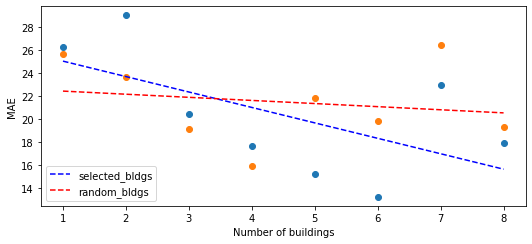

In [496]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

z = np.polyfit(buildings, mae, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'b--')
plt.scatter(buildings, mae)

z = np.polyfit(buildings, mae_random, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'r--')
plt.scatter(buildings, mae_random)

plt.legend(['selected_bldgs', 'random_bldgs'])
plt.xlabel("Number of buildings")
plt.ylabel("MAE")
#plt.xticks(buildings, building_ids)

Text(0, 0.5, 'F1')

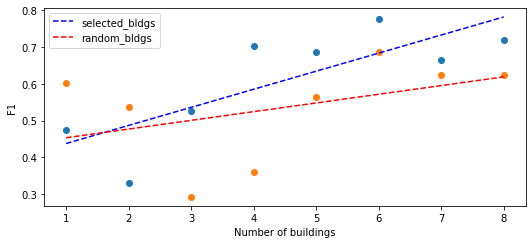

In [495]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

z = np.polyfit(buildings, f1, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'b--')
plt.scatter(buildings, f1)

z = np.polyfit(buildings, f1_random, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'r--')
plt.scatter(buildings, f1_random)

plt.legend(['selected_bldgs', 'random_bldgs'])
plt.xlabel("Number of buildings")
plt.ylabel("F1")
#plt.xticks(buildings, building_ids)

Text(0, 0.5, 'NDE')

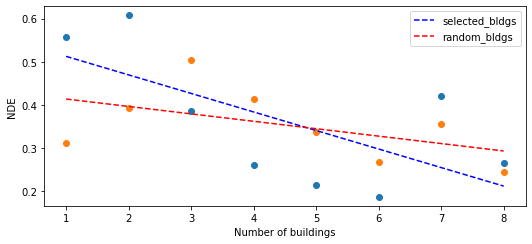

In [494]:
# Normalized Disaggregation Error: sum of squared differences btw predicted and actual power over sum of squared
# actual power
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

z = np.polyfit(buildings, nde, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'b--')
plt.scatter(buildings, nde)

z = np.polyfit(buildings, nde_random, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'r--')
plt.scatter(buildings, nde_random)

plt.legend(['selected_bldgs', 'random_bldgs'])
plt.xlabel("Number of buildings")
plt.ylabel("NDE")
#plt.xticks(buildings, building_ids)

Text(0, 0.5, 'NEP')

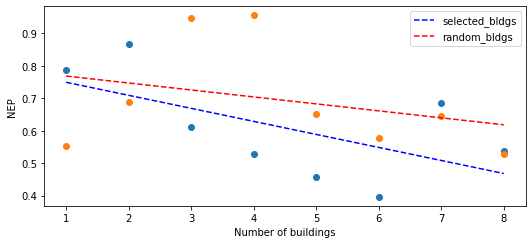

In [493]:
# Normalized Error in Assigned Power: Sum of absolute differences btw actual and predicted over sum of actual power
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

z = np.polyfit(buildings, nep, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'b--')
plt.scatter(buildings, nep)

z = np.polyfit(buildings, nep_random, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'r--')
plt.scatter(buildings, nep_random)

plt.legend(['selected_bldgs', 'random_bldgs'])
plt.xlabel("Number of buildings")
plt.ylabel("NEP")
#plt.xticks(buildings, building_ids)

Text(0, 0.5, 'MSE')

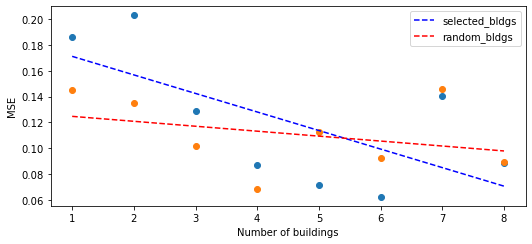

In [492]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

z = np.polyfit(buildings, mse, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'b--')
plt.scatter(buildings, mse)

z = np.polyfit(buildings, mse_random, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'r--')
plt.scatter(buildings, mse_random)

plt.legend(['selected_bldgs', 'random_bldgs'])
plt.xlabel("Number of buildings")
plt.ylabel("MSE")
#plt.xticks(buildings, building_ids)

Text(0, 0.5, 'R2')

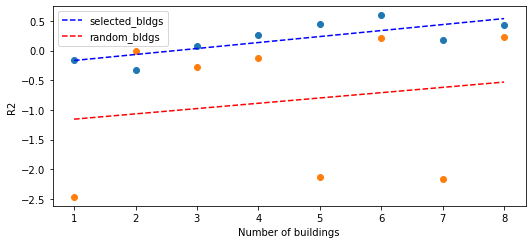

In [498]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

z = np.polyfit(buildings, r2, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'b--')
plt.scatter(buildings, r2)

z = np.polyfit(buildings, r2_random, 1)
p = np.poly1d(z)
plt.plot(buildings, p(buildings), 'r--')
plt.scatter(buildings, r2_random)

plt.legend(['selected_bldgs', 'random_bldgs'])
plt.xlabel("Number of buildings")
plt.ylabel("R2")
#plt.xticks(buildings, building_ids)

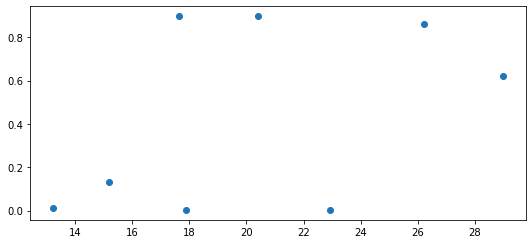

In [548]:
plt.scatter(mae, ks_values)

In [35]:
headers = ['MSE', 'R2', 'F1', 'NEP', 'NDE', 'MAE']
with open(Path(r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\10_runs.csv"), 'w') as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(headers)
    
    values = []
    for value in final_results.values():
        values.append(value)
    
    csvwriter.writerows(values)

In [4]:
df = pd.read_csv(Path(r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\10_runs_per_building_results.csv"))

In [38]:
final_results

{145: [0.09894359111785889,
  0.06652157452065162,
  0.437262443374813,
  0.7802547414162435,
  0.33343215792377806,
  23.153497314453126],
 518: [0.13250575959682465,
  -0.4691445078407804,
  0.5946232394227758,
  0.6979048728474951,
  0.3333561809057871,
  27.74102077484131],
 558: [0.13727420568466187,
  -3.130497966106865,
  0.6399702023784146,
  0.5925544366925957,
  0.3105749475803894,
  26.190921783447266],
 690: [0.1512036919593811,
  -0.8072117908950899,
  0.31193833038966207,
  1.180817268031781,
  0.5920359206255409,
  30.157614707946777],
 914: [0.11030037701129913,
  -0.05592519790033852,
  0.5307355614343952,
  0.8737289028891381,
  0.42143382931666384,
  22.86779327392578],
 950: [0.15517187118530273,
  -0.10633151112436008,
  0.40561647325961186,
  1.205653783051054,
  0.5016725255538843,
  37.29196395874023],
 1222: [0.08351299166679382,
  -0.8775825402630719,
  0.6534558238386375,
  0.47971128932468526,
  0.20151136768955846,
  19.880823707580568],
 1240: [0.139784768

<AxesSubplot:>

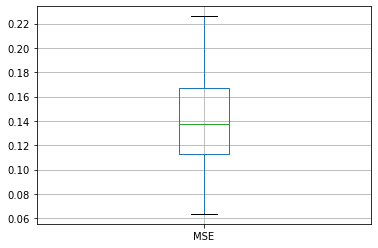

In [20]:
df.boxplot(column=['MSE'])

(array([1., 0., 0., 2., 3., 0., 1., 3., 5., 6., 1., 2., 2., 1., 1., 0., 0.,
        1., 0., 0., 4., 5., 3., 2., 2.]),
 array([12.1938158 , 13.43585706, 14.67789831, 15.91993956, 17.16198081,
        18.40402206, 19.64606332, 20.88810457, 22.13014582, 23.37218707,
        24.61422832, 25.85626958, 27.09831083, 28.34035208, 29.58239333,
        30.82443459, 32.06647584, 33.30851709, 34.55055834, 35.79259959,
        37.03464085, 38.2766821 , 39.51872335, 40.7607646 , 42.00280585,
        43.24484711]),
 <BarContainer object of 25 artists>)

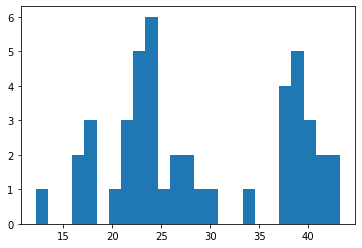

In [9]:
plt.hist(df.MAE.values, bins=25)

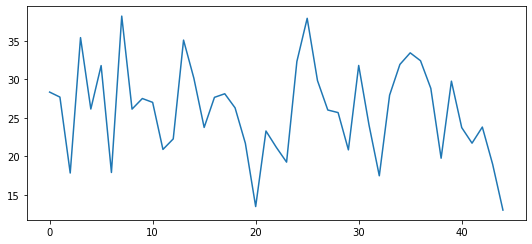

In [838]:
#MAE per building
plt.plot(df.MAE.values)

In [757]:
x_vals = []
for i in range(len(df.R2)):
    x_vals.append(i)

In [758]:
y_vals = [0]*len(df.R2)

In [807]:
n = 3
list2 = [sum(df.MAE.values[i:i+n])//n for i in range(0,len(df.MAE.values),n)]

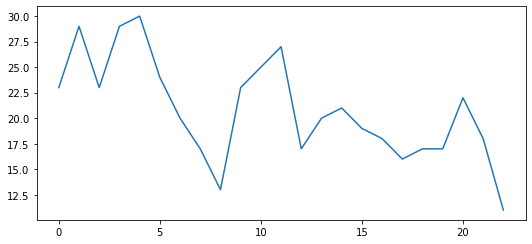

In [808]:
plt.plot(list2)
#plt.plot(x_vals, y_vals, '--')

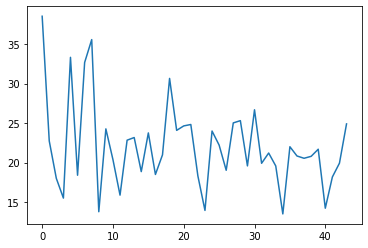

In [71]:
#MAE on accumulating buildings
plt.plot(df.MAE.values)

In [551]:
#Calculating 2-sided KS Test Critical Values
def critical_value(alpha, l1, l2):
    output = np.sqrt((l1+l2)/(l1*l2))
    if alpha == 0.2:
        output = 1.07*output
    elif alpha == 0.1:
        output = 1.22*output
    elif alpha == 0.05:
        output = 1.36*output
    elif alpha == 0.02:
        output = 1.52*output
    elif alpha == 0.01:
        output = 1.63*output
    return output

In [598]:
selected_bldgs = []
random_bldgs = []
selected_crit_vals = []
random_crit_vals = []
l2 = homes.loc[homes['dataid'] == 1706].shape[0]
for i in range(len(building_ids)):
    selected_bldgs.append(building_ids[i])
    random_bldgs.append(building_ids_random[i])
    l1 = homes.loc[homes['dataid'].isin(selected_bldgs)].shape[0]
    selected_crit_vals.append(critical_value(0.2, l1, l2))
    
    l1 = homes.loc[homes['dataid'].isin(random_bldgs)].shape[0]
    random_crit_vals.append(critical_value(0.2, l1, l2))

In [561]:
building_ids_random = [1417, 10983, 145, 10089, 3996, 6564, 2358, 8849]

In [560]:
building_ids = [8849, 2448, 7159, 10182, 6069, 1417, 690, 1240]

In [600]:
selected_bldgs = []
random_bldgs = []
ks_statistic = []
ks_statistic_random = []
test_home = homes.loc[homes['dataid'] == 1706].appliance_power.values
for i in range(len(building_ids)):
    selected_bldgs.append(building_ids[i])
    random_bldgs.append(building_ids_random[i])
    train_homes = homes.loc[homes['dataid'].isin(selected_bldgs)].appliance_power.values
    ks_statistic.append(stats.ks_2samp(train_homes, test_home).statistic)
    
    train_homes = homes.loc[homes['dataid'].isin(random_bldgs)].appliance_power.values
    ks_statistic_random.append(stats.ks_2samp(train_homes, test_home).statistic)

In [603]:
ks_results = []
ks_results_random = []
for i in range(len(selected_crit_vals)):
    if ks_statistic[i] > selected_crit_vals[i]:
        ks_results.append("Different distributions")
    else:
        ks_results.append("Same distribution")
        
    if ks_statistic_random[i] > random_crit_vals[i]:
        ks_results_random.append("Different distributions")
    else:
        ks_results_random.append("Same distribution")

In [614]:
ks_results

['Same distribution',
 'Same distribution',
 'Same distribution',
 'Same distribution',
 'Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions']

In [609]:
ks_results_random

['Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions']

## Anderson Darling Test

In [628]:
drye1_homes = []
for i in building_ids:
    building = homes.loc[homes['dataid'] == i].appliance_power.values
    drye1_homes.append(building)

In [638]:
stats.anderson_ksamp(drye1_homes[1:3])

<ipython-input-638-378ca2b823ae>:1: UserWarning: p-value floored: true value smaller than 0.001
  stats.anderson_ksamp(drye1_homes[1:3])


Anderson_ksampResult(statistic=268.8234343067818, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), significance_level=0.001)

In [33]:
devices_of_interest = [
    'air1',
    'clotheswasher1',
    'clotheswasher_dryg1',
    'dishwasher1',
    'drye1',
    'freezer1',
    'furnace1',
    'heater1',
    'oven1',
    'range1',
    'refrigerator1',
    'waterheater1',
    'waterheater2',
    'wellpump1'
]

In [ ]:
for appliance in devices_of_interest:
    homes = load_all_houses_with_device(path, appliance)
    print("Loaded houses with device")
    plt.figure()
    plt.plot(homes['appliance_power'].values)
    plt.title(appliance)

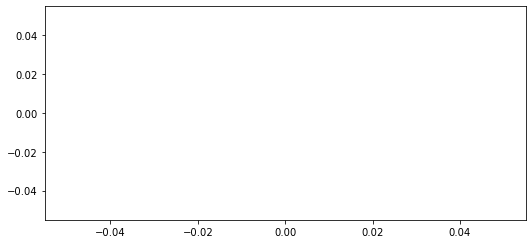

In [715]:
plt.plot(homes.loc[homes['dataid'] == 387]['appliance_power'].values)

In [ ]:
ids = get_home_ids(homes)

In [ ]:
for i in ids:
    plt.figure()
    plt.plot(homes.loc[homes['dataid'] == i]['appliance_power'].values)
    plt.title(i)

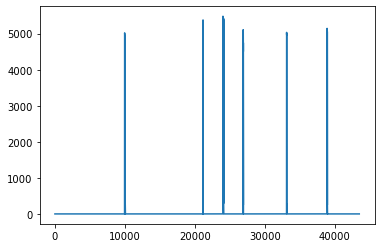

In [127]:
plt.plot(home2['appliance_power'].values)

In [124]:
print("8849 size: ", len(home1))
print("1706 size: ", len(home2))

8849 size:  59340
1706 size:  43500


In [121]:
homes = load_all_houses_with_device(path, 'drye1')

In [122]:
home1 = homes.loc[homes['dataid'] == 8849]

In [123]:
home2 = homes.loc[homes['dataid'] == 1706]

In [ ]:
std1 = np.std(home1['net_power'])

In [ ]:
std2 = np.std(home2['net_power'])

In [ ]:
x1 = (home1['net_power'] - np.mean(home1['net_power']))/std1

In [ ]:
x2 = (home2['net_power'] - np.mean(home2['net_power']))/std2

In [ ]:
plt.hist(x1, bins = 50)
plt.hist(x2, bins = 50)
plt.legend(["Home792", "Home5192"])
plt.xlabel("Batch standardized input")
plt.ylabel("Frequency")

In [ ]:
y1 = (home1['appliance_power'] - np.min(home1['appliance_power']))/(np.max(home1['appliance_power']) - np.min(home1['appliance_power']))

In [ ]:
y2 = (home2['appliance_power'] - np.min(home2['appliance_power']))/(np.max(home2['appliance_power']) - np.min(home2['appliance_power']))

In [ ]:
plt.hist(y1, bins = 50)
plt.hist(y2, bins = 50)
plt.legend(["House792", "House5192"])
plt.xlabel("Batch normalized output")
plt.ylabel("Frequency")

In [ ]:
y1_on = [i for i in y1 if i > 0.01]

In [ ]:
y2_on = [i for i in y2 if i > 0.01]

In [ ]:
plt.hist(y1_on, bins = 50)
plt.hist(y2_on, bins = 50)
plt.legend(["House792", "House5192"])
plt.xlabel("Batch normalized output")
plt.ylabel("Frequency")

In [ ]:
homes

In [ ]:
home_ids = get_home_ids(homes)

In [ ]:
y_distributions = []

In [ ]:
#transformations: x/(x+1), log, 
for home in home_ids:
    house_of_interest = homes.loc[homes['dataid'] == home]
    std = np.std(house_of_interest['net_power'])
    y = np.log(house_of_interest['appliance_power'] + 1)
    y = (y - np.min(y))/(np.max(y) - np.min(y))
    y_distributions.append(y)
    plt.figure()
    plt.hist(y, bins = 100)

In [ ]:
ks_results = []

In [ ]:
for i in range(len(y_distributions)):
    for j in range(len(y_distributions)):
        ks_results.append([home_ids[i], home_ids[j], stats.ks_2samp(y_distributions[i], y_distributions[j])])

In [ ]:
ks_results

In [ ]:
home_ids

In [ ]:
home1_2

In [ ]:
home1_2 = homes.loc[
    (homes['dataid'] == 792)|
    (homes['dataid'] == 1417)|
    (homes['dataid'] == 3488)|
    (homes['dataid'] == 3517)|
    (homes['dataid'] == 4414)|
    (homes['dataid'] == 9004)|
    (homes['dataid'] == 7365)|
    (homes['dataid'] == 8849)]

In [ ]:
plt.hist(home1_2['appliance_power'])

In [ ]:
home1_2 = home1_2['appliance_power']

In [ ]:
home1_2 = np.log(home1_2 + 1)

In [ ]:
home1_2 = (home1_2 - np.min(home1_2))/(np.max(home1_2) - np.min(home1_2))

In [ ]:
for i in range(len(y_distributions)):
    ks_results.append([home_ids[i], "All Homes", stats.ks_2samp(y_distributions[i], home1_2)])

In [639]:
ks_results

['Same distribution',
 'Same distribution',
 'Same distribution',
 'Same distribution',
 'Different distributions',
 'Different distributions',
 'Different distributions',
 'Different distributions']

In [ ]:
appliance_dict = {"air1":"compressor",
                  "air2": "compressor",
                  "air3": "compressor",
                  "airwindowunit1":"air conditioner",
                  "aquarium1":"water pump",
                  "bathroom1":"sockets",
                  "bathroom2":"sockets",
                  "bedroom1":"sockets",
                  "bedroom2":"sockets",
                  "bedroom3":"sockets",
                  "bedroom4":"sockets",
                  "bedroom5":"sockets",
                  "battery1":"unknown",
                  "car1":"electric vehicle",
                  "car2":"electric vehicle",
                  "circpump1":"water pump",
                  "clotheswasher1":"washing machine",
                  "clotheswasher_dryg1":"washer dryer",
                  "diningroom1":"sockets",
                  "diningroom2":"sockets",
                  "dishwasher1":"dish washer",
                  "disposal1":"waste disposal unit",
                  "drye1":"tumble dryer",
                  "dryg1":"tumble dryer",
                  "freezer1":"freezer",
                  "furnace1":"electric furnace",
                  "furnace2":"electric furnace",
                  "garage1":"sockets",
                  "garage2":"sockets",
                  "heater1":"heating appliance",
                  "heater2":"heating appliance",
                  "heater3":"heating appliance",
                  "housefan1":"fan",
                  "icemaker1":"cold appliance",
                  "jacuzzi1":"jacuzzi pump",
                  "kitchen1":"sockets",
                  "kitchen2":"sockets",
                  "kitchenapp1":"sockets",
                  "kitchenapp2":"sockets",
                  "lights_plugs1":"light",
                  "lights_plugs2":"light",
                  "lights_plugs3":"light",
                  "lights_plugs4":"light",
                  "lights_plugs5":"light",
                  "lights_plugs6":"light",
                  "livingroom1":"sockets",
                  "livingroom2":"sockets",
                  "microwave1":"microwave",
                  "office1":"sockets",
                  "outsidelights_plugs1":"lighting component",
                  "outsidelights_plugs2":"lighting component",
                  "oven1":"oven",
                  "oven2":"oven",
                  "pool1":"electric swimming pool heater",
                  "pool2":"electric swimming pool heater",
                  "poollight1":"lighting component",
                  "poolpump1":"swimming pool pump",
                  "pump1":"water pump",
                  "range1":"stove",
                  "refrigerator1":"fridge",
                  "refrigerator2":"fridge",
                  "security1":"security alarm",
                  "sewerpump1":"water pump",
                  "shed1":"sockets",
                  "sprinkler1":"garden sprinkler",
                  "sumppump1":"water pump",
                  "utilityroom1":"subpanel",
                  "venthood1":"fan",
                  "waterheater1":"electric water heater",
                  "waterheater2":"electric water heater",
                  "wellpump1":"water pump",
                  "winecooler1":"cold appliance"
                 }

In [ ]:
appliance_dict = ['clotheswasher1']

In [35]:
for key in devices_of_interest:
    homes = load_all_houses_with_device(path, key)
    ids = get_home_ids(homes)
    num_homes = len(ids)
    y_distributions = []
    for home in ids:
        home_i = homes.loc[homes['dataid'] == home]['net_power'].values
        #home_i = np.log(home_i + 1)
        #home_i = (home_i - np.min(home_i))/(np.max(home_i) - np.min(home_i))
        std = np.std(home_i)
        home_i = (home_i - np.mean(home_i))/std
        y_distributions.append(home_i)
    
    ks_results = []
    for i in range(len(y_distributions)):
        for j in range(len(y_distributions)):
            ks_stat = stats.ks_2samp(y_distributions[i], y_distributions[j])
            if ks_stat.pvalue > 0 and ks_stat.pvalue < 1:
                ks_results.append([key, ids[i], ids[j], ks_stat.statistic, ks_stat.pvalue, num_homes])
                
    results = pd.DataFrame(ks_results,
            columns=["Appliance", 'House1', "House2", "KS_Statistic", "KS_Pvalue", "Num_homes"])
    
    results.to_csv(Path(r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ks_test_on_net_power_z_norm.csv"), index = False, mode = 'a', header = True)

In [34]:
homes

,dataid,net_power,appliance_power
89280,145,222.0,1.0
89281,145,230.0,1.0
89282,145,255.0,1.0
89283,145,233.0,1.0
89284,145,222.0,1.0
...,...,...,...
9406932,10983,227.0,1.0
9406933,10983,227.0,1.0
9406934,10983,227.0,1.0
9406935,10983,227.0,1.0


In [ ]:
results.loc[results['Appliance'] == 'clotheswasher1']

In [ ]:
for key in appliance_dict:
    homes = load_all_houses_with_device(path, key)
    print(len(homes))

In [830]:
homes = load_all_houses_with_device(path, 'drye1')

In [ ]:
building_ids_random = [1417, 10983, 145, 10089, 3996, 6564, 2358, 8849]

In [831]:
test_home = homes.loc[homes['dataid'] == 1706].appliance_power.values

In [839]:
train_homes = homes.loc[homes['dataid'] == 10983].appliance_power.values

In [840]:
ks_stat_test = stats.ks_2samp(train_homes, test_home)

In [841]:
ks_stat_test

KstestResult(statistic=0.7463067694944302, pvalue=0.0)

In [835]:
critical_value(0.2, len(test_home), len(train_homes))

0.005912833450100638

In [644]:
house1_fridge = r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ukdale\house_1\channel_12.dat"

In [645]:
house2_fridge = r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ukdale\house_2\channel_14.dat"

In [646]:
house5_fridge = r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ukdale\house_5\channel_19.dat"

In [647]:
house1_fridge = pd.DataFrame(np.loadtxt(house1_fridge))

In [648]:
house2_fridge = pd.DataFrame(np.loadtxt(house2_fridge))

In [649]:
house5_fridge = pd.DataFrame(np.loadtxt(house5_fridge))

In [643]:
ids = homes.dataid.unique()

In [662]:
for i in range(len(house1_fridge)):
    house1_fridge[0][i] = datetime.datetime.fromtimestamp(house1_fridge[0][i]).strftime('%Y-%m-%d %H:%M:%S')

In [663]:
house1_fridge

,0,1
0,2012-12-14 17:21:32,85.0
1,2012-12-14 17:21:38,85.0
2,2012-12-14 17:21:44,84.0
3,2012-12-14 17:21:50,85.0
4,2012-12-14 17:21:56,85.0
...,...,...
19381293,2017-04-26 13:32:22,0.0
19381294,2017-04-26 13:32:30,0.0
19381295,2017-04-26 13:32:38,0.0
19381296,2017-04-26 13:32:45,0.0


In [ ]:
test_inputs = []
predictions = []
true_vals = []

In [ ]:
model_4.cpu()

In [ ]:
total_r2_count = 0.0
for i, (inputs, outputs) in enumerate(test_loader):
    inputs, outputs = inputs.cpu(), outputs.cpu()
    prediction = model_4(inputs)
    
    predictions.append(prediction.detach().numpy())
    true_vals.append(outputs.detach().numpy())
    test_inputs.append(inputs)

In [ ]:
len(predictions)

In [ ]:
plt.plot(predictions[0][2])
plt.plot(true_vals[0][2])
plt.legend(['prediction', 'true'])
#plt.plot(test_inputs[0][3])

In [ ]:
flat_list = [i for subitems in predictions for i in subitems]

In [ ]:
flat_list = flat_list[0:11]

In [ ]:
flat_list = [i for subitems in flat_list for i in subitems]

In [ ]:
plt.plot(flat_list)

In [ ]:
flat_list_2 = [i for subitems in true_vals for i in subitems]

In [ ]:
flat_list_2 = flat_list_2[0:11]

In [ ]:
flat_list_2 = [i for subitems in flat_list_2 for i in subitems]

In [ ]:
plt.scatter(flat_list_2, flat_list)
plt.plot(flat_list_2, flat_list_2)
plt.xlabel("Normalized True Values")
plt.ylabel("Normalized Predictions")
plt.title("Train:792,950,1417, Test:5192, window=15")

In [ ]:
flat_list_3 = [i for subitems in test_inputs for i in subitems]

In [ ]:
flat_list_3 = flat_list_3[0:11]

In [ ]:
flat_list_3 = [i for subitems in flat_list_3 for i in subitems]

In [ ]:
plt.scatter(flat_list_2, flat_list_3)

In [ ]:
test_dataset = PecanStreetDataset_test(r"C:\Users\aar245.CORNELL\Desktop\Fall2021_new\ithaca_Real_2019\1min_real_may_june_july2019.csv", 'clotheswasher1', 100, [8849])

In [ ]:
test_loader = DataLoader(dataset=test_dataset, batch_size=config['batch_size'], shuffle = False, num_workers=0)

In [ ]:
test_dataset.x[0][10]

In [ ]:
predictions

In [138]:
data = {'Homes_[145]_trial_0': [0.034340355545282364, 0.011516736499949831, 0.40274180330898723, 1.245686421298727, 0.30096994173255553, 24.02022647857666], 'Homes_[145]_trial_1': [0.11184552311897278, 0.15481763085669967, 0.34350788714997454, 1.1705165431380355, 0.48249457238172605, 45.85539436340332], 'Homes_[145]_trial_2': [0.059668220579624176, -0.013455812068356776, 0.3171735592826694, 1.2226486140952608, 0.45949058380945873, 26.832109928131104], 'Homes_[145]_trial_3': [0.06723451614379883, 0.43850080022933136, 0.5204284170865403, 0.7529636257548996, 0.29482307957456894, 29.019606590270996], 'Homes_[145]_trial_4': [0.09714455902576447, 0.23283012381596388, 0.37367337771958614, 1.065114924135568, 0.5036551546851267, 34.71909523010254], 'Homes_[145]_trial_5': [0.05678994208574295, 0.017250372135454495, 0.30110304682804273, 1.4256426470221297, 0.5451091235152874, 25.100674390792847], 'Homes_[145]_trial_6': [0.12255048006772995, 0.08079075612144551, 0.4375062195969745, 0.7747595483529605, 0.3871034892680603, 41.45162487030029], 'Homes_[145]_trial_7': [0.12153548747301102, -0.5781150407070136, 0.3336788051599015, 1.012747706433326, 0.46813888297939765, 44.43409872055054], 'Homes_[145]_trial_8': [0.0928615853190422, 0.2290007267550919, 0.35625396221332933, 1.087782044898758, 0.48944804383634005, 34.87851810455322], 'Homes_[145]_trial_9': [0.09224393963813782, -0.3653550069178414, 0.36668508613513917, 0.9824821279941934, 0.4094297365697293, 37.408459186553955], 'Homes_[145, 518]_trial_0': [0.048998817801475525, 0.059835694455035726, 0.41088383487350727, 0.8435047402413807, 0.28214117019137147, 24.7567355632782], 'Homes_[145, 518]_trial_1': [0.05196501314640045, 0.2591895445184802, 0.5113837776169593, 0.6172670144977773, 0.22450944692143848, 24.145499229431152], 'Homes_[145, 518]_trial_2': [0.03273223340511322, 0.6874891056672174, 0.6214697589212622, 0.6250787271104519, 0.15650869960540792, 22.093197345733643], 'Homes_[145, 518]_trial_3': [0.10664869099855423, 0.21587748752772673, 0.5259955524541565, 0.679953987064501, 0.30936232554551274, 39.61451435089111], 'Homes_[145, 518]_trial_4': [0.0723288357257843, 0.16598135577172618, 0.4682757167440963, 0.5665069972170629, 0.24852790931939744, 27.863027095794678], 'Homes_[145, 518]_trial_5': [0.04890970140695572, 0.5446620568681754, 0.5170847904963796, 0.7558124053490524, 0.24096019072851424, 25.926891326904297], 'Homes_[145, 518]_trial_6': [0.09706052392721176, 0.13075547595267215, 0.2768551973841998, 1.0442958978974823, 0.6147389358631176, 27.865200996398926], 'Homes_[145, 518]_trial_7': [0.07029116898775101, 0.17528783478895307, 0.3931582748270078, 0.8897764417510919, 0.41395865221545497, 25.533562660217285], 'Homes_[145, 518]_trial_8': [0.05194397643208504, -0.020742356482226776, 0.31735041487752663, 1.4614646612507374, 0.4985941352800965, 25.731377124786377], 'Homes_[145, 518]_trial_9': [0.0699080377817154, -0.008124411074696108, 0.37908083269912946, 1.0375797962596642, 0.4337715668428219, 28.26013469696045], 'Homes_[145, 518, 558]_trial_0': [0.055058740079402924, 0.48868968593687834, 0.47894663621217404, 0.8991626632897493, 0.27460598502210587, 30.46781063079834], 'Homes_[145, 518, 558]_trial_1': [0.07394760102033615, -0.34393992268389817, 0.2709129587632141, 1.4967223661853737, 0.5587918101036575, 33.47356986999512], 'Homes_[145, 518, 558]_trial_2': [0.07495889812707901, 0.33276154323808366, 0.5217884017153723, 0.7893012775754437, 0.2780159845687249, 35.96523952484131], 'Homes_[145, 518, 558]_trial_3': [0.08548983931541443, 0.38447382225193205, 0.5975233692837403, 0.5482303799290791, 0.24706896477773005, 32.058714866638184], 'Homes_[145, 518, 558]_trial_4': [0.10673632472753525, -0.34275568140335266, 0.3109786556394049, 0.9234641925571094, 0.4274649516453007, 38.96893358230591], 'Homes_[145, 518, 558]_trial_5': [0.06862568110227585, 0.43901078223936907, 0.5057593449465357, 0.7839509805371097, 0.29768930378697656, 30.542110443115234], 'Homes_[145, 518, 558]_trial_6': [0.058656468987464905, 0.5552624785757246, 0.6312202178831176, 0.6390380189971528, 0.22356735656079368, 28.334850788116455], 'Homes_[145, 518, 558]_trial_7': [0.08142639696598053, 0.3502718555325186, 0.5363037611024405, 0.6712239053688666, 0.2893494234905968, 31.922484874725342], 'Homes_[145, 518, 558]_trial_8': [0.11461727321147919, 0.16521291927630027, 0.5150133135843209, 0.7868366815478944, 0.40642061522846024, 37.50124168395996], 'Homes_[145, 518, 558]_trial_9': [0.10042791068553925, -1.9140082044775601, 0.2078141169732087, 2.0369222369760447, 0.7412375579971116, 46.6399564743042], 'Homes_[145, 518, 558, 690]_trial_0': [0.07157326489686966, 0.3812244957709577, 0.45552727025002493, 0.8378595806599256, 0.3182471240033365, 31.845223426818848], 'Homes_[145, 518, 558, 690]_trial_1': [0.03346061334013939, 0.28199255555585867, 0.45093641741158086, 0.9261029148482199, 0.2932595593039838, 17.857786178588867], 'Homes_[145, 518, 558, 690]_trial_2': [0.039254531264305115, 0.30371460306865117, 0.5339138395379268, 0.6102949383002326, 0.18267119272312288, 22.16390037536621], 'Homes_[145, 518, 558, 690]_trial_3': [0.08897840231657028, 0.22961046936511545, 0.4599162555207115, 0.8143293345710336, 0.36284643570419944, 33.74803924560547], 'Homes_[145, 518, 558, 690]_trial_4': [0.08589340001344681, 0.3767220276055797, 0.6072287519604664, 0.5911503921550212, 0.24478107419907758, 35.05634307861328], 'Homes_[145, 518, 558, 690]_trial_5': [0.06935939192771912, 0.044498988666022976, 0.3319322646082913, 1.1822200728323653, 0.5119272921634023, 27.069611072540283], 'Homes_[145, 518, 558, 690]_trial_6': [0.07218676060438156, -0.01218236757958363, 0.3945477716167237, 0.8140558204979311, 0.32583755387926294, 30.478760242462158], 'Homes_[145, 518, 558, 690]_trial_7': [0.05586802586913109, -0.018135920455671, 0.35152996282645305, 1.238300505793523, 0.4181308583671297, 27.961719036102295], 'Homes_[145, 518, 558, 690]_trial_8': [0.02373386360704899, 0.5261269954511021, 0.5650149417311712, 0.4987385761437976, 0.12709726768378604, 15.739536046981812], 'Homes_[145, 518, 558, 690]_trial_9': [0.06791264563798904, 0.4803362347849381, 0.5069740569605918, 0.8338166165349419, 0.2853850402923996, 33.53332853317261], 'Homes_[145, 518, 558, 690, 914]_trial_0': [0.055510617792606354, 0.4541476575964233, 0.5193420638082018, 0.7692458111541092, 0.3383747665611113, 21.32700514793396], 'Homes_[145, 518, 558, 690, 914]_trial_1': [0.09737493097782135, 0.2712632192714279, 0.5825820116665436, 0.7519817513386204, 0.30699471189612637, 40.30976629257202], 'Homes_[145, 518, 558, 690, 914]_trial_2': [0.06317245960235596, -0.10001592767843098, 0.21500285653130702, 1.5133459493329844, 0.60637288743903, 26.64482855796814], 'Homes_[145, 518, 558, 690, 914]_trial_3': [0.049522265791893005, 0.17114332331559276, 0.35555405268892787, 1.0146416964013656, 0.3813590402653845, 22.267213344573975], 'Homes_[145, 518, 558, 690, 914]_trial_4': [0.043482616543769836, 0.616841418916386, 0.6095413161851075, 0.6651779658078155, 0.18517705055982728, 26.39691162109375], 'Homes_[145, 518, 558, 690, 914]_trial_5': [0.16725407540798187, -0.1879357694030972, 0.3435446840118035, 1.1537629322194154, 0.5380628552705167, 60.61037063598633], 'Homes_[145, 518, 558, 690, 914]_trial_6': [0.10839635878801346, 0.05026232374835429, 0.31000418867096285, 1.5321419202401327, 0.5713276982352322, 49.12642192840576], 'Homes_[145, 518, 558, 690, 914]_trial_7': [0.044883038848638535, -0.24166203185139543, 0.3947917700884526, 1.2336310947256925, 0.3211082556723545, 29.14088726043701], 'Homes_[145, 518, 558, 690, 914]_trial_8': [0.06528947502374649, 0.47584425981624373, 0.5134175945096794, 0.7853035130292001, 0.33203292008811197, 26.096739292144775], 'Homes_[145, 518, 558, 690, 914]_trial_9': [0.07763616740703583, 0.06993395108439748, 0.4113929339593982, 0.8397250664960847, 0.34948170433116066, 31.525607585906982], 'Homes_[145, 518, 558, 690, 914, 950]_trial_0': [0.09307604283094406, 0.3133182520204661, 0.6439142067511711, 0.7485189453536633, 0.30929799947805087, 38.06714487075806], 'Homes_[145, 518, 558, 690, 914, 950]_trial_1': [0.07890598475933075, 0.30994108421825467, 0.47661926588085857, 1.2921298046479182, 0.4957404125079987, 34.75749397277832], 'Homes_[145, 518, 558, 690, 914, 950]_trial_2': [0.10054019838571548, 0.19259592556063831, 0.3972819041427086, 1.1658882833348585, 0.44217617102906054, 44.801032066345215], 'Homes_[145, 518, 558, 690, 914, 950]_trial_3': [0.048367179930210114, 0.5327029019892803, 0.4835570372578109, 1.0778170433209802, 0.29255001765993743, 30.114967346191406], 'Homes_[145, 518, 558, 690, 914, 950]_trial_4': [0.07780919969081879, 0.42098163813995026, 0.615583304466051, 0.6677115794347007, 0.24478912159137775, 35.86860275268555], 'Homes_[145, 518, 558, 690, 914, 950]_trial_5': [0.15331850945949554, -2.143819163929653, 0.29271353837434155, 1.2762203029256858, 0.5818991277680756, 56.82758712768555], 'Homes_[145, 518, 558, 690, 914, 950]_trial_6': [0.0607338510453701, 0.4892722179089115, 0.6008341455038972, 0.6490491099611442, 0.23923919210746264, 27.84599542617798], 'Homes_[145, 518, 558, 690, 914, 950]_trial_7': [0.048985555768013, 0.5521644101585762, 0.522674110432207, 0.8407236886754994, 0.2986001419165347, 23.308698177337646], 'Homes_[145, 518, 558, 690, 914, 950]_trial_8': [0.14781220257282257, -0.08874610551075371, 0.2880031488088233, 1.4148589660981903, 0.6229076064241967, 56.73963260650635], 'Homes_[145, 518, 558, 690, 914, 950]_trial_9': [0.09569276869297028, 0.27674325750489215, 0.5018360525749342, 0.8536291105762657, 0.3385066903254925, 40.78192853927612], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_0': [0.060999415814876556, 0.05782619048774085, 0.4696490230763348, 0.7838916820761953, 0.2753399378137992, 29.349395990371704], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_1': [0.07166571915149689, 0.09029535660364618, 0.4865765453525541, 1.0308209668862038, 0.418898545921081, 29.803863048553467], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_2': [0.1928103119134903, -0.24689505910330212, 0.3345075377584689, 1.0725076347822913, 0.5436555859343867, 64.28260707855225], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_3': [0.04233522713184357, 0.014119036406907481, 0.5345606402857458, 0.7655847566309187, 0.19930501166357784, 27.482969284057617], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_4': [0.10713139176368713, 0.1894035441683517, 0.4972712855099992, 0.9247658158058821, 0.37987647915930106, 44.075050354003906], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_5': [0.059575099498033524, 0.1215533185297833, 0.3740283341547922, 1.5062719960572466, 0.5519418139984069, 27.47651219367981], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_6': [0.037728987634181976, 0.7051041445343131, 0.6875483574098288, 0.6075995699653514, 0.15940285384918226, 24.30430555343628], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_7': [0.08933287113904953, -1.0988392455679552, 0.3232365238959822, 1.4314503041311457, 0.4947102834212571, 43.68409585952759], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_8': [0.09629551321268082, 0.26013805126940925, 0.5546077140545483, 0.8630902750764069, 0.388757368596052, 36.1301965713501], 'Homes_[145, 518, 558, 690, 914, 950, 1222]_trial_9': [0.09547163546085358, 0.2655365180943335, 0.41676425104774617, 1.059632617991591, 0.4065797895220411, 42.05044364929199], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_0': [0.06894038617610931, -0.0722314576477851, 0.3911573385072868, 1.3388995622945565, 0.515967763412029, 30.233318328857422], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_1': [0.09469988197088242, -1.4414304036251218, 0.20333089333823753, 1.8983421343479043, 0.7087586697454535, 42.86593532562256], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_2': [0.06913309544324875, 0.13853548009140237, 0.4263157147288536, 1.04736762187464, 0.38284731437990666, 31.962903261184692], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_3': [0.0983080118894577, 0.33149298747924477, 0.640165332354626, 0.6982569409498429, 0.3010952901967822, 38.52892589569092], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_4': [0.06731761246919632, 0.4220990869187353, 0.5037455703955551, 1.116600465599558, 0.42636032542218194, 29.79452133178711], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_5': [0.06656442582607269, 0.5293491109497505, 0.5613937255161404, 0.7875352179674783, 0.27971952184474375, 31.67204475402832], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_6': [0.04254503548145294, 0.34017484074893045, 0.5314617115543523, 0.7319953693144546, 0.24497949170712566, 21.483952522277832], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_7': [0.062246982008218765, 0.48309234838216075, 0.5730682303401702, 0.9651921607534896, 0.3333752492362959, 30.45688009262085], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_8': [0.04726042598485947, 0.6550814346586027, 0.6447625559774253, 0.6333242005095727, 0.19859954216286577, 25.47019100189209], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240]_trial_9': [0.12239745259284973, -2.2937978531723195, 0.2660293307161008, 1.587072495579995, 0.63093863004815, 52.031789779663086], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_0': [0.029810292646288872, 0.6959293048821151, 0.5993802339180231, 0.768725925794958, 0.1817139287792058, 21.312591552734375], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_1': [0.029124950990080833, 0.5373249419136601, 0.557309557850674, 0.5501709630060067, 0.1635326737035121, 16.55941677093506], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_2': [0.027467982843518257, 0.2994330617241652, 0.4224424941698509, 0.9957166247315147, 0.24073826371817322, 19.200128078460693], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_3': [0.10961711406707764, 0.1674473975137804, 0.5730254556474653, 0.811818275908008, 0.4009738094344593, 37.50661659240723], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_4': [0.10813231021165848, 0.27906223580447886, 0.624855627380469, 0.6706221532992123, 0.3311849386951926, 37.00407361984253], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_5': [0.10655544698238373, 0.21902057525185817, 0.5622736951071423, 0.7350477364857049, 0.3399643285029269, 38.93539047241211], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_6': [0.0990842804312706, -0.18891111253558152, 0.48485396323938096, 0.8793525191838908, 0.39479735673708277, 37.29754400253296], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_7': [0.0885884016752243, 0.35505665681440907, 0.5803160584739824, 0.6776304482375393, 0.278700660080297, 36.40143156051636], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_8': [0.04671989008784294, 0.6429863425942491, 0.6499512594043017, 0.6823265778595123, 0.2048665226441417, 26.297218322753906], 'Homes_[145, 518, 558, 690, 914, 950, 1222, 1240, 1417]_trial_9': [0.035978980362415314, 0.37522447965027594, 0.576098360405857, 0.6123363729322074, 0.16938119702303592, 21.98165726661682]}

In [139]:
def make_box_plots(data, metric):
    data_summary = pd.DataFrame(data).transpose().rename(columns = {0:"MSE", 1:"R2", 2:"F1", 3:"NEP", 4:"NDE", 5:"MAE"})
    bldgs = [data_summary[x:x+10][str(metric)].values for x in range(len(data_summary)) if x%10==0]
    return plt.boxplot(bldgs, showmeans=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x21af837f640>,
 'caps': [<matplotlib.lines.Line2D at 0x21af837fd60>,
 'boxes': [<matplotlib.lines.Line2D at 0x21af837f2b0>,
 'medians': [<matplotlib.lines.Line2D at 0x21af838b4c0>,
 'fliers': [<matplotlib.lines.Line2D at 0x21af838bbe0>,
 'means': [<matplotlib.lines.Line2D at 0x21af838b850>,
  <matplotlib.lines.Line2D at 0x21af843b040>]}

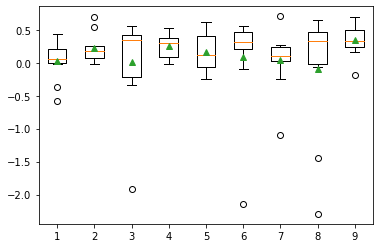

In [145]:
make_box_plots(data, 'R2')